# Logistic function individual country fitting

In [1]:
import csv
import json
import linecache
import datetime
import sys
import numpy as np
import random
from scipy.sparse import *
from scipy import *
import scipy as sp
import matplotlib.pyplot as plt
import os.path
import matplotlib
import copy
import pandas as pd
from scipy import stats
from tempfile import TemporaryFile
import pickle
from scipy.integrate import odeint
from torchdiffeq import odeint as dodeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn.parameter import Parameter
import country_converter as coco

def flushPrint(variable):
    sys.stdout.write('\r')
    sys.stdout.write('%s' % variable)
    sys.stdout.flush()
    

### All data output

In [2]:
# 将所有的有用数据从文件中导入
# 参数说明：
#1、first_date：2020年1月1日，是我们的时间0点
#2、start_date: 2019年12月1日，是病例数据起始的0点
#3、all_cumconfirm_cases: 是一个time_length*国家数的而为数组，记录了某一天现存的确诊病例数，这里time_length就是12-1日到4-15日的时间
#4、all_cumexist_cases：是一个time_length*国家数的而为数组，记录了某一天累积的确诊病例数
#5、targets，是一个Tensor，time_length*2*国家数维度，将all_cumconfirm_cases和all_cumexist_cases合并到了一起，作为训练的target
#6、mask：是一个Tensor，time_length*2*国家数维度，0-1矩阵，记录了targets是否>0的情况
#7、first_cases: 在2019年12月1日，中国的确诊病例数
#8、字典nodes，国家名称作为key，国家在nodes中的位置作为value，这个值也是后面各个数组的国家索引
#9、population，一个数组，各个国家的人口数
#10、fijt：一个列表，存储了从2019-12-1到2020-12-31的每一天的流量矩阵，其中fij表示从i国家到j国家的航空流量除以i国家的人口数
f=open('all_data_4_15.pkl', 'rb')
output = pickle.load(f)
f.close()
all_cumconfirm_cases = output['cases'][0]
all_cumexist_cases = output['cases'][1]
first_cases = output['cases'][2]
first_date = output['cases'][3]
start_date = output['cases'][4]
time_cases = output['cases'][5]
t0s = output['t0s']
nodes = output['nodes']
population = output['population']
fijt = output['fijt']

targets = torch.cat((torch.Tensor(all_cumconfirm_cases), torch.Tensor(all_cumexist_cases)),1)
for i in range(len(population)):
    targets[:, i] /= population[i]
    targets[:, len(nodes)+i]/=population[i]
    if population[i]==1:
        targets[:,i] = 0
        targets[:,i+len(nodes)]=1
mask = targets > 0

## Parameter searching


 我们使用的动力系统方程为：
 
 $\partial u_i/\partial t = \xi(t) \beta_i u_i s_i - u_i/T_C + \sum_j F_{ji} u_j - \sum_j F_{ij} u_i$
 
 $\partial c_i/\partial t = \alpha_i u_i/T_C - c_i/T_R$
 
 $\partial s_i/\partial t = - \xi(t) \beta_i u_i s_i + \sum_j F_{ji} s_j - \sum_j F_{ij} s_i$
 
 其中，$\xi(t)$ 为干预项，定义为：
 
 $\xi(t) = \frac{1}{1+\exp(\lambda_i(t-t0_i)-\ln(1/\epsilon-1))}$
 
 $T_C$为病例从未确诊转化为确诊或康复或死亡的平均时间，
 
 $\alpha_i$为i国家这些转移出的未确诊病例中被确诊的概率。
 
 $\beta_i$为i国家的感染率，$\beta_i * T_C = R_{0i}$即i国家的$R_0$，
 
 $T_R$为确诊病例转移到恢复态或死亡的平均时间。
 
 $F_{ij}$为从i到j国家的航空流量除以i国家的人口
 
 $u_i, c_i, s_i$分别为i国家的未确诊、确诊和易感态的人口占该国总人口的比例
 
 $\lambda_i$为i国的干预力度
 
 $t0_i$为i国的干预起始时间
 
 $\epsilon$为可接受的r0降低到的比例

### individual country parameter searching

In [14]:
#主要函数，分为两部分，一部分不可微分的模拟器，一部分可微分的模拟器

#不可微分的部分，主要模拟上述微分方程组
def intervention(parameters, t):
    # 干预函数
    epsilon = parameters['epsilon']
    lambd = parameters['lambds']
    t0 = parameters['t0s']
    tstar = parameters['tstar']
    lambd2 = parameters['lambds2']
    exp1 = np.exp(lambd * (t - t0) - np.log(1/epsilon-1))
    decay = 1/(1+exp1)
    if tstar>0:
        #tstar = x0 + np.log((1-relax*epsilon)/(relax*epsilon+eta-1))
        exp2 = np.exp(lambd * (2*tstar - t - t0) - np.log(1/epsilon-1))
        decay1 += 1/(1+exp2)
    return decay
def np_ode(states, t, parameters, fijt, population):
    #主要模拟方程，用parameters集合传递各种各样的参数
    sz = states.shape[0] // 3
    us = states[:sz]
    cs = states[sz:2*sz]
    ss = states[2*sz:3*sz]
    interval = parameters['interval']
    tidx = int(t * interval)
    if tidx >= len(fijt):
        fij = fijt[len(fijt)-1]
    else:
        fij = fijt[tidx]
    uterm = (us * population).dot(fij) / population - us * np.sum(fij,1)
    sterm = (ss * population).dot(fij) / population - ss * np.sum(fij,1)
    beta = parameters['beta']
    t_c = parameters['tc']
    t_r = parameters['tr']
    alphas = parameters['alphas']
    cross_term = beta * us * ss * intervention(parameters, t)
    #cross_term = beta * us * ss
    delta_u = cross_term - us / t_c + uterm
    delta_c = alphas * us / t_c - cs / t_r 
    delta_s = - cross_term + sterm
    output = np.r_[delta_u, delta_c, delta_s]
    #records1.append(np.r_[delta_u, delta_c, delta_s])
    #records2.append(np.r_[us, cs, ss])
    return output

# 可微分模拟器，主要用于搜索一组参数，即alphas,betas,unconfirmed initial condition, t0s, lambdas
# 其中unconfirmed initial condition为一个国家在初始时刻未确诊的病例数，它也是一个待优化的参数
# 基本思路是，batch化同时搜索batch_size这么多个可微分参数
# 同时，因为考虑到有些参数需要限定范围，所以运用一个form_parameter函数，将各个参数的范围限定死
class nn_parameter_searcher(nn.Module):
    # 目前该版本的程序，可调参数包括alphas,betas,unconfirmed initial condition, t0s, lambdas
    #运用constants集合来传递其他乱七八糟的参数
    def __init__(self, batch_size, constants, fijt, population, initials=[]):    
        super(nn_parameter_searcher, self).__init__()
        self.fijt = fijt
        self.population = population
        self.batch_size = batch_size
        self.constants = constants
        if len(initials)==0:
            lst = self.randomize_init()
        else:
            lst = initials
            epsilon=1e-25
            lst[0] = torch.log((lst[0]+epsilon)/(1-lst[0]+epsilon))
            lst[1] = torch.log((2*lst[1] - 1+epsilon)/(2-2*lst[1]+epsilon))
            lst[1].data = torch.where(torch.isnan(lst[1]), torch.randn(lst[1].size()), lst[1])
            lst[4] = torch.log((lst[4]+epsilon)/(1-lst[4]+epsilon))
        # 以下是五组可微分参数，每个国家都不同。这些参数都是从实数域中自由取值的，它们的范围交给form_parameter来给定
        self.beta_parameter = nn.Parameter(lst[0])
        self.alphas_parameter = nn.Parameter(lst[1])
        self.initial_unconfirmed_parameter = nn.Parameter(lst[2])
        self.t0s_parameter = nn.Parameter(lst[3])
        self.lambds_parameter = nn.Parameter(lst[4])
        
    def update_parameters(self, update_id, para_lst):
        self.beta_parameter.data[update_id, :] = para_lst[0]
        self.alphas_parameter.data[update_id, :] = para_lst[1]
        self.initial_unconfirmed_parameter.data[update_id,:] = para_lst[2]
        self.t0s_parameter.data[update_id, :] = para_lst[3]
        self.lambds_parameter.data[update_id, :] = para_lst[4]
    def randomize_init(self):
        betas_t = torch.rand([self.batch_size, self.population.size()[1]])
        betas_t = (betas_t - 1/2) * 20
        alphas_t = torch.rand([self.batch_size, self.population.size()[1]])
        alphas_t = alphas_t * 10
        ini_unc_t = torch.rand([self.batch_size, self.population.size()[1]])
        ini_unc_t = ini_unc_t * 50
        t0s_t = torch.rand([self.batch_size, self.population.size()[1]])
        lambd_t = torch.rand([self.batch_size, self.population.size()[1]])
        return betas_t, alphas_t, ini_unc_t, t0s_t, lambd_t
    def form_parameter(self):
        # 给定各个参数的取值范围
        self.betas = torch.sigmoid(self.beta_parameter) #beta在0-1内取值
        self.alphas = torch.sigmoid(self.alphas_parameter)/2+1/2 #alphas在0.5-1内取值
        self.initial_unconfirmed = torch.relu(self.initial_unconfirmed_parameter) + 1e-30 #initial unconfirmed>0
        self.t0s = torch.relu(self.t0s_parameter) #t0>=0
        self.lambds = torch.sigmoid(self.lambds_parameter) #lambds在0-1内取值
        return {'alphas':self.alphas, 'initial_unconfirmed':self.initial_unconfirmed,'betas':self.betas
               ,'t0s':self.t0s, 'lambds':self.lambds}
    def intervention(self, params, t):
        #intervention函数
        epsilon = params['epsilon']
        lambd = self.lambds
        t0 = self.t0s
        tstar = params['tstar']
        lambd2 = params['lambds2']
        exp1 = torch.exp(lambd * (t - t0) - np.log(1/epsilon-1))
        decay = 1/(1+exp1)
        if tstar>0:
            exp2 = np.exp(lambd * (2*tstar - t - t0) - np.log(1/epsilon-1))
            decay1 += 1/(1+exp2)
        return decay
    def one_step(self, t, y):
        #一步的模拟，输入y和输出output都是Tensor，维度都是：time_length * batch_size * nodes_num * 3, 
        sz = y.size()[1] // 3
        us = y[:,:sz]
        cs = y[:,sz:2*sz]
        ss = y[:,2*sz:3*sz]
        #print(t)
        tidx = int(self.constants['interval'] * t)
        if tidx >= len(self.fijt):
            tidx = len(self.fijt)-1
        fij = torch.Tensor(self.fijt[tidx])
        
        uterm = ((us * self.population) @ fij) / self.population - us * torch.sum(fij, 1)
        sterm = ((ss * self.population) @ fij) / self.population - ss * torch.sum(fij, 1)
        cross_term = self.betas * us * ss * self.intervention(self.constants, t)
        delta_u = cross_term - us / self.constants['tc'] + uterm
        
        delta_c = self.alphas * us /self.constants['tc'] - cs / self.constants['tr'] #+ self.gamma * jterm
        delta_s = - cross_term + sterm
        output = torch.cat((delta_u, delta_c, delta_s),1)
        return output
    def forward(self, timespan, initial_condition):
        result = self.one_step(timespan, initial_condition)
        return result
    def initialize_state(self, seed_node, ini_confirmed):
        # 状态初始化函数，将us设定为各自的参数值，cs设定为该国初始确诊病例数
        sz = self.population.size()[1]
        us = torch.ones([self.batch_size, sz])
        us = us * self.initial_unconfirmed / self.population
        ss = torch.ones([self.batch_size, sz])
        cs = torch.zeros([self.batch_size, sz])
        cs[:, seed_node] = ini_confirmed
        ss[:, seed_node] = 1 - us[:, seed_node] - cs[:, seed_node]
        ini_state = torch.cat((us, cs, ss), 1)
        return ini_state
    

Uruguay
total error: 2.909250259399414


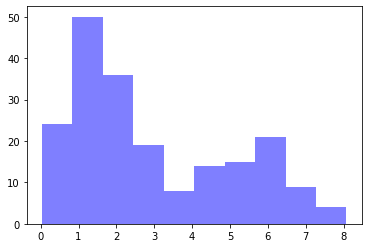

alpha: 0.9999463 , beta: 0.43035412 , initial_unconfirmed 20.980328 , t0s 0.52417094 , lambds 0.708433


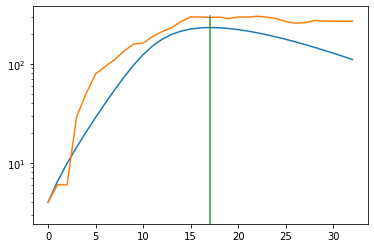

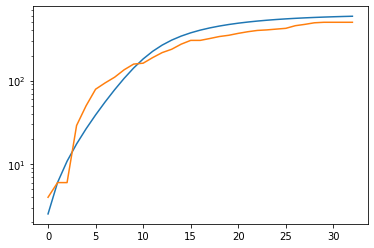

total error: 0.03368658199906349


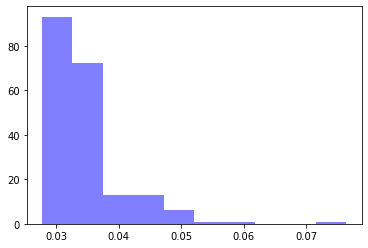

alpha: 0.78987455 , beta: 0.35041845 , initial_unconfirmed 47.003452 , t0s 0.0 , lambds 0.5841493


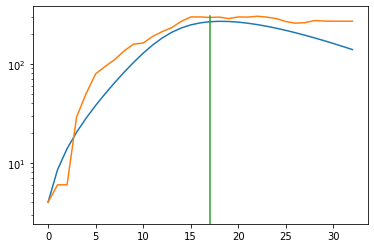

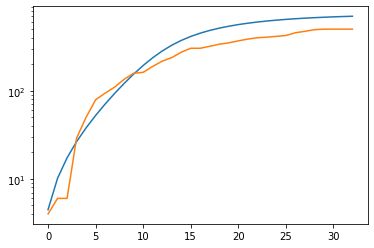

total error: 0.03204197809100151


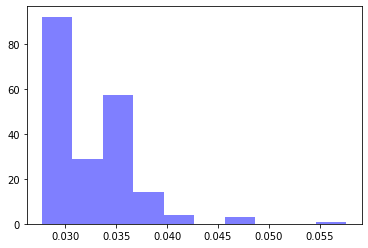

alpha: 0.78987896 , beta: 0.35041288 , initial_unconfirmed 47.004208 , t0s 0.0 , lambds 0.58414096


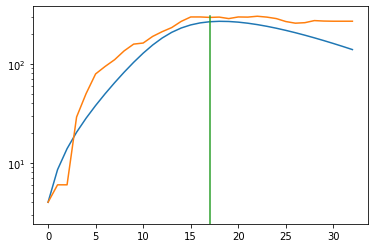

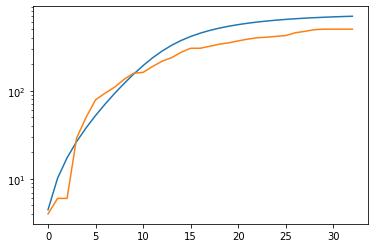

total error: 0.031102659180760384


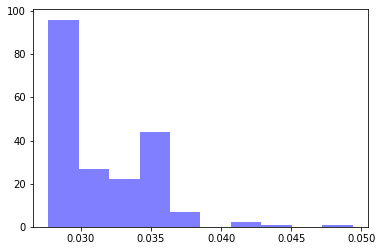

alpha: 0.78987896 , beta: 0.35041288 , initial_unconfirmed 47.004208 , t0s 0.0 , lambds 0.58414096


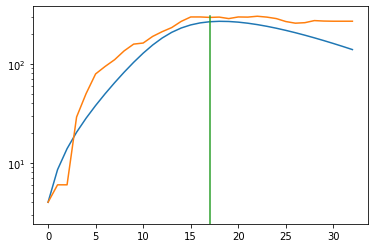

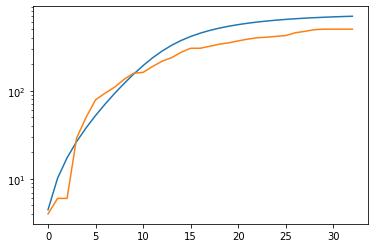

total error: 0.03019488975405693


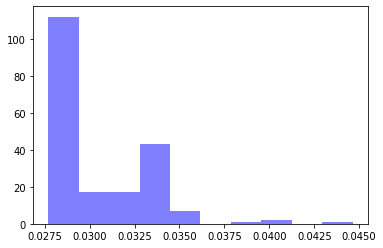

alpha: 0.78987896 , beta: 0.35041288 , initial_unconfirmed 47.004208 , t0s 0.0 , lambds 0.58414096


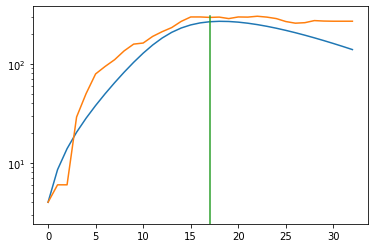

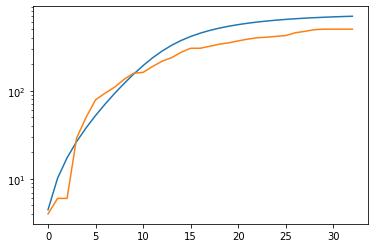

Cameroon
total error: 4.540797710418701


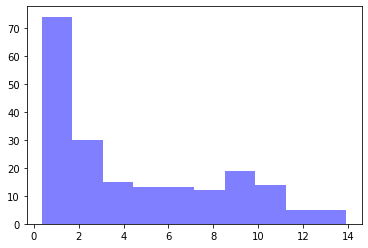

alpha: 0.99995005 , beta: 0.5637655 , initial_unconfirmed 1.205799 , t0s 0.6638276 , lambds 0.59259176


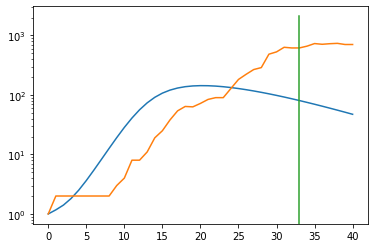

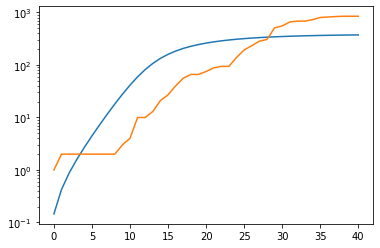

total error: 0.19107729196548462


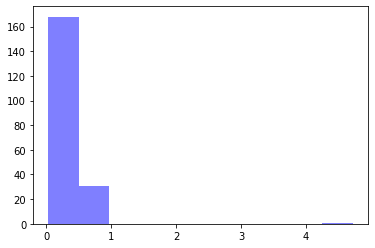

alpha: 0.5039309 , beta: 0.33606482 , initial_unconfirmed 3.5965903 , t0s 3.358336 , lambds 0.23797259


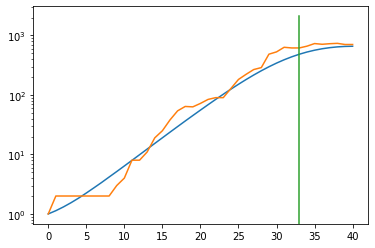

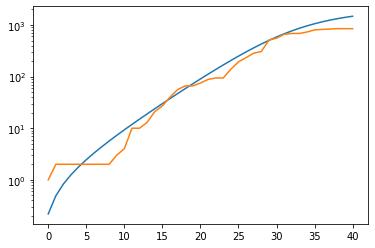

total error: 0.06098252907395363


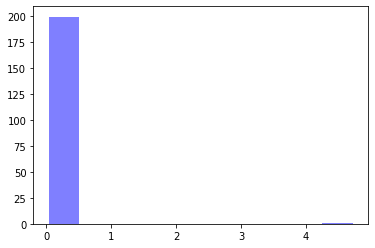

alpha: 0.99996305 , beta: 0.32532635 , initial_unconfirmed 1.9537098 , t0s 20.92041 , lambds 0.682067


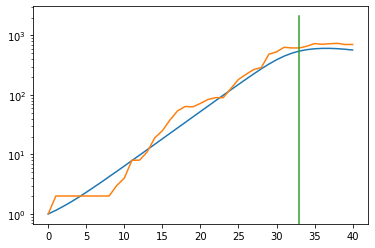

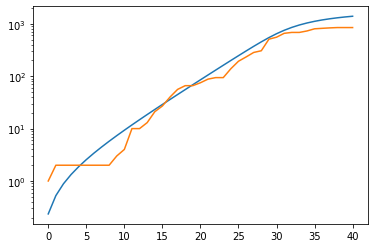

total error: 0.0595938079059124


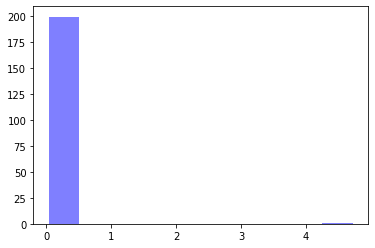

alpha: 0.999963 , beta: 0.3251908 , initial_unconfirmed 1.9481249 , t0s 22.412468 , lambds 0.8104655


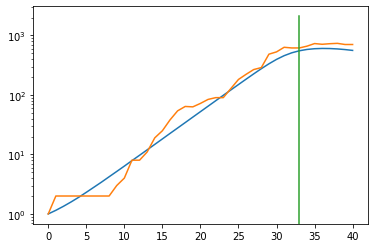

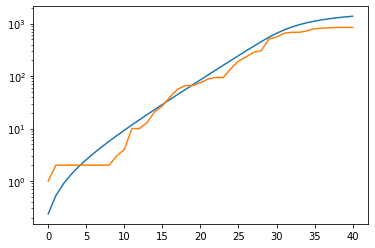

total error: 0.05949811637401581


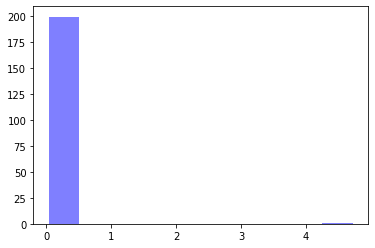

alpha: 0.99996305 , beta: 0.32498288 , initial_unconfirmed 1.9517157 , t0s 23.026087 , lambds 0.8768066


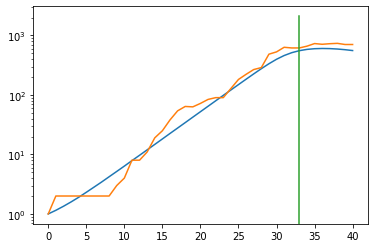

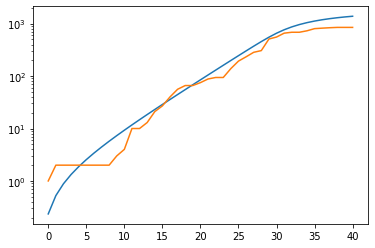

Kuwait
total error: 3.893263339996338


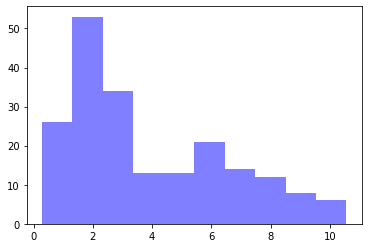

alpha: 0.99946004 , beta: 0.29490834 , initial_unconfirmed 37.072643 , t0s 0.9502291 , lambds 0.5048514


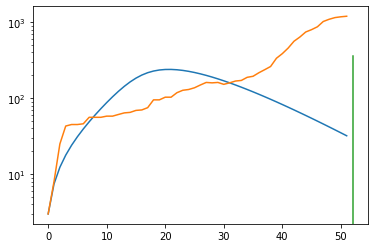

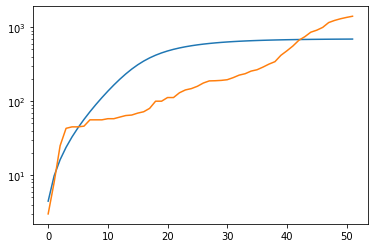

total error: 0.16984476149082184


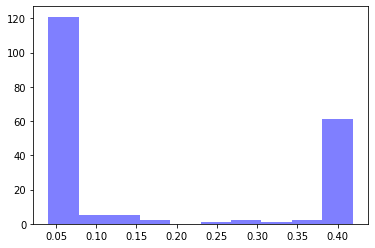

alpha: 0.9999972 , beta: 0.18183166 , initial_unconfirmed 35.206257 , t0s 4.8574786 , lambds 0.003429498


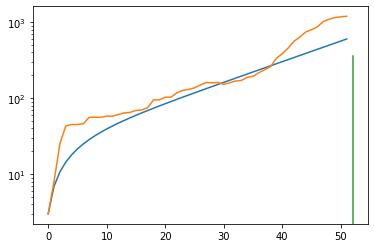

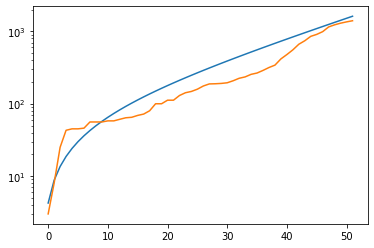

total error: 0.07314872741699219


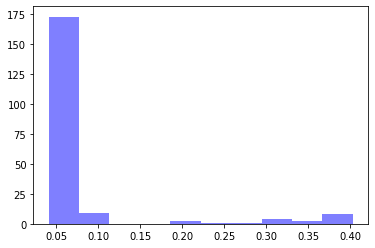

alpha: 0.9999972 , beta: 0.18186884 , initial_unconfirmed 35.164303 , t0s 4.8812184 , lambds 0.0014180602


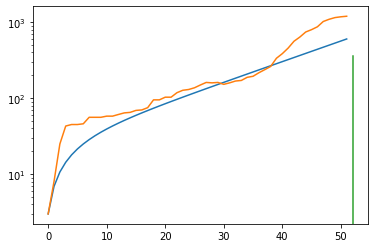

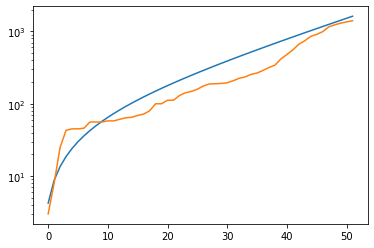

total error: 0.04261751100420952


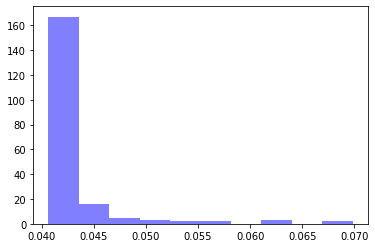

alpha: 0.99999714 , beta: 0.18189366 , initial_unconfirmed 35.137928 , t0s 4.8880887 , lambds 0.0008095557


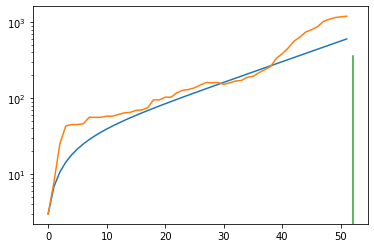

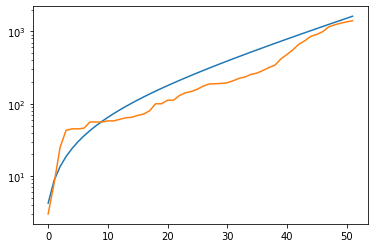

total error: 0.04144486412405968


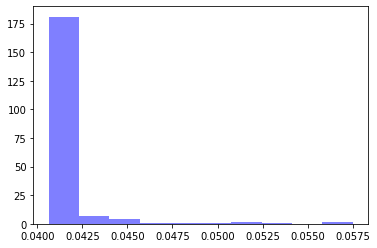

alpha: 0.99999714 , beta: 0.18190639 , initial_unconfirmed 35.124413 , t0s 4.891478 , lambds 0.0004921005


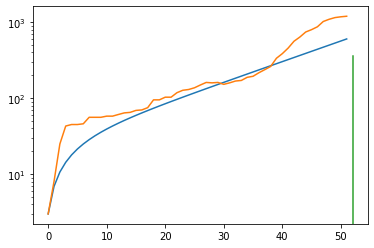

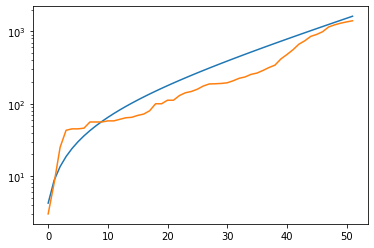

Bahrain
total error: 3.6333553791046143


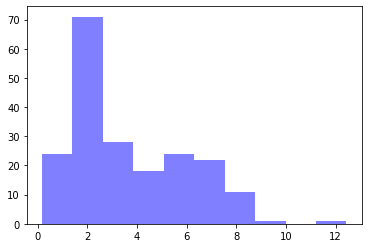

alpha: 0.99989164 , beta: 0.33130854 , initial_unconfirmed 31.282389 , t0s 0.119690895 , lambds 0.51638263


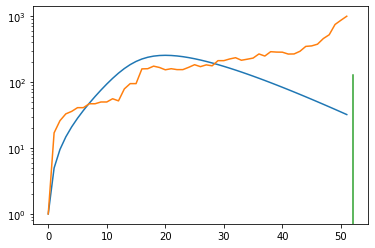

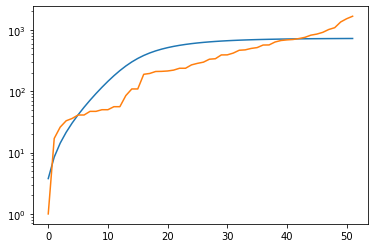

total error: 0.11939364671707153


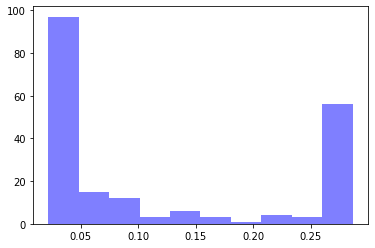

alpha: 0.99999803 , beta: 0.17078108 , initial_unconfirmed 51.816387 , t0s 4.681684 , lambds 0.0068814177


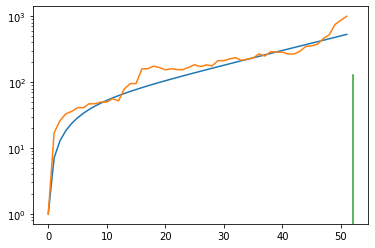

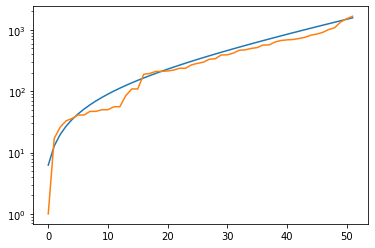

total error: 0.05278055742383003


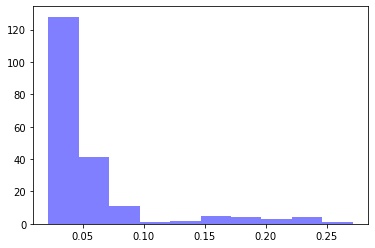

alpha: 0.999998 , beta: 0.17087741 , initial_unconfirmed 51.670948 , t0s 4.702627 , lambds 0.0044287923


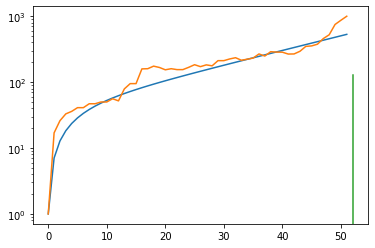

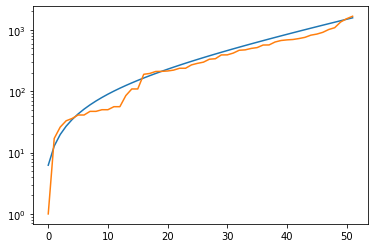

total error: 0.029007425531744957


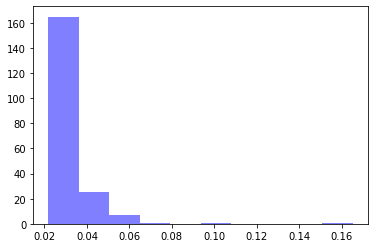

alpha: 0.999998 , beta: 0.17095816 , initial_unconfirmed 51.551838 , t0s 4.7132835 , lambds 0.003085129


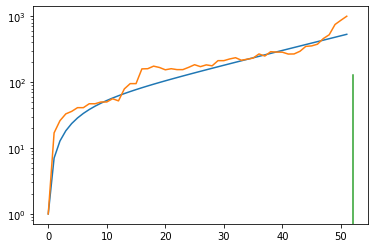

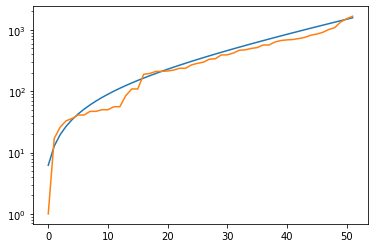

total error: 0.025750262662768364


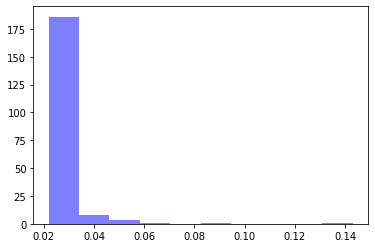

alpha: 0.999998 , beta: 0.17100467 , initial_unconfirmed 51.48337 , t0s 4.719178 , lambds 0.0022707852


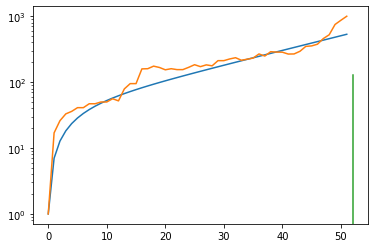

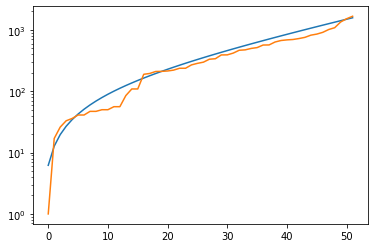

Christmas Island
Germany
total error: 7.47061824798584


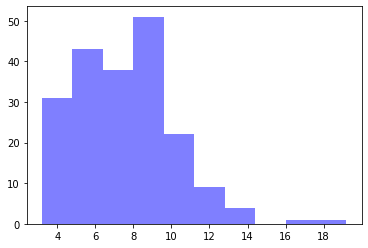

alpha: 0.9993273 , beta: 0.99603003 , initial_unconfirmed 0.27014017 , t0s 0.7888813 , lambds 0.6569739


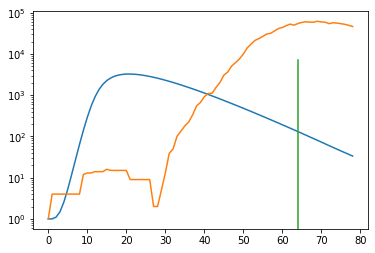

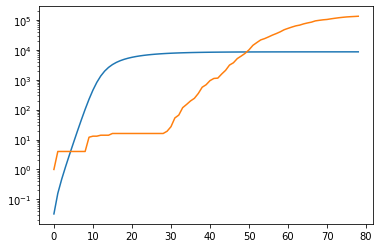

total error: 0.8769201040267944


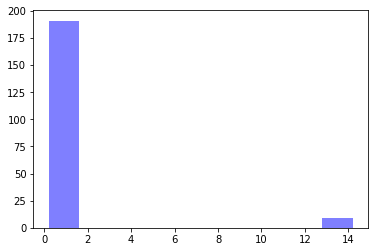

alpha: 0.9990144 , beta: 0.3006357 , initial_unconfirmed 1.2143134 , t0s 3.5030951 , lambds 0.094618596


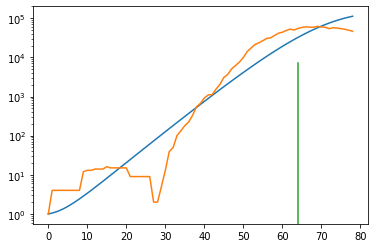

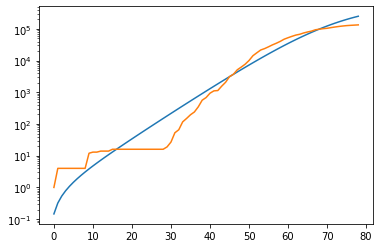

total error: 0.8373634815216064


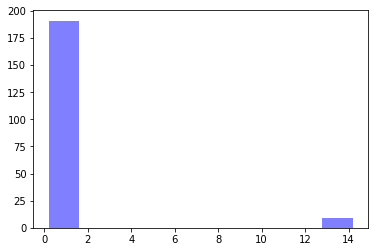

alpha: 0.50999314 , beta: 0.30140385 , initial_unconfirmed 2.2818294 , t0s 4.887133 , lambds 0.097184345


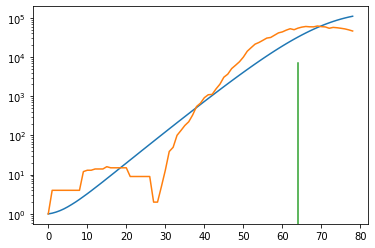

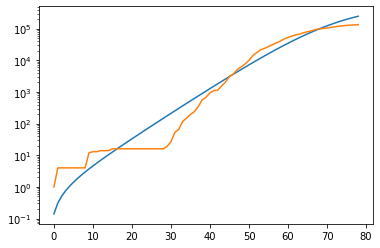

total error: 0.8341536521911621


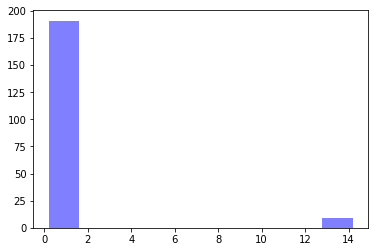

alpha: 0.9283494 , beta: 0.30136624 , initial_unconfirmed 1.2635256 , t0s 8.280108 , lambds 0.104437


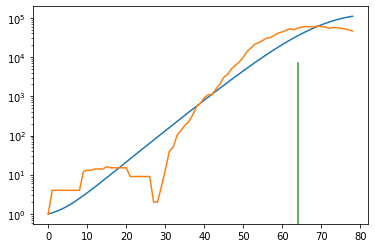

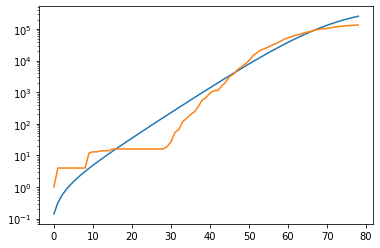

total error: 0.8322400450706482


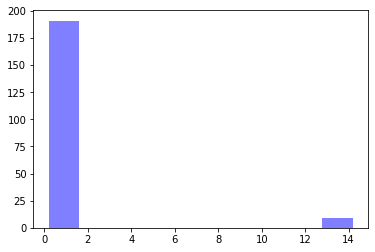

alpha: 0.98343396 , beta: 0.30101672 , initial_unconfirmed 1.18576 , t0s 13.505243 , lambds 0.117055155


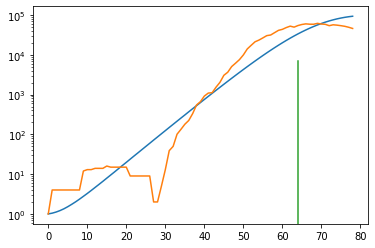

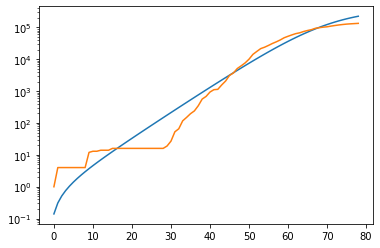

Cuba
total error: 3.7896475791931152


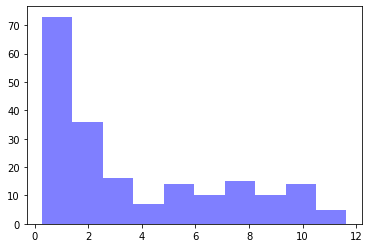

alpha: 0.9574337 , beta: 0.30970624 , initial_unconfirmed 14.097357 , t0s 0.072674334 , lambds 0.57287425


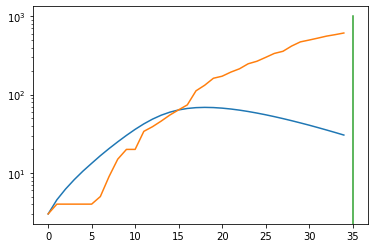

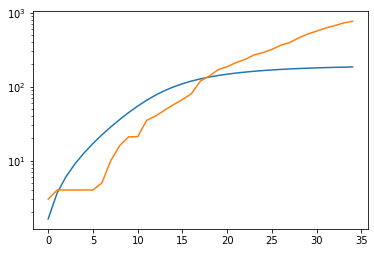

total error: 0.10946983098983765


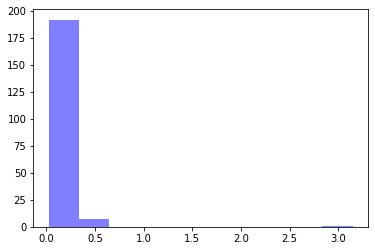

alpha: 0.5683907 , beta: 0.31482813 , initial_unconfirmed 11.361897 , t0s 0.0 , lambds 0.25593963


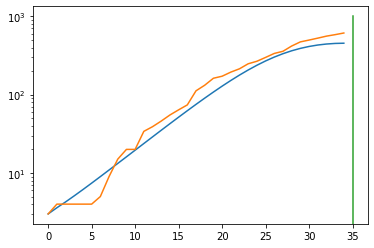

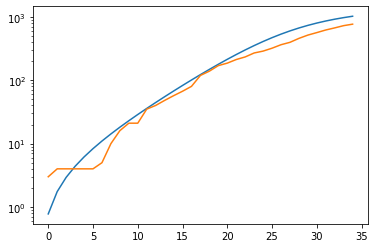

total error: 0.03939161077141762


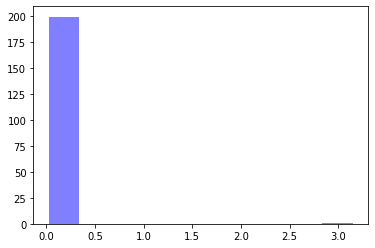

alpha: 0.502455 , beta: 0.3148262 , initial_unconfirmed 12.853238 , t0s 0.0 , lambds 0.25593743


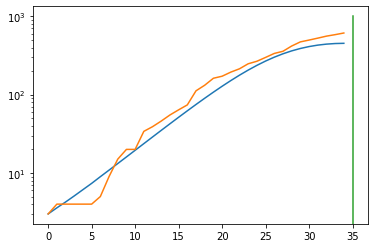

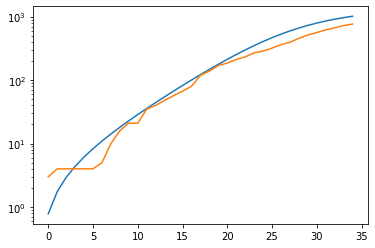

total error: 0.03811934217810631


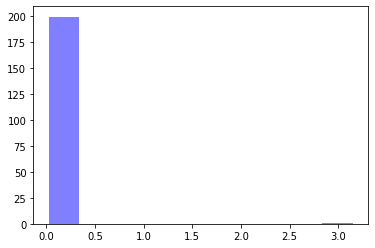

alpha: 0.502455 , beta: 0.3148262 , initial_unconfirmed 12.853238 , t0s 0.0 , lambds 0.25593743


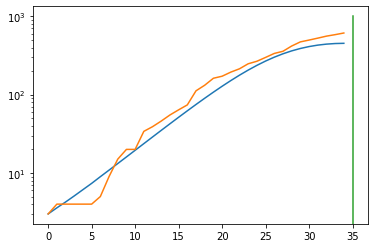

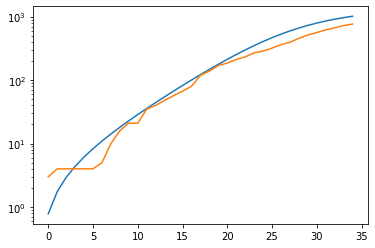

total error: 0.0381002314388752


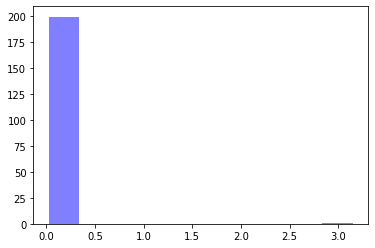

alpha: 0.502455 , beta: 0.3148262 , initial_unconfirmed 12.853238 , t0s 0.0 , lambds 0.25593743


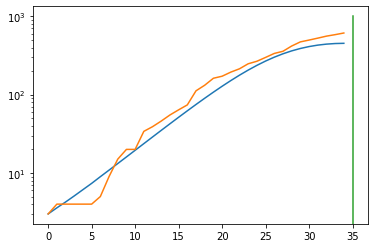

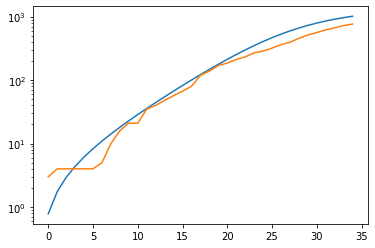

St. Helena
Tuvalu
Turks and Caicos Islands
total error: 3.1162896156311035


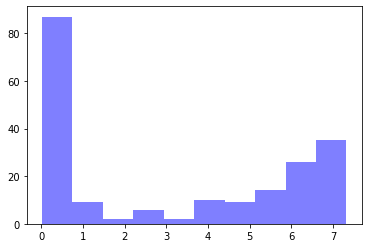

alpha: 0.99969006 , beta: 0.052009687 , initial_unconfirmed 9.923074 , t0s 0.19805378 , lambds 0.5136643


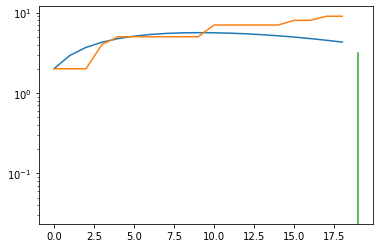

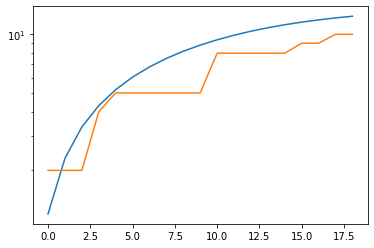

total error: 0.025877593085169792


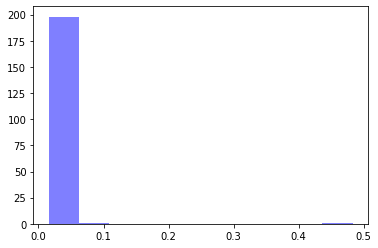

alpha: 0.9999924 , beta: 0.108784616 , initial_unconfirmed 6.90086 , t0s 2.1147125 , lambds 0.0031228794


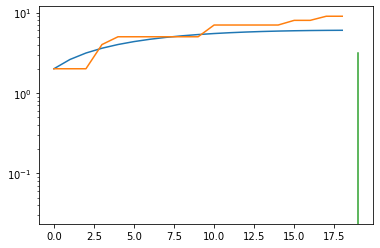

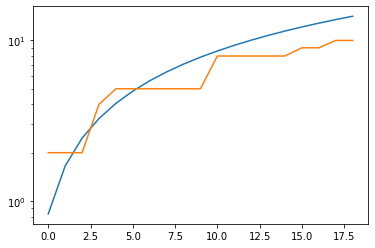

total error: 0.021857788786292076


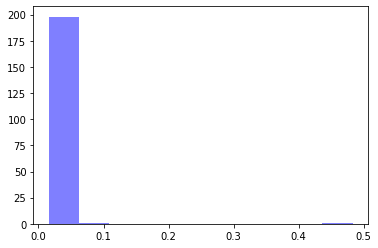

alpha: 0.9981855 , beta: 0.108783975 , initial_unconfirmed 6.913363 , t0s 2.8370004 , lambds 0.0019385435


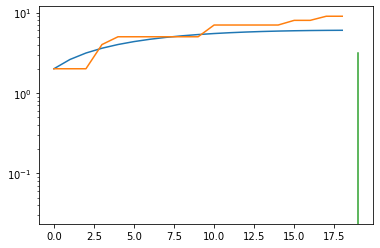

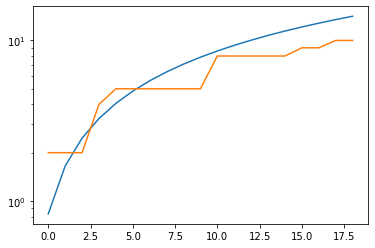

total error: 0.02048402838408947


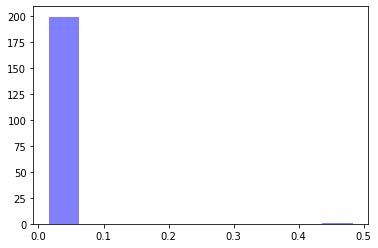

alpha: 0.9981861 , beta: 0.10878358 , initial_unconfirmed 6.913359 , t0s 2.8375733 , lambds 0.0015259585


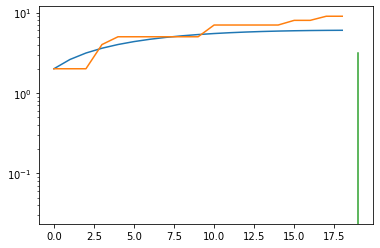

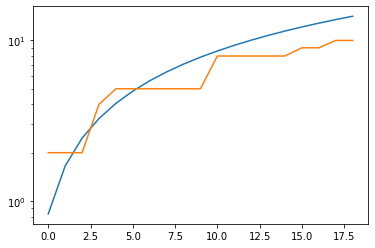

total error: 0.0198501069098711


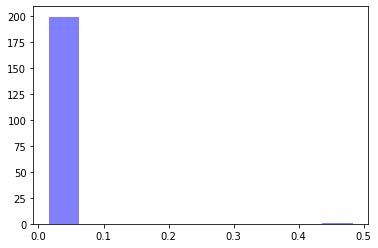

alpha: 0.9981861 , beta: 0.10878358 , initial_unconfirmed 6.913359 , t0s 2.8375733 , lambds 0.0015259585


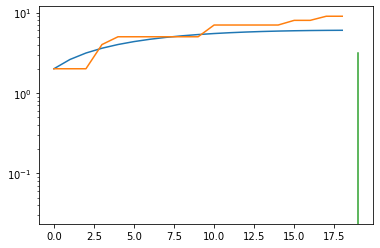

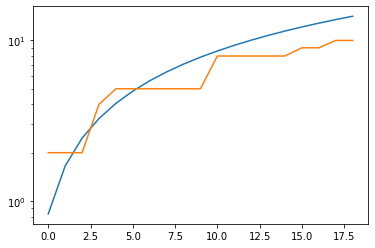

Sweden
total error: 7.116938591003418


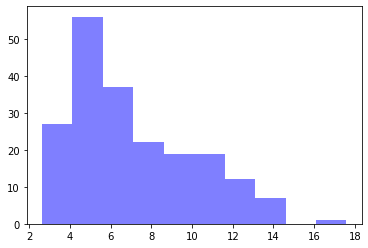

alpha: 0.99859524 , beta: 0.48759228 , initial_unconfirmed 6.8775296 , t0s 0.2794565 , lambds 0.5561291


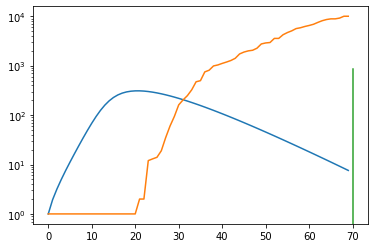

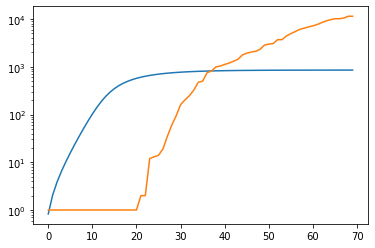

total error: 0.9770993590354919


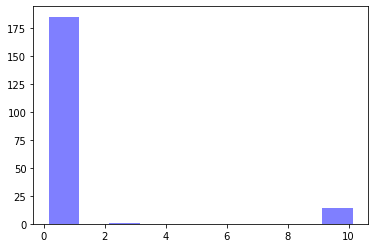

alpha: 0.5026073 , beta: 0.3441863 , initial_unconfirmed 0.39494666 , t0s 4.0287647 , lambds 0.13869445


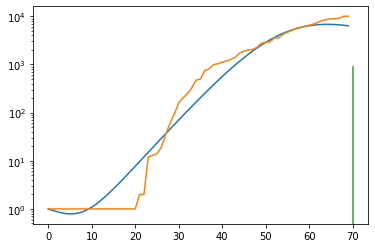

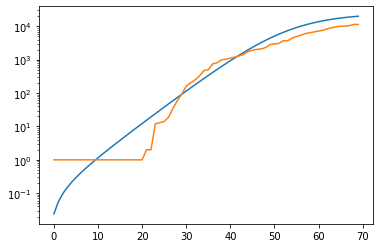

total error: 0.8645875453948975


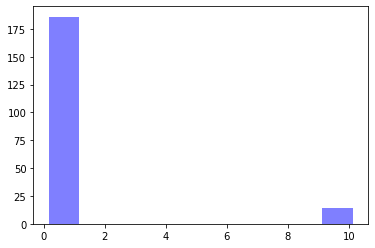

alpha: 0.99989045 , beta: 0.34081325 , initial_unconfirmed 0.20496815 , t0s 12.257434 , lambds 0.16921604


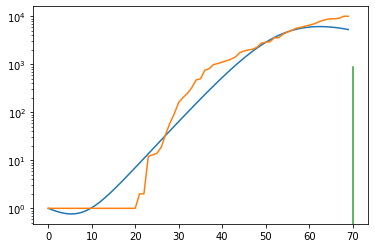

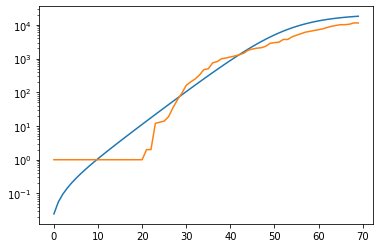

total error: 0.8538907766342163


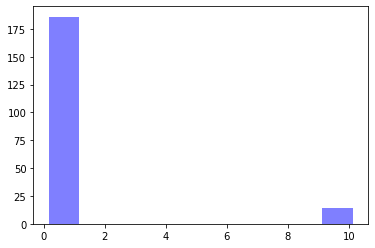

alpha: 0.99989045 , beta: 0.34081325 , initial_unconfirmed 0.20496815 , t0s 12.257434 , lambds 0.16921604


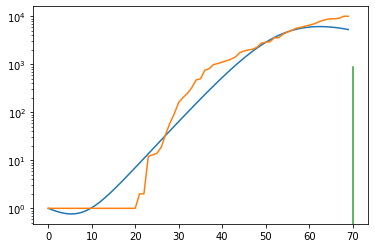

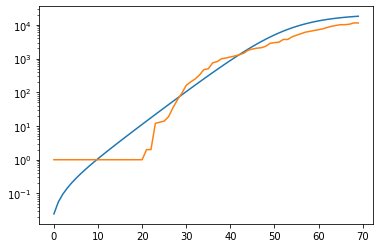

total error: 0.8517338037490845


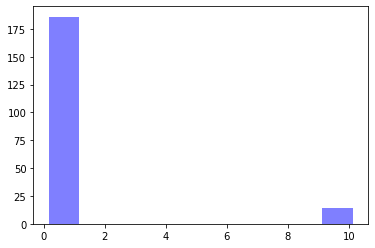

alpha: 0.99989045 , beta: 0.34081325 , initial_unconfirmed 0.20496815 , t0s 12.257434 , lambds 0.16921604


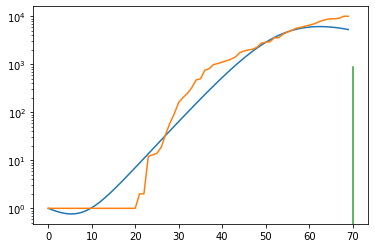

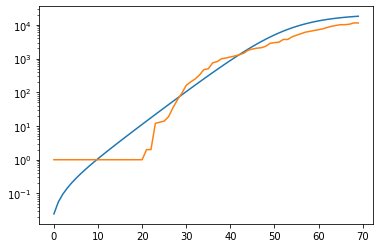

Italy
total error: 7.385123252868652


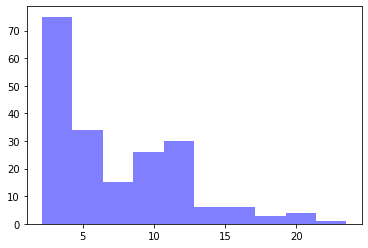

alpha: 0.99893796 , beta: 0.83406806 , initial_unconfirmed 4.5555234 , t0s 0.38149625 , lambds 0.533888


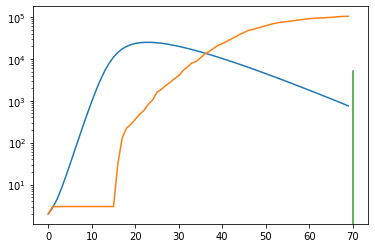

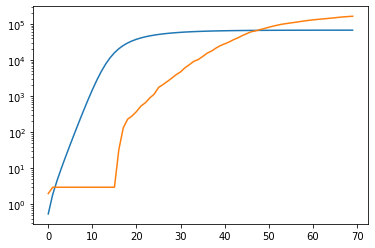

total error: 0.6062767505645752


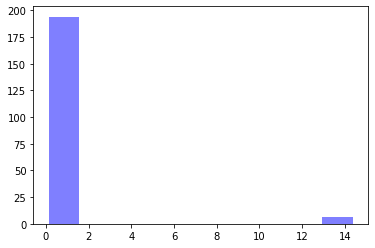

alpha: 0.548143 , beta: 0.42350742 , initial_unconfirmed 1.933918 , t0s 0.0 , lambds 0.16302703


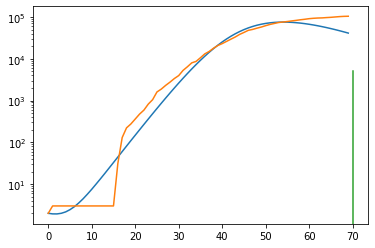

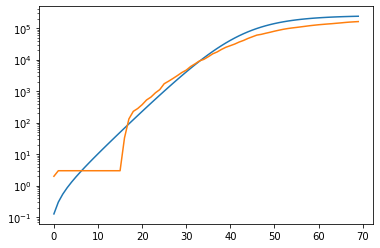

total error: 0.5526991486549377


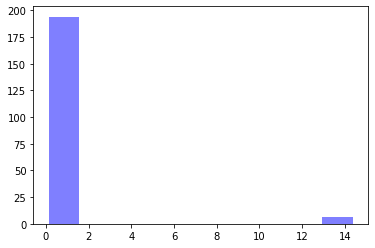

alpha: 0.86523986 , beta: 0.42292324 , initial_unconfirmed 1.2397983 , t0s 0.0 , lambds 0.16291493


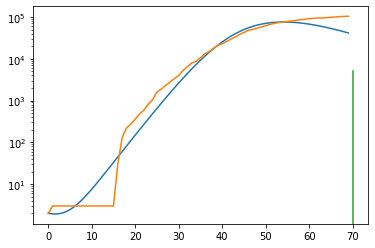

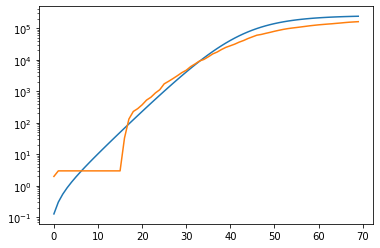

total error: 0.5471038222312927


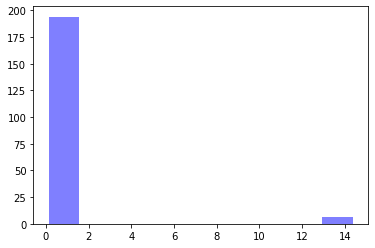

alpha: 0.9856151 , beta: 0.42306033 , initial_unconfirmed 1.0873535 , t0s 0.0 , lambds 0.16298407


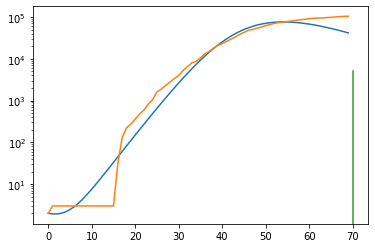

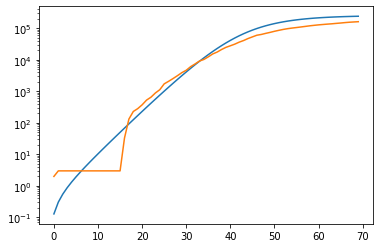

total error: 0.547095537185669


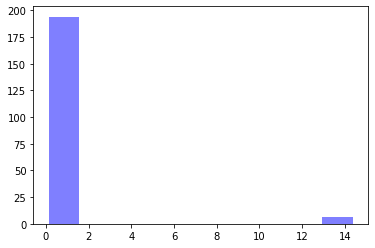

alpha: 0.9856151 , beta: 0.42306033 , initial_unconfirmed 1.0873535 , t0s 0.0 , lambds 0.16298407


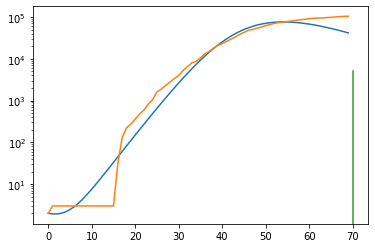

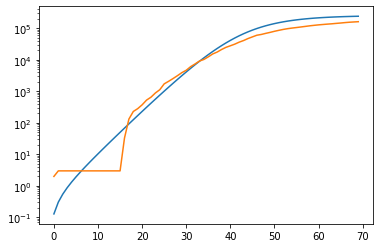

Nepal
total error: 8.03138256072998


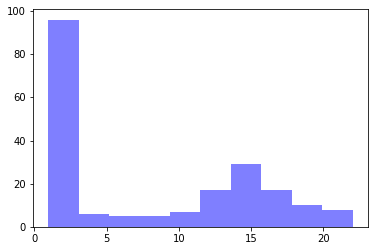

alpha: 0.9950192 , beta: 0.3118864 , initial_unconfirmed 0.390473 , t0s 0.070175946 , lambds 0.6311531


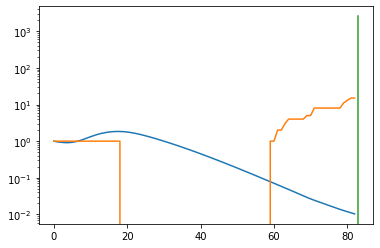

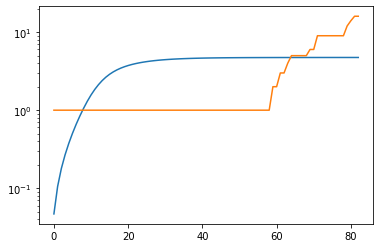

total error: 1.6770083904266357


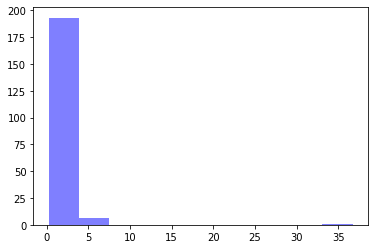

alpha: 0.9906396 , beta: 0.15134612 , initial_unconfirmed 0.29612145 , t0s 3.3201456 , lambds 0.03147361


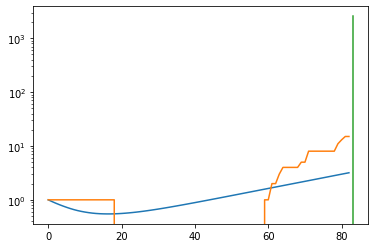

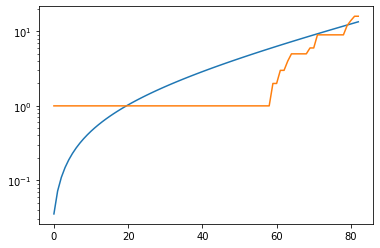

total error: 1.7264773845672607


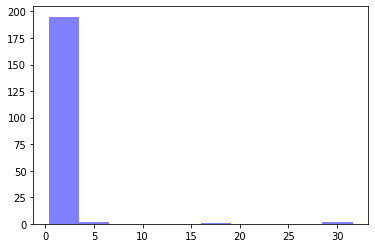

alpha: 0.9906396 , beta: 0.15134612 , initial_unconfirmed 0.29612145 , t0s 3.3201456 , lambds 0.03147361


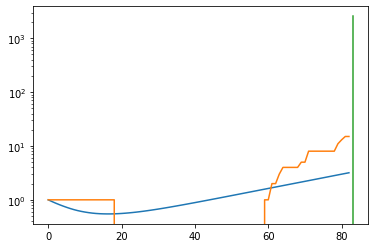

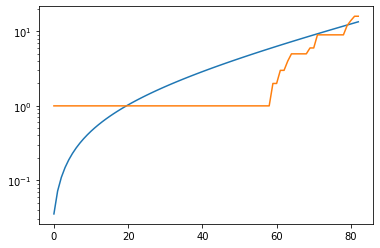

total error: 1.6178456544876099


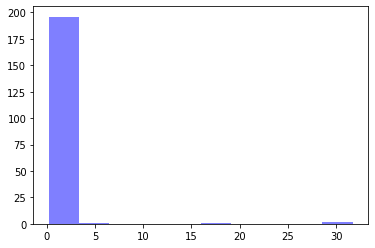

alpha: 0.9906396 , beta: 0.15134612 , initial_unconfirmed 0.29612145 , t0s 3.3201456 , lambds 0.03147361


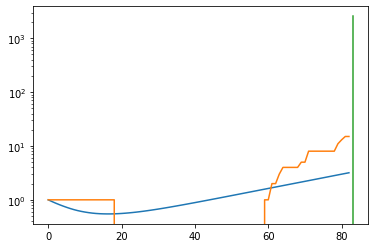

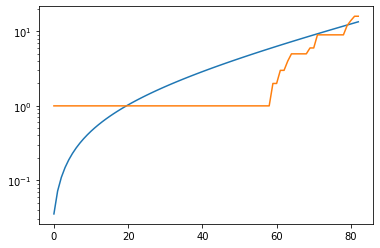

total error: 1.5734000205993652


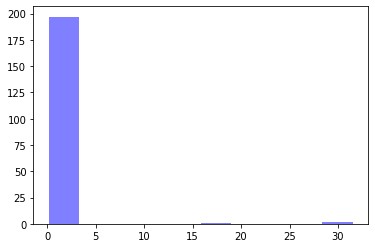

alpha: 0.9906396 , beta: 0.15134612 , initial_unconfirmed 0.29612145 , t0s 3.3201456 , lambds 0.03147361


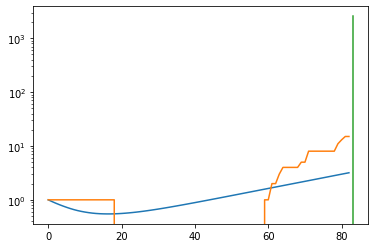

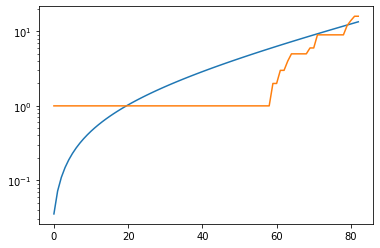

Norfolk Island
Aland Islands
Thailand
total error: 6.385951995849609


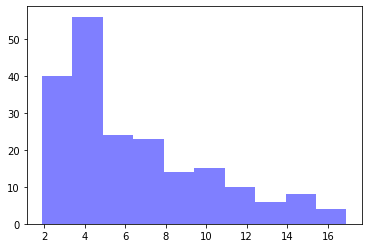

alpha: 0.9859816 , beta: 0.42526823 , initial_unconfirmed 10.172665 , t0s 0.5534655 , lambds 0.64588624


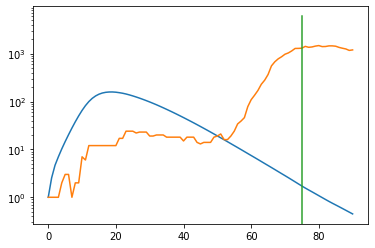

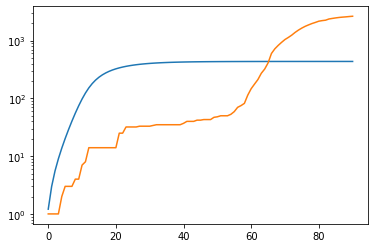

total error: 3.910670757293701


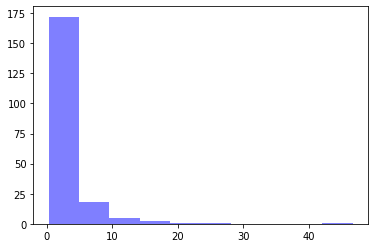

alpha: 0.8737543 , beta: 0.18746604 , initial_unconfirmed 5.1860228 , t0s 4.454461 , lambds 0.051071484


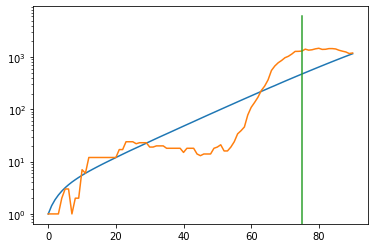

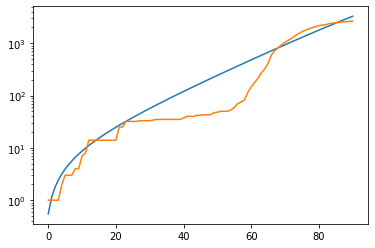

total error: 3.2195868492126465


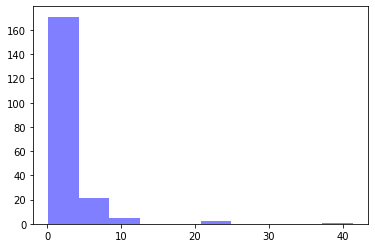

alpha: 0.8737543 , beta: 0.18746604 , initial_unconfirmed 5.1860228 , t0s 4.454461 , lambds 0.051071484


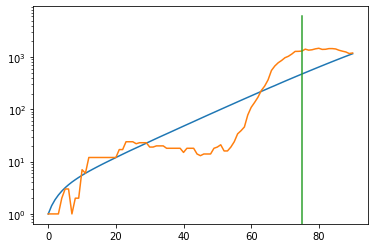

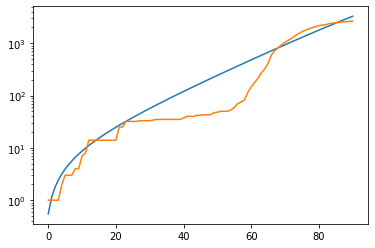

total error: 2.9412059783935547


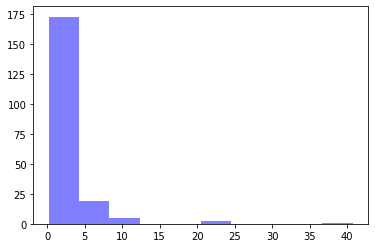

alpha: 0.8737543 , beta: 0.18746604 , initial_unconfirmed 5.1860228 , t0s 4.454461 , lambds 0.051071484


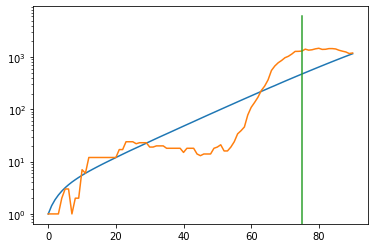

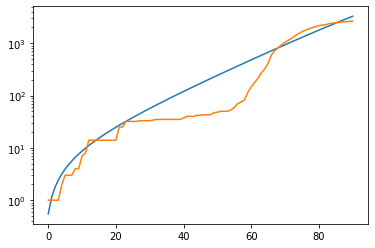

total error: 2.7258520126342773


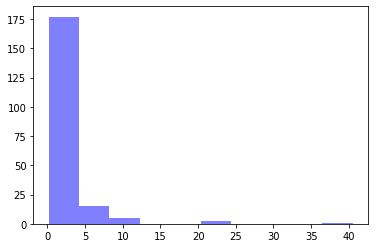

alpha: 0.8737543 , beta: 0.18746604 , initial_unconfirmed 5.1860228 , t0s 4.454461 , lambds 0.051071484


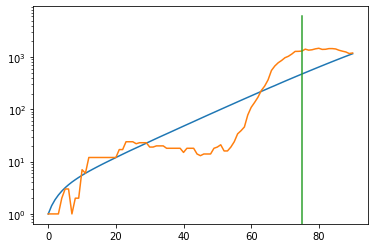

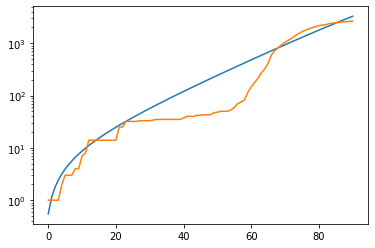

Equatorial Guinea
total error: 5.773730278015137


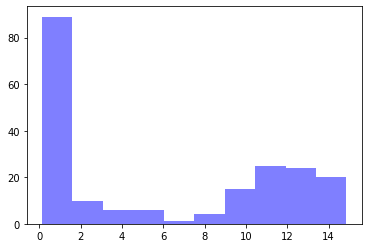

alpha: 0.76788396 , beta: 0.1360958 , initial_unconfirmed 19.042782 , t0s 0.24013698 , lambds 0.6405848


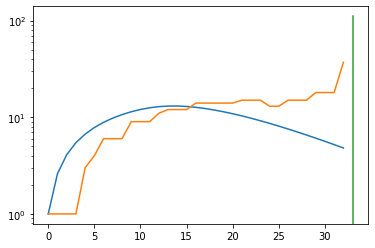

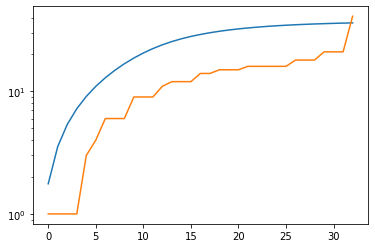

total error: 0.10511079430580139


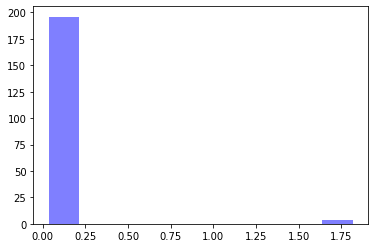

alpha: 0.5044417 , beta: 0.1710265 , initial_unconfirmed 9.651456 , t0s 0.0 , lambds 0.20101395


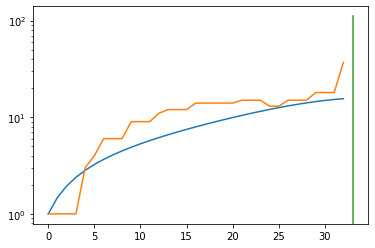

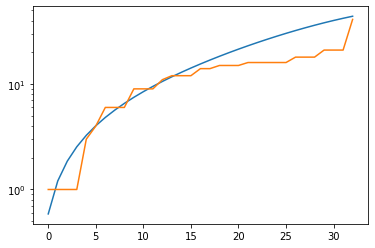

total error: 0.0902995839715004


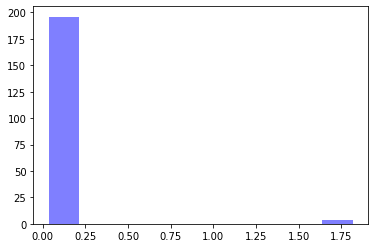

alpha: 0.5018316 , beta: 0.17101954 , initial_unconfirmed 9.703755 , t0s 0.0 , lambds 0.2008174


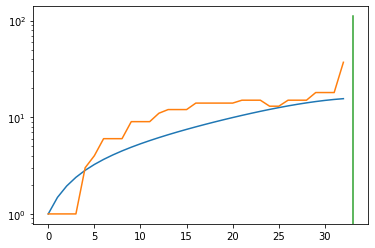

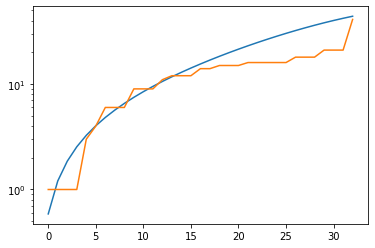

total error: 0.08114103227853775


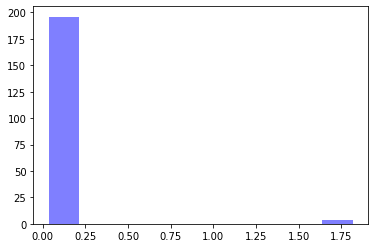

alpha: 0.5063043 , beta: 0.17103612 , initial_unconfirmed 9.616466 , t0s 0.0 , lambds 0.2010698


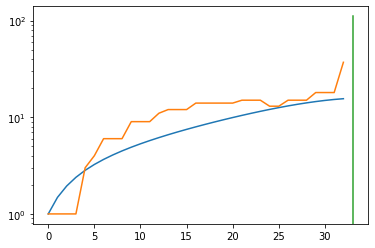

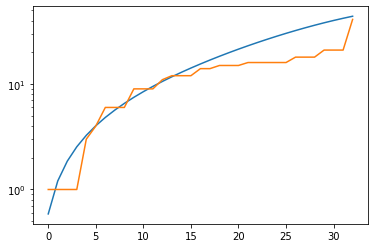

total error: 0.07742820680141449


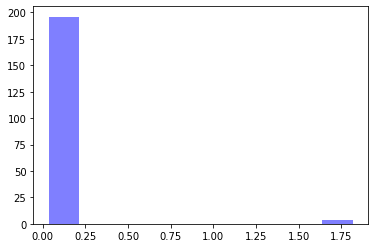

alpha: 0.5063043 , beta: 0.17103612 , initial_unconfirmed 9.616466 , t0s 0.0 , lambds 0.2010698


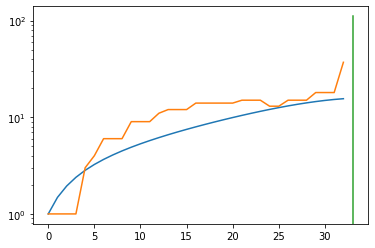

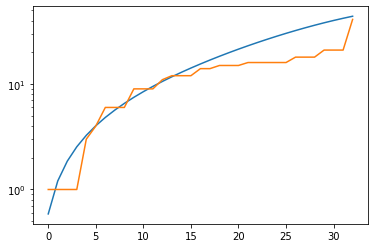

Uzbekistan
total error: 3.314345121383667


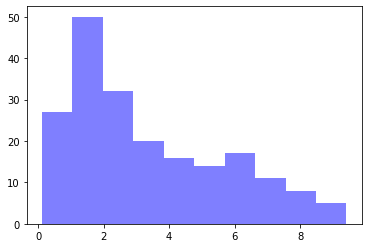

alpha: 0.75025797 , beta: 0.41987917 , initial_unconfirmed 29.98268 , t0s 0.66911936 , lambds 0.6556718


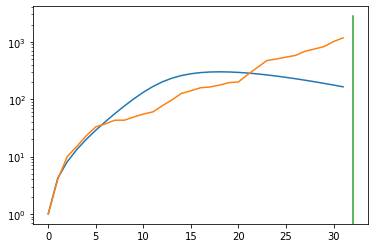

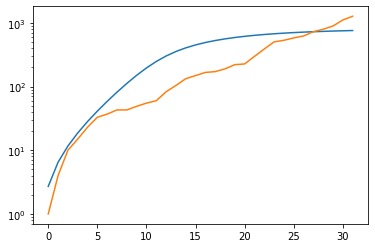

total error: 0.07093212008476257


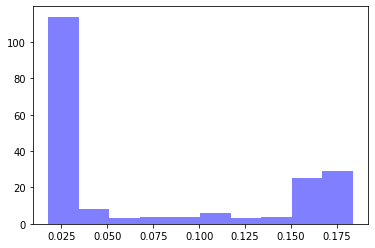

alpha: 0.9993446 , beta: 0.2563719 , initial_unconfirmed 25.556099 , t0s 1.9315977 , lambds 0.14071883


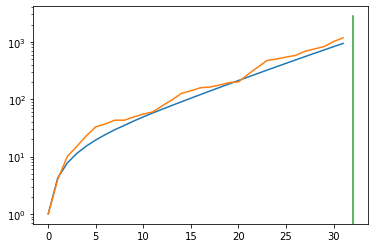

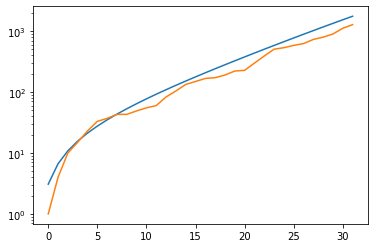

total error: 0.027051646262407303


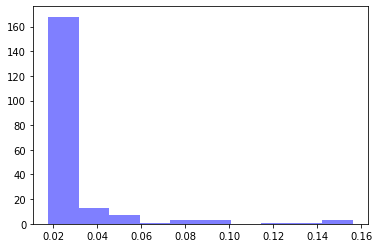

alpha: 0.7352266 , beta: 0.2568587 , initial_unconfirmed 34.655468 , t0s 0.0 , lambds 0.13739604


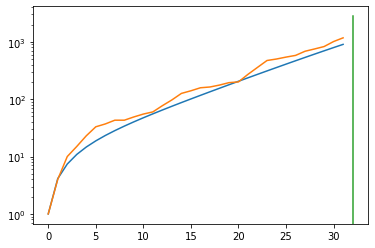

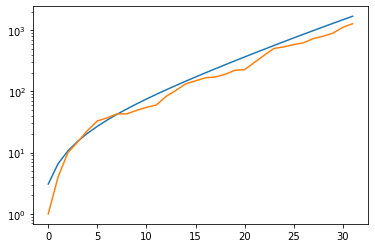

total error: 0.019128883257508278


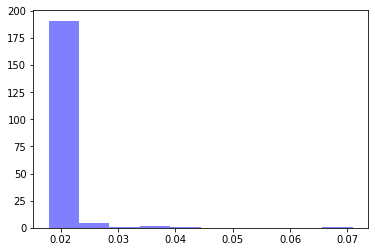

alpha: 0.73581094 , beta: 0.2567188 , initial_unconfirmed 34.657444 , t0s 0.0 , lambds 0.13466063


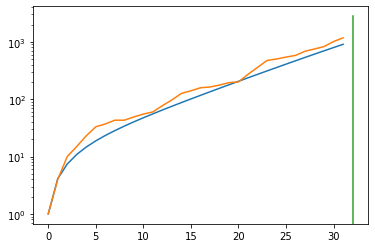

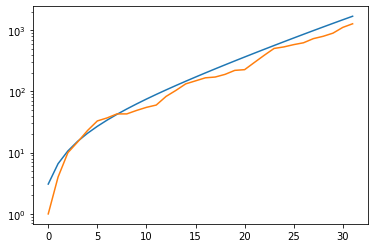

total error: 0.018440747633576393


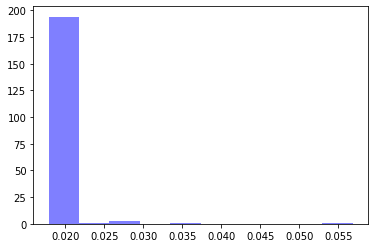

alpha: 0.73608476 , beta: 0.25665513 , initial_unconfirmed 34.65845 , t0s 0.0 , lambds 0.13337566


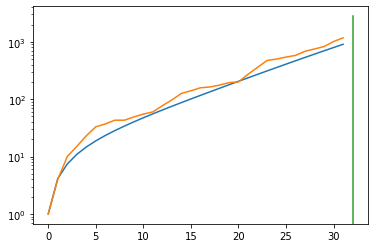

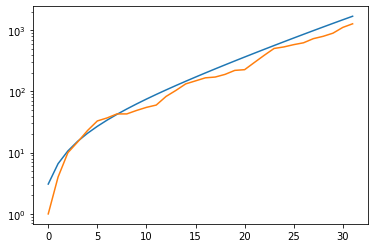

Austria
total error: 4.260832786560059


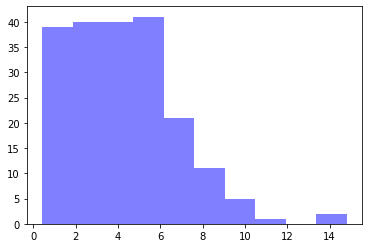

alpha: 0.97792745 , beta: 0.99924856 , initial_unconfirmed 0.14907718 , t0s 0.48576546 , lambds 0.5323552


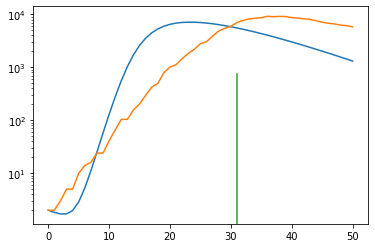

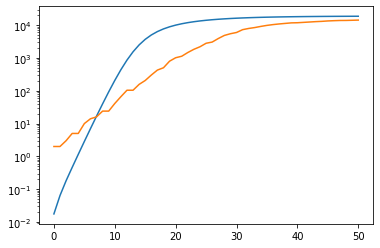

total error: 0.026403488591313362


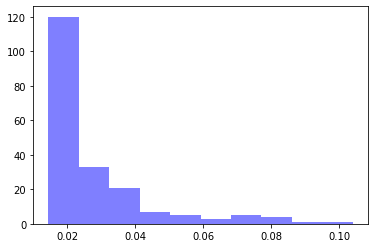

alpha: 0.6673778 , beta: 0.4125895 , initial_unconfirmed 9.675179 , t0s 0.0 , lambds 0.2444584


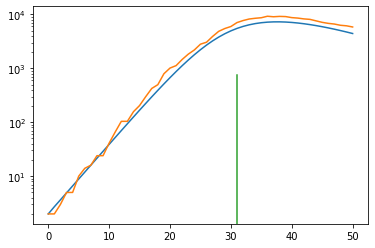

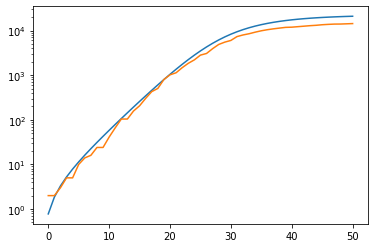

total error: 0.01624154858291149


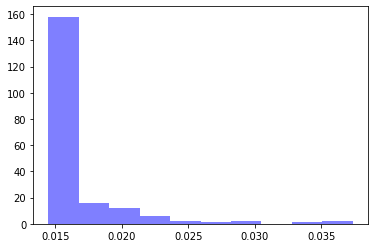

alpha: 0.5057165 , beta: 0.4126237 , initial_unconfirmed 12.763078 , t0s 0.0 , lambds 0.2444297


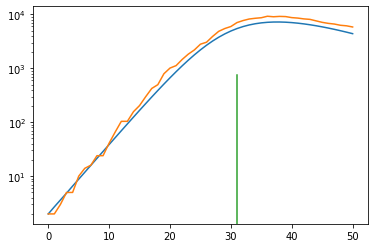

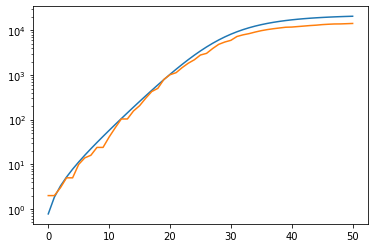

total error: 0.014809087850153446


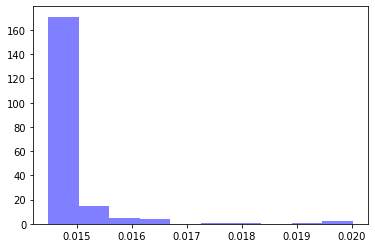

alpha: 0.5057165 , beta: 0.4126237 , initial_unconfirmed 12.763078 , t0s 0.0 , lambds 0.2444297


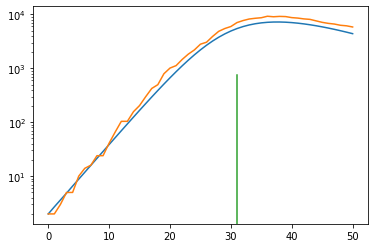

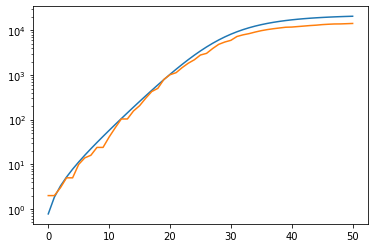

total error: 0.014537393115460873


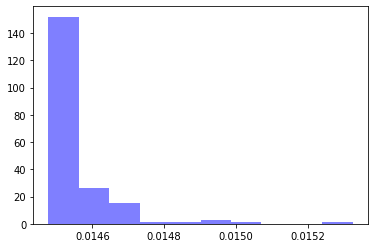

alpha: 0.5057165 , beta: 0.4126237 , initial_unconfirmed 12.763078 , t0s 0.0 , lambds 0.2444297


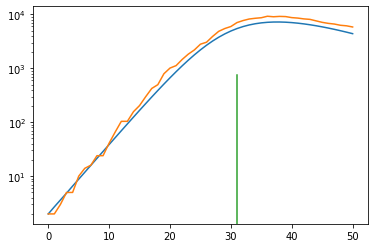

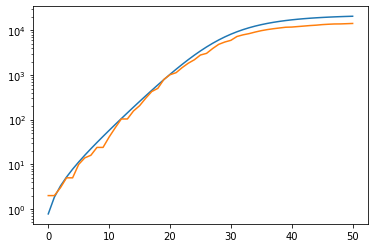

Lithuania
total error: 5.090715408325195


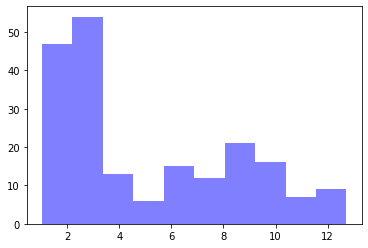

alpha: 0.9999764 , beta: 0.3161568 , initial_unconfirmed 10.87082 , t0s 0.22829217 , lambds 0.5192409


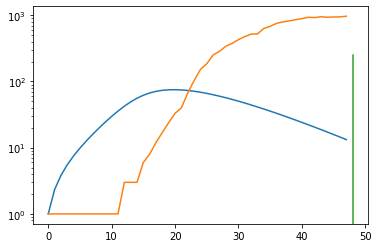

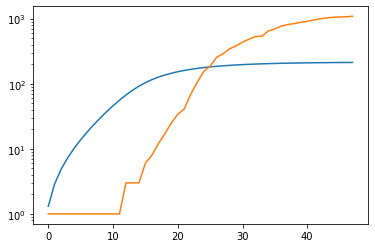

total error: 0.4211012125015259


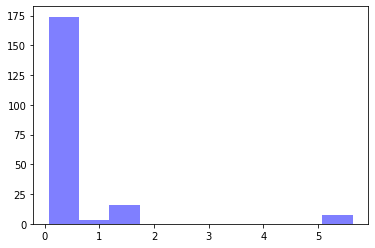

alpha: 0.9994924 , beta: 0.37441036 , initial_unconfirmed 0.47330284 , t0s 5.4515386 , lambds 0.24618563


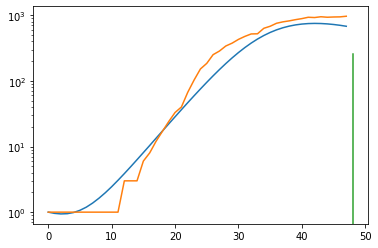

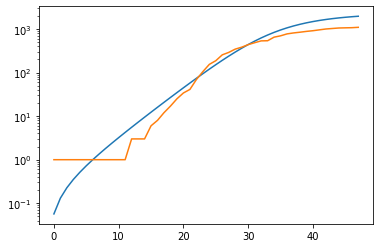

total error: 0.2668198049068451


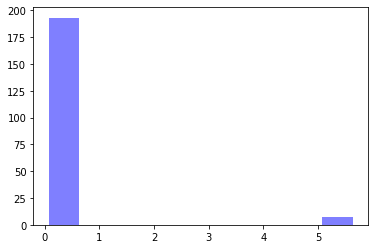

alpha: 0.50083095 , beta: 0.3672353 , initial_unconfirmed 0.99159425 , t0s 15.820558 , lambds 0.4039006


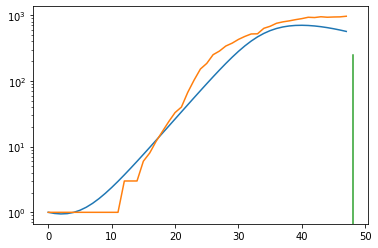

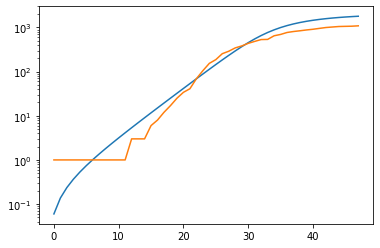

total error: 0.2662435472011566


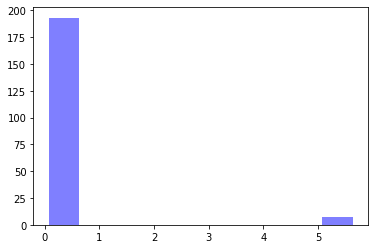

alpha: 0.99949586 , beta: 0.36674067 , initial_unconfirmed 0.49889284 , t0s 16.682043 , lambds 0.4266168


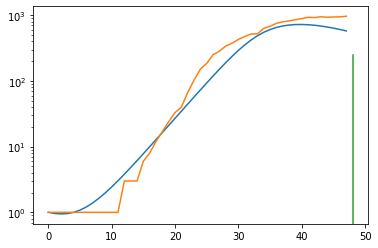

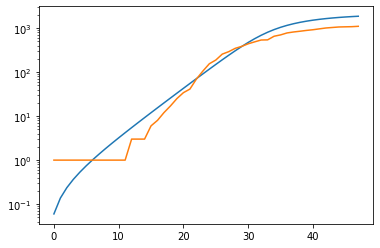

total error: 0.2661195397377014


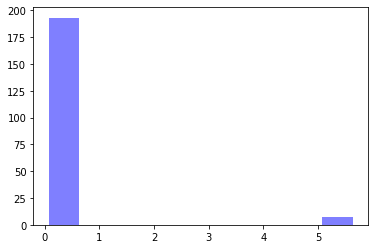

alpha: 0.9994974 , beta: 0.36657333 , initial_unconfirmed 0.49950835 , t0s 16.978256 , lambds 0.43499163


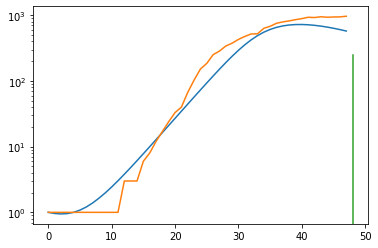

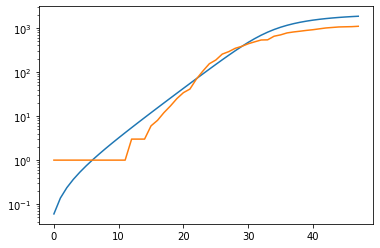

Hungary
total error: 4.083444118499756


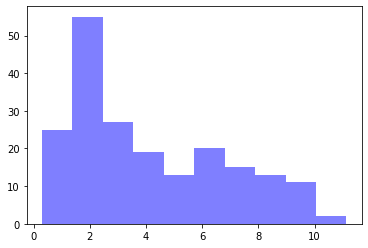

alpha: 0.99982125 , beta: 0.40410757 , initial_unconfirmed 14.9205475 , t0s 0.72772264 , lambds 0.6441774


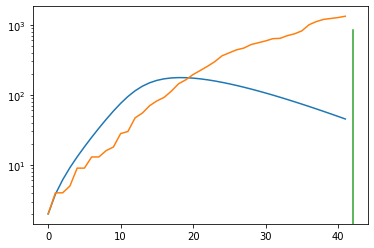

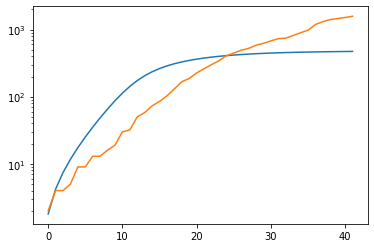

total error: 0.0900709256529808


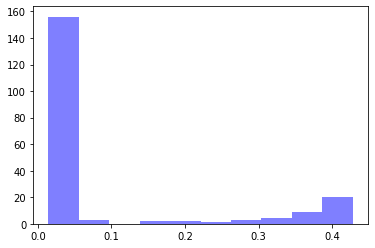

alpha: 0.5061678 , beta: 0.29084575 , initial_unconfirmed 19.912596 , t0s 0.0 , lambds 0.21399555


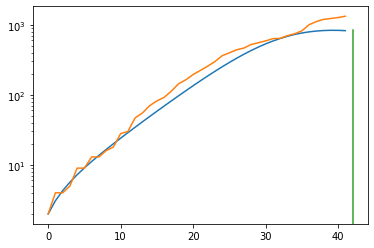

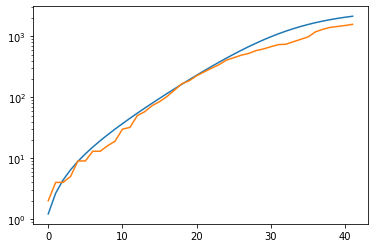

total error: 0.014970818534493446


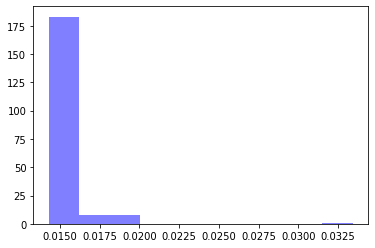

alpha: 0.5018212 , beta: 0.29044852 , initial_unconfirmed 20.196785 , t0s 0.0 , lambds 0.21364614


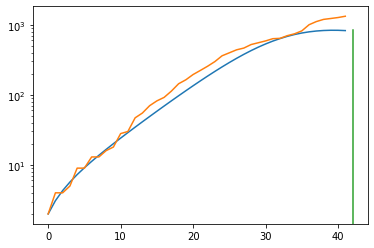

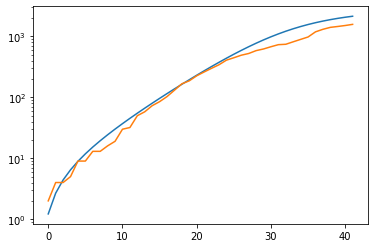

total error: 0.014389313757419586


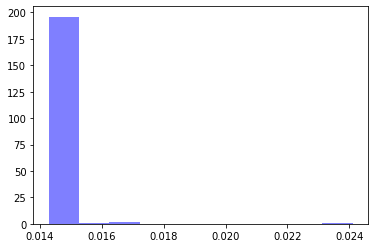

alpha: 0.5011765 , beta: 0.2904653 , initial_unconfirmed 20.21919 , t0s 0.0 , lambds 0.2136563


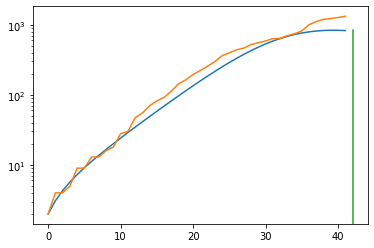

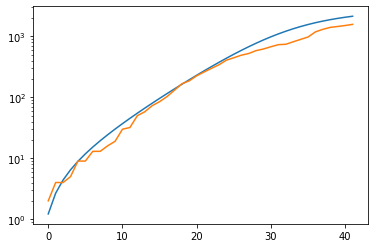

total error: 0.014321854338049889


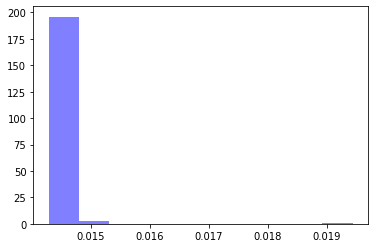

alpha: 0.50330883 , beta: 0.29045916 , initial_unconfirmed 20.135288 , t0s 0.0 , lambds 0.21365069


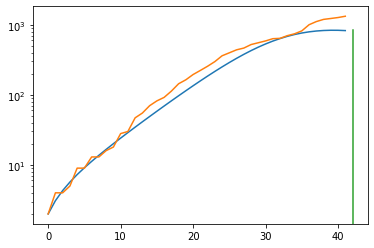

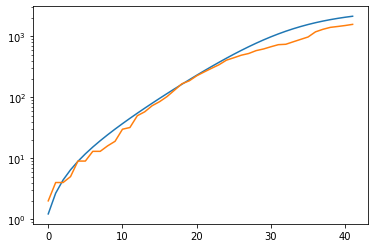

Vietnam
total error: 6.145045280456543


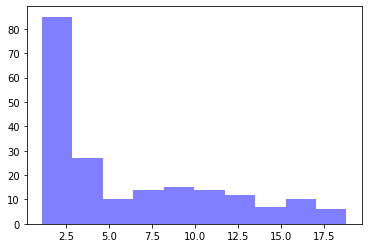

alpha: 0.9993192 , beta: 0.27975586 , initial_unconfirmed 10.423526 , t0s 0.48626888 , lambds 0.5134947


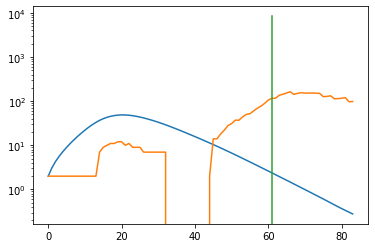

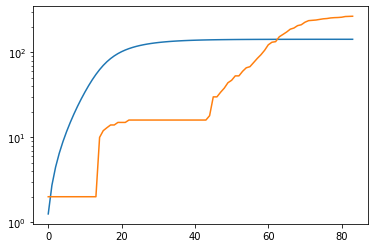

total error: 1.8715662956237793


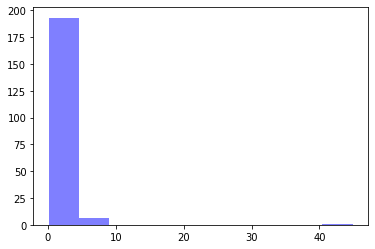

alpha: 0.99998504 , beta: 0.17902201 , initial_unconfirmed 1.9559357 , t0s 1.934884 , lambds 0.04820271


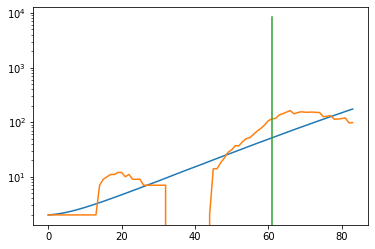

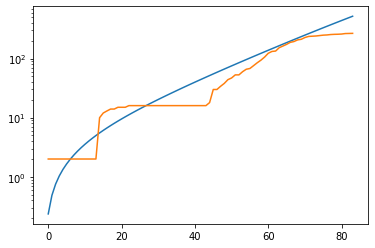

total error: 1.6460658311843872


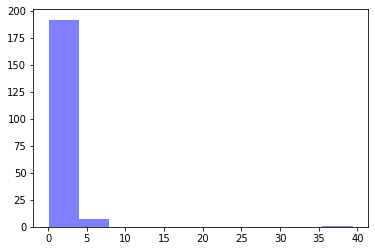

alpha: 0.99993145 , beta: 0.17634712 , initial_unconfirmed 2.1040146 , t0s 4.7358484 , lambds 0.0023127461


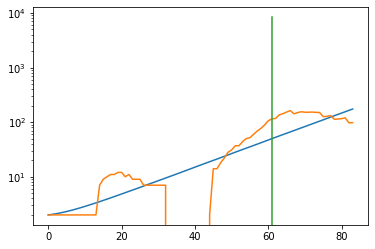

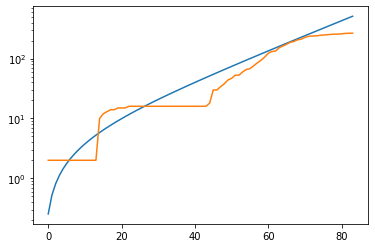

total error: 1.851590871810913


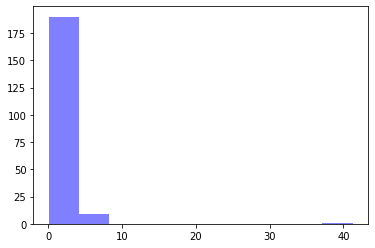

alpha: 0.99993145 , beta: 0.17633618 , initial_unconfirmed 2.1056037 , t0s 4.7358484 , lambds 0.0023127461


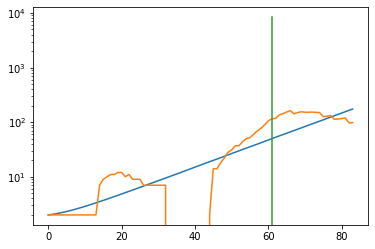

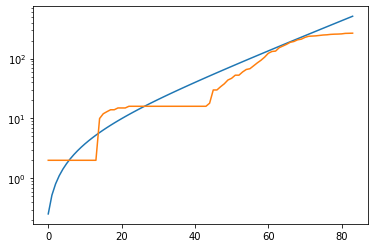

total error: 1.495813012123108


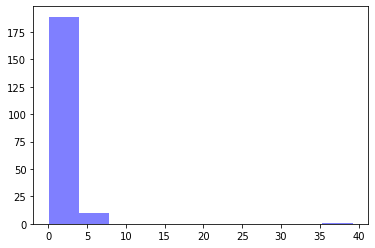

alpha: 0.99993145 , beta: 0.17633618 , initial_unconfirmed 2.1056037 , t0s 4.7358484 , lambds 0.0023127461


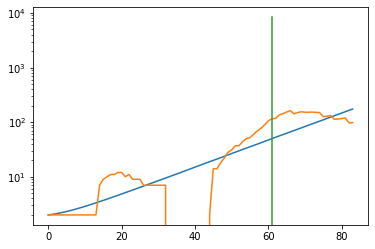

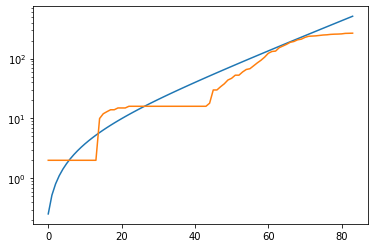

Montserrat
total error: 2.824293613433838


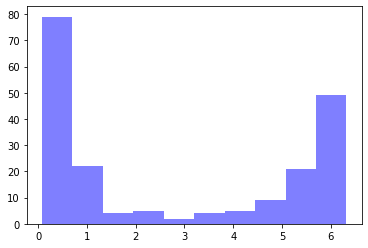

alpha: 0.8793854 , beta: 0.24721907 , initial_unconfirmed 2.2917004 , t0s 0.5798793 , lambds 0.5801244


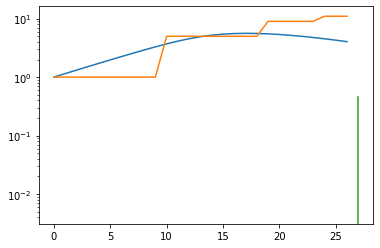

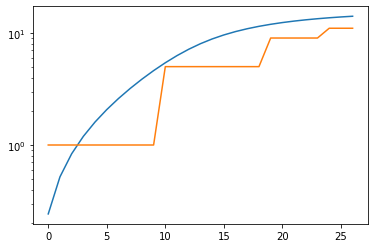

total error: 0.13974162936210632


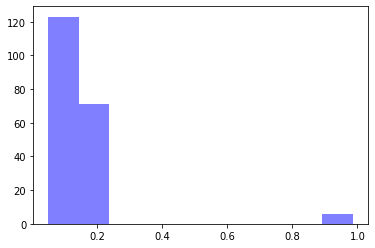

alpha: 0.99968576 , beta: 0.20452589 , initial_unconfirmed 1.541076 , t0s 2.9261765 , lambds 0.0061546196


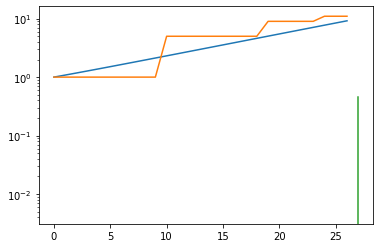

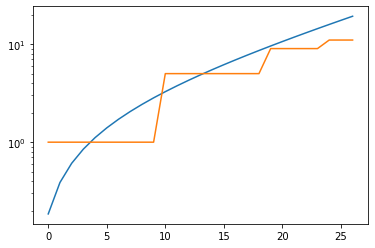

total error: 0.09180207550525665


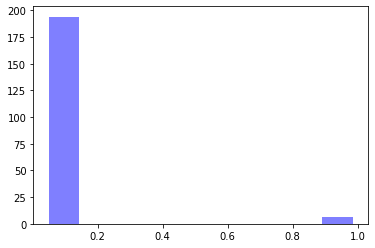

alpha: 0.99969167 , beta: 0.20452046 , initial_unconfirmed 1.5411031 , t0s 2.940489 , lambds 0.003173446


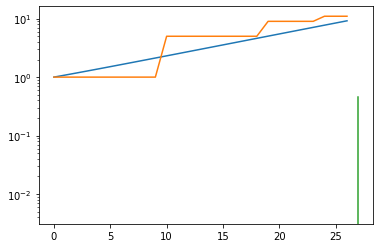

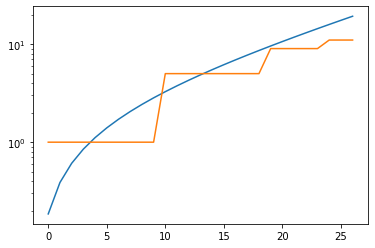

total error: 0.07718845456838608


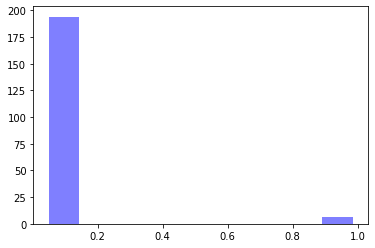

alpha: 0.8631964 , beta: 0.20755772 , initial_unconfirmed 1.7549125 , t0s 4.7306027 , lambds 0.25725046


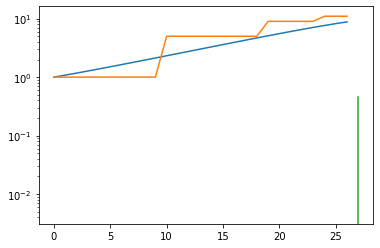

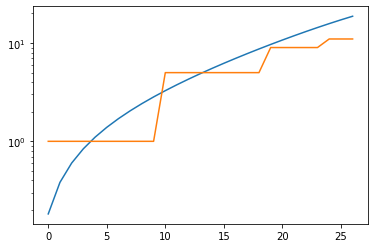

total error: 0.07716760039329529


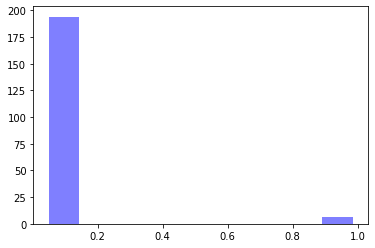

alpha: 0.8807426 , beta: 0.20812257 , initial_unconfirmed 1.7122831 , t0s 7.8264565 , lambds 0.34261414


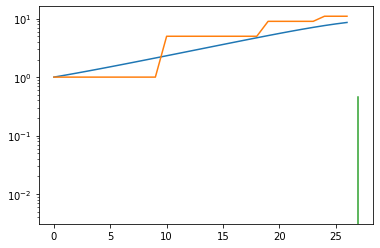

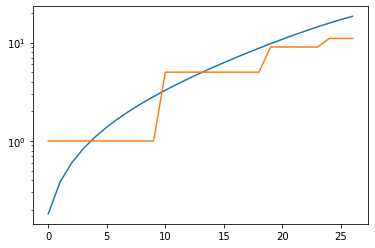

Faeroe Islands
total error: 2.415910482406616


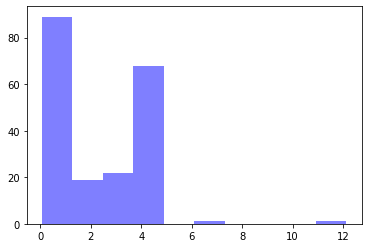

alpha: 0.9667176 , beta: 0.4912876 , initial_unconfirmed 4.573697 , t0s 0.8304643 , lambds 0.65226954


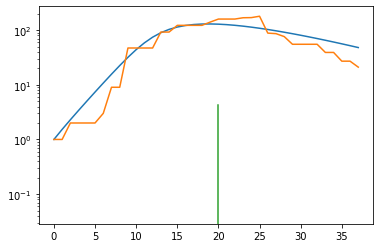

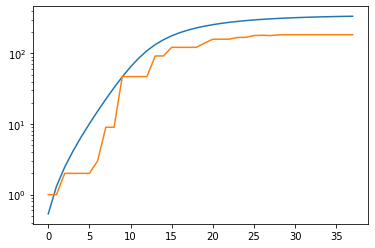

total error: 0.06071505695581436


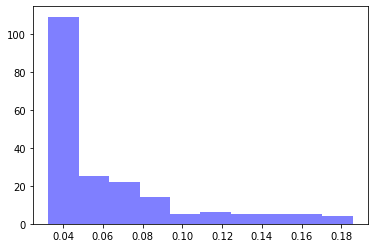

alpha: 0.50106025 , beta: 0.49427548 , initial_unconfirmed 4.3395176 , t0s 4.8720255 , lambds 0.941349


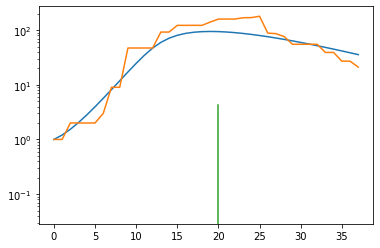

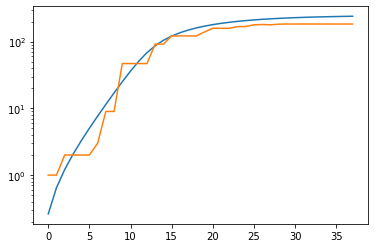

total error: 0.0333181731402874


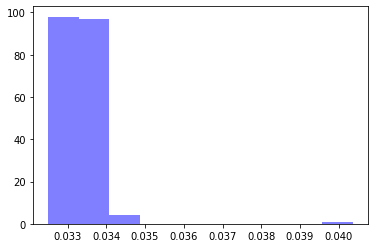

alpha: 0.50152254 , beta: 0.49223167 , initial_unconfirmed 4.3715377 , t0s 5.2715306 , lambds 0.9920258


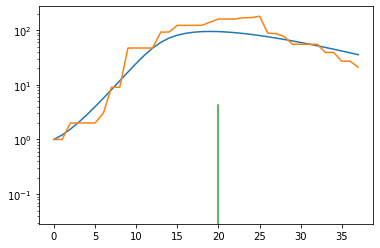

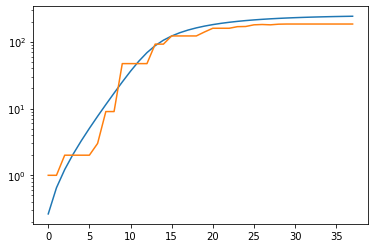

total error: 0.03327052667737007


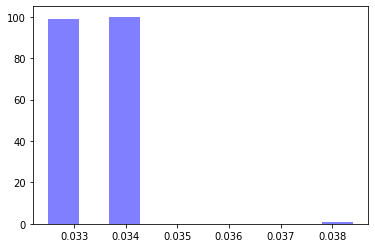

alpha: 0.50152355 , beta: 0.4921568 , initial_unconfirmed 4.37223 , t0s 5.297658 , lambds 0.99567765


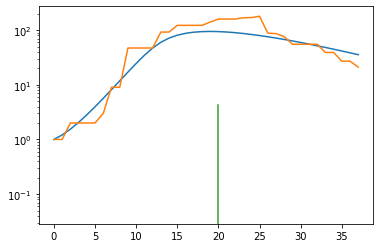

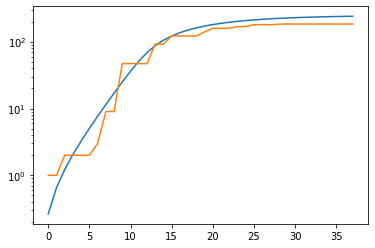

total error: 0.033251721411943436


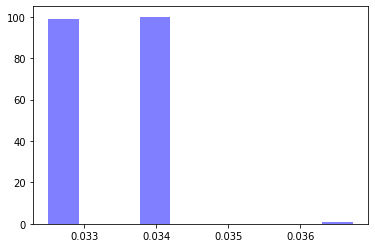

alpha: 0.5015248 , beta: 0.4921148 , initial_unconfirmed 4.372478 , t0s 5.3089776 , lambds 0.99731547


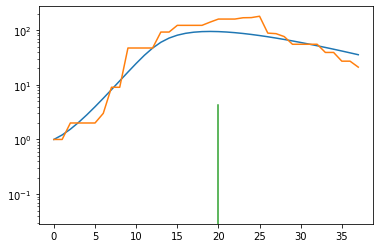

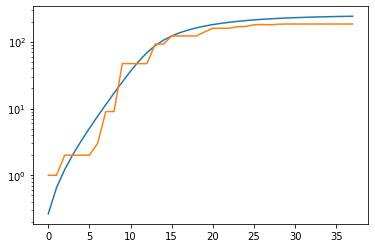

Turkmenistan
Kyrgyz Republic
total error: 3.0165481567382812


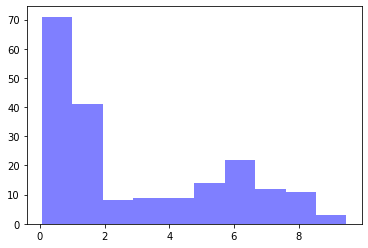

alpha: 0.9685768 , beta: 0.37972754 , initial_unconfirmed 21.878246 , t0s 0.627189 , lambds 0.6610112


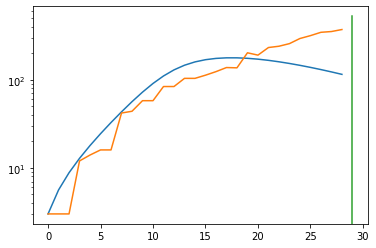

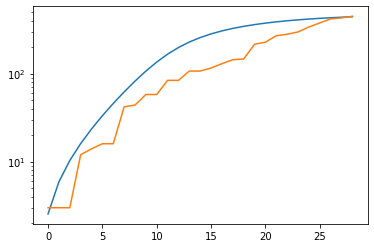

total error: 0.045970410108566284


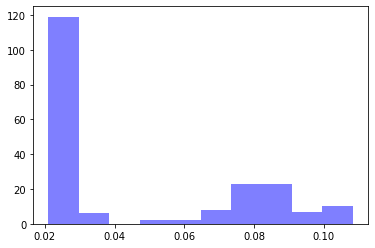

alpha: 0.6159365 , beta: 0.28996664 , initial_unconfirmed 26.926144 , t0s 0.0 , lambds 0.3285529


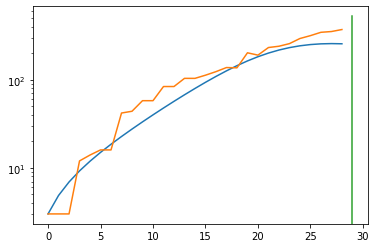

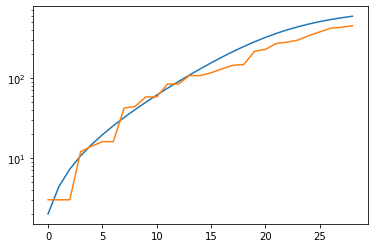

total error: 0.02961966022849083


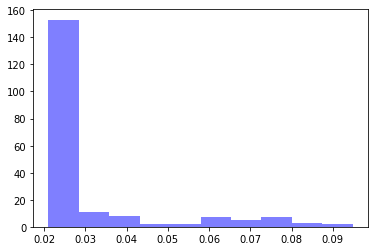

alpha: 0.50548744 , beta: 0.28997177 , initial_unconfirmed 32.80894 , t0s 0.0 , lambds 0.3285588


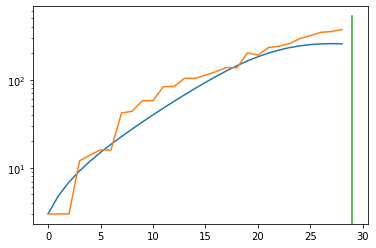

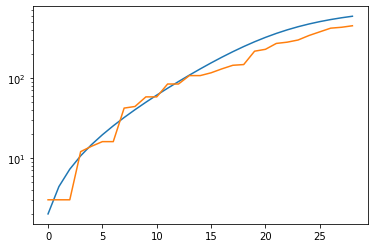

total error: 0.021570416167378426


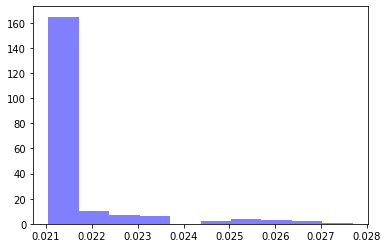

alpha: 0.5026924 , beta: 0.2899686 , initial_unconfirmed 32.99216 , t0s 0.0 , lambds 0.3285535


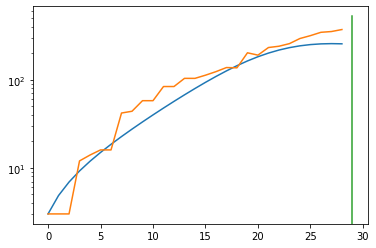

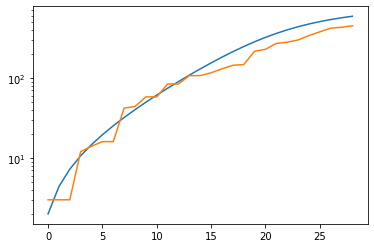

total error: 0.021146876737475395


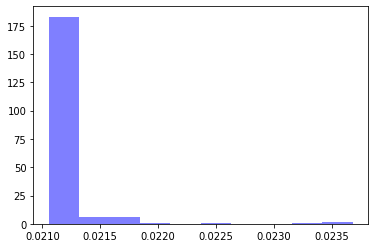

alpha: 0.5026924 , beta: 0.2899686 , initial_unconfirmed 32.99216 , t0s 0.0 , lambds 0.3285535


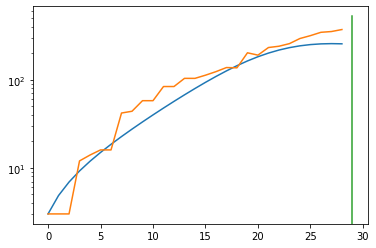

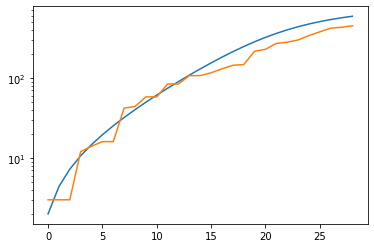

Maldives
total error: 5.769190788269043


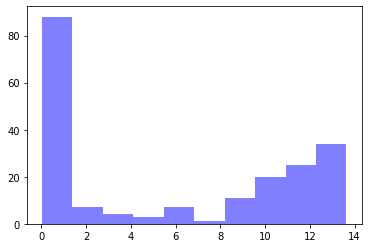

alpha: 0.9982319 , beta: 0.15870404 , initial_unconfirmed 8.382881 , t0s 0.99915785 , lambds 0.64380187


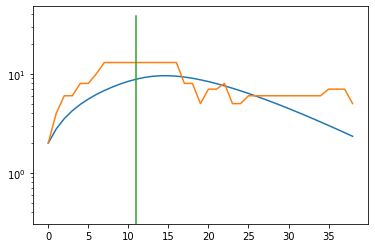

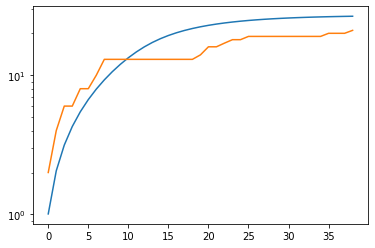

total error: 0.040563393384218216


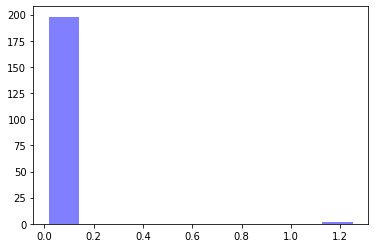

alpha: 0.5045406 , beta: 0.07590675 , initial_unconfirmed 25.60654 , t0s 0.0 , lambds 0.00084589195


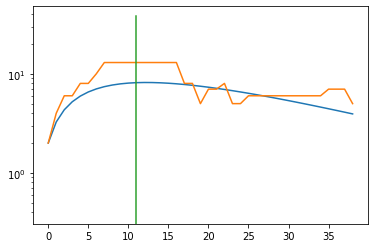

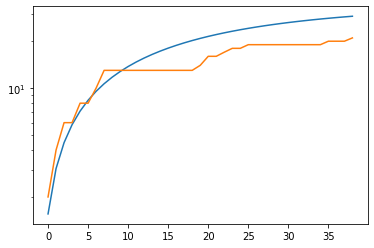

total error: 0.03885839506983757


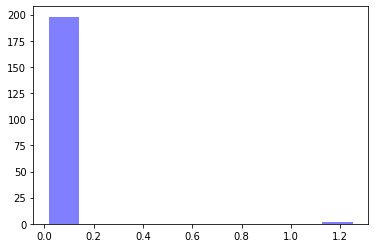

alpha: 0.963138 , beta: 0.075908974 , initial_unconfirmed 13.412839 , t0s 2.6679895 , lambds 0.0007611108


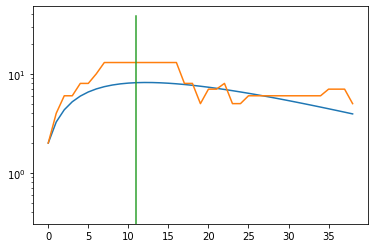

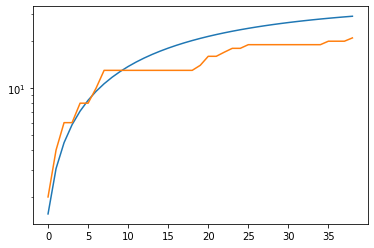

total error: 0.03797019273042679


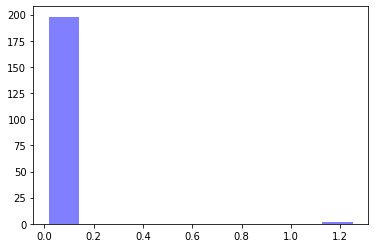

alpha: 0.9631616 , beta: 0.07590869 , initial_unconfirmed 13.412528 , t0s 2.6684957 , lambds 0.00052382686


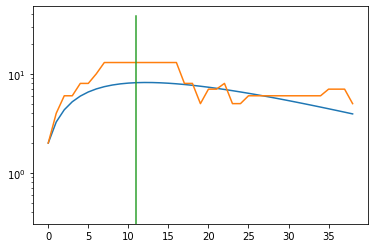

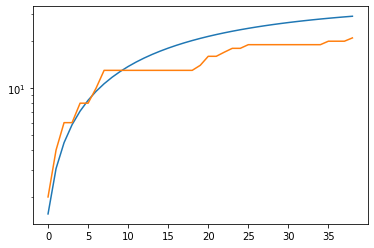

total error: 0.03746495023369789


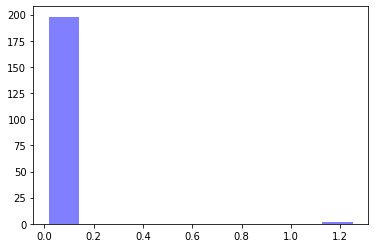

alpha: 0.96318424 , beta: 0.075908706 , initial_unconfirmed 13.412226 , t0s 2.6687453 , lambds 0.00039533054


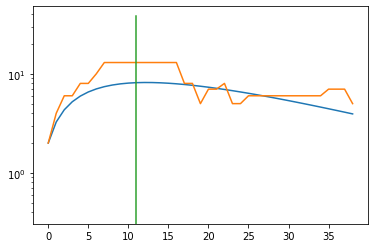

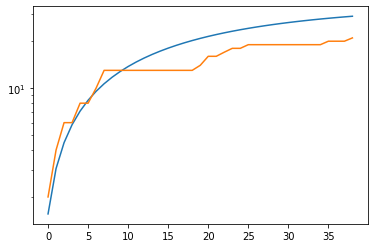

Isle of Man
total error: 1.4867477416992188


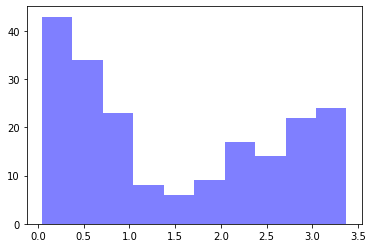

alpha: 0.9154762 , beta: 0.33334577 , initial_unconfirmed 32.073055 , t0s 0.54943544 , lambds 0.7080768


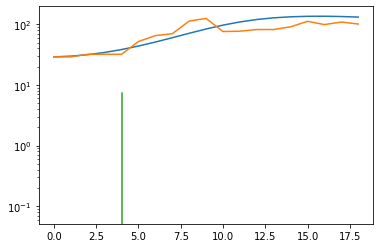

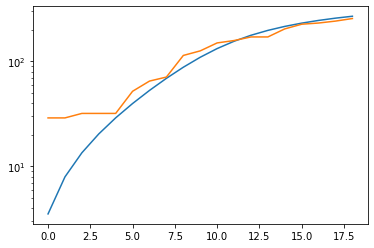

total error: 0.03938039019703865


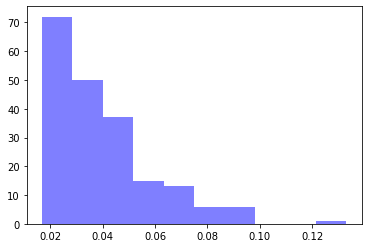

alpha: 0.999683 , beta: 0.20552781 , initial_unconfirmed 63.66106 , t0s 0.6610405 , lambds 0.6477556


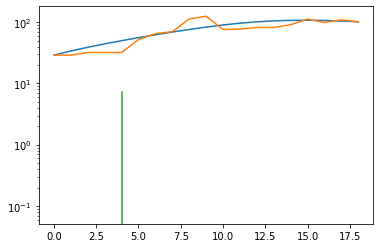

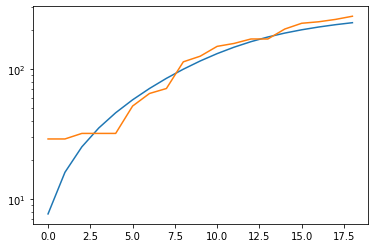

total error: 0.028822069987654686


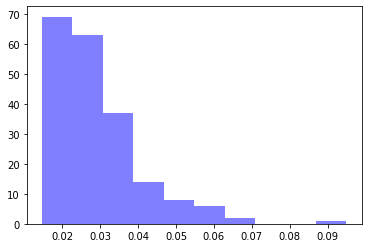

alpha: 0.9996798 , beta: 0.1599304 , initial_unconfirmed 78.43834 , t0s 0.0 , lambds 0.4168487


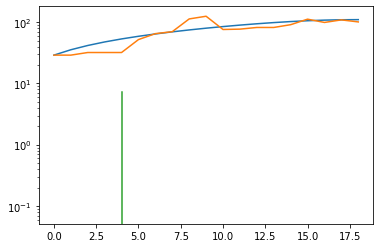

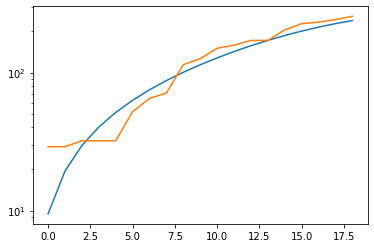

total error: 0.023790886625647545


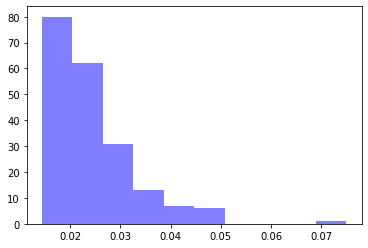

alpha: 0.9997375 , beta: 0.14564824 , initial_unconfirmed 84.739 , t0s 0.0 , lambds 0.28652987


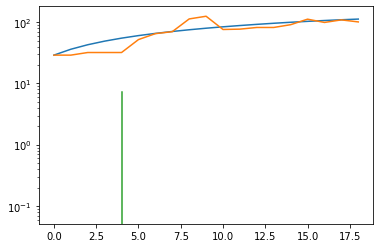

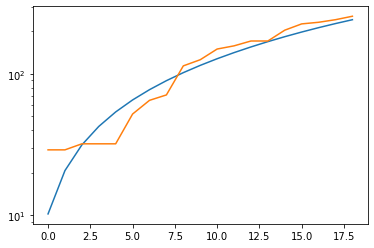

total error: 0.02088189870119095


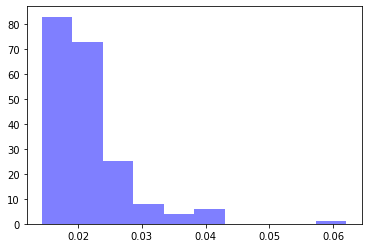

alpha: 0.9997508 , beta: 0.14192727 , initial_unconfirmed 86.50842 , t0s 0.0 , lambds 0.14845309


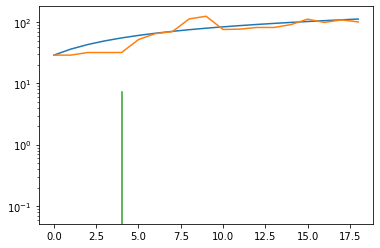

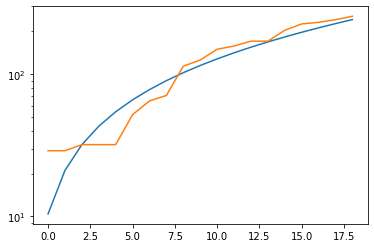

Burkina Faso
total error: 3.343562126159668


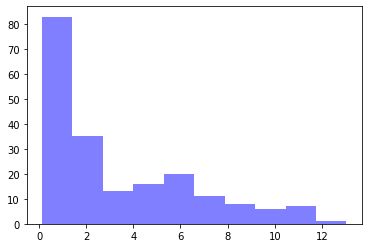

alpha: 0.99871886 , beta: 0.5684745 , initial_unconfirmed 4.3382525 , t0s 0.005673051 , lambds 0.7261078


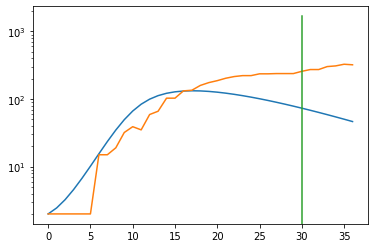

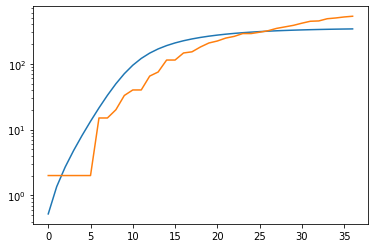

total error: 0.07090998440980911


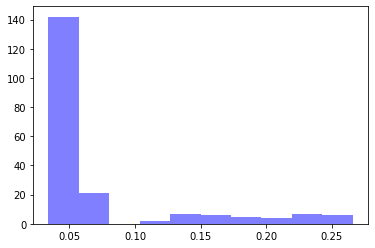

alpha: 0.5046138 , beta: 0.39046523 , initial_unconfirmed 8.904542 , t0s 0.0 , lambds 0.3808089


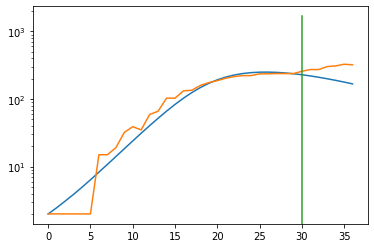

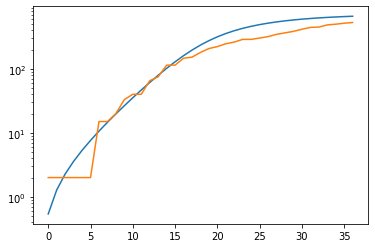

total error: 0.03466429188847542


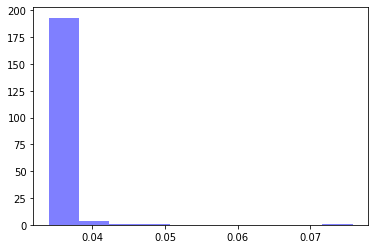

alpha: 0.50181466 , beta: 0.39046878 , initial_unconfirmed 8.9558325 , t0s 0.0 , lambds 0.38082445


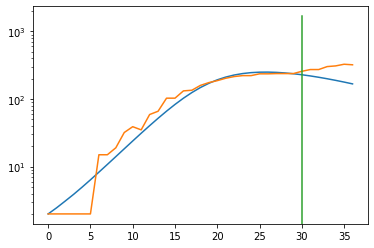

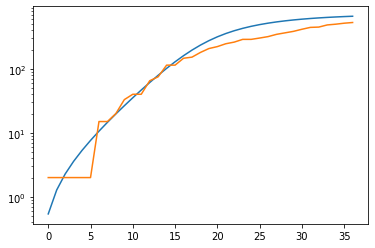

total error: 0.03398949280381203


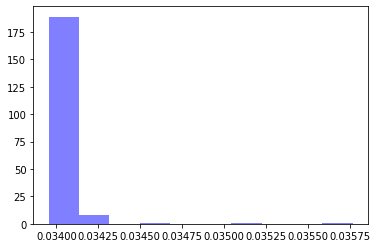

alpha: 0.50788105 , beta: 0.3904787 , initial_unconfirmed 8.847766 , t0s 0.0 , lambds 0.3808196


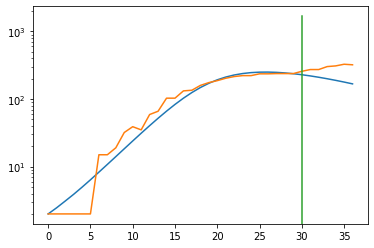

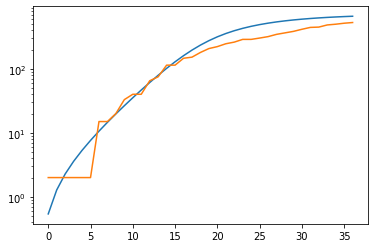

total error: 0.03396476432681084


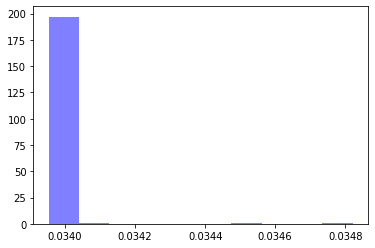

alpha: 0.50097233 , beta: 0.39048243 , initial_unconfirmed 8.969483 , t0s 0.0 , lambds 0.3808254


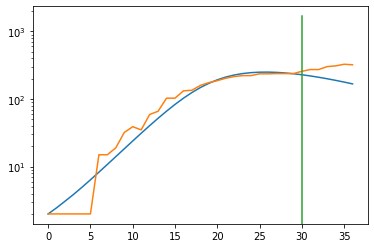

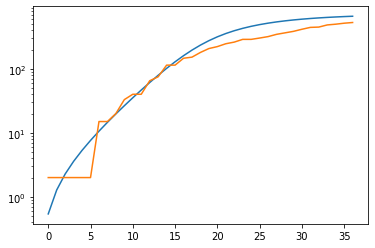

Greece
total error: 3.8574273586273193


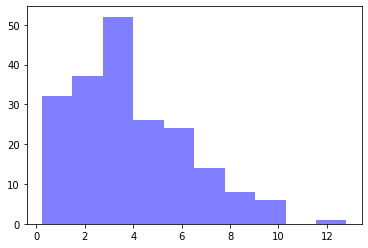

alpha: 0.98775256 , beta: 0.5537704 , initial_unconfirmed 5.1454754 , t0s 0.5030363 , lambds 0.5487119


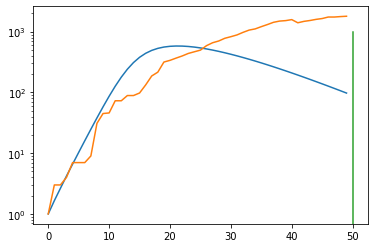

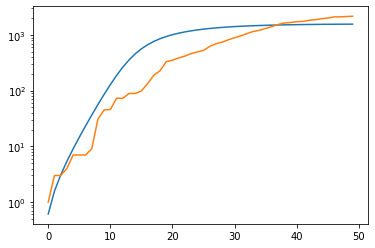

total error: 0.06916763633489609


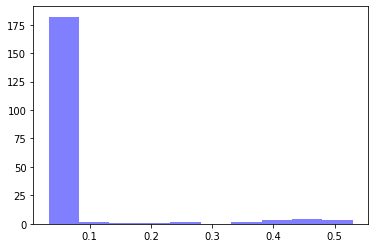

alpha: 0.83215296 , beta: 0.30719692 , initial_unconfirmed 12.550367 , t0s 0.0 , lambds 0.22135189


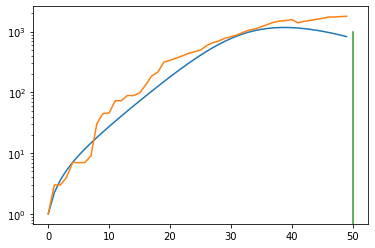

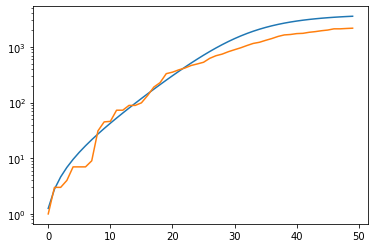

total error: 0.033824022859334946


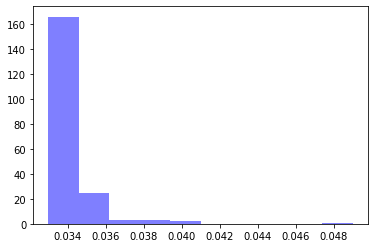

alpha: 0.5009555 , beta: 0.307127 , initial_unconfirmed 20.868694 , t0s 0.0 , lambds 0.22128981


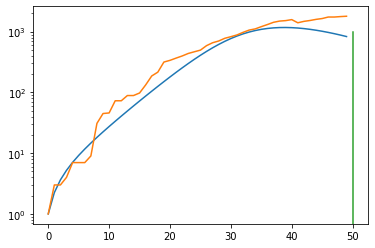

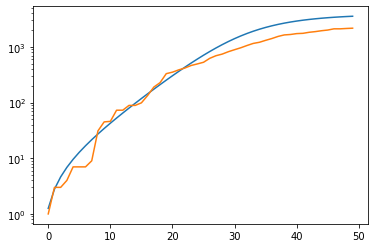

total error: 0.033137984573841095


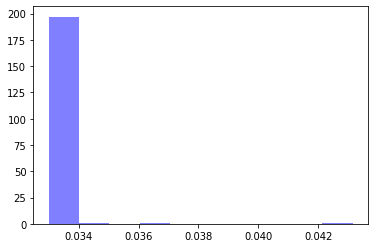

alpha: 0.5009555 , beta: 0.307127 , initial_unconfirmed 20.868694 , t0s 0.0 , lambds 0.22128981


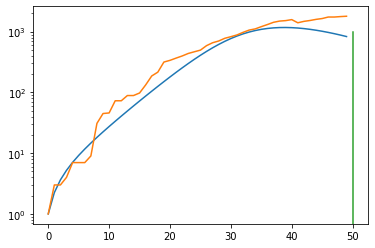

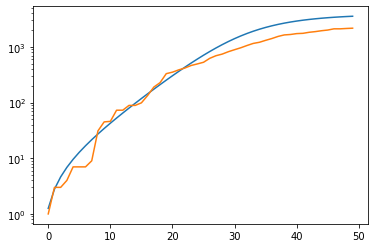

total error: 0.03304838761687279


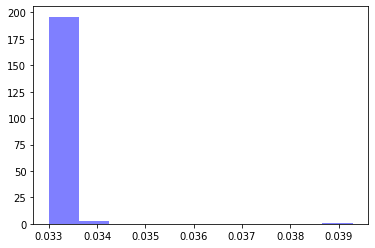

alpha: 0.5009555 , beta: 0.307127 , initial_unconfirmed 20.868694 , t0s 0.0 , lambds 0.22128981


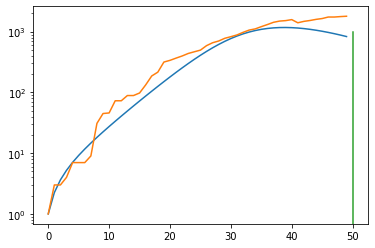

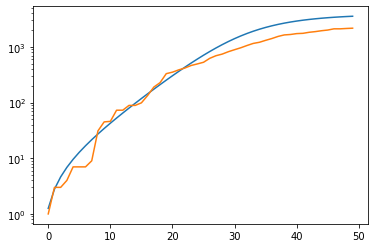

Cyprus
total error: 3.1986310482025146


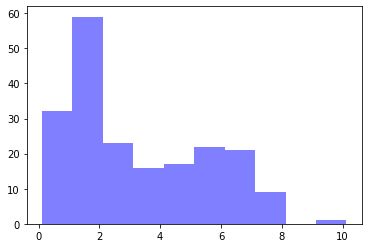

alpha: 0.9872625 , beta: 0.42568403 , initial_unconfirmed 15.14979 , t0s 0.95486444 , lambds 0.71442705


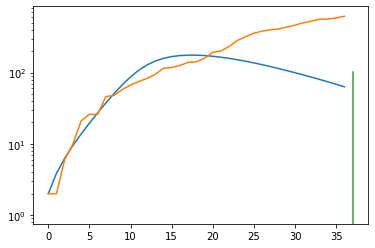

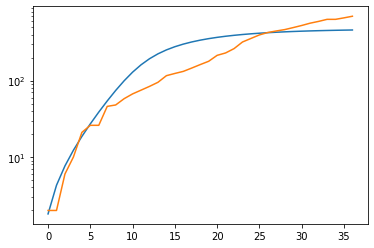

total error: 0.06733574718236923


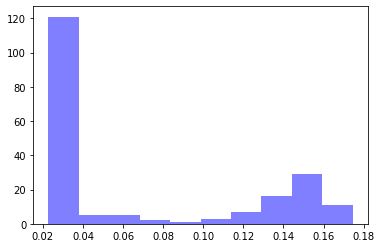

alpha: 0.62054145 , beta: 0.25138846 , initial_unconfirmed 36.825047 , t0s 0.0 , lambds 0.239668


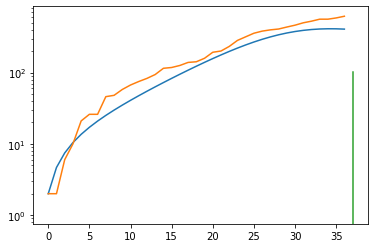

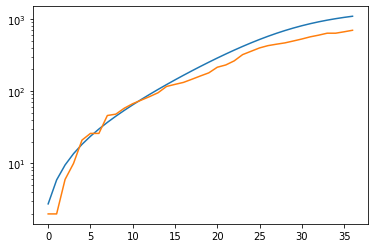

total error: 0.030510861426591873


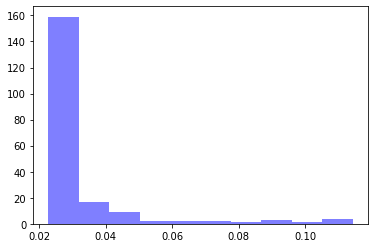

alpha: 0.5306222 , beta: 0.2514106 , initial_unconfirmed 43.058304 , t0s 0.0 , lambds 0.2396629


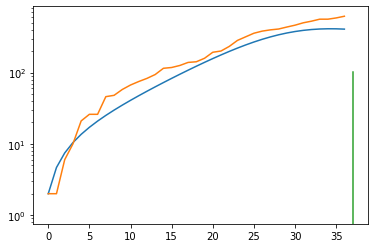

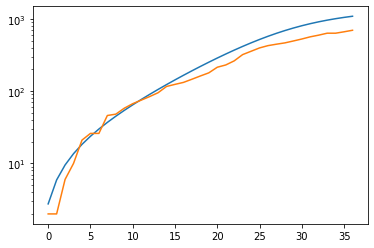

total error: 0.024372024461627007


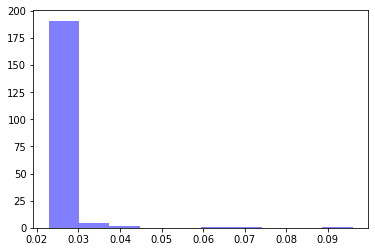

alpha: 0.5059501 , beta: 0.25139976 , initial_unconfirmed 45.164978 , t0s 0.0 , lambds 0.23963751


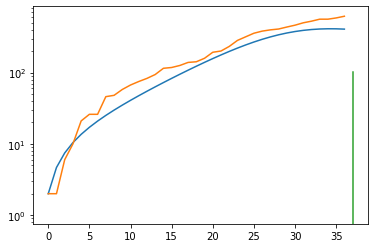

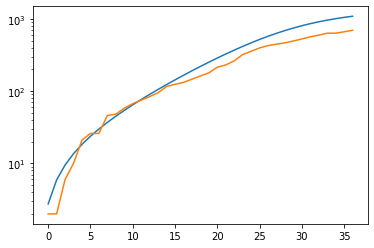

total error: 0.02373962104320526


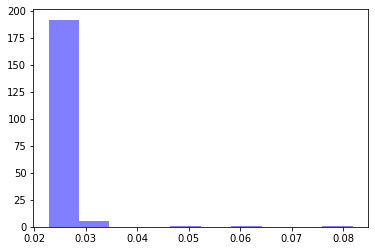

alpha: 0.50298804 , beta: 0.25135642 , initial_unconfirmed 45.455166 , t0s 0.0 , lambds 0.23958217


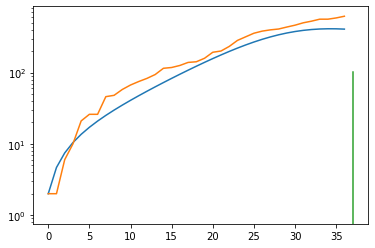

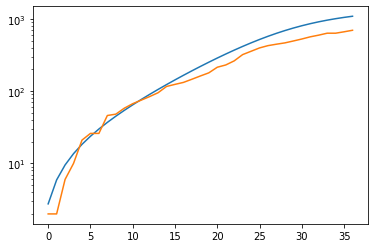

Puerto Rico
total error: 3.670558214187622


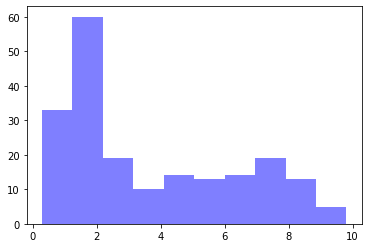

alpha: 0.82109666 , beta: 0.4420367 , initial_unconfirmed 12.008158 , t0s 0.90122473 , lambds 0.6339651


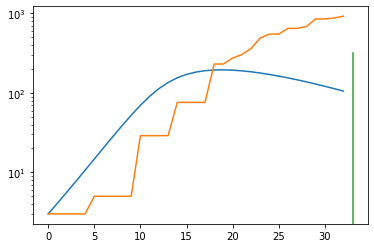

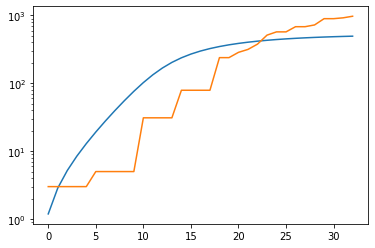

total error: 0.1188591942191124


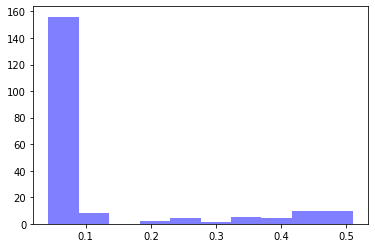

alpha: 0.99980474 , beta: 0.35975763 , initial_unconfirmed 3.8994596 , t0s 9.538801 , lambds 0.44633836


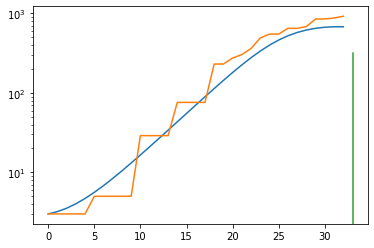

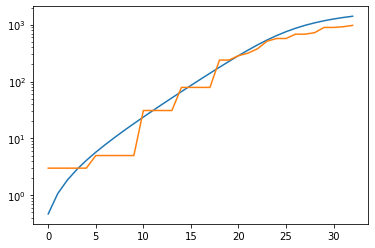

total error: 0.044517386704683304


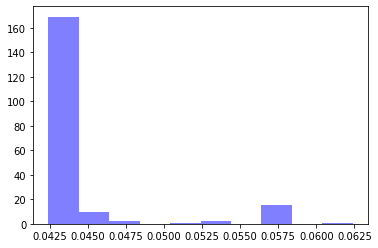

alpha: 0.97504294 , beta: 0.36244053 , initial_unconfirmed 3.764512 , t0s 13.762231 , lambds 0.6511952


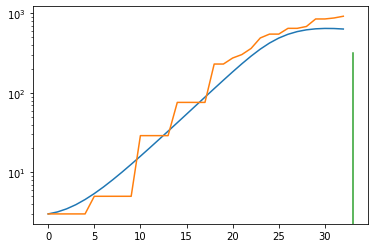

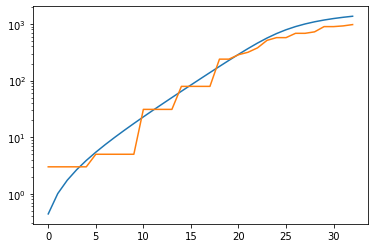

total error: 0.04293641448020935


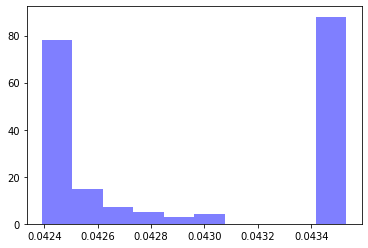

alpha: 0.9999691 , beta: 0.36243615 , initial_unconfirmed 3.6684194 , t0s 13.911383 , lambds 0.6614284


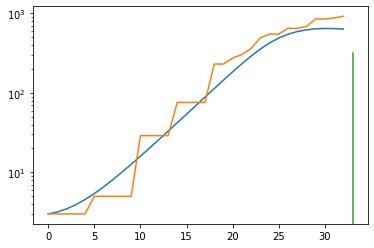

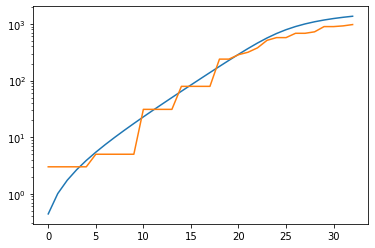

total error: 0.04290461540222168


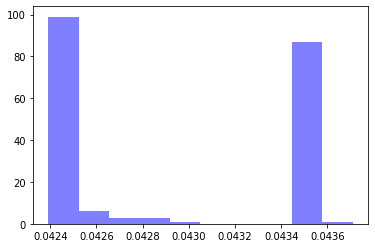

alpha: 0.99993324 , beta: 0.3624122 , initial_unconfirmed 3.6694837 , t0s 13.92318 , lambds 0.6621753


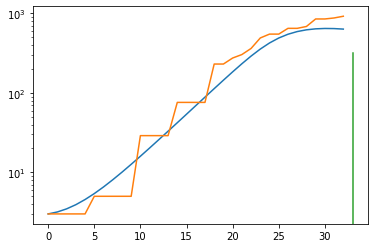

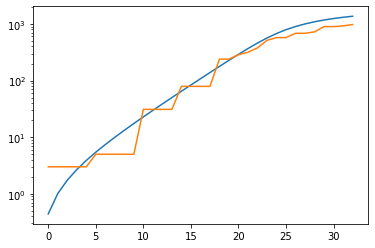

Bahamas
total error: 4.9129133224487305


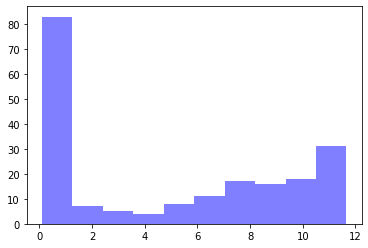

alpha: 0.9361762 , beta: 0.38830164 , initial_unconfirmed 1.1542201 , t0s 0.964266 , lambds 0.6689832


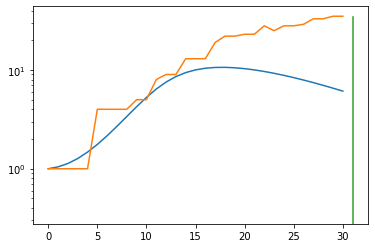

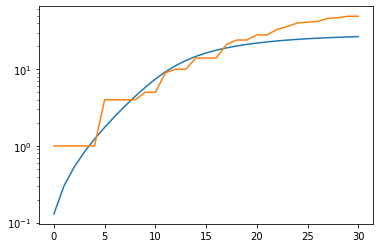

total error: 0.1136348620057106


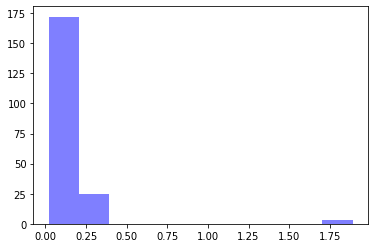

alpha: 0.99889183 , beta: 0.25650138 , initial_unconfirmed 2.612453 , t0s 0.0 , lambds 0.30029973


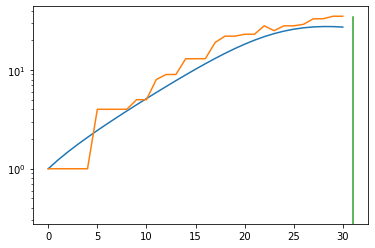

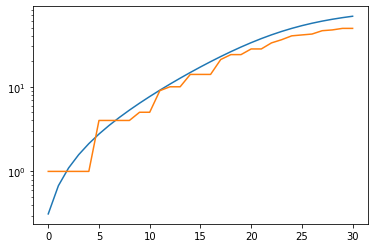

total error: 0.07397894561290741


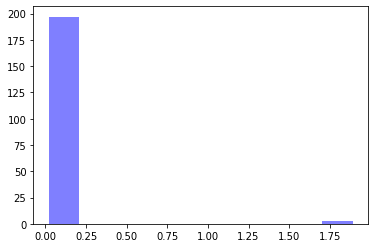

alpha: 0.9976864 , beta: 0.25650632 , initial_unconfirmed 2.6155314 , t0s 0.0 , lambds 0.3003111


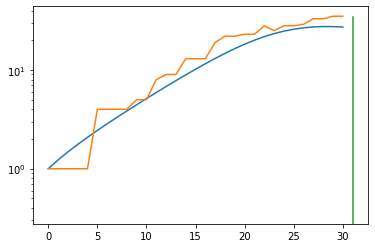

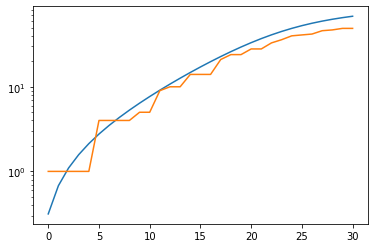

total error: 0.05598682537674904


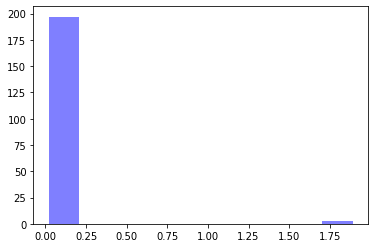

alpha: 0.9976864 , beta: 0.25650632 , initial_unconfirmed 2.6155314 , t0s 0.0 , lambds 0.3003111


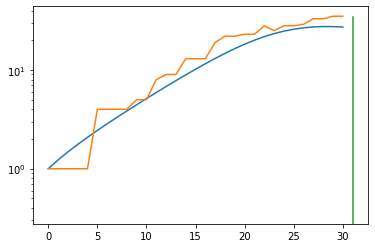

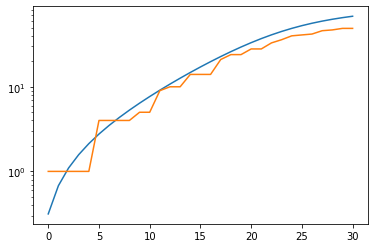

total error: 0.04758606106042862


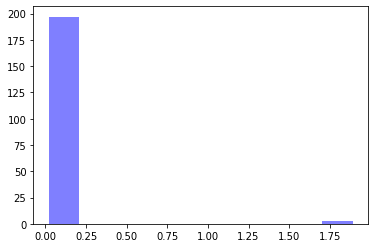

alpha: 0.9434182 , beta: 0.25650984 , initial_unconfirmed 2.7658868 , t0s 0.0 , lambds 0.30032027


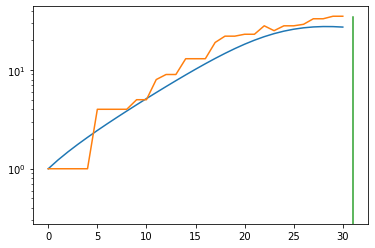

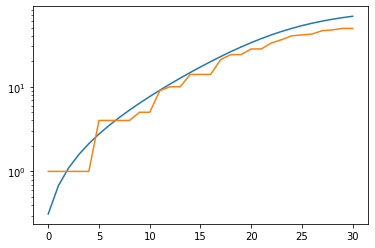

Antarctica
Finland
total error: 5.848403453826904


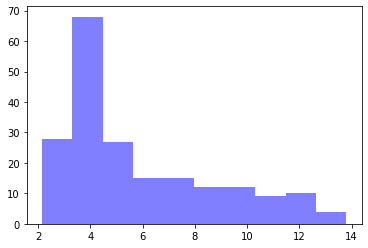

alpha: 0.99997187 , beta: 0.5027641 , initial_unconfirmed 2.7441115 , t0s 0.3909881 , lambds 0.53272736


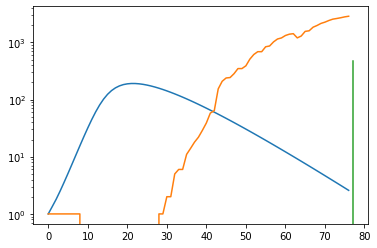

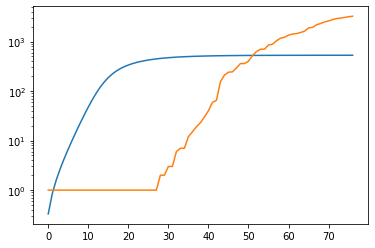

total error: 0.7774758338928223


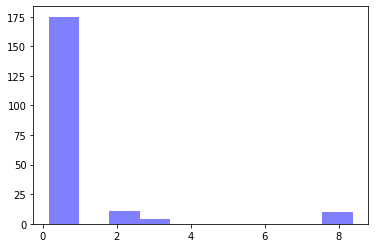

alpha: 0.9792111 , beta: 0.272076 , initial_unconfirmed 0.18333143 , t0s 2.6907225 , lambds 0.08478037


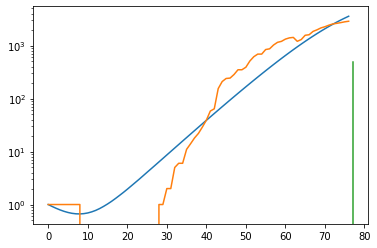

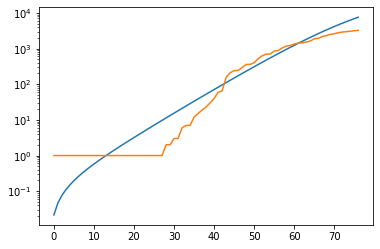

total error: 0.5762800574302673


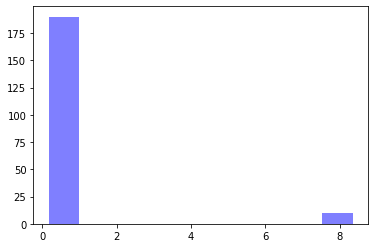

alpha: 0.5029219 , beta: 0.27188334 , initial_unconfirmed 0.35611537 , t0s 4.2212143 , lambds 0.08654323


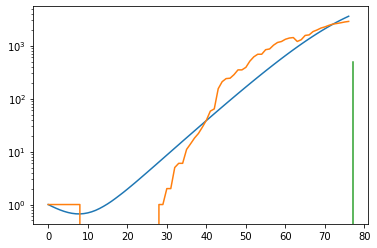

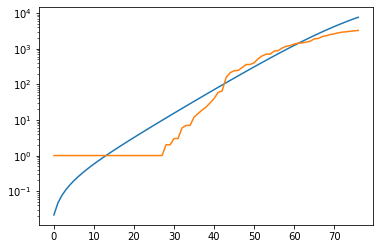

total error: 0.5751067996025085


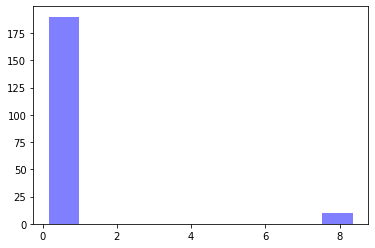

alpha: 0.50466436 , beta: 0.2720238 , initial_unconfirmed 0.35367268 , t0s 6.080824 , lambds 0.090233505


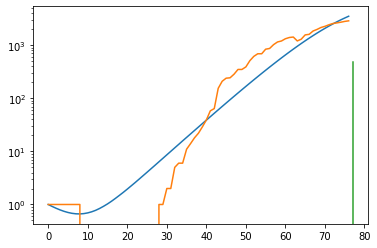

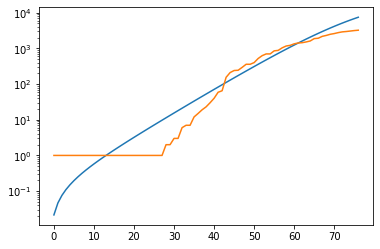

total error: 0.5745798349380493


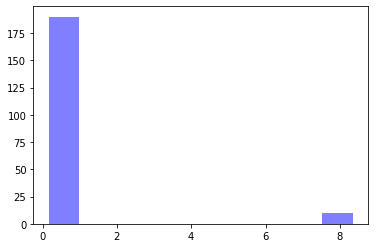

alpha: 0.99994284 , beta: 0.27233338 , initial_unconfirmed 0.17615007 , t0s 8.757717 , lambds 0.09643666


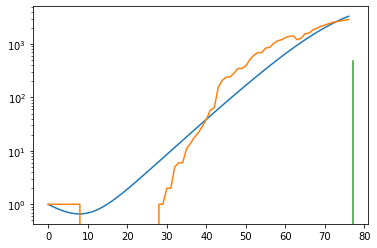

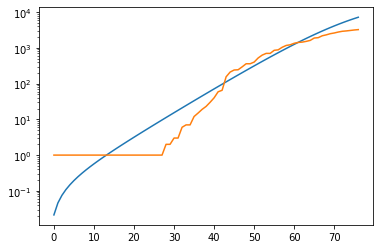

Japan
total error: 5.33384895324707


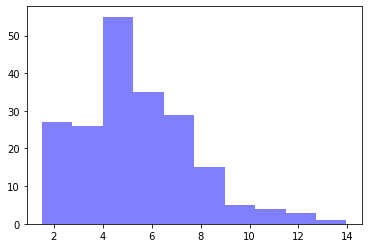

alpha: 0.9998965 , beta: 0.4378799 , initial_unconfirmed 17.604355 , t0s 0.84505343 , lambds 0.5969068


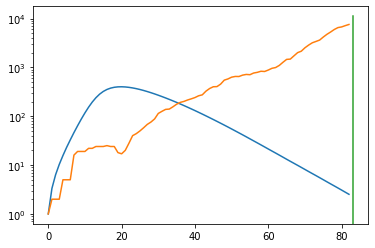

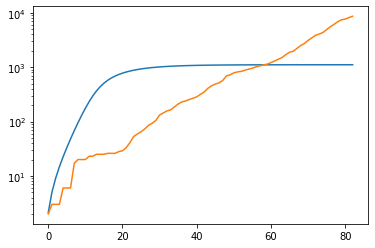

total error: 0.06414414197206497


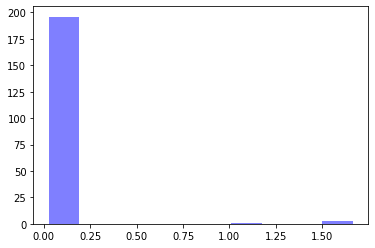

alpha: 0.509053 , beta: 0.20413387 , initial_unconfirmed 16.959833 , t0s 0.0 , lambds 0.020532828


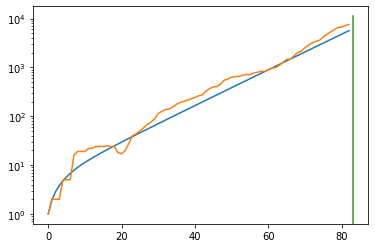

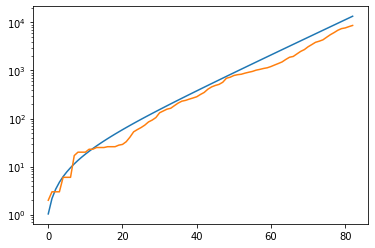

total error: 0.02648845687508583


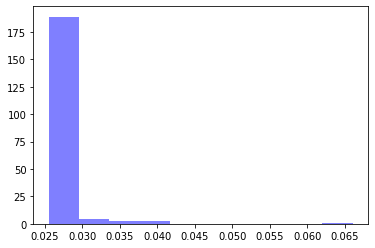

alpha: 0.5090047 , beta: 0.2041913 , initial_unconfirmed 16.914757 , t0s 0.0 , lambds 0.020523667


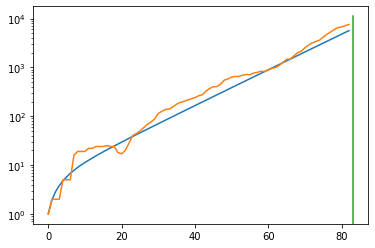

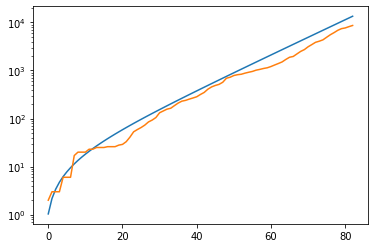

total error: 0.02577732875943184


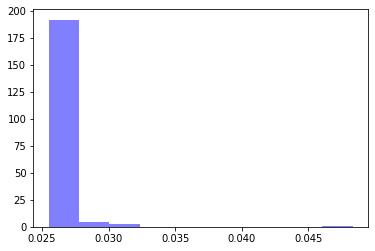

alpha: 0.99997187 , beta: 0.20409182 , initial_unconfirmed 8.625417 , t0s 4.814406 , lambds 0.018041857


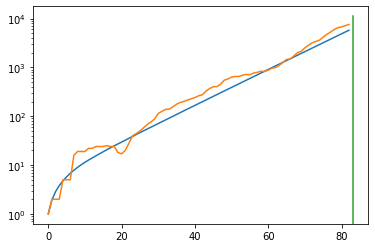

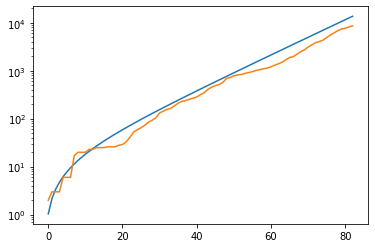

total error: 0.025637684389948845


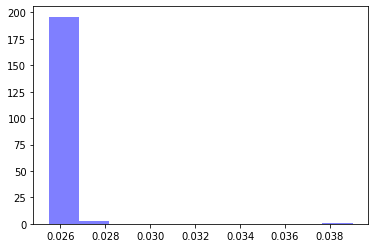

alpha: 0.99997187 , beta: 0.20409182 , initial_unconfirmed 8.625417 , t0s 4.814406 , lambds 0.018041857


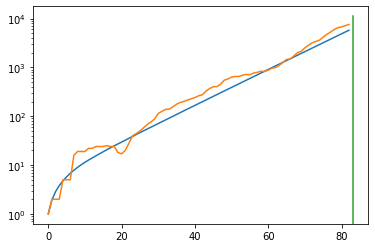

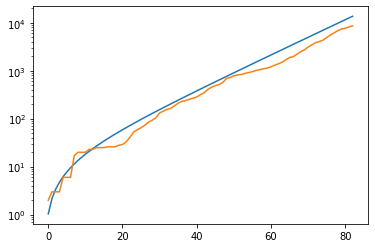

Martinique
total error: 3.851667881011963


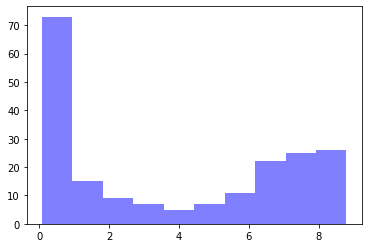

alpha: 0.7576004 , beta: 0.47592348 , initial_unconfirmed 3.3188672 , t0s 0.5026403 , lambds 0.51632655


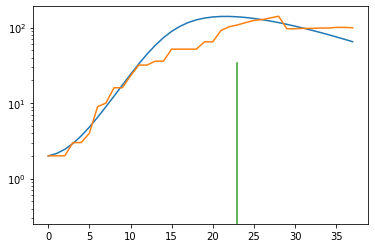

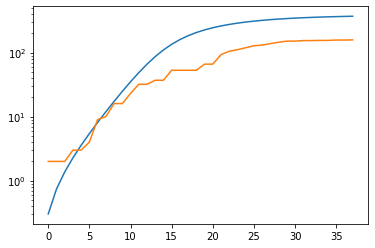

total error: 0.09499729424715042


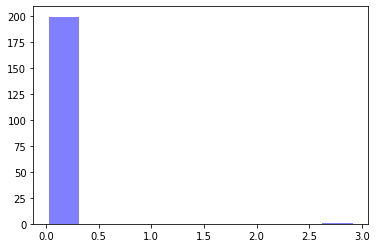

alpha: 0.74500084 , beta: 0.28132644 , initial_unconfirmed 8.362474 , t0s 0.0 , lambds 0.31796646


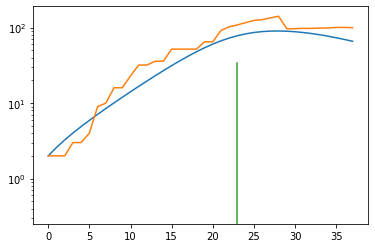

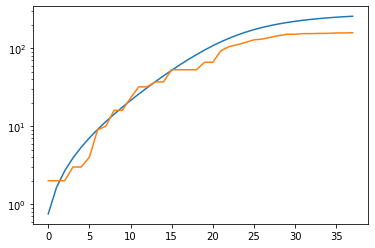

total error: 0.054489050060510635


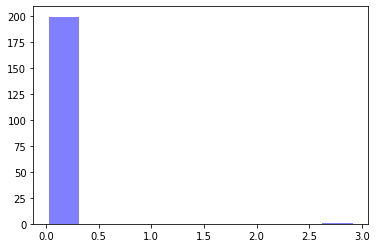

alpha: 0.5010107 , beta: 0.28134817 , initial_unconfirmed 12.434714 , t0s 0.0 , lambds 0.31794065


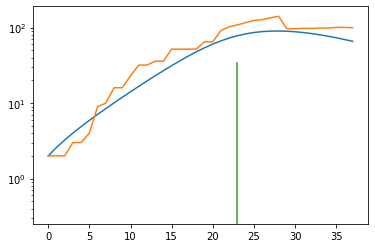

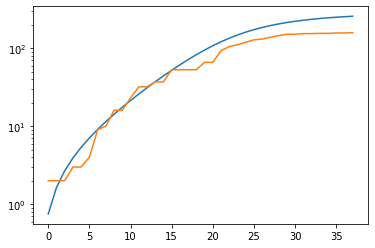

total error: 0.03859235346317291


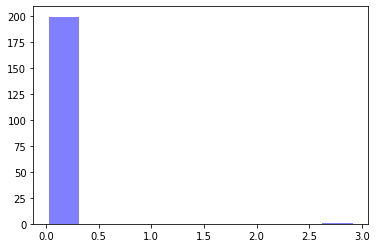

alpha: 0.5006394 , beta: 0.2813488 , initial_unconfirmed 12.443847 , t0s 0.0 , lambds 0.31793964


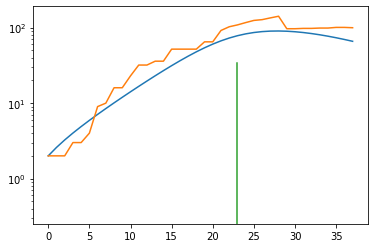

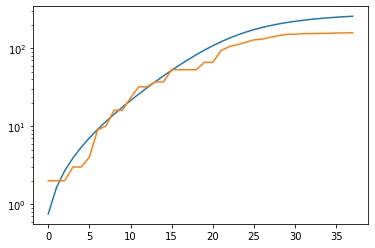

total error: 0.03847027197480202


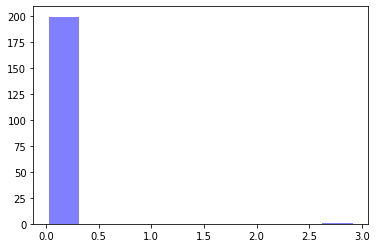

alpha: 0.5006394 , beta: 0.2813488 , initial_unconfirmed 12.443847 , t0s 0.0 , lambds 0.31793964


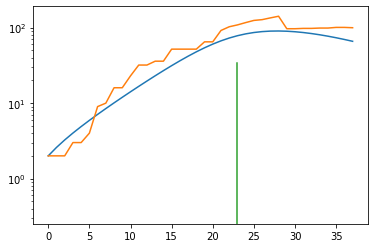

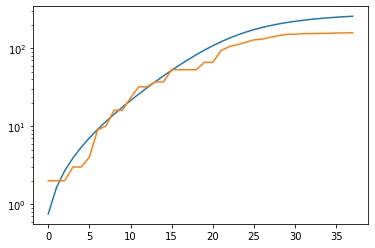

Nauru
Bermuda
total error: 2.192948579788208


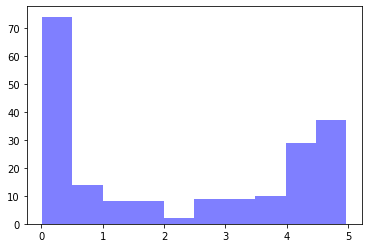

alpha: 0.9999277 , beta: 0.045362905 , initial_unconfirmed 44.7026 , t0s 0.35696185 , lambds 0.54092515


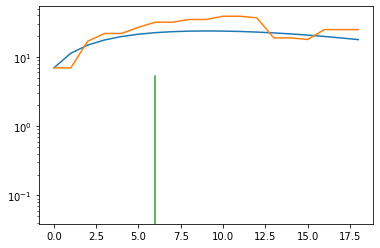

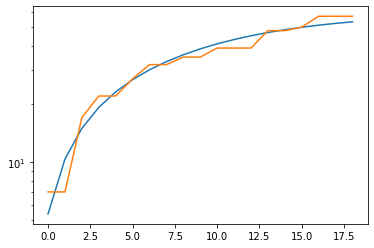

total error: 0.02083234302699566


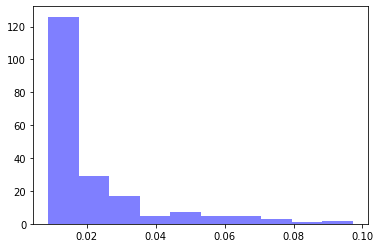

alpha: 0.98855895 , beta: 0.10106588 , initial_unconfirmed 42.35929 , t0s 0.0 , lambds 0.9992156


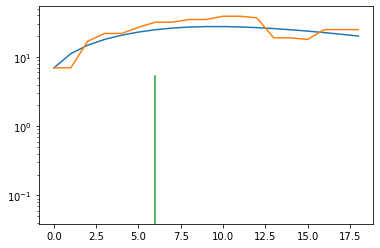

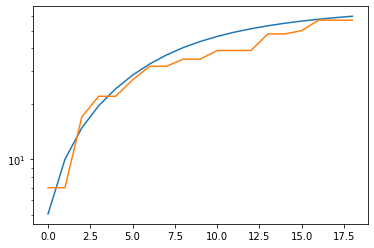

total error: 0.013932151719927788


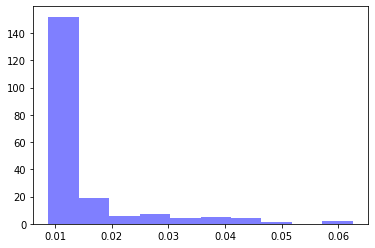

alpha: 0.99962664 , beta: 0.099696845 , initial_unconfirmed 42.151424 , t0s 0.0 , lambds 0.9997954


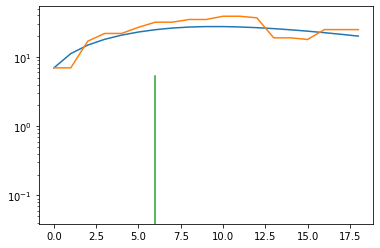

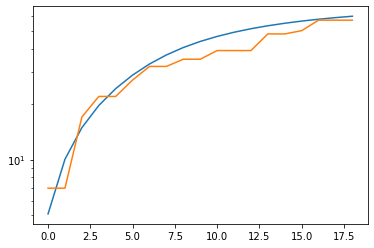

total error: 0.011589081026613712


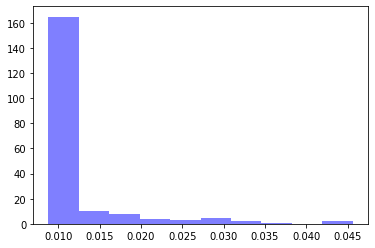

alpha: 0.9996239 , beta: 0.09975911 , initial_unconfirmed 42.14034 , t0s 0.0 , lambds 0.9998404


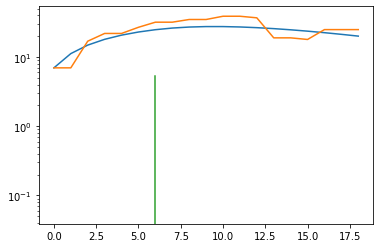

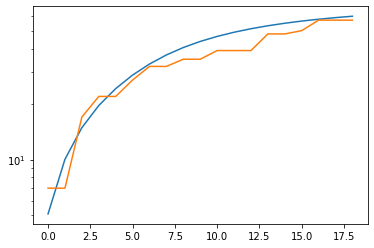

total error: 0.010433868505060673


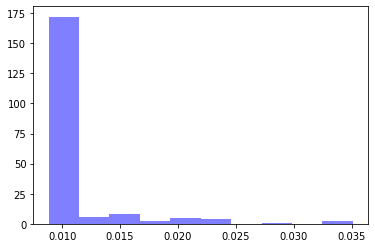

alpha: 0.98353887 , beta: 0.09978824 , initial_unconfirmed 42.82517 , t0s 0.0 , lambds 0.99994326


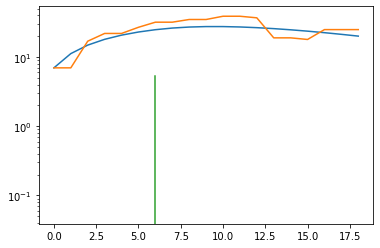

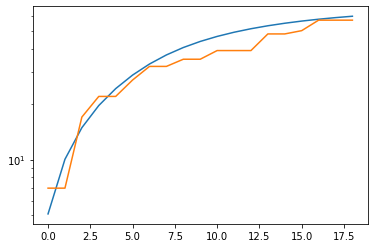

Antigua and Barbuda
Mozambique
total error: 4.683454513549805


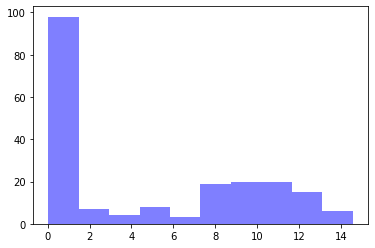

alpha: 0.99831593 , beta: 0.13703845 , initial_unconfirmed 10.071861 , t0s 0.70854306 , lambds 0.59063005


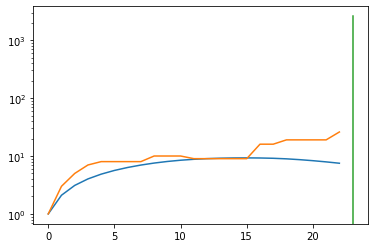

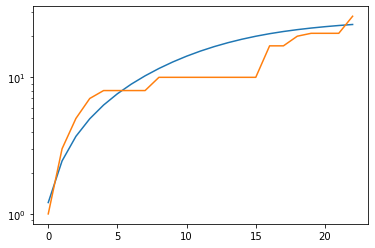

total error: 0.03677957504987717


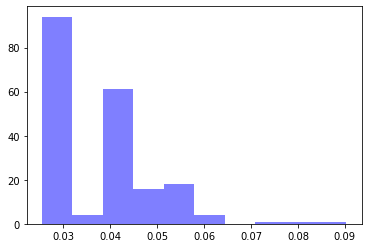

alpha: 0.50348824 , beta: 0.13382925 , initial_unconfirmed 20.123787 , t0s 1.6128145 , lambds 0.00092318194


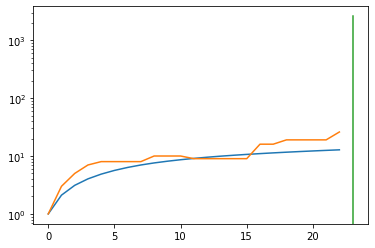

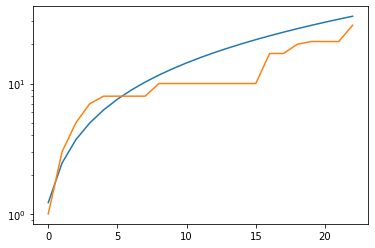

total error: 0.03428809344768524


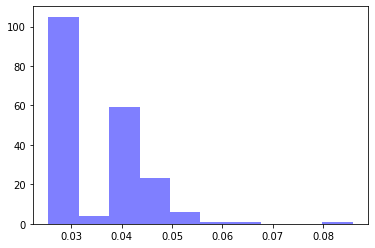

alpha: 0.5016421 , beta: 0.13383362 , initial_unconfirmed 20.197098 , t0s 0.0 , lambds 0.000467357


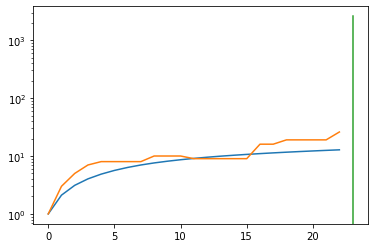

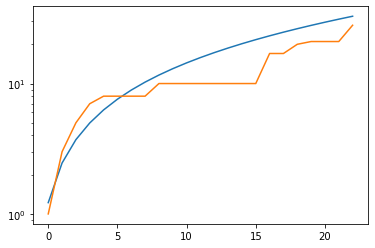

total error: 0.03267177566885948


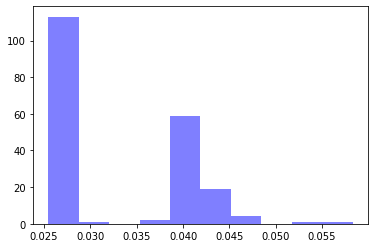

alpha: 0.50178576 , beta: 0.13383621 , initial_unconfirmed 20.190145 , t0s 1.0226107 , lambds 0.00034418562


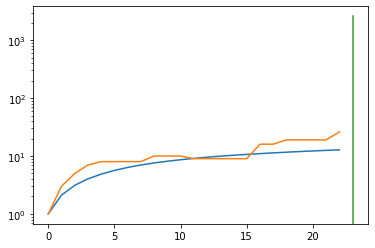

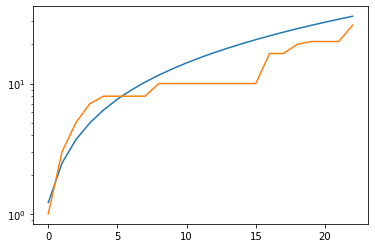

total error: 0.03190024942159653


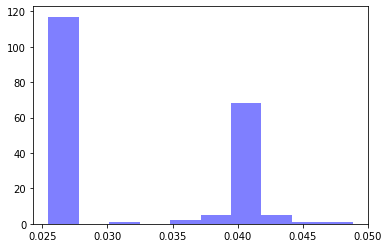

alpha: 0.50178576 , beta: 0.13383621 , initial_unconfirmed 20.190145 , t0s 1.0226107 , lambds 0.00034418562


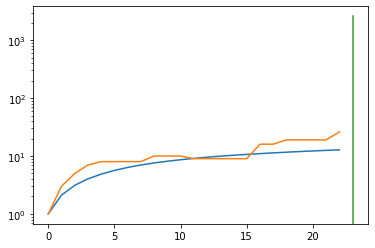

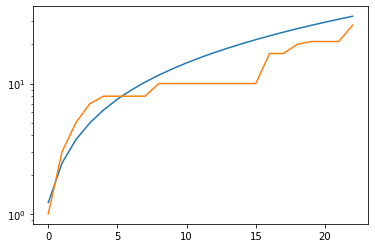

Sint Maarten
Malawi
total error: 2.191518783569336


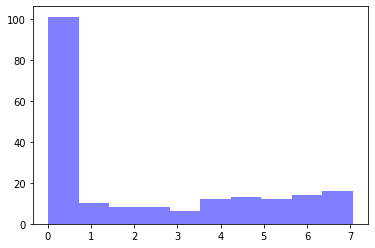

alpha: 0.99985147 , beta: 0.13745344 , initial_unconfirmed 10.176214 , t0s 0.66947216 , lambds 0.52781254


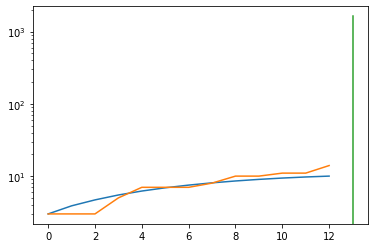

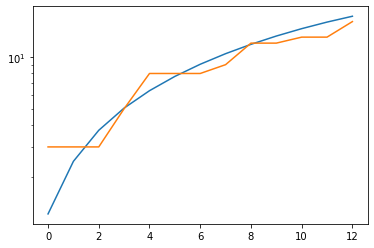

total error: 0.01381676271557808


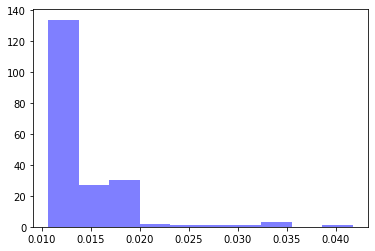

alpha: 0.9878504 , beta: 0.11853867 , initial_unconfirmed 11.395466 , t0s 1.0606467 , lambds 0.01604671


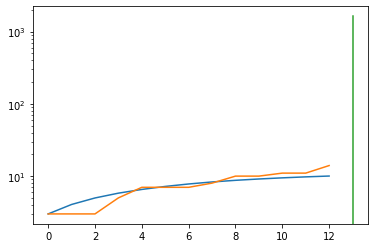

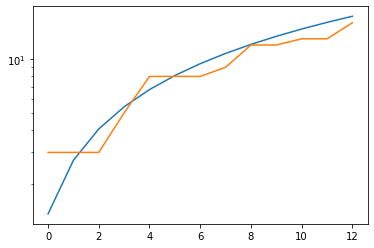

total error: 0.011844150722026825


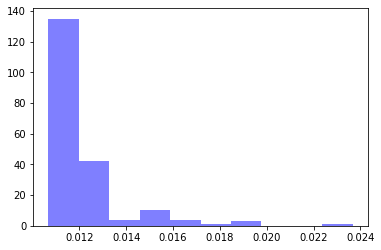

alpha: 0.9878504 , beta: 0.11853867 , initial_unconfirmed 11.395466 , t0s 1.0606467 , lambds 0.01604671


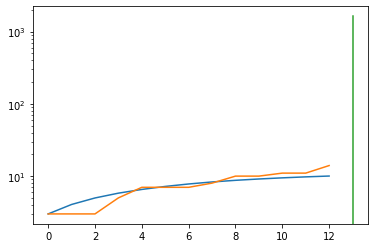

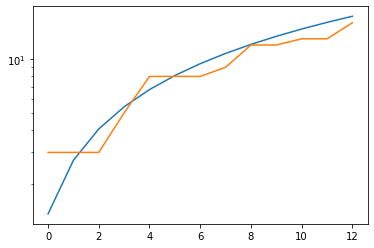

total error: 0.011401882395148277


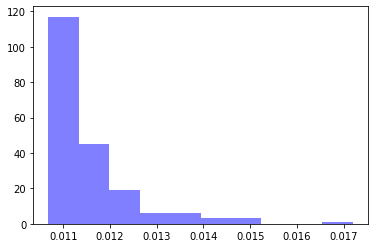

alpha: 0.9878504 , beta: 0.11853867 , initial_unconfirmed 11.395466 , t0s 1.0606467 , lambds 0.01604671


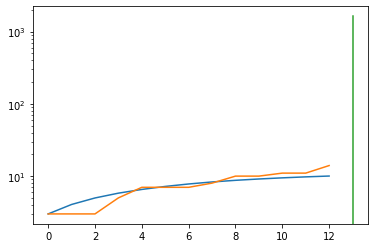

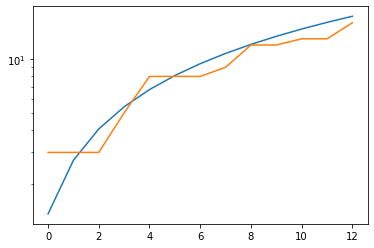

total error: 0.01121494174003601


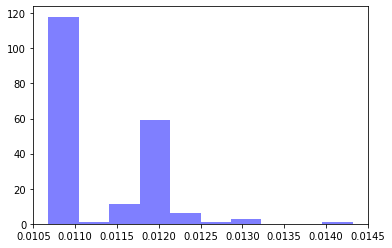

alpha: 0.99973464 , beta: 0.11856455 , initial_unconfirmed 11.260279 , t0s 3.2641554 , lambds 0.0015460367


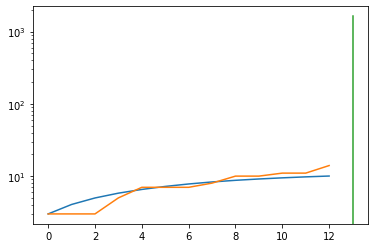

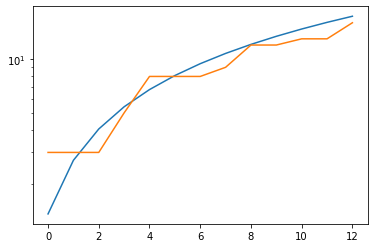

French Polynesia
total error: 4.595033645629883


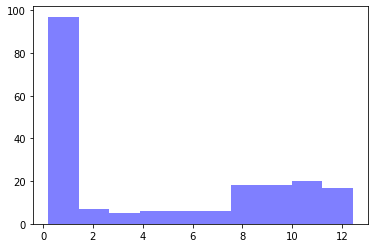

alpha: 0.97355735 , beta: 0.31492817 , initial_unconfirmed 3.4050584 , t0s 0.84751517 , lambds 0.7060264


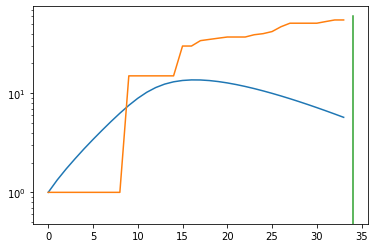

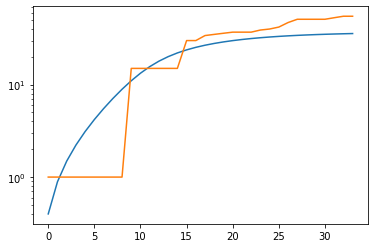

total error: 0.15968342125415802


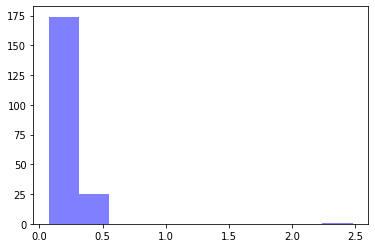

alpha: 0.51391655 , beta: 0.35423824 , initial_unconfirmed 2.6634316 , t0s 0.0 , lambds 0.38914615


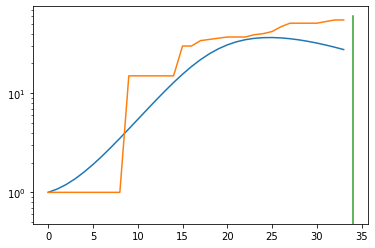

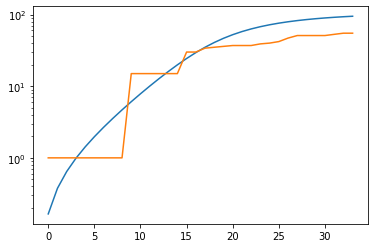

total error: 0.10298535227775574


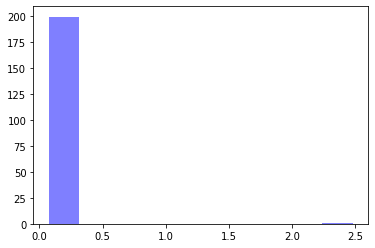

alpha: 0.51391655 , beta: 0.35423824 , initial_unconfirmed 2.6634316 , t0s 0.0 , lambds 0.38914615


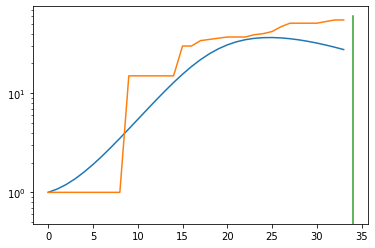

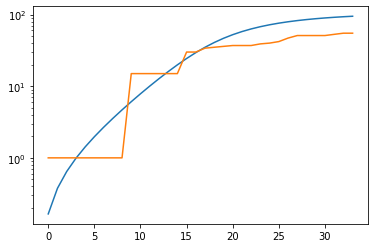

total error: 0.08481524139642715


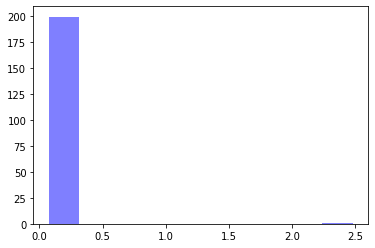

alpha: 0.97802186 , beta: 0.35423806 , initial_unconfirmed 1.3995008 , t0s 0.0 , lambds 0.38916752


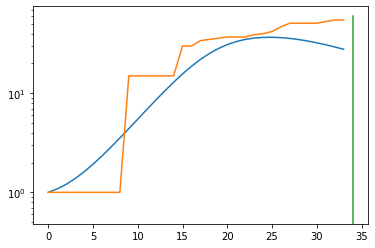

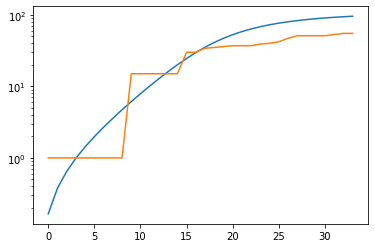

total error: 0.08481999486684799


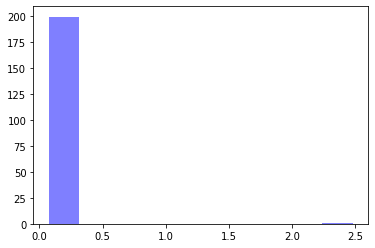

alpha: 0.97802186 , beta: 0.35423806 , initial_unconfirmed 1.3995008 , t0s 0.0 , lambds 0.38916752


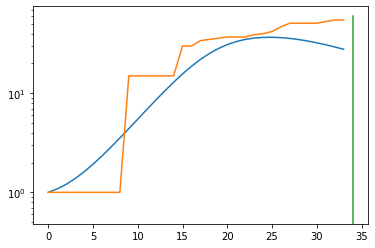

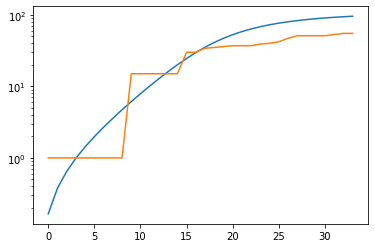

Rwanda
total error: 4.211153984069824


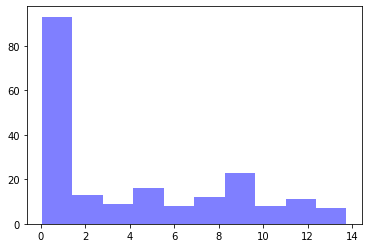

alpha: 0.9998579 , beta: 0.26039907 , initial_unconfirmed 15.343702 , t0s 0.9917301 , lambds 0.5761876


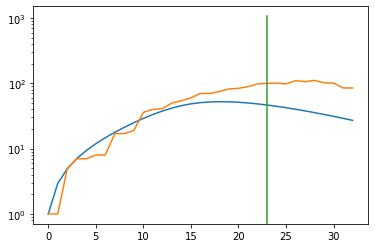

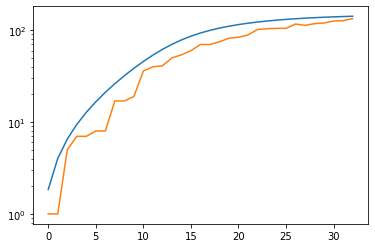

total error: 0.07196211814880371


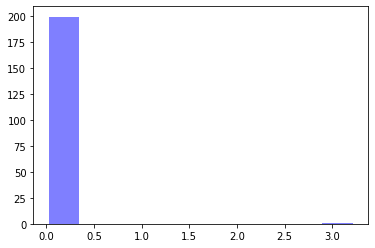

alpha: 0.7859434 , beta: 0.28276753 , initial_unconfirmed 11.165516 , t0s 0.0 , lambds 0.3828256


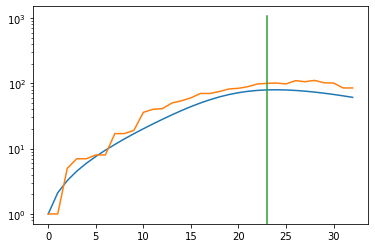

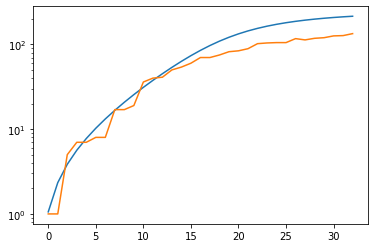

total error: 0.05877767503261566


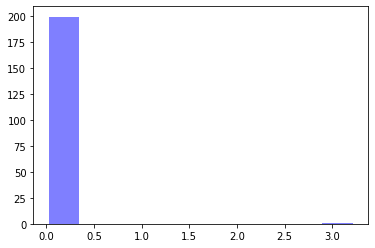

alpha: 0.50108314 , beta: 0.28277704 , initial_unconfirmed 17.513712 , t0s 0.0 , lambds 0.38286257


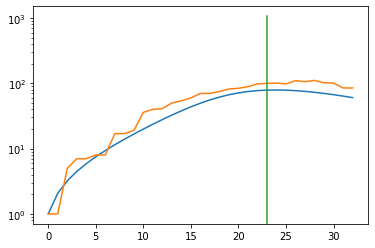

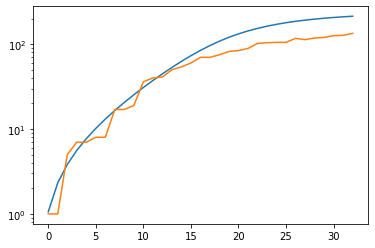

total error: 0.04300026595592499


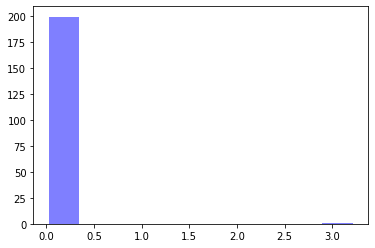

alpha: 0.50112605 , beta: 0.28278983 , initial_unconfirmed 17.510393 , t0s 0.0 , lambds 0.38287666


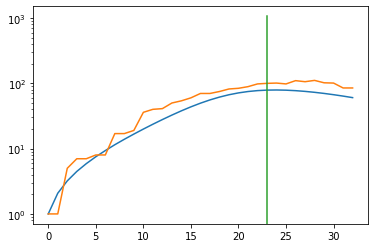

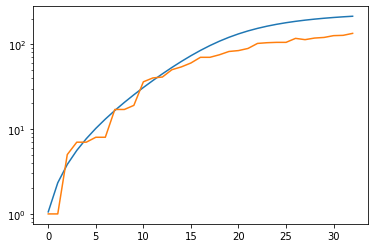

total error: 0.04102480411529541


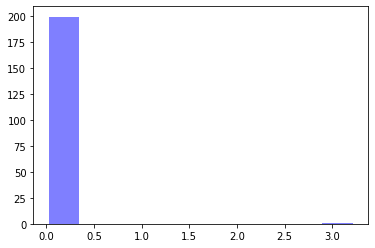

alpha: 0.50112605 , beta: 0.28278983 , initial_unconfirmed 17.510393 , t0s 0.0 , lambds 0.38287666


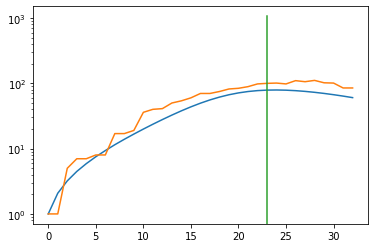

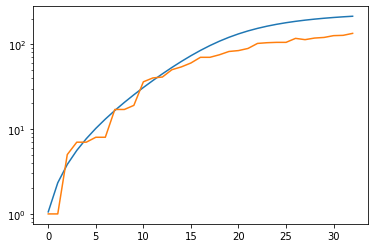

South Africa
total error: 3.7855420112609863


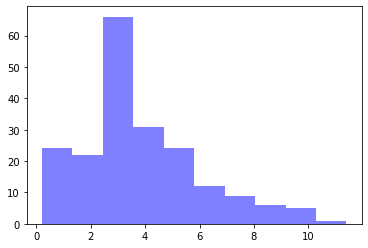

alpha: 0.99749625 , beta: 0.8563169 , initial_unconfirmed 0.8769363 , t0s 0.775845 , lambds 0.68050927


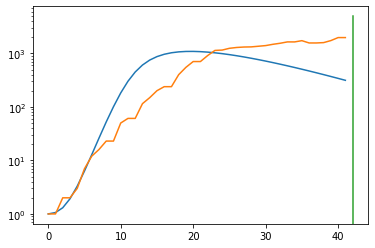

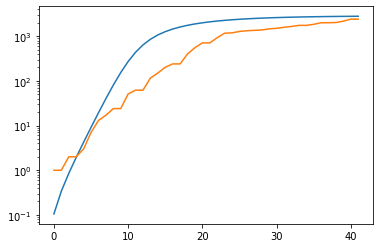

total error: 0.04619835689663887


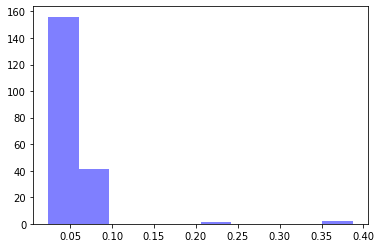

alpha: 0.56823343 , beta: 0.42843574 , initial_unconfirmed 7.8008404 , t0s 0.0 , lambds 0.3150659


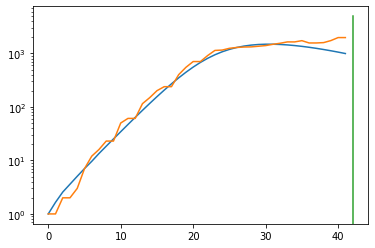

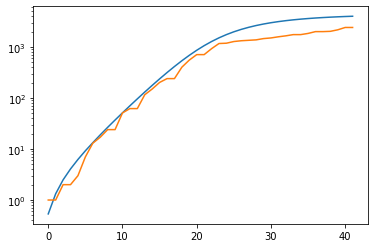

total error: 0.025712233036756516


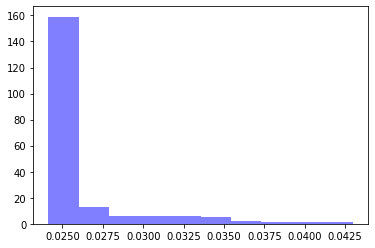

alpha: 0.56823343 , beta: 0.42843574 , initial_unconfirmed 7.8008404 , t0s 0.0 , lambds 0.3150659


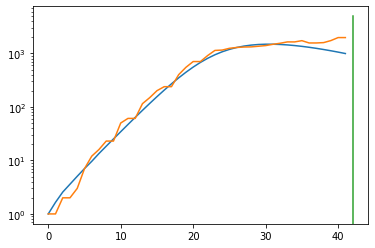

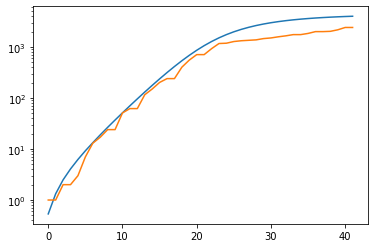

total error: 0.024151386693120003


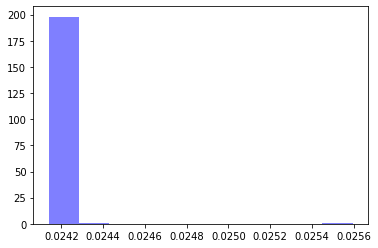

alpha: 0.56823343 , beta: 0.42843574 , initial_unconfirmed 7.8008404 , t0s 0.0 , lambds 0.3150659


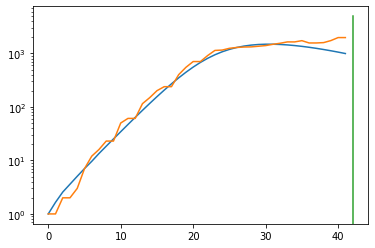

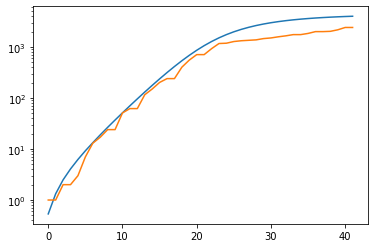

total error: 0.024146221578121185


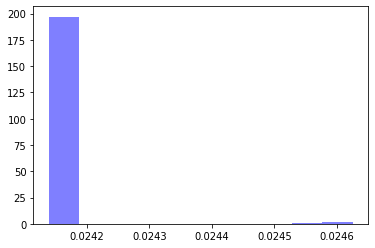

alpha: 0.56823343 , beta: 0.42843574 , initial_unconfirmed 7.8008404 , t0s 0.0 , lambds 0.3150659


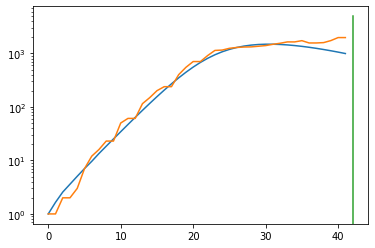

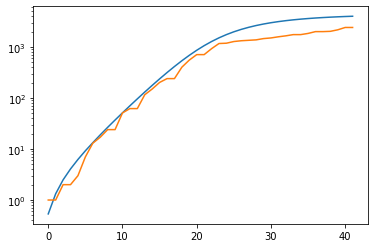

Bonaire, Saint Eustatius and Saba
Barbados
total error: 3.0895791053771973


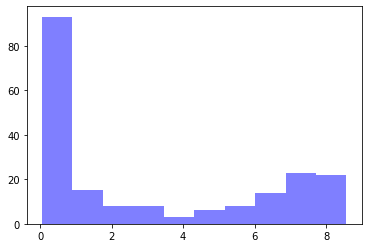

alpha: 0.9999038 , beta: 0.17389737 , initial_unconfirmed 17.799908 , t0s 0.5621767 , lambds 0.5596256


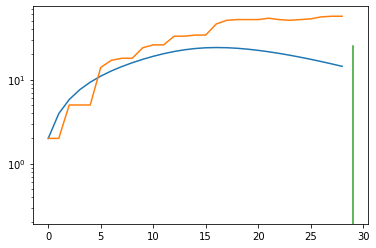

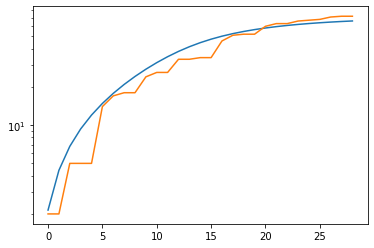

total error: 0.033181678503751755


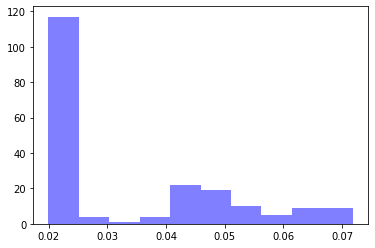

alpha: 0.51787174 , beta: 0.22242685 , initial_unconfirmed 22.531029 , t0s 0.0 , lambds 0.36918035


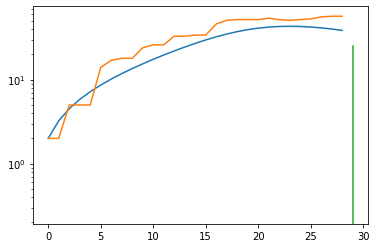

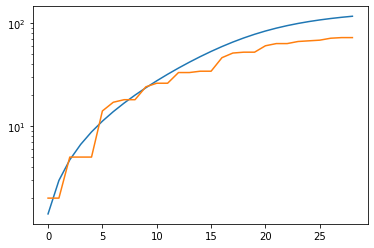

total error: 0.029453828930854797


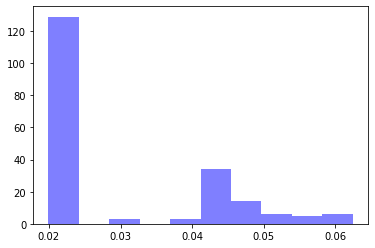

alpha: 0.5053292 , beta: 0.22238997 , initial_unconfirmed 23.09729 , t0s 0.0 , lambds 0.36908972


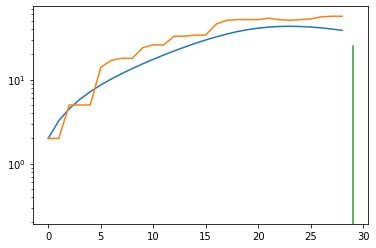

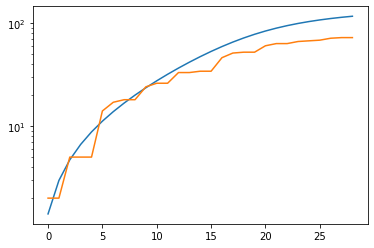

total error: 0.026154687628149986


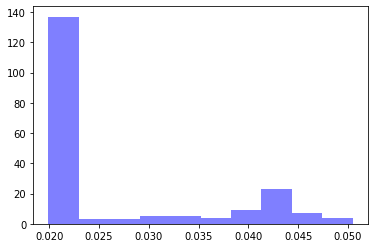

alpha: 0.5013037 , beta: 0.22241643 , initial_unconfirmed 23.277939 , t0s 0.0 , lambds 0.36914146


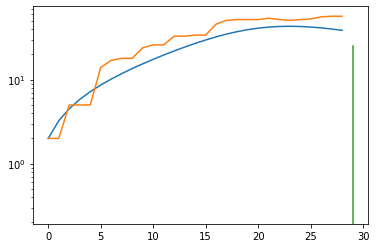

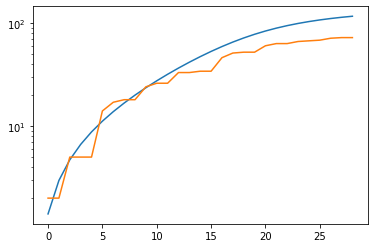

total error: 0.022521115839481354


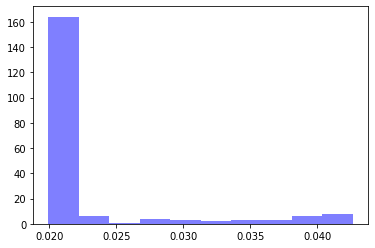

alpha: 0.5013037 , beta: 0.22241643 , initial_unconfirmed 23.277939 , t0s 0.0 , lambds 0.36914146


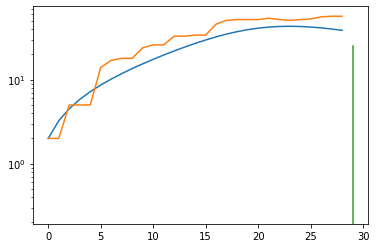

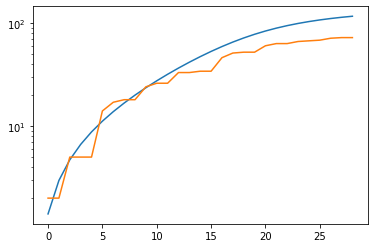

Luxembourg
total error: 3.755427837371826


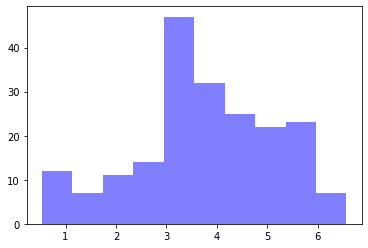

alpha: 0.99995595 , beta: 0.660525 , initial_unconfirmed 2.3975344 , t0s 0.5209347 , lambds 0.62121624


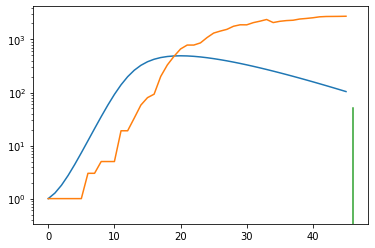

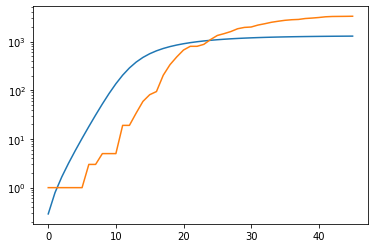

total error: 0.1672224998474121


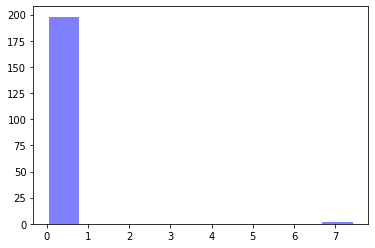

alpha: 0.5032324 , beta: 0.48113877 , initial_unconfirmed 2.0114639 , t0s 0.0 , lambds 0.2820495


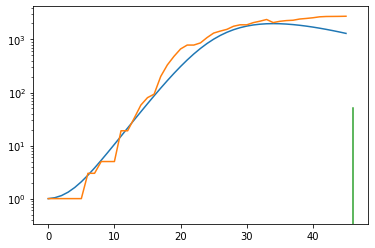

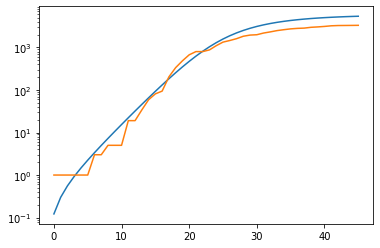

total error: 0.11715114861726761


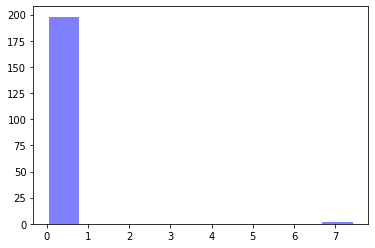

alpha: 0.5032324 , beta: 0.48113877 , initial_unconfirmed 2.0114639 , t0s 0.0 , lambds 0.2820495


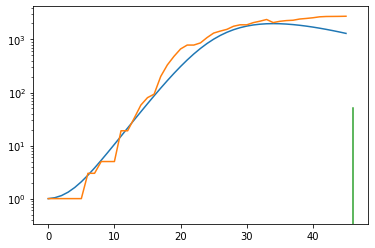

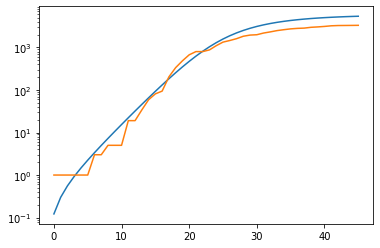

total error: 0.1170787438750267


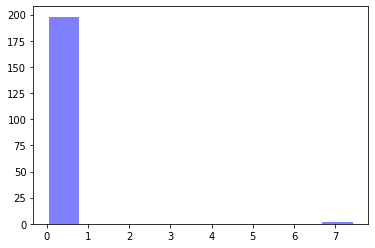

alpha: 0.5032324 , beta: 0.48113877 , initial_unconfirmed 2.0114639 , t0s 0.0 , lambds 0.2820495


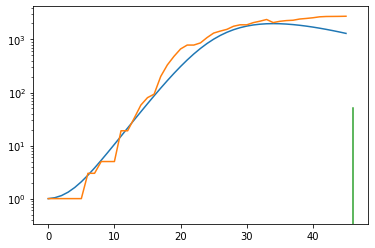

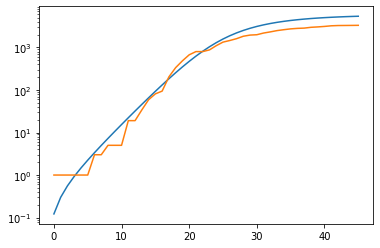

total error: 0.11708559095859528


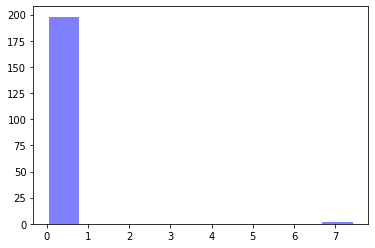

alpha: 0.5032324 , beta: 0.48113877 , initial_unconfirmed 2.0114639 , t0s 0.0 , lambds 0.2820495


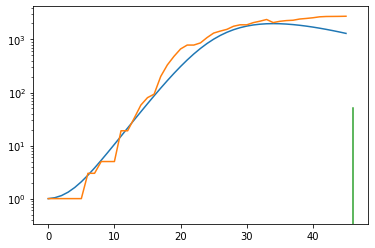

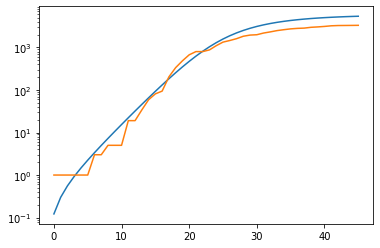

Wallis and Futuna Islands
Guinea-Bissau
total error: 3.501072645187378


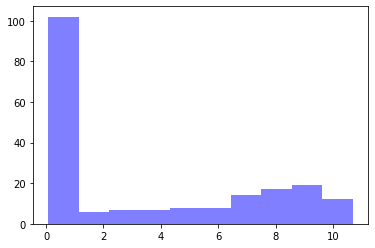

alpha: 0.999945 , beta: 0.5197519 , initial_unconfirmed 1.4964759 , t0s 0.28433937 , lambds 0.6345748


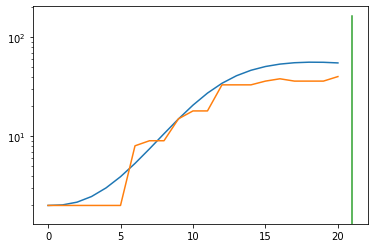

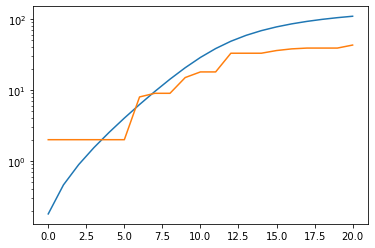

total error: 0.05951457843184471


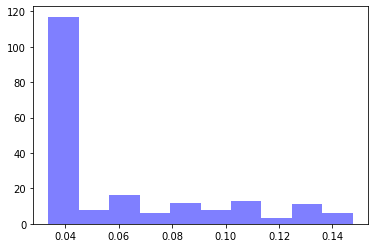

alpha: 0.503956 , beta: 0.32664606 , initial_unconfirmed 7.7493997 , t0s 5.86414 , lambds 0.9628617


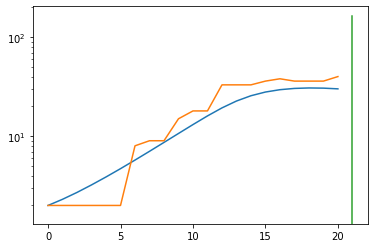

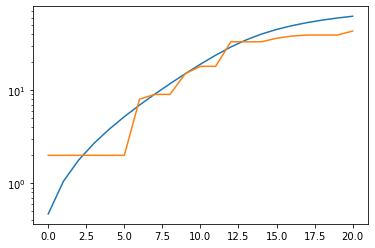

total error: 0.04289538040757179


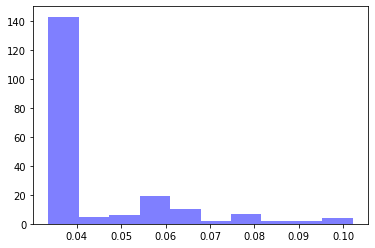

alpha: 0.9999946 , beta: 0.3262106 , initial_unconfirmed 3.9128084 , t0s 6.0833125 , lambds 0.9938168


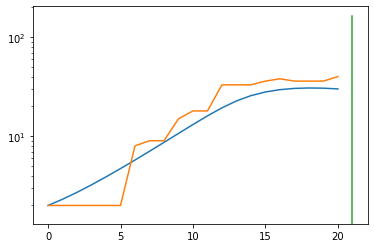

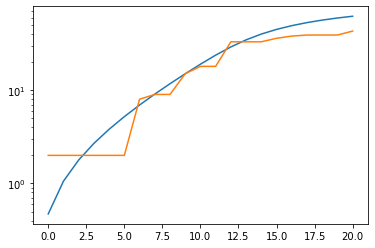

total error: 0.035836659371852875


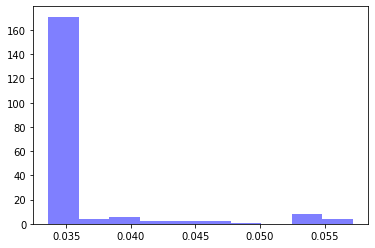

alpha: 0.9999946 , beta: 0.32643735 , initial_unconfirmed 3.9065971 , t0s 6.0989795 , lambds 0.9970523


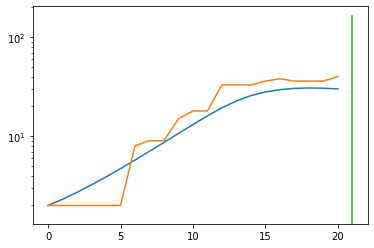

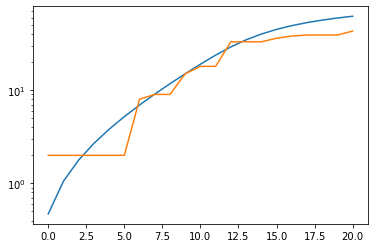

total error: 0.03402942046523094


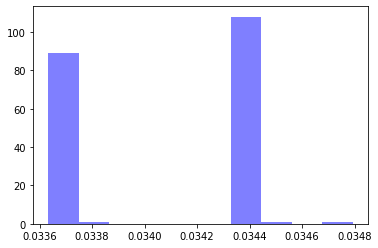

alpha: 0.9999946 , beta: 0.32642302 , initial_unconfirmed 3.9066966 , t0s 6.1028357 , lambds 0.99771595


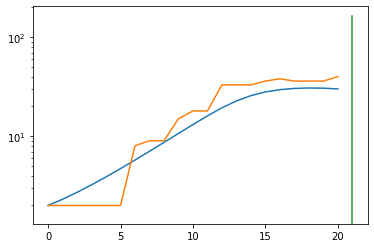

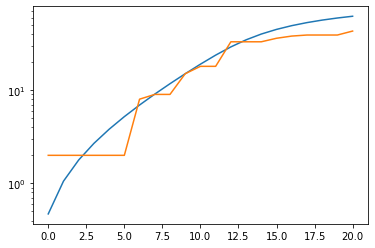

St. Barths
Gibraltar
total error: 3.8648693561553955


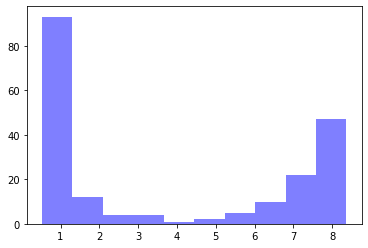

alpha: 0.9999755 , beta: 0.33665422 , initial_unconfirmed 2.0070167 , t0s 0.4725501 , lambds 0.6687715


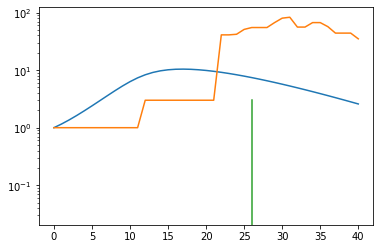

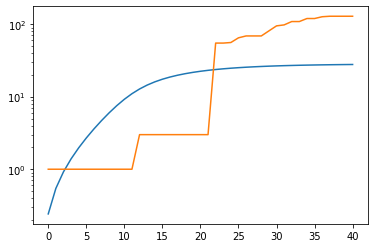

total error: 0.3384617865085602


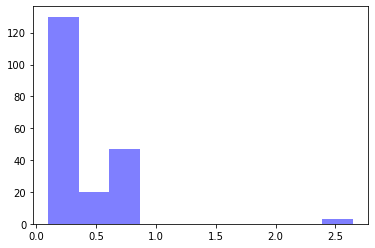

alpha: 0.50388277 , beta: 0.29439458 , initial_unconfirmed 1.1857224 , t0s 10.493723 , lambds 0.33043408


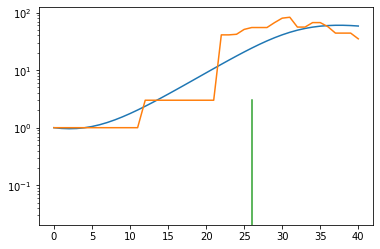

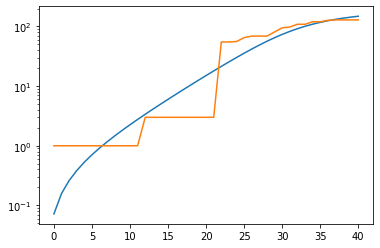

total error: 0.18659062683582306


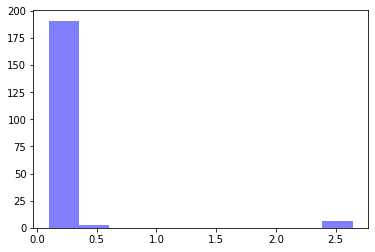

alpha: 0.9791389 , beta: 0.29265022 , initial_unconfirmed 0.6091151 , t0s 22.55384 , lambds 0.93448275


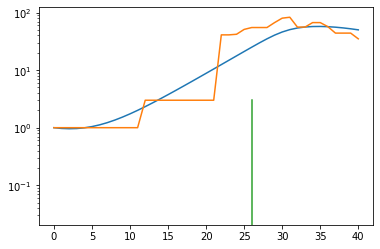

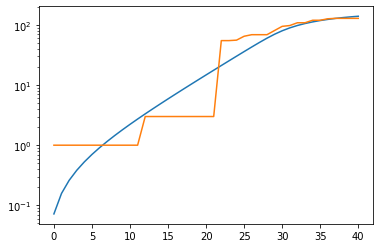

total error: 0.1783694326877594


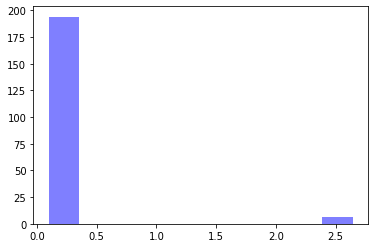

alpha: 0.9846736 , beta: 0.29264233 , initial_unconfirmed 0.60561514 , t0s 22.838968 , lambds 0.9752431


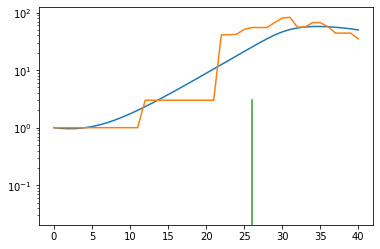

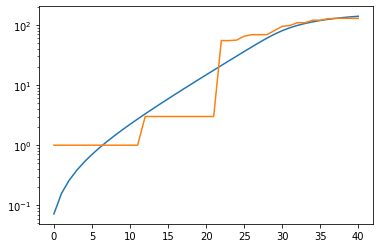

total error: 0.17789386212825775


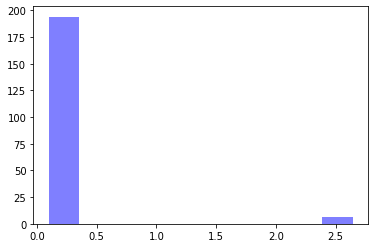

alpha: 0.98882097 , beta: 0.29263902 , initial_unconfirmed 0.60305494 , t0s 22.913544 , lambds 0.98653436


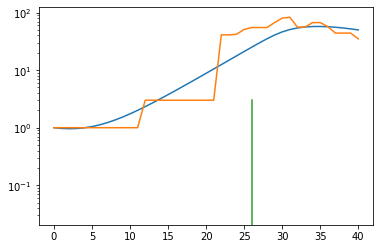

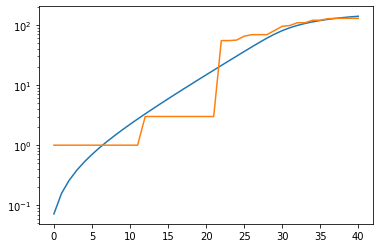

Jamaica
total error: 4.715085983276367


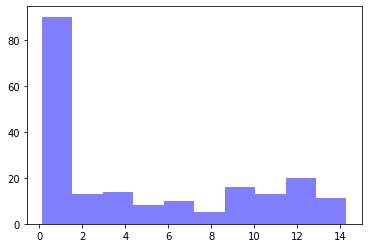

alpha: 0.87149453 , beta: 0.20538183 , initial_unconfirmed 17.946089 , t0s 0.46729428 , lambds 0.7094277


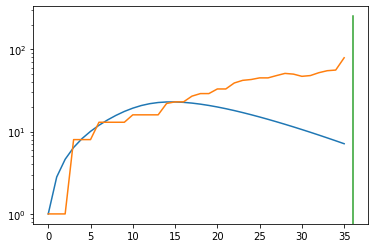

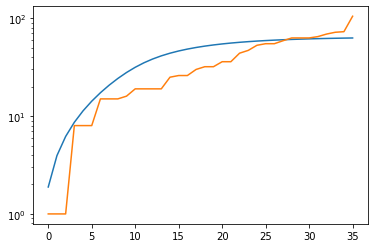

total error: 0.08304149657487869


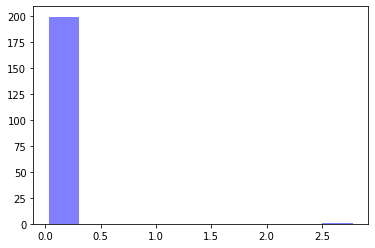

alpha: 0.54399824 , beta: 0.18831079 , initial_unconfirmed 16.915916 , t0s 0.0 , lambds 0.205743


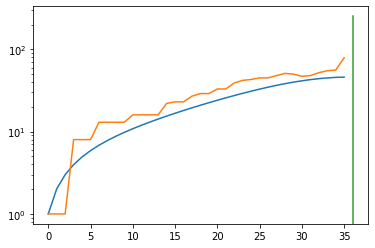

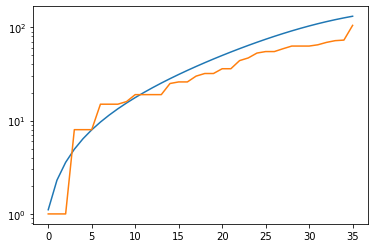

total error: 0.07092966139316559


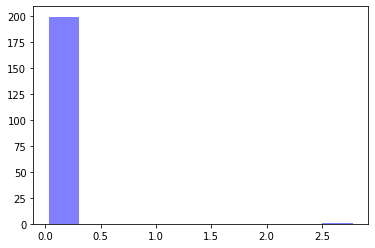

alpha: 0.54399824 , beta: 0.18831079 , initial_unconfirmed 16.915916 , t0s 0.0 , lambds 0.205743


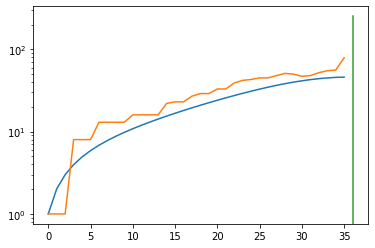

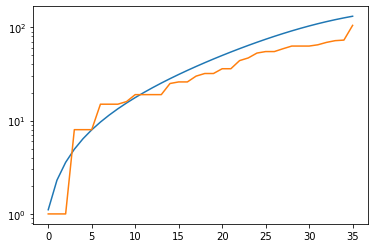

total error: 0.057886671274900436


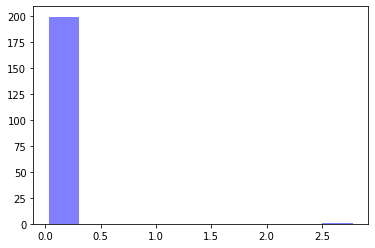

alpha: 0.54399824 , beta: 0.18831079 , initial_unconfirmed 16.915916 , t0s 0.0 , lambds 0.205743


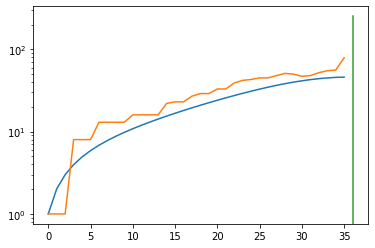

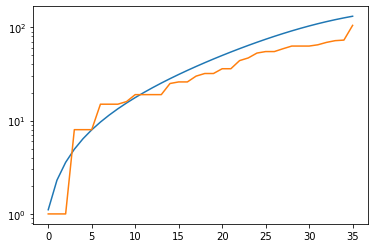

total error: 0.04800669848918915


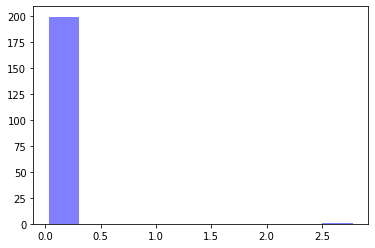

alpha: 0.50241256 , beta: 0.18832017 , initial_unconfirmed 18.314583 , t0s 0.0 , lambds 0.20577848


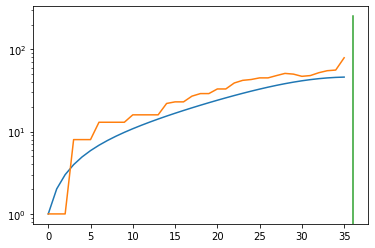

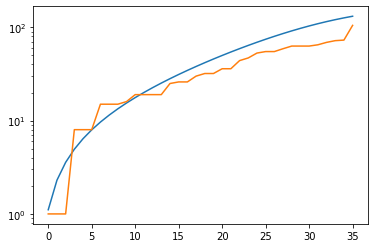

Malaysia
total error: 5.915441989898682


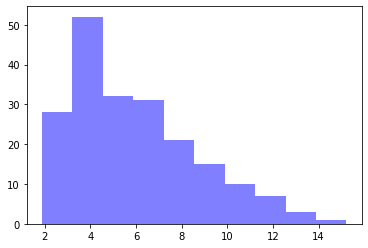

alpha: 0.9994701 , beta: 0.46433687 , initial_unconfirmed 8.940604 , t0s 0.8173056 , lambds 0.6041276


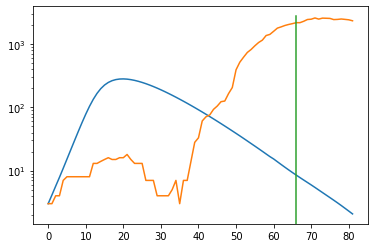

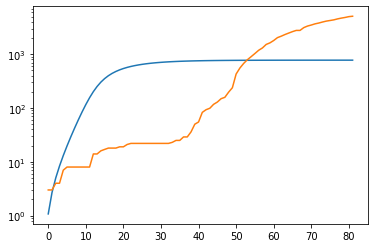

total error: 0.4236651360988617


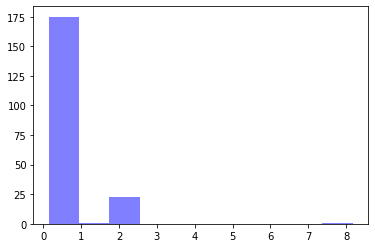

alpha: 0.6517229 , beta: 0.21762021 , initial_unconfirmed 3.8065176 , t0s 4.238419 , lambds 0.013692285


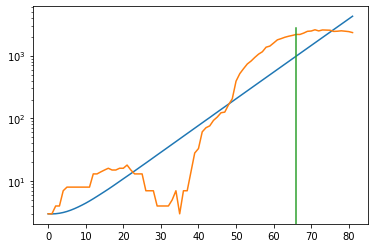

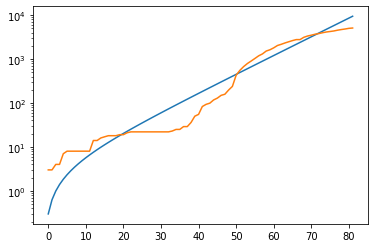

total error: 0.17743436992168427


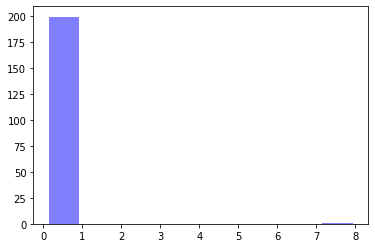

alpha: 0.6246766 , beta: 0.21749175 , initial_unconfirmed 3.9787319 , t0s 5.4387527 , lambds 0.00061482494


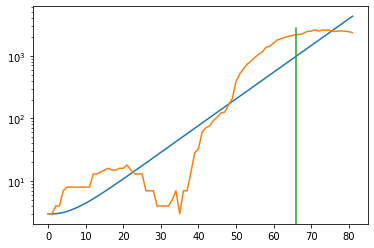

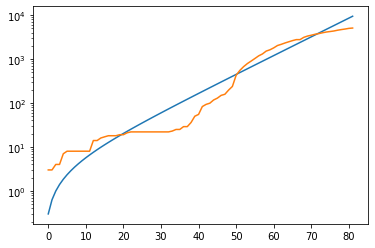

total error: 0.17738132178783417


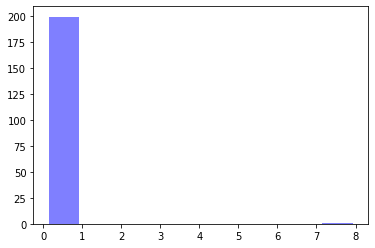

alpha: 0.6246766 , beta: 0.21749175 , initial_unconfirmed 3.9787319 , t0s 5.4387527 , lambds 0.00061482494


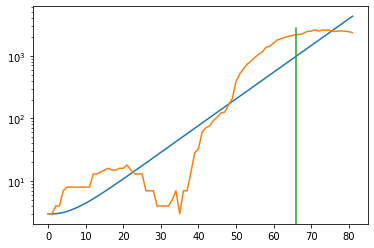

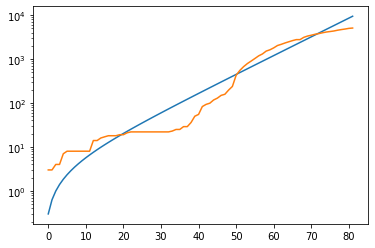

total error: 0.17730040848255157


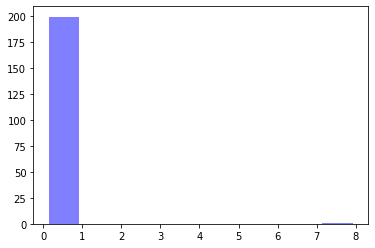

alpha: 0.6246766 , beta: 0.21749175 , initial_unconfirmed 3.9787319 , t0s 5.4387527 , lambds 0.00061482494


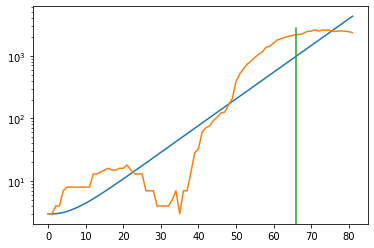

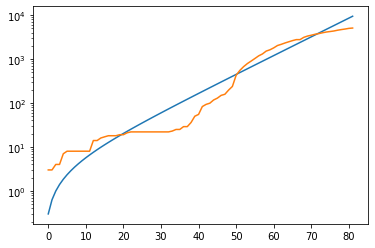

Sri Lanka
total error: 6.670194625854492


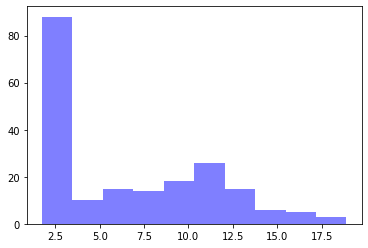

alpha: 0.99996674 , beta: 0.24542406 , initial_unconfirmed 6.340027 , t0s 0.044361115 , lambds 0.5794881


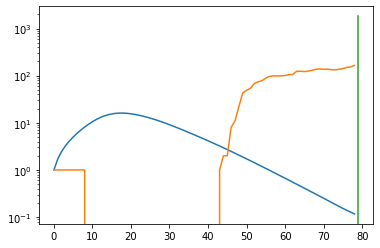

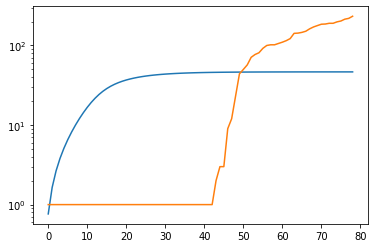

total error: 0.7818087935447693


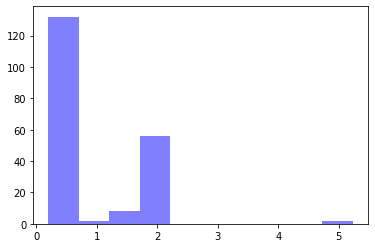

alpha: 0.50079656 , beta: 0.2139109 , initial_unconfirmed 0.41668606 , t0s 4.5856204 , lambds 0.00051054667


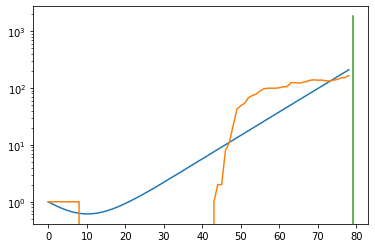

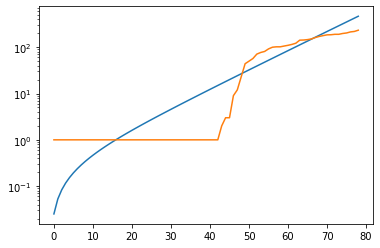

total error: 0.3794599175453186


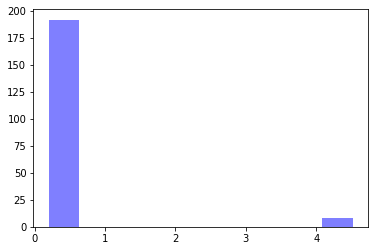

alpha: 0.50079656 , beta: 0.2138984 , initial_unconfirmed 0.4163699 , t0s 4.589282 , lambds 0.00031433426


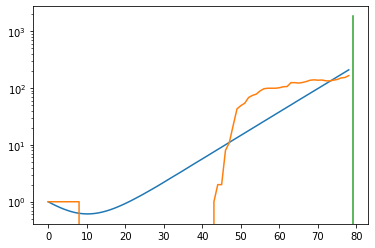

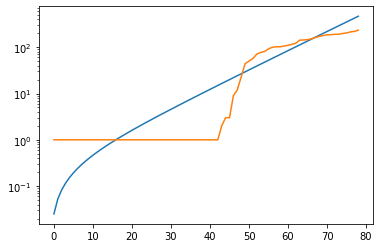

total error: 0.373121440410614


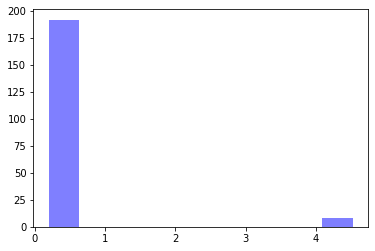

alpha: 0.50079656 , beta: 0.2138984 , initial_unconfirmed 0.4163699 , t0s 4.589282 , lambds 0.00031433426


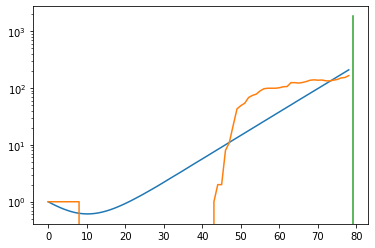

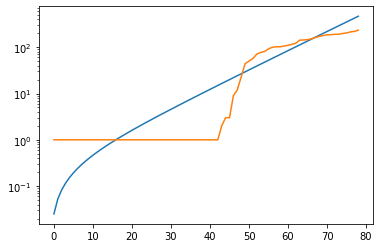

total error: 0.3729959726333618


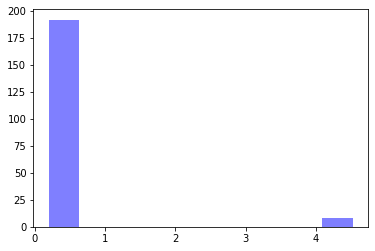

alpha: 0.50079656 , beta: 0.2138984 , initial_unconfirmed 0.4163699 , t0s 4.589282 , lambds 0.00031433426


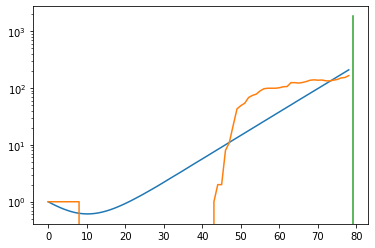

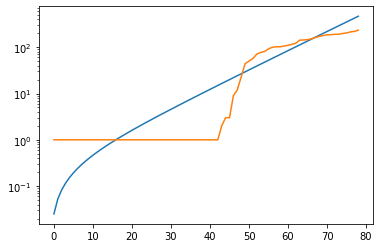

Palau
Ecuador
total error: 4.210165023803711


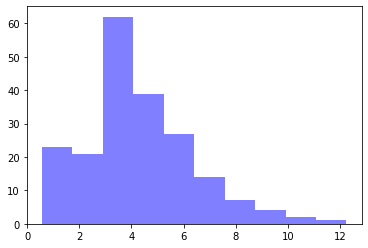

alpha: 0.99934745 , beta: 0.733402 , initial_unconfirmed 1.1204779 , t0s 0.87586284 , lambds 0.5087175


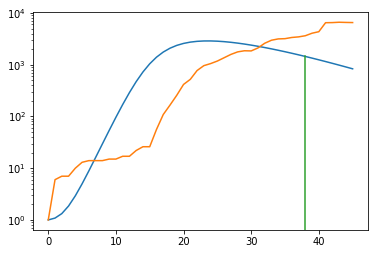

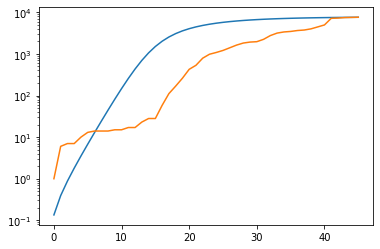

total error: 0.06916354596614838


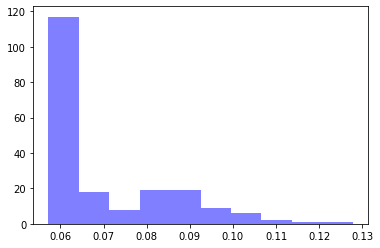

alpha: 0.9998001 , beta: 0.3372552 , initial_unconfirmed 6.8785667 , t0s 6.0226235 , lambds 0.24017344


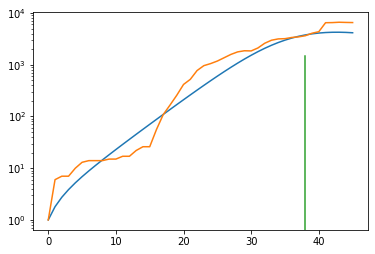

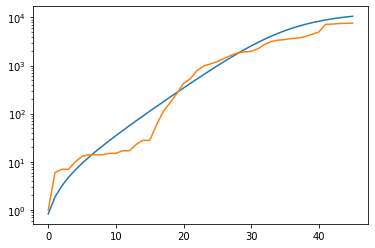

total error: 0.05912322178483009


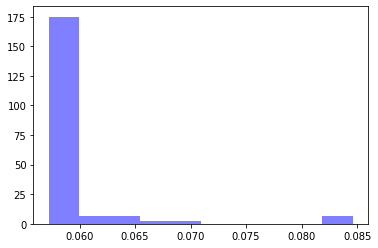

alpha: 0.9997982 , beta: 0.3369666 , initial_unconfirmed 6.8393726 , t0s 7.504876 , lambds 0.25501016


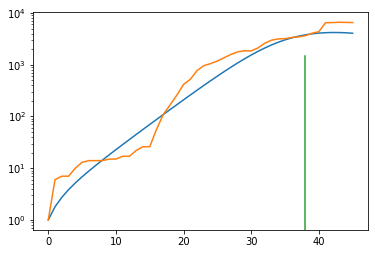

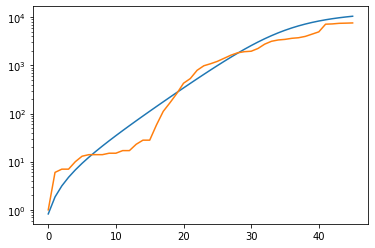

total error: 0.057421259582042694


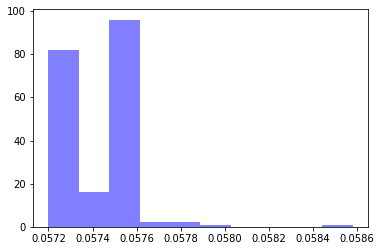

alpha: 0.9999012 , beta: 0.3371051 , initial_unconfirmed 6.810321 , t0s 7.740251 , lambds 0.2576944


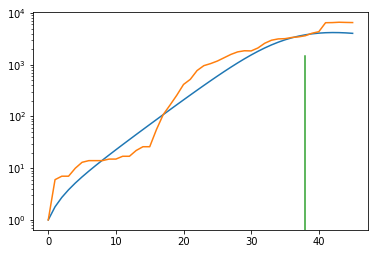

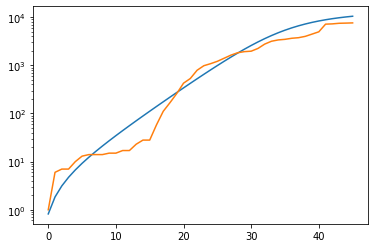

total error: 0.057393159717321396


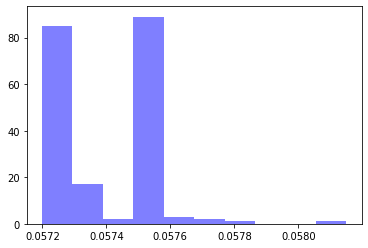

alpha: 0.99990094 , beta: 0.33714887 , initial_unconfirmed 6.8070507 , t0s 7.699234 , lambds 0.25728458


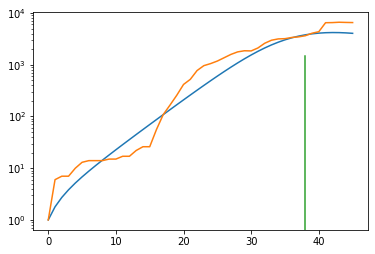

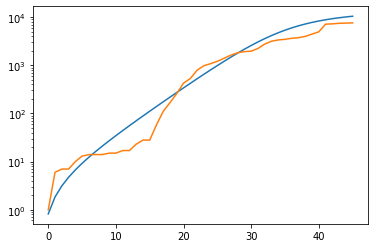

Albania
total error: 4.001091480255127


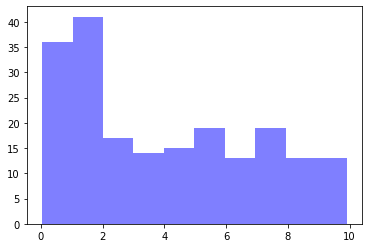

alpha: 0.99074316 , beta: 0.37176004 , initial_unconfirmed 11.008984 , t0s 0.15428507 , lambds 0.5026777


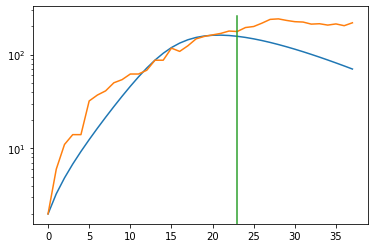

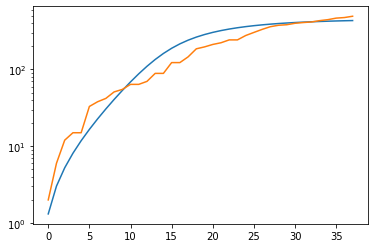

total error: 0.052904143929481506


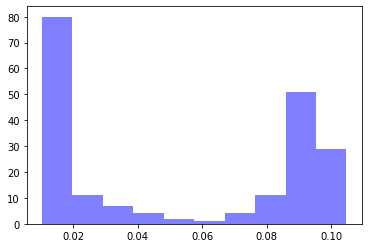

alpha: 0.7059605 , beta: 0.22343871 , initial_unconfirmed 42.49779 , t0s 0.0 , lambds 0.27273467


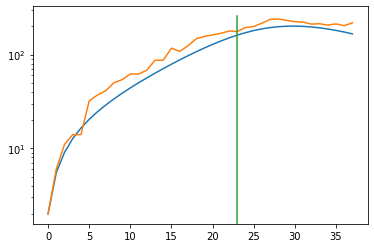

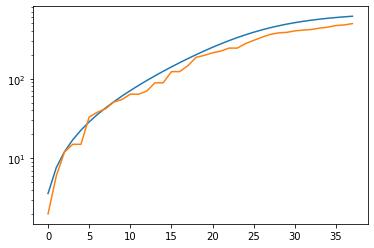

total error: 0.03544676676392555


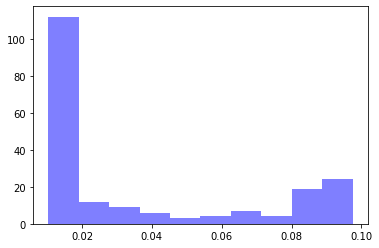

alpha: 0.7059533 , beta: 0.22343893 , initial_unconfirmed 42.49812 , t0s 0.0 , lambds 0.272734


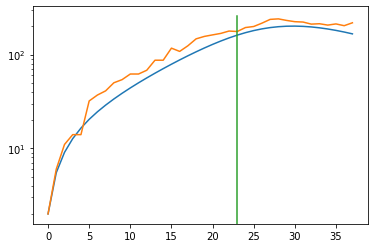

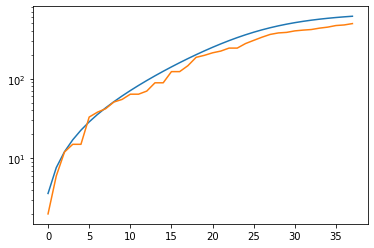

total error: 0.014482029713690281


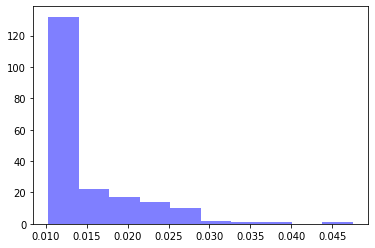

alpha: 0.6658993 , beta: 0.22343977 , initial_unconfirmed 45.05414 , t0s 0.0 , lambds 0.27273786


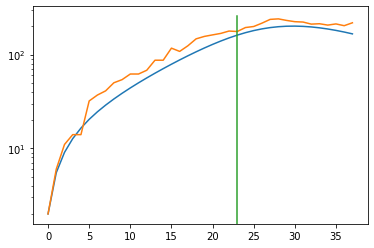

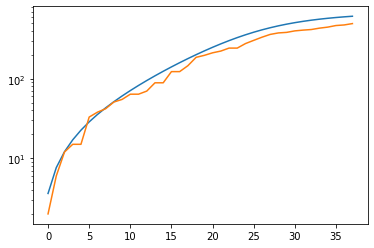

total error: 0.0114677045494318


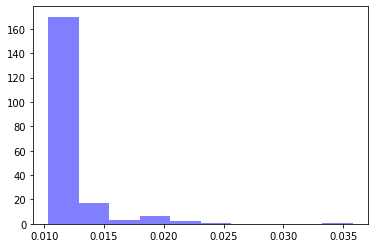

alpha: 0.67646027 , beta: 0.22344062 , initial_unconfirmed 44.35058 , t0s 0.0 , lambds 0.2727358


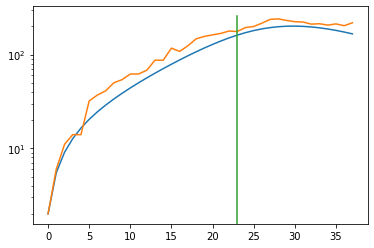

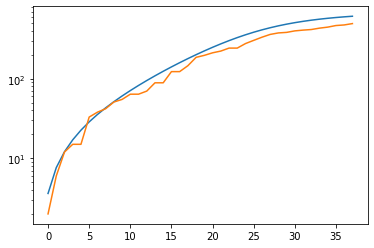

Bhutan
total error: 8.974262237548828


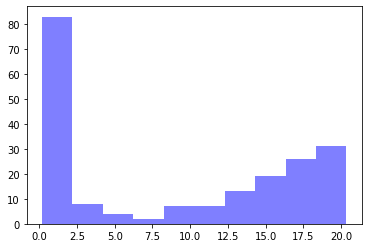

alpha: 0.9995266 , beta: 0.17630242 , initial_unconfirmed 2.7940722 , t0s 0.13824749 , lambds 0.6861593


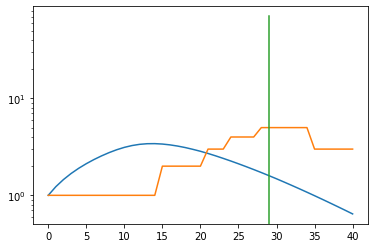

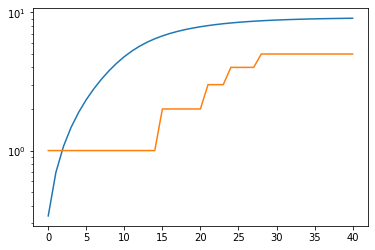

total error: 0.22408518195152283


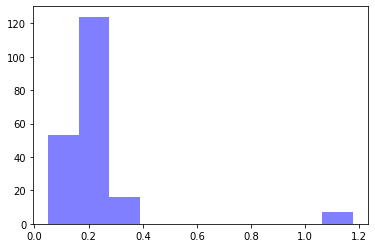

alpha: 0.99736357 , beta: 0.16008876 , initial_unconfirmed 0.964664 , t0s 3.290278 , lambds 0.19808544


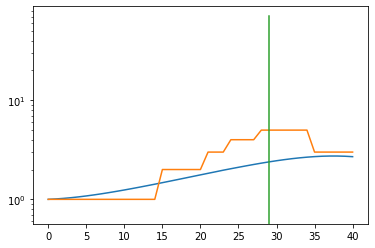

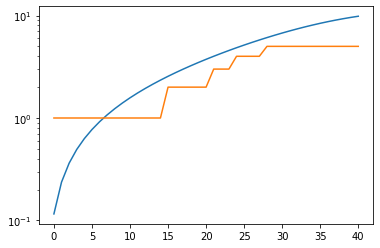

total error: 0.16163016855716705


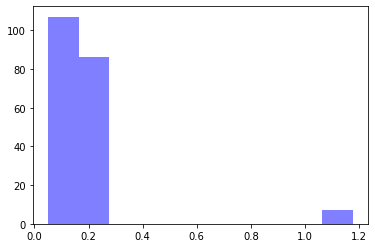

alpha: 0.99736345 , beta: 0.1602623 , initial_unconfirmed 0.9611518 , t0s 6.1135025 , lambds 0.22507872


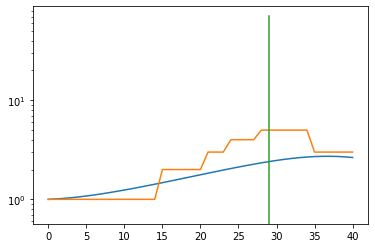

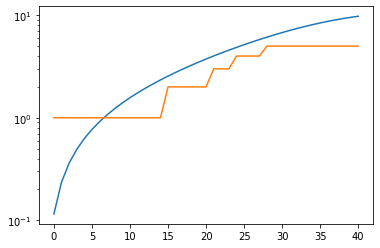

total error: 0.13762523233890533


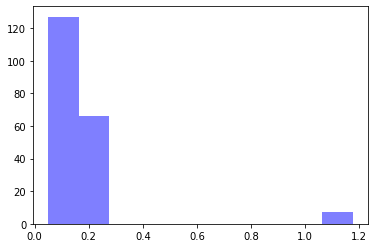

alpha: 0.58250177 , beta: 0.15965506 , initial_unconfirmed 1.6428792 , t0s 18.168982 , lambds 0.45118862


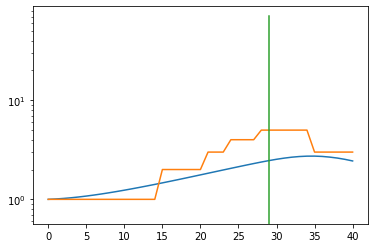

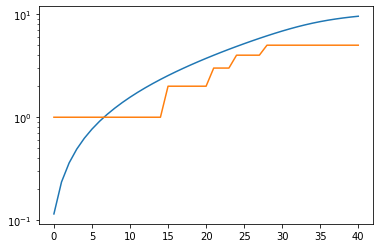

total error: 0.1199142187833786


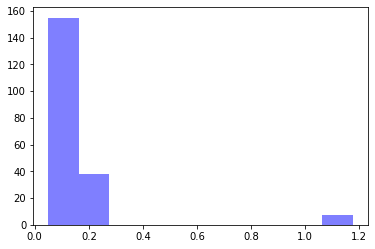

alpha: 0.5915451 , beta: 0.16018389 , initial_unconfirmed 1.6070544 , t0s 24.260242 , lambds 0.8683312


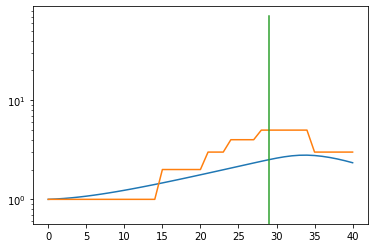

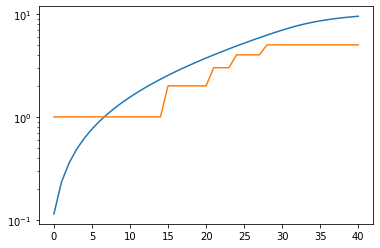

Gabon
total error: 5.321873188018799


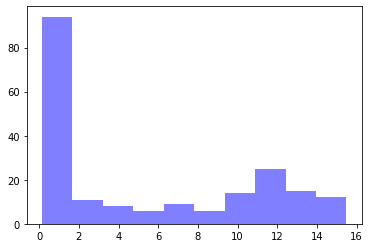

alpha: 0.99997264 , beta: 0.2728704 , initial_unconfirmed 4.169479 , t0s 0.42310947 , lambds 0.5488853


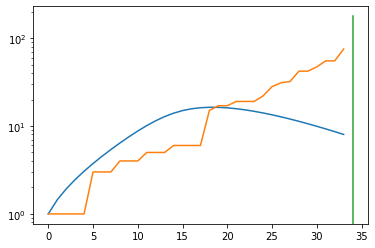

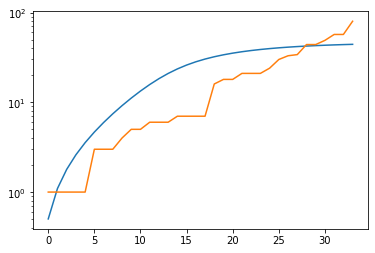

total error: 0.1704809069633484


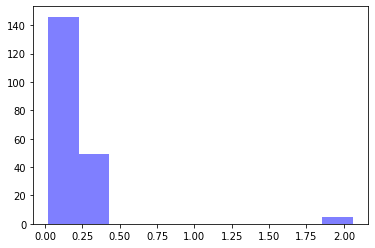

alpha: 0.99929476 , beta: 0.22876775 , initial_unconfirmed 2.2268414 , t0s 4.0156507 , lambds 0.0012172161


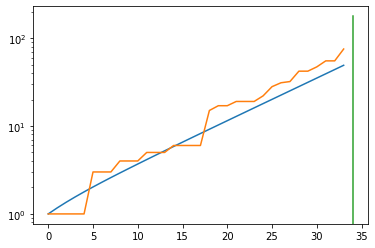

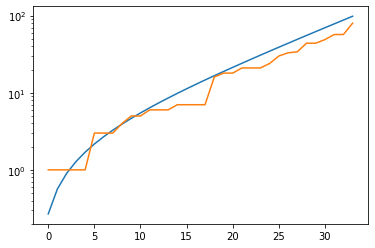

total error: 0.12011957913637161


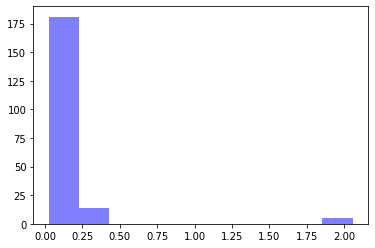

alpha: 0.9992949 , beta: 0.2287676 , initial_unconfirmed 2.226822 , t0s 4.0180063 , lambds 0.00073125


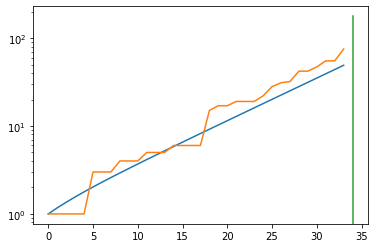

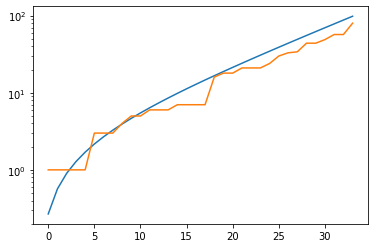

total error: 0.08934590220451355


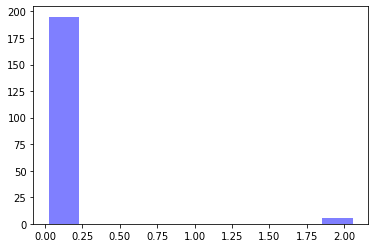

alpha: 0.999295 , beta: 0.22876705 , initial_unconfirmed 2.2268307 , t0s 4.0189776 , lambds 0.0004949956


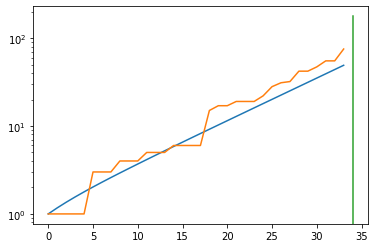

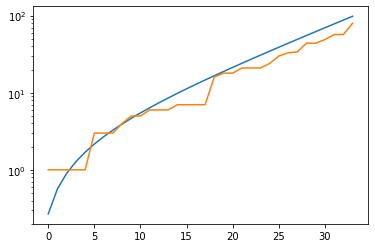

total error: 0.07438170164823532


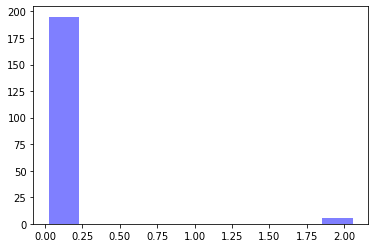

alpha: 0.999295 , beta: 0.22876701 , initial_unconfirmed 2.22682 , t0s 4.0194016 , lambds 0.00037668456


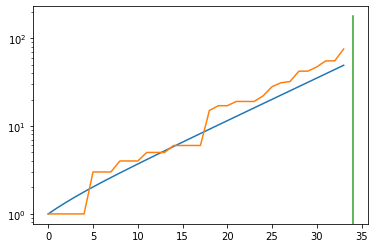

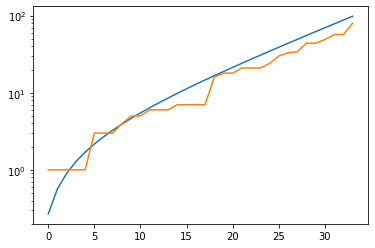

Seychelles
total error: 4.573925495147705


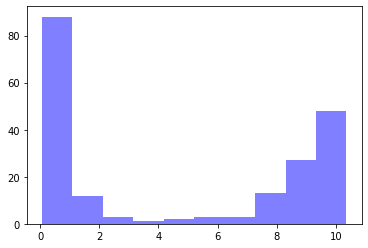

alpha: 0.99972713 , beta: 0.088832915 , initial_unconfirmed 11.948755 , t0s 0.38621897 , lambds 0.59556144


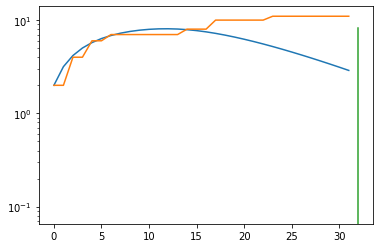

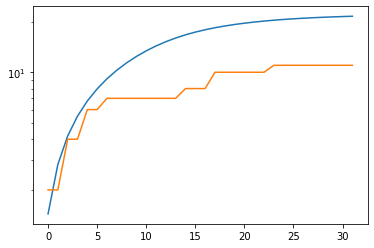

total error: 0.07367732375860214


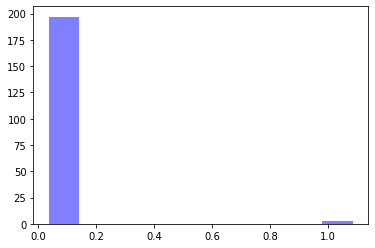

alpha: 0.99938244 , beta: 0.117262706 , initial_unconfirmed 6.839928 , t0s 2.729923 , lambds 0.002470164


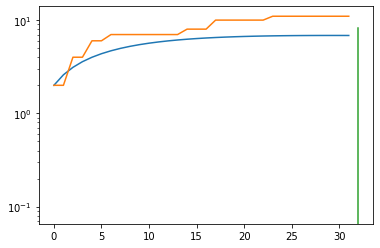

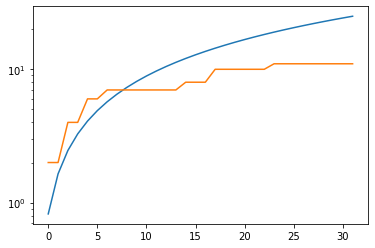

total error: 0.06867025047540665


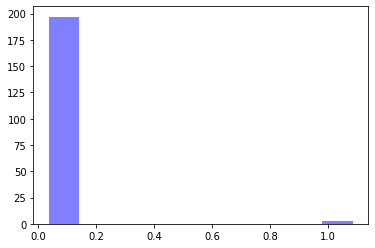

alpha: 0.9993834 , beta: 0.11726075 , initial_unconfirmed 6.8400006 , t0s 2.7348614 , lambds 0.0010738013


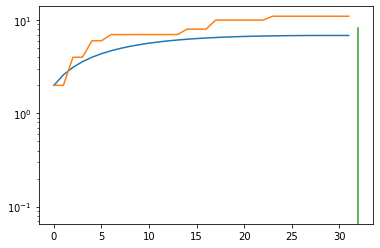

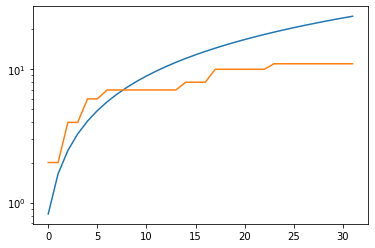

total error: 0.06552483141422272


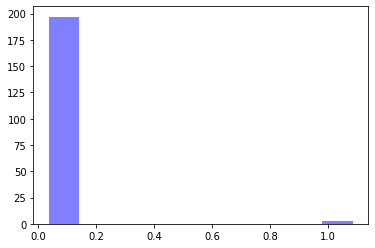

alpha: 0.99938464 , beta: 0.11726058 , initial_unconfirmed 6.839983 , t0s 2.736185 , lambds 0.0006068633


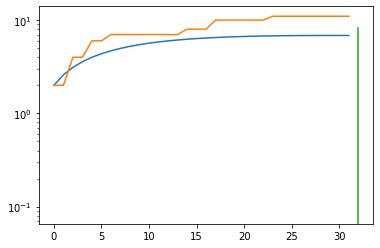

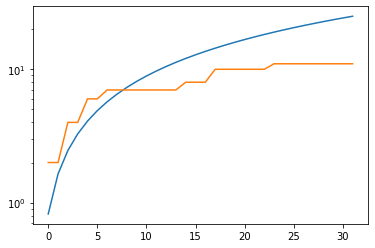

total error: 0.06361851841211319


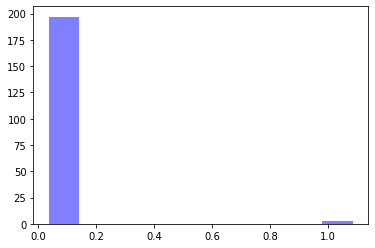

alpha: 0.9993861 , beta: 0.117260635 , initial_unconfirmed 6.839947 , t0s 2.7366786 , lambds 0.0004006434


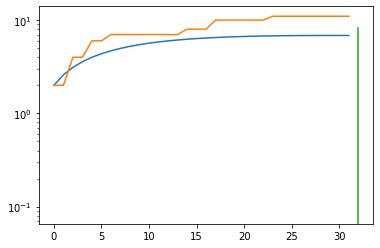

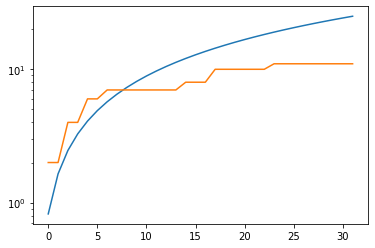

Indonesia
total error: 4.033624172210693


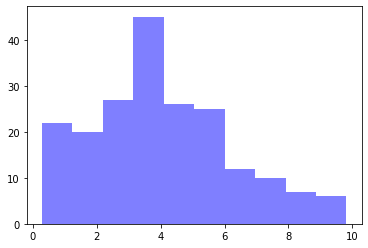

alpha: 0.9990095 , beta: 0.87776023 , initial_unconfirmed 0.67539513 , t0s 0.5472868 , lambds 0.6507278


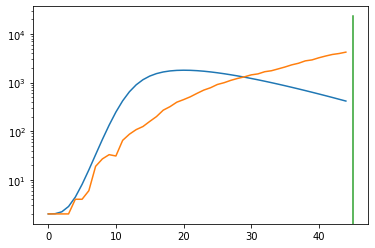

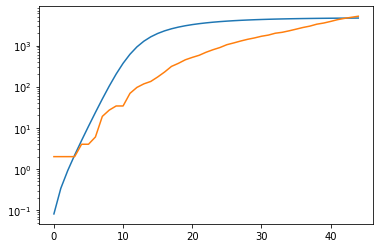

total error: 0.047443684190511703


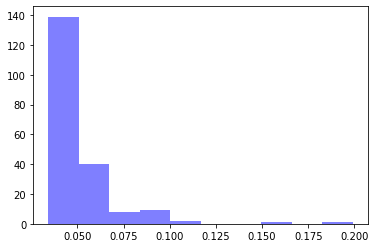

alpha: 0.9296912 , beta: 0.36950475 , initial_unconfirmed 6.9253583 , t0s 0.0 , lambds 0.24783172


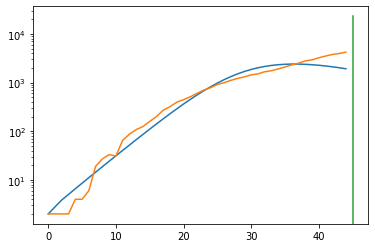

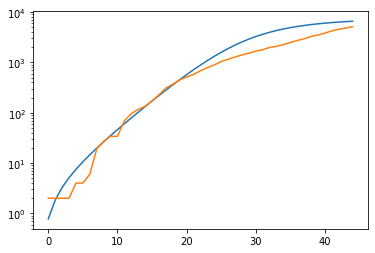

total error: 0.03561785817146301


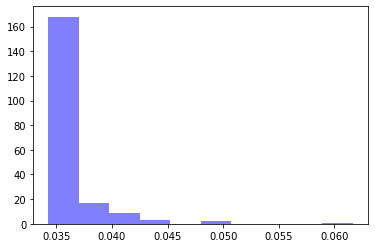

alpha: 0.9296912 , beta: 0.36950475 , initial_unconfirmed 6.9253583 , t0s 0.0 , lambds 0.24783172


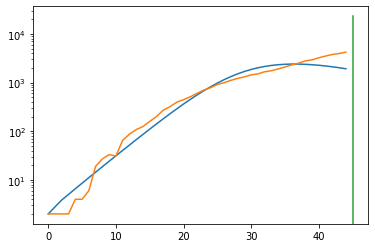

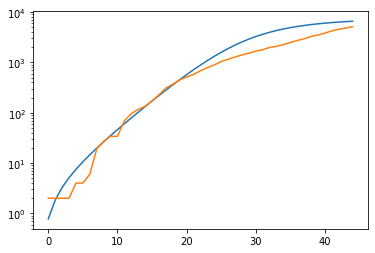

total error: 0.03438819572329521


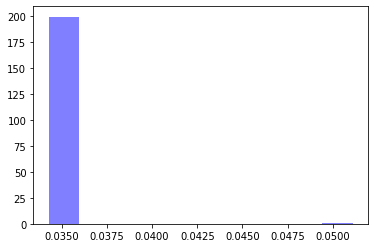

alpha: 0.9296912 , beta: 0.36950475 , initial_unconfirmed 6.9253583 , t0s 0.0 , lambds 0.24783172


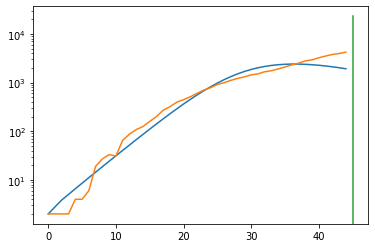

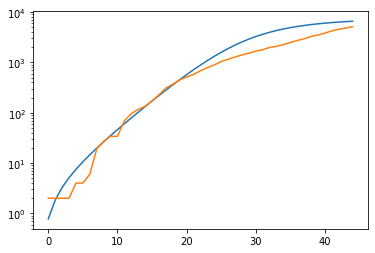

total error: 0.03433971107006073


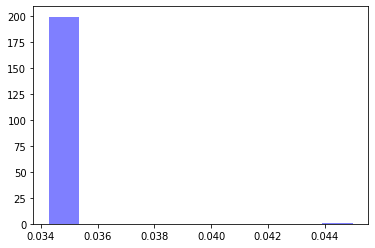

alpha: 0.9296912 , beta: 0.36950475 , initial_unconfirmed 6.9253583 , t0s 0.0 , lambds 0.24783172


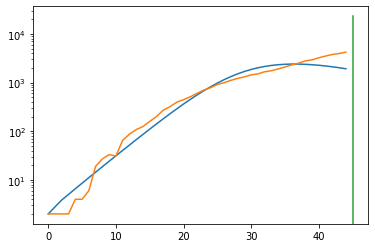

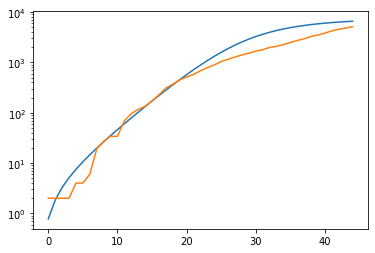

Mauritius
total error: 2.5432486534118652


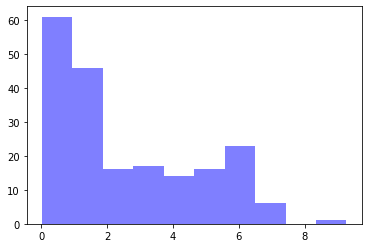

alpha: 0.79007906 , beta: 0.3343551 , initial_unconfirmed 30.086071 , t0s 0.26411325 , lambds 0.5758613


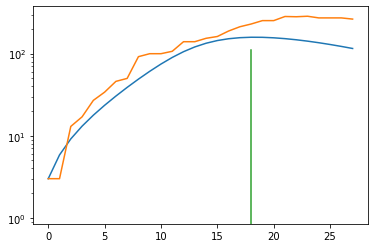

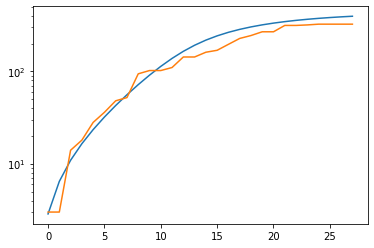

total error: 0.03250952437520027


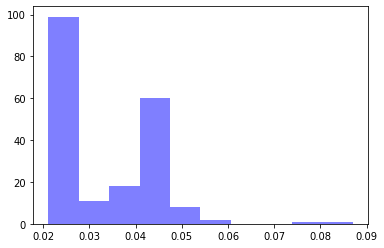

alpha: 0.64117783 , beta: 0.29436854 , initial_unconfirmed 45.879215 , t0s 0.0 , lambds 0.447867


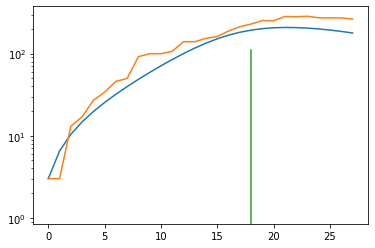

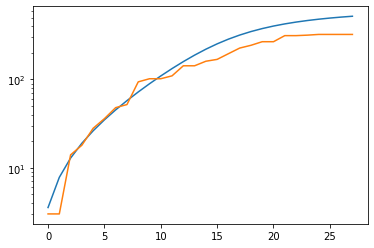

total error: 0.029074296355247498


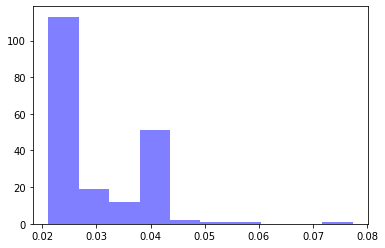

alpha: 0.64117575 , beta: 0.29436845 , initial_unconfirmed 45.879375 , t0s 0.0 , lambds 0.4478668


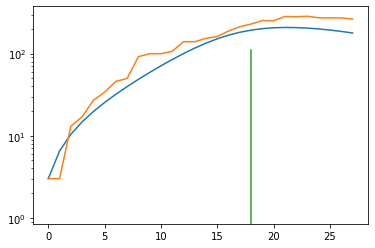

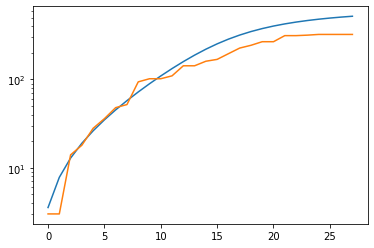

total error: 0.025413084775209427


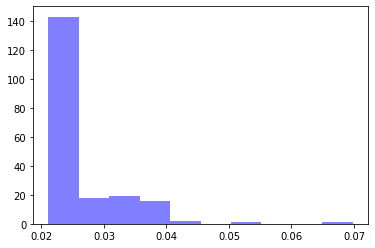

alpha: 0.64117575 , beta: 0.29436845 , initial_unconfirmed 45.879375 , t0s 0.0 , lambds 0.4478668


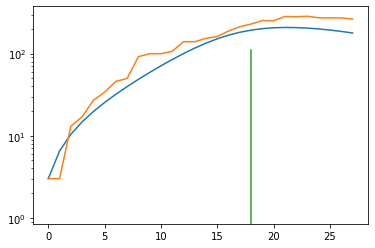

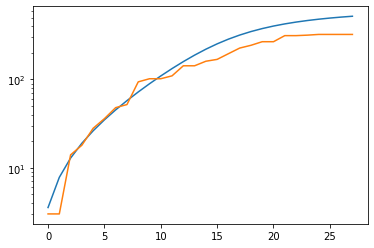

total error: 0.02256280928850174


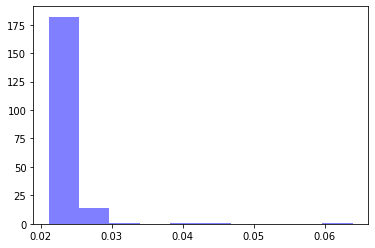

alpha: 0.64117575 , beta: 0.29436845 , initial_unconfirmed 45.879375 , t0s 0.0 , lambds 0.4478668


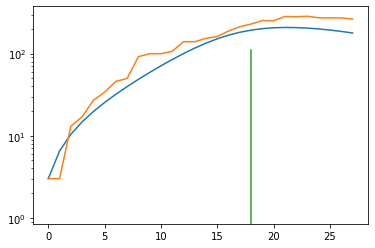

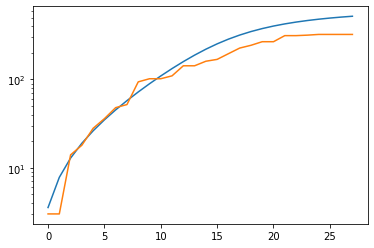

Venezuela
total error: 3.3413546085357666


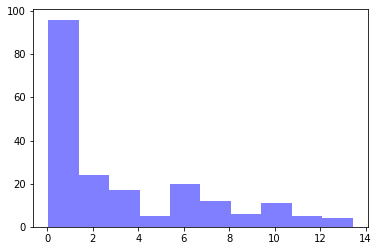

alpha: 0.99908364 , beta: 0.20843363 , initial_unconfirmed 42.307453 , t0s 0.38118255 , lambds 0.7270021


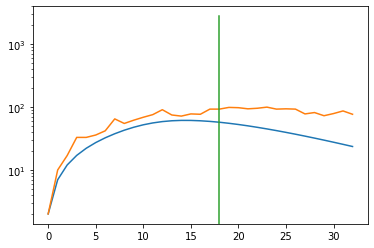

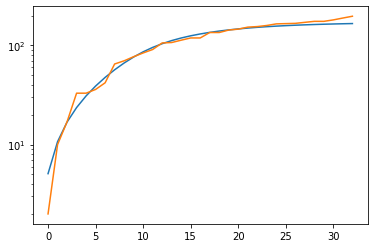

total error: 0.02764863707125187


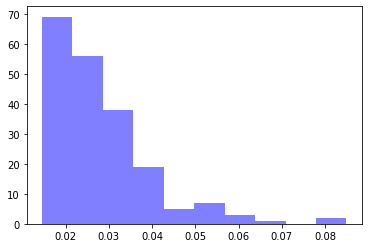

alpha: 0.9997914 , beta: 0.15799531 , initial_unconfirmed 53.02432 , t0s 0.0 , lambds 0.33211496


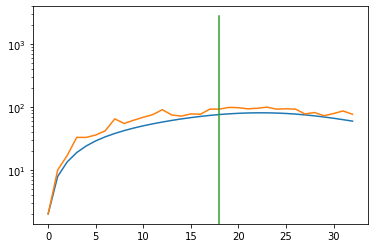

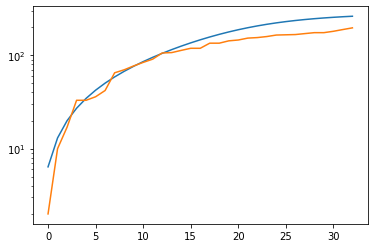

total error: 0.02388417162001133


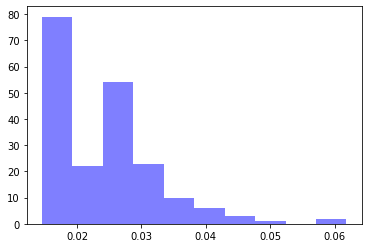

alpha: 0.9999864 , beta: 0.15821218 , initial_unconfirmed 52.933678 , t0s 0.0 , lambds 0.33273572


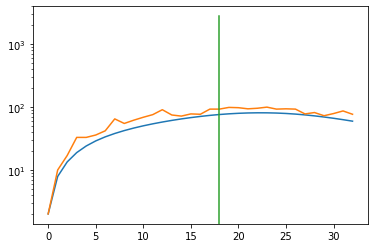

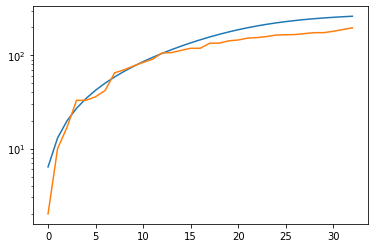

total error: 0.02180965431034565


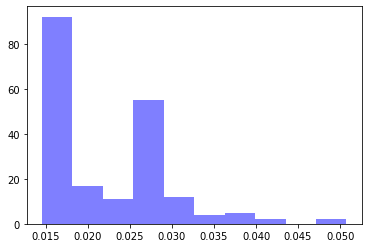

alpha: 0.99993783 , beta: 0.15827766 , initial_unconfirmed 52.922844 , t0s 0.0 , lambds 0.3330239


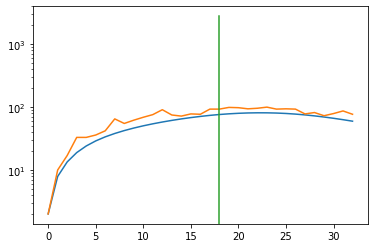

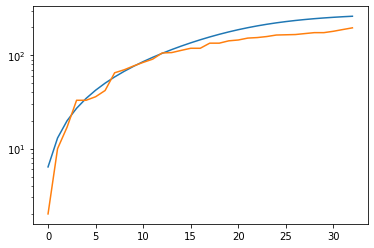

total error: 0.02040206827223301


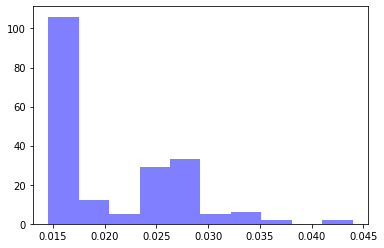

alpha: 0.99993783 , beta: 0.15827766 , initial_unconfirmed 52.922844 , t0s 0.0 , lambds 0.3330239


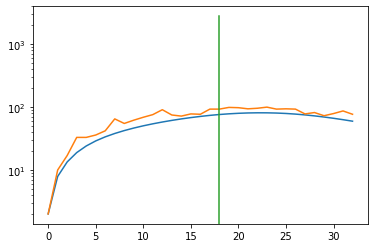

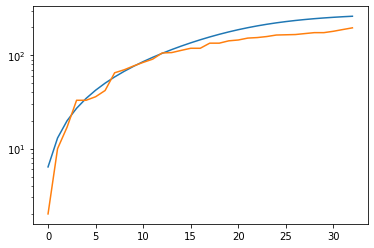

Sao Tome and Principe
total error: 2.164214849472046


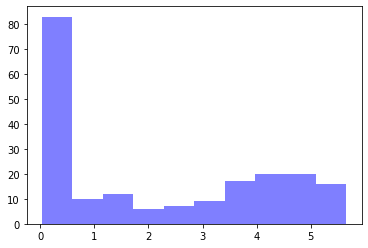

alpha: 0.99949205 , beta: 0.00010594334 , initial_unconfirmed 8.025164 , t0s 0.1762377 , lambds 0.6994086


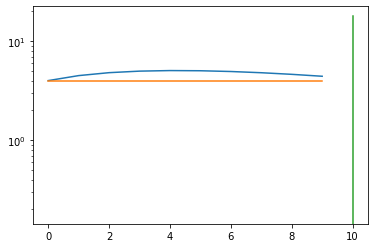

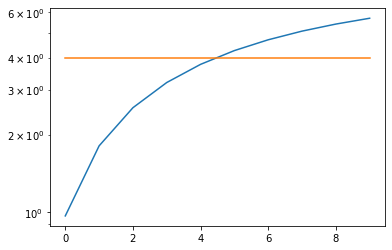

total error: 0.03519470617175102


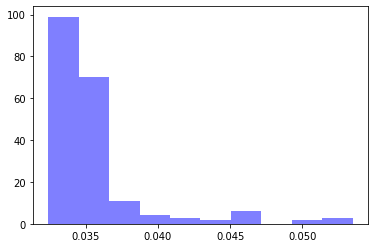

alpha: 0.9914484 , beta: 6.890929e-07 , initial_unconfirmed 8.722142 , t0s 0.86222196 , lambds 0.61163706


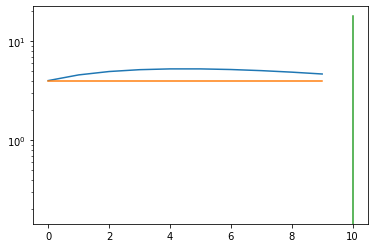

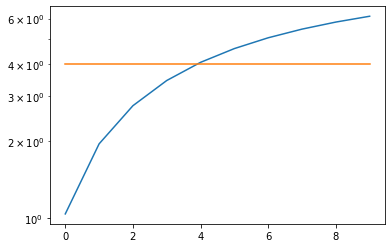

total error: 0.033022817224264145


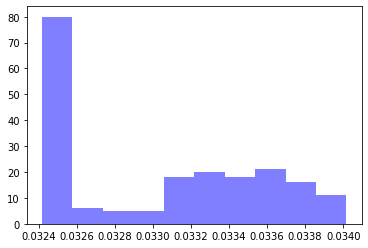

alpha: 0.99972594 , beta: 2.9769674e-07 , initial_unconfirmed 8.649916 , t0s 0.0 , lambds 0.7850309


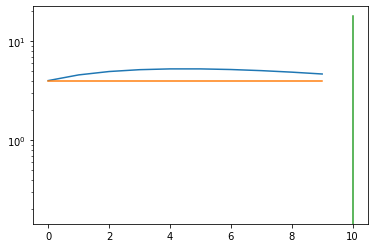

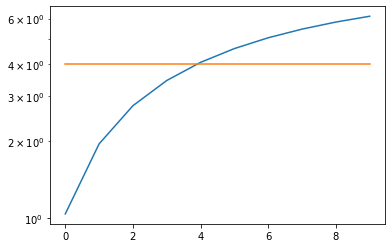

total error: 0.03275086730718613


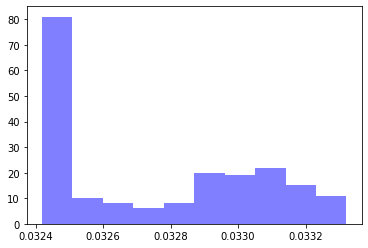

alpha: 0.99972594 , beta: 1.6735561e-07 , initial_unconfirmed 8.649912 , t0s 0.0 , lambds 0.78859377


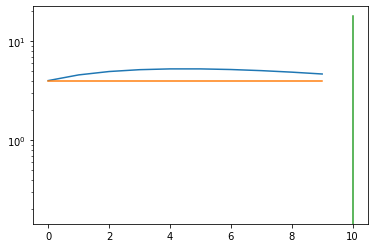

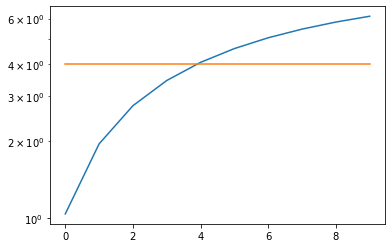

total error: 0.032629575580358505


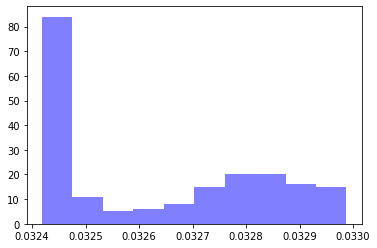

alpha: 0.99972594 , beta: 1.2434074e-07 , initial_unconfirmed 8.649903 , t0s 0.0 , lambds 0.79027903


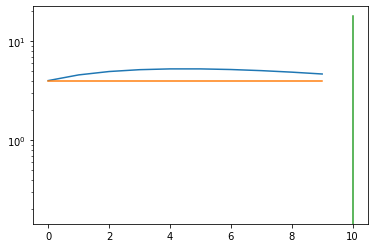

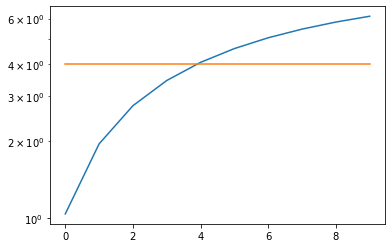

Slovenia
total error: 3.4172747135162354


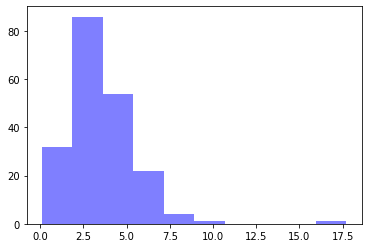

alpha: 0.99911815 , beta: 0.4356602 , initial_unconfirmed 28.2058 , t0s 0.9835288 , lambds 0.52893376


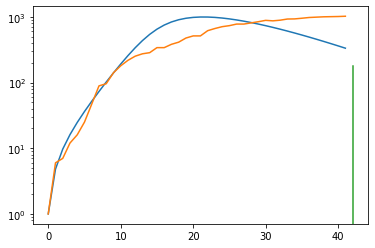

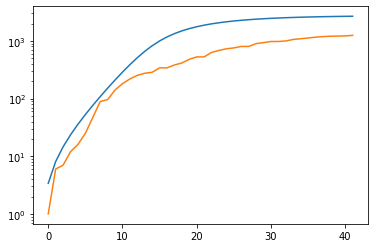

total error: 0.07275336980819702


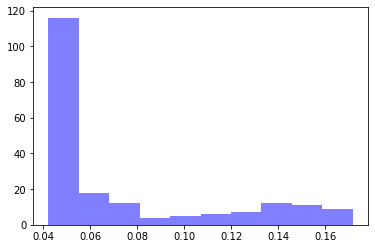

alpha: 0.7646651 , beta: 0.29835895 , initial_unconfirmed 42.10613 , t0s 0.0 , lambds 0.30696338


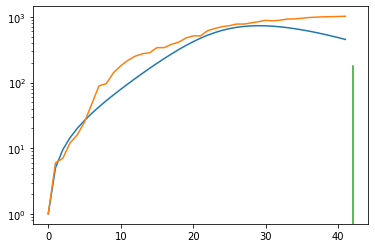

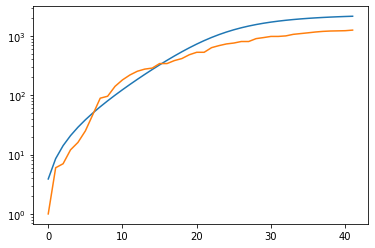

total error: 0.04725022614002228


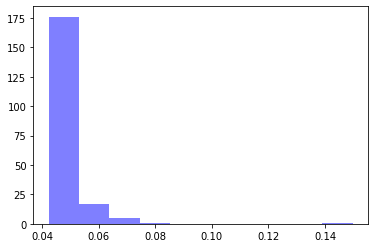

alpha: 0.69383335 , beta: 0.29834214 , initial_unconfirmed 46.413654 , t0s 0.0 , lambds 0.30692774


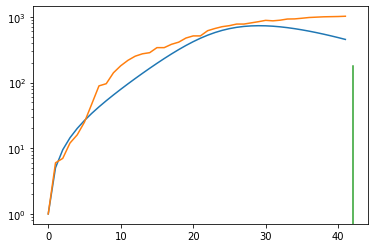

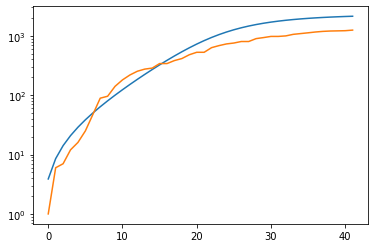

total error: 0.04465363174676895


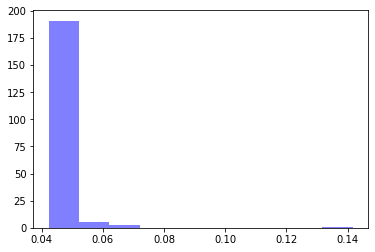

alpha: 0.6799418 , beta: 0.29837924 , initial_unconfirmed 47.346485 , t0s 0.0 , lambds 0.30696684


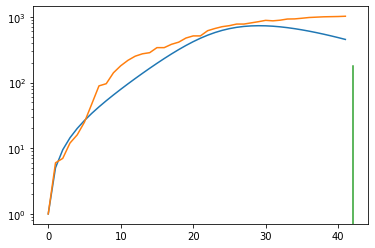

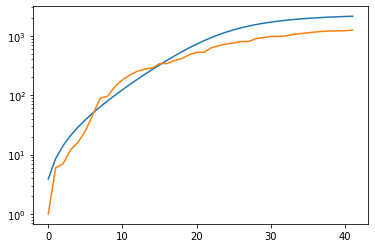

total error: 0.04371605068445206


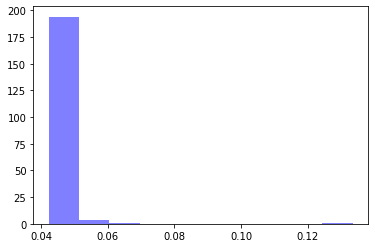

alpha: 0.6592405 , beta: 0.29845354 , initial_unconfirmed 48.8001 , t0s 0.0 , lambds 0.3070337


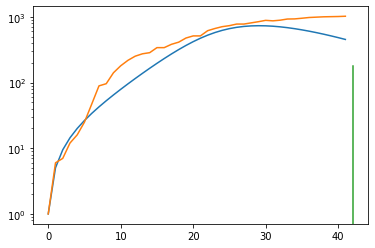

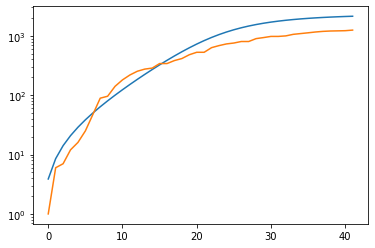

Switzerland
total error: 4.295962810516357


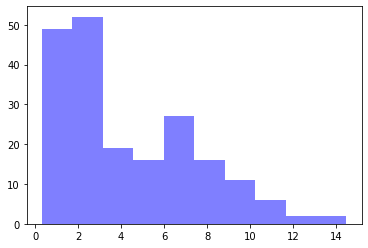

alpha: 0.99967587 , beta: 0.7975057 , initial_unconfirmed 5.200729 , t0s 0.82224196 , lambds 0.6121536


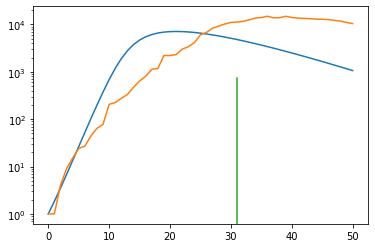

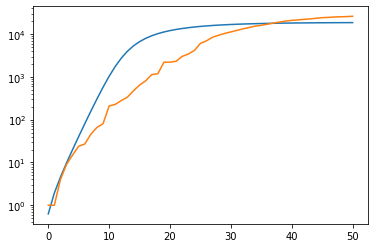

total error: 0.030509717762470245


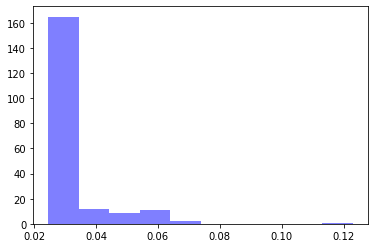

alpha: 0.5151611 , beta: 0.42435268 , initial_unconfirmed 26.460646 , t0s 0.0 , lambds 0.2624385


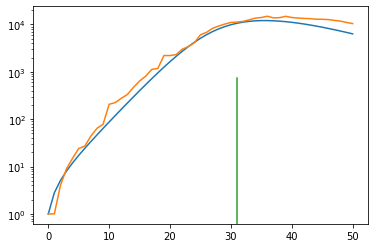

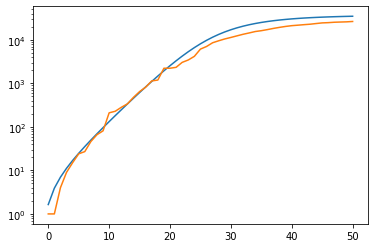

total error: 0.02630230225622654


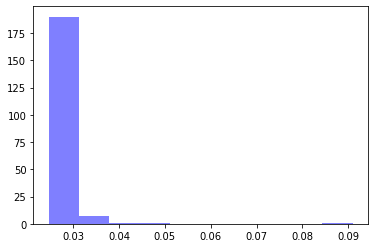

alpha: 0.5027206 , beta: 0.42451996 , initial_unconfirmed 27.057333 , t0s 0.0 , lambds 0.26249915


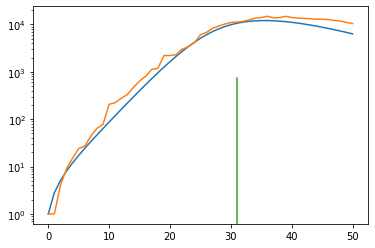

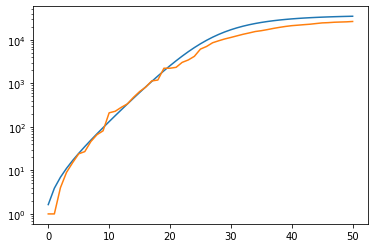

total error: 0.02516639046370983


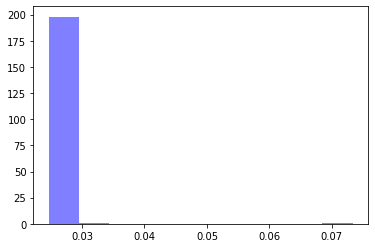

alpha: 0.5012293 , beta: 0.42454004 , initial_unconfirmed 27.131153 , t0s 0.0 , lambds 0.26250282


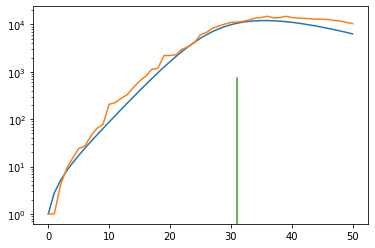

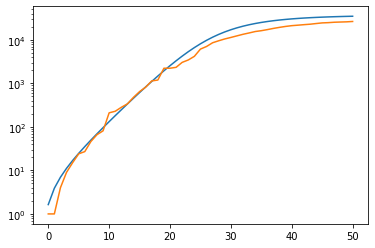

total error: 0.02495267614722252


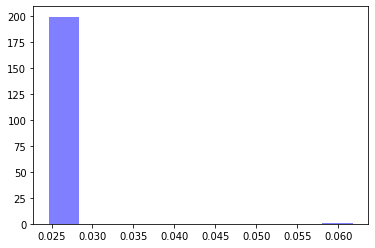

alpha: 0.50072885 , beta: 0.4245302 , initial_unconfirmed 27.161669 , t0s 0.0 , lambds 0.26249984


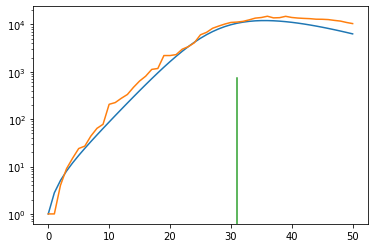

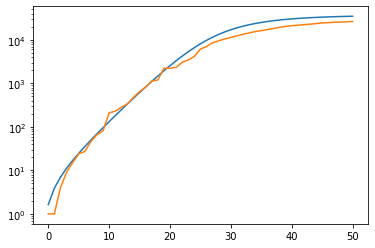

Angola
total error: 5.049517631530762


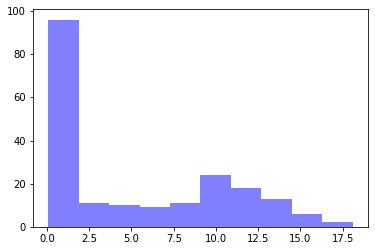

alpha: 0.8131485 , beta: 0.052851494 , initial_unconfirmed 14.78039 , t0s 0.77875996 , lambds 0.6265772


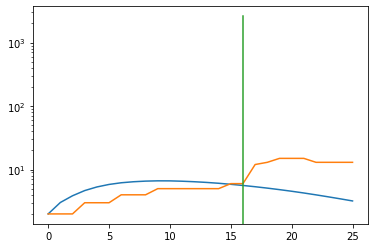

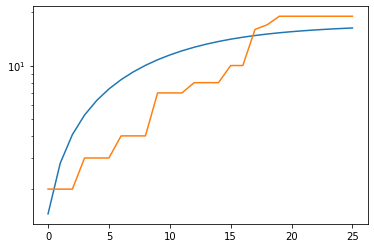

total error: 0.0565655343234539


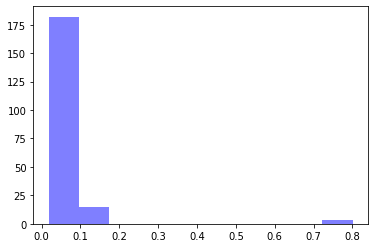

alpha: 0.5033614 , beta: 0.16863471 , initial_unconfirmed 8.870008 , t0s 1.8243504 , lambds 0.00093199825


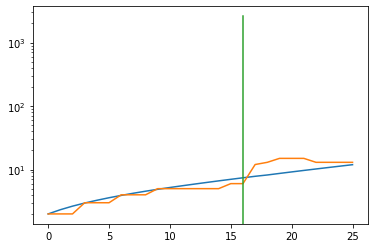

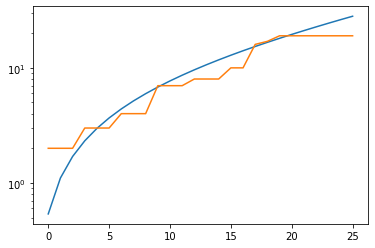

total error: 0.048135533928871155


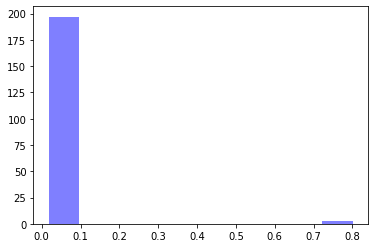

alpha: 0.99979246 , beta: 0.17440207 , initial_unconfirmed 4.231857 , t0s 15.635735 , lambds 0.98837334


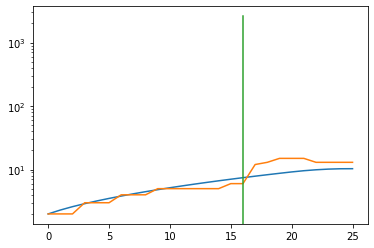

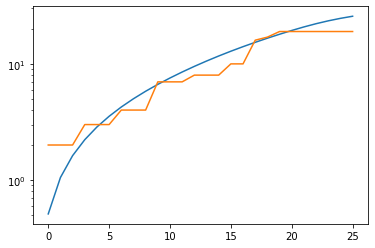

total error: 0.04243693873286247


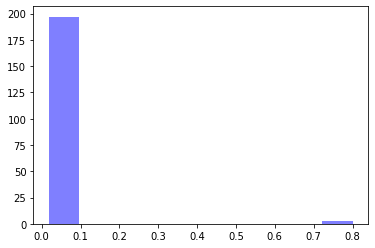

alpha: 0.99979246 , beta: 0.17440207 , initial_unconfirmed 4.231857 , t0s 15.635735 , lambds 0.98837334


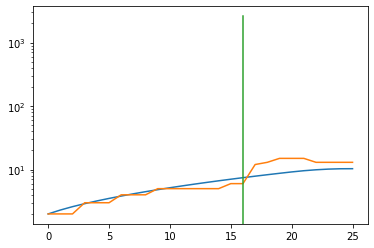

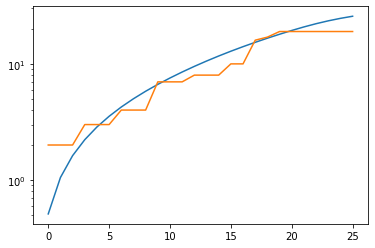

total error: 0.03863047808408737


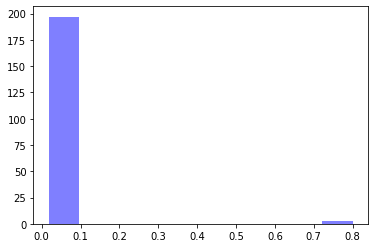

alpha: 0.99979246 , beta: 0.17440207 , initial_unconfirmed 4.231857 , t0s 15.635735 , lambds 0.98837334


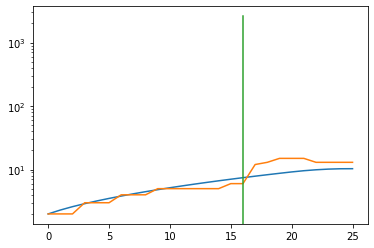

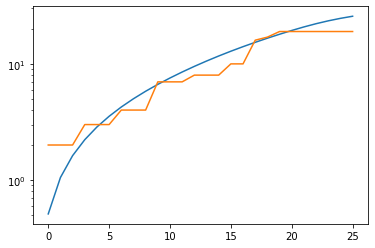

Bulgaria
total error: 3.4291839599609375


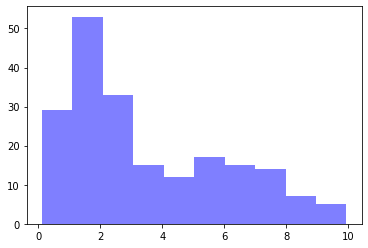

alpha: 0.7824875 , beta: 0.4517301 , initial_unconfirmed 23.52027 , t0s 0.3819589 , lambds 0.70361084


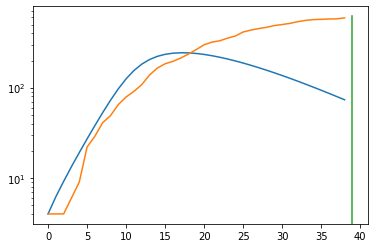

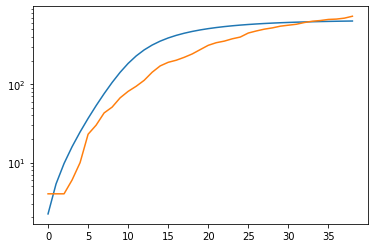

total error: 0.0668306052684784


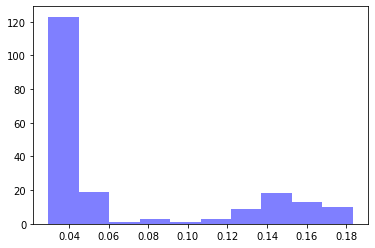

alpha: 0.5432305 , beta: 0.29300228 , initial_unconfirmed 35.26288 , t0s 0.0 , lambds 0.30345923


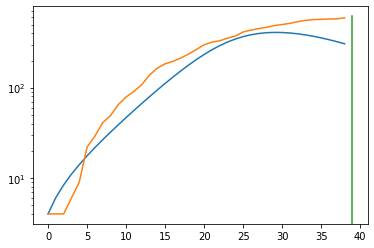

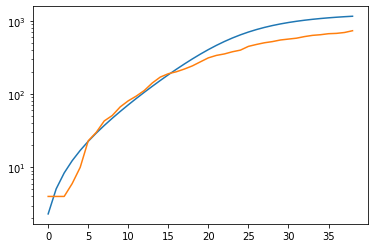

total error: 0.03222094103693962


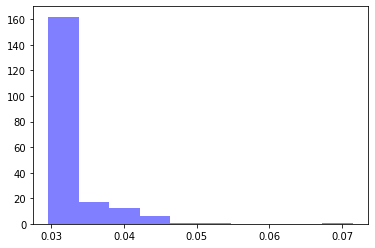

alpha: 0.5075336 , beta: 0.29292378 , initial_unconfirmed 37.772243 , t0s 0.0 , lambds 0.303382


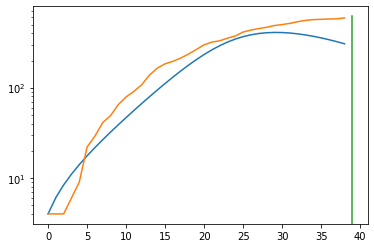

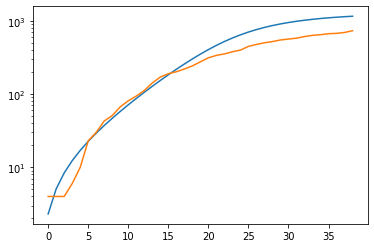

total error: 0.03027852065861225


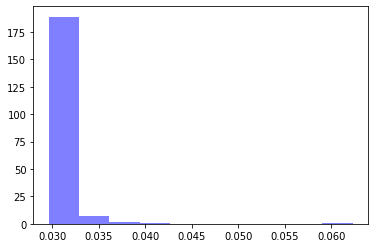

alpha: 0.5075336 , beta: 0.29292378 , initial_unconfirmed 37.772243 , t0s 0.0 , lambds 0.303382


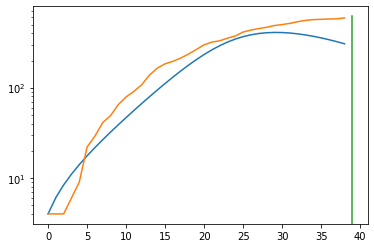

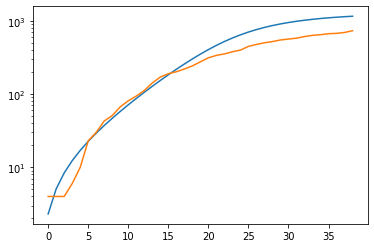

total error: 0.029908927157521248


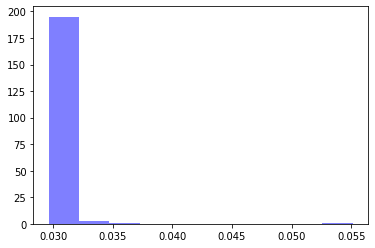

alpha: 0.5075336 , beta: 0.29292378 , initial_unconfirmed 37.772243 , t0s 0.0 , lambds 0.303382


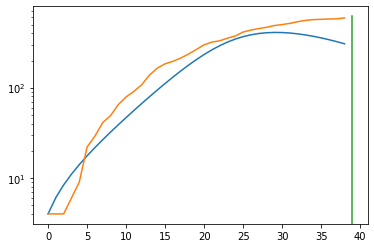

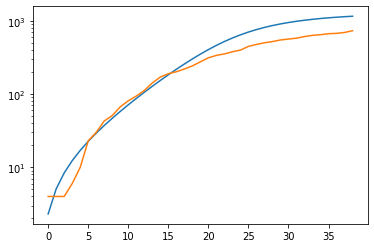

New Zealand
total error: 5.111988544464111


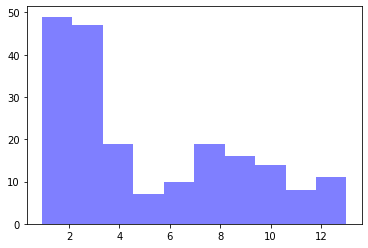

alpha: 0.9987682 , beta: 0.4062175 , initial_unconfirmed 12.011525 , t0s 0.6460219 , lambds 0.6606155


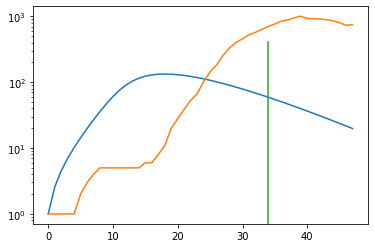

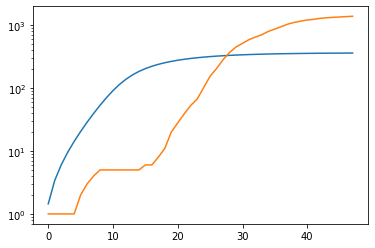

total error: 0.321968674659729


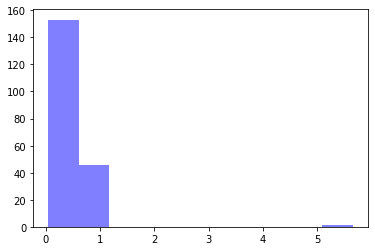

alpha: 0.50435096 , beta: 0.33555824 , initial_unconfirmed 2.1953588 , t0s 4.54096 , lambds 0.21654776


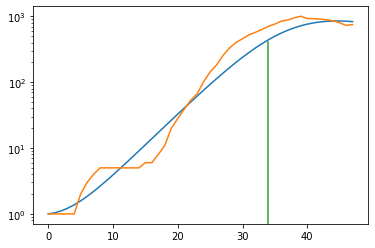

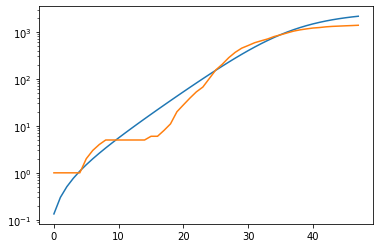

total error: 0.07965618371963501


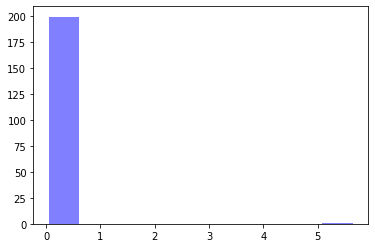

alpha: 0.97735566 , beta: 0.32799587 , initial_unconfirmed 1.1835254 , t0s 23.774593 , lambds 0.6328589


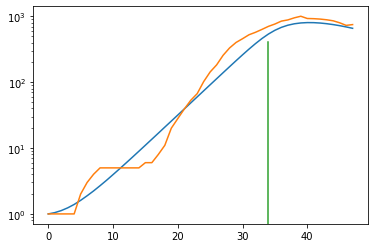

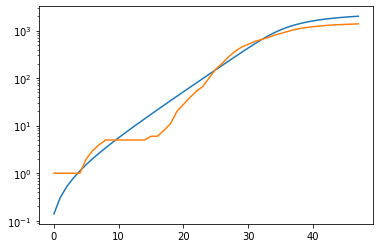

total error: 0.07798168063163757


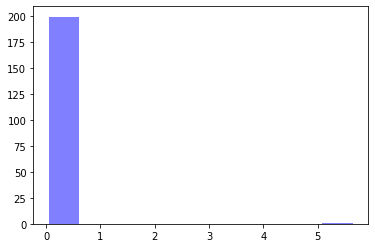

alpha: 0.9971583 , beta: 0.3273431 , initial_unconfirmed 1.1670494 , t0s 26.243475 , lambds 0.8312348


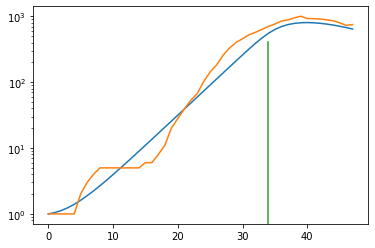

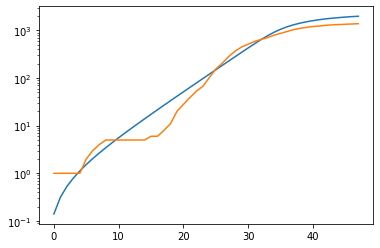

total error: 0.07767732441425323


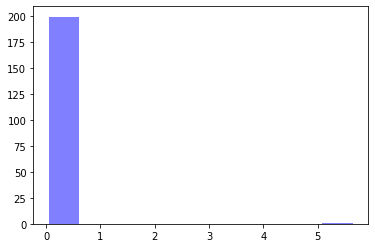

alpha: 0.9971701 , beta: 0.32724148 , initial_unconfirmed 1.1680673 , t0s 26.800653 , lambds 0.8946763


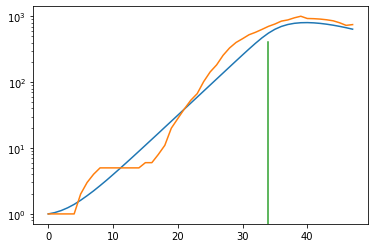

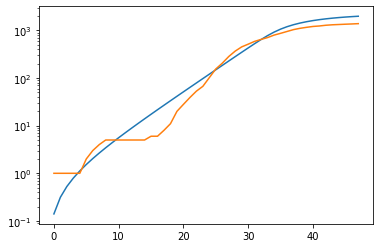

Congo Republic
total error: 4.9149627685546875


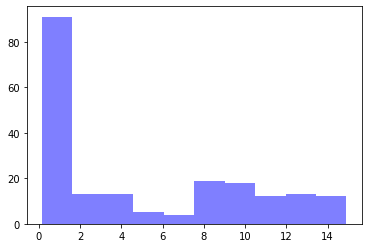

alpha: 0.97654223 , beta: 0.5962997 , initial_unconfirmed 0.75139403 , t0s 0.44415718 , lambds 0.7009105


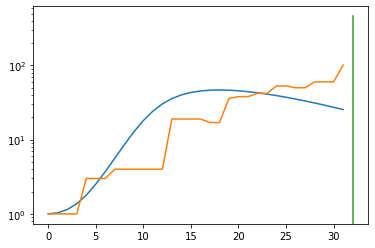

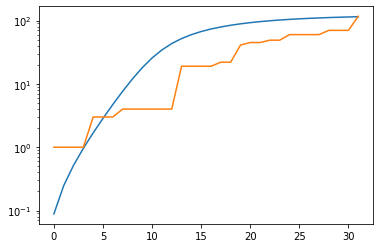

total error: 0.1447533518075943


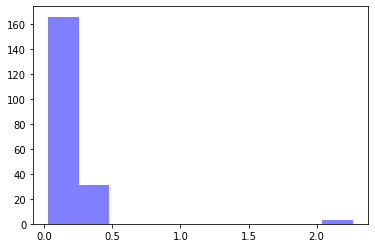

alpha: 0.585115 , beta: 0.2732635 , initial_unconfirmed 4.0735188 , t0s 3.019471 , lambds 0.30018348


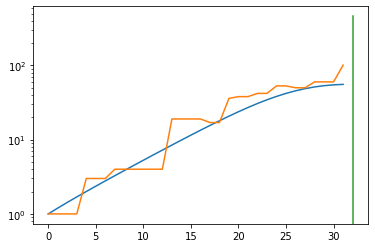

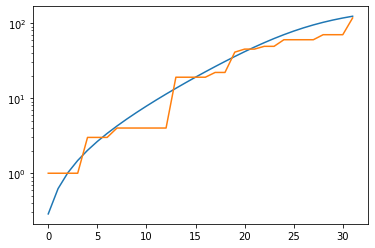

total error: 0.09411175549030304


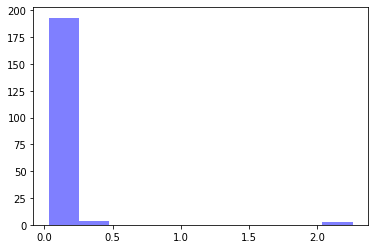

alpha: 0.5052846 , beta: 0.27076963 , initial_unconfirmed 4.758071 , t0s 8.245027 , lambds 0.4054504


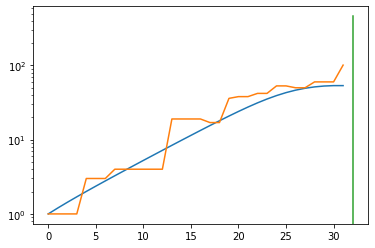

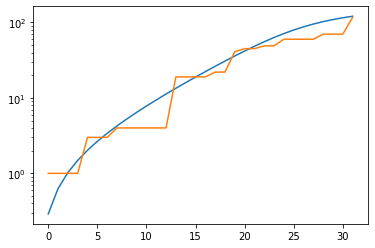

total error: 0.0660940408706665


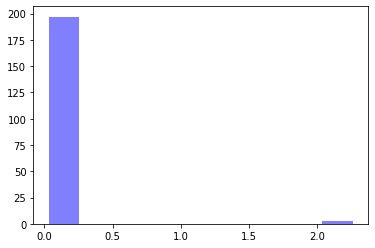

alpha: 0.98575425 , beta: 0.27064812 , initial_unconfirmed 2.4402864 , t0s 8.526366 , lambds 0.41332656


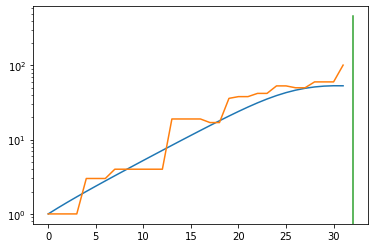

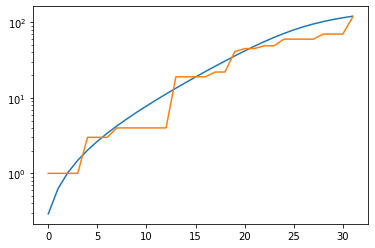

total error: 0.06392675638198853


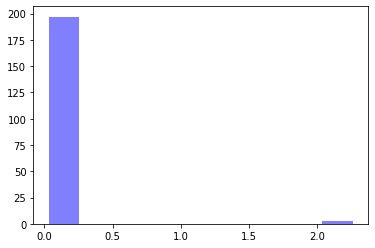

alpha: 0.99817324 , beta: 0.27066636 , initial_unconfirmed 2.409885 , t0s 8.498818 , lambds 0.41261208


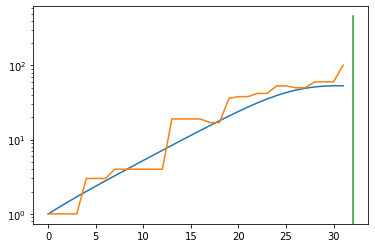

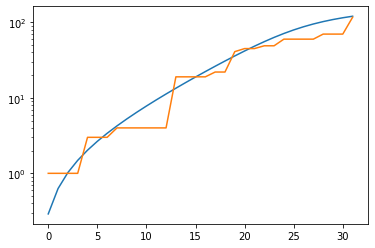

Curacao
Botswana
total error: 3.679701805114746


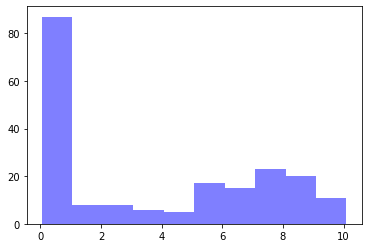

alpha: 0.9999399 , beta: 0.082701035 , initial_unconfirmed 13.651741 , t0s 0.37614805 , lambds 0.7238185


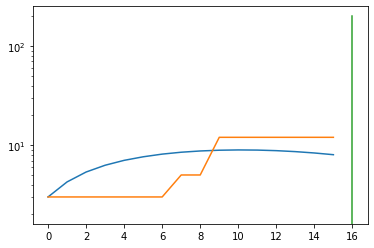

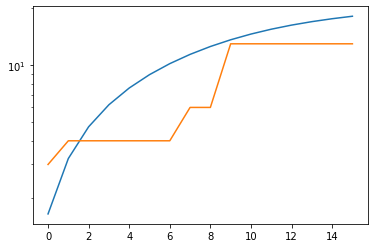

total error: 0.04425324499607086


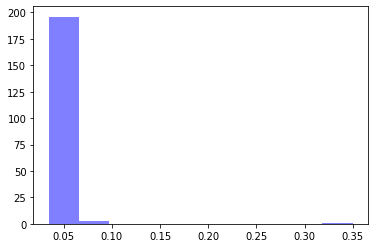

alpha: 0.99979854 , beta: 0.14662977 , initial_unconfirmed 7.567232 , t0s 2.0202355 , lambds 0.0022189894


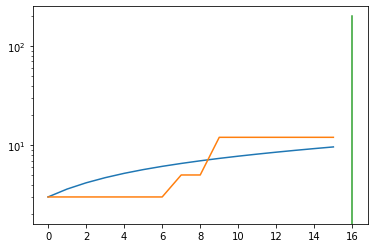

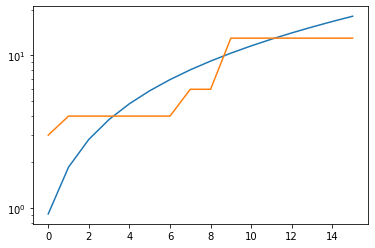

total error: 0.0404973141849041


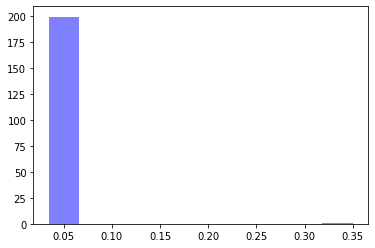

alpha: 0.99979854 , beta: 0.14662977 , initial_unconfirmed 7.567232 , t0s 2.0202355 , lambds 0.0022189894


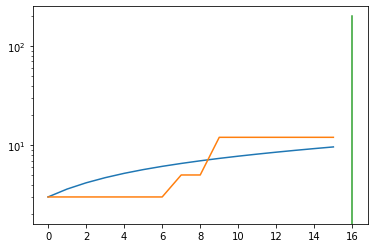

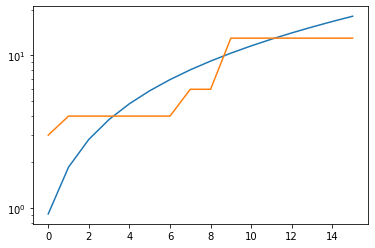

total error: 0.039080310612916946


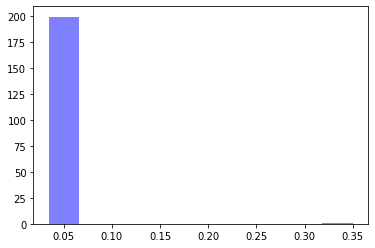

alpha: 0.99979854 , beta: 0.14662977 , initial_unconfirmed 7.567232 , t0s 2.0202355 , lambds 0.0022189894


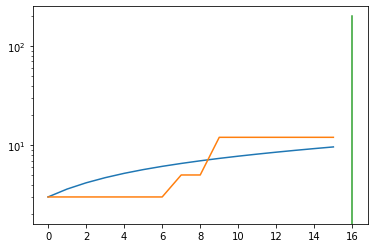

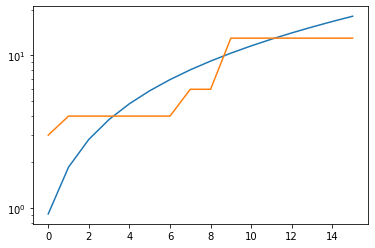

total error: 0.03812341392040253


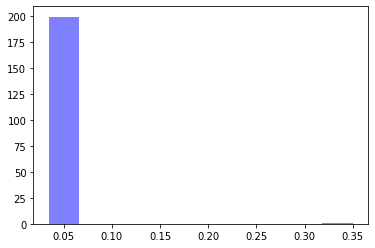

alpha: 0.99979854 , beta: 0.14662977 , initial_unconfirmed 7.567232 , t0s 2.0202355 , lambds 0.0022189894


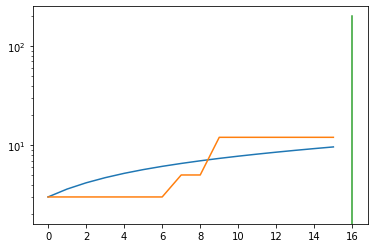

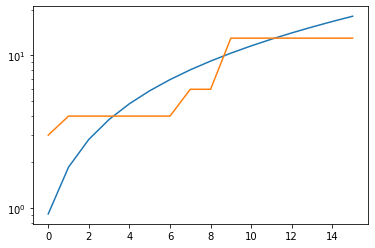

Niue
Iraq
total error: 3.9785070419311523


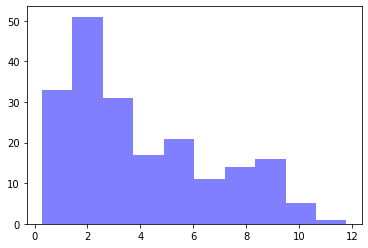

alpha: 0.99514306 , beta: 0.49743137 , initial_unconfirmed 4.99033 , t0s 0.39154482 , lambds 0.55170804


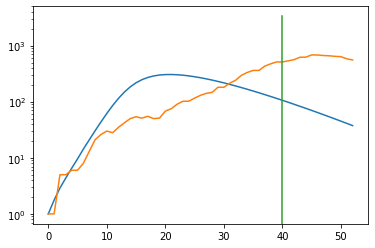

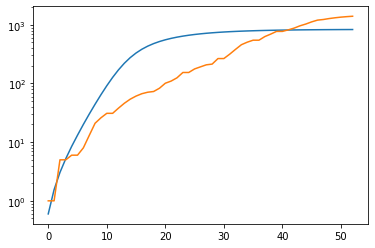

total error: 0.11279663443565369


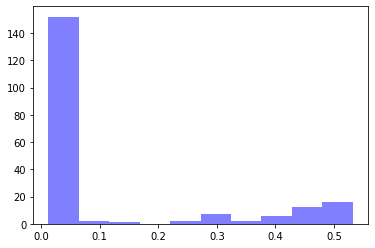

alpha: 0.5308943 , beta: 0.23878515 , initial_unconfirmed 19.559454 , t0s 0.0 , lambds 0.15893918


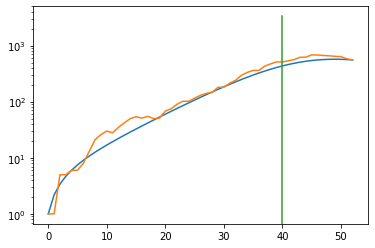

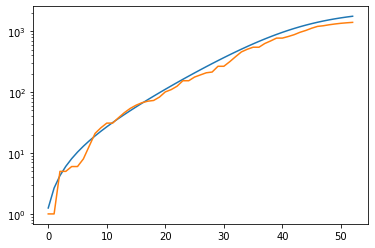

total error: 0.012984019704163074


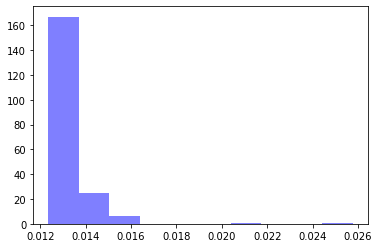

alpha: 0.5042544 , beta: 0.23878096 , initial_unconfirmed 20.594564 , t0s 0.0 , lambds 0.15893835


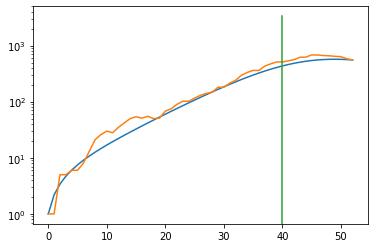

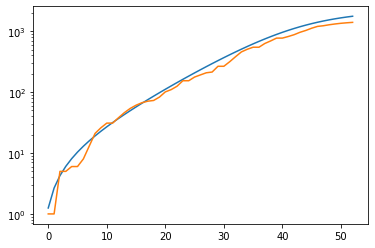

total error: 0.01244180928915739


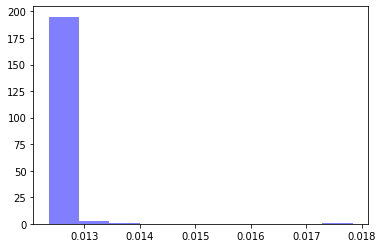

alpha: 0.5042544 , beta: 0.23878096 , initial_unconfirmed 20.594564 , t0s 0.0 , lambds 0.15893835


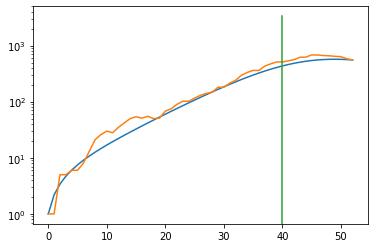

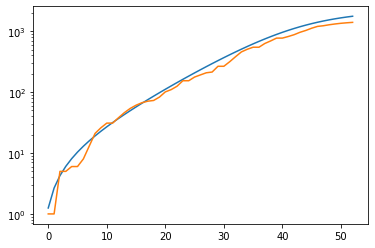

total error: 0.01238865777850151


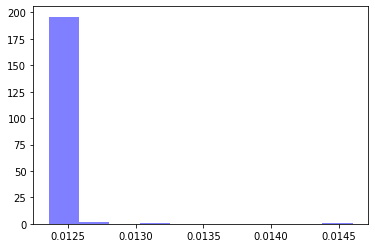

alpha: 0.5042544 , beta: 0.23878096 , initial_unconfirmed 20.594564 , t0s 0.0 , lambds 0.15893835


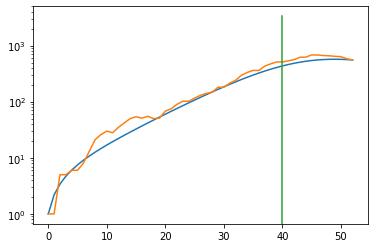

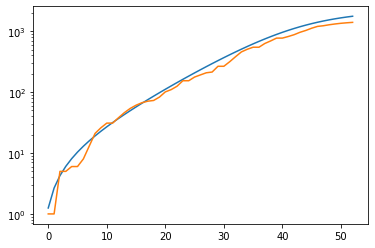

Reunion
total error: 3.6518185138702393


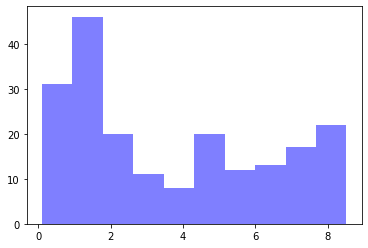

alpha: 0.9999565 , beta: 0.41372538 , initial_unconfirmed 8.472577 , t0s 0.61568874 , lambds 0.5288586


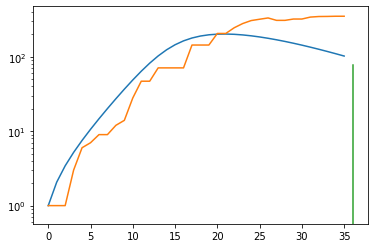

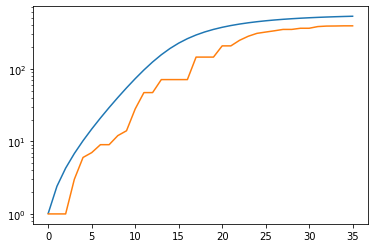

total error: 0.12889359891414642


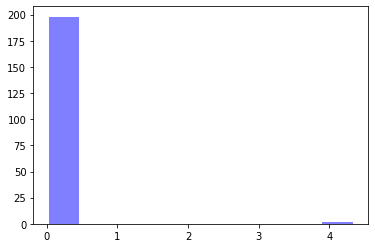

alpha: 0.5127511 , beta: 0.3618138 , initial_unconfirmed 9.049391 , t0s 0.0 , lambds 0.33583146


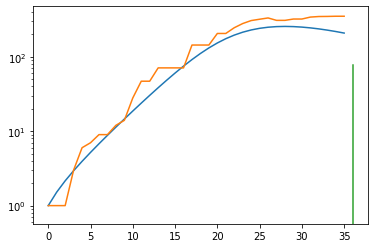

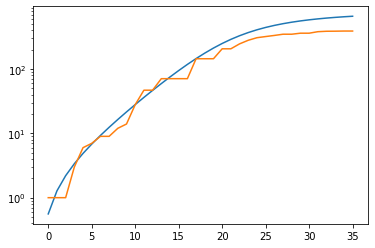

total error: 0.06761649996042252


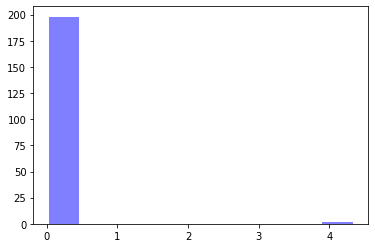

alpha: 0.5005569 , beta: 0.36178946 , initial_unconfirmed 9.272018 , t0s 0.0 , lambds 0.3358103


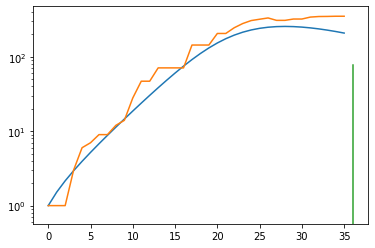

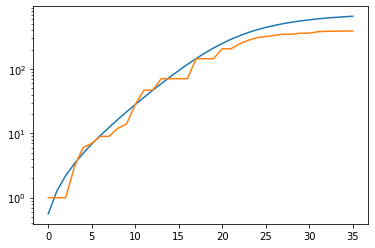

total error: 0.06706830859184265


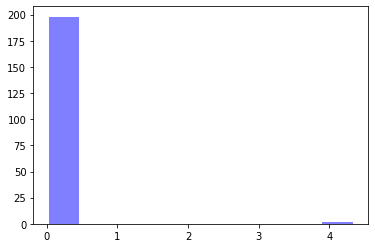

alpha: 0.5005569 , beta: 0.36178946 , initial_unconfirmed 9.272018 , t0s 0.0 , lambds 0.3358103


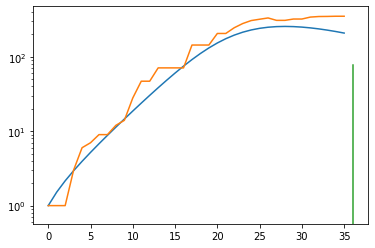

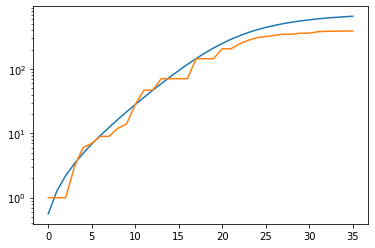

total error: 0.06700219959020615


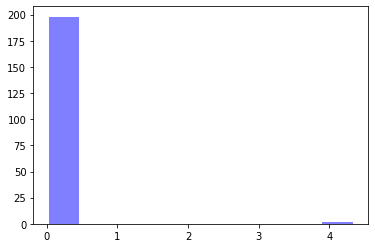

alpha: 0.5005569 , beta: 0.36178946 , initial_unconfirmed 9.272018 , t0s 0.0 , lambds 0.3358103


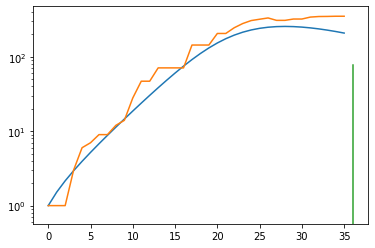

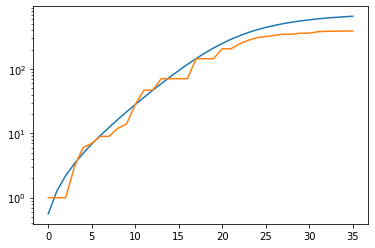

Guyana
total error: 4.78379487991333


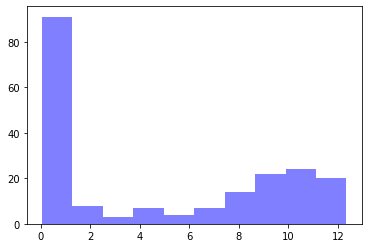

alpha: 0.9384308 , beta: 0.18859859 , initial_unconfirmed 14.294561 , t0s 0.50703406 , lambds 0.5250083


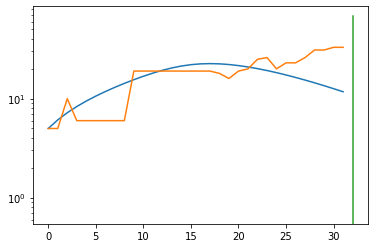

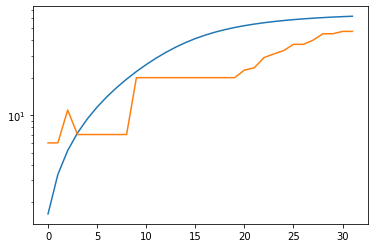

total error: 0.06263486295938492


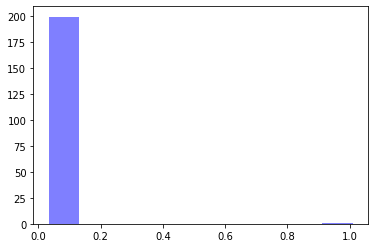

alpha: 0.8555163 , beta: 0.14454411 , initial_unconfirmed 13.419897 , t0s 4.1610274 , lambds 0.0032665115


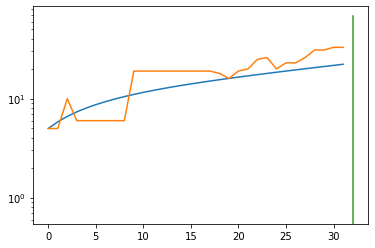

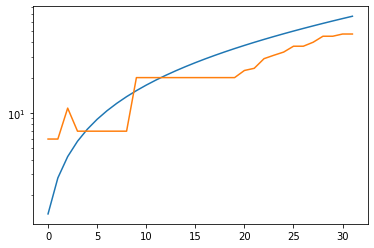

total error: 0.058468885719776154


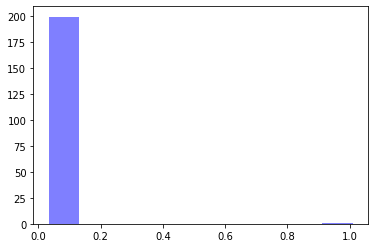

alpha: 0.9906922 , beta: 0.14458683 , initial_unconfirmed 11.5808935 , t0s 3.760521 , lambds 0.0006421039


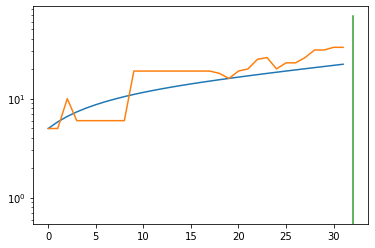

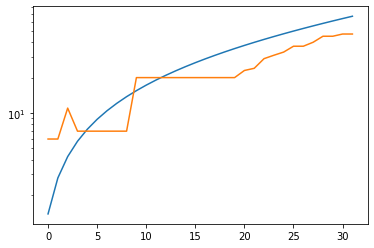

total error: 0.05343668535351753


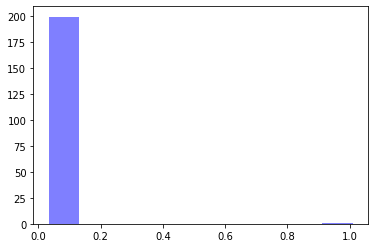

alpha: 0.9906944 , beta: 0.14458692 , initial_unconfirmed 11.580809 , t0s 3.7612007 , lambds 0.0003765327


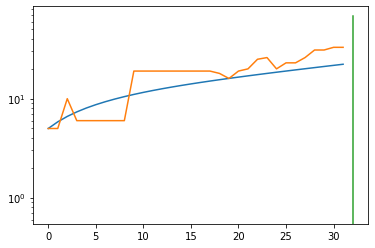

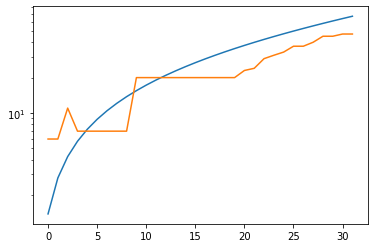

total error: 0.04815850406885147


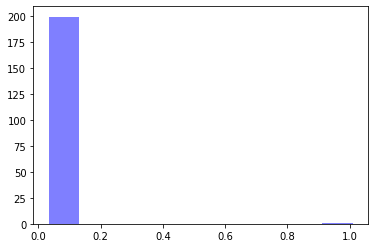

alpha: 0.99069726 , beta: 0.14458694 , initial_unconfirmed 11.580769 , t0s 3.7614357 , lambds 0.00026925752


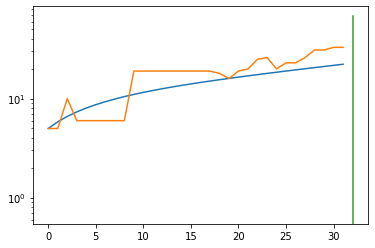

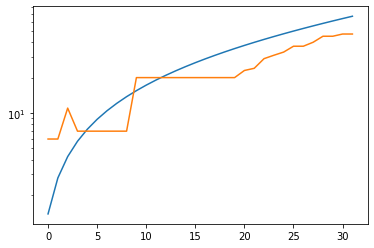

Fiji
total error: 6.151497840881348


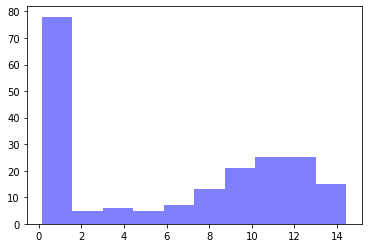

alpha: 0.8709448 , beta: 0.046535585 , initial_unconfirmed 10.3286085 , t0s 0.68977153 , lambds 0.53730255


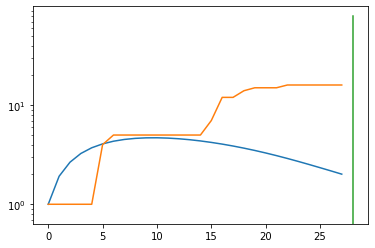

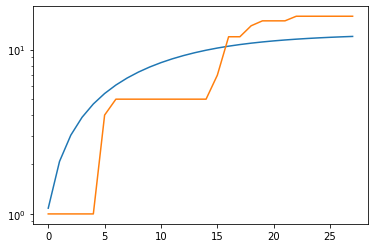

total error: 0.12226898223161697


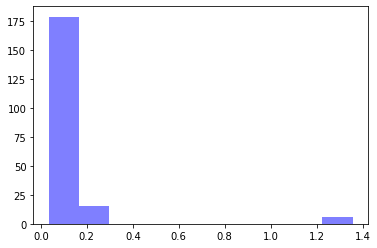

alpha: 0.50858665 , beta: 0.20218833 , initial_unconfirmed 5.7423577 , t0s 11.25023 , lambds 0.6196004


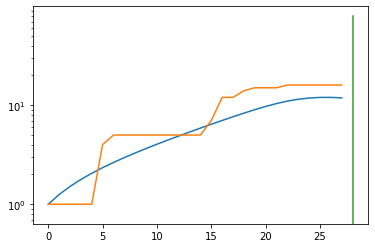

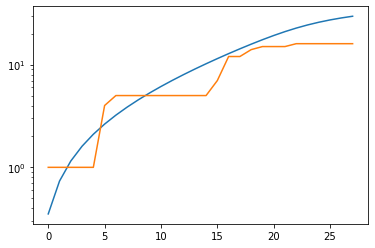

total error: 0.09881344437599182


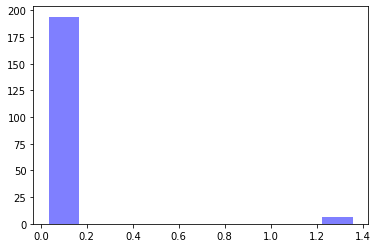

alpha: 0.5085971 , beta: 0.20149834 , initial_unconfirmed 5.757689 , t0s 14.851452 , lambds 0.97074234


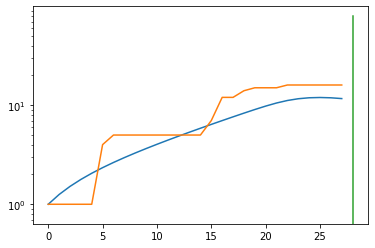

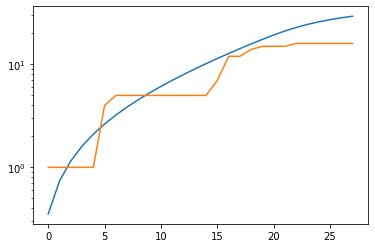

total error: 0.08886952698230743


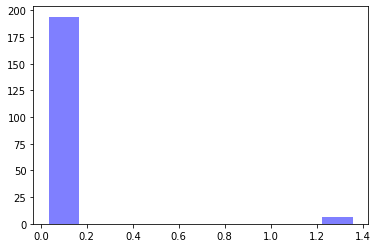

alpha: 0.5085955 , beta: 0.20152783 , initial_unconfirmed 5.757381 , t0s 14.956658 , lambds 0.9870608


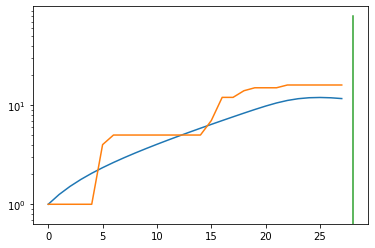

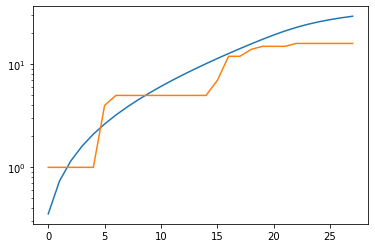

total error: 0.08343619108200073


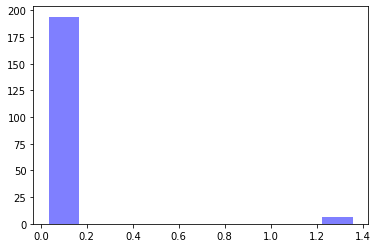

alpha: 0.5085928 , beta: 0.2014995 , initial_unconfirmed 5.757755 , t0s 14.987966 , lambds 0.99213576


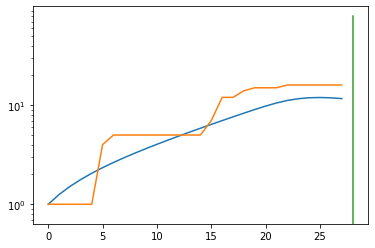

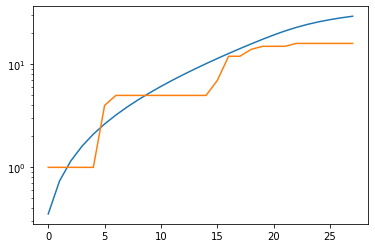

Czech Republic
total error: 3.5726494789123535


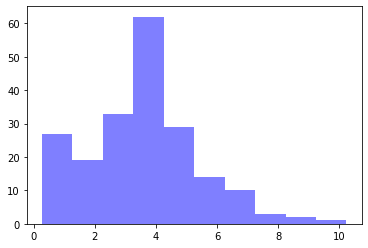

alpha: 0.99978006 , beta: 0.43654114 , initial_unconfirmed 48.446655 , t0s 0.67838824 , lambds 0.5177181


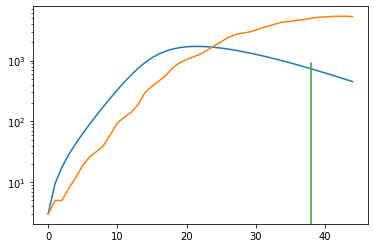

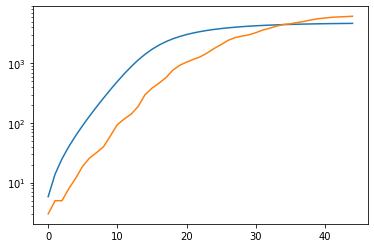

total error: 0.029289472848176956


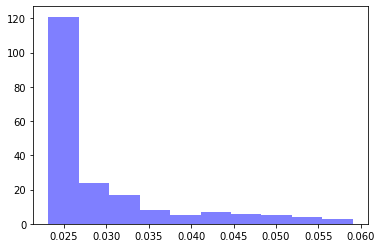

alpha: 0.5117614 , beta: 0.36102456 , initial_unconfirmed 32.016563 , t0s 0.0 , lambds 0.25577784


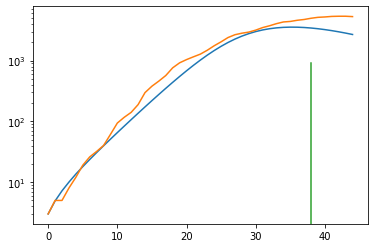

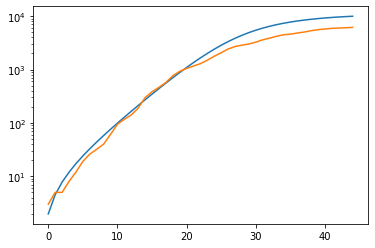

total error: 0.023921819403767586


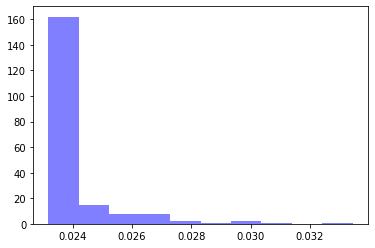

alpha: 0.5020964 , beta: 0.36128396 , initial_unconfirmed 32.518196 , t0s 0.0 , lambds 0.2559274


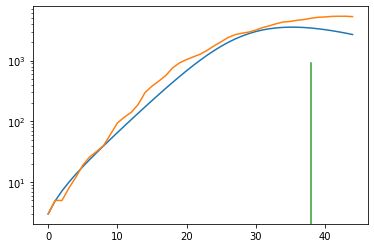

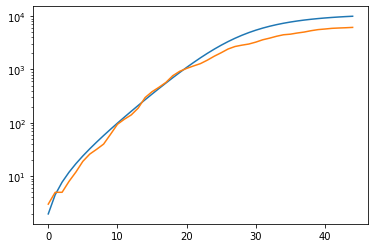

total error: 0.023398835211992264


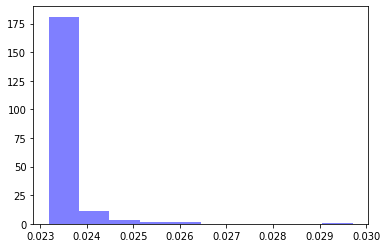

alpha: 0.5020964 , beta: 0.36128396 , initial_unconfirmed 32.518196 , t0s 0.0 , lambds 0.2559274


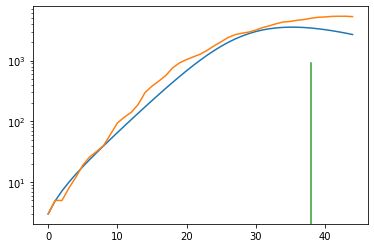

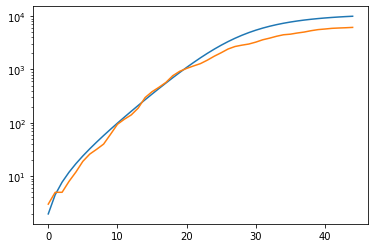

total error: 0.02326711267232895


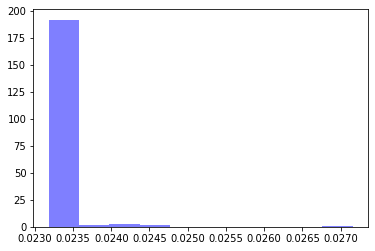

alpha: 0.5020964 , beta: 0.36128396 , initial_unconfirmed 32.518196 , t0s 0.0 , lambds 0.2559274


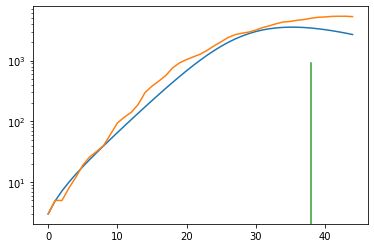

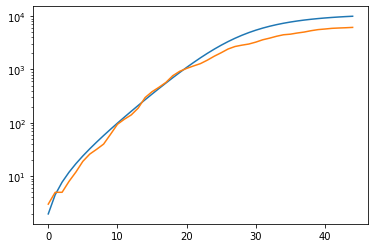

Guinea
total error: 5.154732704162598


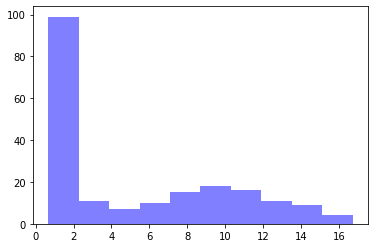

alpha: 0.9658482 , beta: 0.16479632 , initial_unconfirmed 10.376149 , t0s 0.59316325 , lambds 0.5954612


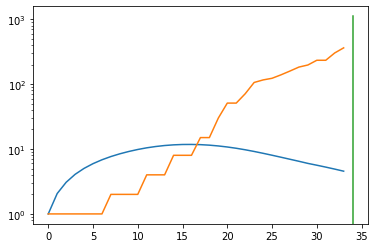

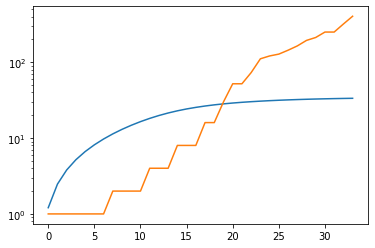

total error: 0.2070036381483078


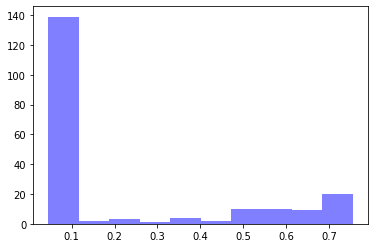

alpha: 0.99857426 , beta: 0.33360478 , initial_unconfirmed 0.9099825 , t0s 2.478272 , lambds 0.1935478


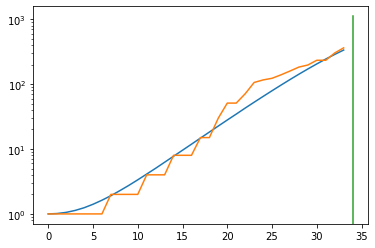

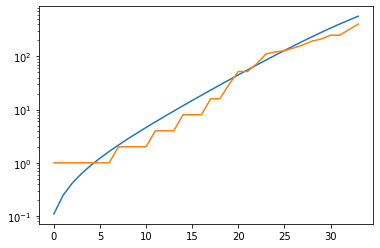

total error: 0.05858829617500305


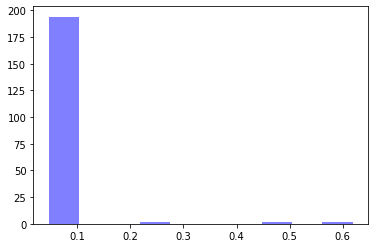

alpha: 0.99992657 , beta: 0.33378616 , initial_unconfirmed 0.9059958 , t0s 3.66507 , lambds 0.20596594


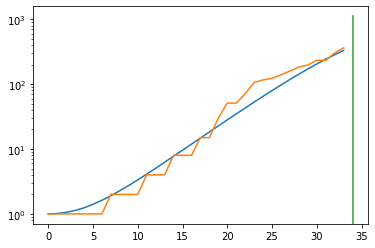

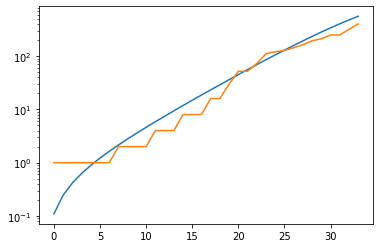

total error: 0.046235717833042145


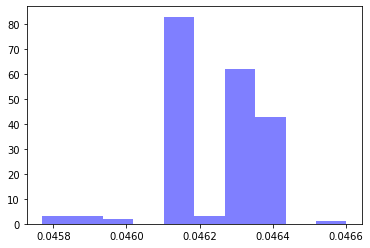

alpha: 0.514951 , beta: 0.33404616 , initial_unconfirmed 1.7522963 , t0s 5.515835 , lambds 0.22774608


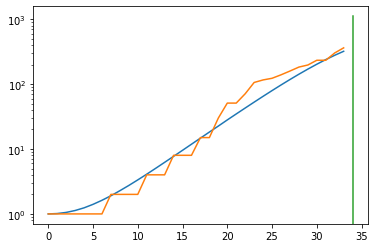

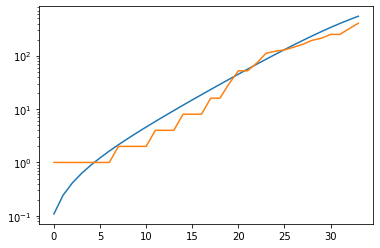

total error: 0.046224445104599


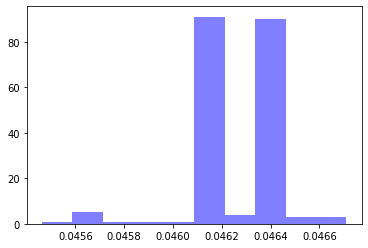

alpha: 0.5159622 , beta: 0.33417276 , initial_unconfirmed 1.7388371 , t0s 9.312719 , lambds 0.28417444


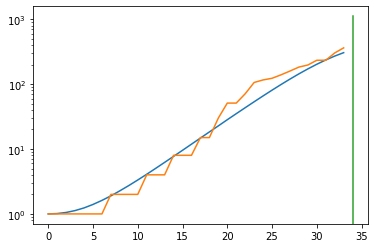

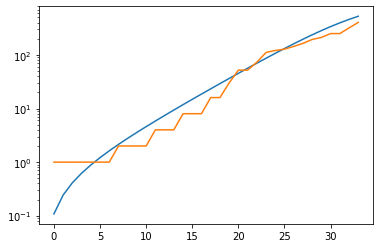

Uganda
total error: 3.6863062381744385


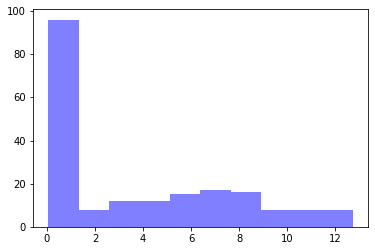

alpha: 0.9871025 , beta: 0.1527032 , initial_unconfirmed 31.161812 , t0s 0.20910692 , lambds 0.52897996


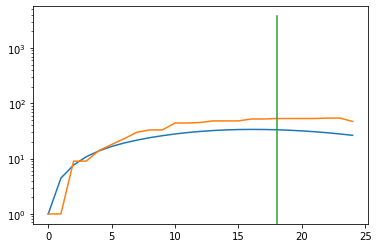

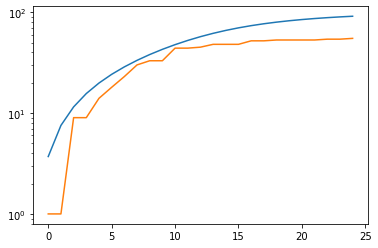

total error: 0.037824828177690506


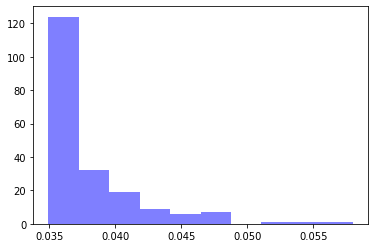

alpha: 0.8052975 , beta: 0.42609313 , initial_unconfirmed 11.900386 , t0s 0.0 , lambds 0.9731616


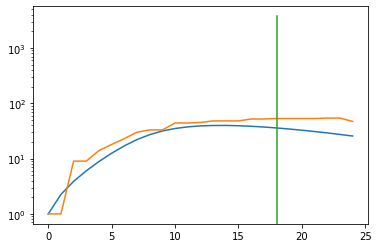

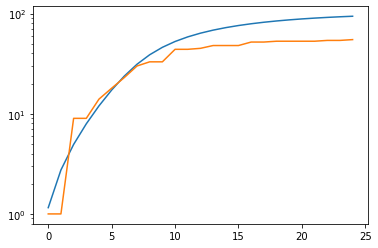

total error: 0.03586571291089058


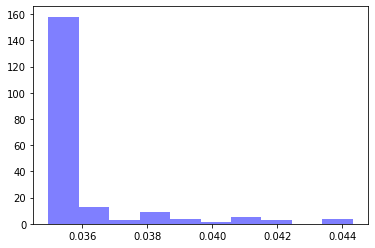

alpha: 0.8052975 , beta: 0.42609313 , initial_unconfirmed 11.900386 , t0s 0.0 , lambds 0.9731616


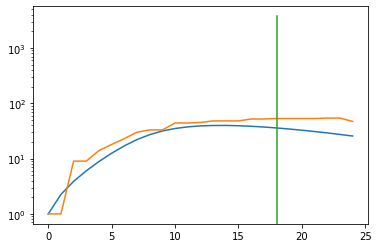

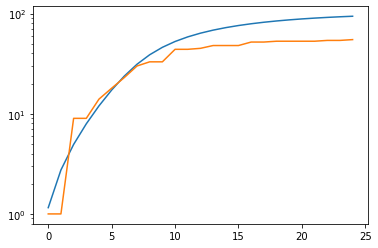

total error: 0.0352562852203846


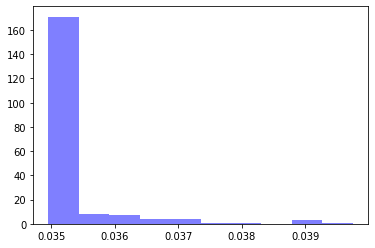

alpha: 0.8052975 , beta: 0.42609313 , initial_unconfirmed 11.900386 , t0s 0.0 , lambds 0.9731616


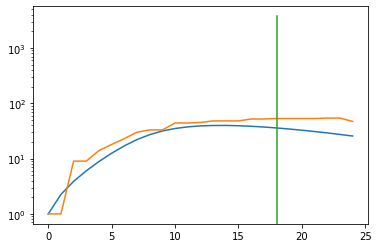

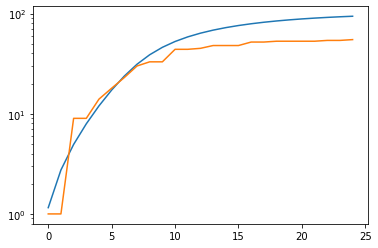

total error: 0.035025037825107574


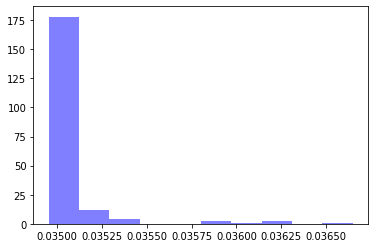

alpha: 0.8052975 , beta: 0.42609313 , initial_unconfirmed 11.900386 , t0s 0.0 , lambds 0.9731616


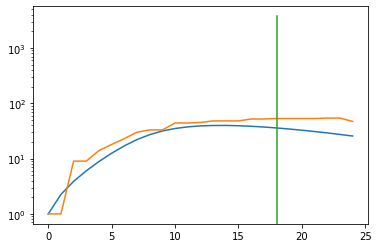

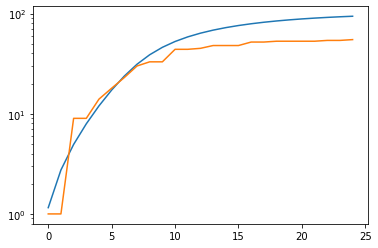

Grenada
total error: 3.221386671066284


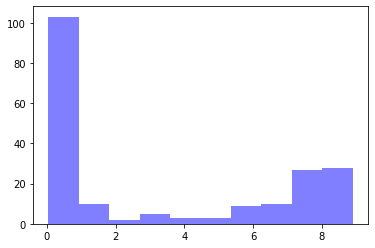

alpha: 0.7870795 , beta: 0.28098372 , initial_unconfirmed 5.120343 , t0s 0.48056847 , lambds 0.6644556


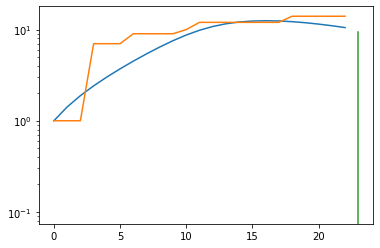

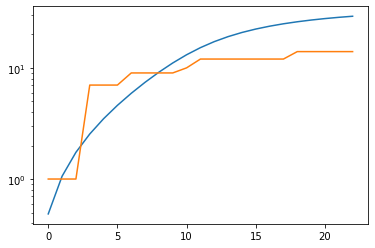

total error: 0.043364111334085464


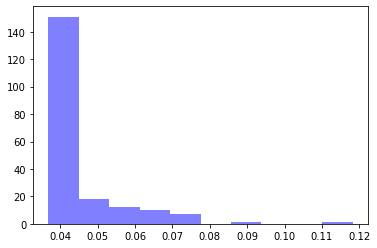

alpha: 0.51110715 , beta: 0.18167184 , initial_unconfirmed 13.539712 , t0s 0.0 , lambds 0.5358786


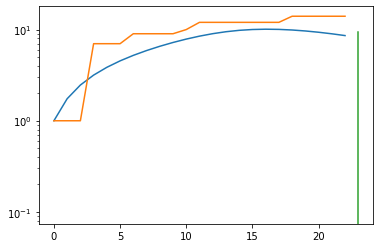

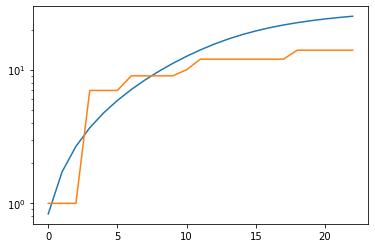

total error: 0.03910386189818382


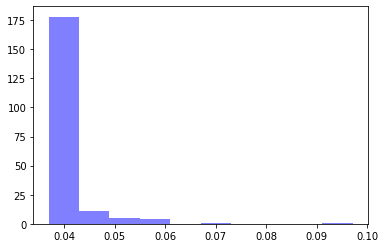

alpha: 0.5038451 , beta: 0.18165445 , initial_unconfirmed 13.735427 , t0s 0.0 , lambds 0.53587383


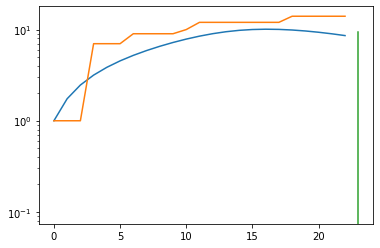

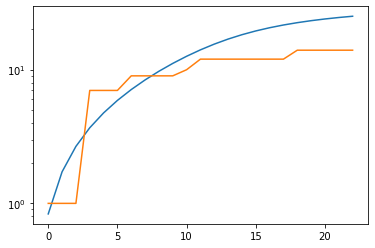

total error: 0.037540800869464874


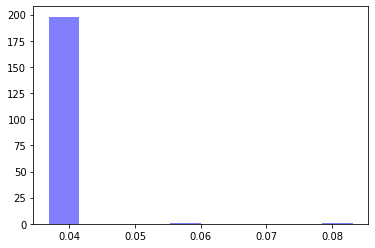

alpha: 0.5038451 , beta: 0.18165445 , initial_unconfirmed 13.735427 , t0s 0.0 , lambds 0.53587383


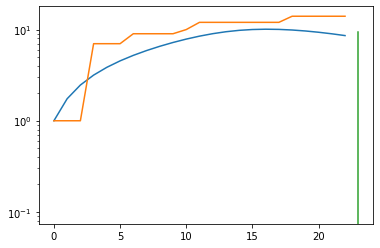

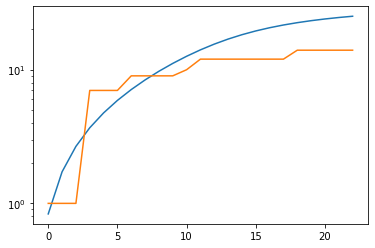

total error: 0.03735508769750595


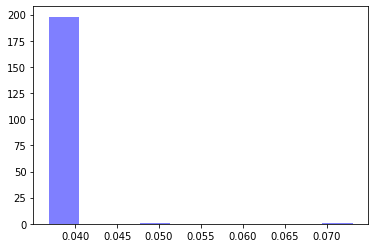

alpha: 0.50242424 , beta: 0.181666 , initial_unconfirmed 13.773961 , t0s 0.0 , lambds 0.53584504


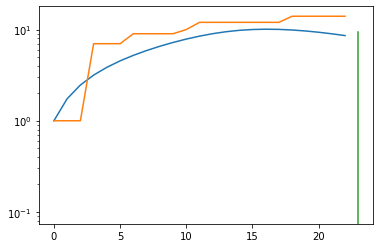

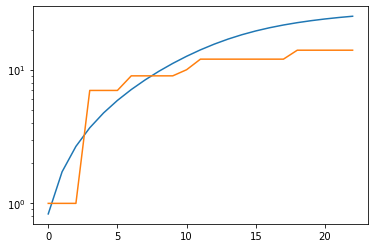

Haiti
total error: 4.950225830078125


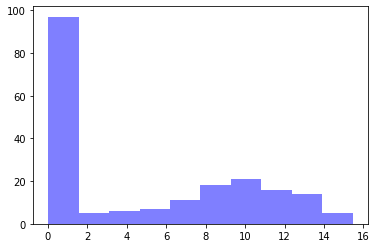

alpha: 0.9998951 , beta: 0.29658806 , initial_unconfirmed 4.793167 , t0s 0.63564104 , lambds 0.5892101


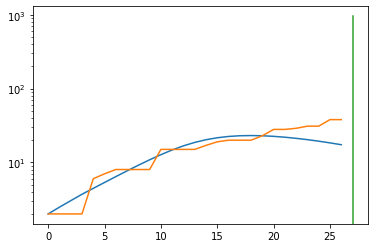

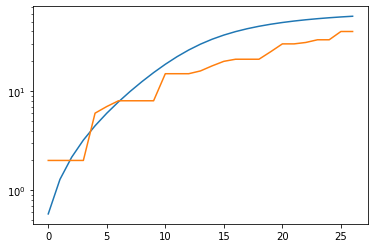

total error: 0.05962986871600151


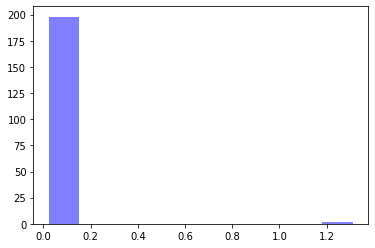

alpha: 0.9999578 , beta: 0.19202872 , initial_unconfirmed 6.9291444 , t0s 1.5054004 , lambds 0.23889591


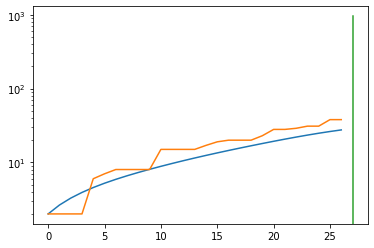

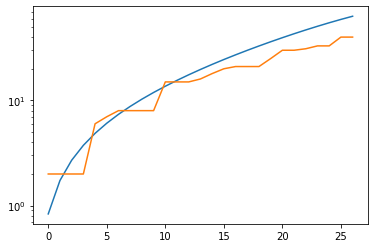

total error: 0.05204658582806587


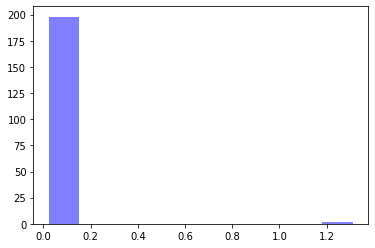

alpha: 0.5024877 , beta: 0.19231704 , initial_unconfirmed 13.780035 , t0s 0.0 , lambds 0.22230047


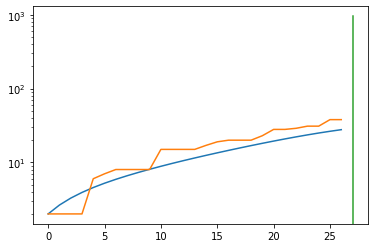

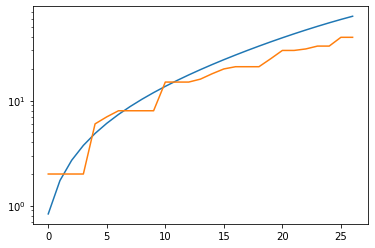

total error: 0.04635978862643242


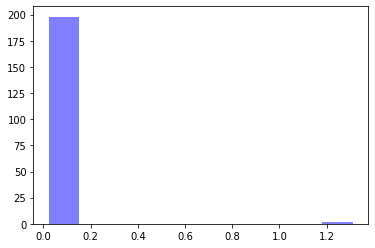

alpha: 0.5024877 , beta: 0.19231704 , initial_unconfirmed 13.780035 , t0s 0.0 , lambds 0.22230047


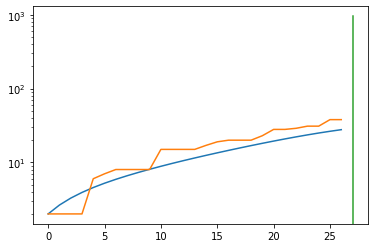

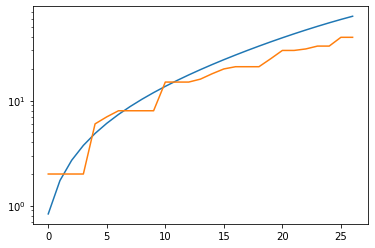

total error: 0.042745187878608704


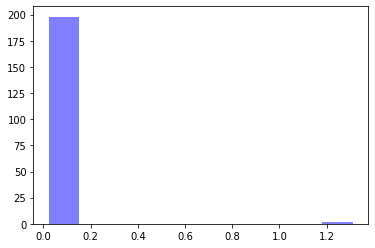

alpha: 0.5024877 , beta: 0.19231704 , initial_unconfirmed 13.780035 , t0s 0.0 , lambds 0.22230047


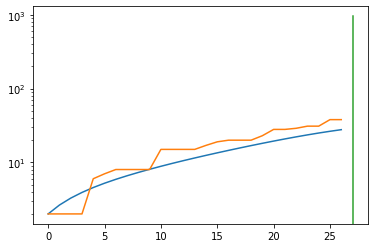

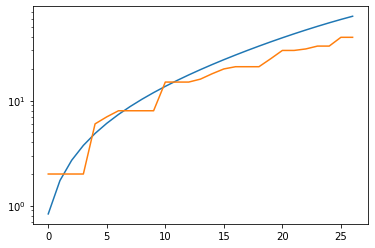

Sudan
total error: 6.764533519744873


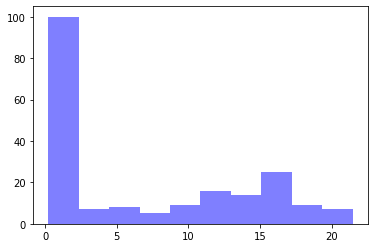

alpha: 0.9995992 , beta: 0.17088027 , initial_unconfirmed 1.952076 , t0s 0.5835593 , lambds 0.65101355


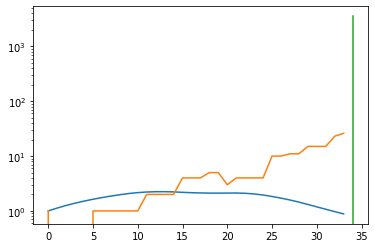

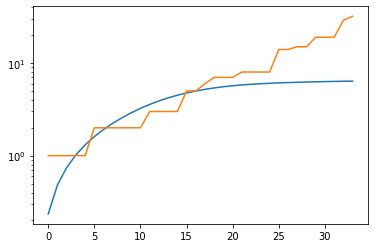

total error: 0.19378744065761566


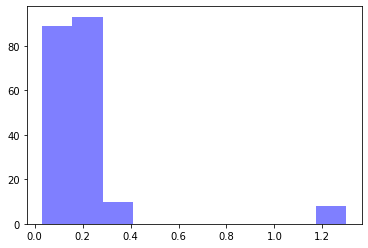

alpha: 0.5024361 , beta: 0.20091027 , initial_unconfirmed 2.7005508 , t0s 2.3527277 , lambds 0.00019201922


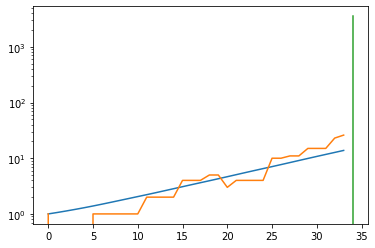

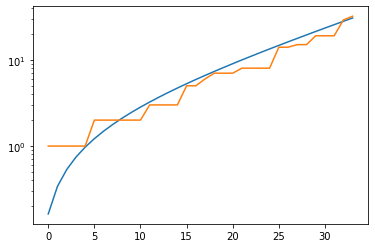

total error: 0.1391347050666809


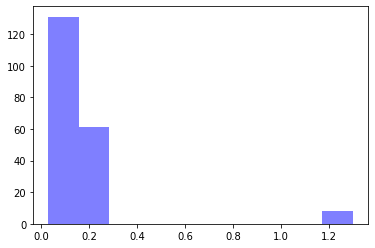

alpha: 0.5015263 , beta: 0.20093217 , initial_unconfirmed 2.7042205 , t0s 0.0 , lambds 0.00010397164


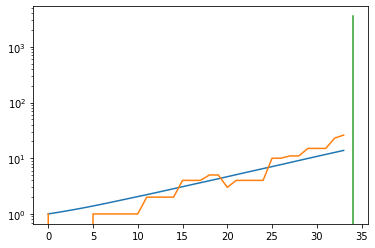

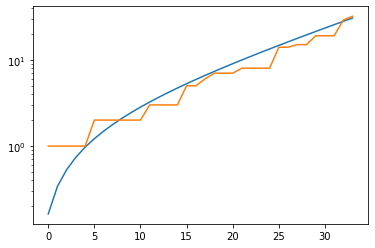

total error: 0.11676028370857239


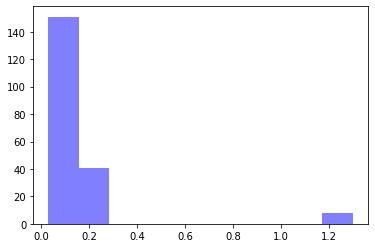

alpha: 0.50219417 , beta: 0.20093262 , initial_unconfirmed 2.7005422 , t0s 1.3596845 , lambds 7.4835734e-05


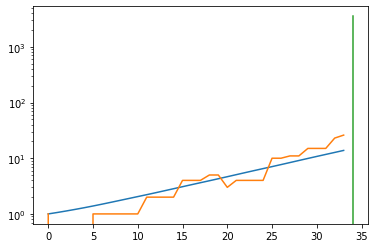

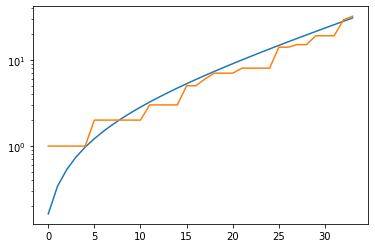

total error: 0.09815573692321777


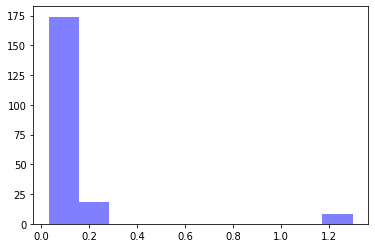

alpha: 0.50219417 , beta: 0.20093262 , initial_unconfirmed 2.7005422 , t0s 1.3596845 , lambds 7.4835734e-05


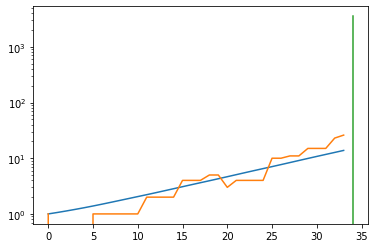

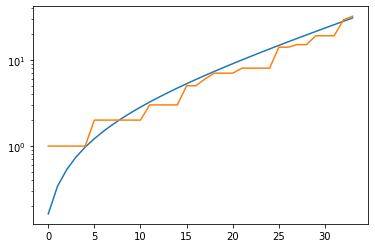

Peru
total error: 3.786641836166382


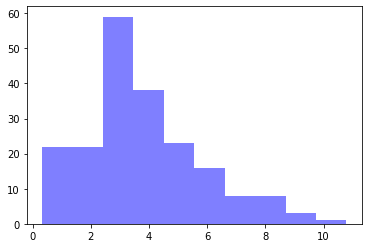

alpha: 0.9921024 , beta: 0.57135785 , initial_unconfirmed 7.738149 , t0s 0.77001196 , lambds 0.6682519


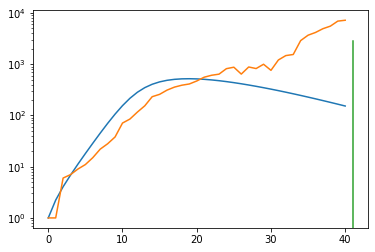

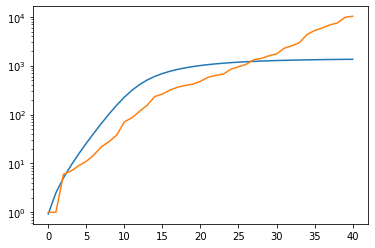

total error: 0.0809042751789093


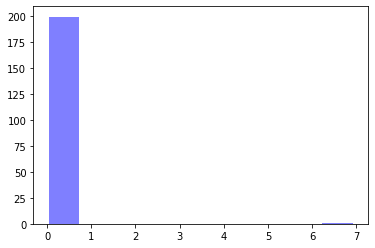

alpha: 0.53817123 , beta: 0.31433502 , initial_unconfirmed 27.119015 , t0s 0.0 , lambds 0.18811439


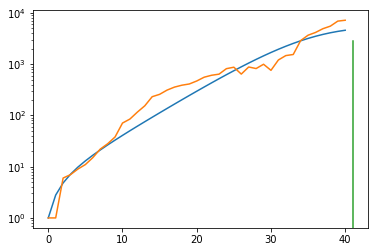

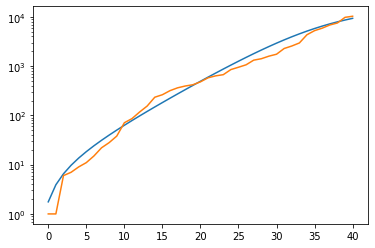

total error: 0.0693712905049324


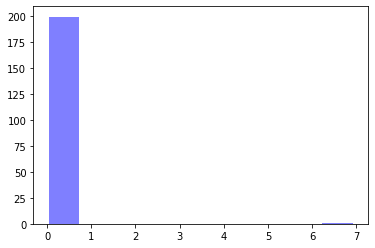

alpha: 0.5381371 , beta: 0.31434458 , initial_unconfirmed 27.116695 , t0s 0.0 , lambds 0.18812566


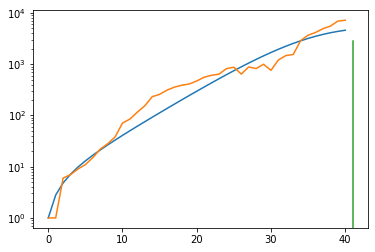

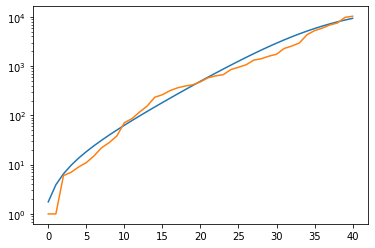

total error: 0.06886860728263855


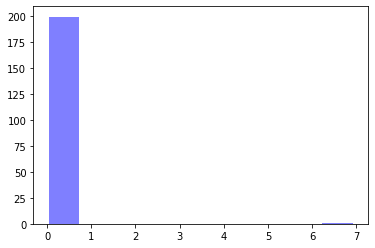

alpha: 0.5381371 , beta: 0.31434458 , initial_unconfirmed 27.116695 , t0s 0.0 , lambds 0.18812566


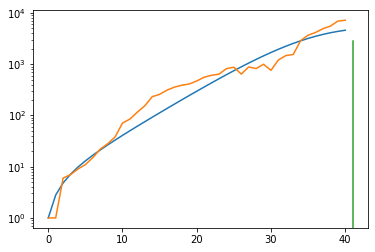

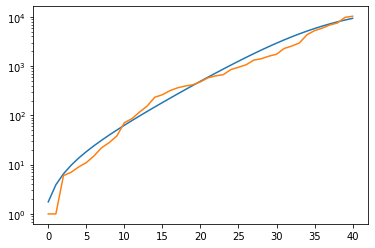

total error: 0.06876073032617569


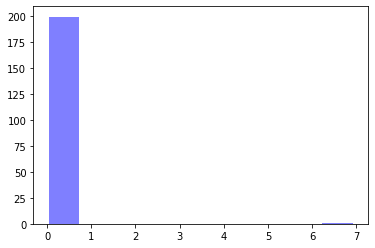

alpha: 0.5381371 , beta: 0.31434458 , initial_unconfirmed 27.116695 , t0s 0.0 , lambds 0.18812566


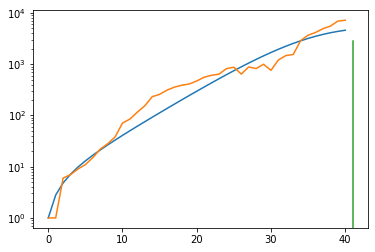

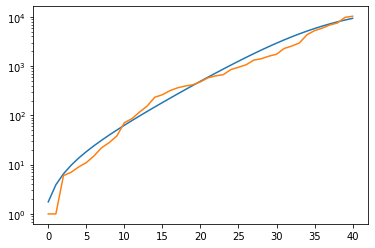

Netherlands
total error: 4.5157976150512695


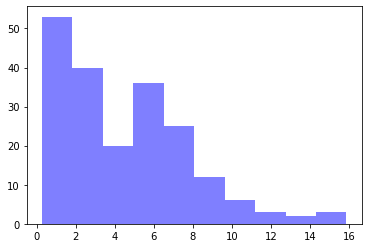

alpha: 0.9999282 , beta: 0.7503593 , initial_unconfirmed 3.9428294 , t0s 0.71380025 , lambds 0.575301


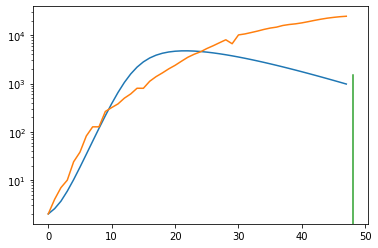

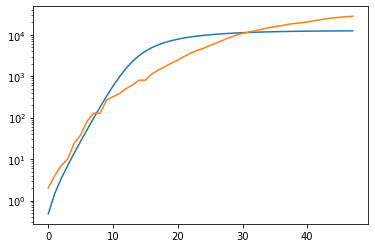

total error: 0.04555870220065117


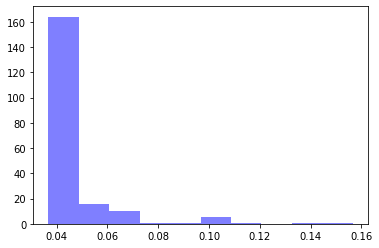

alpha: 0.7670367 , beta: 0.3668622 , initial_unconfirmed 47.79049 , t0s 0.0 , lambds 0.23912355


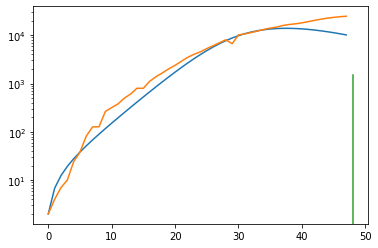

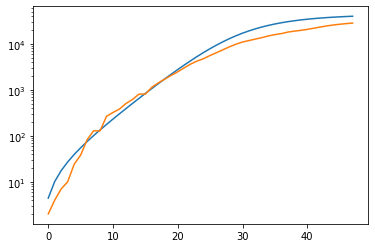

total error: 0.0415235199034214


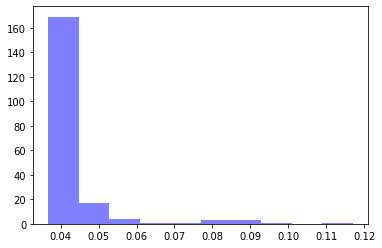

alpha: 0.75956345 , beta: 0.366919 , initial_unconfirmed 48.226 , t0s 0.0 , lambds 0.23915128


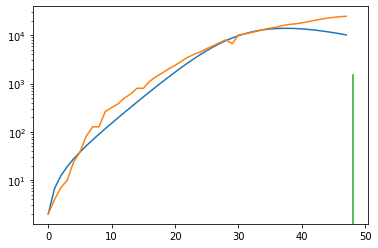

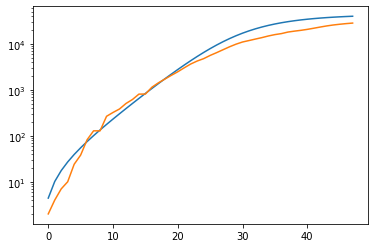

total error: 0.039802681654691696


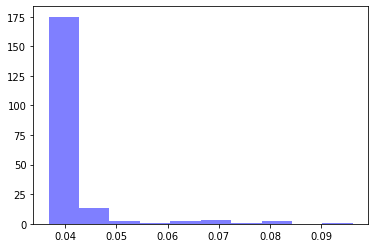

alpha: 0.7598959 , beta: 0.36685482 , initial_unconfirmed 48.24235 , t0s 0.0 , lambds 0.23911922


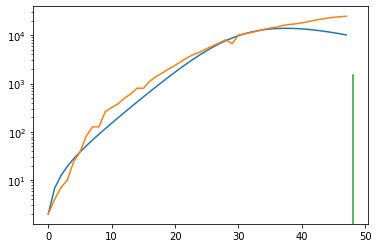

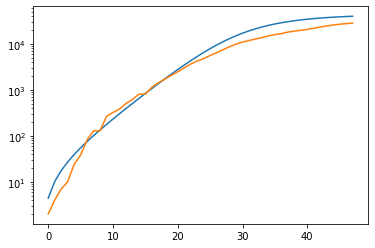

total error: 0.03879762813448906


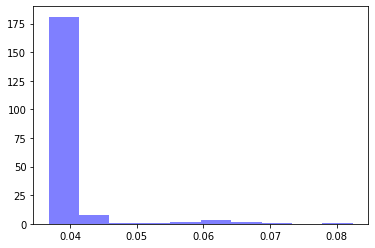

alpha: 0.7598959 , beta: 0.36685482 , initial_unconfirmed 48.24235 , t0s 0.0 , lambds 0.23911922


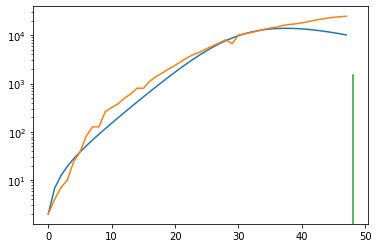

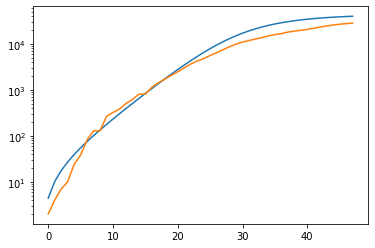

Turkey
total error: 4.392684459686279


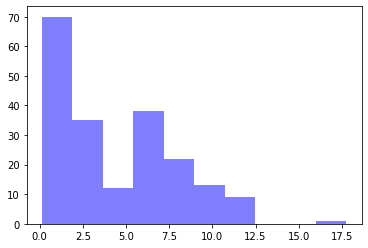

alpha: 0.7684355 , beta: 0.99869686 , initial_unconfirmed 1.223895 , t0s 0.8974557 , lambds 0.59612924


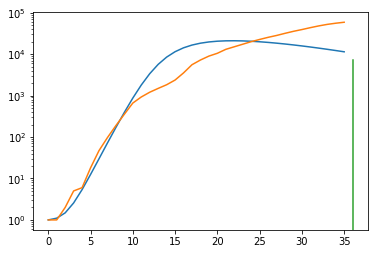

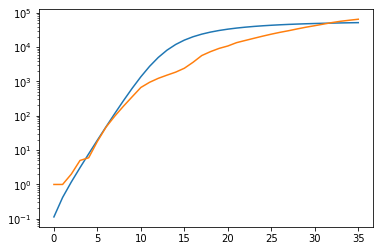

total error: 0.060646459460258484


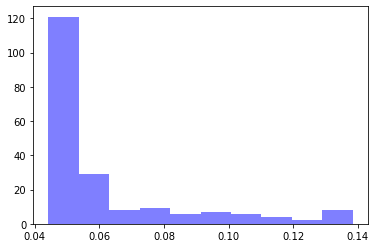

alpha: 0.6588894 , beta: 0.6321767 , initial_unconfirmed 9.842195 , t0s 0.0 , lambds 0.3726528


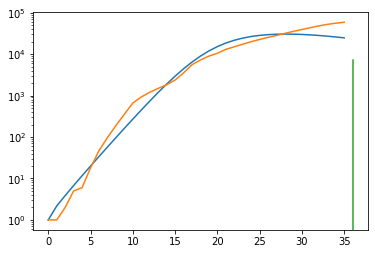

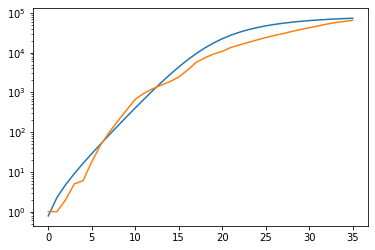

total error: 0.04755132272839546


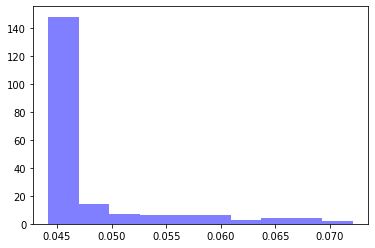

alpha: 0.6588894 , beta: 0.6321767 , initial_unconfirmed 9.842195 , t0s 0.0 , lambds 0.3726528


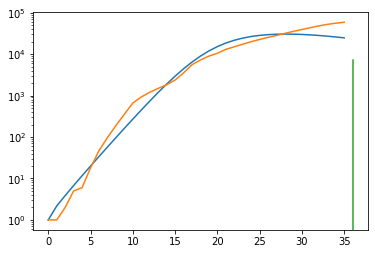

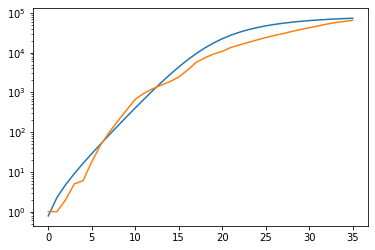

total error: 0.04498432204127312


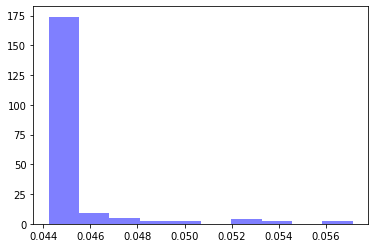

alpha: 0.6588894 , beta: 0.6321767 , initial_unconfirmed 9.842195 , t0s 0.0 , lambds 0.3726528


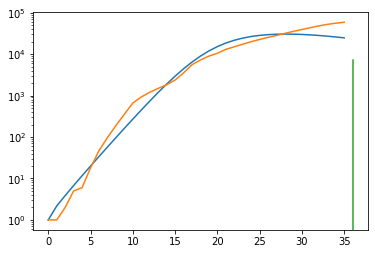

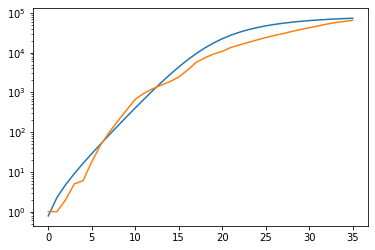

total error: 0.04429183900356293


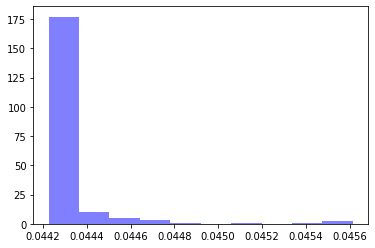

alpha: 0.6588894 , beta: 0.6321767 , initial_unconfirmed 9.842195 , t0s 0.0 , lambds 0.3726528


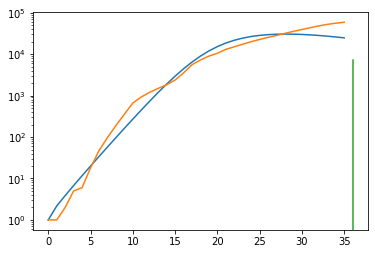

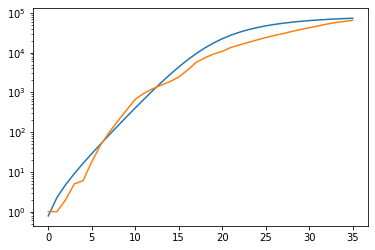

Panama
total error: 3.1688480377197266


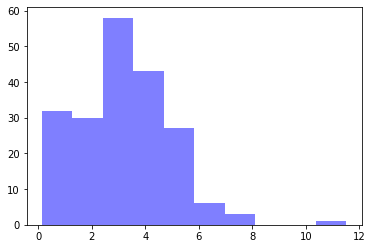

alpha: 0.99995726 , beta: 0.6560945 , initial_unconfirmed 4.5088234 , t0s 0.15881383 , lambds 0.526815


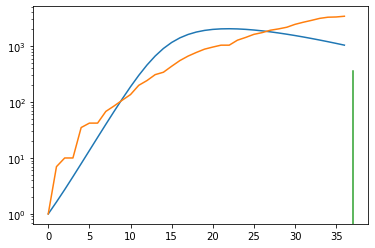

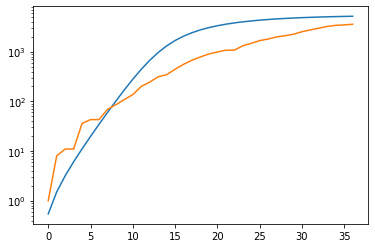

total error: 0.044462934136390686


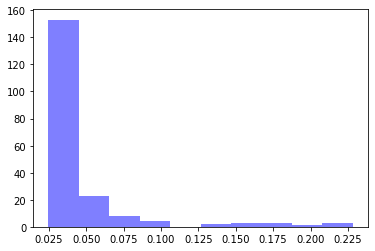

alpha: 0.76651275 , beta: 0.33073482 , initial_unconfirmed 41.127567 , t0s 0.0 , lambds 0.28200334


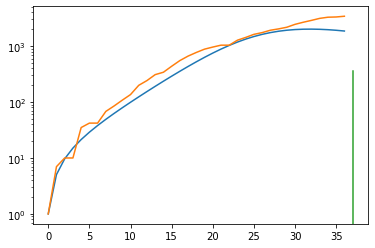

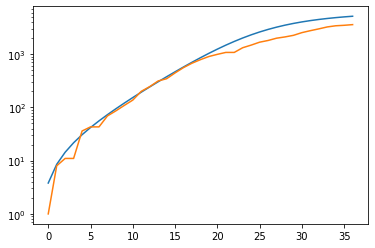

total error: 0.028387239202857018


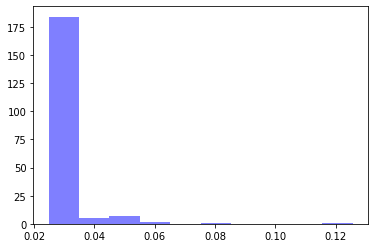

alpha: 0.6717396 , beta: 0.33073497 , initial_unconfirmed 46.93226 , t0s 0.0 , lambds 0.28198296


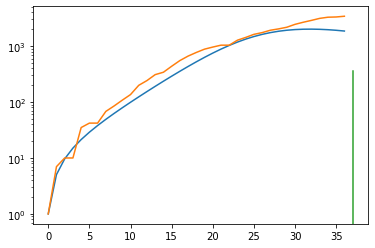

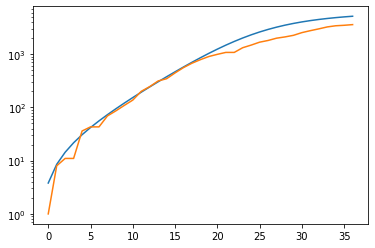

total error: 0.026706667616963387


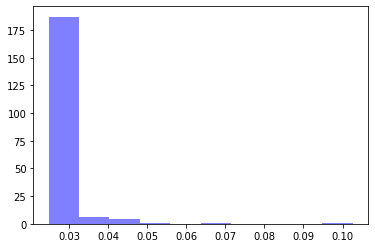

alpha: 0.6716538 , beta: 0.33074275 , initial_unconfirmed 46.93372 , t0s 0.0 , lambds 0.28198788


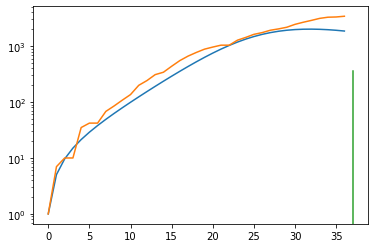

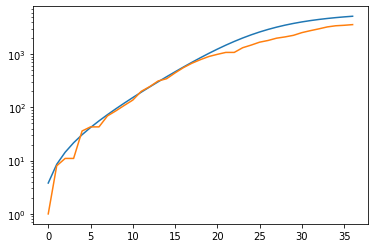

total error: 0.025967642664909363


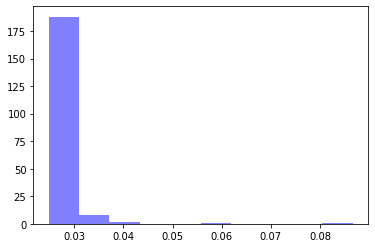

alpha: 0.6591717 , beta: 0.33076224 , initial_unconfirmed 47.81246 , t0s 0.0 , lambds 0.28200224


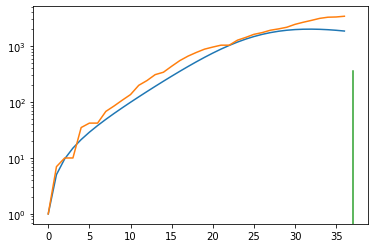

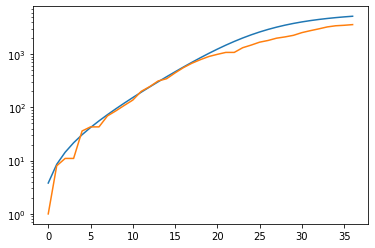

Dominica
total error: 3.4040937423706055


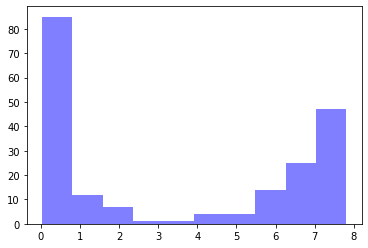

alpha: 0.9935577 , beta: 0.11408594 , initial_unconfirmed 14.506319 , t0s 0.24748284 , lambds 0.5272876


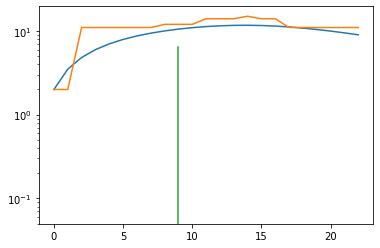

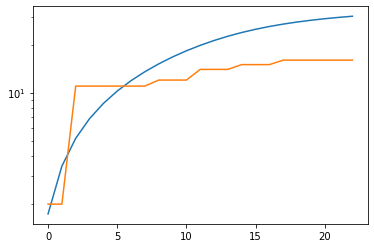

total error: 0.03433338925242424


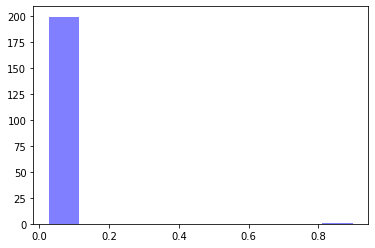

alpha: 0.84831834 , beta: 0.06946568 , initial_unconfirmed 19.74794 , t0s 1.9170562 , lambds 0.015532015


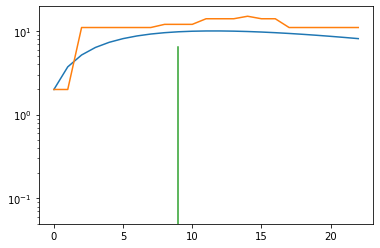

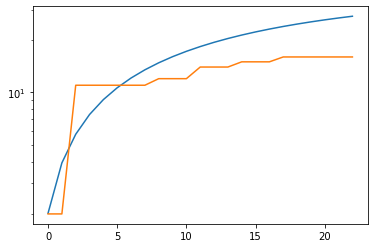

total error: 0.03247374668717384


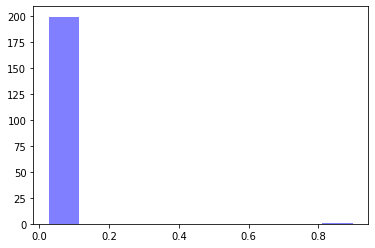

alpha: 0.8483405 , beta: 0.069460176 , initial_unconfirmed 19.747787 , t0s 1.9255875 , lambds 0.008983123


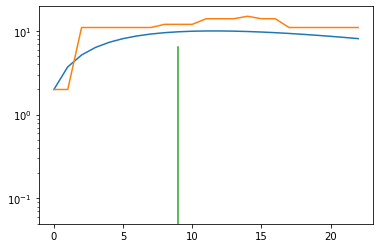

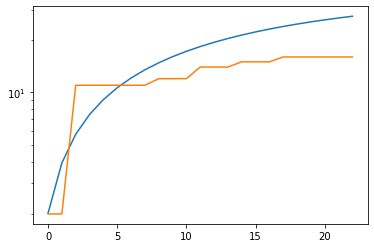

total error: 0.03192837908864021


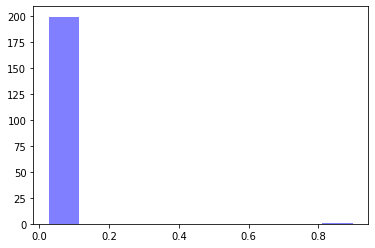

alpha: 0.9629653 , beta: 0.06945577 , initial_unconfirmed 17.397335 , t0s 3.0969725 , lambds 0.007891745


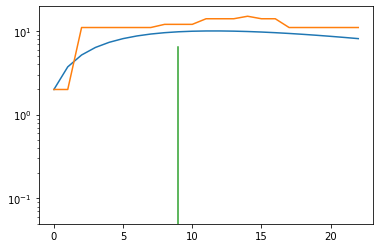

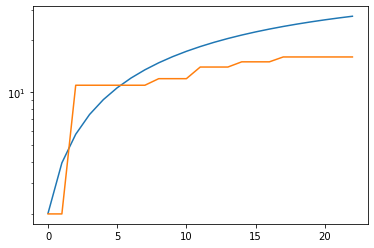

total error: 0.03169228509068489


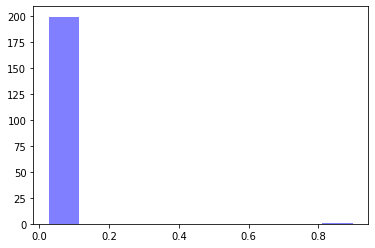

alpha: 0.99997014 , beta: 0.0694542 , initial_unconfirmed 16.753601 , t0s 3.1239014 , lambds 0.0063451002


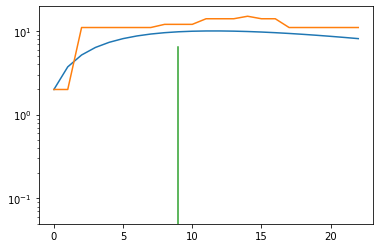

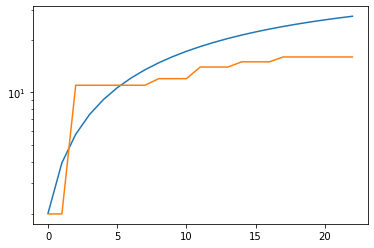

Norway
total error: 3.685093879699707


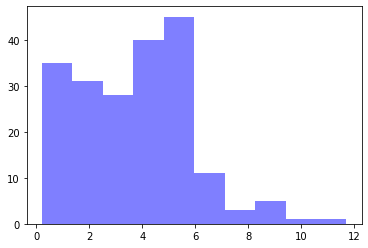

alpha: 0.79953516 , beta: 0.75729895 , initial_unconfirmed 2.1800847 , t0s 0.13681984 , lambds 0.5391637


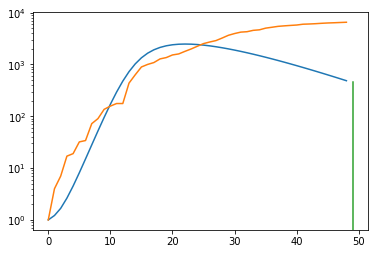

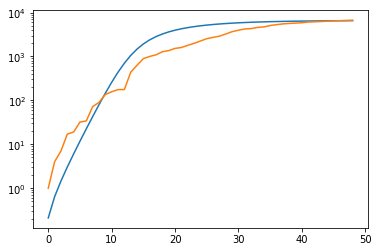

total error: 0.05267615616321564


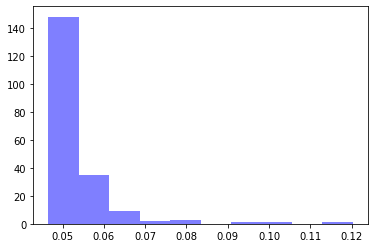

alpha: 0.7897947 , beta: 0.3505685 , initial_unconfirmed 36.113358 , t0s 0.0 , lambds 0.26168987


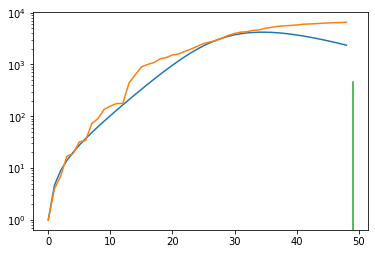

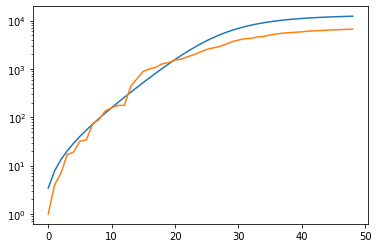

total error: 0.04899085685610771


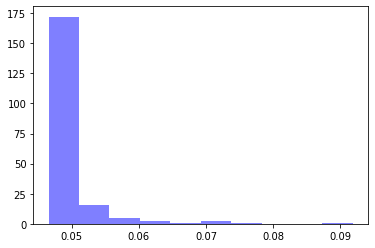

alpha: 0.60439456 , beta: 0.35059106 , initial_unconfirmed 47.183712 , t0s 0.0 , lambds 0.26164532


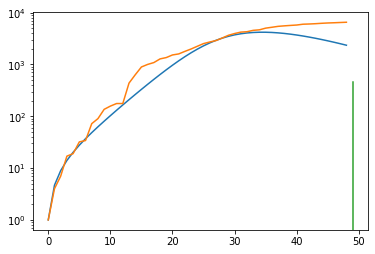

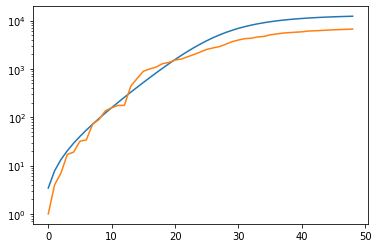

total error: 0.04769018664956093


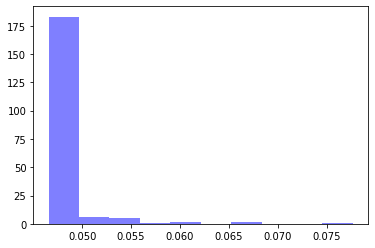

alpha: 0.6042523 , beta: 0.35059267 , initial_unconfirmed 47.193893 , t0s 0.0 , lambds 0.26164633


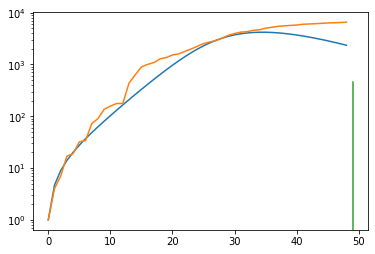

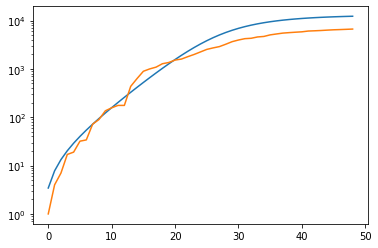

total error: 0.04721321538090706


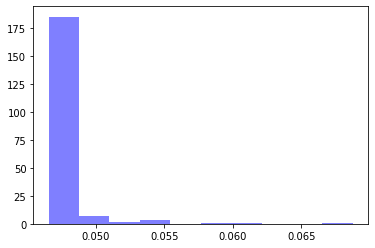

alpha: 0.6042523 , beta: 0.35059267 , initial_unconfirmed 47.193893 , t0s 0.0 , lambds 0.26164633


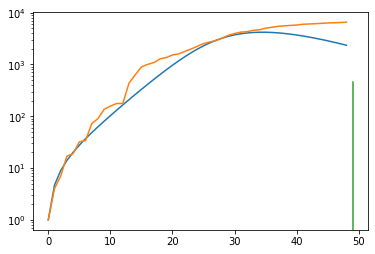

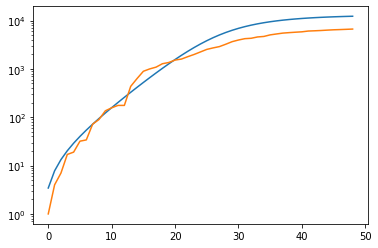

Timor-Leste
total error: 8.221661567687988


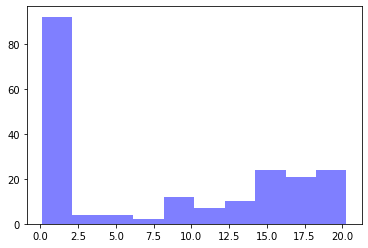

alpha: 0.9992507 , beta: 0.07908724 , initial_unconfirmed 1.8427938 , t0s 0.2064532 , lambds 0.69645303


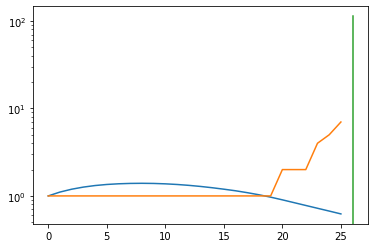

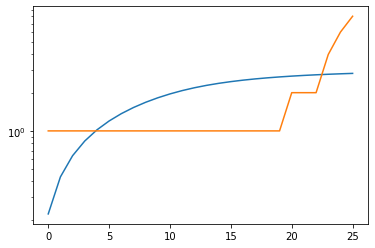

total error: 0.13000981509685516


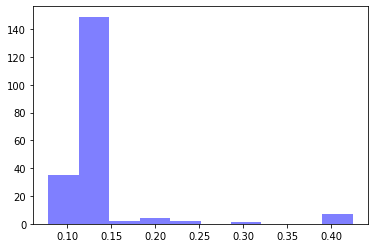

alpha: 0.9963571 , beta: 0.13555633 , initial_unconfirmed 1.0358723 , t0s 1.5771403 , lambds 0.00034617324


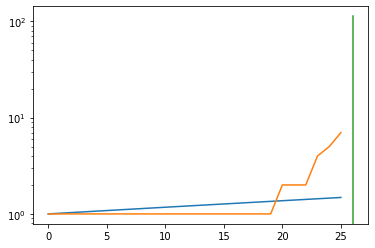

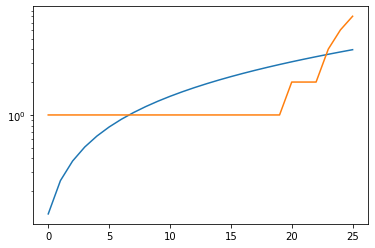

total error: 0.11983463913202286


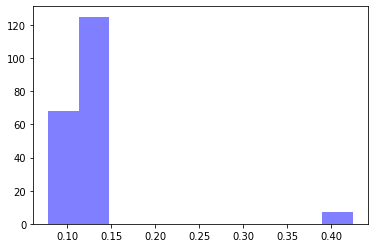

alpha: 0.9963577 , beta: 0.13555554 , initial_unconfirmed 1.0358799 , t0s 1.5774394 , lambds 0.00015834636


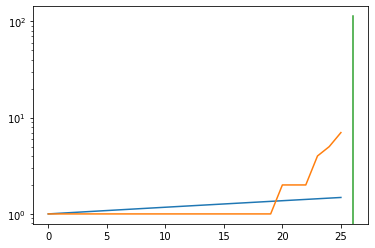

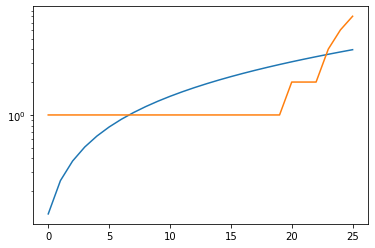

total error: 0.11444967240095139


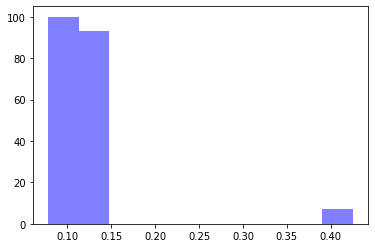

alpha: 0.99635875 , beta: 0.1355565 , initial_unconfirmed 1.0358704 , t0s 1.5775595 , lambds 7.2738134e-05


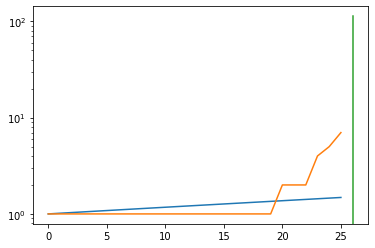

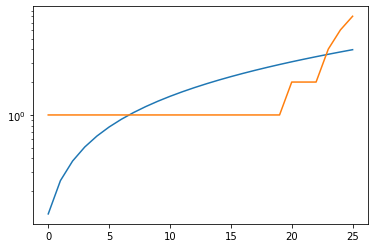

total error: 0.10842852294445038


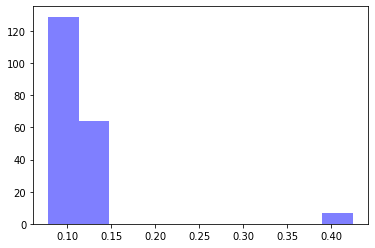

alpha: 0.9963583 , beta: 0.13555776 , initial_unconfirmed 1.0358555 , t0s 1.5775843 , lambds 4.938057e-05


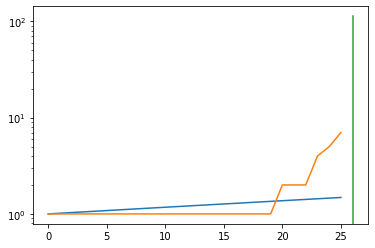

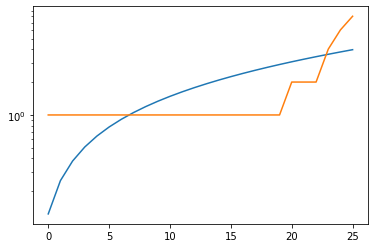

Montenegro
total error: 2.8049509525299072


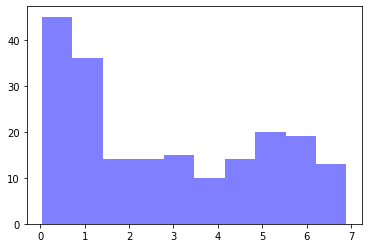

alpha: 0.9734522 , beta: 0.39032808 , initial_unconfirmed 18.793472 , t0s 0.4475025 , lambds 0.6087339


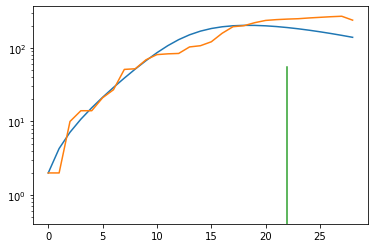

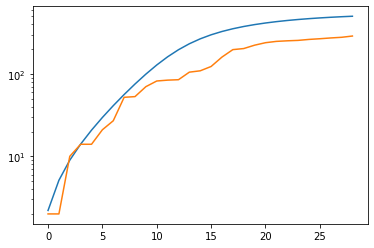

total error: 0.040329426527023315


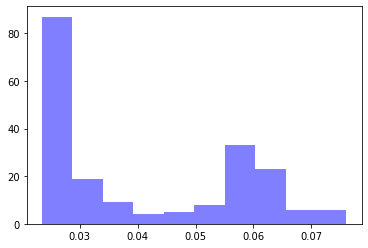

alpha: 0.53931165 , beta: 0.29818186 , initial_unconfirmed 36.68355 , t0s 0.0 , lambds 0.40668046


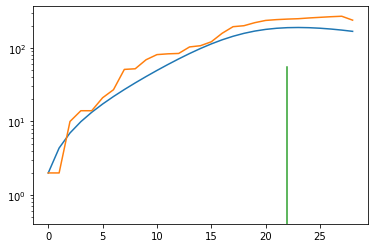

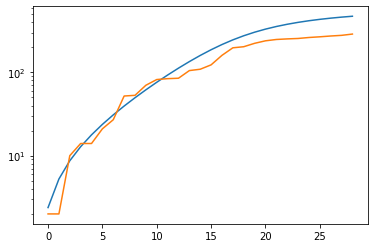

total error: 0.03231864795088768


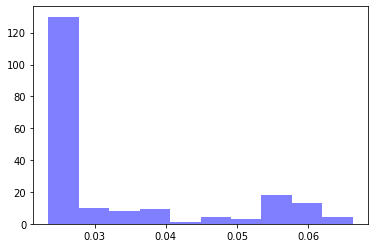

alpha: 0.50850284 , beta: 0.29824486 , initial_unconfirmed 38.89067 , t0s 0.0 , lambds 0.4067615


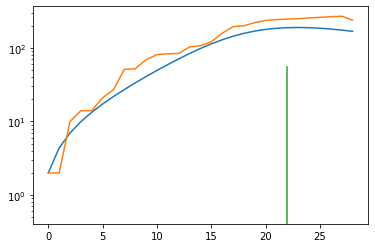

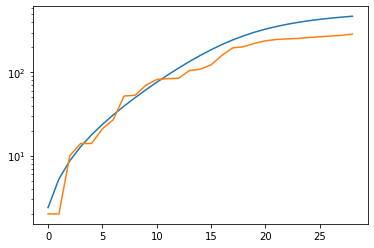

total error: 0.025272076949477196


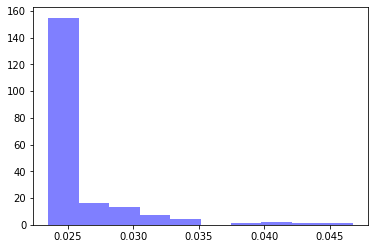

alpha: 0.5009585 , beta: 0.298221 , initial_unconfirmed 39.483658 , t0s 0.0 , lambds 0.4067281


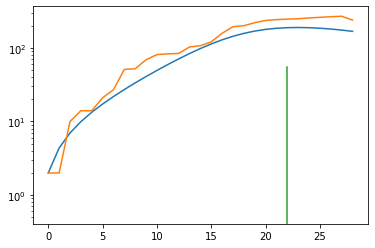

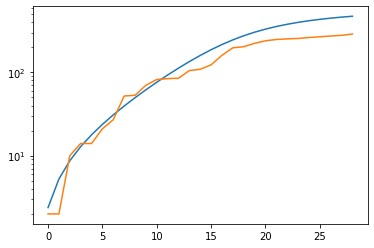

total error: 0.02394167333841324


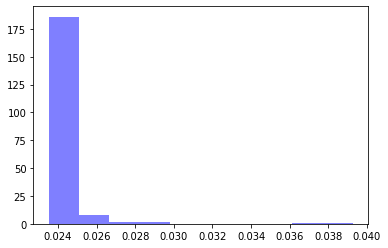

alpha: 0.5009585 , beta: 0.298221 , initial_unconfirmed 39.483658 , t0s 0.0 , lambds 0.4067281


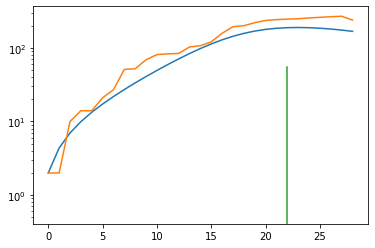

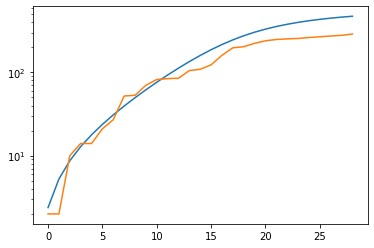

Somalia
total error: 6.525627613067627


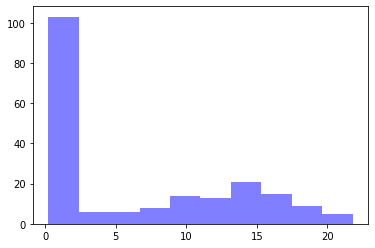

alpha: 0.9593758 , beta: 0.14818098 , initial_unconfirmed 5.1134734 , t0s 0.6912259 , lambds 0.5249944


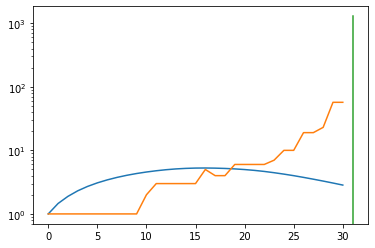

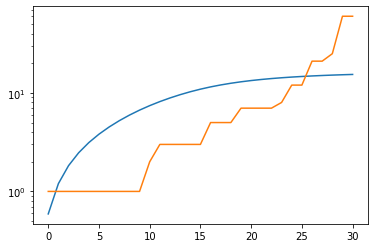

total error: 0.1976735144853592


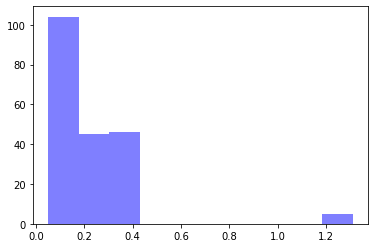

alpha: 0.5017792 , beta: 0.2375144 , initial_unconfirmed 1.9490477 , t0s 1.7239238 , lambds 0.00014788768


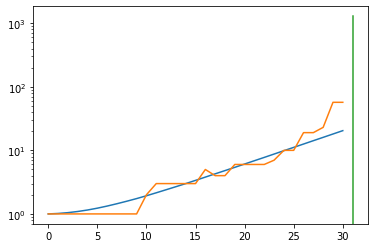

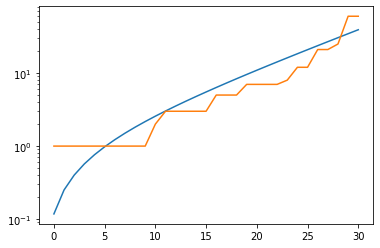

total error: 0.14260391891002655


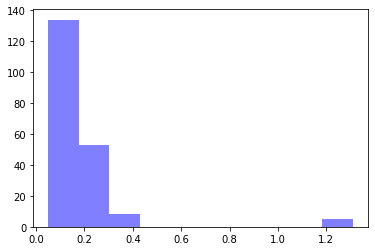

alpha: 0.81065273 , beta: 0.23751694 , initial_unconfirmed 1.2063284 , t0s 3.4589455 , lambds 0.00013089293


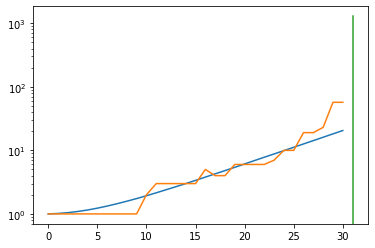

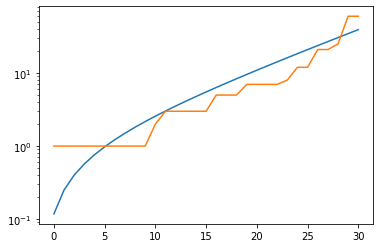

total error: 0.11083462089300156


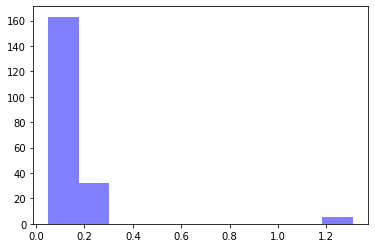

alpha: 0.81120837 , beta: 0.23751126 , initial_unconfirmed 1.205576 , t0s 3.4590335 , lambds 9.668859e-05


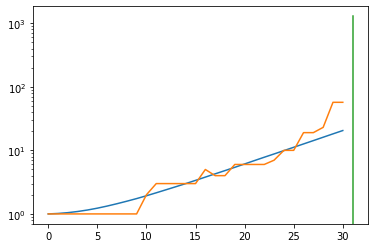

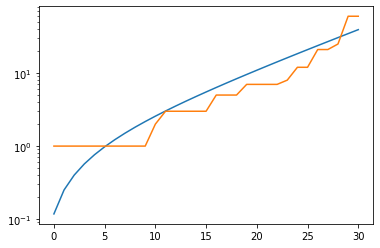

total error: 0.08559605479240417


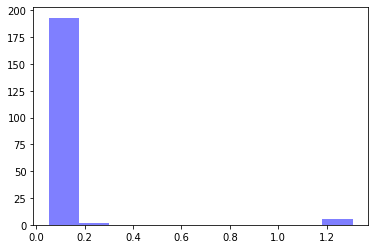

alpha: 0.50101537 , beta: 0.23751602 , initial_unconfirmed 1.9518507 , t0s 0.0 , lambds 4.4520853e-05


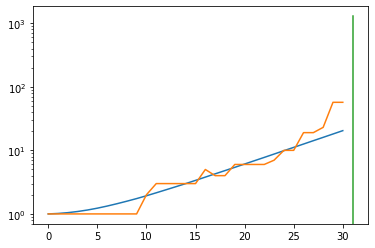

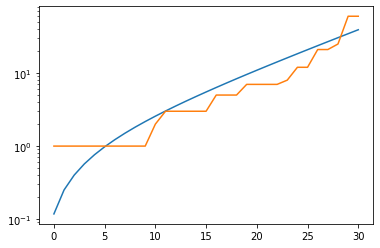

Eswatini
total error: 6.045313835144043


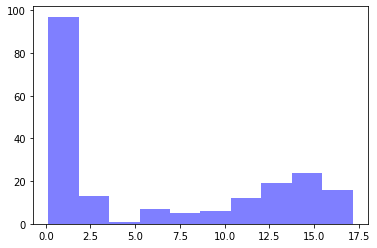

alpha: 0.99820143 , beta: 0.07529766 , initial_unconfirmed 7.224992 , t0s 0.2807533 , lambds 0.67107725


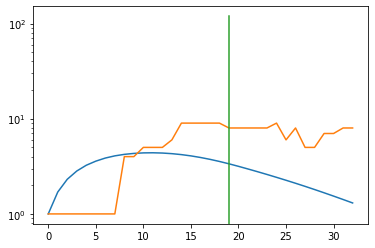

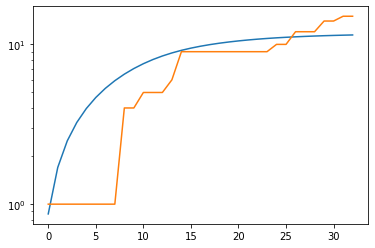

total error: 0.0919247716665268


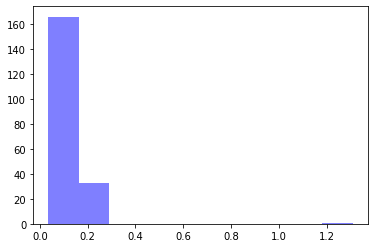

alpha: 0.95834756 , beta: 0.23026517 , initial_unconfirmed 1.8644296 , t0s 0.0 , lambds 0.39556545


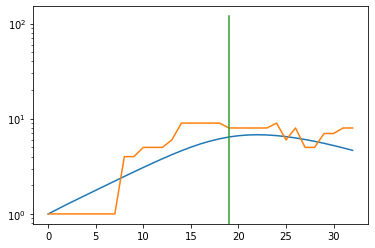

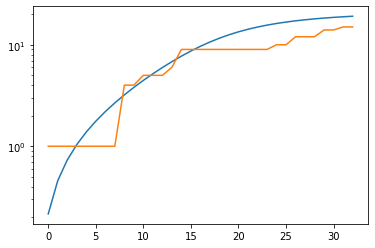

total error: 0.06361549347639084


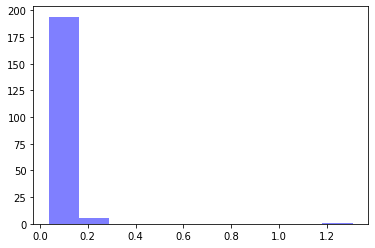

alpha: 0.95834756 , beta: 0.23026517 , initial_unconfirmed 1.8644296 , t0s 0.0 , lambds 0.39556545


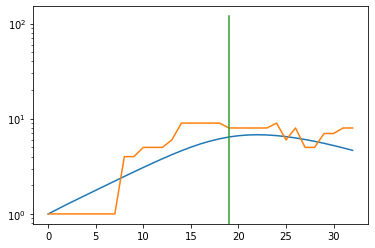

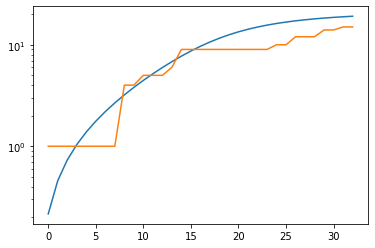

total error: 0.05173477157950401


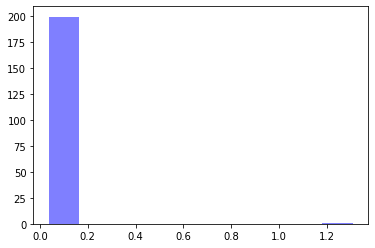

alpha: 0.95834756 , beta: 0.23026517 , initial_unconfirmed 1.8644296 , t0s 0.0 , lambds 0.39556545


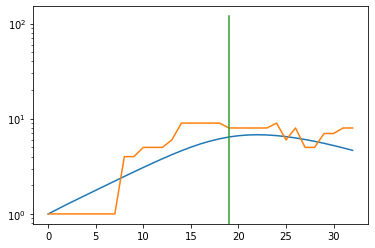

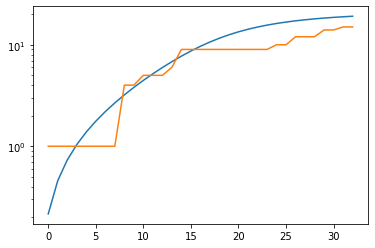

total error: 0.046012893319129944


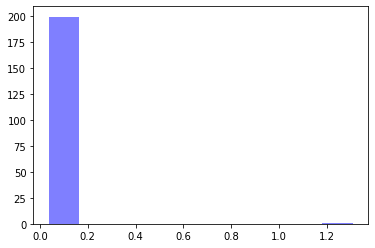

alpha: 0.95834756 , beta: 0.23026517 , initial_unconfirmed 1.8644296 , t0s 0.0 , lambds 0.39556545


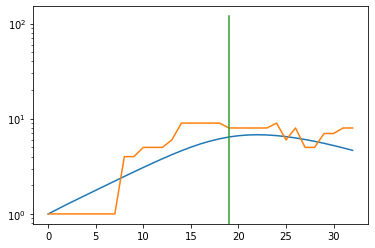

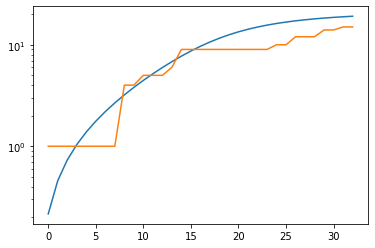

Liechtenstein
total error: 3.162618398666382


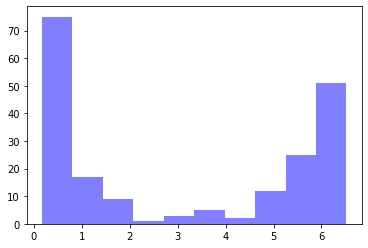

alpha: 0.9952819 , beta: 0.5432052 , initial_unconfirmed 1.4284849 , t0s 0.15257204 , lambds 0.6021616


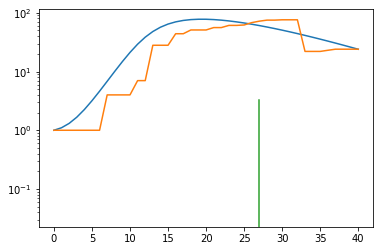

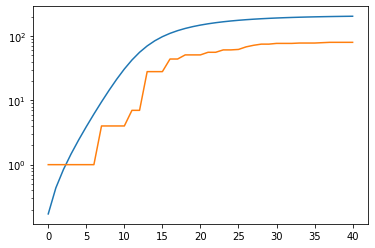

total error: 0.13453178107738495


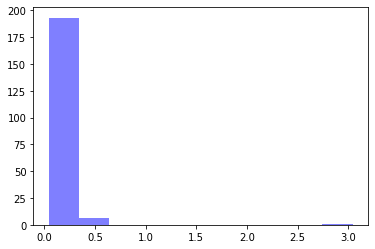

alpha: 0.9999625 , beta: 0.3594353 , initial_unconfirmed 1.3389777 , t0s 9.794922 , lambds 0.8848895


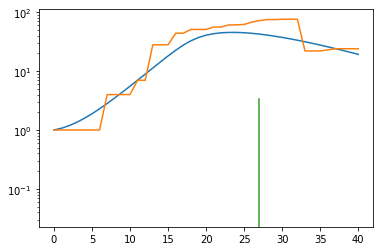

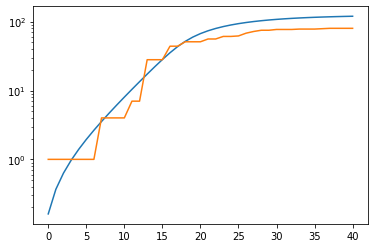

total error: 0.0581817664206028


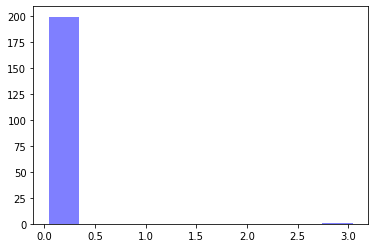

alpha: 0.9999626 , beta: 0.35875353 , initial_unconfirmed 1.3445395 , t0s 10.220857 , lambds 0.9350448


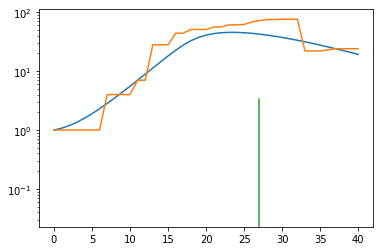

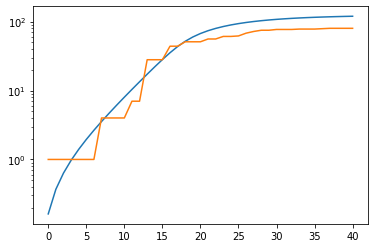

total error: 0.058147091418504715


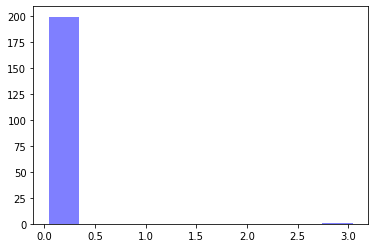

alpha: 0.99996275 , beta: 0.35861668 , initial_unconfirmed 1.3450972 , t0s 10.401019 , lambds 0.95863014


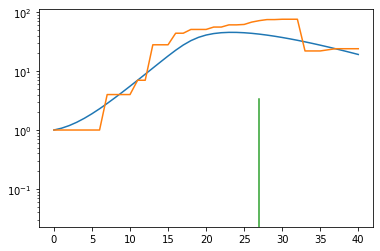

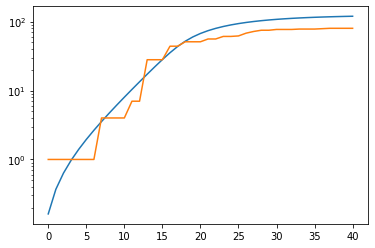

total error: 0.05814294517040253


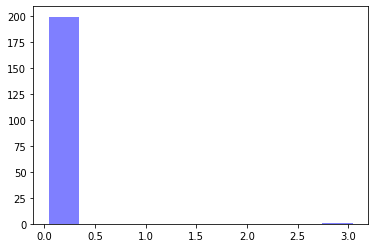

alpha: 0.99996287 , beta: 0.3585472 , initial_unconfirmed 1.345377 , t0s 10.4973345 , lambds 0.9717488


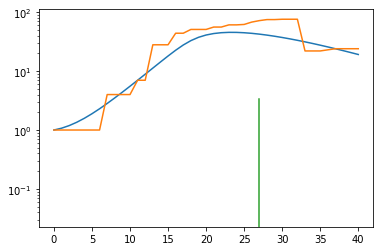

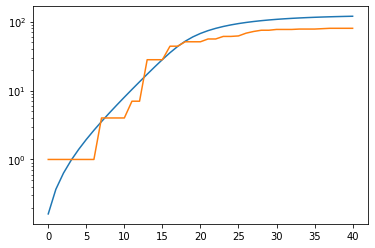

Slovakia
total error: 3.5923268795013428


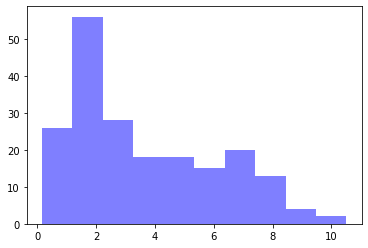

alpha: 0.91653043 , beta: 0.39722112 , initial_unconfirmed 17.097279 , t0s 0.2540239 , lambds 0.5849738


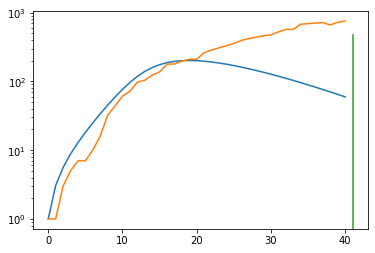

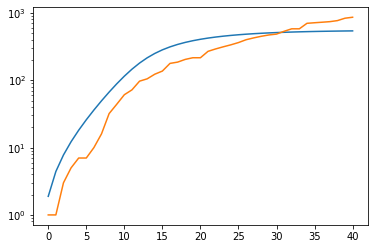

total error: 0.0838618203997612


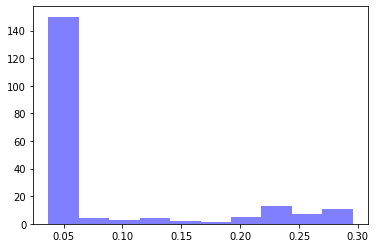

alpha: 0.5548994 , beta: 0.32129863 , initial_unconfirmed 17.338673 , t0s 0.0 , lambds 0.28956258


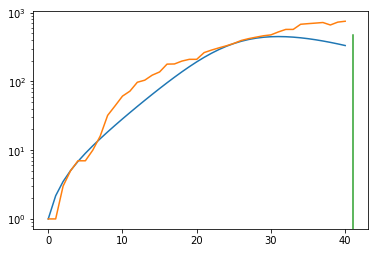

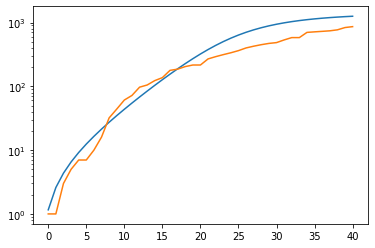

total error: 0.03812878951430321


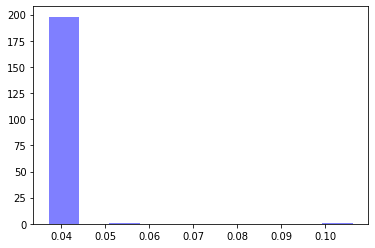

alpha: 0.5011569 , beta: 0.32129747 , initial_unconfirmed 19.200203 , t0s 0.0 , lambds 0.28954685


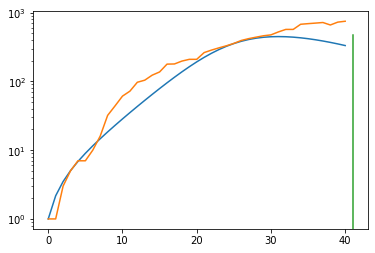

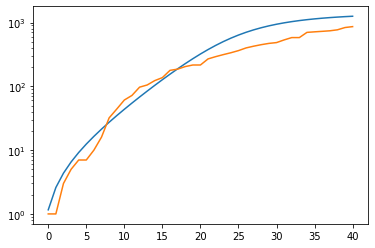

total error: 0.03744248300790787


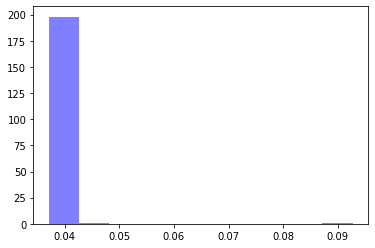

alpha: 0.5011569 , beta: 0.32129747 , initial_unconfirmed 19.200203 , t0s 0.0 , lambds 0.28954685


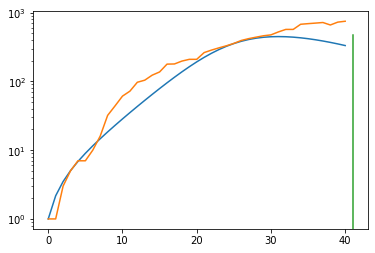

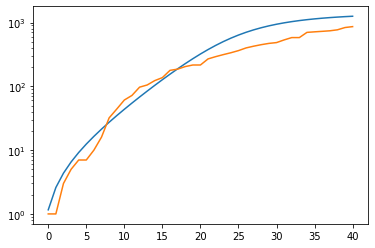

total error: 0.0373196043074131


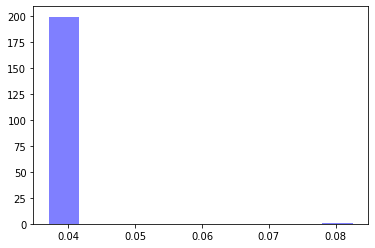

alpha: 0.5011569 , beta: 0.32129747 , initial_unconfirmed 19.200203 , t0s 0.0 , lambds 0.28954685


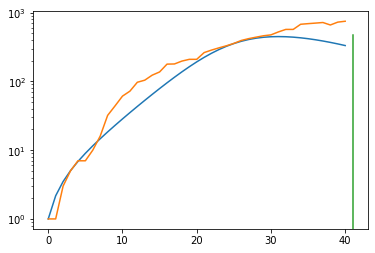

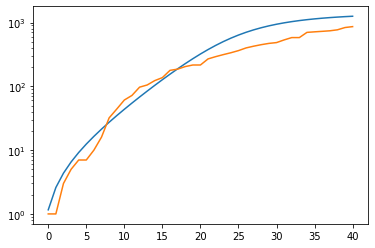

Ghana
total error: 3.886434555053711


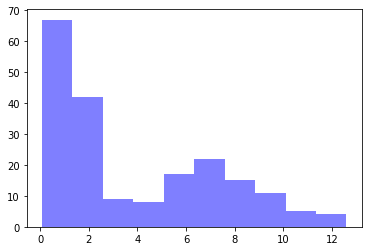

alpha: 0.7851746 , beta: 0.37904215 , initial_unconfirmed 12.903255 , t0s 0.12136221 , lambds 0.5244412


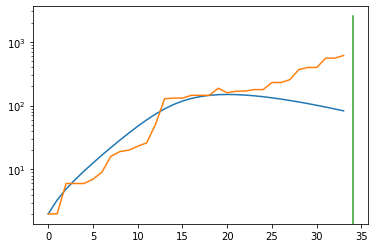

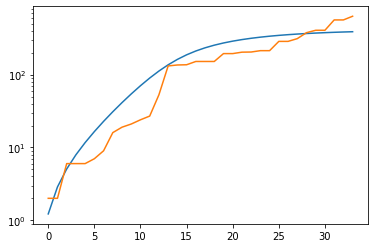

total error: 0.08528974652290344


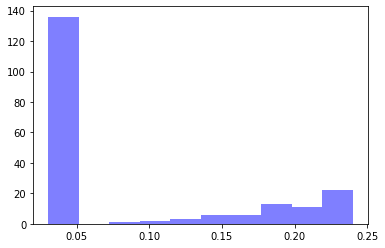

alpha: 0.74573565 , beta: 0.30376202 , initial_unconfirmed 12.596492 , t0s 0.0 , lambds 0.28827813


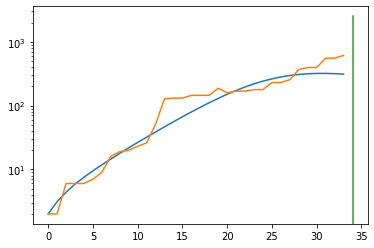

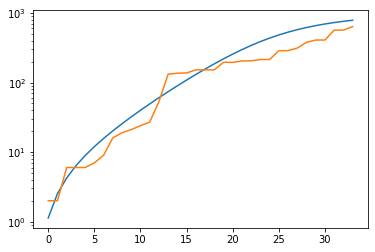

total error: 0.03199096769094467


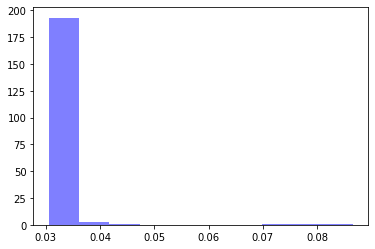

alpha: 0.5031436 , beta: 0.30375013 , initial_unconfirmed 18.671381 , t0s 0.0 , lambds 0.28827602


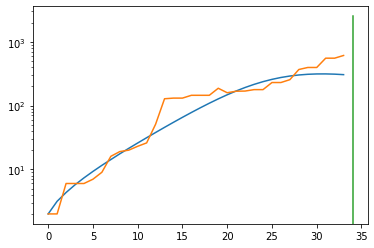

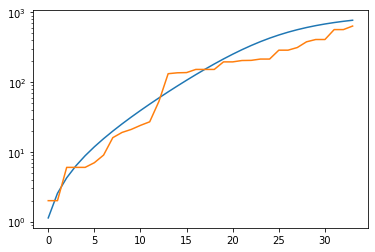

total error: 0.030792051926255226


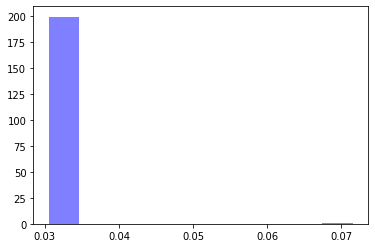

alpha: 0.5016186 , beta: 0.3037774 , initial_unconfirmed 18.725498 , t0s 0.0 , lambds 0.2883048


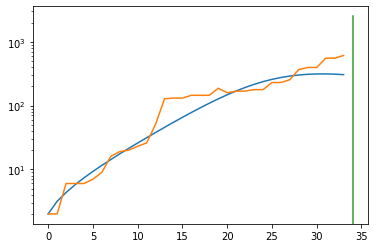

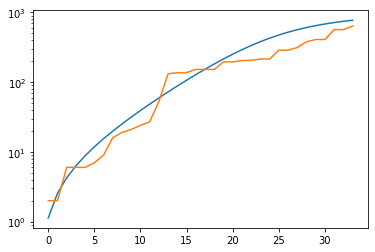

total error: 0.030678879469633102


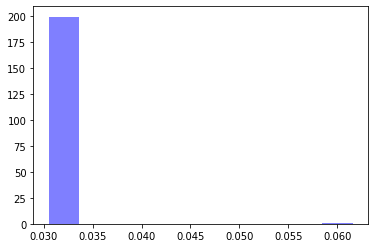

alpha: 0.5037413 , beta: 0.3037771 , initial_unconfirmed 18.646751 , t0s 0.0 , lambds 0.28830436


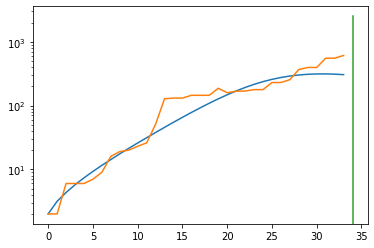

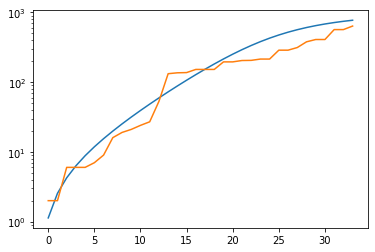

DR Congo
total error: 4.670830726623535


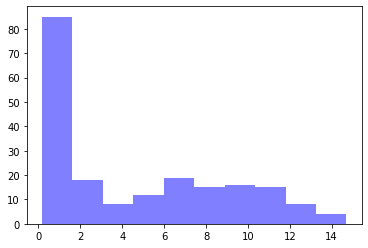

alpha: 0.9979602 , beta: 0.61866474 , initial_unconfirmed 2.157575 , t0s 0.107043564 , lambds 0.7307354


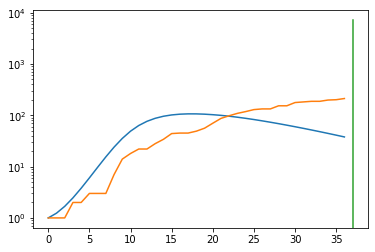

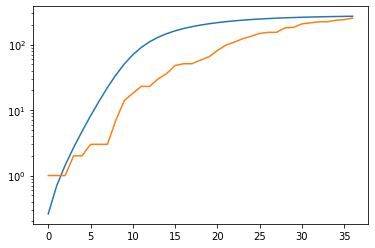

total error: 0.1494055986404419


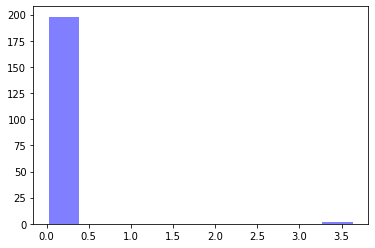

alpha: 0.50637954 , beta: 0.32155567 , initial_unconfirmed 6.1719017 , t0s 0.0 , lambds 0.29286915


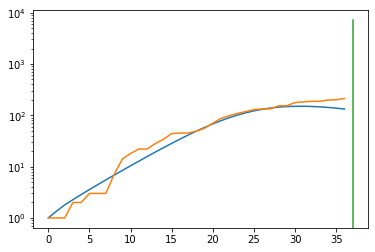

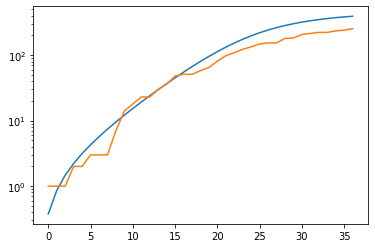

total error: 0.06525872647762299


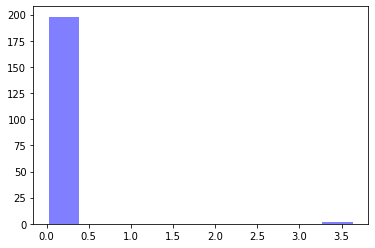

alpha: 0.50082767 , beta: 0.32148823 , initial_unconfirmed 6.244377 , t0s 0.0 , lambds 0.2928156


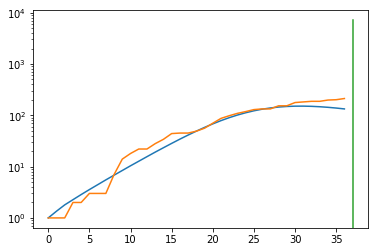

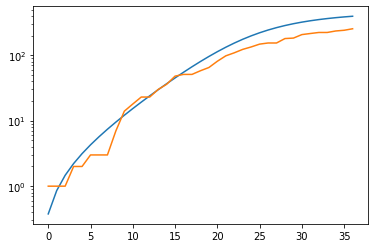

total error: 0.059582918882369995


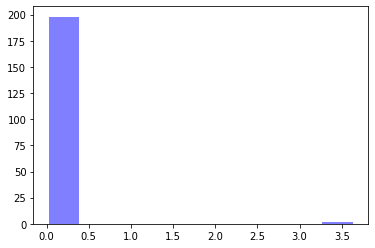

alpha: 0.50082767 , beta: 0.32148823 , initial_unconfirmed 6.244377 , t0s 0.0 , lambds 0.2928156


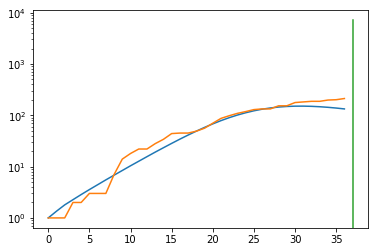

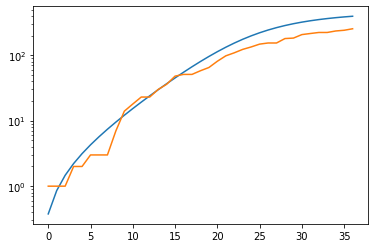

total error: 0.05958146974444389


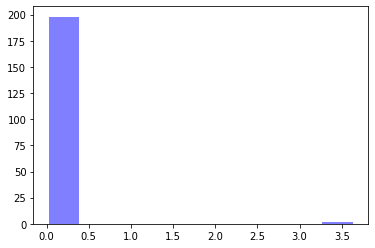

alpha: 0.50082767 , beta: 0.32148823 , initial_unconfirmed 6.244377 , t0s 0.0 , lambds 0.2928156


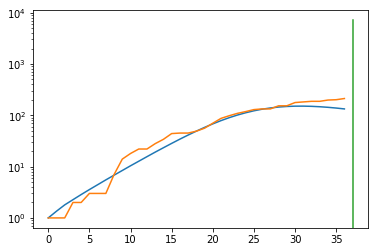

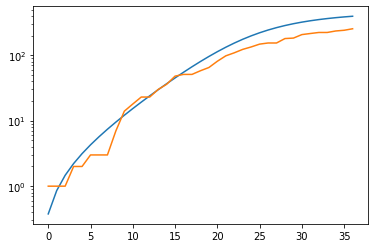

Singapore
total error: 5.648405075073242


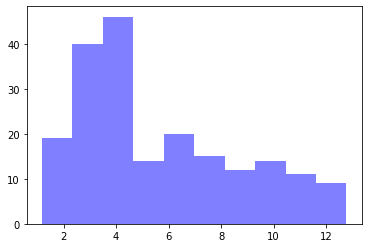

alpha: 0.99991274 , beta: 0.37356073 , initial_unconfirmed 22.799 , t0s 0.7650485 , lambds 0.5149107


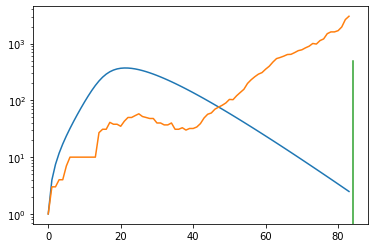

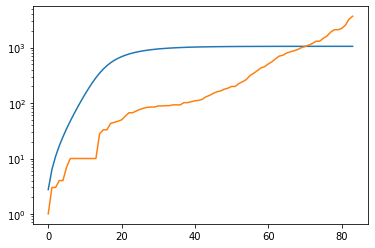

total error: 0.25398558378219604


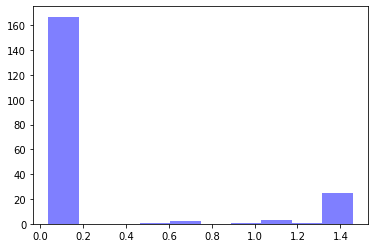

alpha: 0.5008954 , beta: 0.18485446 , initial_unconfirmed 15.341897 , t0s 4.38685 , lambds 0.005458628


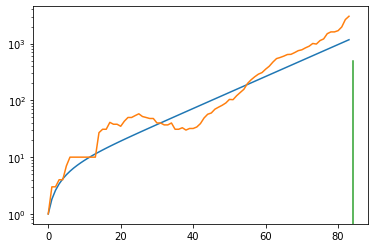

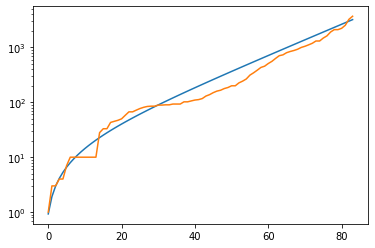

total error: 0.03867163509130478


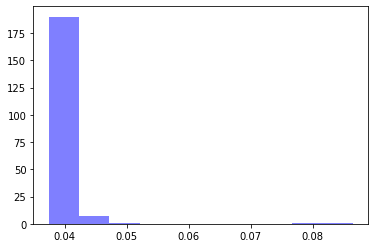

alpha: 0.7755162 , beta: 0.18494624 , initial_unconfirmed 9.852244 , t0s 5.505777 , lambds 0.0010646589


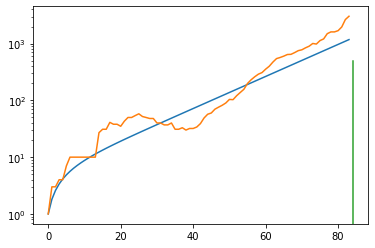

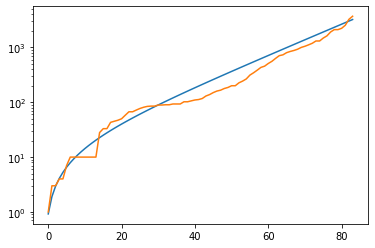

total error: 0.037892427295446396


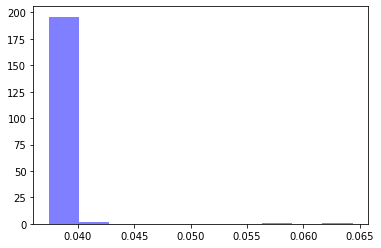

alpha: 0.99996954 , beta: 0.18495293 , initial_unconfirmed 7.6371007 , t0s 5.3572583 , lambds 0.0008514747


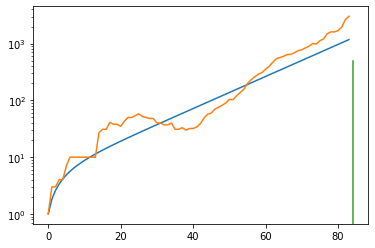

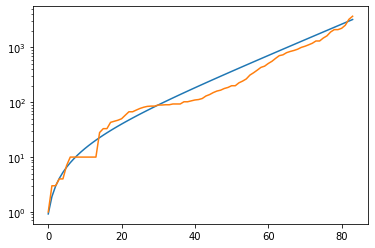

total error: 0.03771350532770157


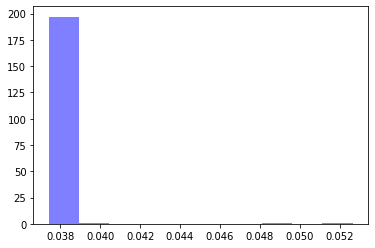

alpha: 0.9999696 , beta: 0.18495369 , initial_unconfirmed 7.636393 , t0s 5.3622217 , lambds 0.00059333845


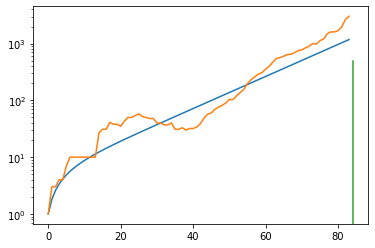

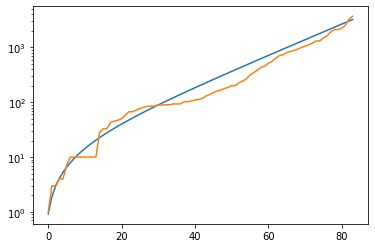

Paraguay
total error: 4.332185745239258


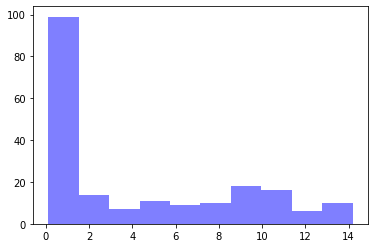

alpha: 0.9846344 , beta: 0.4821185 , initial_unconfirmed 1.8226087 , t0s 0.5897625 , lambds 0.596743


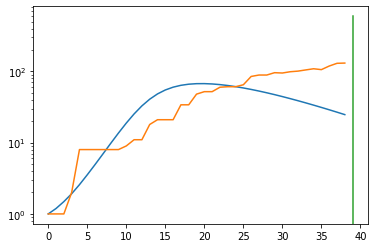

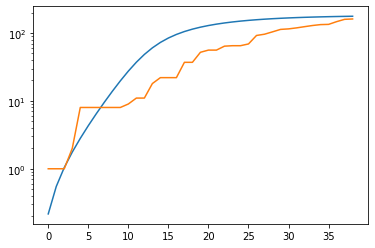

total error: 0.10174693912267685


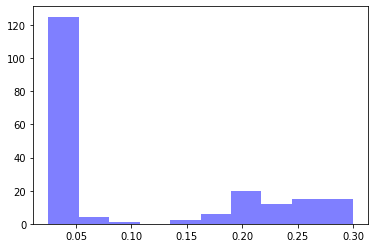

alpha: 0.7025211 , beta: 0.24441826 , initial_unconfirmed 7.2489624 , t0s 0.0 , lambds 0.22862789


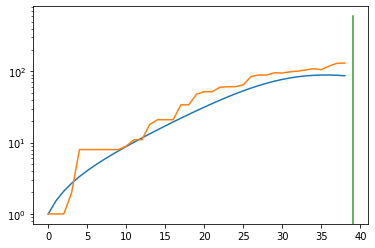

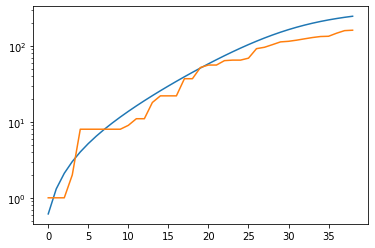

total error: 0.058258261531591415


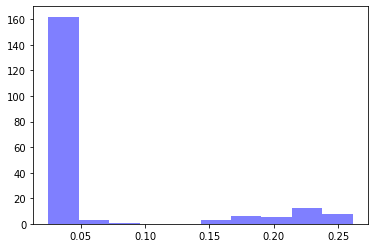

alpha: 0.5157454 , beta: 0.24442501 , initial_unconfirmed 9.8736 , t0s 0.0 , lambds 0.22863922


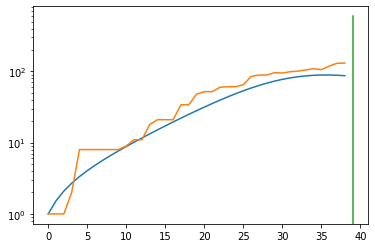

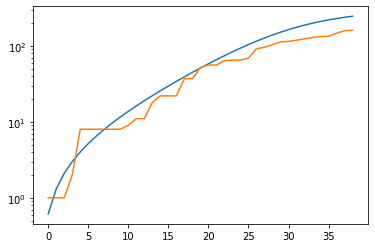

total error: 0.025257810950279236


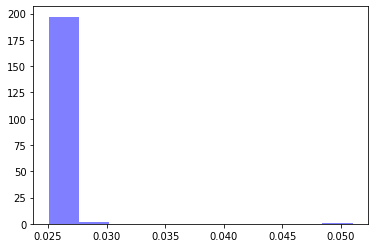

alpha: 0.50157416 , beta: 0.24440853 , initial_unconfirmed 10.15448 , t0s 0.0 , lambds 0.22862262


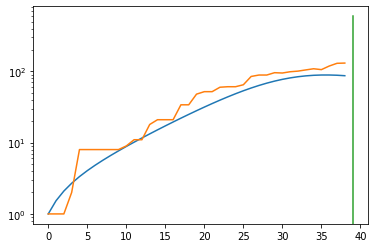

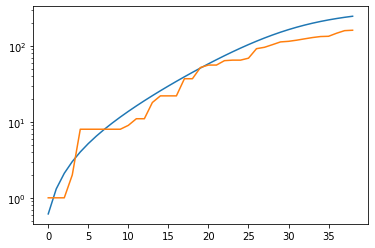

total error: 0.025135336443781853


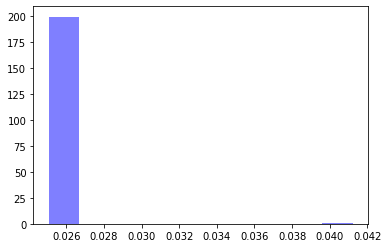

alpha: 0.502611 , beta: 0.24440157 , initial_unconfirmed 10.134276 , t0s 0.0 , lambds 0.22861244


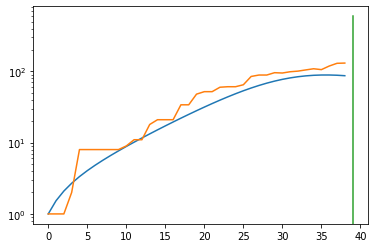

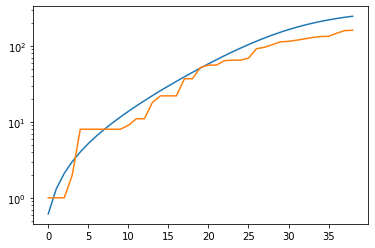

Georgia
Bolivia
total error: 4.005108833312988


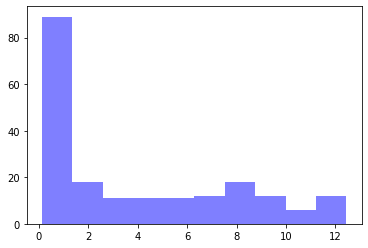

alpha: 0.9998596 , beta: 0.5104031 , initial_unconfirmed 2.7890234 , t0s 0.83670294 , lambds 0.66098803


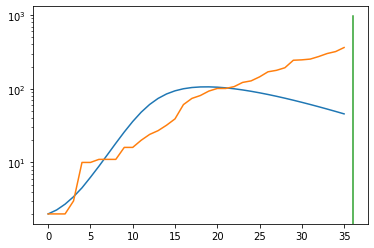

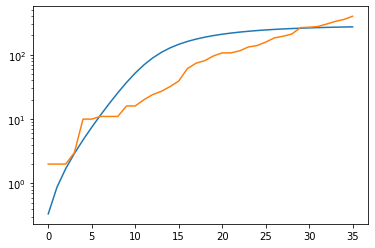

total error: 0.09141836315393448


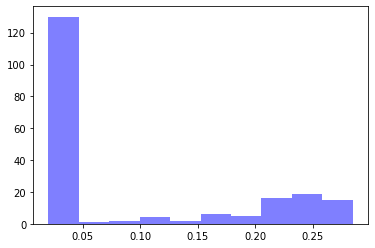

alpha: 0.6395403 , beta: 0.26304856 , initial_unconfirmed 11.918507 , t0s 0.0 , lambds 0.22090606


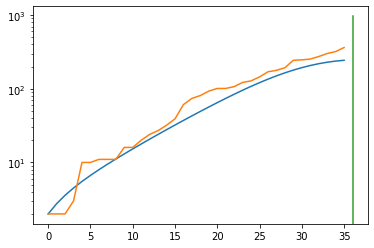

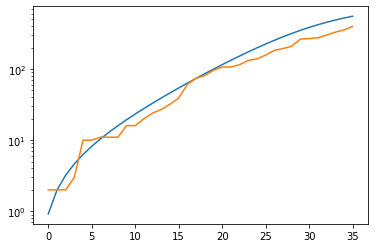

total error: 0.03814360499382019


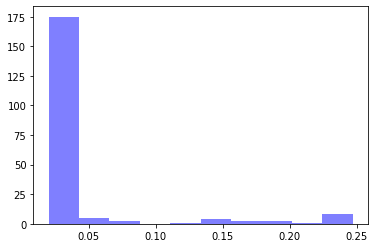

alpha: 0.5016971 , beta: 0.26303422 , initial_unconfirmed 15.195749 , t0s 0.0 , lambds 0.22087975


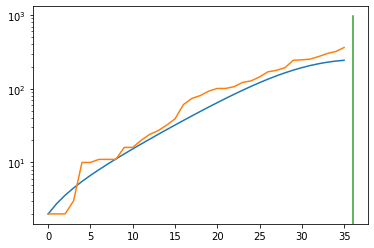

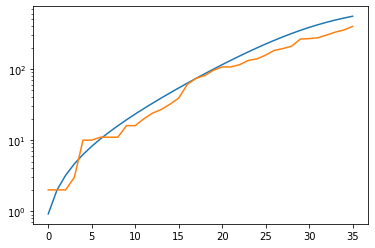

total error: 0.02037162333726883


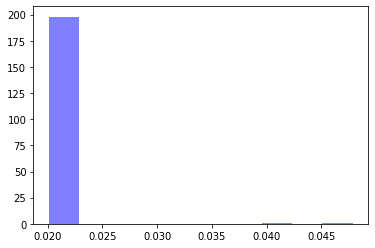

alpha: 0.5203714 , beta: 0.2630386 , initial_unconfirmed 14.649711 , t0s 0.0 , lambds 0.22089142


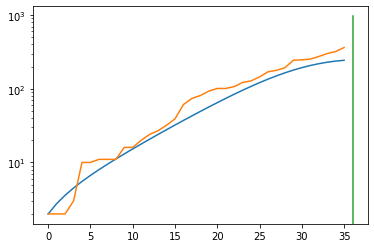

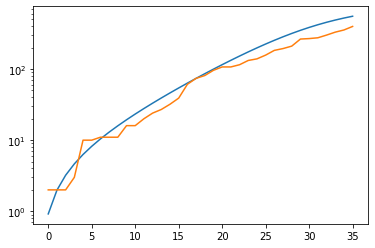

total error: 0.020238833501935005


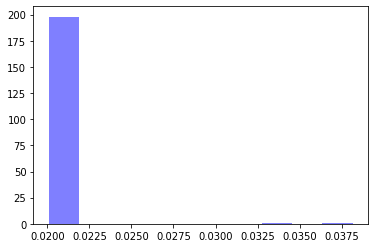

alpha: 0.5203714 , beta: 0.2630386 , initial_unconfirmed 14.649711 , t0s 0.0 , lambds 0.22089142


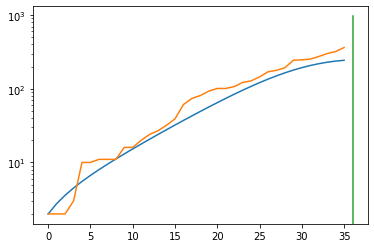

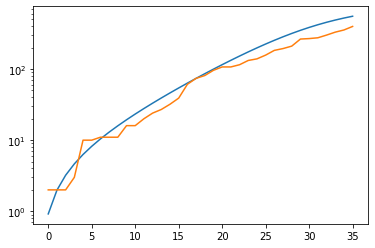

Kiribati
North Korea
Oman
total error: 5.157971382141113


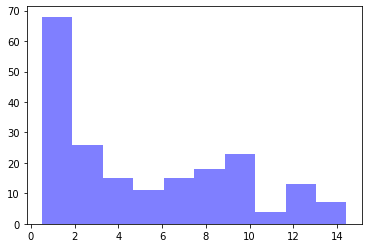

alpha: 0.9999526 , beta: 0.2472863 , initial_unconfirmed 16.561329 , t0s 0.12709433 , lambds 0.5056113


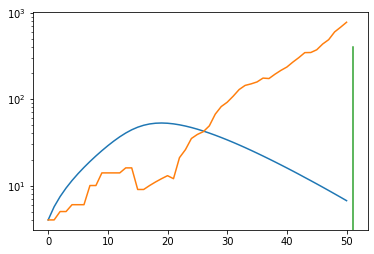

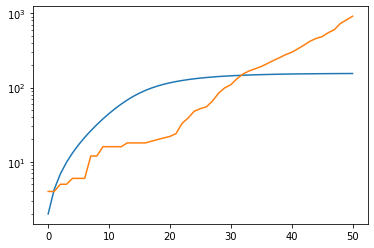

total error: 0.24263912439346313


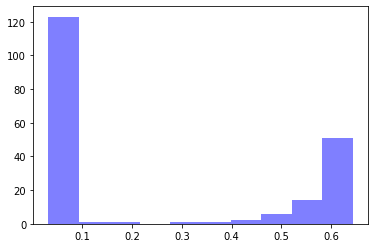

alpha: 0.68831325 , beta: 0.21888821 , initial_unconfirmed 8.061202 , t0s 5.0612326 , lambds 0.002741664


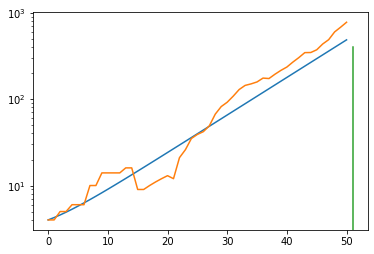

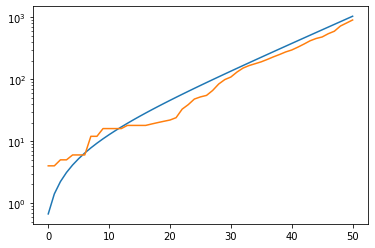

total error: 0.07859856635332108


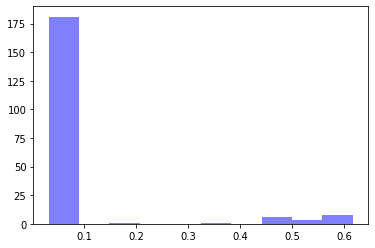

alpha: 0.99998957 , beta: 0.2187571 , initial_unconfirmed 5.566838 , t0s 4.7134266 , lambds 0.001020669


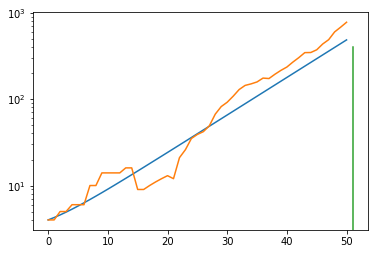

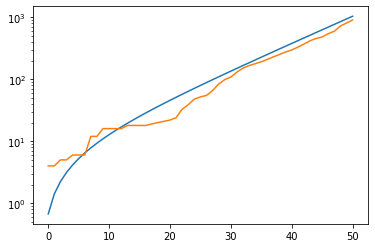

total error: 0.032135892659425735


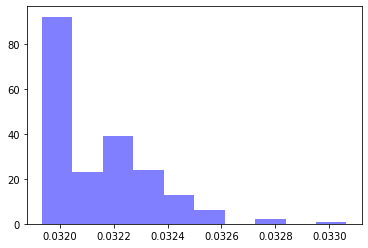

alpha: 0.99998957 , beta: 0.2187621 , initial_unconfirmed 5.565836 , t0s 4.7148666 , lambds 0.0008866413


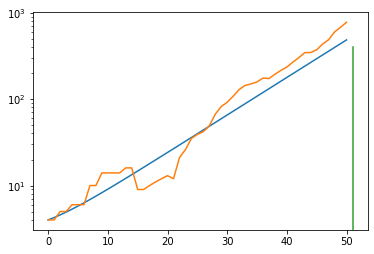

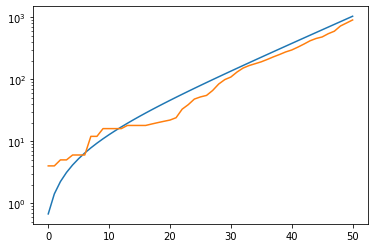

total error: 0.032062873244285583


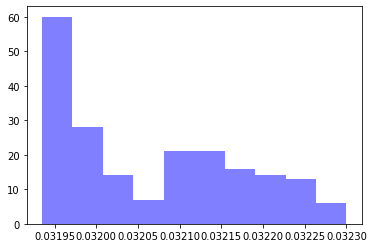

alpha: 0.99998957 , beta: 0.21875907 , initial_unconfirmed 5.5660095 , t0s 4.719554 , lambds 0.0004274898


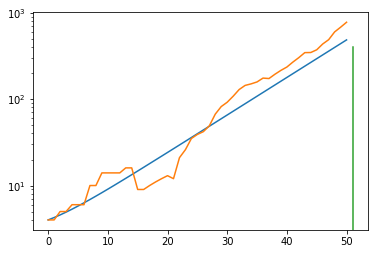

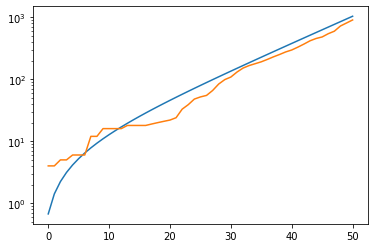

Cook Islands
Canada
total error: 7.360991954803467


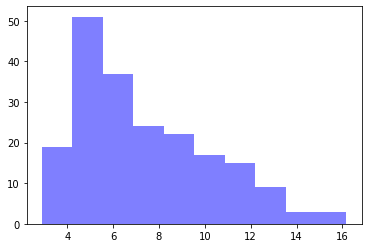

alpha: 0.9921154 , beta: 0.31420544 , initial_unconfirmed 44.98808 , t0s 0.32750922 , lambds 0.5579347


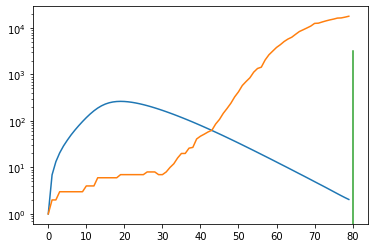

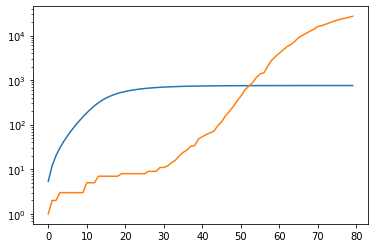

total error: 0.40721839666366577


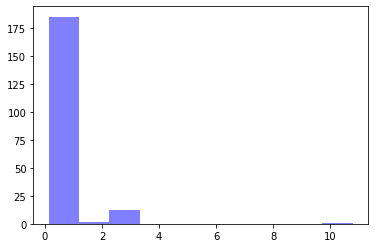

alpha: 0.9875106 , beta: 0.2568723 , initial_unconfirmed 0.75659317 , t0s 5.728482 , lambds 0.00050498487


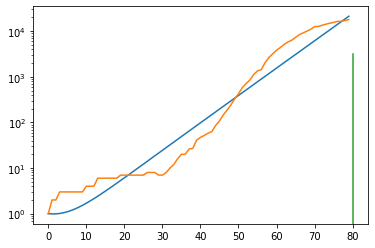

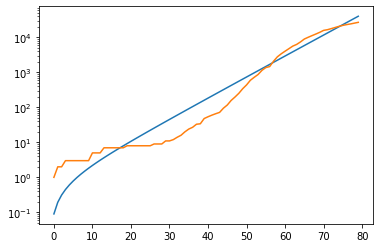

total error: 0.1809219866991043


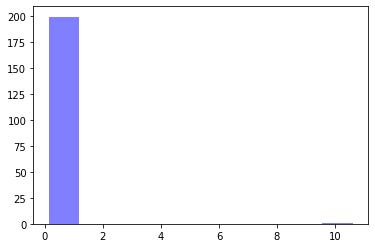

alpha: 0.9884131 , beta: 0.2569629 , initial_unconfirmed 0.75715274 , t0s 5.7332463 , lambds 0.00026156363


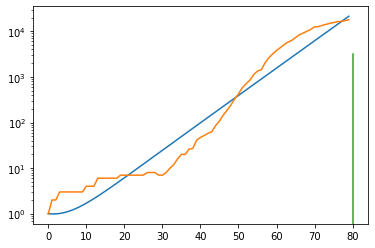

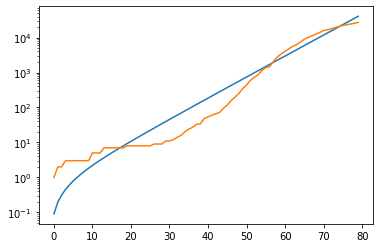

total error: 0.1808374971151352


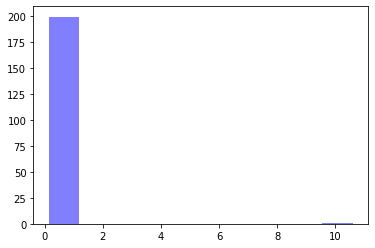

alpha: 0.9897747 , beta: 0.25695607 , initial_unconfirmed 0.75619787 , t0s 5.7351546 , lambds 0.00015790173


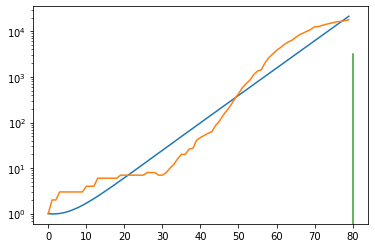

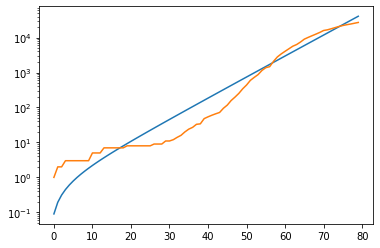

total error: 0.18077293038368225


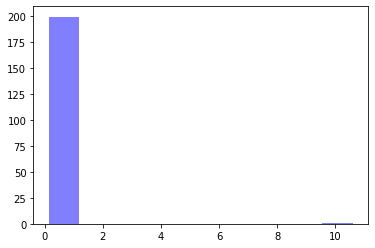

alpha: 0.9913403 , beta: 0.25695223 , initial_unconfirmed 0.75503826 , t0s 5.736169 , lambds 9.966224e-05


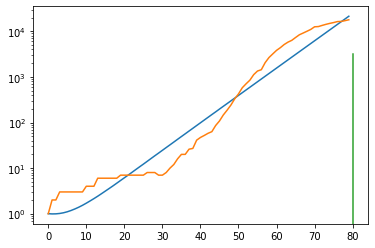

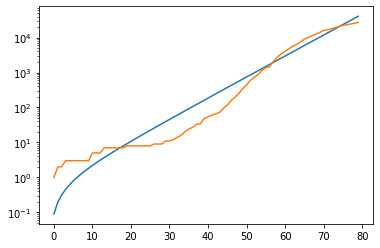

South Korea
total error: 6.714598178863525


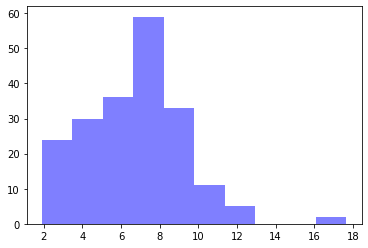

alpha: 0.88369894 , beta: 0.6959862 , initial_unconfirmed 2.8243482 , t0s 0.6759357 , lambds 0.5250755


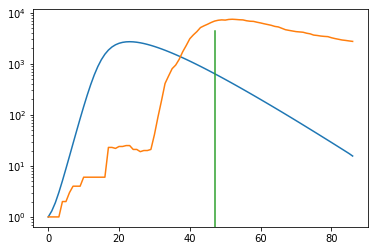

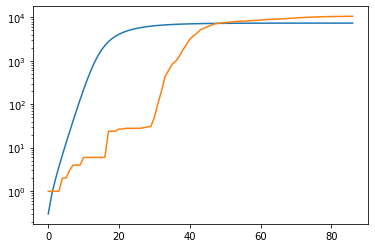

total error: 0.5664151906967163


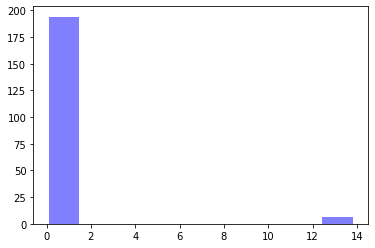

alpha: 0.50357413 , beta: 0.3185957 , initial_unconfirmed 2.0337954 , t0s 4.7098484 , lambds 0.14888023


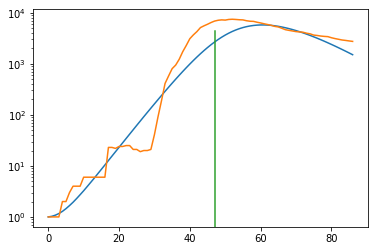

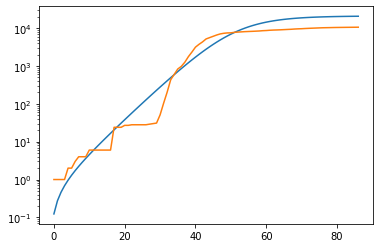

total error: 0.5015816688537598


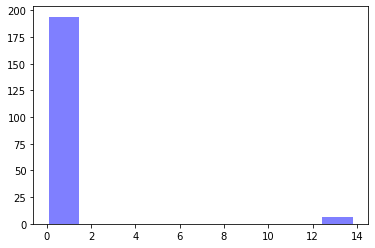

alpha: 0.9991331 , beta: 0.31017387 , initial_unconfirmed 1.1072913 , t0s 24.012072 , lambds 0.25976518


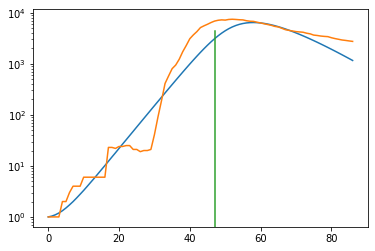

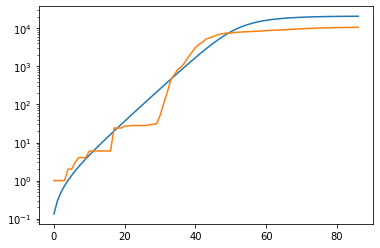

total error: 0.501397967338562


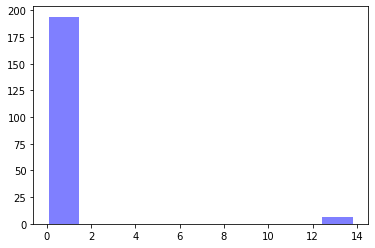

alpha: 0.9775254 , beta: 0.310302 , initial_unconfirmed 1.1300856 , t0s 23.641218 , lambds 0.256053


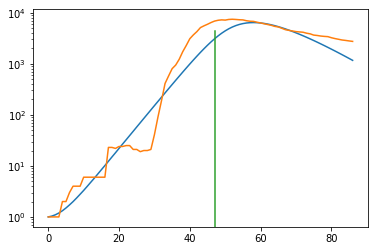

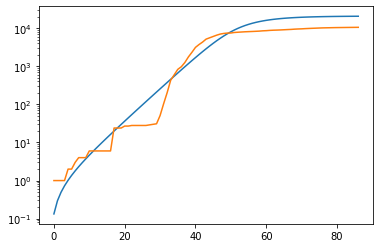

total error: 0.501206636428833


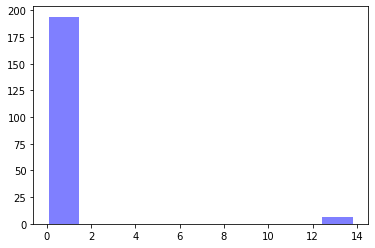

alpha: 0.9997257 , beta: 0.3102853 , initial_unconfirmed 1.1051928 , t0s 23.695995 , lambds 0.25660756


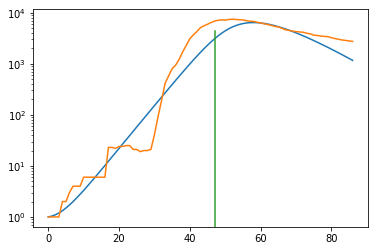

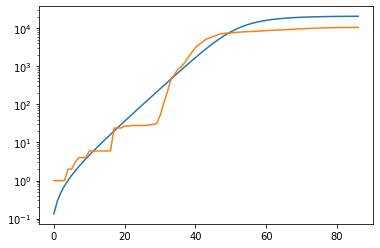

Croatia
total error: 5.180214881896973


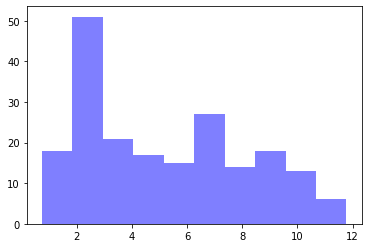

alpha: 0.9993416 , beta: 0.44038674 , initial_unconfirmed 21.064585 , t0s 0.58092606 , lambds 0.65489596


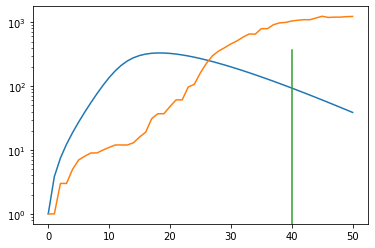

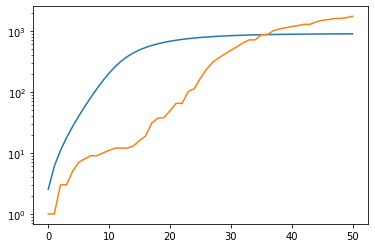

total error: 0.21542277932167053


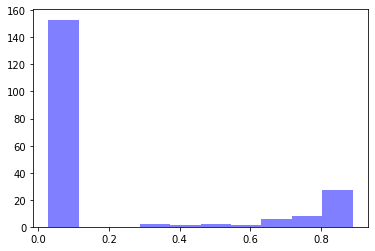

alpha: 0.50809294 , beta: 0.28907207 , initial_unconfirmed 7.6712503 , t0s 3.5579698 , lambds 0.18997559


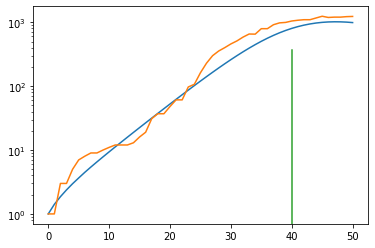

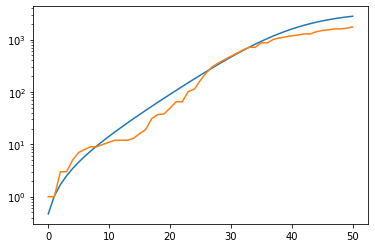

total error: 0.03099089302122593


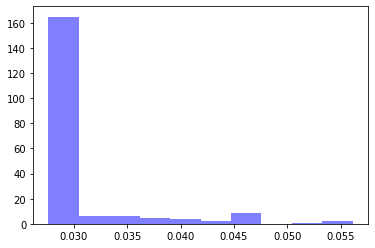

alpha: 0.99932957 , beta: 0.28235516 , initial_unconfirmed 4.0999646 , t0s 20.59663 , lambds 0.3917245


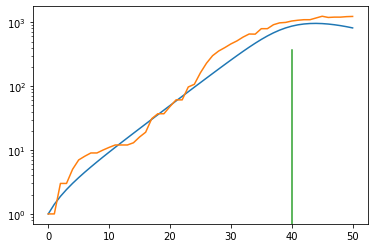

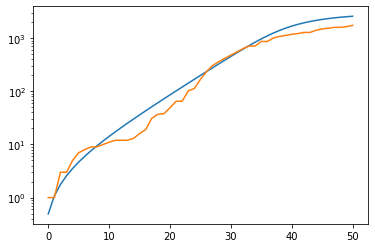

total error: 0.02875644527375698


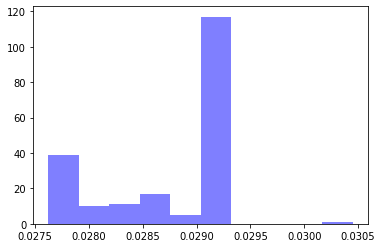

alpha: 0.99932027 , beta: 0.28265312 , initial_unconfirmed 4.072047 , t0s 20.723953 , lambds 0.39564458


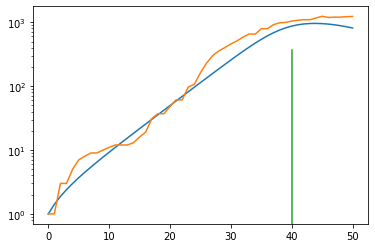

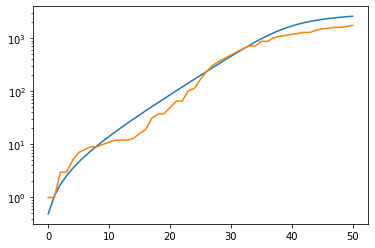

total error: 0.028695983812212944


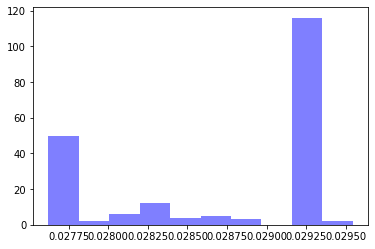

alpha: 0.99932027 , beta: 0.28265312 , initial_unconfirmed 4.072047 , t0s 20.723953 , lambds 0.39564458


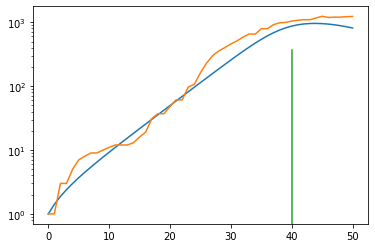

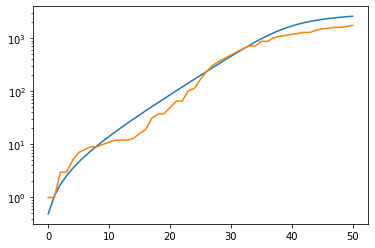

Bosnia and Herzegovina
total error: 3.9483556747436523


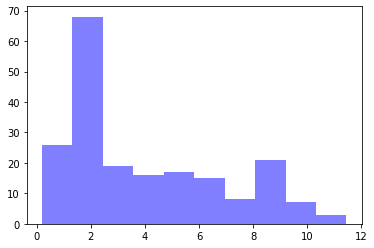

alpha: 0.9841951 , beta: 0.46391323 , initial_unconfirmed 5.2187414 , t0s 0.5584525 , lambds 0.53955716


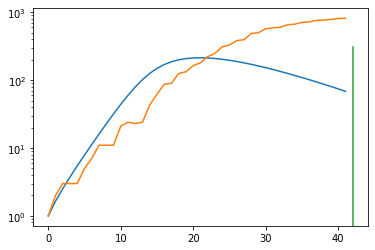

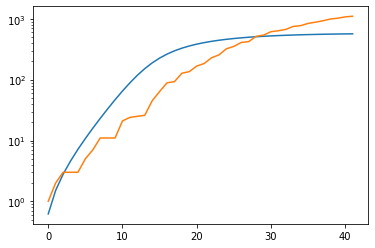

total error: 0.08917236328125


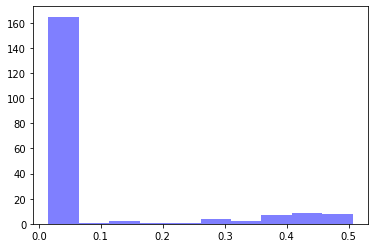

alpha: 0.7145245 , beta: 0.32076642 , initial_unconfirmed 7.2309666 , t0s 0.0 , lambds 0.23786274


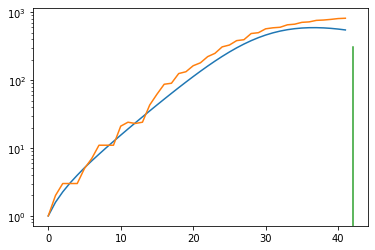

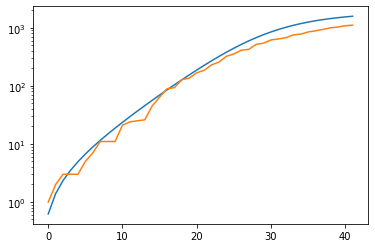

total error: 0.01611088588833809


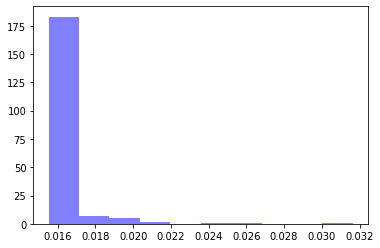

alpha: 0.5034865 , beta: 0.32076824 , initial_unconfirmed 10.261683 , t0s 0.0 , lambds 0.23784526


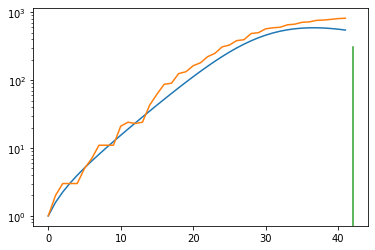

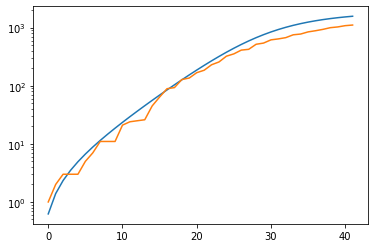

total error: 0.015557002276182175


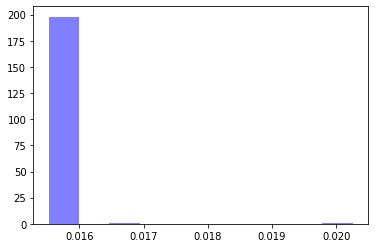

alpha: 0.5034865 , beta: 0.32076824 , initial_unconfirmed 10.261683 , t0s 0.0 , lambds 0.23784526


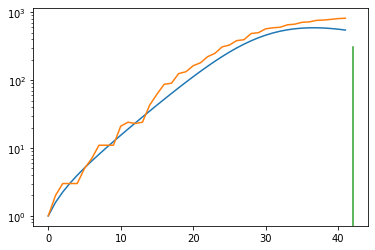

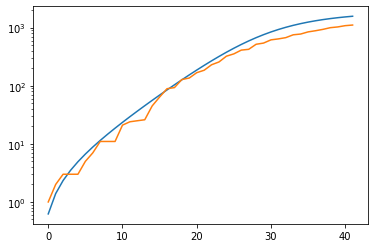

total error: 0.015535403043031693


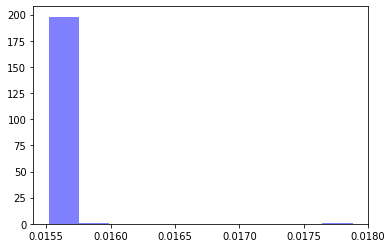

alpha: 0.5034865 , beta: 0.32076824 , initial_unconfirmed 10.261683 , t0s 0.0 , lambds 0.23784526


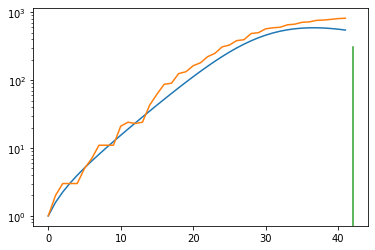

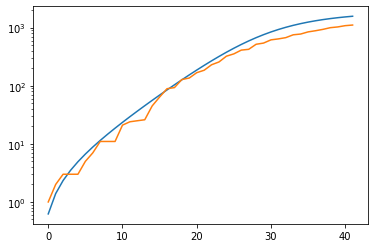

Malta
total error: 3.1493444442749023


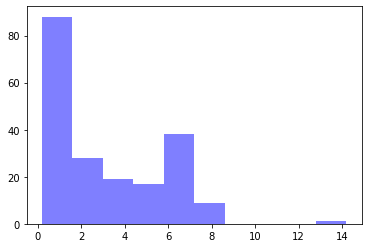

alpha: 0.84411144 , beta: 0.42183462 , initial_unconfirmed 15.456414 , t0s 0.064124286 , lambds 0.71038646


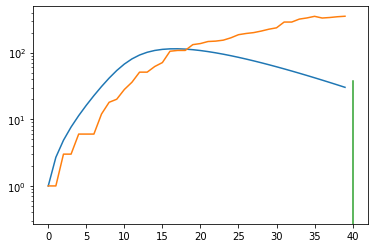

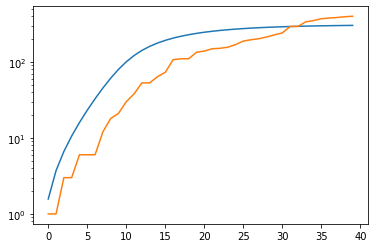

total error: 0.08029323816299438


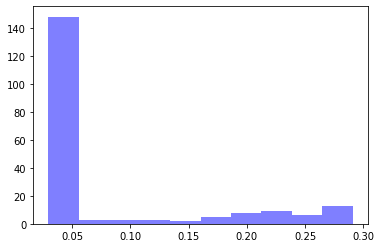

alpha: 0.50316554 , beta: 0.29460275 , initial_unconfirmed 14.5389385 , t0s 0.0 , lambds 0.27786085


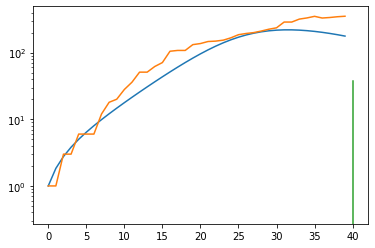

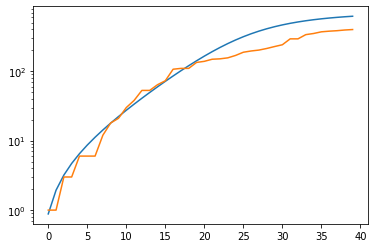

total error: 0.030444784089922905


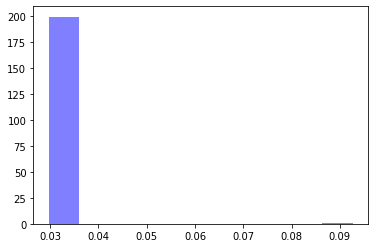

alpha: 0.5009715 , beta: 0.29468426 , initial_unconfirmed 14.5899315 , t0s 0.0 , lambds 0.27793723


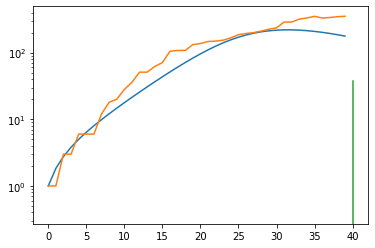

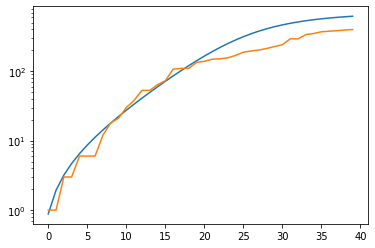

total error: 0.029983147978782654


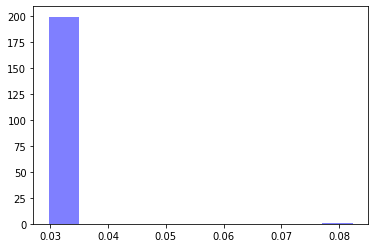

alpha: 0.5003568 , beta: 0.29469267 , initial_unconfirmed 14.606477 , t0s 0.0 , lambds 0.27794313


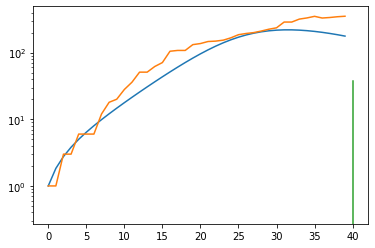

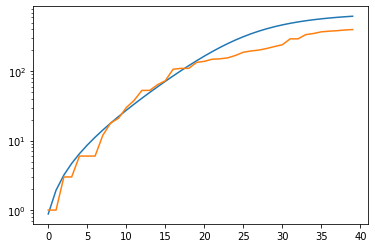

total error: 0.02993619628250599


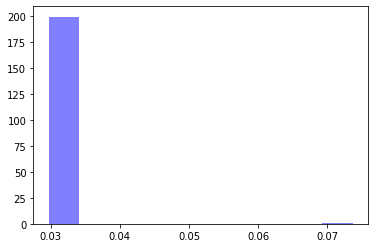

alpha: 0.5003568 , beta: 0.29469267 , initial_unconfirmed 14.606477 , t0s 0.0 , lambds 0.27794313


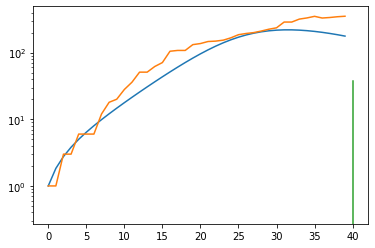

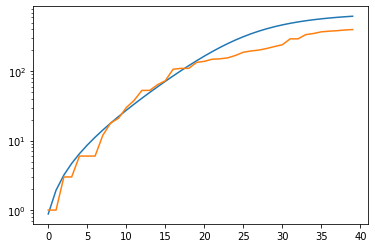

Niger
total error: 3.4295763969421387


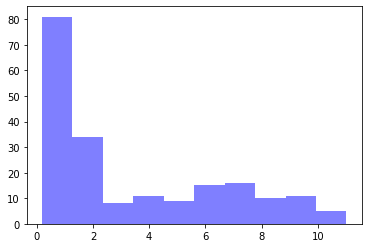

alpha: 0.9997754 , beta: 0.68384624 , initial_unconfirmed 2.2110343 , t0s 0.40688527 , lambds 0.7258185


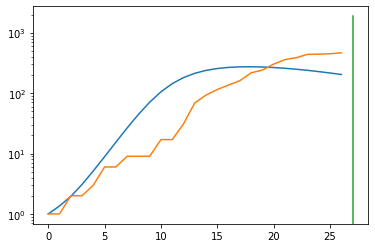

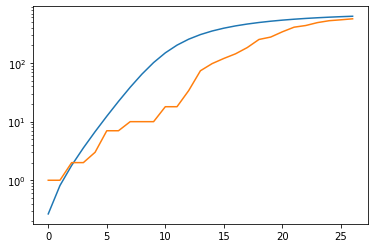

total error: 0.09960028529167175


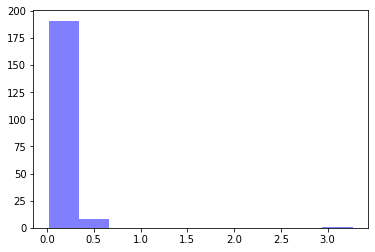

alpha: 0.5063289 , beta: 0.40626174 , initial_unconfirmed 6.116634 , t0s 4.3217998 , lambds 0.430277


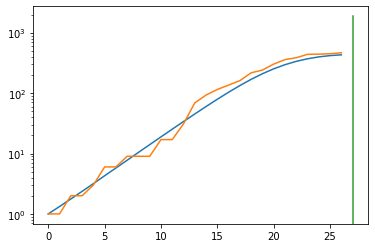

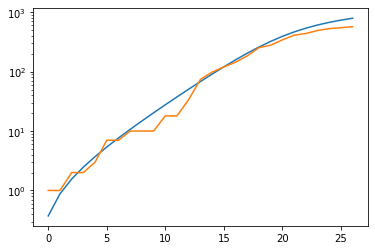

total error: 0.03305080533027649


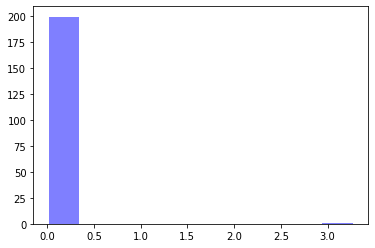

alpha: 0.9988617 , beta: 0.3976611 , initial_unconfirmed 3.2205682 , t0s 12.360674 , lambds 0.92703384


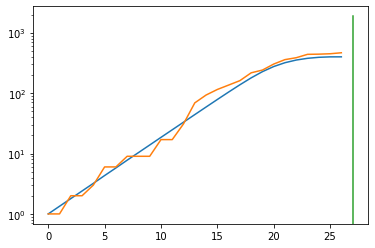

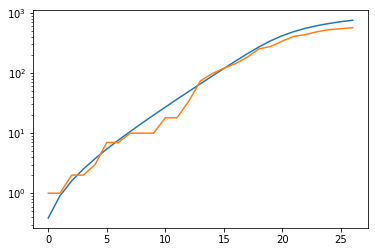

total error: 0.03240155801177025


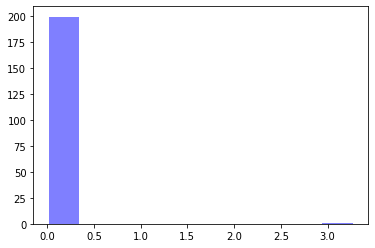

alpha: 0.9827061 , beta: 0.39812008 , initial_unconfirmed 3.2550066 , t0s 12.499615 , lambds 0.9485087


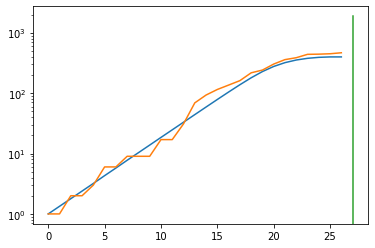

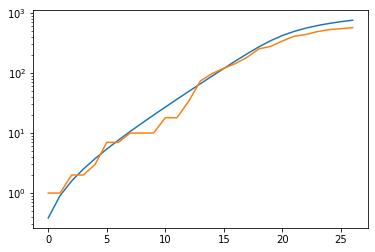

total error: 0.032379139214754105


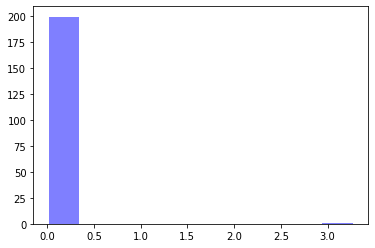

alpha: 0.98467296 , beta: 0.39801723 , initial_unconfirmed 3.2504687 , t0s 12.625365 , lambds 0.9661065


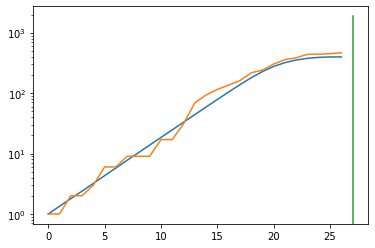

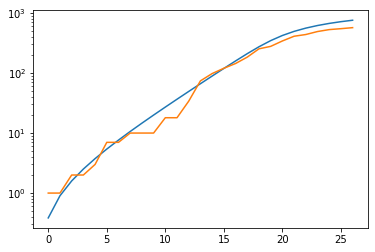

Tonga
Cocos (Keeling) Islands
Armenia
total error: 4.512895584106445


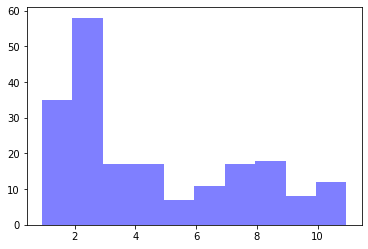

alpha: 0.99565005 , beta: 0.32109788 , initial_unconfirmed 7.323617 , t0s 0.07868171 , lambds 0.5305779


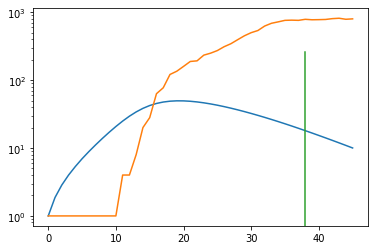

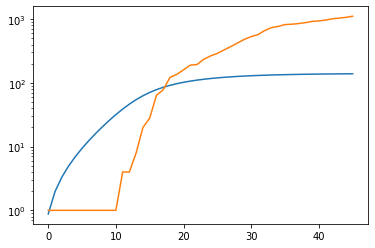

total error: 0.34660670161247253


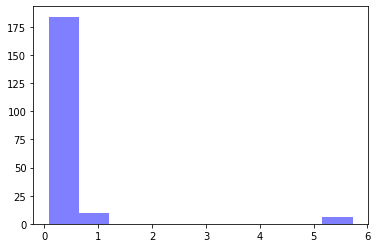

alpha: 0.50461084 , beta: 0.42317545 , initial_unconfirmed 1.2185111 , t0s 0.0 , lambds 0.2582288


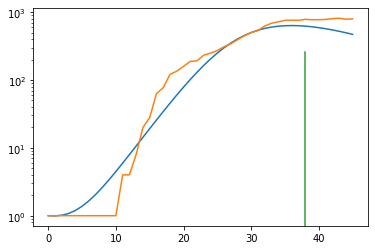

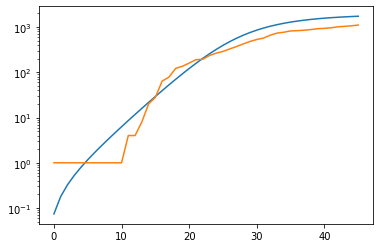

total error: 0.24832972884178162


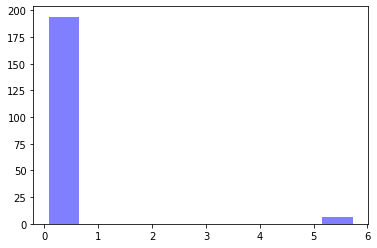

alpha: 0.50259024 , beta: 0.4232013 , initial_unconfirmed 1.2231346 , t0s 0.0 , lambds 0.2582416


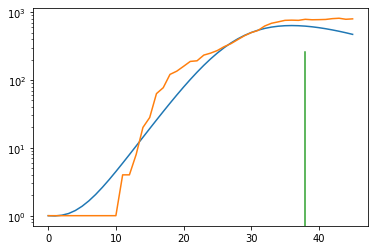

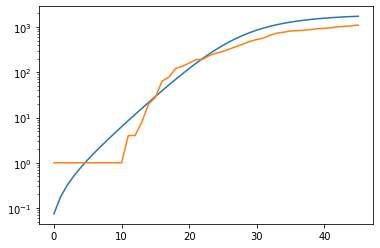

total error: 0.24831226468086243


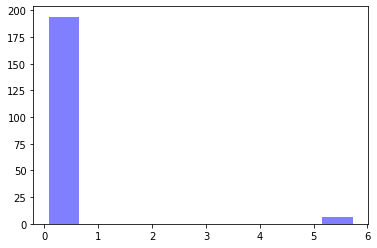

alpha: 0.50259024 , beta: 0.4232013 , initial_unconfirmed 1.2231346 , t0s 0.0 , lambds 0.2582416


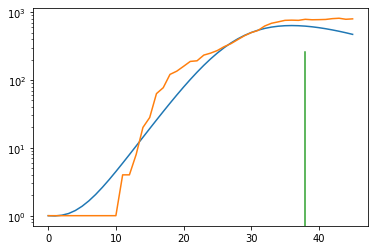

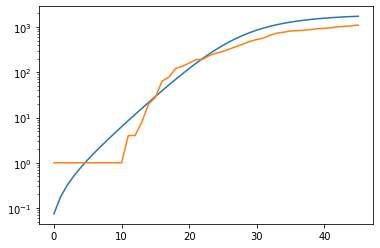

total error: 0.2483312040567398


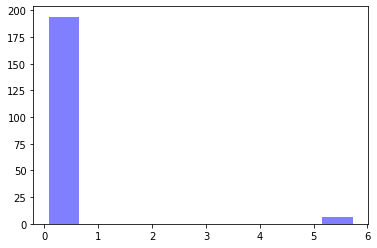

alpha: 0.50259024 , beta: 0.4232013 , initial_unconfirmed 1.2231346 , t0s 0.0 , lambds 0.2582416


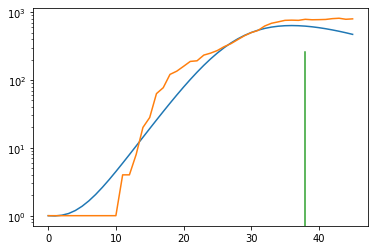

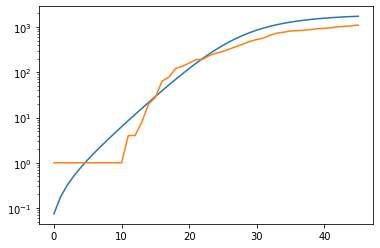

Bouvet Island
Dominican Republic
total error: 4.84611701965332


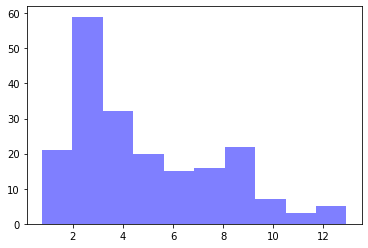

alpha: 0.9997659 , beta: 0.8631188 , initial_unconfirmed 0.11688769 , t0s 0.018345892 , lambds 0.6222585


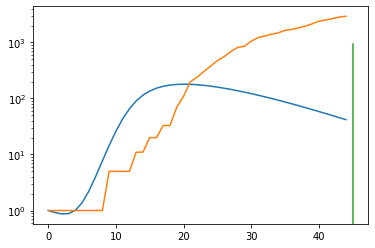

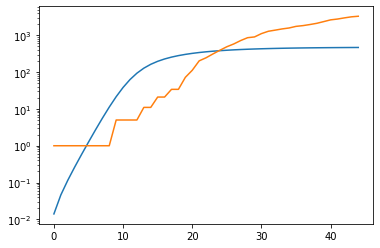

total error: 0.26301825046539307


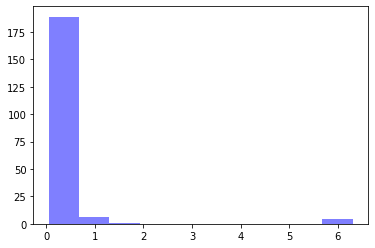

alpha: 0.9982281 , beta: 0.4062314 , initial_unconfirmed 0.74127626 , t0s 4.1476917 , lambds 0.25202203


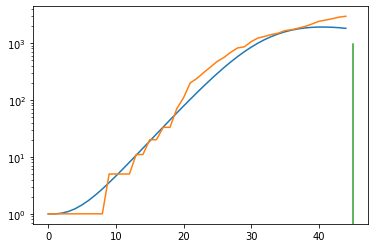

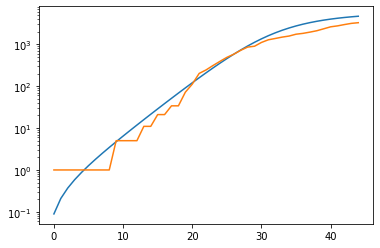

total error: 0.17416512966156006


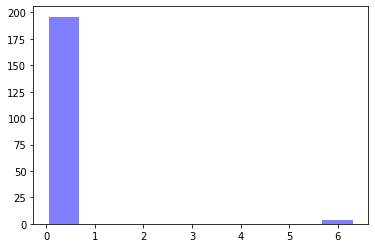

alpha: 0.9999854 , beta: 0.4017629 , initial_unconfirmed 0.7600582 , t0s 9.0499115 , lambds 0.3103767


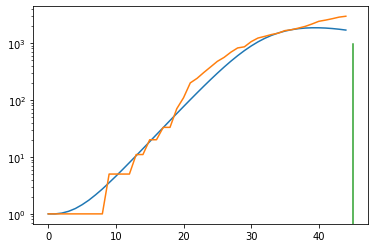

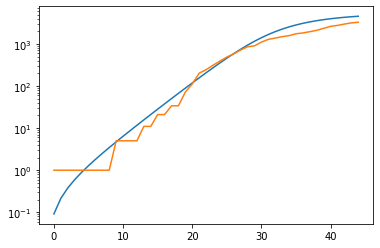

total error: 0.1741209775209427


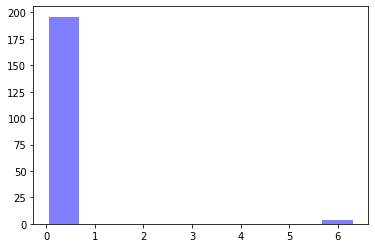

alpha: 0.9999854 , beta: 0.40191954 , initial_unconfirmed 0.7592479 , t0s 8.883925 , lambds 0.3079632


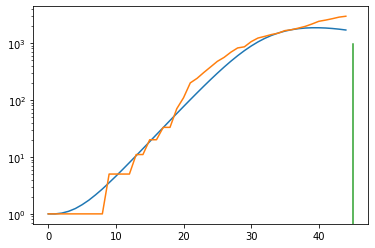

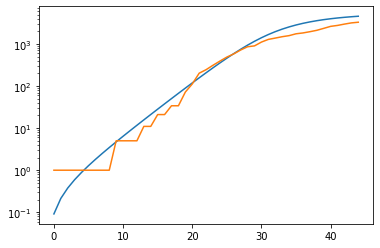

total error: 0.17410266399383545


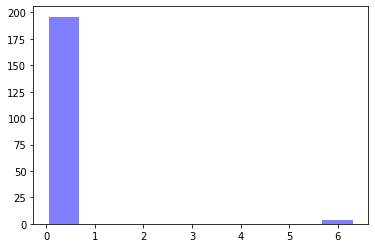

alpha: 0.999966 , beta: 0.40195656 , initial_unconfirmed 0.7590709 , t0s 8.84519 , lambds 0.3074374


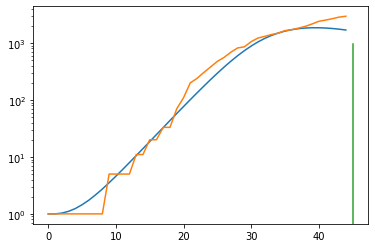

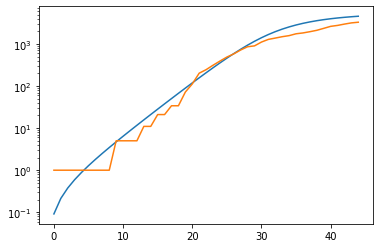

Suriname
total error: 5.116882801055908


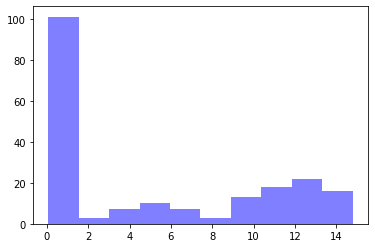

alpha: 0.9997997 , beta: 0.17508167 , initial_unconfirmed 2.8767824 , t0s 0.03502667 , lambds 0.57366794


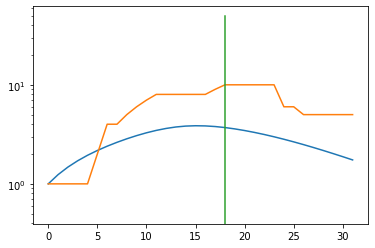

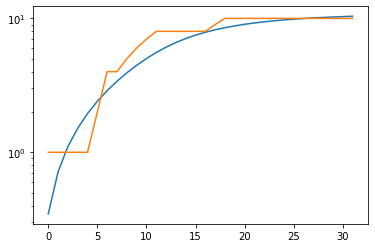

total error: 0.08269684761762619


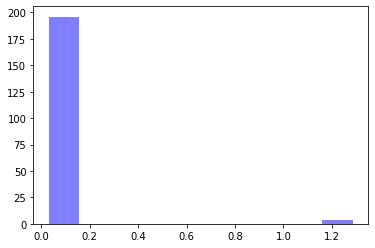

alpha: 0.5064959 , beta: 0.23361762 , initial_unconfirmed 5.1266613 , t0s 0.0 , lambds 0.534821


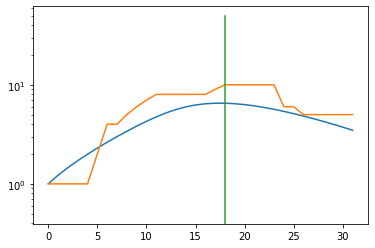

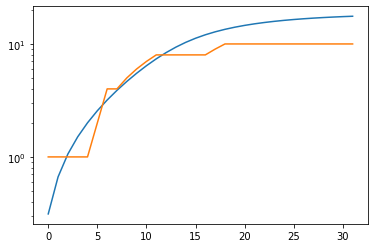

total error: 0.0641506090760231


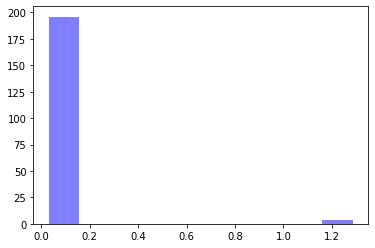

alpha: 0.5064959 , beta: 0.23361762 , initial_unconfirmed 5.1266613 , t0s 0.0 , lambds 0.534821


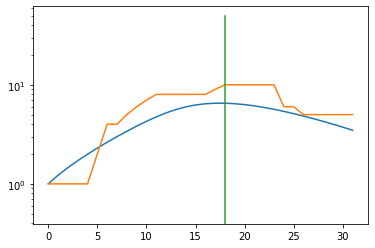

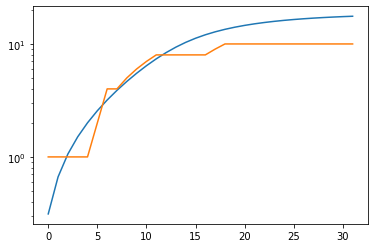

total error: 0.05842520296573639


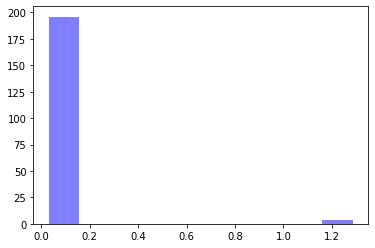

alpha: 0.5064959 , beta: 0.23361762 , initial_unconfirmed 5.1266613 , t0s 0.0 , lambds 0.534821


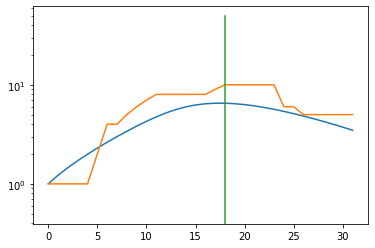

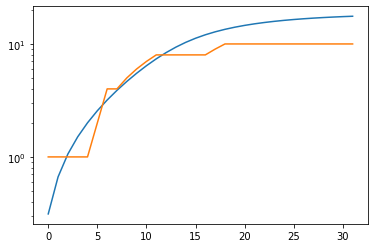

total error: 0.05792916193604469


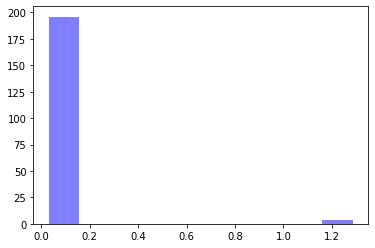

alpha: 0.5064959 , beta: 0.23361762 , initial_unconfirmed 5.1266613 , t0s 0.0 , lambds 0.534821


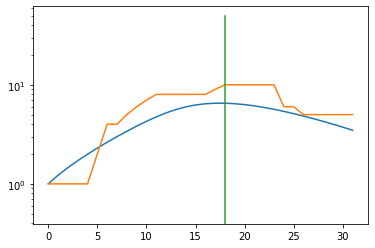

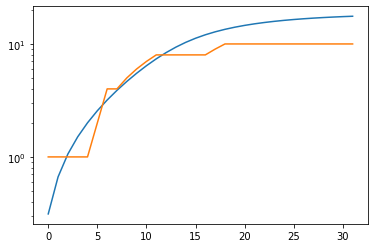

St. Pierre and Miquelon
total error: 3.417808771133423


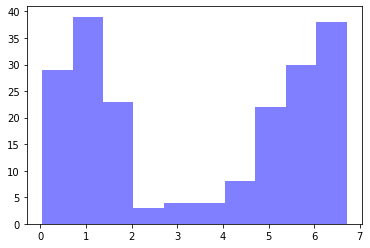

alpha: 0.87085366 , beta: 0.0020889242 , initial_unconfirmed 2.9860795 , t0s 0.82001424 , lambds 0.5973672


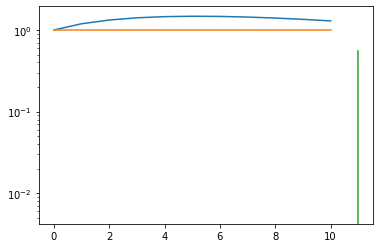

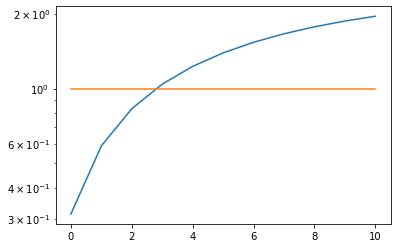

total error: 0.033043090254068375


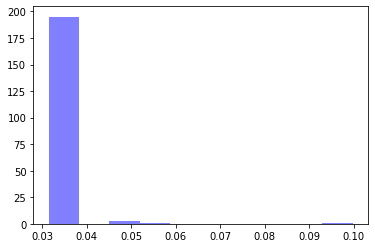

alpha: 0.5009667 , beta: 3.7533394e-07 , initial_unconfirmed 4.148144 , t0s 0.0 , lambds 0.90552354


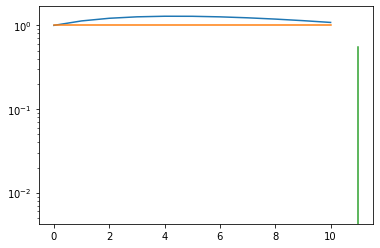

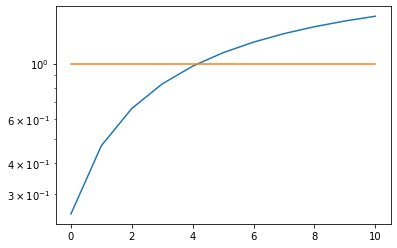

total error: 0.032526593655347824


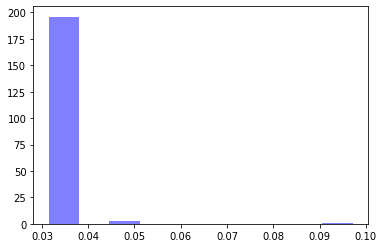

alpha: 0.50096667 , beta: 3.616022e-07 , initial_unconfirmed 4.1482344 , t0s 0.0 , lambds 0.90601087


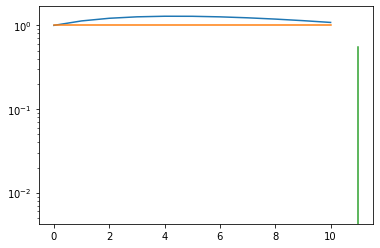

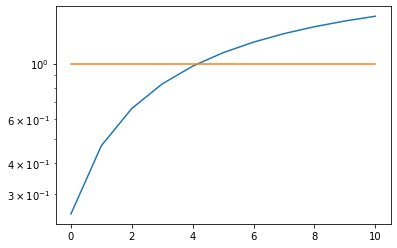

total error: 0.032321181148290634


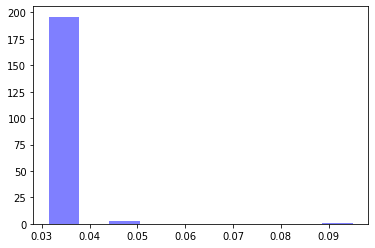

alpha: 0.50096667 , beta: 2.6692084e-07 , initial_unconfirmed 4.148197 , t0s 0.0 , lambds 0.90884507


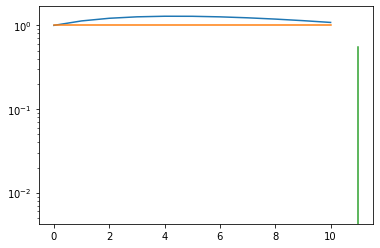

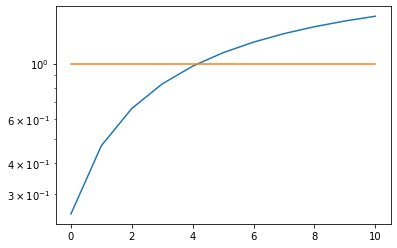

total error: 0.03220195695757866


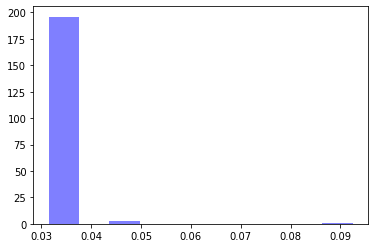

alpha: 0.99873686 , beta: 2.0131667e-07 , initial_unconfirmed 2.080737 , t0s 0.0 , lambds 0.7637229


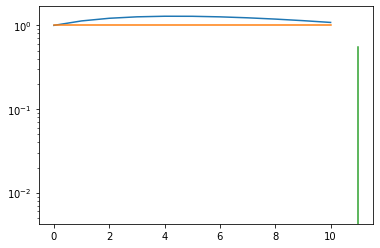

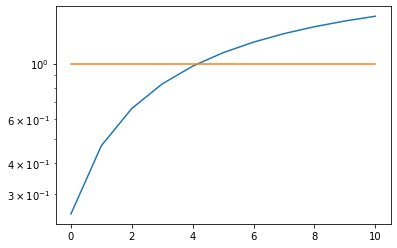

Guadeloupe
total error: 3.0131540298461914


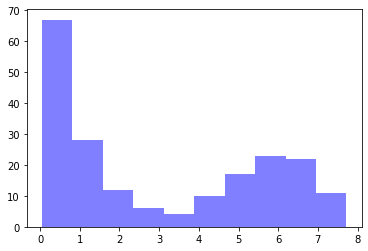

alpha: 0.96872735 , beta: 0.23400135 , initial_unconfirmed 26.997528 , t0s 0.59923804 , lambds 0.52480376


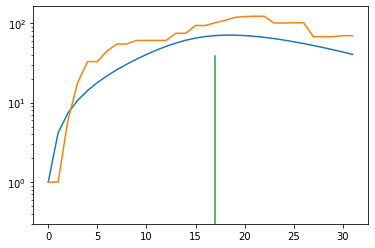

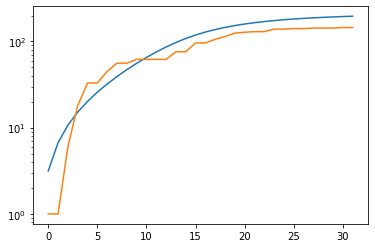

total error: 0.04653899371623993


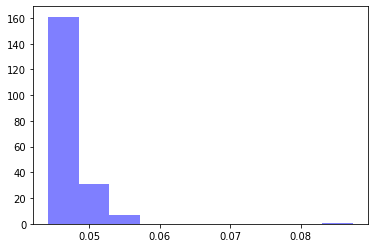

alpha: 0.65326226 , beta: 0.35271227 , initial_unconfirmed 25.018635 , t0s 0.0 , lambds 0.67633885


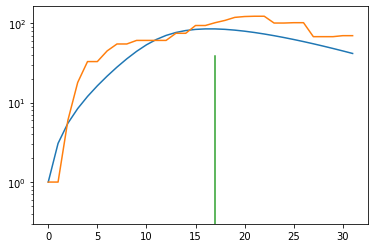

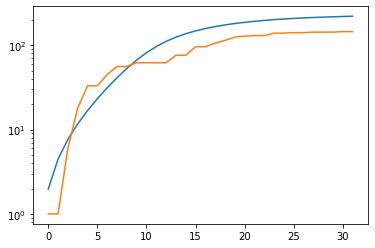

total error: 0.044953037053346634


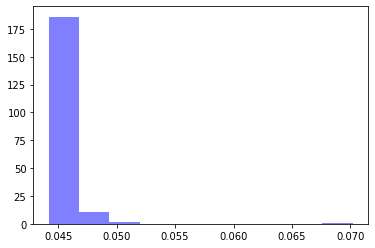

alpha: 0.5193484 , beta: 0.35273427 , initial_unconfirmed 31.470356 , t0s 0.0 , lambds 0.67633975


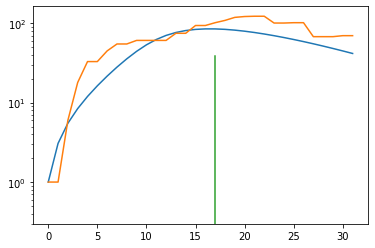

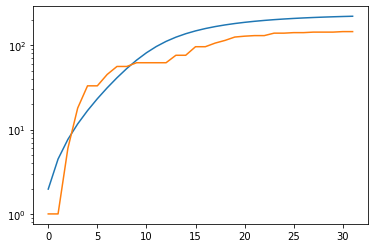

total error: 0.04457959160208702


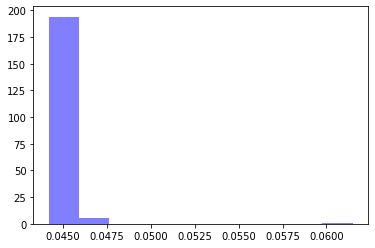

alpha: 0.50369024 , beta: 0.3529691 , initial_unconfirmed 32.426826 , t0s 0.0 , lambds 0.6767782


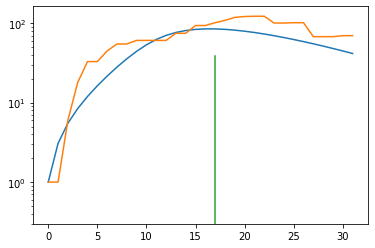

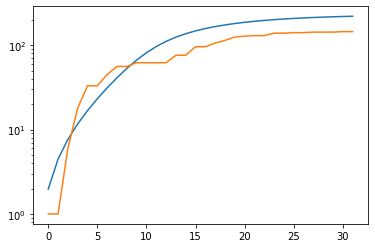

total error: 0.04444478079676628


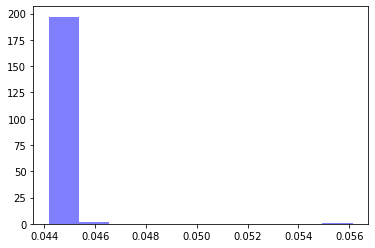

alpha: 0.5035168 , beta: 0.35328293 , initial_unconfirmed 32.404984 , t0s 0.0 , lambds 0.67734015


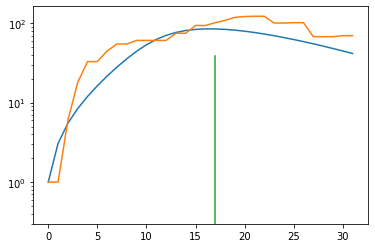

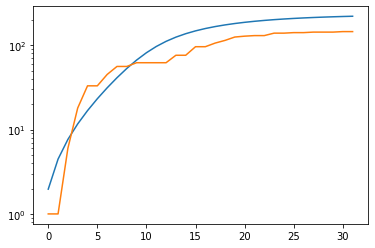

Svalbard and Jan Mayen Islands
Romania
total error: 4.390322685241699


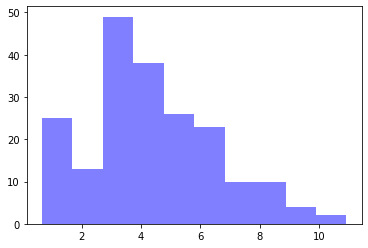

alpha: 0.98988545 , beta: 0.5886188 , initial_unconfirmed 2.533433 , t0s 0.037720203 , lambds 0.5576239


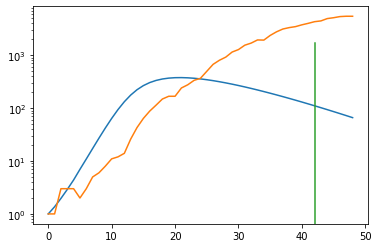

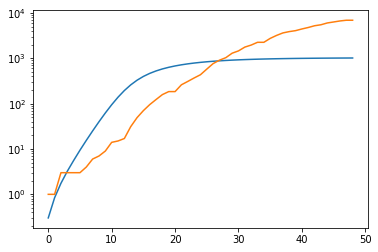

total error: 0.045349642634391785


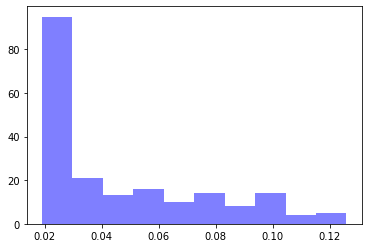

alpha: 0.5131615 , beta: 0.35840058 , initial_unconfirmed 6.095455 , t0s 0.0 , lambds 0.19553035


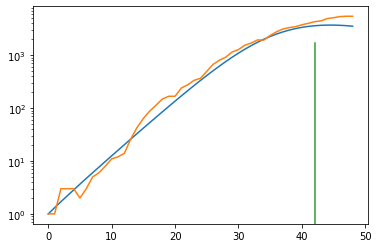

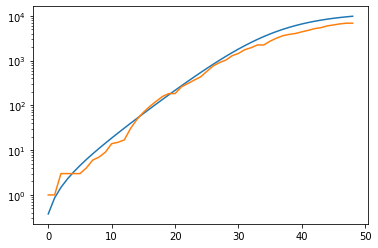

total error: 0.020685367286205292


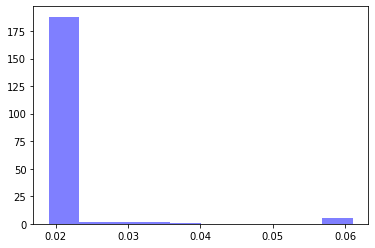

alpha: 0.5131615 , beta: 0.35840058 , initial_unconfirmed 6.095455 , t0s 0.0 , lambds 0.19553035


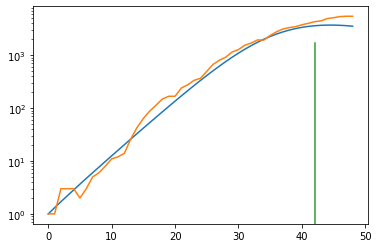

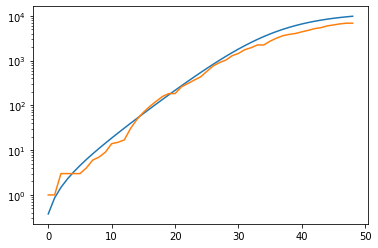

total error: 0.019091250374913216


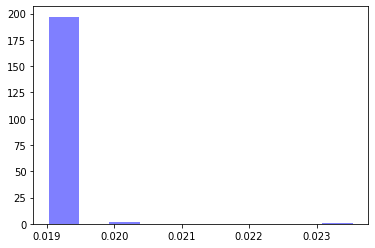

alpha: 0.5131615 , beta: 0.35840058 , initial_unconfirmed 6.095455 , t0s 0.0 , lambds 0.19553035


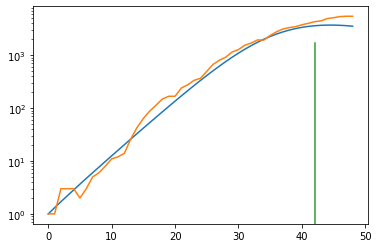

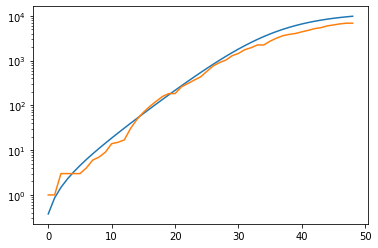

total error: 0.01905570551753044


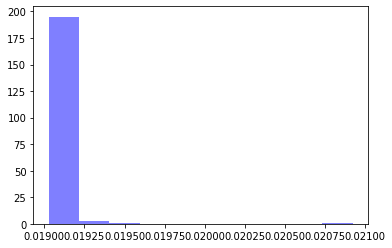

alpha: 0.5131615 , beta: 0.35840058 , initial_unconfirmed 6.095455 , t0s 0.0 , lambds 0.19553035


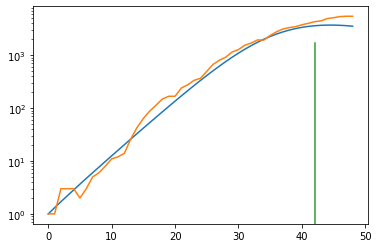

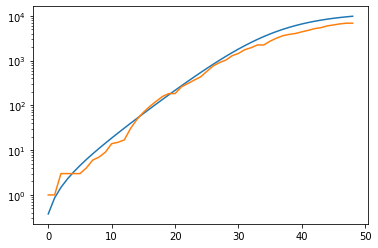

Micronesia, Fed. Sts.
Moldova
total error: 3.6122241020202637


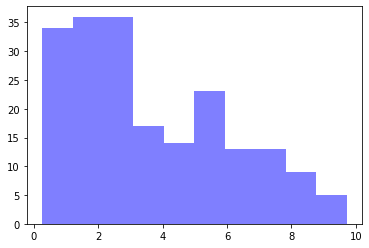

alpha: 0.9309051 , beta: 0.4102458 , initial_unconfirmed 8.568132 , t0s 0.8743023 , lambds 0.54128754


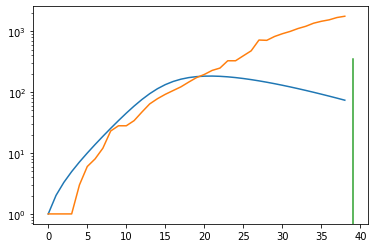

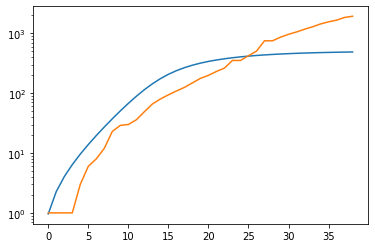

total error: 0.08256611227989197


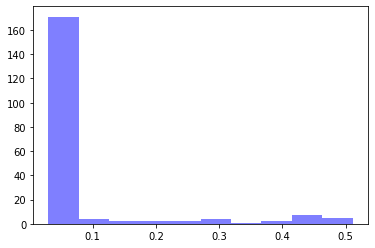

alpha: 0.5045236 , beta: 0.3459715 , initial_unconfirmed 9.701481 , t0s 0.0 , lambds 0.23885928


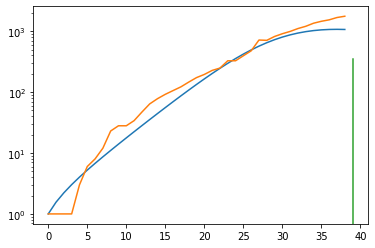

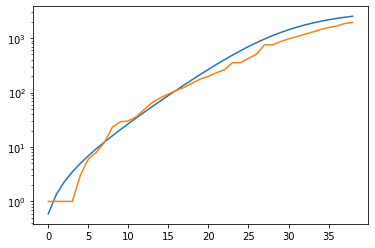

total error: 0.03004346787929535


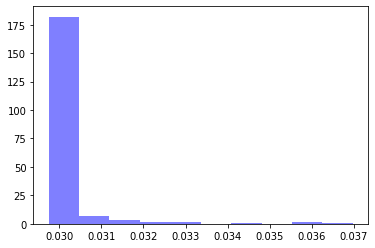

alpha: 0.5045226 , beta: 0.34597778 , initial_unconfirmed 9.700452 , t0s 0.0 , lambds 0.23886482


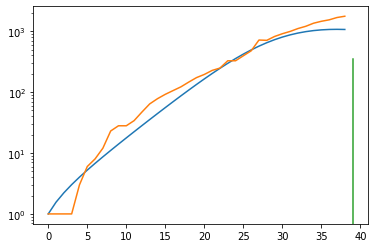

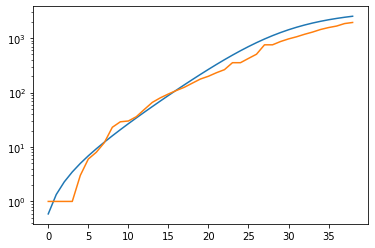

total error: 0.029755614697933197


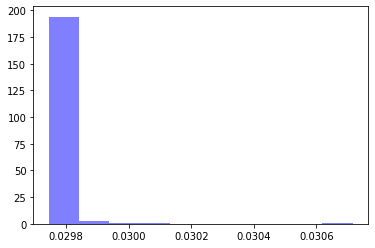

alpha: 0.5045226 , beta: 0.34597778 , initial_unconfirmed 9.700452 , t0s 0.0 , lambds 0.23886482


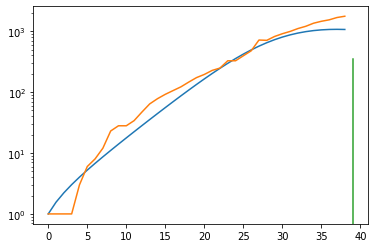

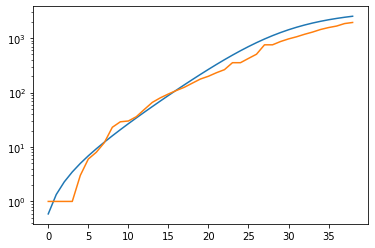

total error: 0.029750145971775055


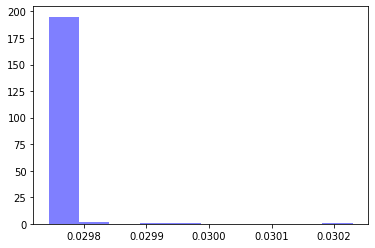

alpha: 0.5045226 , beta: 0.34597778 , initial_unconfirmed 9.700452 , t0s 0.0 , lambds 0.23886482


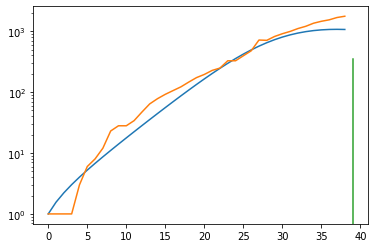

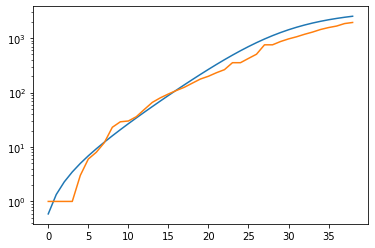

Namibia
total error: 5.870102405548096


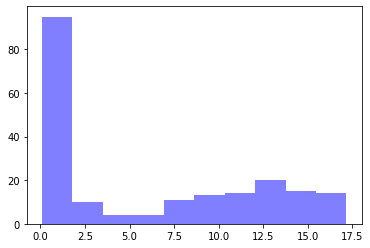

alpha: 0.9927996 , beta: 0.2181197 , initial_unconfirmed 2.7587414 , t0s 0.7037703 , lambds 0.64810514


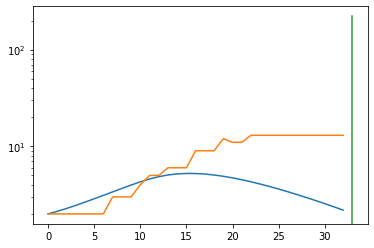

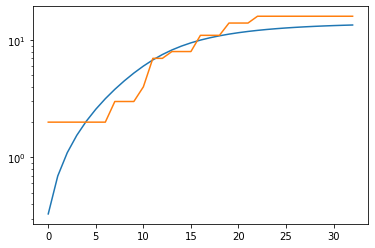

total error: 0.1112382635474205


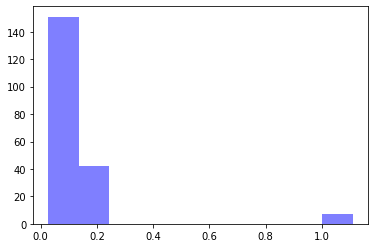

alpha: 0.9836564 , beta: 0.17742012 , initial_unconfirmed 3.2825024 , t0s 13.032371 , lambds 0.5300421


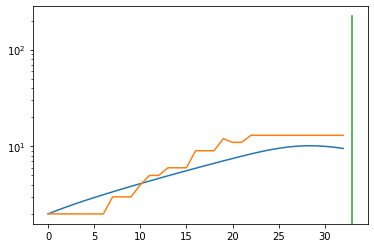

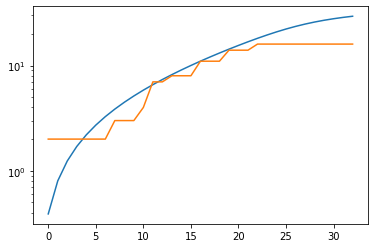

total error: 0.09801729023456573


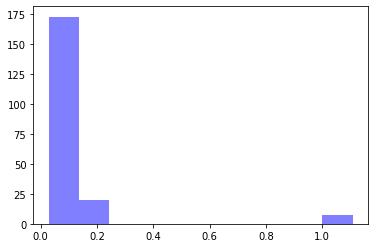

alpha: 0.9833896 , beta: 0.17789182 , initial_unconfirmed 3.2528942 , t0s 16.108416 , lambds 0.73064154


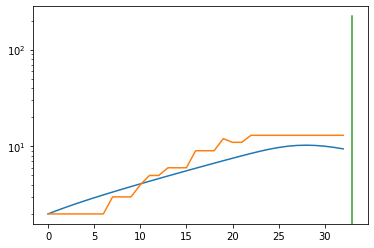

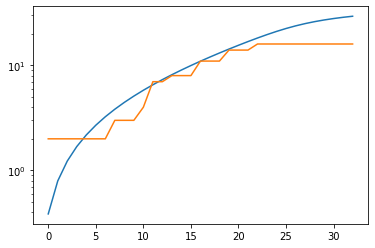

total error: 0.08598911017179489


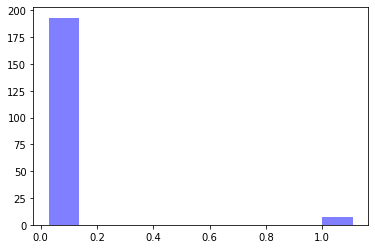

alpha: 0.5060508 , beta: 0.17798474 , initial_unconfirmed 6.3080206 , t0s 16.99286 , lambds 0.82081044


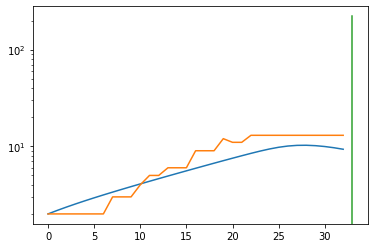

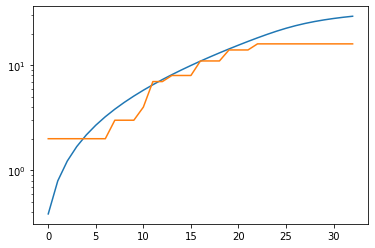

total error: 0.07621527463197708


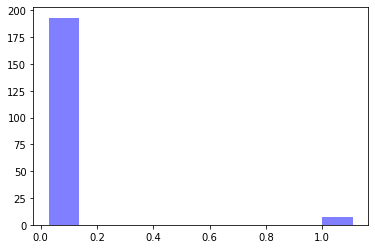

alpha: 0.9990713 , beta: 0.17786317 , initial_unconfirmed 3.2010207 , t0s 17.432487 , lambds 0.87311876


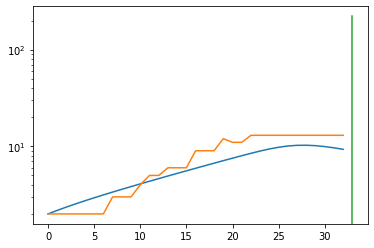

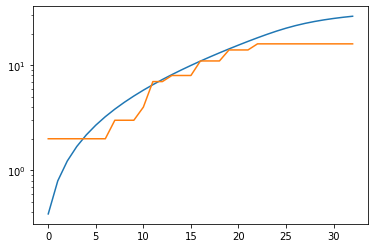

Mexico
total error: 4.305676460266113


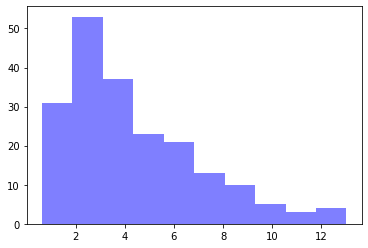

alpha: 0.999871 , beta: 0.5661748 , initial_unconfirmed 4.503563 , t0s 0.33972424 , lambds 0.5154228


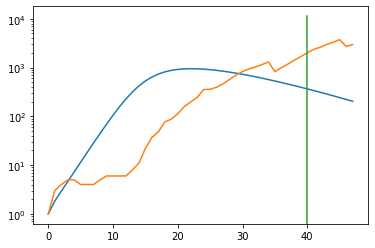

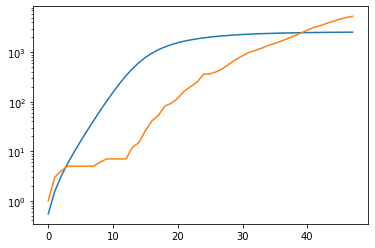

total error: 0.13883042335510254


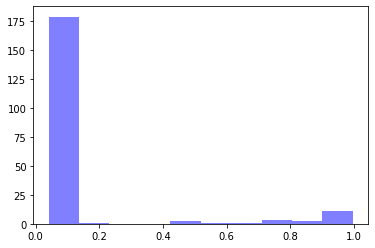

alpha: 0.5034124 , beta: 0.3238603 , initial_unconfirmed 6.3908405 , t0s 2.8942165 , lambds 0.19093093


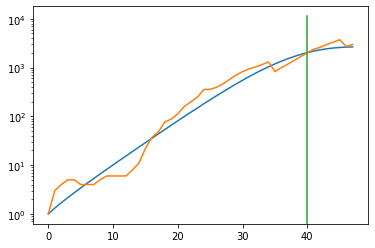

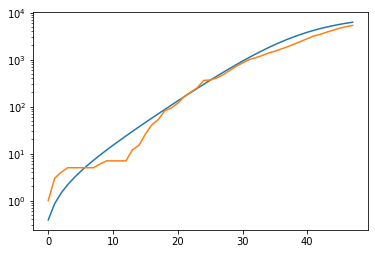

total error: 0.043550316244363785


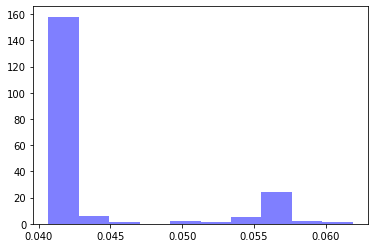

alpha: 0.50083536 , beta: 0.32377607 , initial_unconfirmed 6.448536 , t0s 3.2573185 , lambds 0.19313878


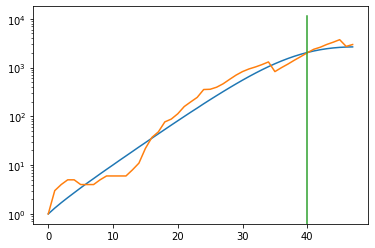

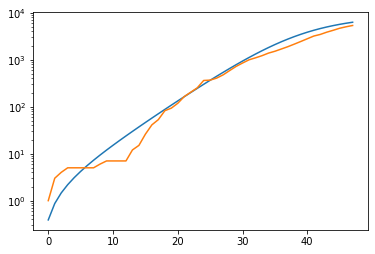

total error: 0.04074585810303688


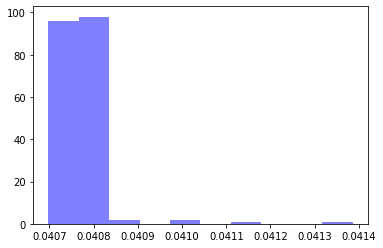

alpha: 0.50083536 , beta: 0.32377607 , initial_unconfirmed 6.448536 , t0s 3.2573185 , lambds 0.19313878


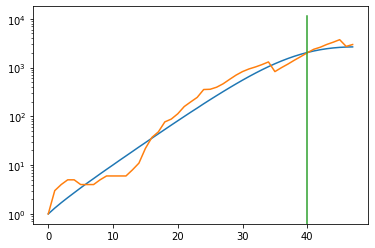

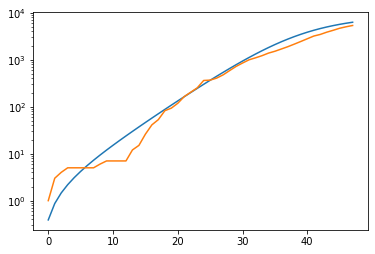

total error: 0.040738921612501144


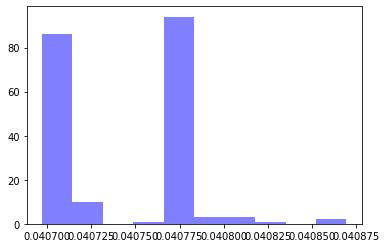

alpha: 0.50083536 , beta: 0.32377607 , initial_unconfirmed 6.448536 , t0s 3.2573185 , lambds 0.19313878


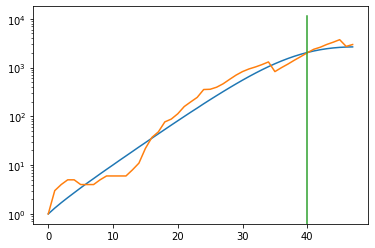

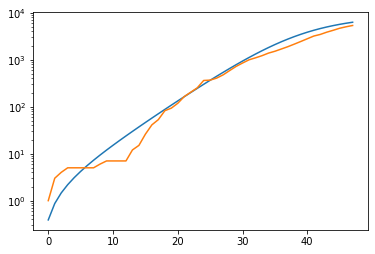

Gambia
total error: 4.500540733337402


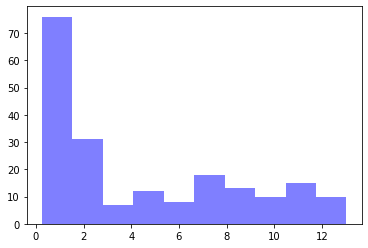

alpha: 0.9708575 , beta: 0.3656931 , initial_unconfirmed 6.79037 , t0s 0.97758913 , lambds 0.5957806


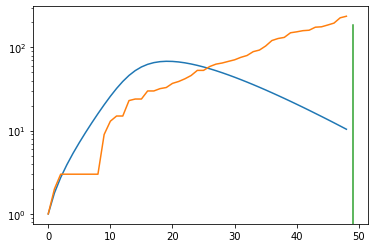

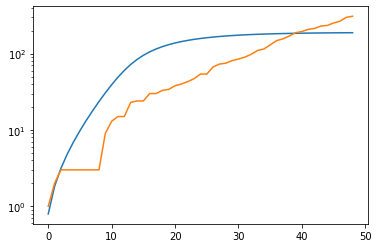

total error: 0.20572030544281006


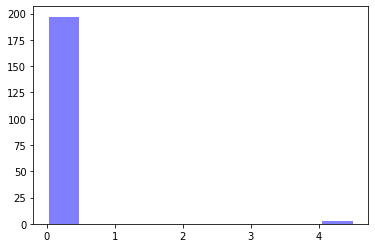

alpha: 0.59651005 , beta: 0.21906532 , initial_unconfirmed 8.992322 , t0s 0.0 , lambds 0.15381989


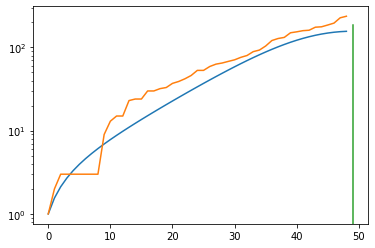

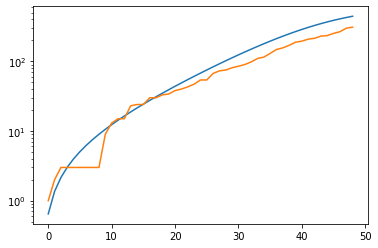

total error: 0.11366795748472214


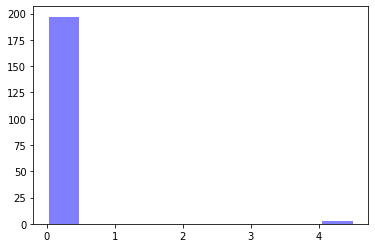

alpha: 0.50285816 , beta: 0.21897289 , initial_unconfirmed 10.68209 , t0s 0.0 , lambds 0.15364212


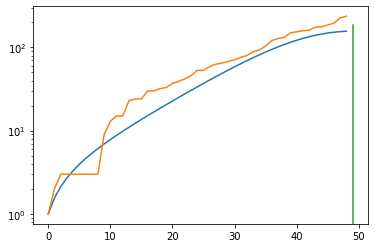

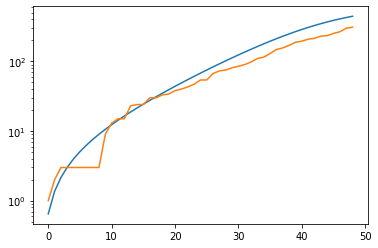

total error: 0.0950193777680397


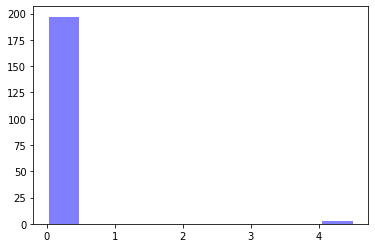

alpha: 0.5005486 , beta: 0.21897079 , initial_unconfirmed 10.731704 , t0s 0.0 , lambds 0.15363841


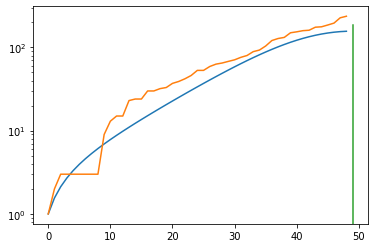

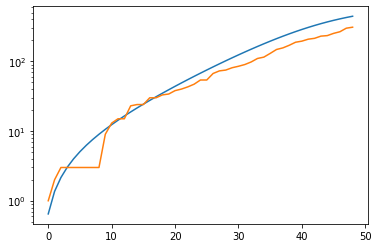

total error: 0.09498289227485657


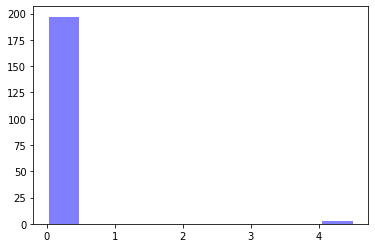

alpha: 0.5005486 , beta: 0.21897079 , initial_unconfirmed 10.731704 , t0s 0.0 , lambds 0.15363841


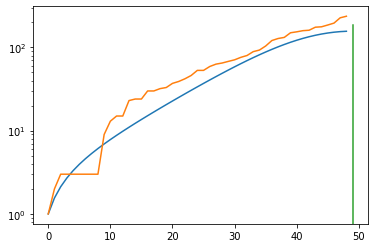

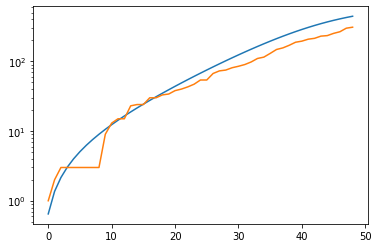

Poland
total error: 3.8015689849853516


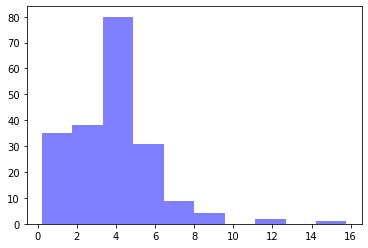

alpha: 0.8822839 , beta: 0.5169555 , initial_unconfirmed 16.353899 , t0s 0.8692628 , lambds 0.50347716


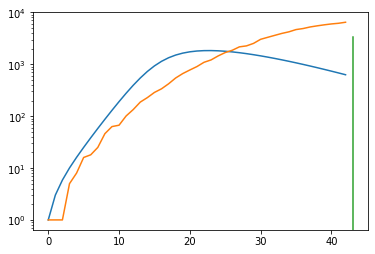

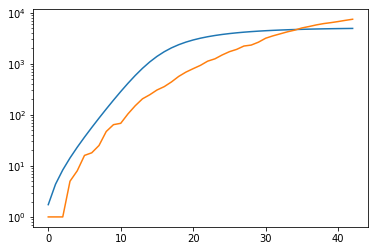

total error: 0.04491463676095009


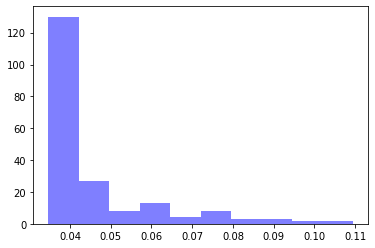

alpha: 0.50893986 , beta: 0.38807523 , initial_unconfirmed 17.853573 , t0s 0.0 , lambds 0.2592436


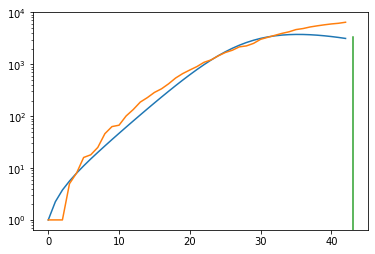

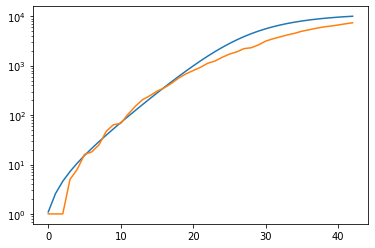

total error: 0.03572344034910202


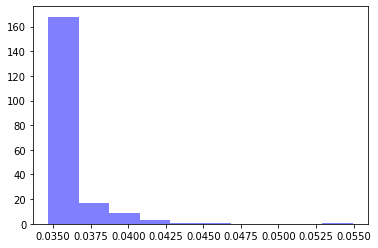

alpha: 0.50893986 , beta: 0.38807523 , initial_unconfirmed 17.853573 , t0s 0.0 , lambds 0.2592436


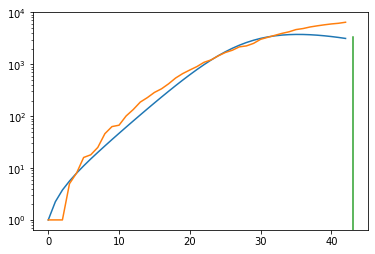

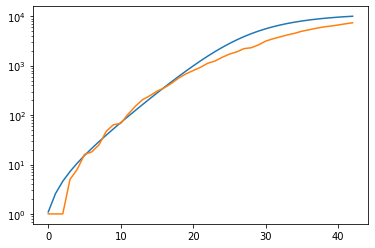

total error: 0.03488635644316673


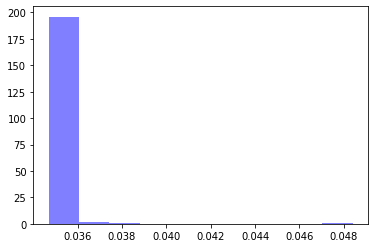

alpha: 0.50893986 , beta: 0.38807523 , initial_unconfirmed 17.853573 , t0s 0.0 , lambds 0.2592436


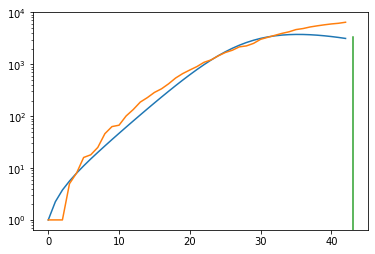

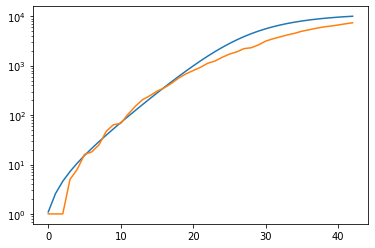

total error: 0.03478051349520683


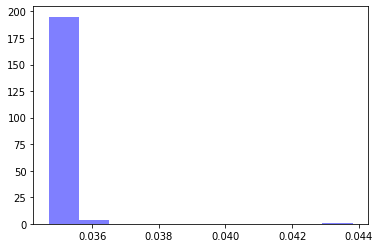

alpha: 0.50893986 , beta: 0.38807523 , initial_unconfirmed 17.853573 , t0s 0.0 , lambds 0.2592436


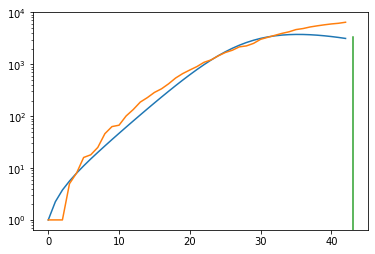

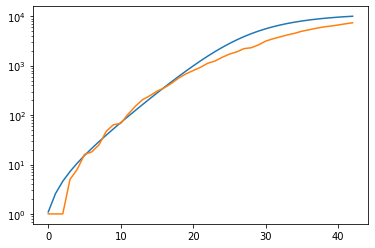

Pitcairn
St. Vincent and the Grenadines
total error: 6.369110107421875


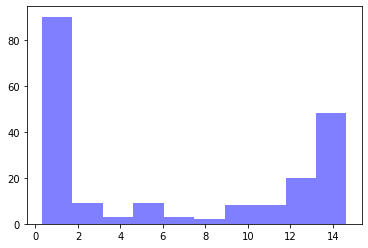

alpha: 0.8390509 , beta: 0.023705153 , initial_unconfirmed 6.0706587 , t0s 0.33195984 , lambds 0.5047368


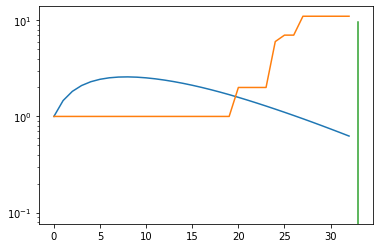

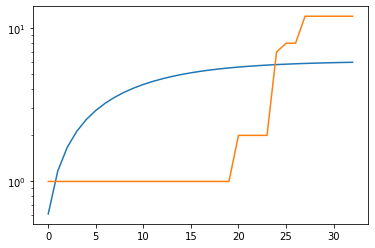

total error: 0.28017181158065796


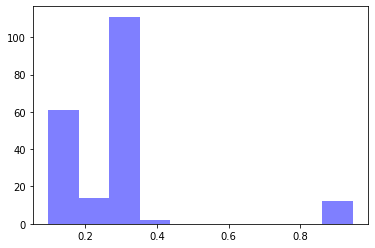

alpha: 0.9582062 , beta: 0.2009482 , initial_unconfirmed 0.67782176 , t0s 3.4744532 , lambds 0.0010773004


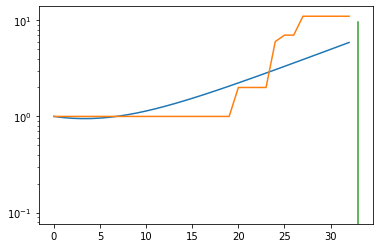

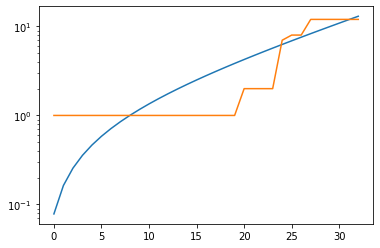

total error: 0.22123941779136658


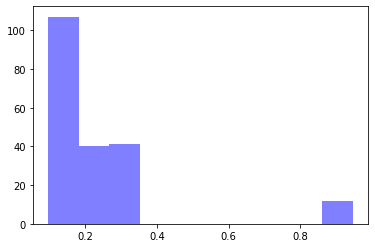

alpha: 0.958415 , beta: 0.2009473 , initial_unconfirmed 0.67767394 , t0s 3.4788496 , lambds 0.0003958636


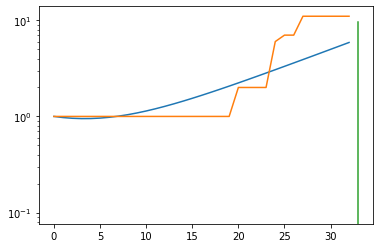

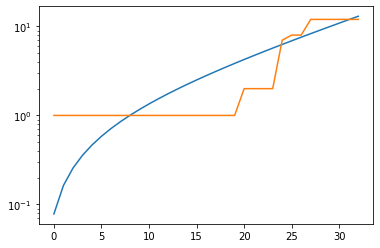

total error: 0.1937999278306961


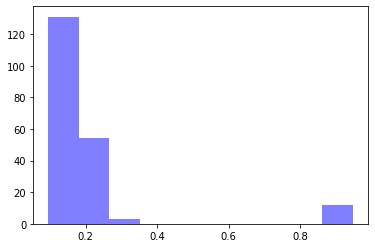

alpha: 0.9586787 , beta: 0.20094042 , initial_unconfirmed 0.67747 , t0s 3.4799154 , lambds 0.00020131527


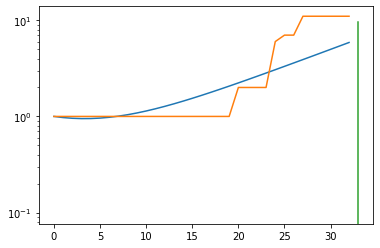

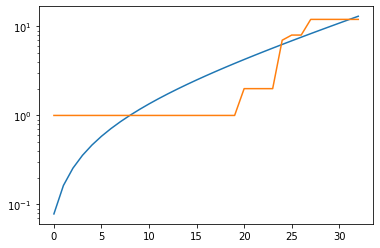

total error: 0.17423124611377716


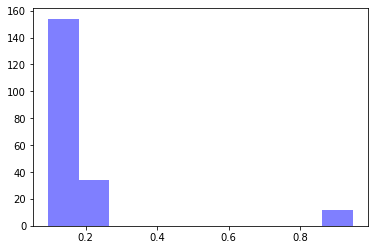

alpha: 0.9588535 , beta: 0.20094804 , initial_unconfirmed 0.6773645 , t0s 3.4802573 , lambds 0.00012646806


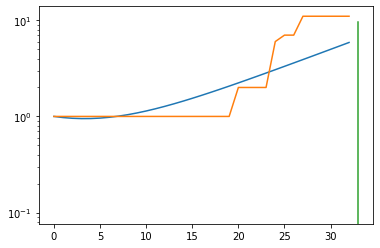

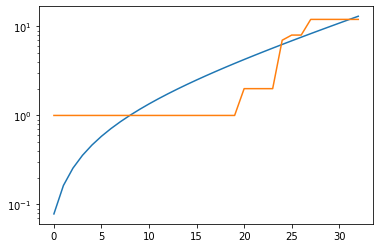

Liberia
total error: 6.016401290893555


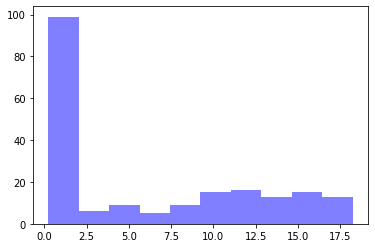

alpha: 0.9999027 , beta: 0.15239376 , initial_unconfirmed 3.7847548 , t0s 0.15180564 , lambds 0.547336


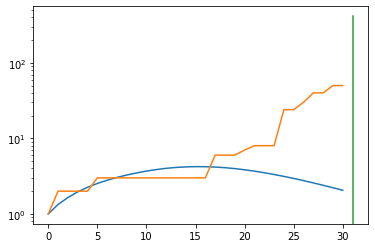

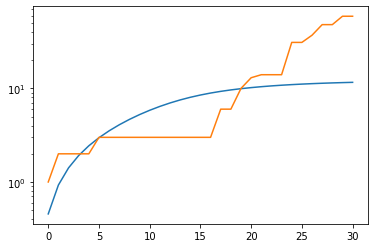

total error: 0.18093420565128326


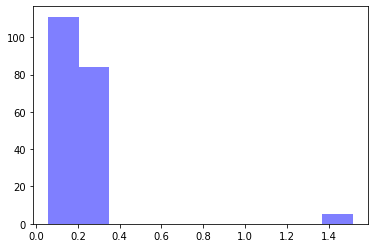

alpha: 0.5010382 , beta: 0.21993266 , initial_unconfirmed 3.8742461 , t0s 2.0220397 , lambds 0.0001382765


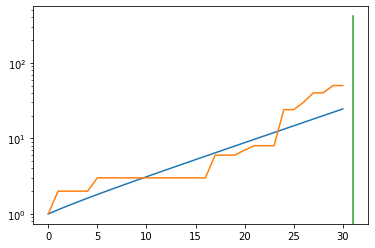

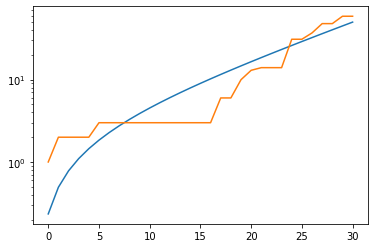

total error: 0.1561080515384674


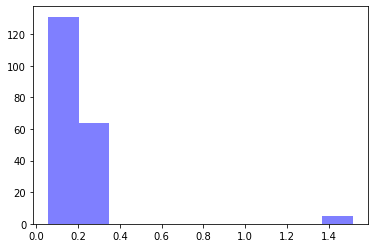

alpha: 0.5009696 , beta: 0.2199368 , initial_unconfirmed 3.8746207 , t0s 0.0 , lambds 7.813166e-05


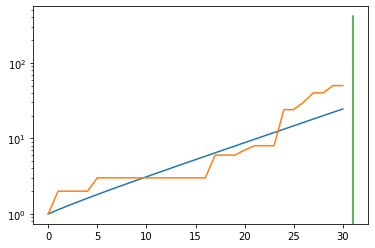

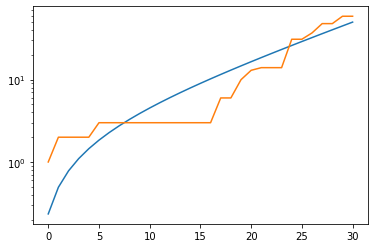

total error: 0.13290637731552124


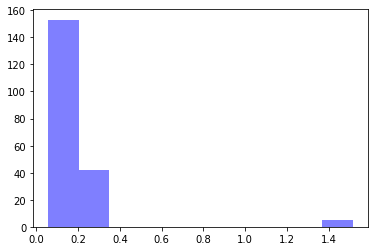

alpha: 0.99692976 , beta: 0.21993405 , initial_unconfirmed 1.9470787 , t0s 4.6492414 , lambds 0.0003500234


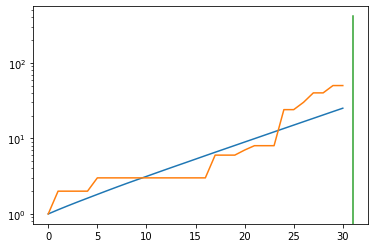

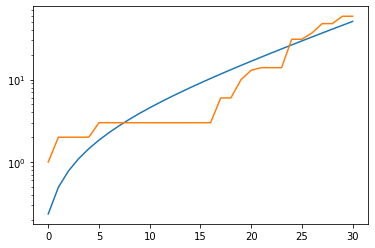

total error: 0.1090451180934906


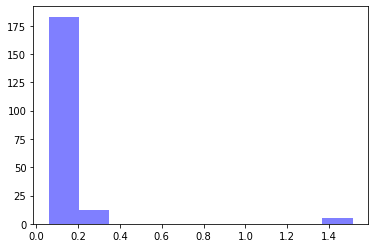

alpha: 0.99692976 , beta: 0.21993583 , initial_unconfirmed 1.9470177 , t0s 4.6497116 , lambds 0.00025869685


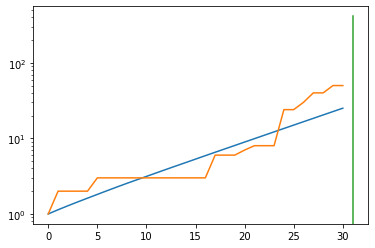

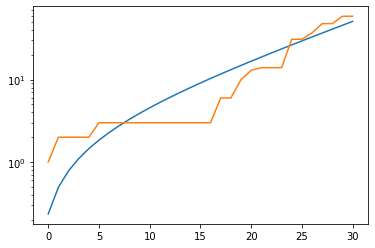

Spain
total error: 8.033287048339844


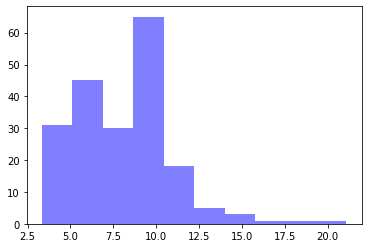

alpha: 0.9999694 , beta: 0.9997285 , initial_unconfirmed 0.29484928 , t0s 0.64139587 , lambds 0.64747876


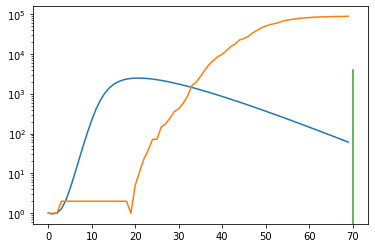

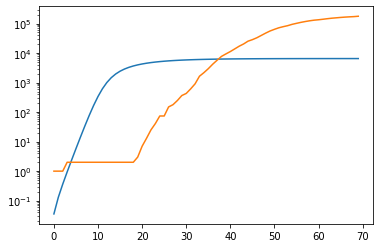

total error: 0.7057127952575684


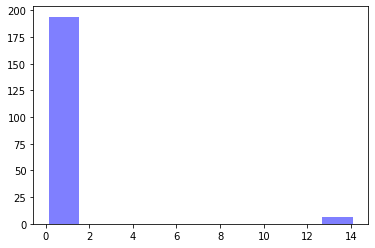

alpha: 0.50527453 , beta: 0.4025692 , initial_unconfirmed 0.48963177 , t0s 4.790243 , lambds 0.14679264


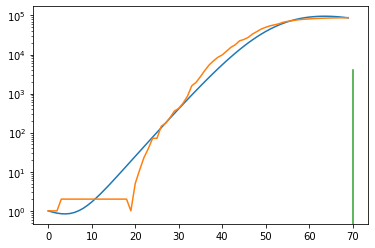

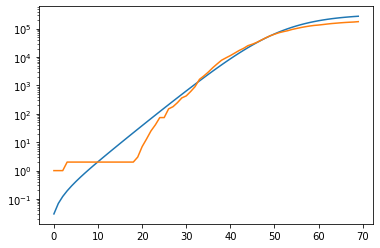

total error: 0.582451581954956


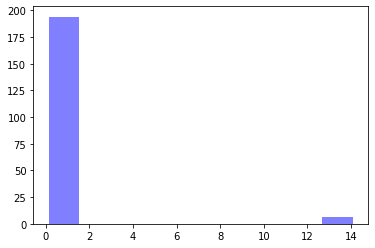

alpha: 0.99944115 , beta: 0.39653045 , initial_unconfirmed 0.2665481 , t0s 16.968307 , lambds 0.20351961


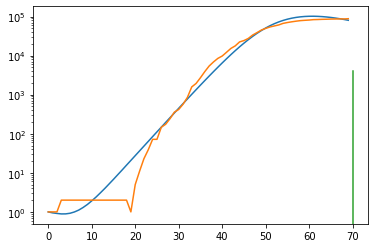

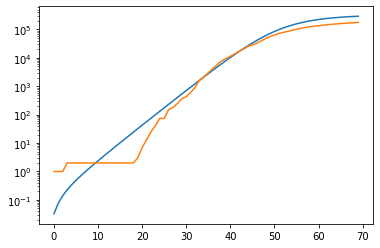

total error: 0.557288646697998


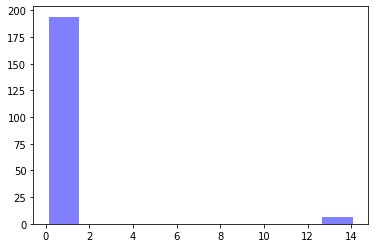

alpha: 0.99951065 , beta: 0.39313 , initial_unconfirmed 0.27496698 , t0s 23.626642 , lambds 0.25731546


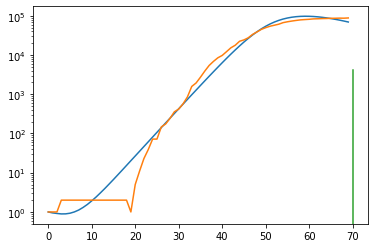

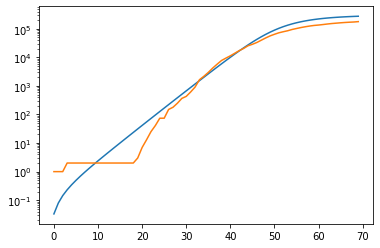

total error: 0.5538733005523682


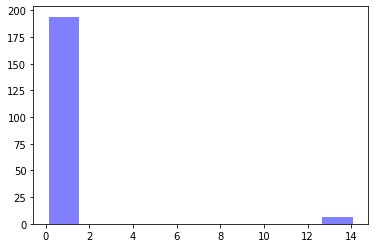

alpha: 0.9995954 , beta: 0.39188558 , initial_unconfirmed 0.27811652 , t0s 26.38482 , lambds 0.28846887


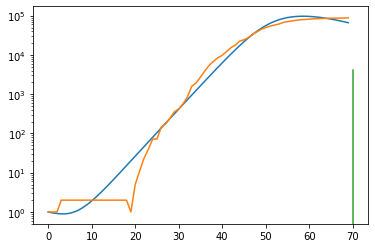

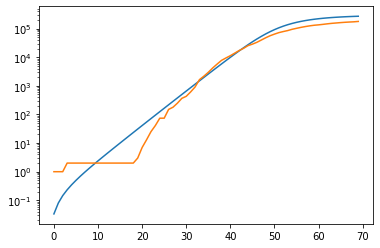

Pakistan
total error: 4.308707237243652


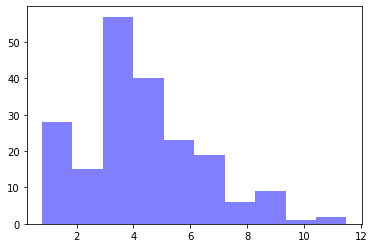

alpha: 0.980648 , beta: 0.60853744 , initial_unconfirmed 5.8570147 , t0s 0.01569289 , lambds 0.62248844


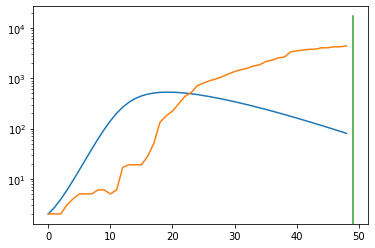

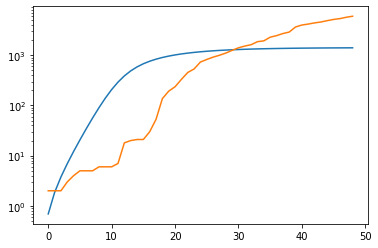

total error: 0.11101532727479935


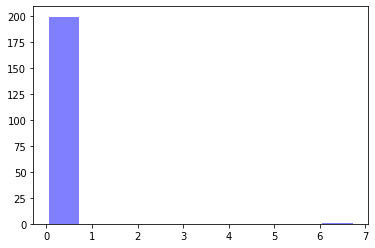

alpha: 0.53371644 , beta: 0.3707133 , initial_unconfirmed 4.5870185 , t0s 0.0 , lambds 0.20526272


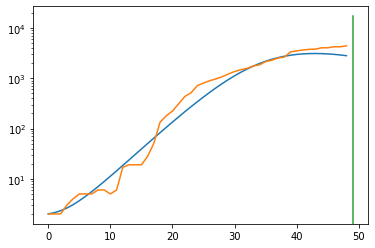

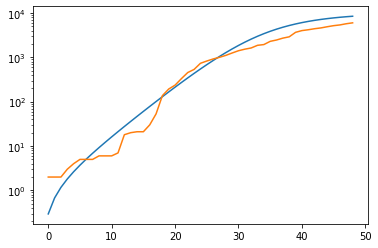

total error: 0.07913874834775925


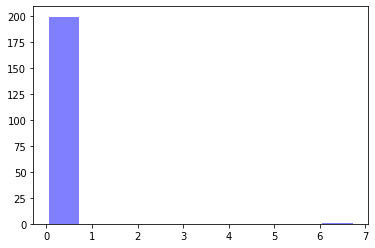

alpha: 0.8084272 , beta: 0.37074497 , initial_unconfirmed 3.030392 , t0s 0.0 , lambds 0.20531012


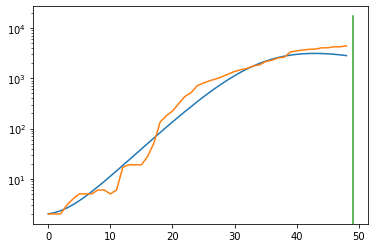

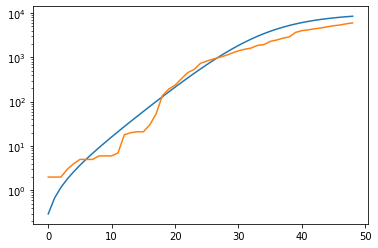

total error: 0.07865269482135773


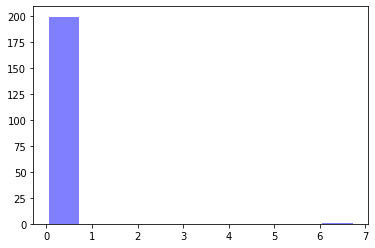

alpha: 0.8084272 , beta: 0.37074497 , initial_unconfirmed 3.030392 , t0s 0.0 , lambds 0.20531012


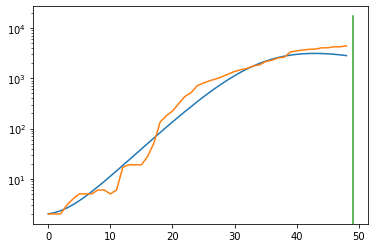

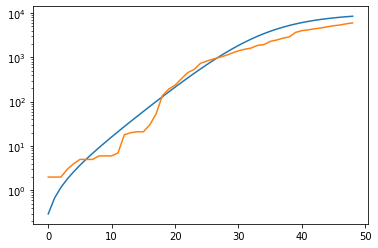

total error: 0.078649140894413


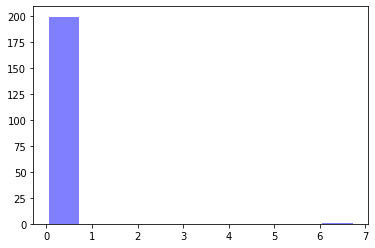

alpha: 0.8084272 , beta: 0.37074497 , initial_unconfirmed 3.030392 , t0s 0.0 , lambds 0.20531012


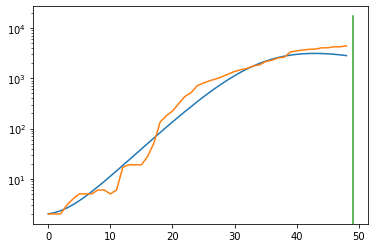

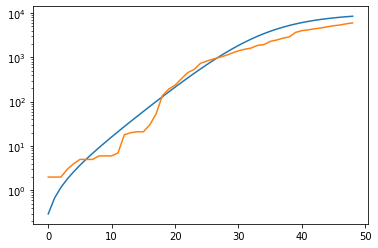

Mali
total error: 3.1771154403686523


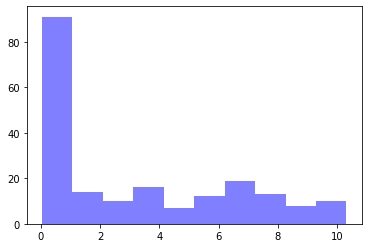

alpha: 0.99970967 , beta: 0.2804835 , initial_unconfirmed 22.991423 , t0s 0.9814012 , lambds 0.65133667


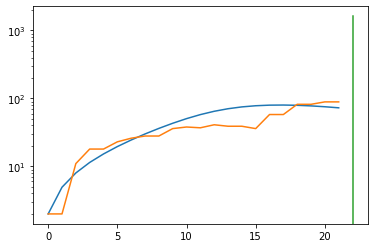

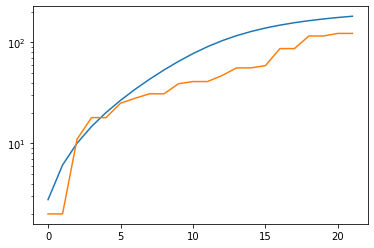

total error: 0.02846638858318329


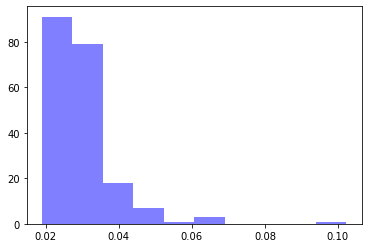

alpha: 0.7435469 , beta: 0.19373211 , initial_unconfirmed 31.972368 , t0s 2.4284425 , lambds 0.09228404


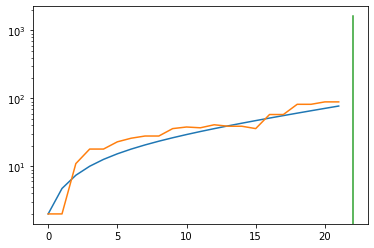

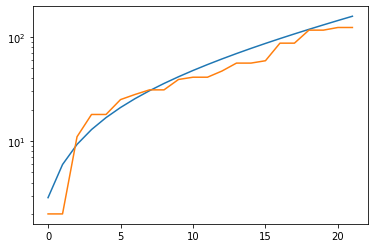

total error: 0.026009922847151756


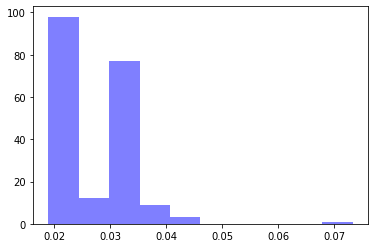

alpha: 0.9462819 , beta: 0.19373071 , initial_unconfirmed 25.122627 , t0s 2.3295305 , lambds 0.09072905


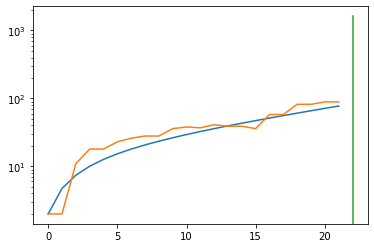

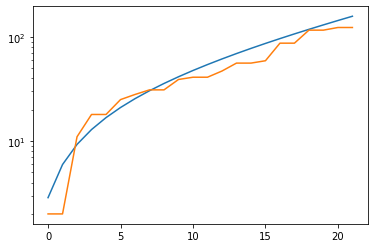

total error: 0.024747701361775398


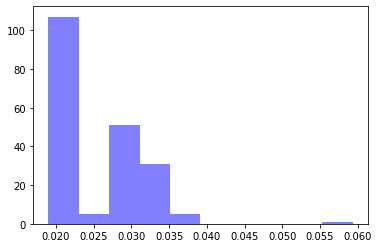

alpha: 0.9999891 , beta: 0.19388244 , initial_unconfirmed 23.753716 , t0s 0.0 , lambds 0.08988376


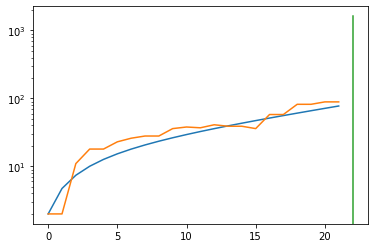

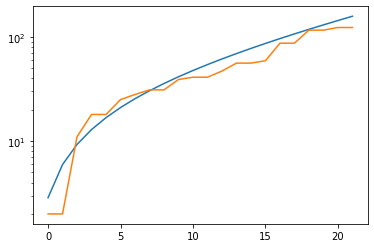

total error: 0.02404426597058773


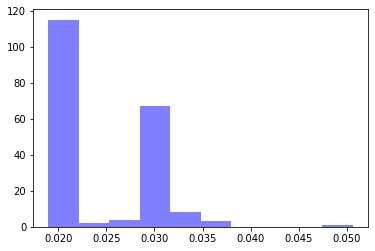

alpha: 0.99878323 , beta: 0.19380613 , initial_unconfirmed 23.798986 , t0s 0.0 , lambds 0.08714989


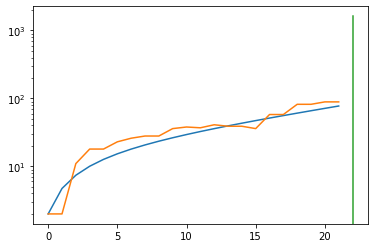

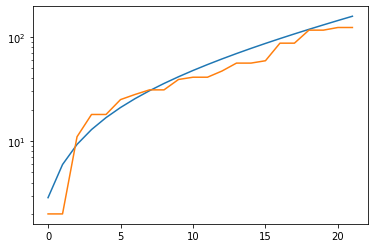

Madagascar
total error: 3.5252199172973633


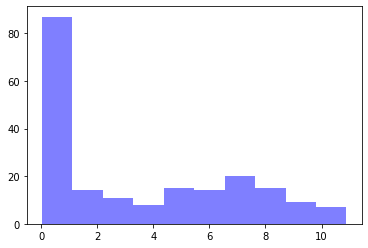

alpha: 0.80099106 , beta: 0.28519523 , initial_unconfirmed 25.504982 , t0s 0.462232 , lambds 0.66621345


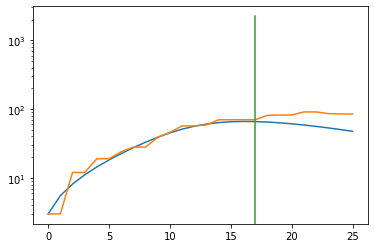

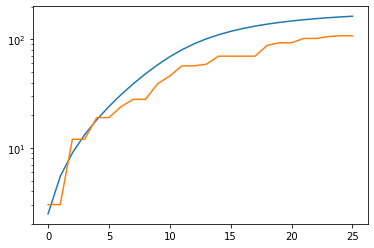

total error: 0.02840634621679783


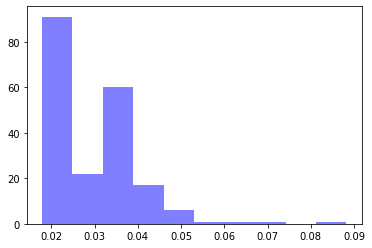

alpha: 0.7659726 , beta: 0.21651803 , initial_unconfirmed 29.297417 , t0s 0.0 , lambds 0.40167296


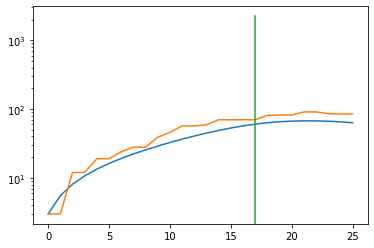

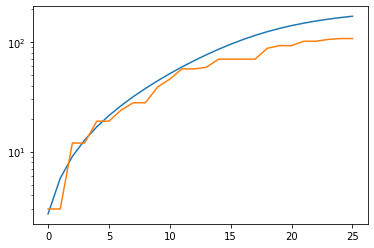

total error: 0.025349853560328484


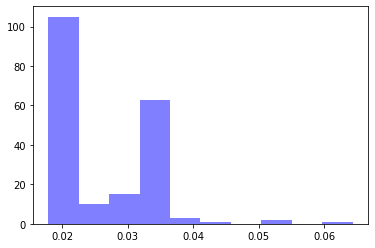

alpha: 0.83118606 , beta: 0.21640356 , initial_unconfirmed 27.011118 , t0s 0.0 , lambds 0.40126684


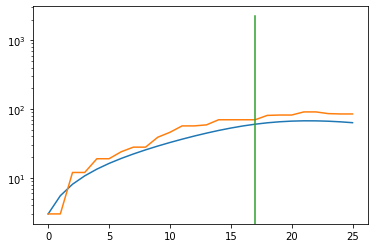

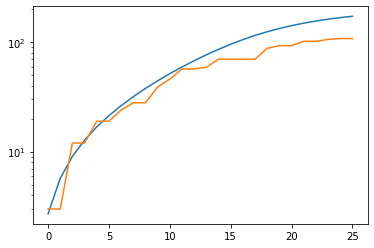

total error: 0.023676298558712006


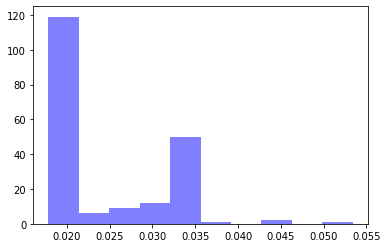

alpha: 0.83118606 , beta: 0.21640356 , initial_unconfirmed 27.011118 , t0s 0.0 , lambds 0.40126684


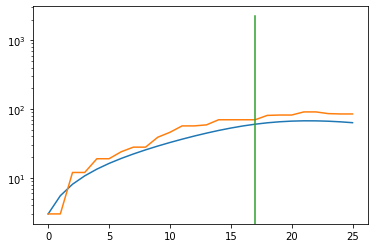

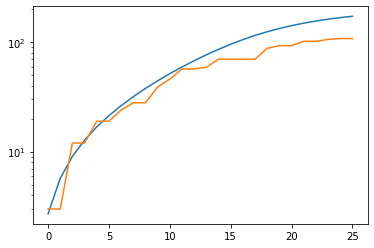

total error: 0.02179047279059887


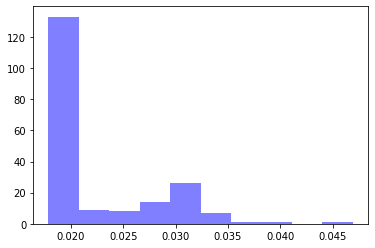

alpha: 0.83118606 , beta: 0.21640356 , initial_unconfirmed 27.011118 , t0s 0.0 , lambds 0.40126684


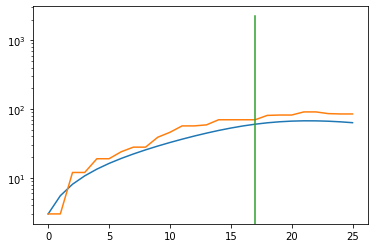

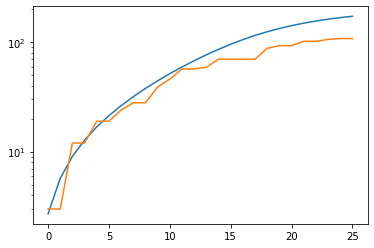

Zimbabwe
total error: 5.452675819396973


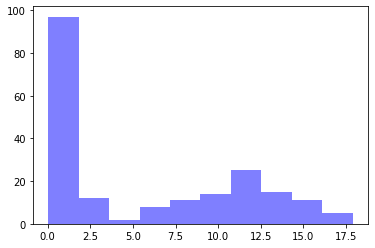

alpha: 0.9820478 , beta: 0.17071329 , initial_unconfirmed 5.4755716 , t0s 0.82480043 , lambds 0.7191842


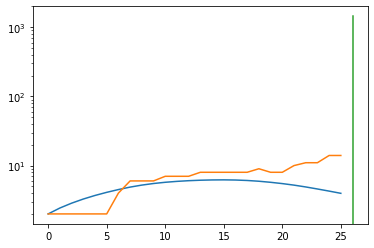

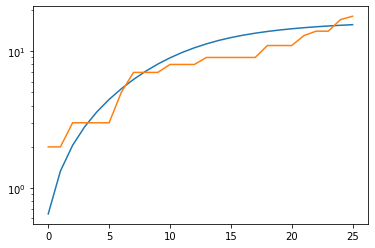

total error: 0.0570639930665493


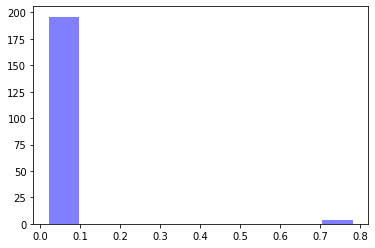

alpha: 0.50639075 , beta: 0.1435476 , initial_unconfirmed 10.657263 , t0s 2.1888633 , lambds 0.0032851074


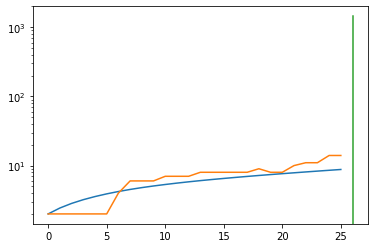

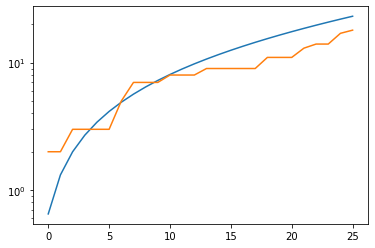

total error: 0.04957927390933037


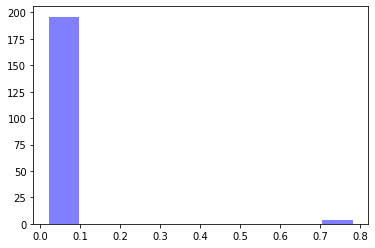

alpha: 0.50639075 , beta: 0.1435476 , initial_unconfirmed 10.657263 , t0s 2.1888633 , lambds 0.0032851074


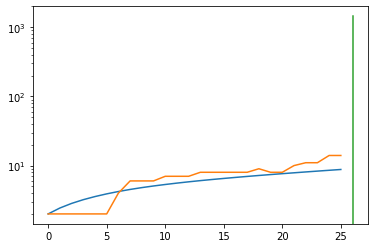

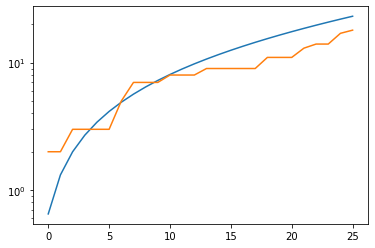

total error: 0.04553660750389099


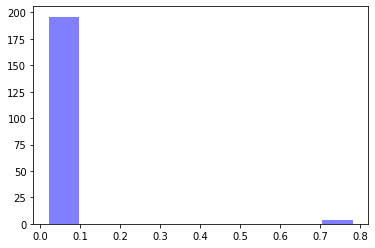

alpha: 0.50639075 , beta: 0.1435476 , initial_unconfirmed 10.657263 , t0s 2.1888633 , lambds 0.0032851074


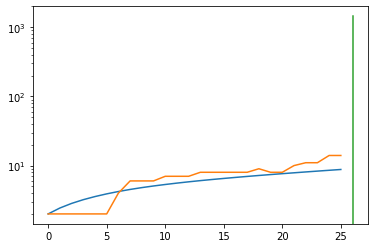

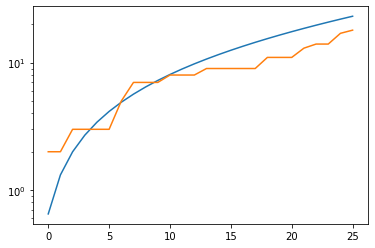

total error: 0.04301079362630844


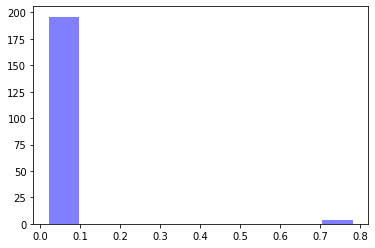

alpha: 0.50639075 , beta: 0.1435476 , initial_unconfirmed 10.657263 , t0s 2.1888633 , lambds 0.0032851074


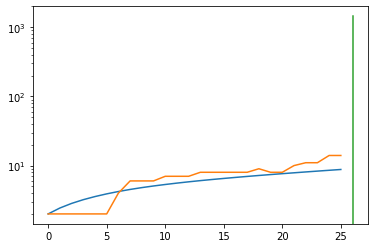

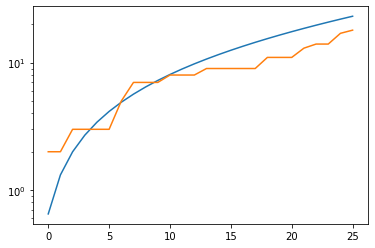

Macedonia
Sierra Leone
total error: 3.8815255165100098


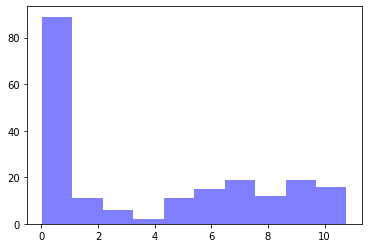

alpha: 0.99840605 , beta: 0.12391765 , initial_unconfirmed 6.279275 , t0s 0.5547185 , lambds 0.54148126


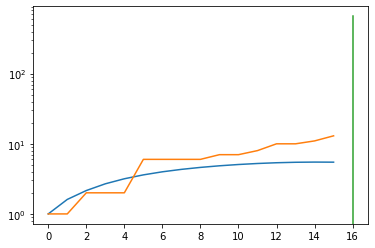

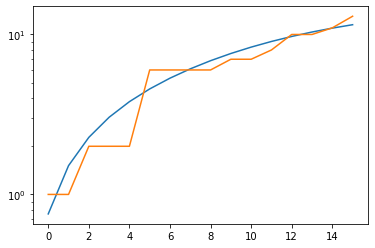

total error: 0.031001927331089973


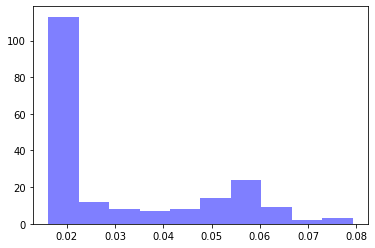

alpha: 0.60542536 , beta: 0.19897176 , initial_unconfirmed 7.772822 , t0s 0.0 , lambds 0.40010837


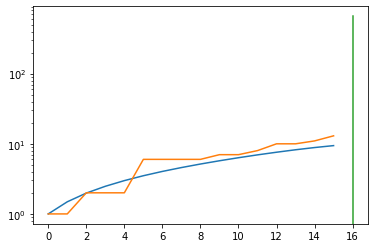

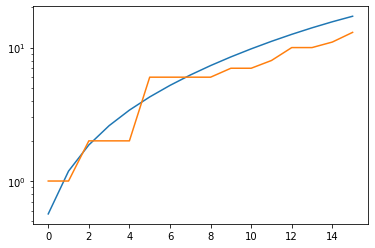

total error: 0.02127293311059475


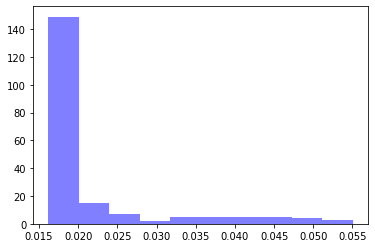

alpha: 0.60542536 , beta: 0.19897176 , initial_unconfirmed 7.772822 , t0s 0.0 , lambds 0.40010837


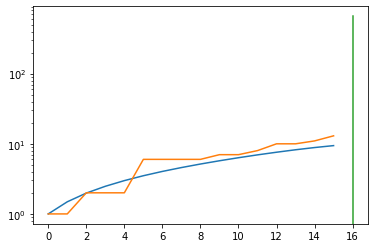

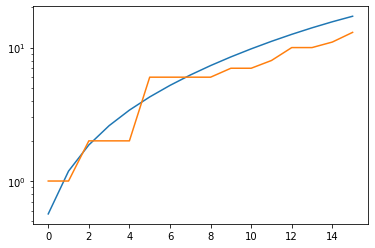

total error: 0.017488371580839157


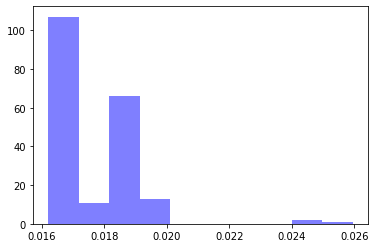

alpha: 0.60542536 , beta: 0.19897176 , initial_unconfirmed 7.772822 , t0s 0.0 , lambds 0.40010837


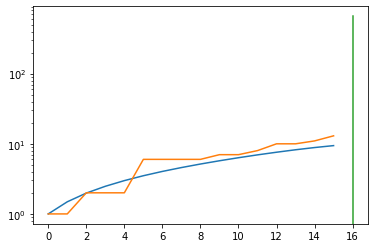

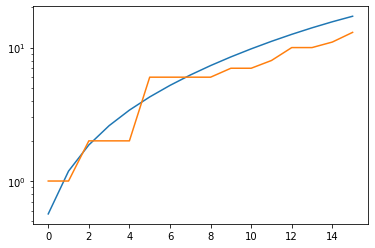

total error: 0.01725708320736885


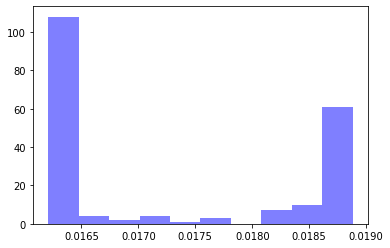

alpha: 0.60542536 , beta: 0.19897176 , initial_unconfirmed 7.772822 , t0s 0.0 , lambds 0.40010837


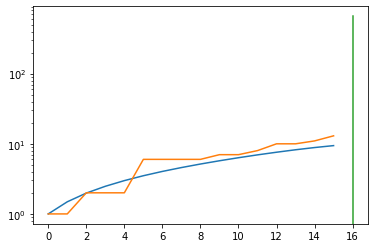

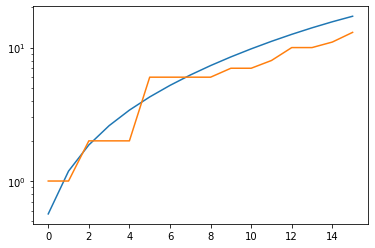

United Kingdom
total error: 7.050240516662598


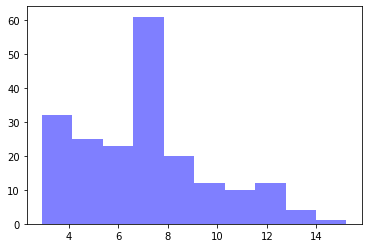

alpha: 0.99992204 , beta: 0.98800105 , initial_unconfirmed 0.5772561 , t0s 0.7679072 , lambds 0.65520114


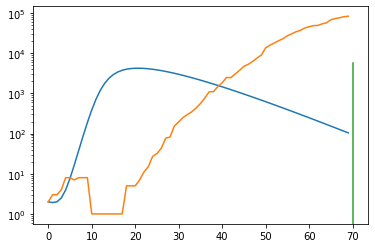

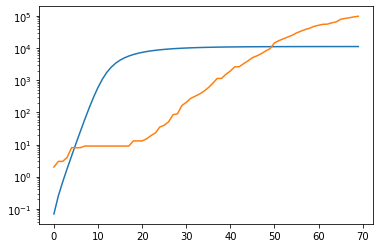

total error: 0.4698919653892517


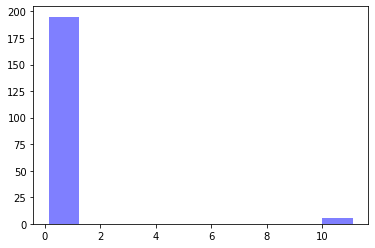

alpha: 0.99988294 , beta: 0.31512874 , initial_unconfirmed 1.0879611 , t0s 3.4275331 , lambds 0.09835386


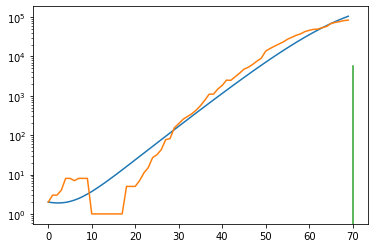

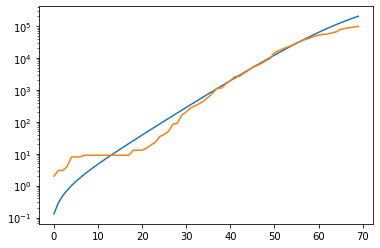

total error: 0.4182724356651306


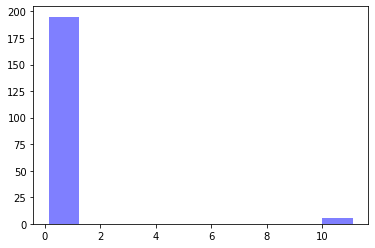

alpha: 0.5008229 , beta: 0.31682914 , initial_unconfirmed 2.0886552 , t0s 4.1217484 , lambds 0.102029435


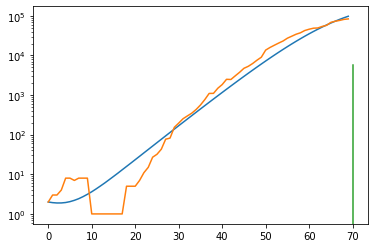

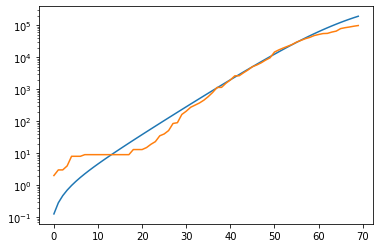

total error: 0.417449027299881


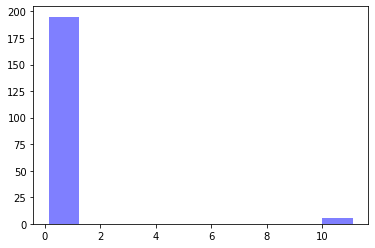

alpha: 0.9877548 , beta: 0.31699917 , initial_unconfirmed 1.0478344 , t0s 5.2636957 , lambds 0.1048145


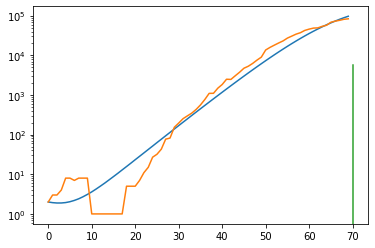

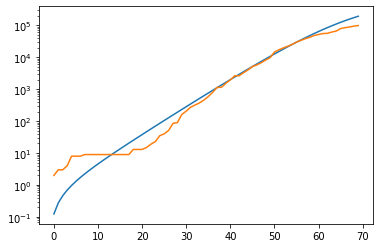

total error: 0.41644036769866943


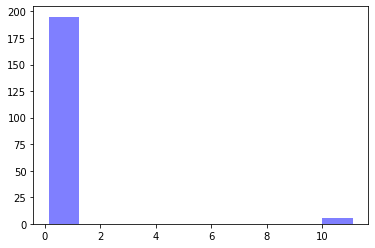

alpha: 0.5009903 , beta: 0.3168854 , initial_unconfirmed 2.066171 , t0s 7.1030197 , lambds 0.10917365


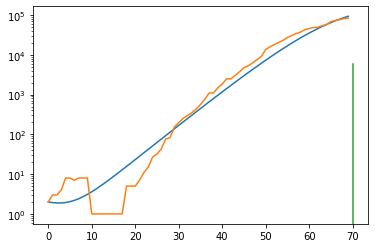

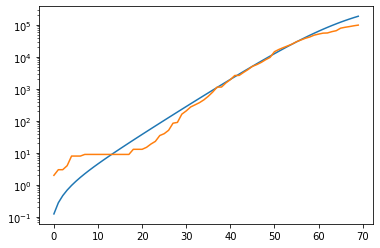

Central African Republic
total error: 7.667675018310547


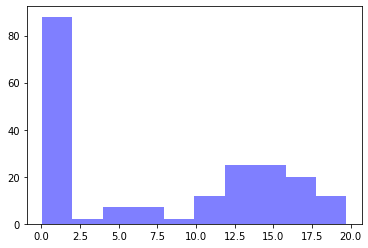

alpha: 0.9999262 , beta: 0.2386401 , initial_unconfirmed 1.6891003 , t0s 0.27149045 , lambds 0.57958543


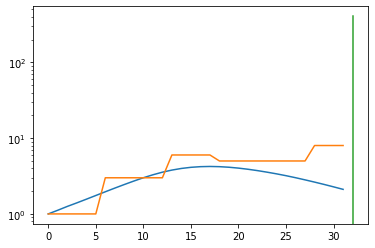

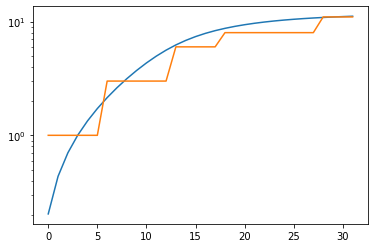

total error: 0.09938737750053406


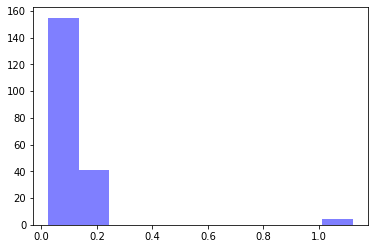

alpha: 0.5019904 , beta: 0.15397622 , initial_unconfirmed 4.977783 , t0s 0.0 , lambds 0.10351063


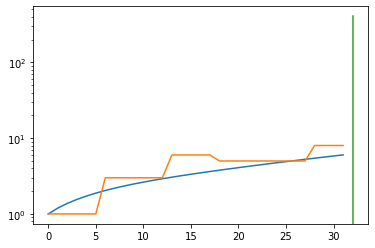

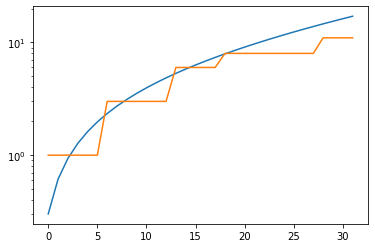

total error: 0.07601495832204819


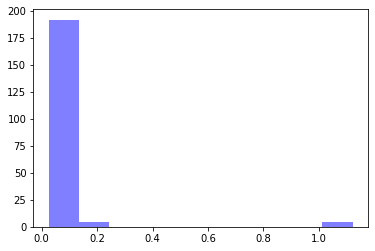

alpha: 0.50280213 , beta: 0.15392305 , initial_unconfirmed 4.971197 , t0s 0.0 , lambds 0.099552274


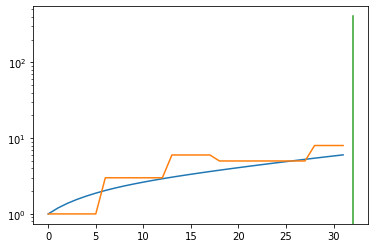

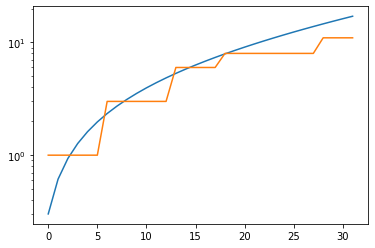

total error: 0.06277910619974136


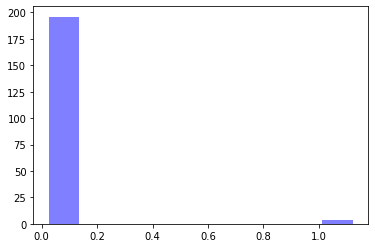

alpha: 0.50280213 , beta: 0.15392292 , initial_unconfirmed 4.971209 , t0s 0.0 , lambds 0.09954417


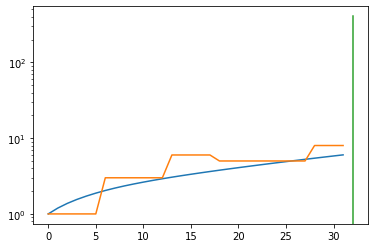

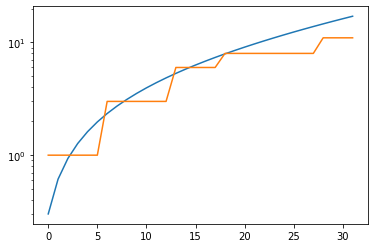

total error: 0.059219907969236374


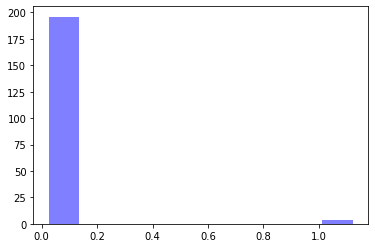

alpha: 0.50280213 , beta: 0.15392266 , initial_unconfirmed 4.971226 , t0s 0.0 , lambds 0.09953398


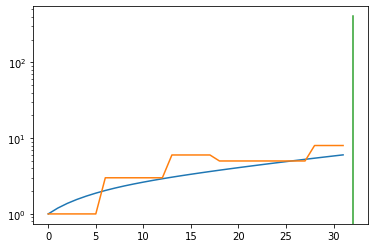

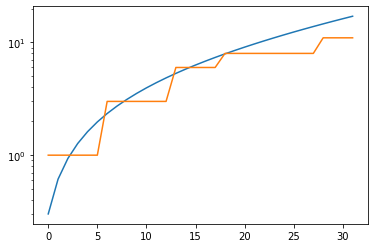

Burundi
total error: 4.274646759033203


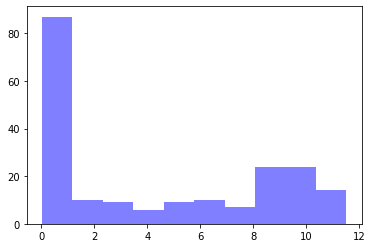

alpha: 0.9965013 , beta: 0.0007612736 , initial_unconfirmed 6.3262105 , t0s 0.8217086 , lambds 0.68629086


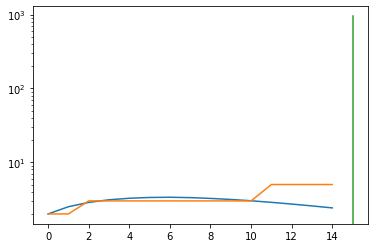

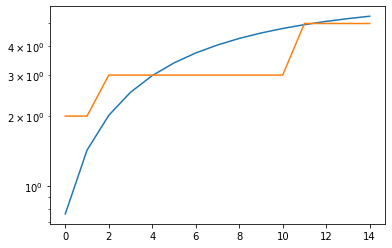

total error: 0.031156938523054123


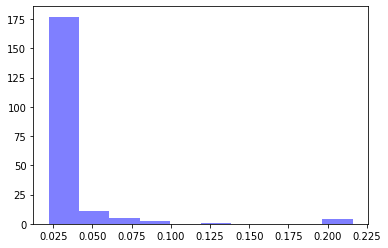

alpha: 0.9976411 , beta: 0.015255046 , initial_unconfirmed 6.431429 , t0s 2.1777503 , lambds 0.11760578


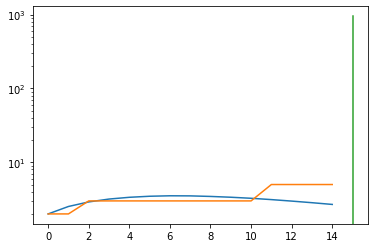

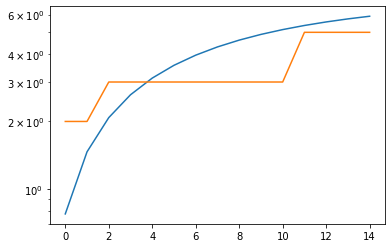

total error: 0.02671579085290432


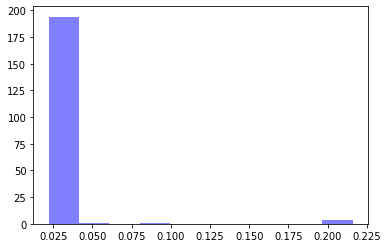

alpha: 0.9976411 , beta: 0.015255046 , initial_unconfirmed 6.431429 , t0s 2.1777503 , lambds 0.11760578


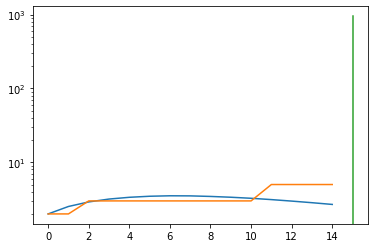

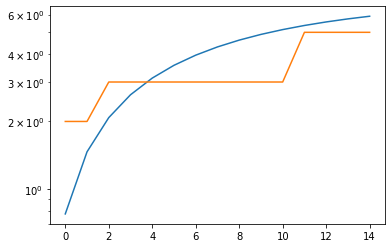

total error: 0.026468075811862946


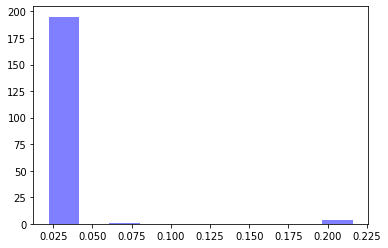

alpha: 0.9976411 , beta: 0.015255046 , initial_unconfirmed 6.431429 , t0s 2.1777503 , lambds 0.11760578


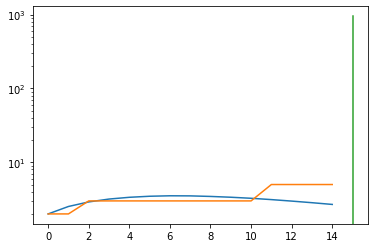

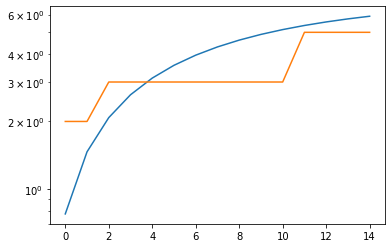

total error: 0.02632708102464676


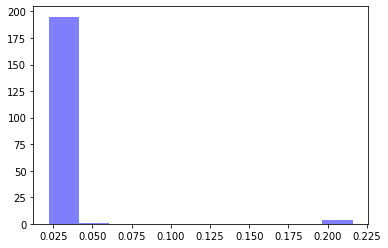

alpha: 0.9976411 , beta: 0.015255046 , initial_unconfirmed 6.431429 , t0s 2.1777503 , lambds 0.11760578


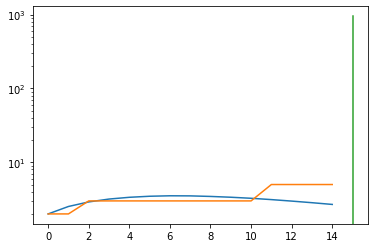

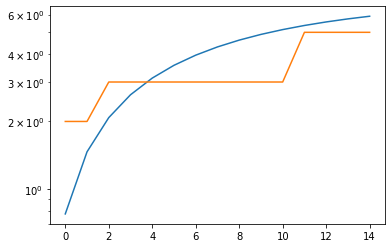

Estonia
total error: 4.178815841674805


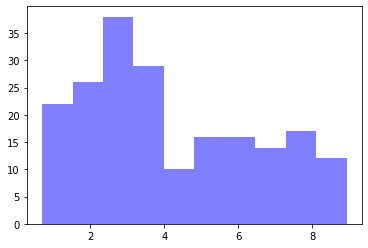

alpha: 0.9992831 , beta: 0.48995376 , initial_unconfirmed 14.503184 , t0s 0.2790482 , lambds 0.6410885


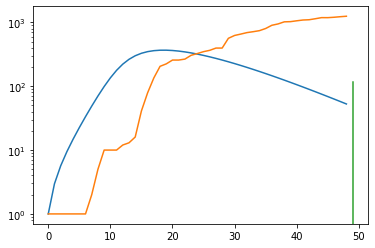

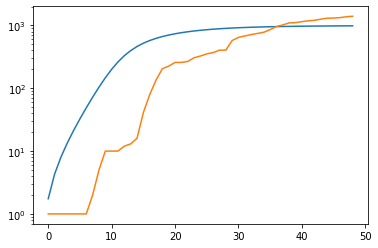

total error: 0.3334595561027527


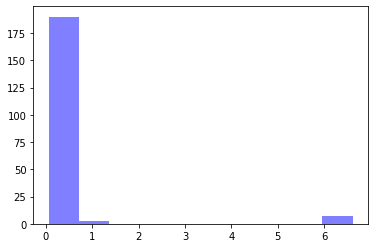

alpha: 0.50116765 , beta: 0.39597222 , initial_unconfirmed 2.763155 , t0s 0.0 , lambds 0.2531891


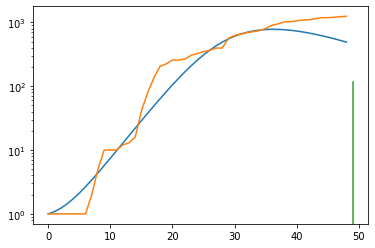

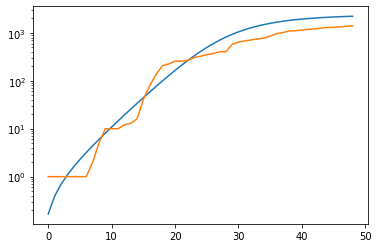

total error: 0.2870710492134094


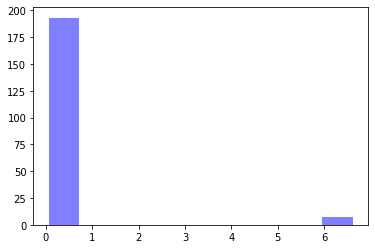

alpha: 0.5005129 , beta: 0.39593738 , initial_unconfirmed 2.7678204 , t0s 0.0 , lambds 0.2531715


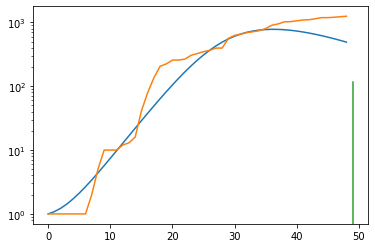

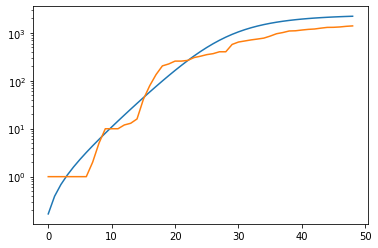

total error: 0.2870676517486572


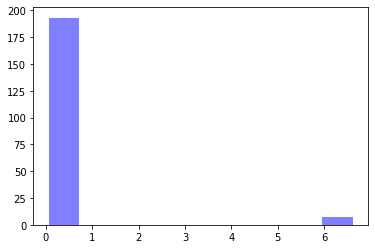

alpha: 0.5005129 , beta: 0.39593738 , initial_unconfirmed 2.7678204 , t0s 0.0 , lambds 0.2531715


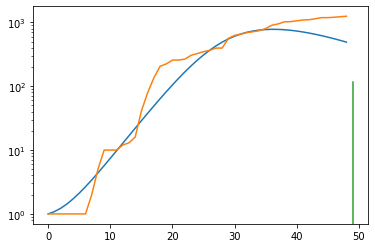

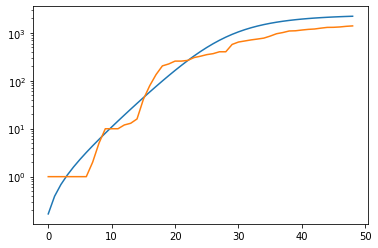

total error: 0.2870800495147705


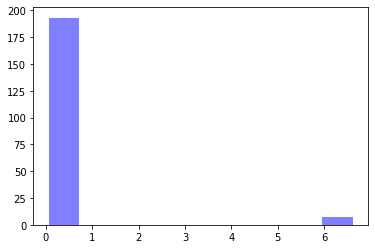

alpha: 0.5005129 , beta: 0.39593738 , initial_unconfirmed 2.7678204 , t0s 0.0 , lambds 0.2531715


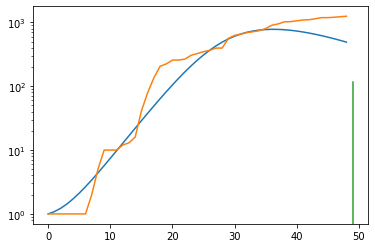

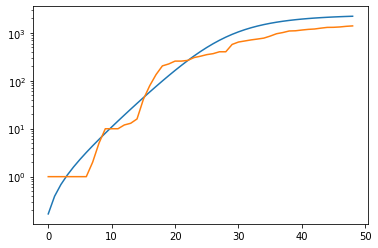

Iceland
total error: 3.0296154022216797


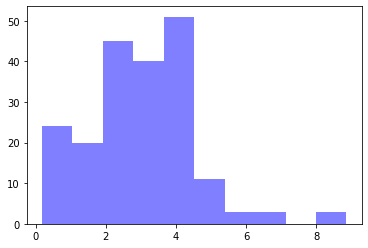

alpha: 0.9994262 , beta: 0.6220672 , initial_unconfirmed 2.9271126 , t0s 0.5949576 , lambds 0.6230583


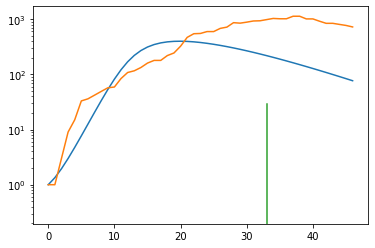

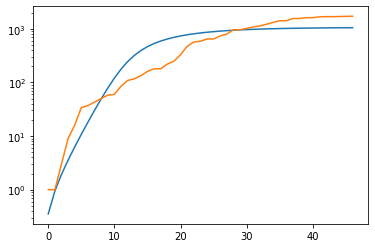

total error: 0.07779820263385773


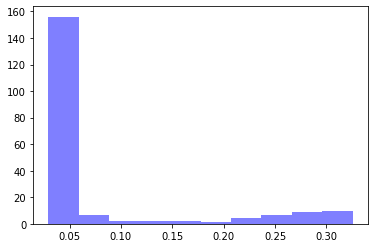

alpha: 0.50862086 , beta: 0.3011063 , initial_unconfirmed 33.767803 , t0s 0.0 , lambds 0.2549739


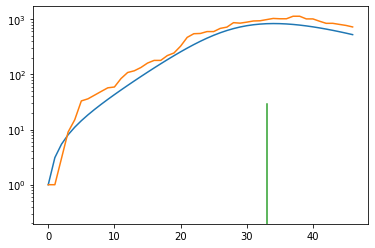

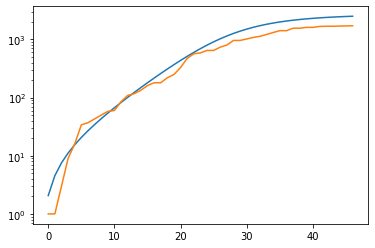

total error: 0.030588574707508087


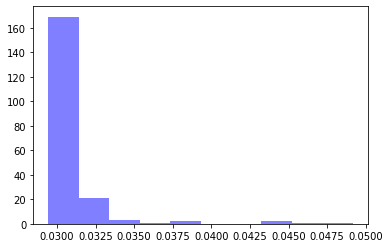

alpha: 0.5060977 , beta: 0.30109748 , initial_unconfirmed 33.831318 , t0s 0.0 , lambds 0.25448933


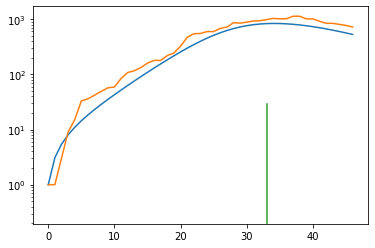

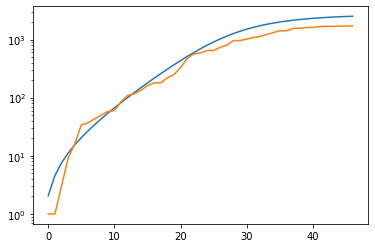

total error: 0.02980293333530426


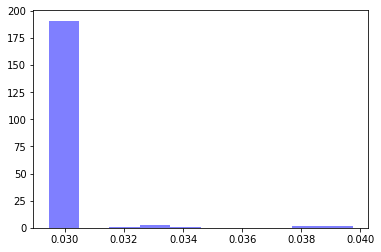

alpha: 0.5030398 , beta: 0.30116215 , initial_unconfirmed 34.009132 , t0s 0.0 , lambds 0.2545272


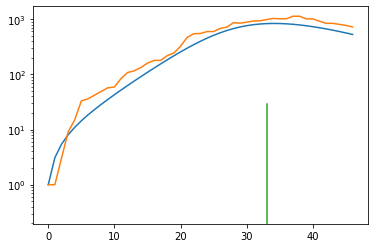

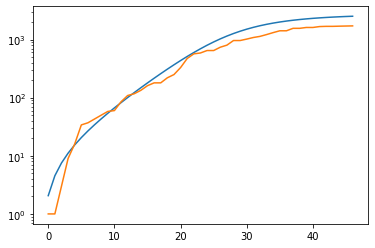

total error: 0.029616305604577065


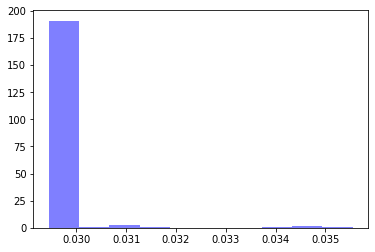

alpha: 0.5012207 , beta: 0.30116165 , initial_unconfirmed 34.133095 , t0s 0.0 , lambds 0.2545224


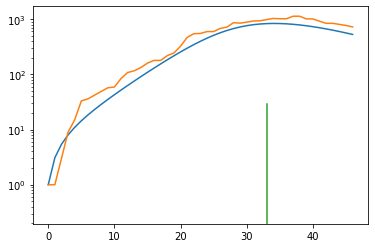

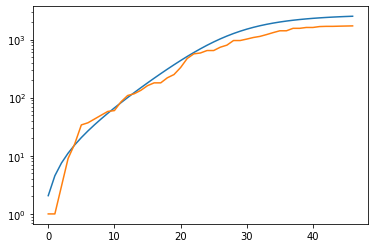

Northern Mariana Islands
total error: 2.585752248764038


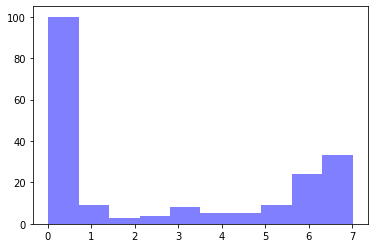

alpha: 0.99555266 , beta: 0.17059737 , initial_unconfirmed 6.390622 , t0s 0.4357887 , lambds 0.59873366


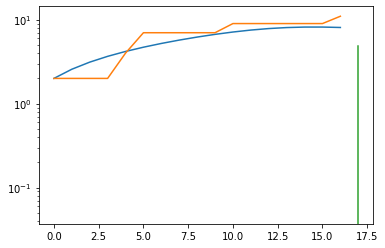

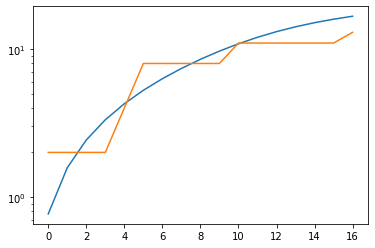

total error: 0.02674074098467827


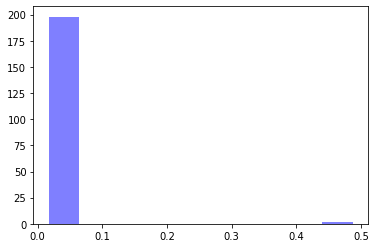

alpha: 0.9904953 , beta: 0.15471634 , initial_unconfirmed 7.080589 , t0s 1.6200985 , lambds 0.65906495


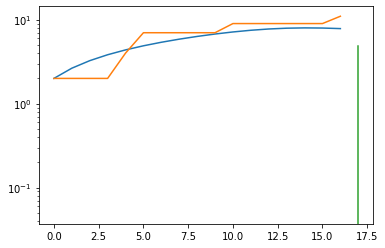

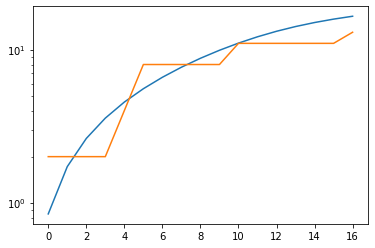

total error: 0.023422451689839363


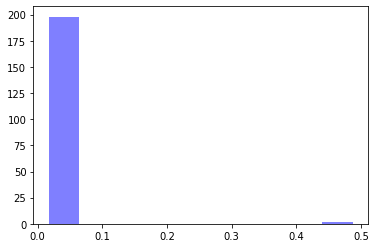

alpha: 0.99948794 , beta: 0.15475196 , initial_unconfirmed 7.0163674 , t0s 1.5746715 , lambds 0.6560241


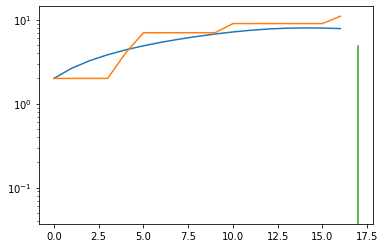

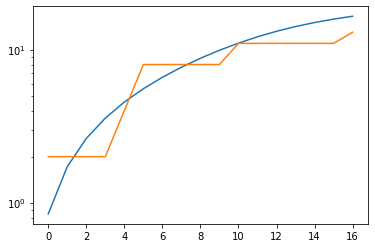

total error: 0.022225582972168922


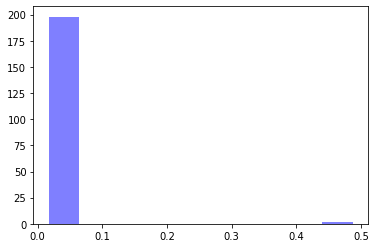

alpha: 0.99948794 , beta: 0.15475196 , initial_unconfirmed 7.0163674 , t0s 1.5746715 , lambds 0.6560241


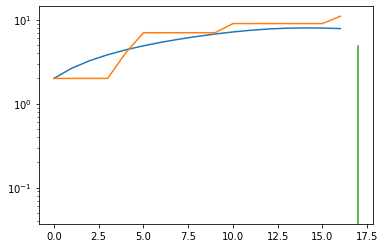

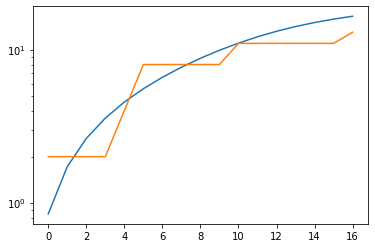

total error: 0.022087112069129944


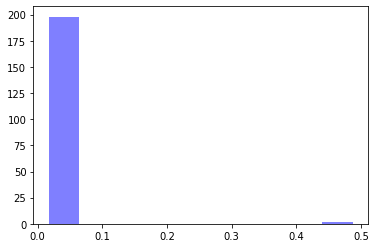

alpha: 0.99948794 , beta: 0.15475196 , initial_unconfirmed 7.0163674 , t0s 1.5746715 , lambds 0.6560241


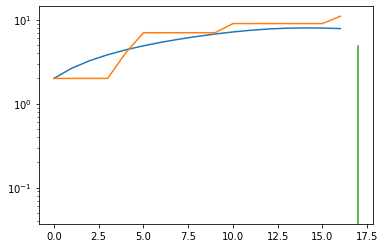

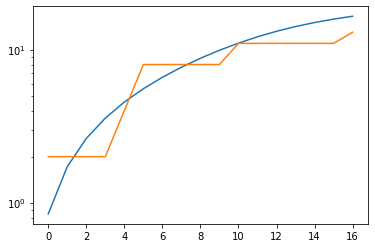

Chile
total error: 3.6678922176361084


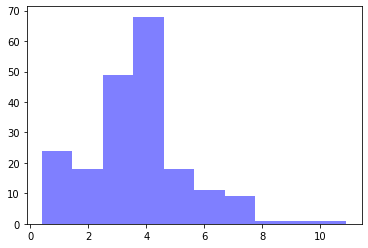

alpha: 0.9978535 , beta: 0.6131655 , initial_unconfirmed 12.934002 , t0s 0.28609836 , lambds 0.5250943


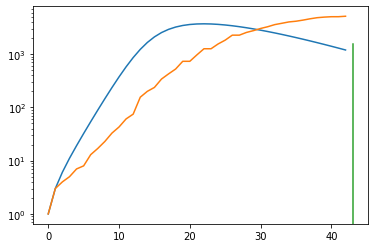

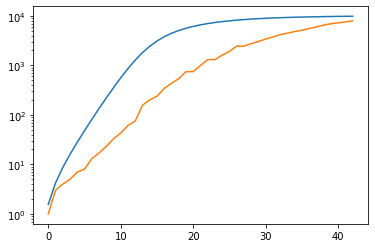

total error: 0.028455572202801704


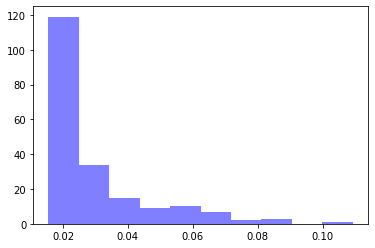

alpha: 0.5080683 , beta: 0.39354357 , initial_unconfirmed 15.459477 , t0s 0.0 , lambds 0.25868478


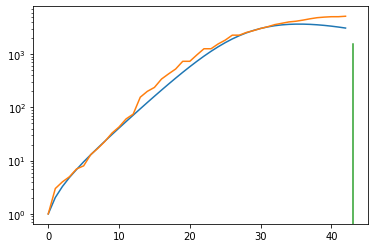

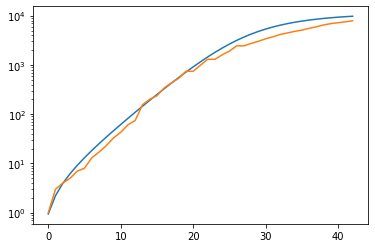

total error: 0.017098378390073776


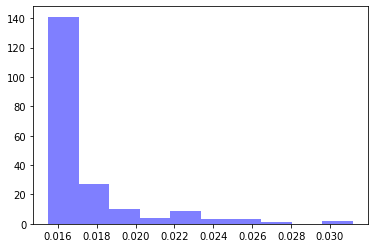

alpha: 0.5080683 , beta: 0.39354357 , initial_unconfirmed 15.459477 , t0s 0.0 , lambds 0.25868478


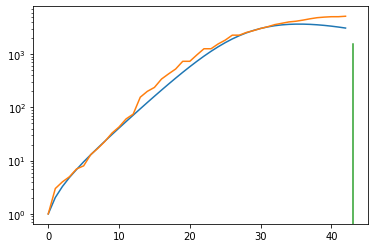

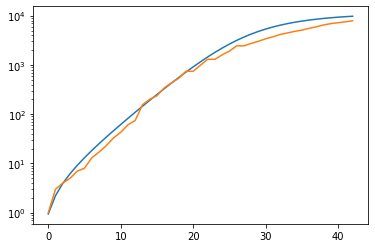

total error: 0.015643369406461716


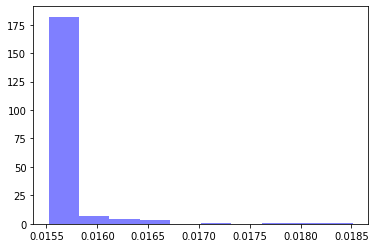

alpha: 0.5080683 , beta: 0.39354357 , initial_unconfirmed 15.459477 , t0s 0.0 , lambds 0.25868478


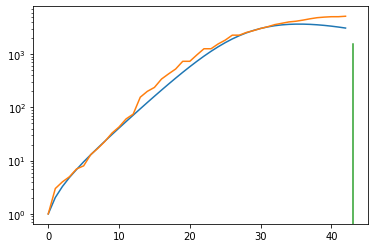

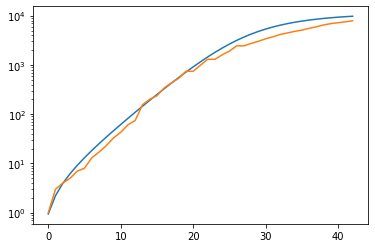

total error: 0.01556383352726698


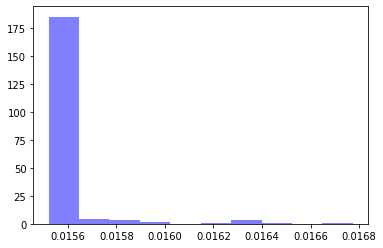

alpha: 0.5080683 , beta: 0.39354357 , initial_unconfirmed 15.459477 , t0s 0.0 , lambds 0.25868478


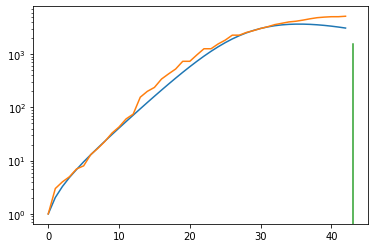

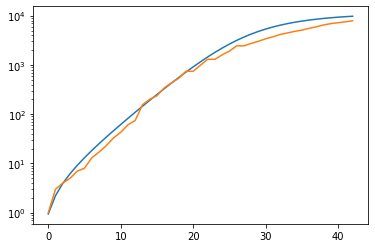

French Guiana
total error: 4.239418983459473


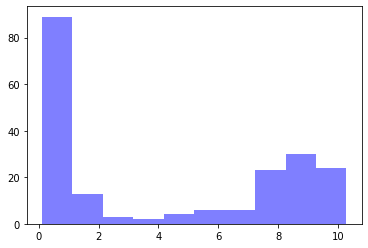

alpha: 0.9955298 , beta: 0.24480467 , initial_unconfirmed 10.209057 , t0s 0.2519918 , lambds 0.5320451


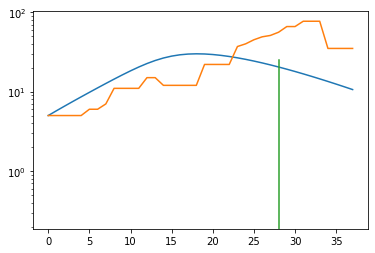

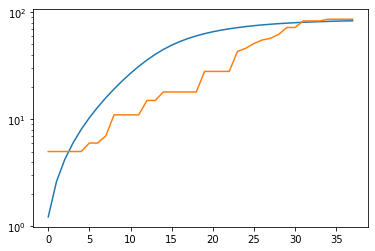

total error: 0.10904576629400253


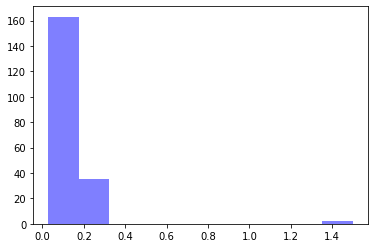

alpha: 0.9986477 , beta: 0.19577321 , initial_unconfirmed 6.3732977 , t0s 19.50381 , lambds 0.6473708


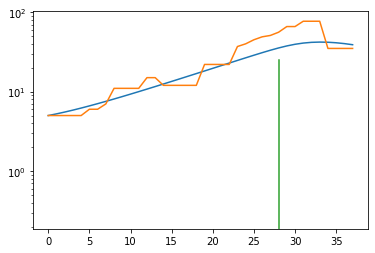

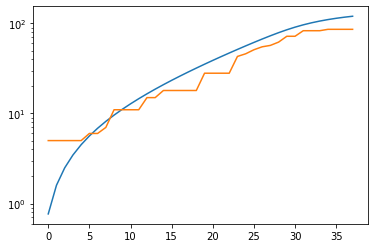

total error: 0.09272075444459915


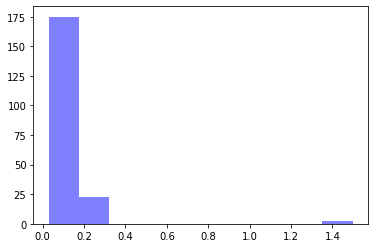

alpha: 0.9988331 , beta: 0.19031827 , initial_unconfirmed 6.960912 , t0s 23.08489 , lambds 0.9547601


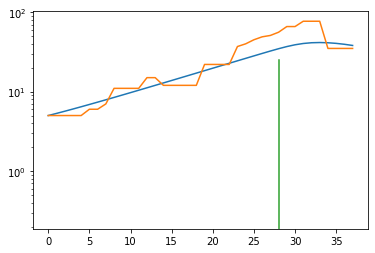

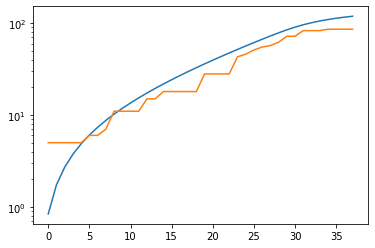

total error: 0.06520015001296997


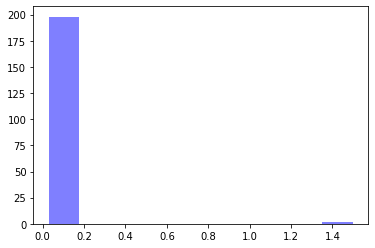

alpha: 0.99886996 , beta: 0.18919782 , initial_unconfirmed 7.09326 , t0s 23.338972 , lambds 0.97893345


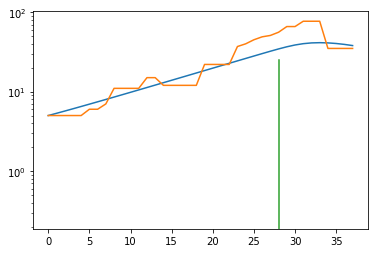

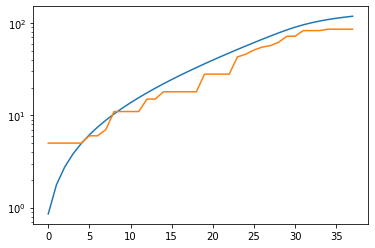

total error: 0.04442398250102997


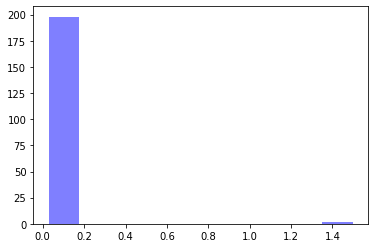

alpha: 0.99887645 , beta: 0.18900792 , initial_unconfirmed 7.1164002 , t0s 23.417349 , lambds 0.9881451


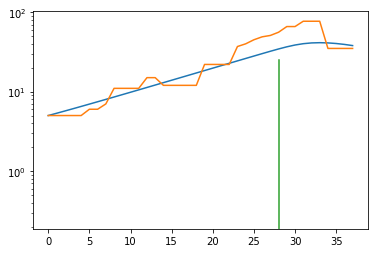

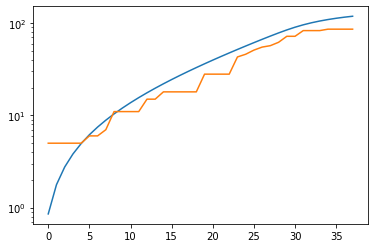

Saint-Martin
Monaco
total error: 4.096752166748047


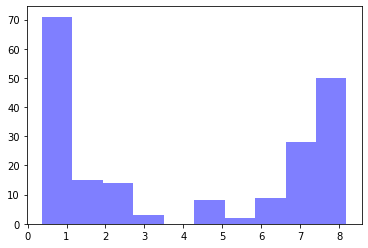

alpha: 0.8035283 , beta: 0.38293025 , initial_unconfirmed 2.055636 , t0s 0.2877125 , lambds 0.5227258


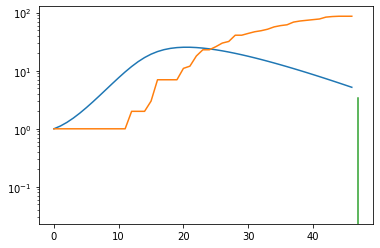

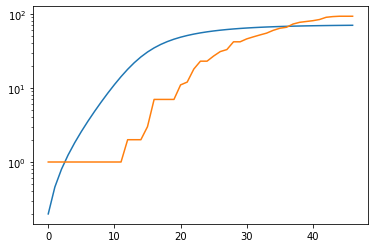

total error: 0.25300803780555725


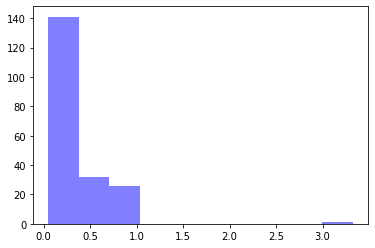

alpha: 0.5035027 , beta: 0.26736507 , initial_unconfirmed 1.5680509 , t0s 4.957918 , lambds 0.21897675


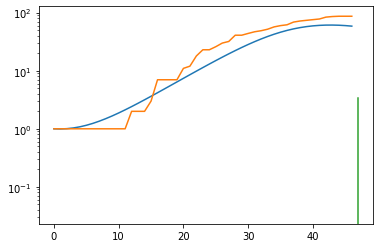

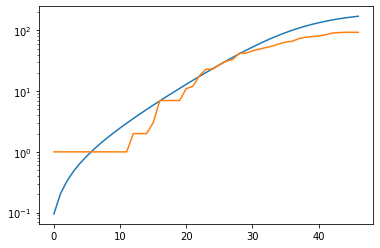

total error: 0.23519745469093323


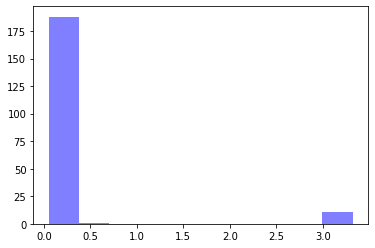

alpha: 0.93666565 , beta: 0.2646799 , initial_unconfirmed 0.85611236 , t0s 10.607039 , lambds 0.27298576


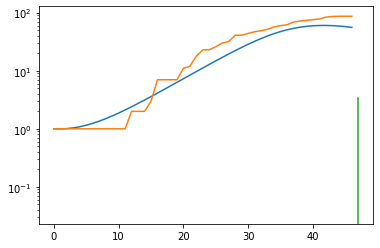

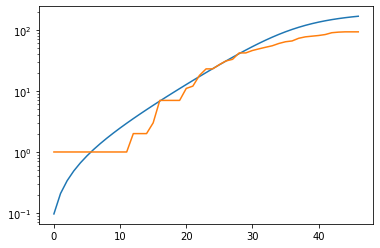

total error: 0.23177117109298706


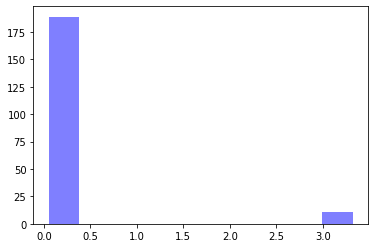

alpha: 0.99999505 , beta: 0.26430848 , initial_unconfirmed 0.8040262 , t0s 11.428321 , lambds 0.28301263


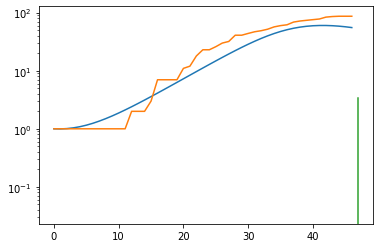

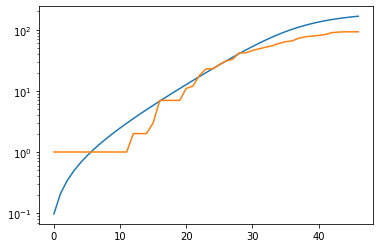

total error: 0.23169417679309845


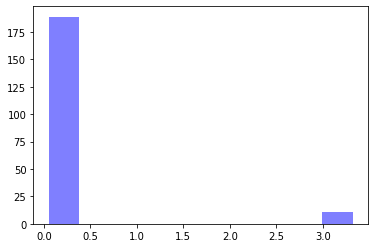

alpha: 0.99999505 , beta: 0.264249 , initial_unconfirmed 0.80437875 , t0s 11.563301 , lambds 0.2847209


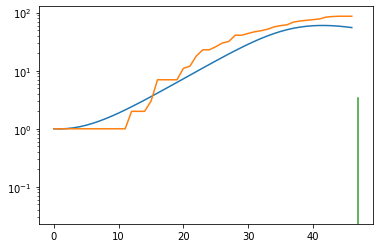

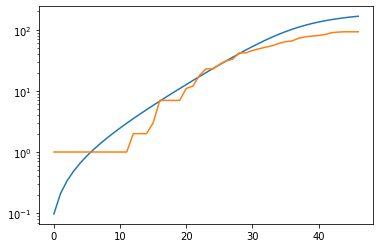

Philippines
total error: 8.28688907623291


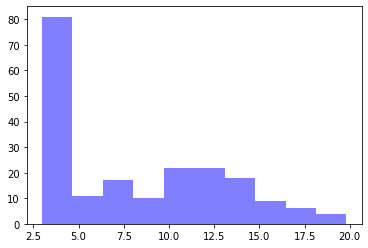

alpha: 0.99827206 , beta: 0.28114367 , initial_unconfirmed 22.195875 , t0s 0.48801118 , lambds 0.61915946


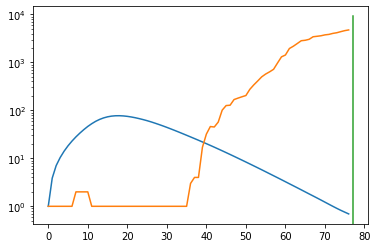

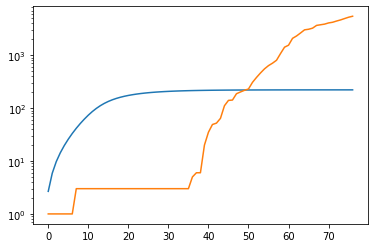

total error: 1.3791836500167847


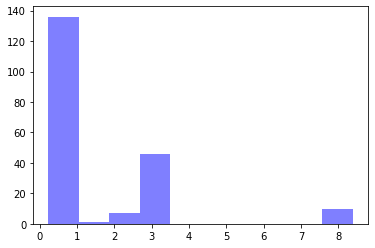

alpha: 0.50079113 , beta: 0.26186258 , initial_unconfirmed 0.41753498 , t0s 4.5328126 , lambds 0.00052619766


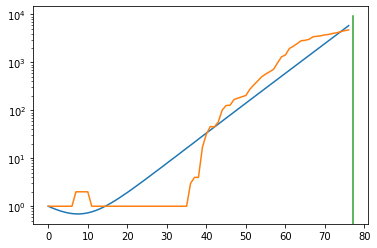

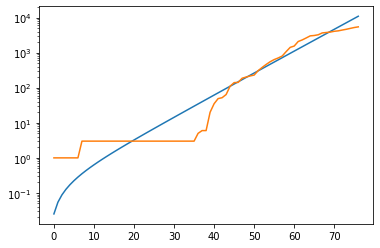

total error: 0.699781060218811


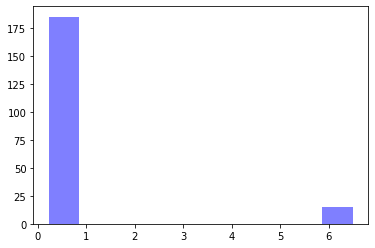

alpha: 0.9982368 , beta: 0.2622584 , initial_unconfirmed 0.21654457 , t0s 4.288428 , lambds 0.0006297193


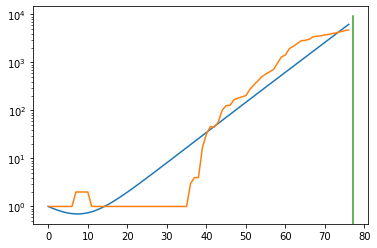

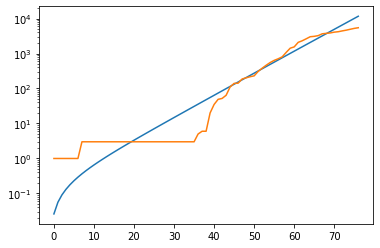

total error: 0.7252442240715027


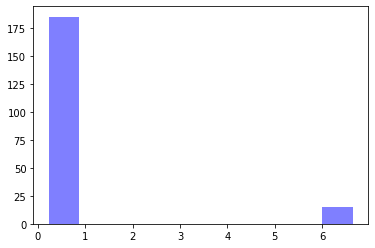

alpha: 0.9990144 , beta: 0.26449594 , initial_unconfirmed 0.20289643 , t0s 4.2934437 , lambds 0.0003721219


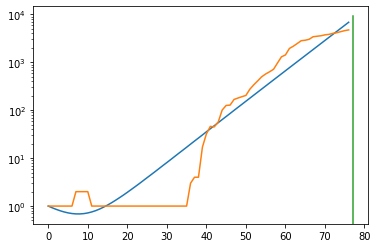

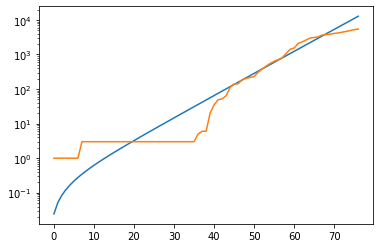

total error: 0.6950690746307373


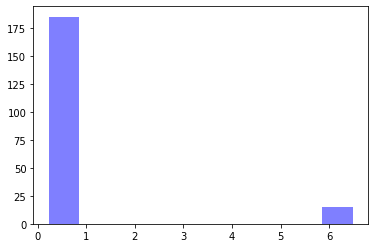

alpha: 0.6482066 , beta: 0.26308274 , initial_unconfirmed 0.34484354 , t0s 0.0 , lambds 0.02686091


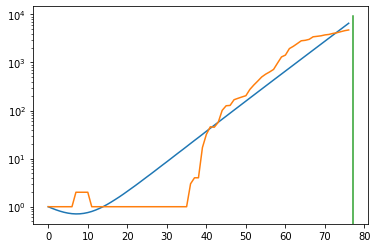

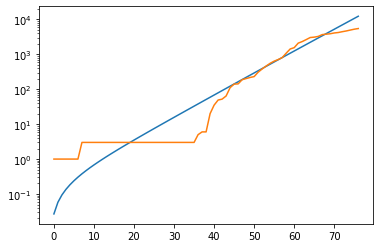

Zambia
total error: 4.94425106048584


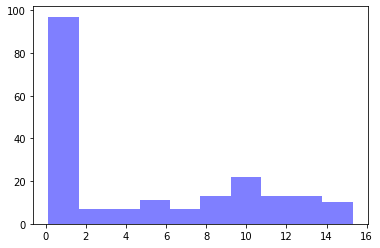

alpha: 0.98231065 , beta: 0.10487953 , initial_unconfirmed 15.581822 , t0s 0.7458969 , lambds 0.51916856


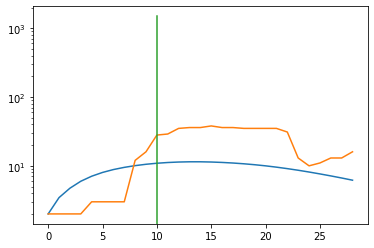

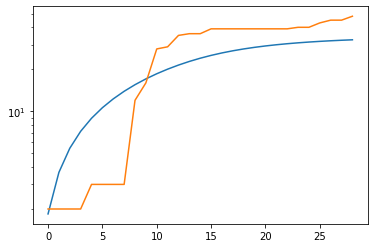

total error: 0.07412969321012497


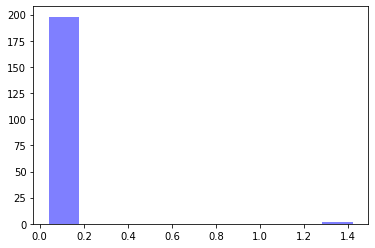

alpha: 0.5008687 , beta: 0.3586604 , initial_unconfirmed 6.9669585 , t0s 3.9025886 , lambds 0.9923273


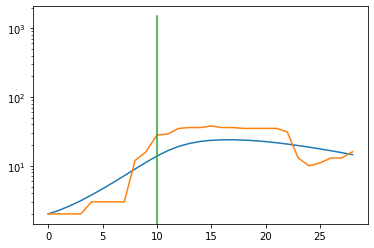

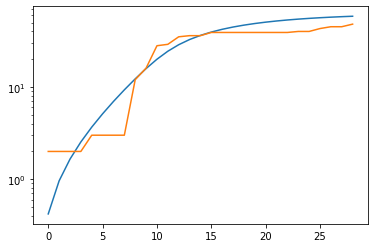

total error: 0.06406162679195404


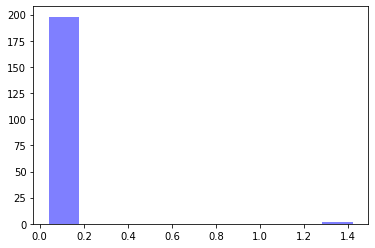

alpha: 0.5013939 , beta: 0.3586248 , initial_unconfirmed 6.9614706 , t0s 3.9390047 , lambds 0.9979905


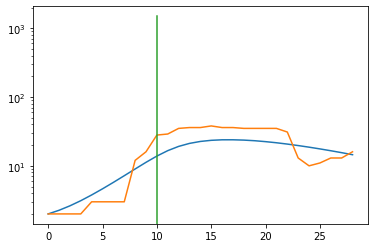

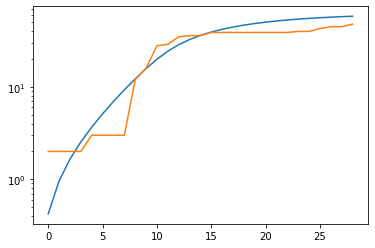

total error: 0.057294540107250214


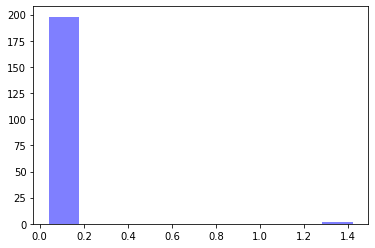

alpha: 0.50086814 , beta: 0.35778165 , initial_unconfirmed 6.98505 , t0s 3.9732304 , lambds 0.999042


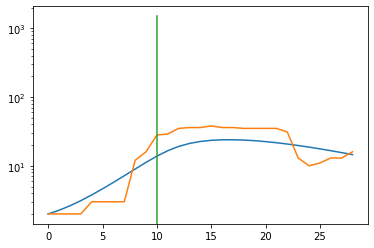

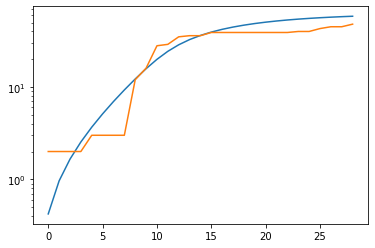

total error: 0.055047906935214996


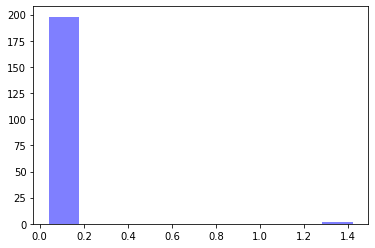

alpha: 0.5013934 , beta: 0.3577734 , initial_unconfirmed 6.9764886 , t0s 3.9736273 , lambds 0.99912566


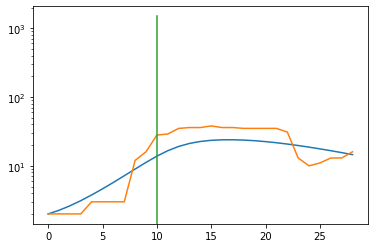

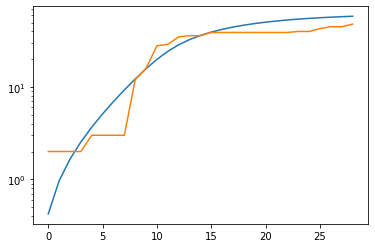

San Marino
total error: 2.2330543994903564


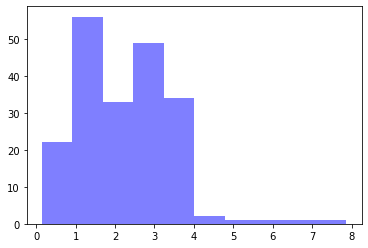

alpha: 0.8527168 , beta: 0.3991331 , initial_unconfirmed 12.213987 , t0s 0.9306921 , lambds 0.6182317


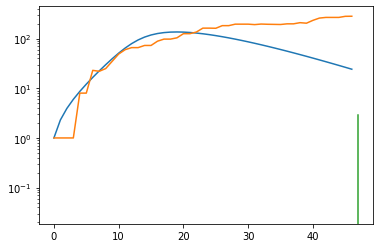

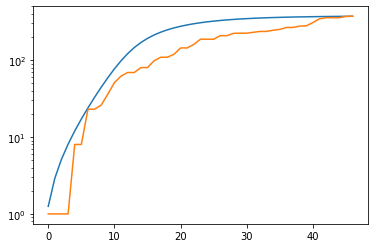

total error: 0.09494972974061966


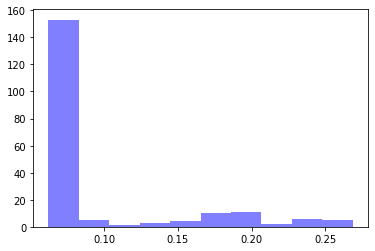

alpha: 0.50190187 , beta: 0.27120215 , initial_unconfirmed 19.503235 , t0s 0.0 , lambds 0.26624906


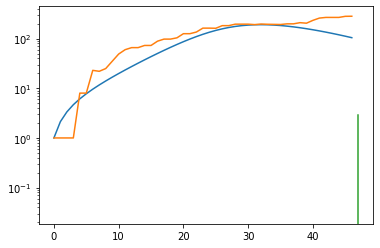

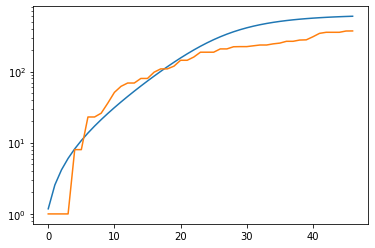

total error: 0.0628603920340538


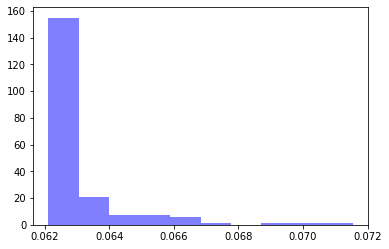

alpha: 0.50085443 , beta: 0.27273583 , initial_unconfirmed 19.231438 , t0s 0.0 , lambds 0.26773173


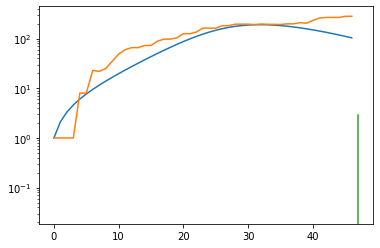

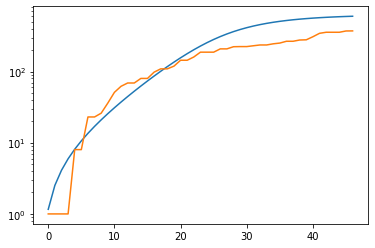

total error: 0.06228173151612282


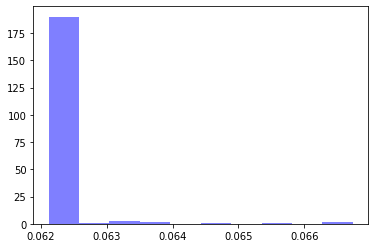

alpha: 0.5002456 , beta: 0.27268624 , initial_unconfirmed 19.265112 , t0s 0.0 , lambds 0.26767883


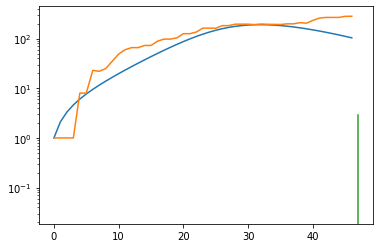

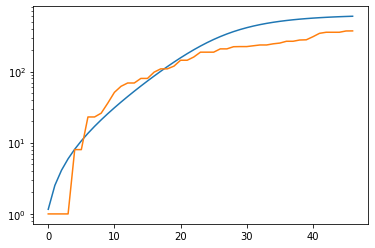

total error: 0.06221010163426399


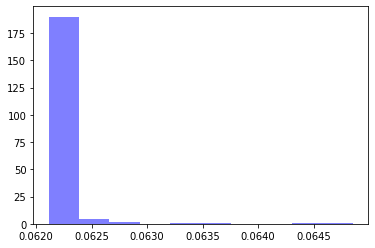

alpha: 0.50016606 , beta: 0.2727043 , initial_unconfirmed 19.264383 , t0s 0.0 , lambds 0.2677042


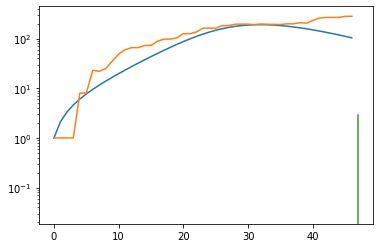

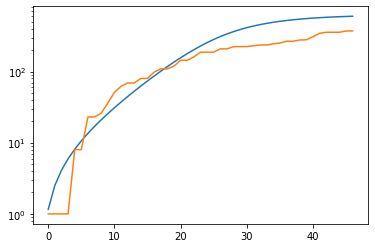

Trinidad and Tobago
total error: 3.4614245891571045


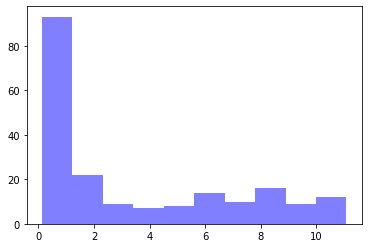

alpha: 0.9994428 , beta: 0.5003588 , initial_unconfirmed 4.958758 , t0s 0.21048146 , lambds 0.64891016


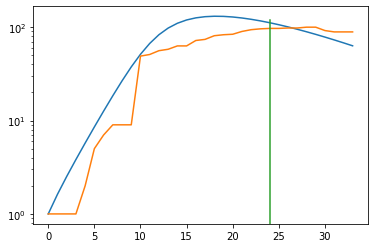

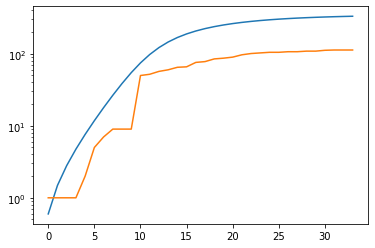

total error: 0.08869587630033493


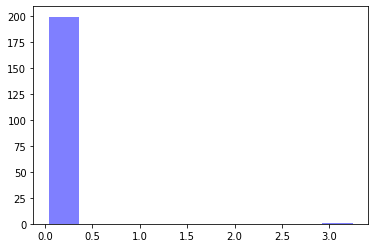

alpha: 0.96898365 , beta: 0.44346675 , initial_unconfirmed 2.518324 , t0s 0.0 , lambds 0.51557726


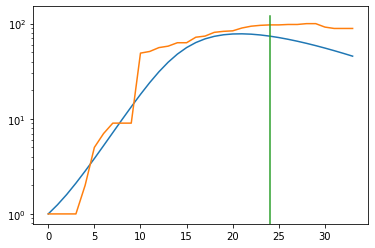

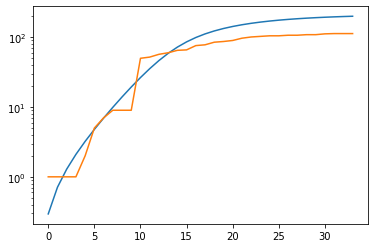

total error: 0.059382807463407516


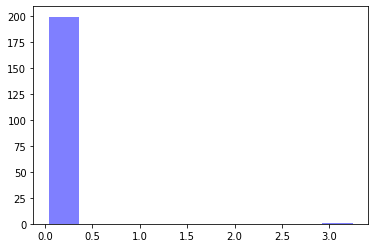

alpha: 0.96898365 , beta: 0.44346675 , initial_unconfirmed 2.518324 , t0s 0.0 , lambds 0.51557726


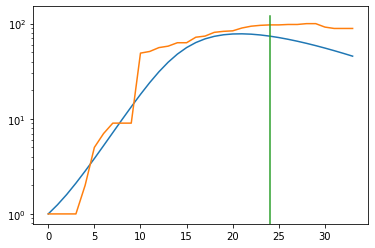

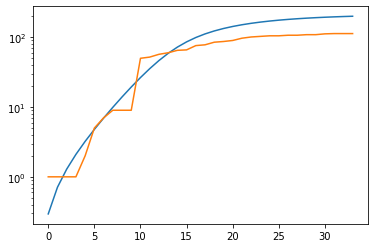

total error: 0.05515659227967262


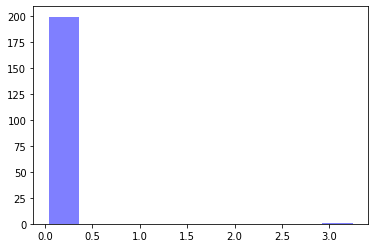

alpha: 0.5067148 , beta: 0.44367445 , initial_unconfirmed 4.8122697 , t0s 0.0 , lambds 0.5157735


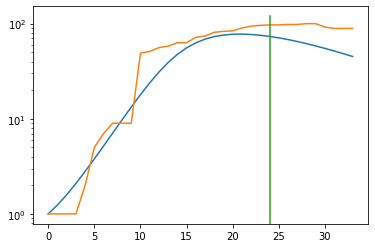

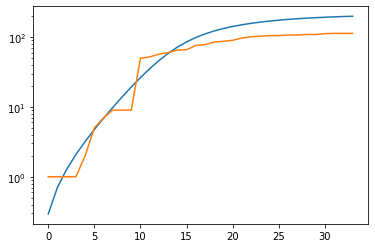

total error: 0.05515856295824051


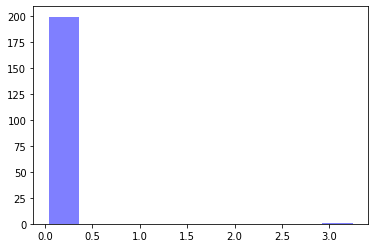

alpha: 0.5067148 , beta: 0.44367445 , initial_unconfirmed 4.8122697 , t0s 0.0 , lambds 0.5157735


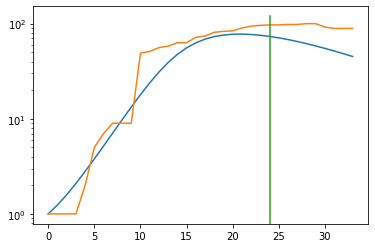

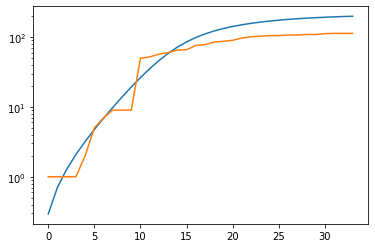

Djibouti
total error: 3.784069538116455


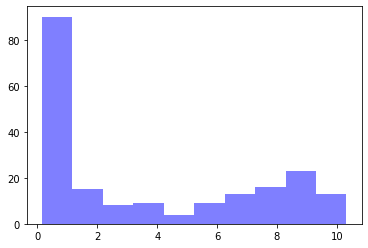

alpha: 0.9796907 , beta: 0.7109278 , initial_unconfirmed 0.2898842 , t0s 0.72902685 , lambds 0.71238154


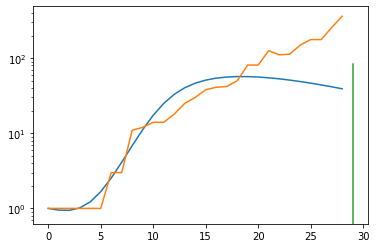

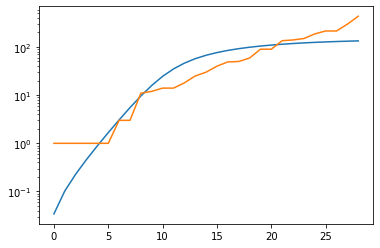

total error: 0.11100219935178757


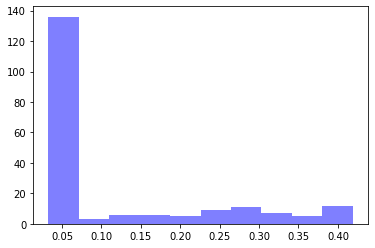

alpha: 0.5011208 , beta: 0.35782558 , initial_unconfirmed 3.992323 , t0s 0.0 , lambds 0.2821281


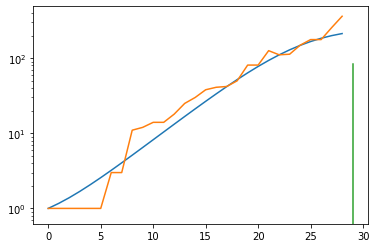

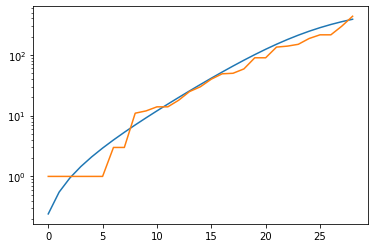

total error: 0.034473080188035965


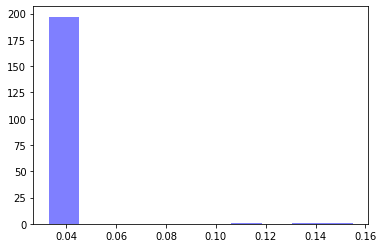

alpha: 0.5021909 , beta: 0.35775605 , initial_unconfirmed 3.986052 , t0s 0.0 , lambds 0.28201428


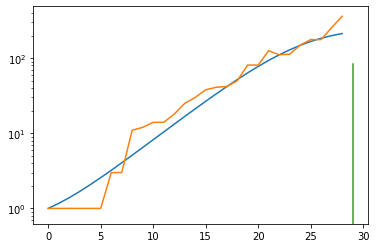

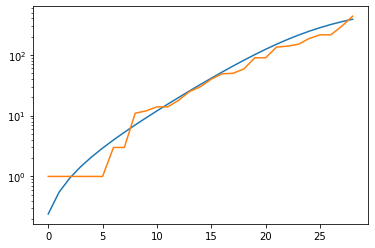

total error: 0.032824721187353134


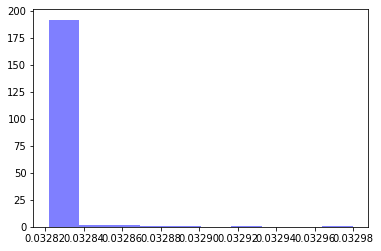

alpha: 0.5001179 , beta: 0.3577558 , initial_unconfirmed 4.0025797 , t0s 0.0 , lambds 0.28201908


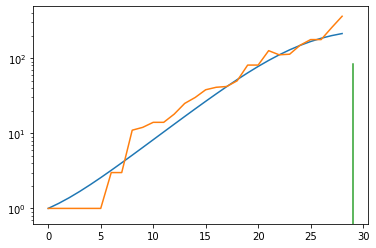

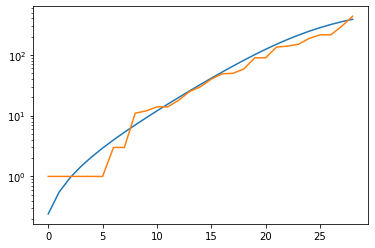

total error: 0.03282502293586731


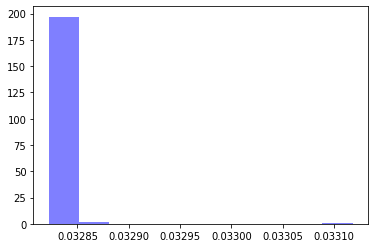

alpha: 0.5001179 , beta: 0.3577558 , initial_unconfirmed 4.0025797 , t0s 0.0 , lambds 0.28201908


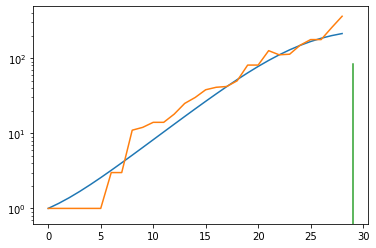

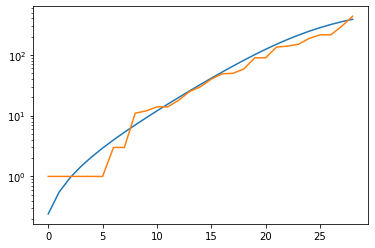

Mauritania
total error: 7.951716899871826


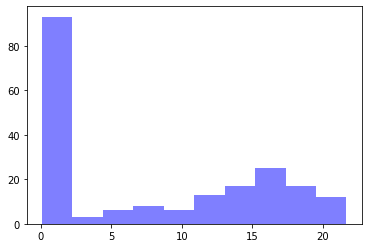

alpha: 0.99729204 , beta: 0.05480656 , initial_unconfirmed 6.6966295 , t0s 0.8632677 , lambds 0.6478168


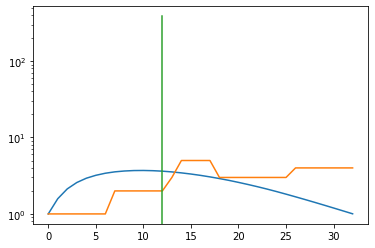

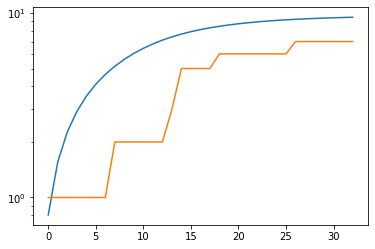

total error: 0.10503718256950378


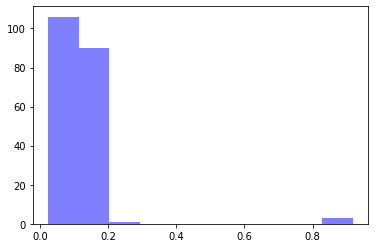

alpha: 0.63110006 , beta: 0.14356002 , initial_unconfirmed 3.0843105 , t0s 2.701599 , lambds 0.20638375


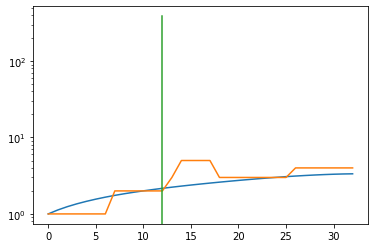

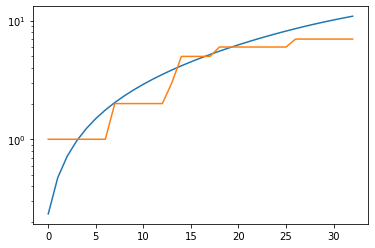

total error: 0.06802498549222946


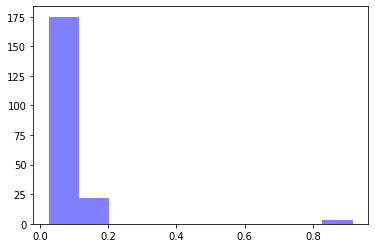

alpha: 0.8131211 , beta: 0.14329998 , initial_unconfirmed 2.3945942 , t0s 6.2535343 , lambds 0.24593449


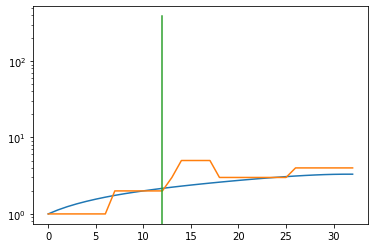

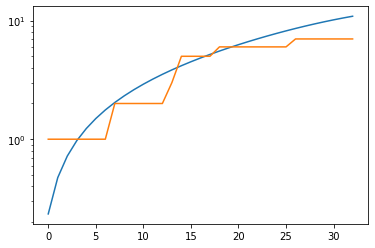

total error: 0.05594642087817192


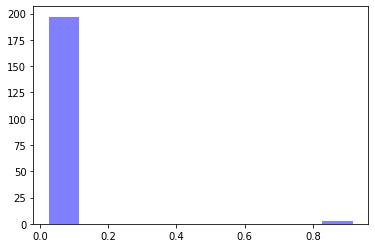

alpha: 0.8137962 , beta: 0.14289667 , initial_unconfirmed 2.396664 , t0s 9.52839 , lambds 0.29231775


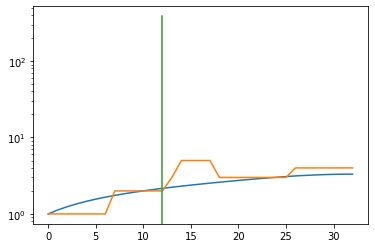

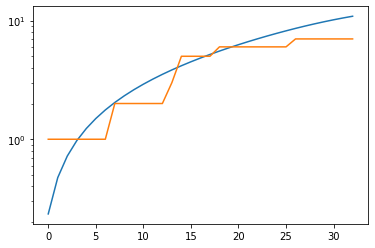

total error: 0.04961274191737175


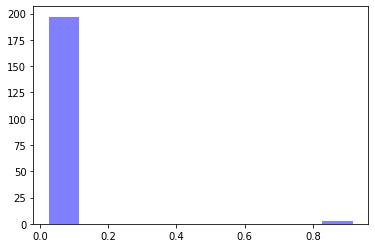

alpha: 0.8137962 , beta: 0.14289667 , initial_unconfirmed 2.396664 , t0s 9.52839 , lambds 0.29231775


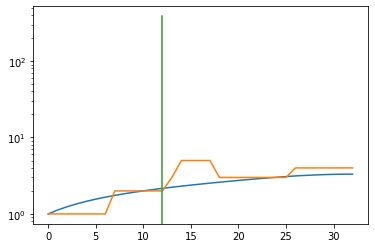

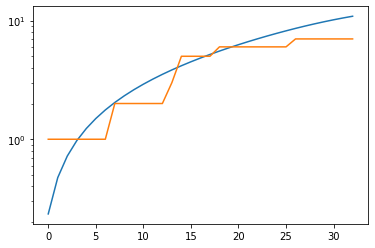

Ireland
total error: 3.8836419582366943


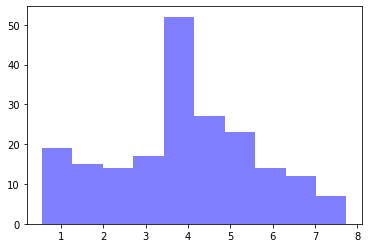

alpha: 0.99585867 , beta: 0.74633855 , initial_unconfirmed 5.8570952 , t0s 0.19985098 , lambds 0.6084951


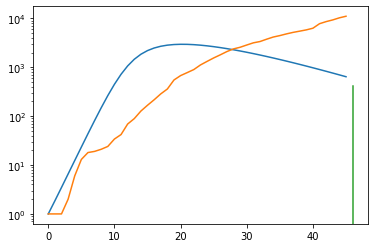

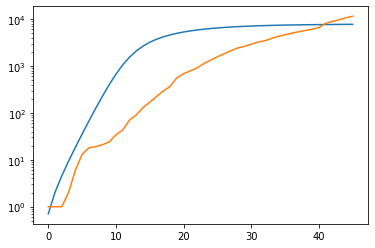

total error: 0.04831947758793831


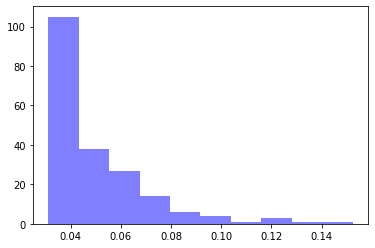

alpha: 0.51127803 , beta: 0.3841071 , initial_unconfirmed 11.876786 , t0s 0.0 , lambds 0.22936337


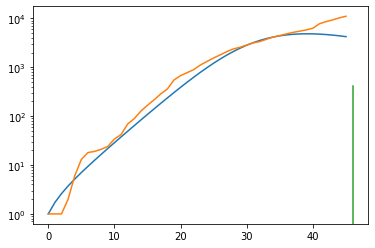

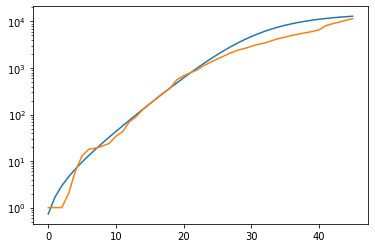

total error: 0.03296953812241554


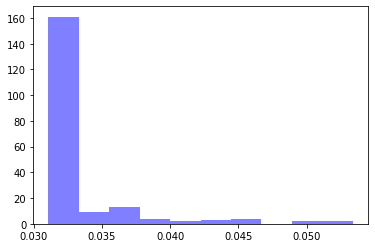

alpha: 0.5009969 , beta: 0.3842262 , initial_unconfirmed 12.100082 , t0s 0.0 , lambds 0.2294218


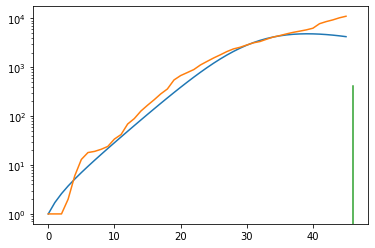

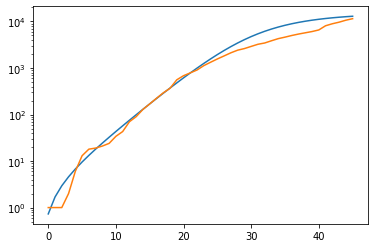

total error: 0.031132612377405167


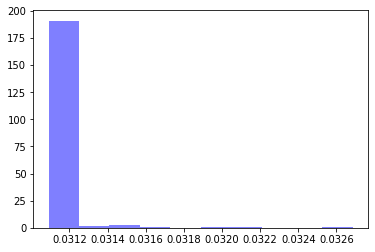

alpha: 0.50062984 , beta: 0.38420326 , initial_unconfirmed 12.112096 , t0s 0.0 , lambds 0.22940883


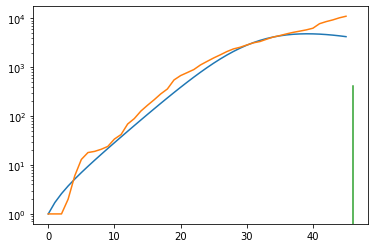

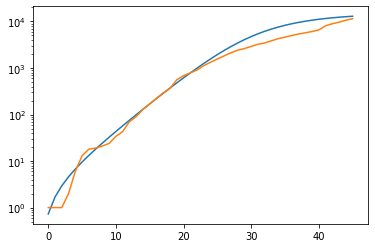

total error: 0.031112458556890488


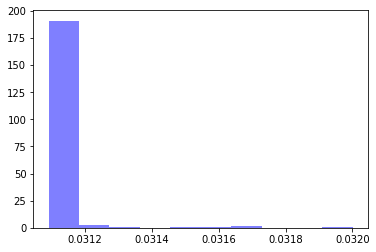

alpha: 0.50062984 , beta: 0.38420326 , initial_unconfirmed 12.112096 , t0s 0.0 , lambds 0.22940883


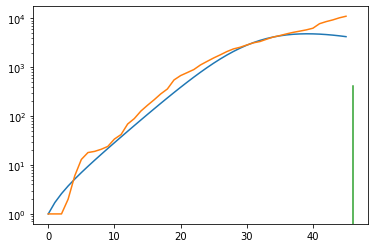

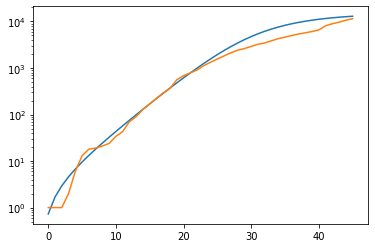

Myanmar
total error: 4.52512264251709


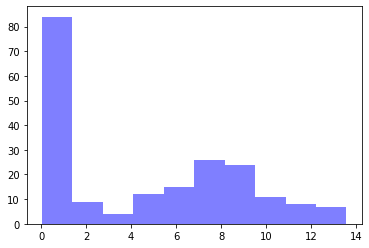

alpha: 0.9999426 , beta: 0.16077948 , initial_unconfirmed 15.04125 , t0s 0.955943 , lambds 0.51168627


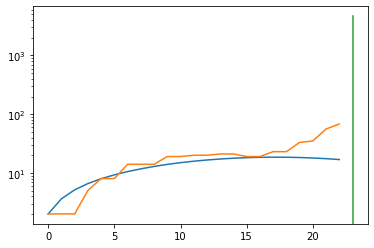

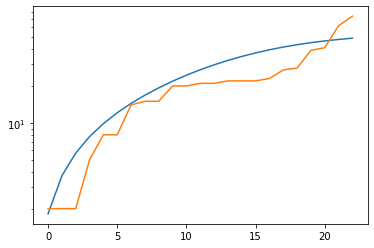

total error: 0.03730643913149834


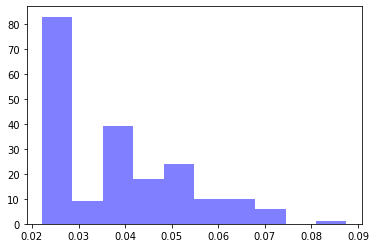

alpha: 0.5025863 , beta: 0.19410521 , initial_unconfirmed 19.880772 , t0s 2.0633163 , lambds 0.0012614105


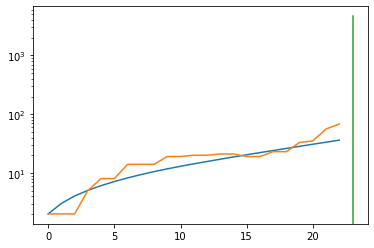

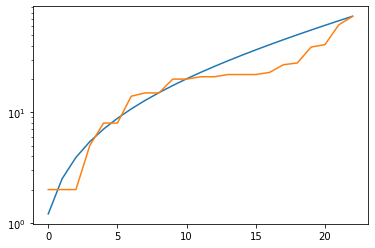

total error: 0.03223443403840065


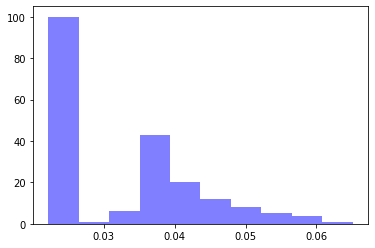

alpha: 0.50137913 , beta: 0.19414113 , initial_unconfirmed 19.920961 , t0s 3.1780546 , lambds 0.00088742306


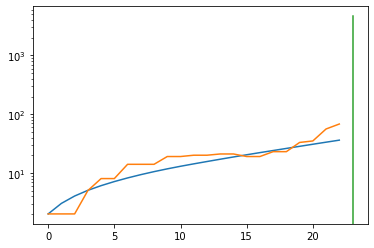

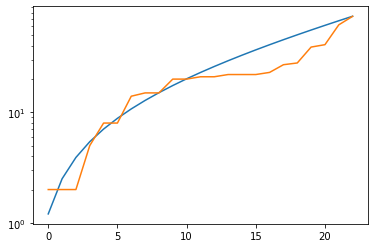

total error: 0.02954675257205963


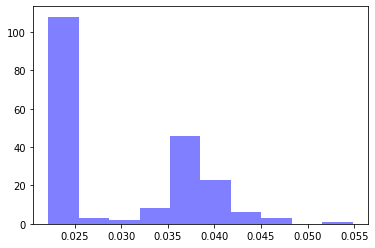

alpha: 0.7773245 , beta: 0.19414158 , initial_unconfirmed 12.848921 , t0s 3.6931627 , lambds 0.0014415502


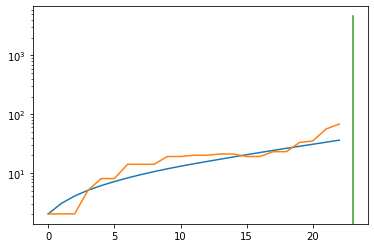

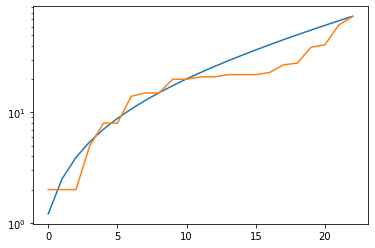

total error: 0.028223026543855667


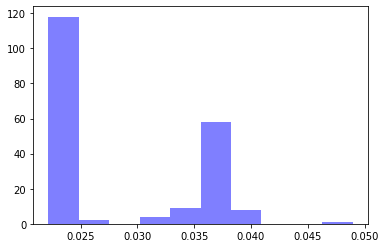

alpha: 0.5013785 , beta: 0.19413821 , initial_unconfirmed 19.92083 , t0s 3.1785161 , lambds 0.0005594019


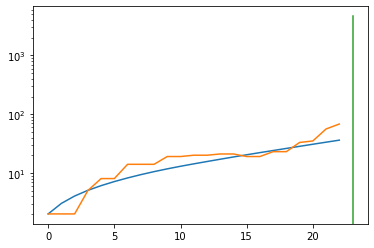

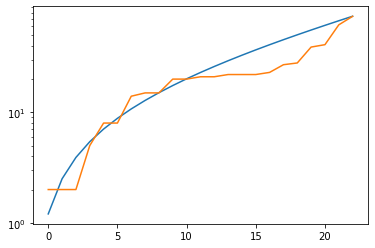

Kosovo
Vatican
total error: 2.3811352252960205


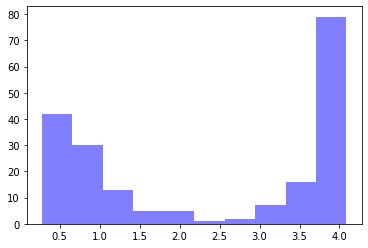

alpha: 0.99996805 , beta: 0.10495184 , initial_unconfirmed 4.429376 , t0s 0.80648035 , lambds 0.6448854


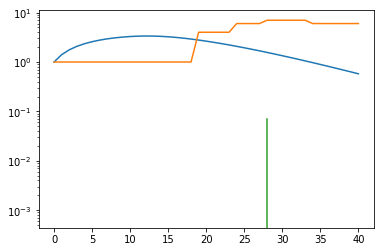

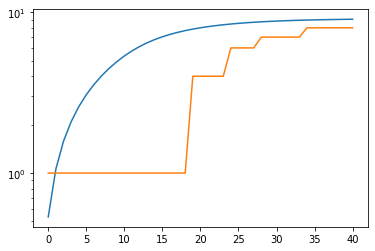

total error: 0.24731376767158508


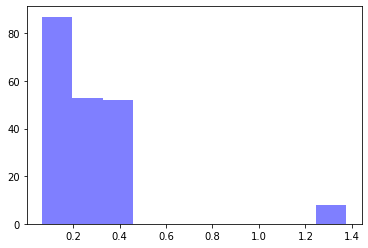

alpha: 0.9728241 , beta: 0.18328415 , initial_unconfirmed 0.8442616 , t0s 0.0 , lambds 0.15174074


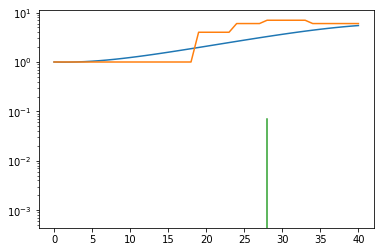

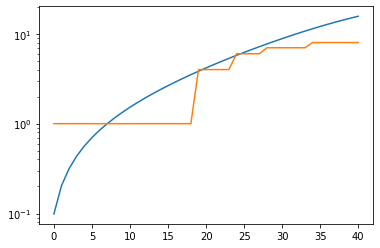

total error: 0.11903366446495056


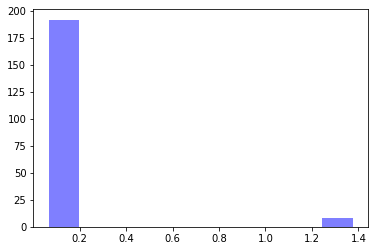

alpha: 0.9169796 , beta: 0.1832969 , initial_unconfirmed 0.894092 , t0s 3.2841644 , lambds 0.17196421


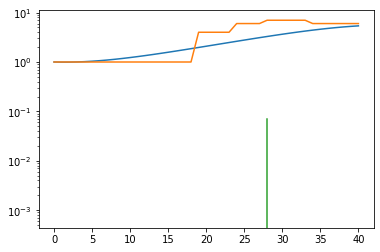

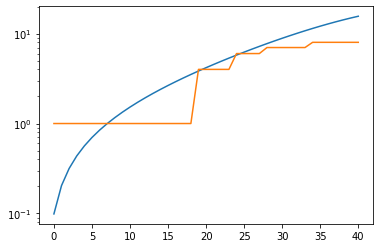

total error: 0.11902575194835663


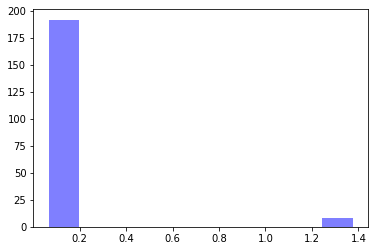

alpha: 0.9432905 , beta: 0.18355292 , initial_unconfirmed 0.8661884 , t0s 4.7365627 , lambds 0.18524674


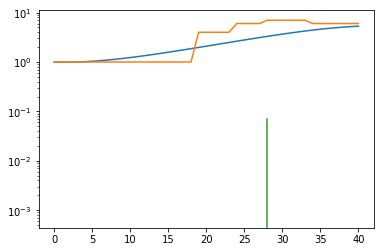

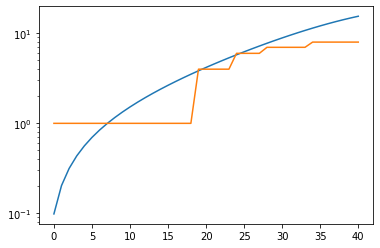

total error: 0.11901930719614029


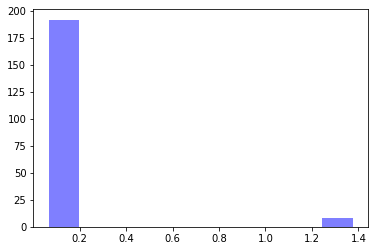

alpha: 0.96201 , beta: 0.18387817 , initial_unconfirmed 0.8454281 , t0s 7.0130887 , lambds 0.20806791


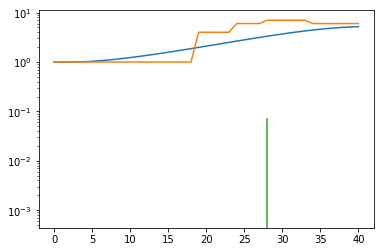

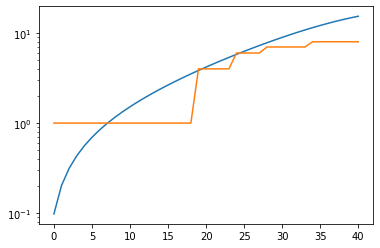

Ukraine
total error: 5.439916610717773


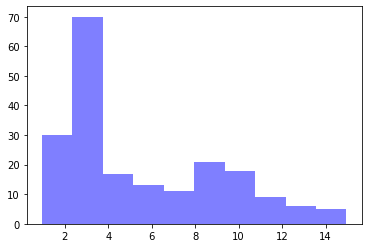

alpha: 0.9990841 , beta: 0.9995309 , initial_unconfirmed 0.015428662 , t0s 0.42199427 , lambds 0.6319967


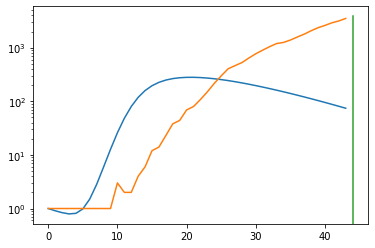

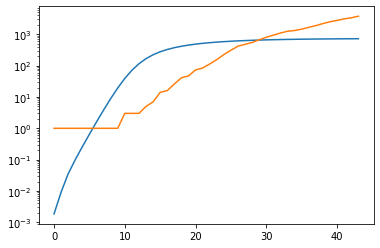

total error: 0.3755069971084595


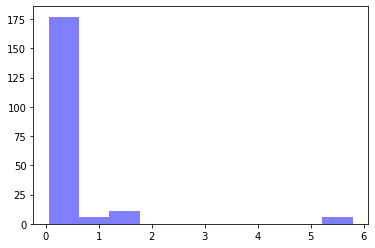

alpha: 0.50218797 , beta: 0.39260098 , initial_unconfirmed 1.1358528 , t0s 3.6321867 , lambds 0.21674083


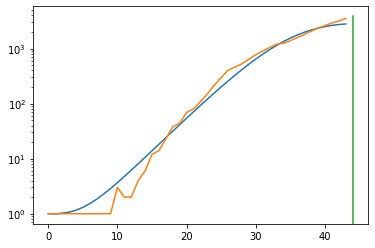

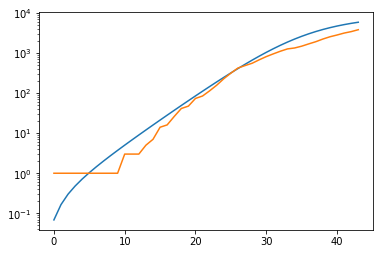

total error: 0.23081038892269135


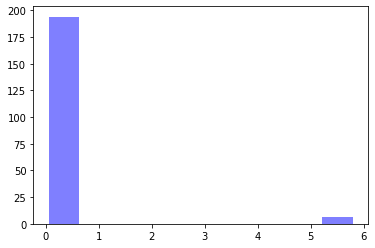

alpha: 0.97000945 , beta: 0.38838485 , initial_unconfirmed 0.6050087 , t0s 10.732848 , lambds 0.28847137


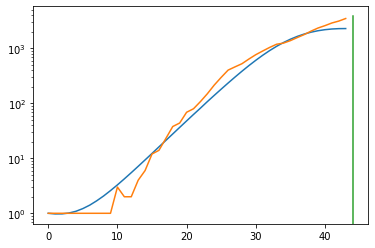

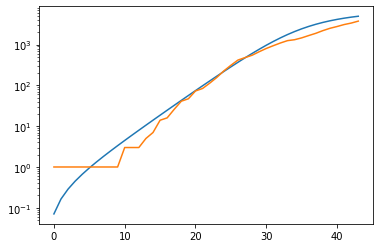

total error: 0.22855502367019653


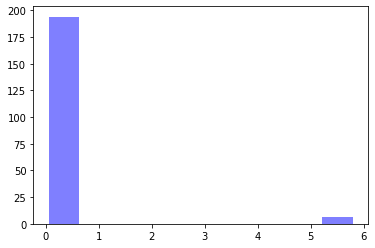

alpha: 0.9998702 , beta: 0.38744375 , initial_unconfirmed 0.59118086 , t0s 12.11264 , lambds 0.30792856


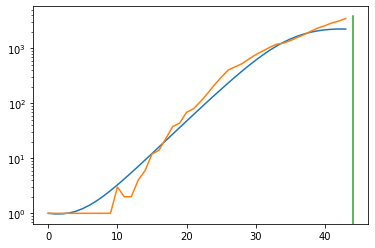

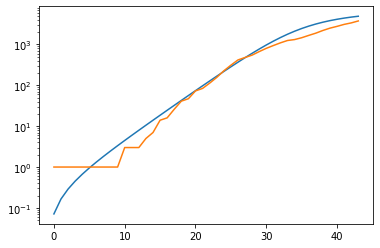

total error: 0.22851957380771637


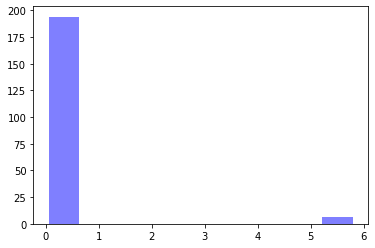

alpha: 0.99614686 , beta: 0.38744554 , initial_unconfirmed 0.59347576 , t0s 12.119567 , lambds 0.30803424


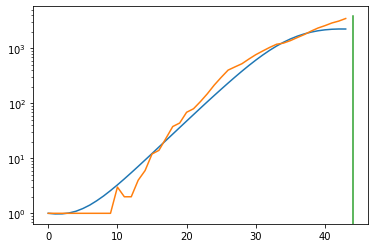

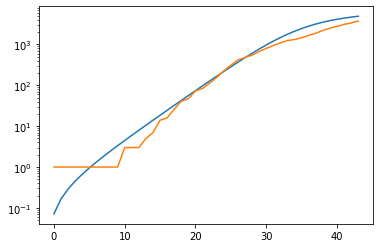

Afghanistan
total error: 5.978745937347412


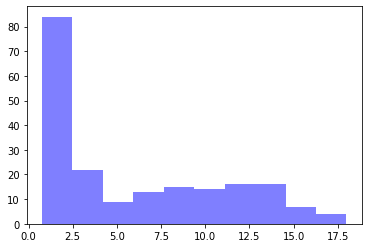

alpha: 0.98973215 , beta: 0.7040616 , initial_unconfirmed 0.28944612 , t0s 0.8256203 , lambds 0.60919636


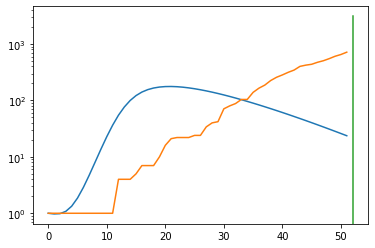

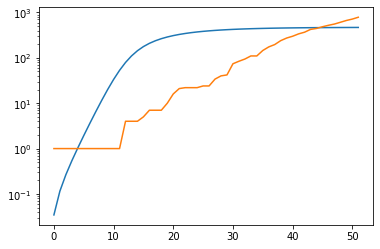

total error: 0.4105960428714752


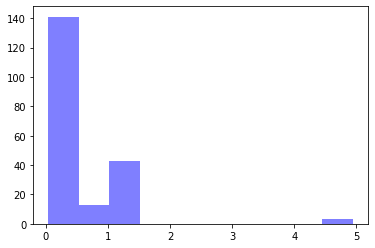

alpha: 0.9996004 , beta: 0.280132 , initial_unconfirmed 0.81542784 , t0s 3.3514512 , lambds 0.14351504


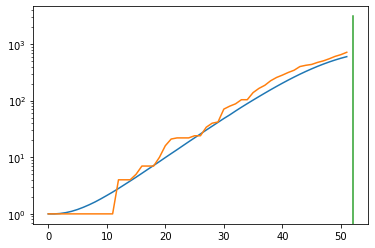

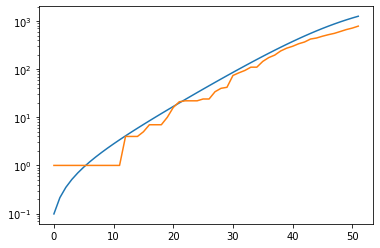

total error: 0.1187555193901062


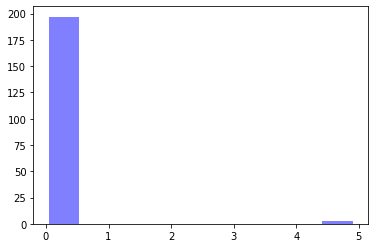

alpha: 0.9709866 , beta: 0.28001714 , initial_unconfirmed 0.840552 , t0s 4.7981086 , lambds 0.1491936


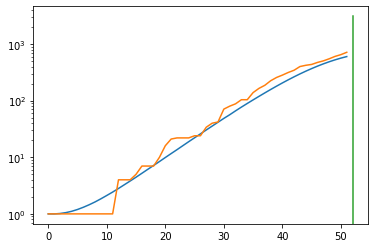

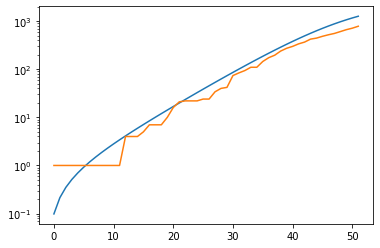

total error: 0.11509288847446442


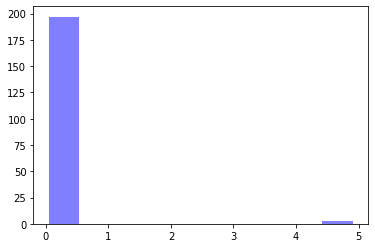

alpha: 0.9858957 , beta: 0.27646694 , initial_unconfirmed 0.8520464 , t0s 21.170351 , lambds 0.2692086


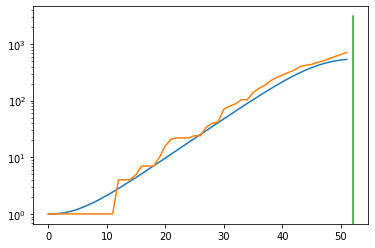

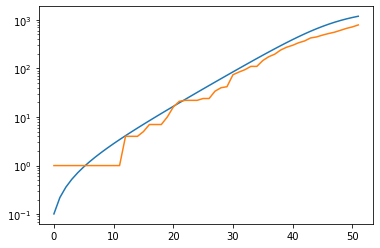

total error: 0.11476217955350876


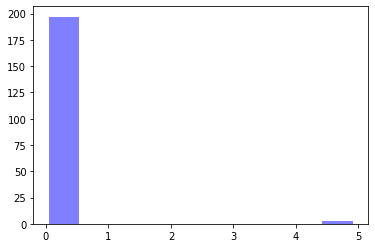

alpha: 0.9908898 , beta: 0.27567998 , initial_unconfirmed 0.8547864 , t0s 25.106842 , lambds 0.329653


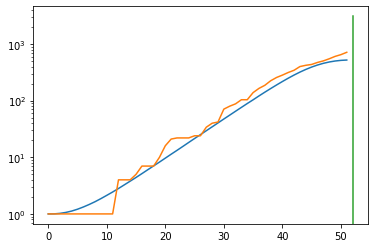

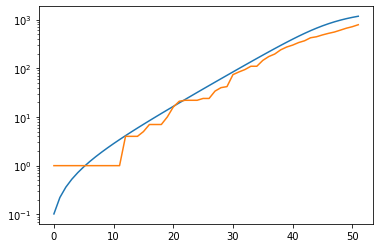

Laos
total error: 4.414514064788818


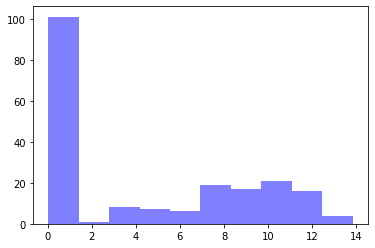

alpha: 0.99977046 , beta: 0.1552812 , initial_unconfirmed 9.394682 , t0s 0.6490299 , lambds 0.727952


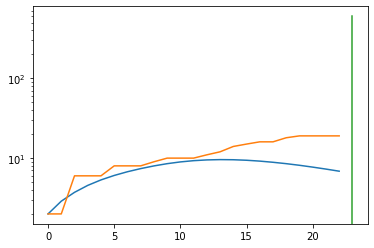

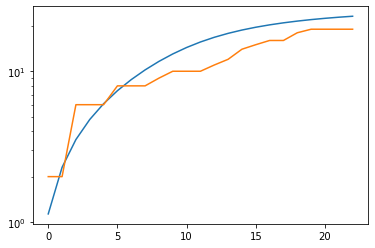

total error: 0.039448171854019165


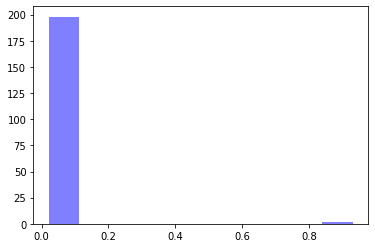

alpha: 0.5084788 , beta: 0.1376636 , initial_unconfirmed 19.057455 , t0s 2.3879447 , lambds 0.002200673


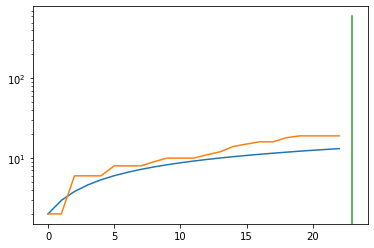

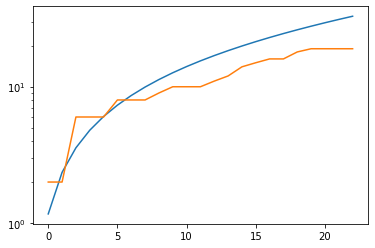

total error: 0.03710399940609932


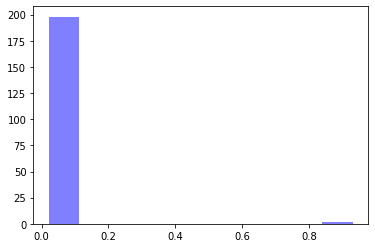

alpha: 0.5026288 , beta: 0.13766775 , initial_unconfirmed 19.278187 , t0s 0.8637689 , lambds 0.0005782948


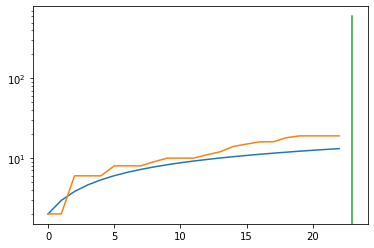

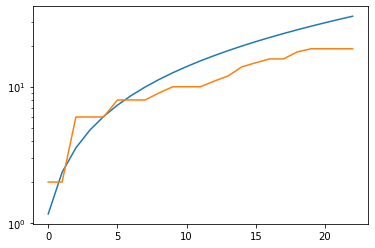

total error: 0.03559223562479019


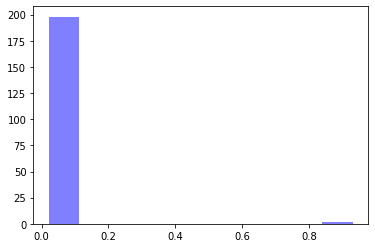

alpha: 0.50262886 , beta: 0.13766862 , initial_unconfirmed 19.278038 , t0s 0.864007 , lambds 0.00038101577


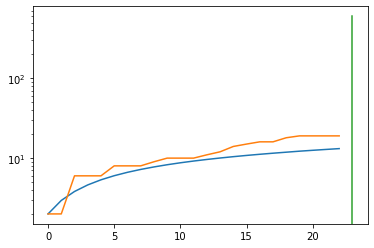

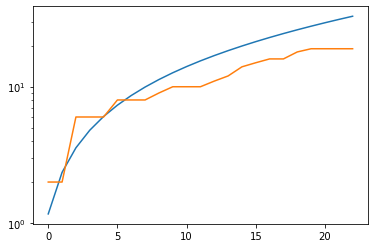

total error: 0.03472420573234558


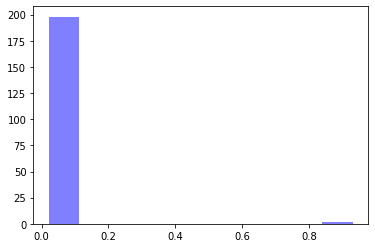

alpha: 0.72754633 , beta: 0.13764906 , initial_unconfirmed 13.319461 , t0s 2.4051795 , lambds 0.0004303359


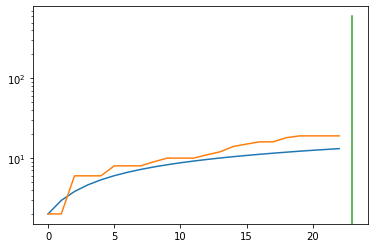

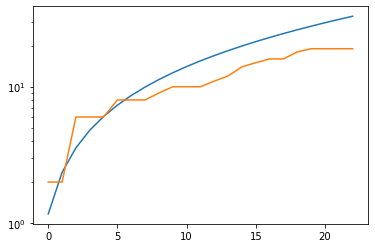

Comoros
Israel
total error: 4.5550618171691895


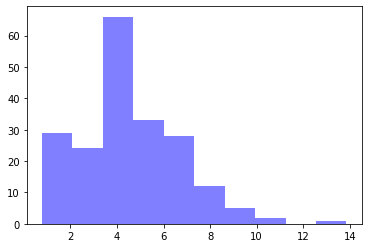

alpha: 0.7925767 , beta: 0.7292131 , initial_unconfirmed 2.2748737 , t0s 0.24801534 , lambds 0.54855466


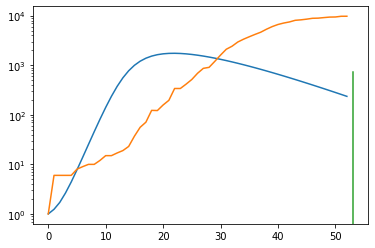

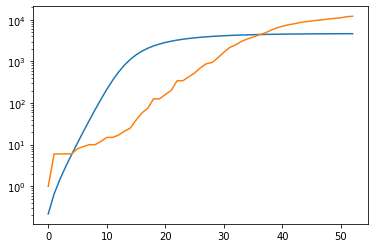

total error: 0.05428055673837662


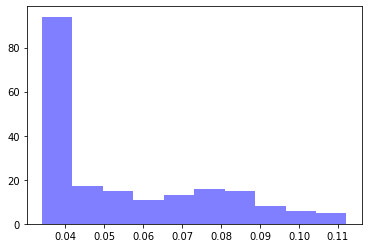

alpha: 0.997272 , beta: 0.32897672 , initial_unconfirmed 5.3821893 , t0s 4.412947 , lambds 0.18861234


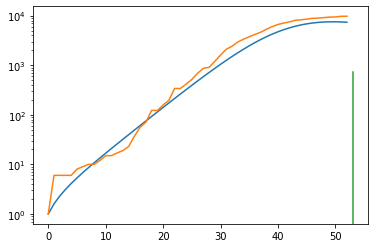

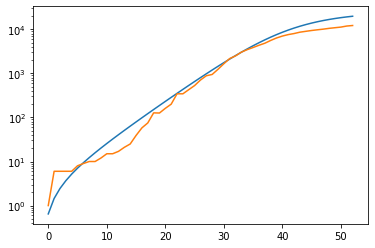

total error: 0.037533003836870193


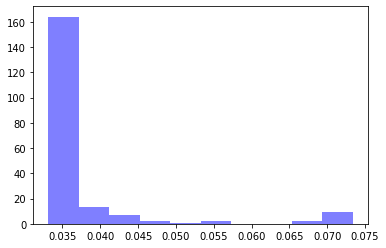

alpha: 0.69277465 , beta: 0.32233706 , initial_unconfirmed 8.087118 , t0s 18.922934 , lambds 0.33100104


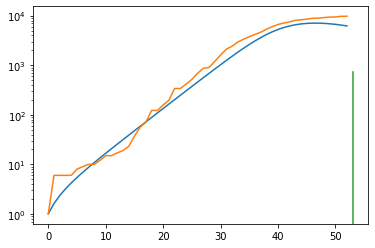

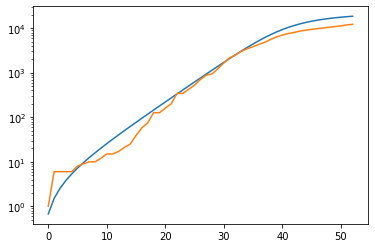

total error: 0.03414945304393768


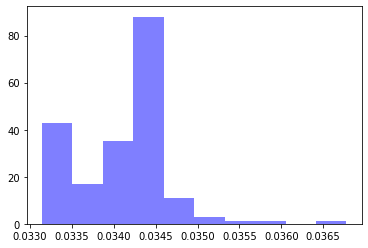

alpha: 0.999941 , beta: 0.32260168 , initial_unconfirmed 5.591702 , t0s 18.234026 , lambds 0.31975618


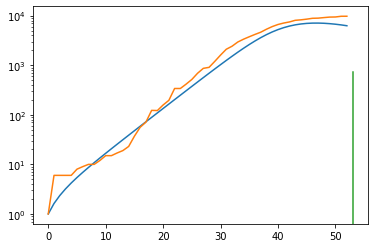

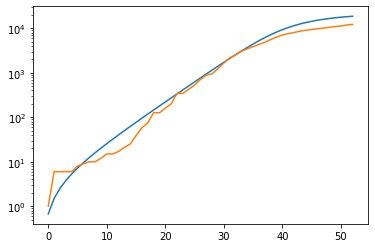

total error: 0.03406567499041557


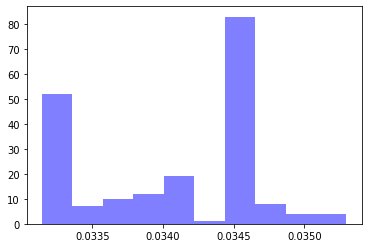

alpha: 0.99776065 , beta: 0.32270497 , initial_unconfirmed 5.59628 , t0s 18.074863 , lambds 0.3172946


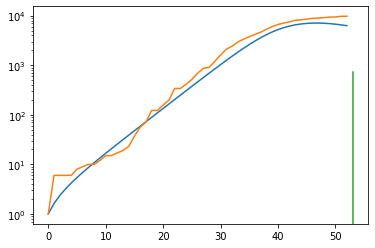

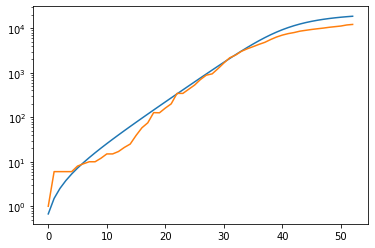

Greenland
total error: 3.872528076171875


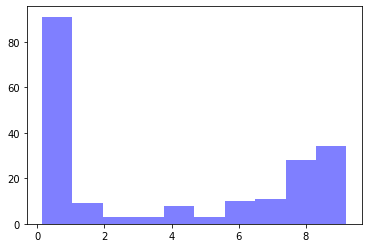

alpha: 0.99814045 , beta: 0.067091435 , initial_unconfirmed 5.6663394 , t0s 0.31656623 , lambds 0.505455


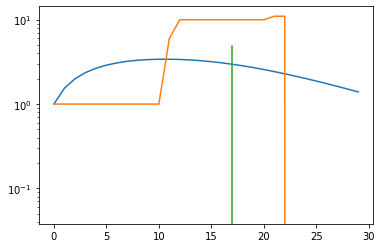

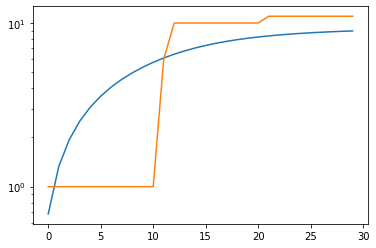

total error: 0.14119425415992737


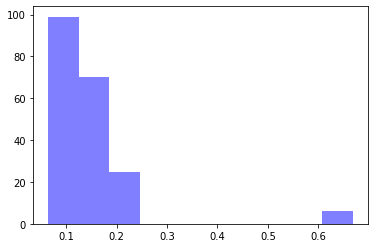

alpha: 0.50476396 , beta: 0.2678759 , initial_unconfirmed 2.4132745 , t0s 8.118189 , lambds 0.9839909


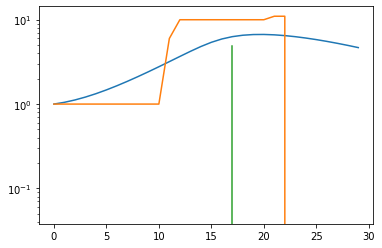

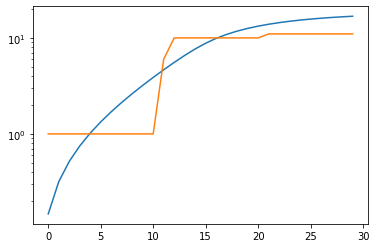

total error: 0.10030271857976913


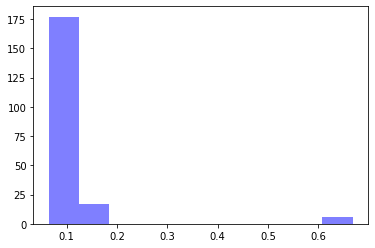

alpha: 0.5047695 , beta: 0.26794168 , initial_unconfirmed 2.412205 , t0s 8.186799 , lambds 0.9951023


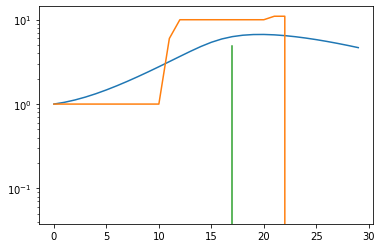

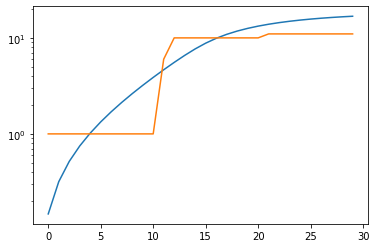

total error: 0.0897689238190651


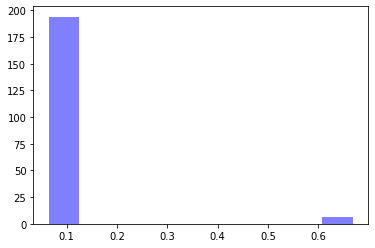

alpha: 0.9999359 , beta: 0.26791462 , initial_unconfirmed 1.2177043 , t0s 8.195026 , lambds 0.9963973


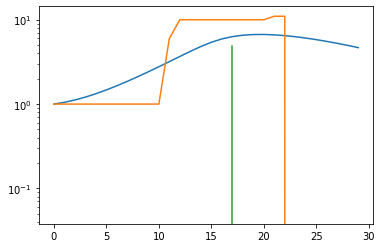

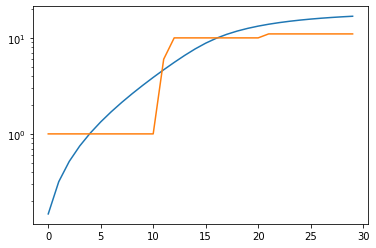

total error: 0.0842442736029625


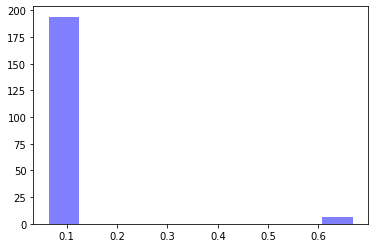

alpha: 0.999936 , beta: 0.26793706 , initial_unconfirmed 1.2175725 , t0s 8.202259 , lambds 0.99778736


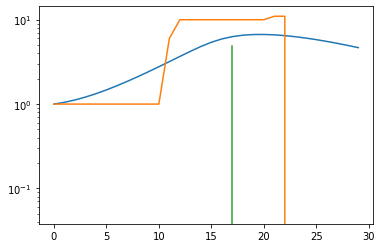

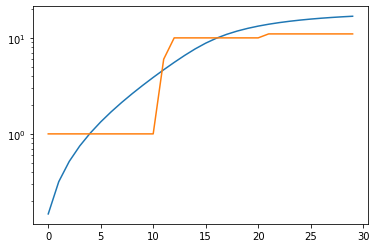

Kenya
total error: 3.8020331859588623


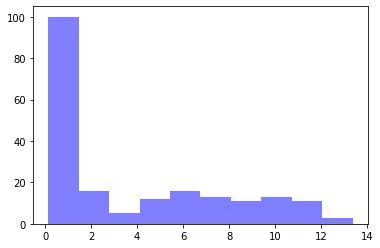

alpha: 0.9042096 , beta: 0.2895362 , initial_unconfirmed 11.155695 , t0s 0.50927204 , lambds 0.5526062


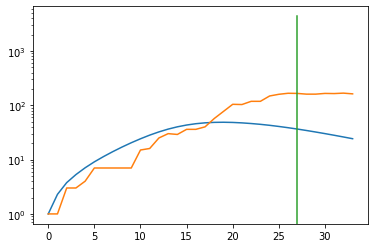

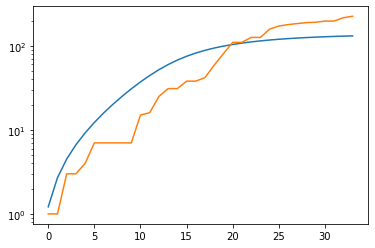

total error: 0.07984853535890579


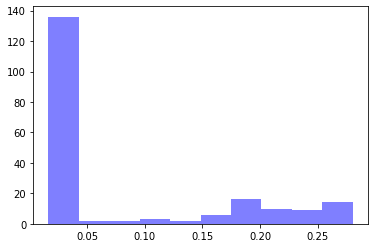

alpha: 0.99999887 , beta: 0.2888489 , initial_unconfirmed 4.8331804 , t0s 7.479039 , lambds 0.41600192


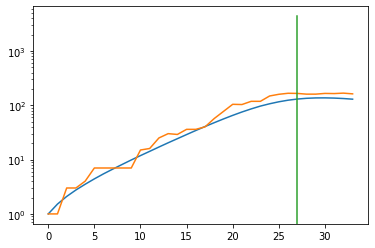

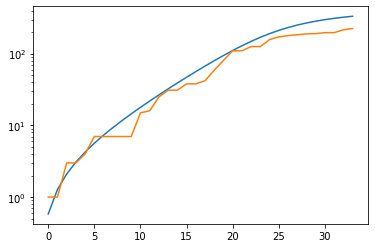

total error: 0.027126148343086243


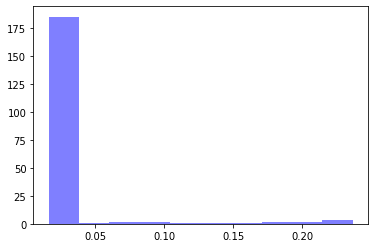

alpha: 0.9587816 , beta: 0.28368554 , initial_unconfirmed 5.1940804 , t0s 15.013519 , lambds 0.7913217


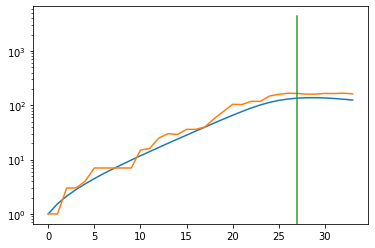

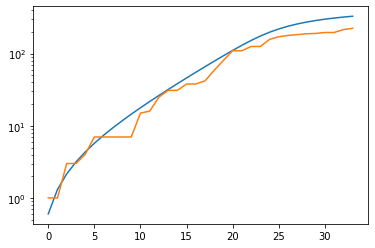

total error: 0.016435839235782623


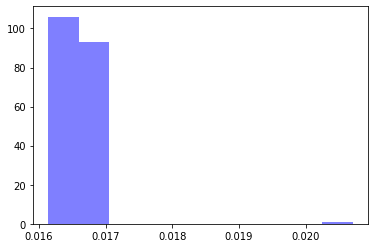

alpha: 0.99999136 , beta: 0.28372657 , initial_unconfirmed 4.974564 , t0s 15.301817 , lambds 0.82004094


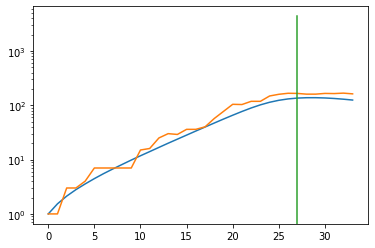

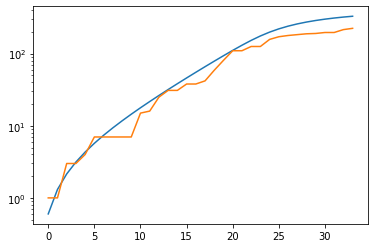

total error: 0.016410870477557182


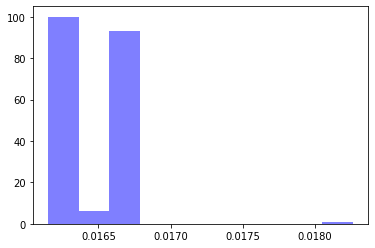

alpha: 0.99999136 , beta: 0.28372657 , initial_unconfirmed 4.974564 , t0s 15.301817 , lambds 0.82004094


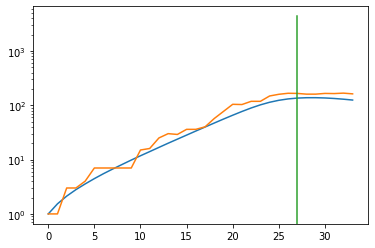

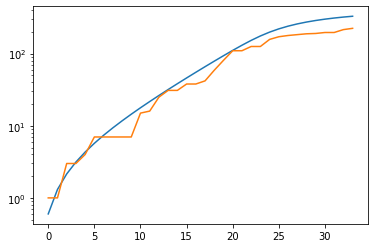

Mongolia
total error: 5.848444938659668


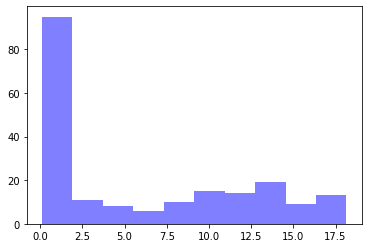

alpha: 0.9999674 , beta: 0.23630877 , initial_unconfirmed 3.4710498 , t0s 0.77816117 , lambds 0.69950324


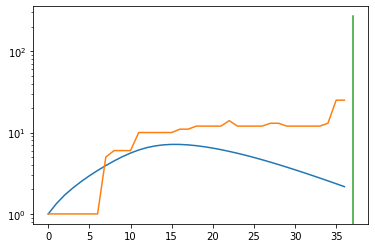

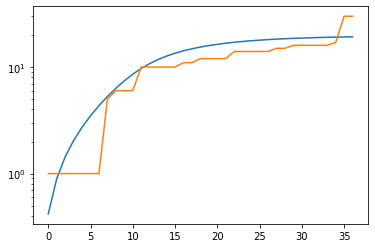

total error: 0.10749551653862


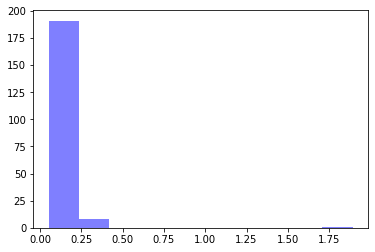

alpha: 0.50543654 , beta: 0.19655864 , initial_unconfirmed 5.6183662 , t0s 0.0 , lambds 0.26453635


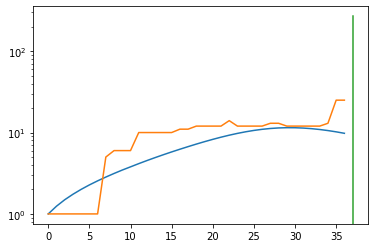

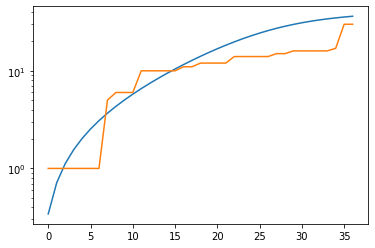

total error: 0.08283049613237381


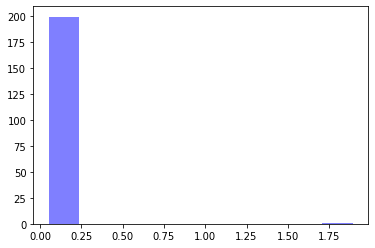

alpha: 0.5016007 , beta: 0.1965838 , initial_unconfirmed 5.6611786 , t0s 0.0 , lambds 0.26466465


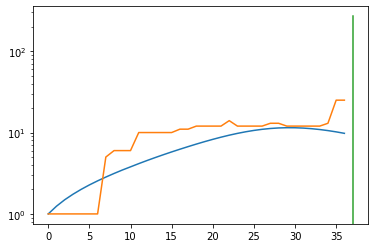

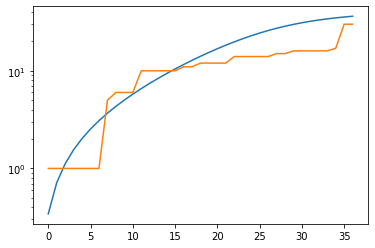

total error: 0.06998240202665329


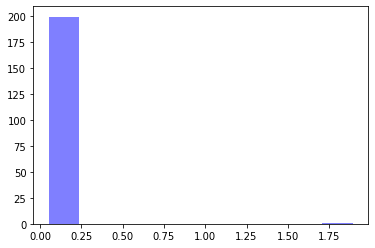

alpha: 0.5016007 , beta: 0.1965838 , initial_unconfirmed 5.6611786 , t0s 0.0 , lambds 0.26466465


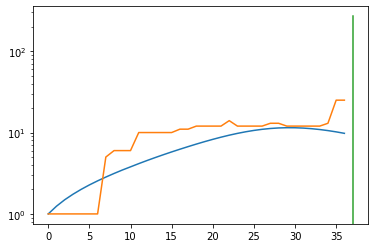

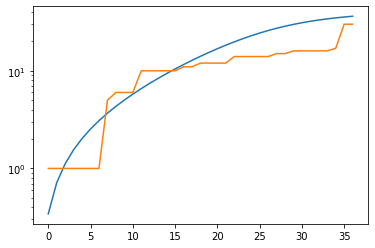

total error: 0.06260748207569122


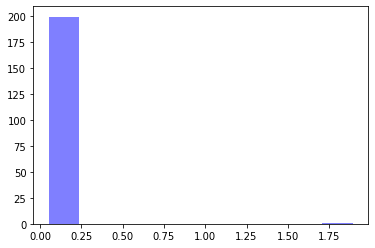

alpha: 0.5016007 , beta: 0.1965838 , initial_unconfirmed 5.6611786 , t0s 0.0 , lambds 0.26466465


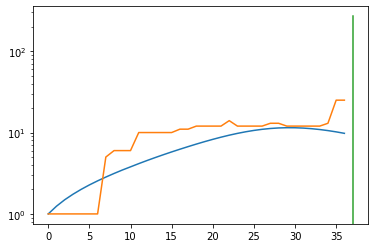

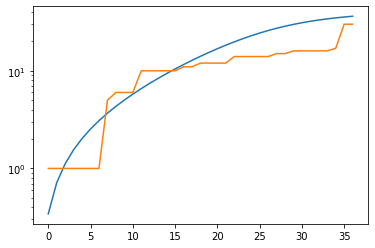

Cabo Verde
total error: 5.373534679412842


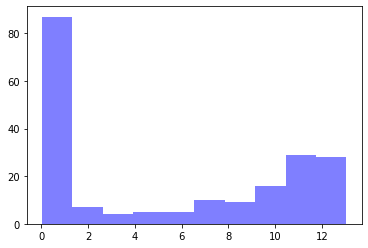

alpha: 0.9998772 , beta: 0.010485429 , initial_unconfirmed 10.216892 , t0s 0.33437413 , lambds 0.6342844


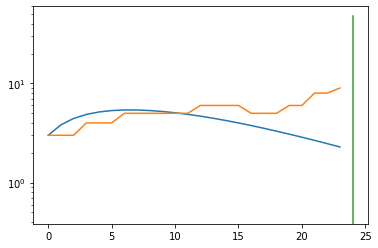

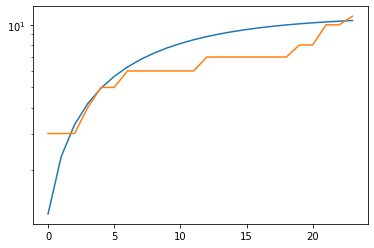

total error: 0.035865116864442825


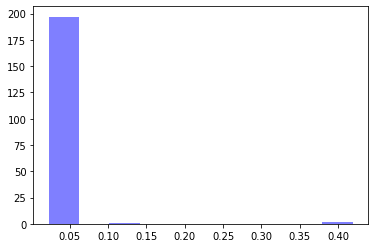

alpha: 0.72012234 , beta: 0.08446426 , initial_unconfirmed 9.758054 , t0s 1.5604806 , lambds 0.0012986653


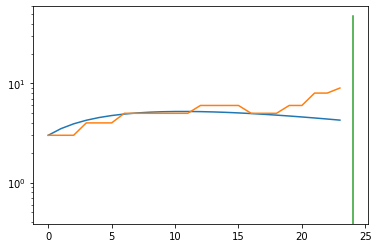

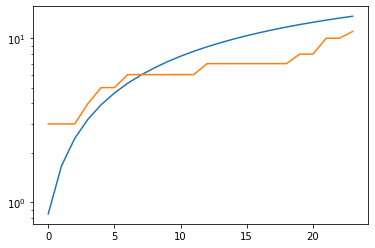

total error: 0.03222660720348358


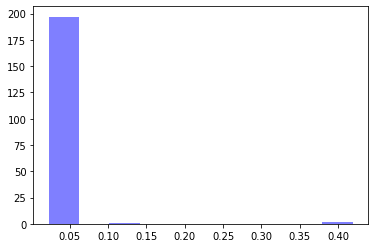

alpha: 0.7201282 , beta: 0.08446414 , initial_unconfirmed 9.757965 , t0s 1.5609152 , lambds 0.0009892696


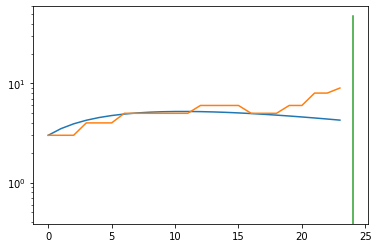

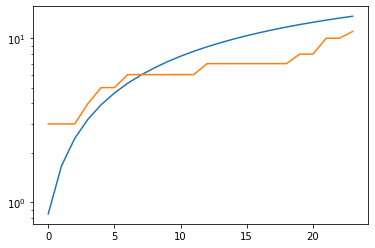

total error: 0.030875928699970245


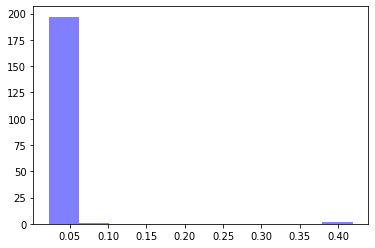

alpha: 0.7201282 , beta: 0.08446414 , initial_unconfirmed 9.757965 , t0s 1.5609152 , lambds 0.0009892696


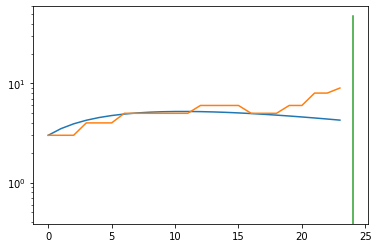

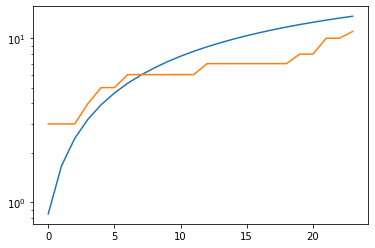

total error: 0.030275283381342888


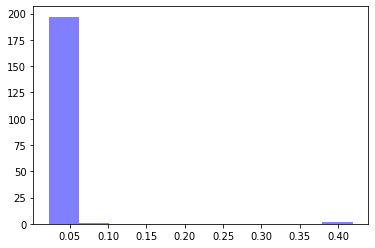

alpha: 0.7201282 , beta: 0.08446414 , initial_unconfirmed 9.757965 , t0s 1.5609152 , lambds 0.0009892696


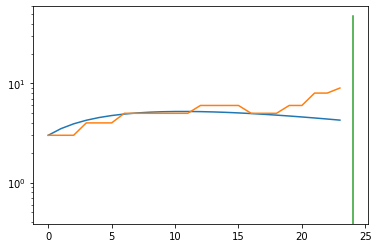

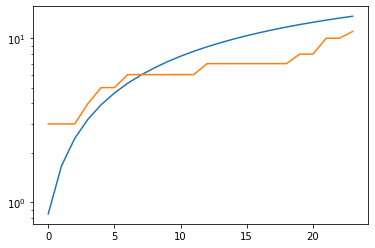

Lesotho
South Georgia and South Sandwich Is.
Guatemala
total error: 4.487806797027588


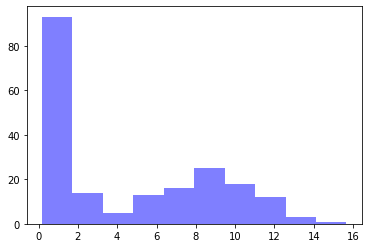

alpha: 0.99995786 , beta: 0.2715731 , initial_unconfirmed 9.516541 , t0s 0.9124708 , lambds 0.71777016


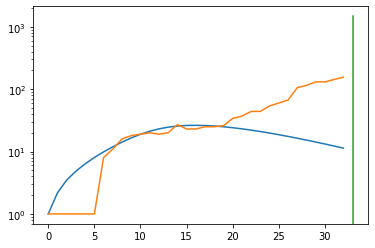

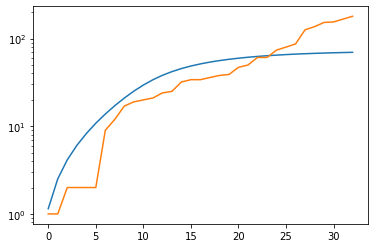

total error: 0.11349903047084808


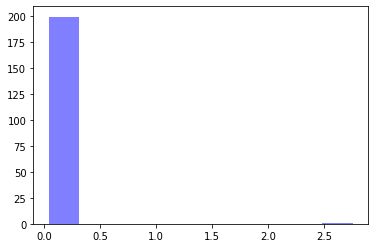

alpha: 0.52365124 , beta: 0.24701263 , initial_unconfirmed 9.736043 , t0s 0.0 , lambds 0.19587599


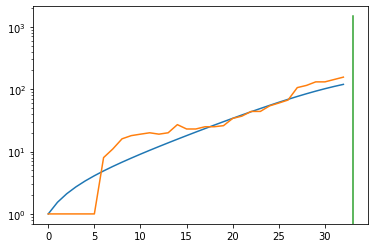

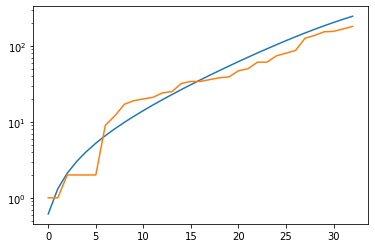

total error: 0.08014754205942154


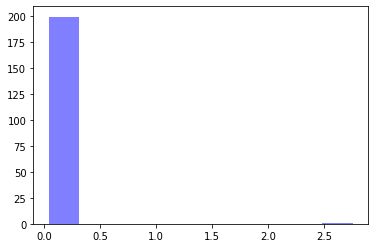

alpha: 0.5235617 , beta: 0.24719952 , initial_unconfirmed 9.719935 , t0s 0.0 , lambds 0.19660898


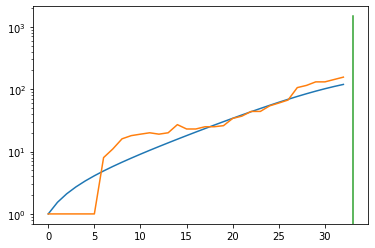

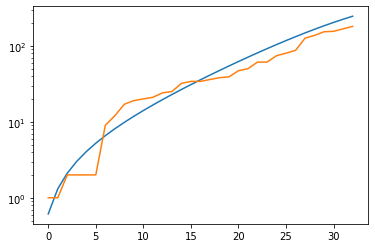

total error: 0.05494173616170883


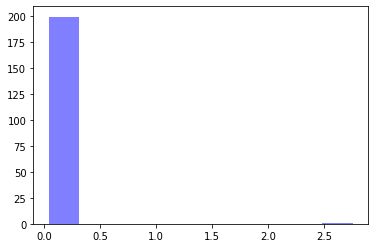

alpha: 0.5235617 , beta: 0.24719952 , initial_unconfirmed 9.719935 , t0s 0.0 , lambds 0.19660898


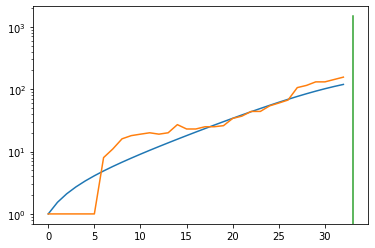

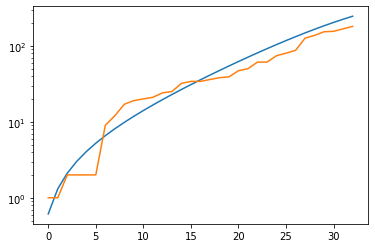

total error: 0.0532841794192791


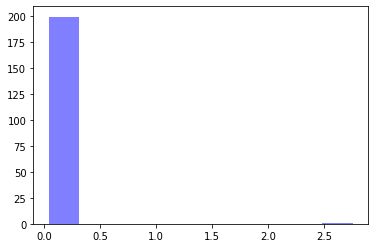

alpha: 0.5235617 , beta: 0.24719952 , initial_unconfirmed 9.719935 , t0s 0.0 , lambds 0.19660898


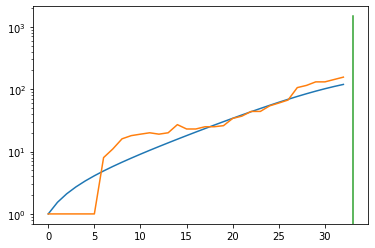

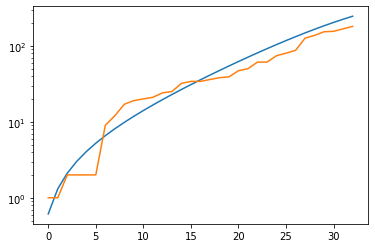

Anguilla
total error: 3.744689702987671


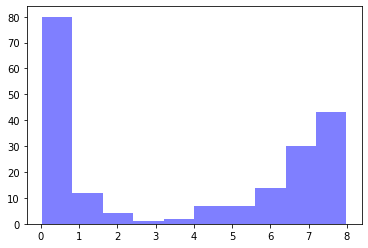

alpha: 0.87057406 , beta: 0.010970111 , initial_unconfirmed 5.0917983 , t0s 0.25006336 , lambds 0.57445604


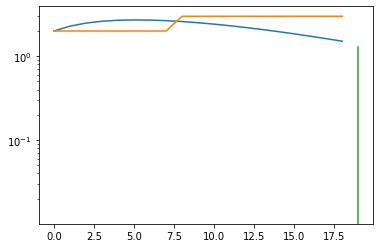

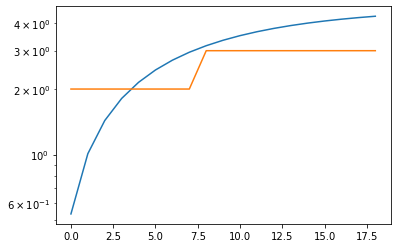

total error: 0.03438490256667137


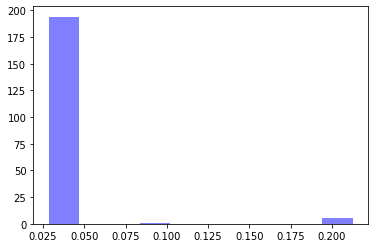

alpha: 0.9997169 , beta: 0.025325084 , initial_unconfirmed 4.347555 , t0s 1.4061842 , lambds 0.0070149703


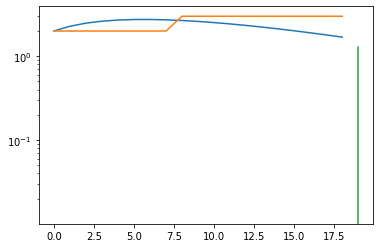

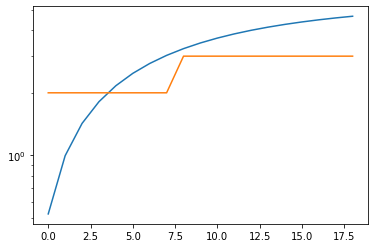

total error: 0.033790841698646545


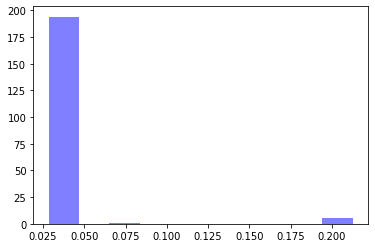

alpha: 0.999717 , beta: 0.025323601 , initial_unconfirmed 4.347573 , t0s 1.4103286 , lambds 0.003510192


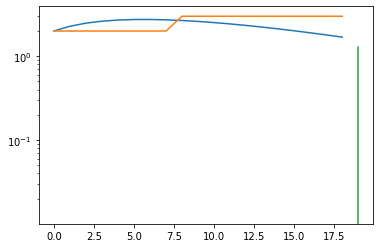

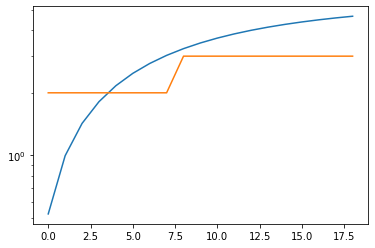

total error: 0.03364933654665947


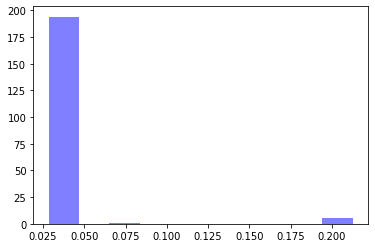

alpha: 0.999717 , beta: 0.025323406 , initial_unconfirmed 4.347576 , t0s 1.4107387 , lambds 0.0031492217


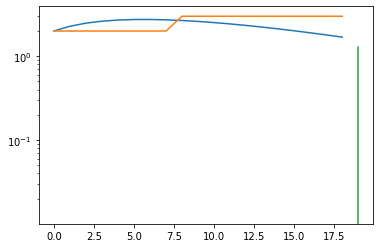

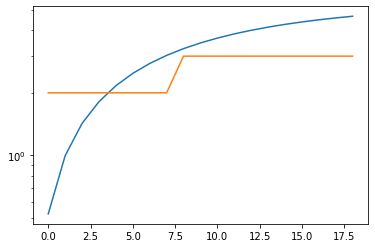

total error: 0.0335538350045681


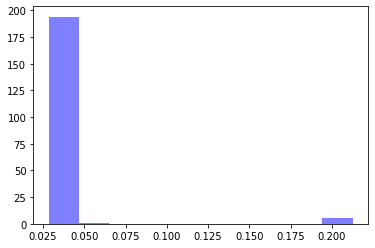

alpha: 0.999717 , beta: 0.025323406 , initial_unconfirmed 4.347576 , t0s 1.4107387 , lambds 0.0031492217


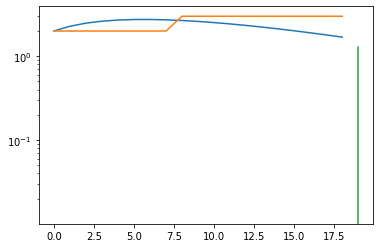

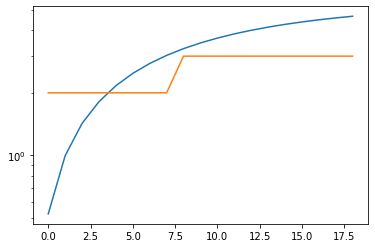

Yemen
total error: 1.8651891946792603


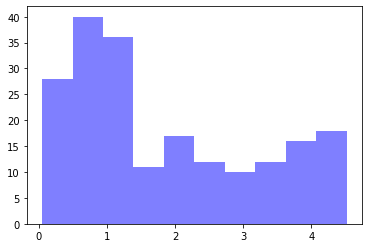

alpha: 0.9998754 , beta: 0.0011056546 , initial_unconfirmed 2.0223765 , t0s 0.2369898 , lambds 0.6353948


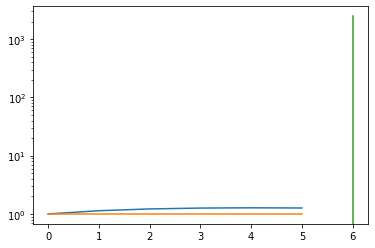

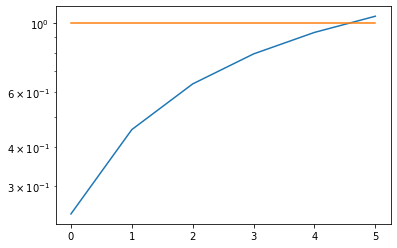

total error: 0.03745810687541962


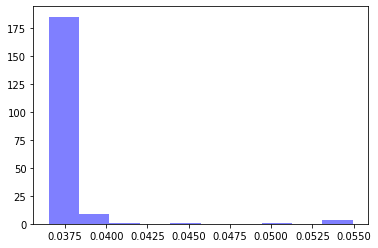

alpha: 0.584384 , beta: 1.4616616e-05 , initial_unconfirmed 4.79092 , t0s 0.83566165 , lambds 0.6064257


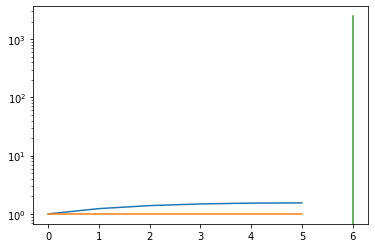

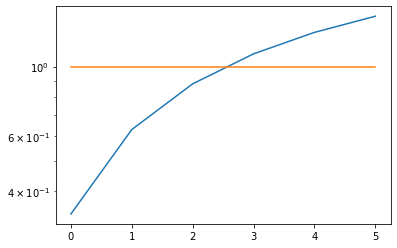

total error: 0.03676006197929382


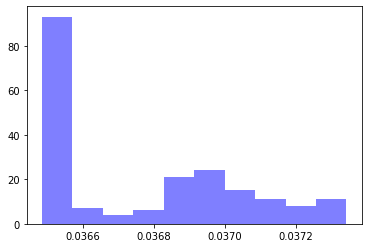

alpha: 0.584384 , beta: 1.4616616e-05 , initial_unconfirmed 4.79092 , t0s 0.83566165 , lambds 0.6064257


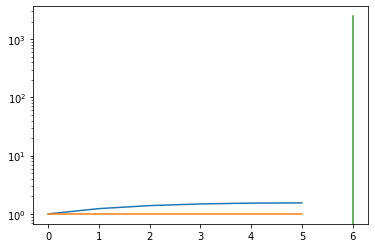

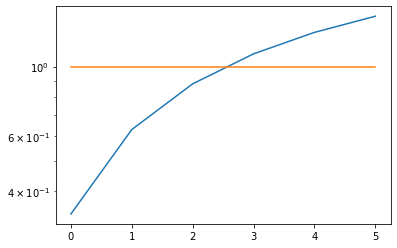

total error: 0.03664449602365494


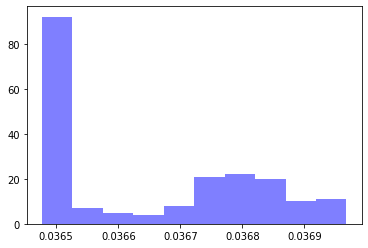

alpha: 0.584384 , beta: 1.4616616e-05 , initial_unconfirmed 4.79092 , t0s 0.83566165 , lambds 0.6064257


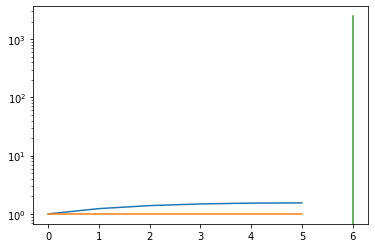

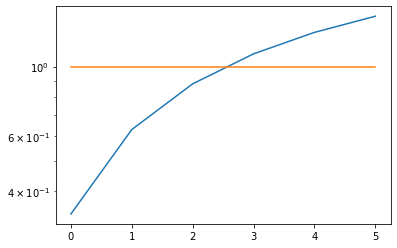

total error: 0.036582279950380325


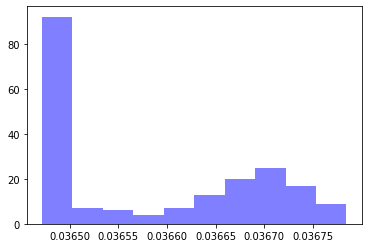

alpha: 0.584384 , beta: 1.4616616e-05 , initial_unconfirmed 4.79092 , t0s 0.83566165 , lambds 0.6064257


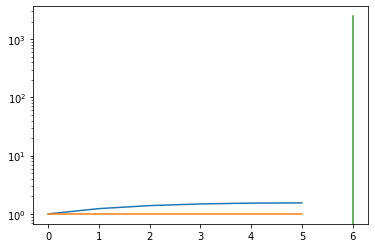

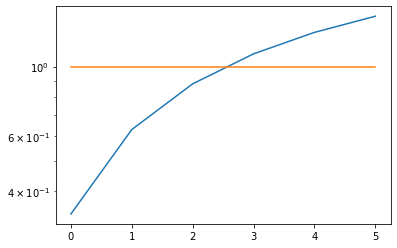

Honduras
total error: 3.944268226623535


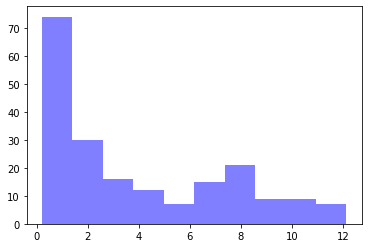

alpha: 0.9943807 , beta: 0.32000172 , initial_unconfirmed 10.4031 , t0s 0.5805912 , lambds 0.53340966


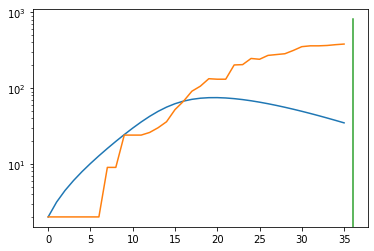

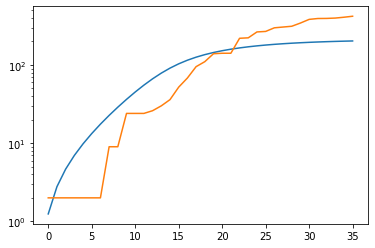

total error: 0.1135639101266861


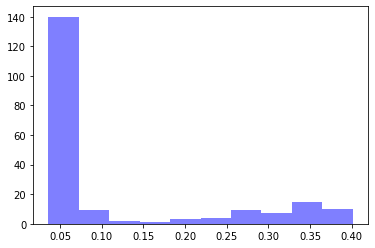

alpha: 0.5206132 , beta: 0.34845692 , initial_unconfirmed 6.6126366 , t0s 0.0 , lambds 0.29505512


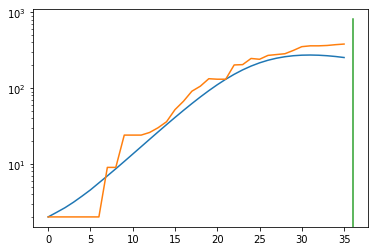

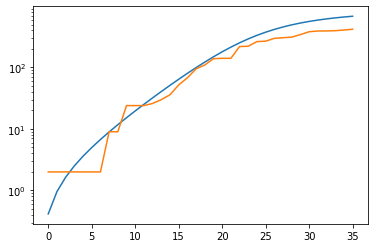

total error: 0.0362541489303112


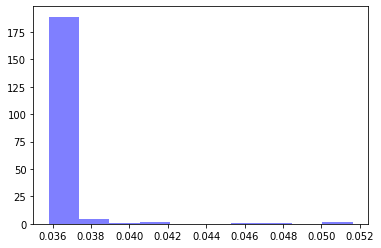

alpha: 0.50090915 , beta: 0.34846494 , initial_unconfirmed 6.872326 , t0s 0.0 , lambds 0.29506317


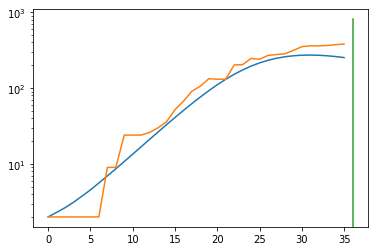

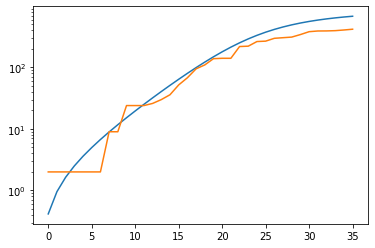

total error: 0.03579925000667572


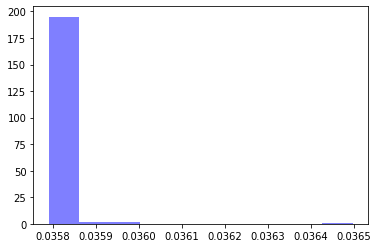

alpha: 0.50090915 , beta: 0.34846494 , initial_unconfirmed 6.872326 , t0s 0.0 , lambds 0.29506317


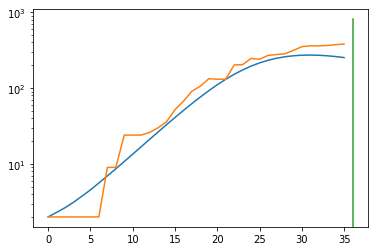

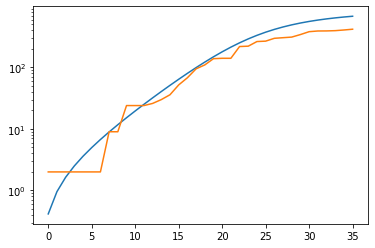

total error: 0.03579460829496384


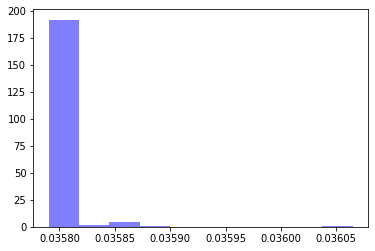

alpha: 0.50090915 , beta: 0.34846494 , initial_unconfirmed 6.872326 , t0s 0.0 , lambds 0.29506317


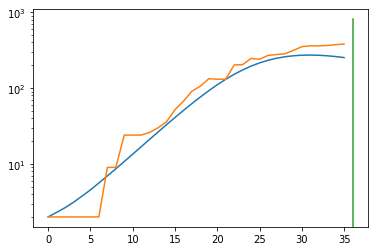

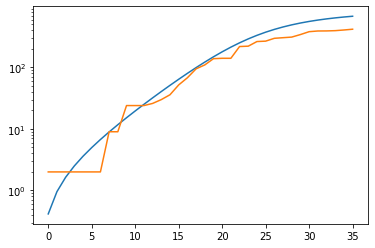

New Caledonia
total error: 2.8664252758026123


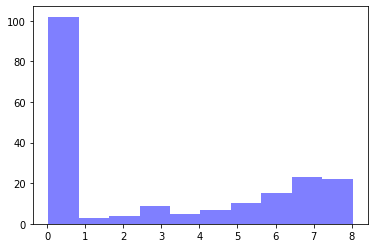

alpha: 0.99805194 , beta: 0.0005781529 , initial_unconfirmed 31.72296 , t0s 0.16480875 , lambds 0.5050469


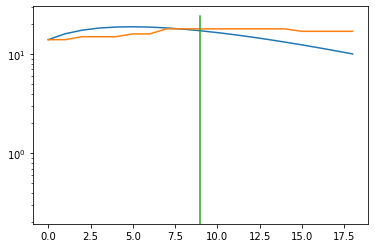

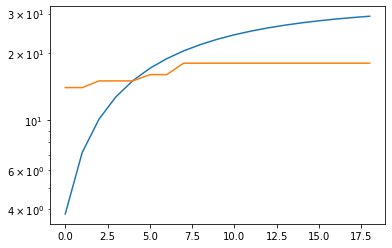

total error: 0.03759629651904106


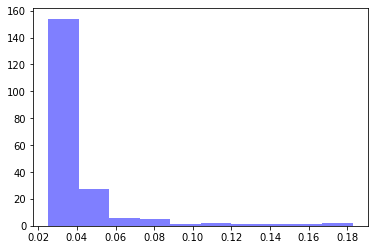

alpha: 0.85292995 , beta: 3.0378108e-06 , initial_unconfirmed 36.826954 , t0s 0.0 , lambds 0.65157074


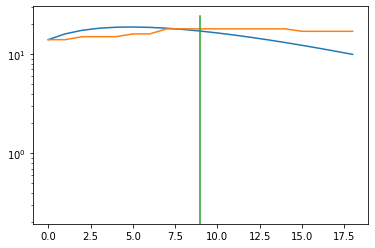

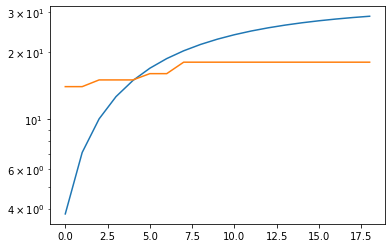

total error: 0.03144989162683487


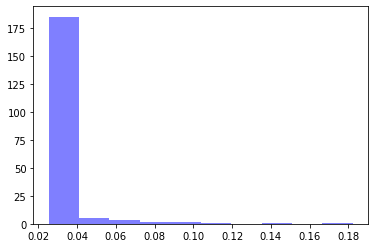

alpha: 0.85292995 , beta: 3.0378108e-06 , initial_unconfirmed 36.826954 , t0s 0.0 , lambds 0.65157074


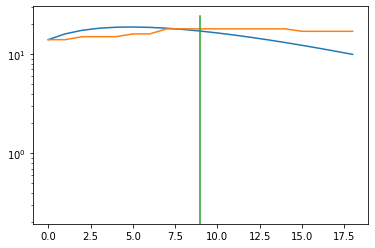

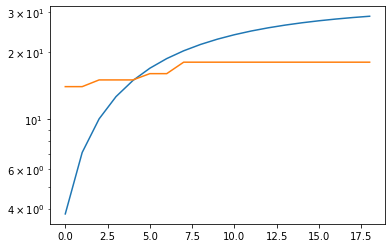

total error: 0.0292277242988348


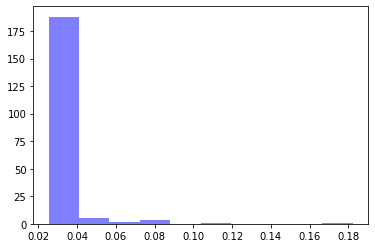

alpha: 0.85292995 , beta: 3.0378108e-06 , initial_unconfirmed 36.826954 , t0s 0.0 , lambds 0.65157074


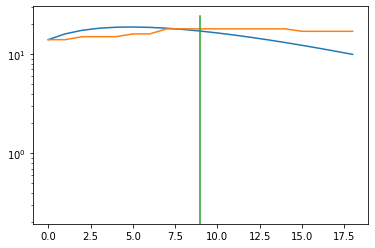

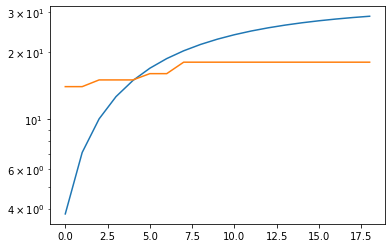

total error: 0.028108008205890656


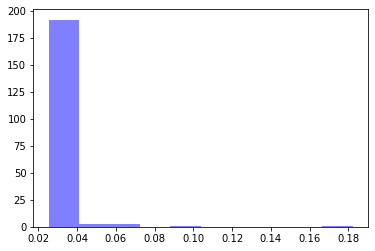

alpha: 0.85292995 , beta: 3.0378108e-06 , initial_unconfirmed 36.826954 , t0s 0.0 , lambds 0.65157074


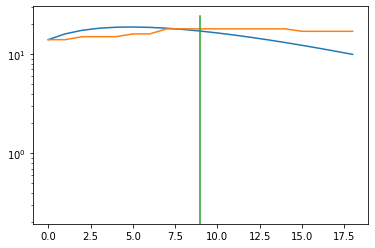

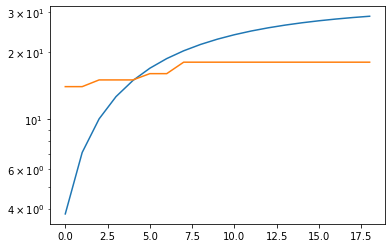

French Southern Territories
Algeria
total error: 4.954765796661377


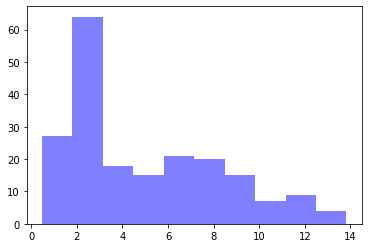

alpha: 0.99982023 , beta: 0.46669286 , initial_unconfirmed 3.1138062 , t0s 0.077519 , lambds 0.50394773


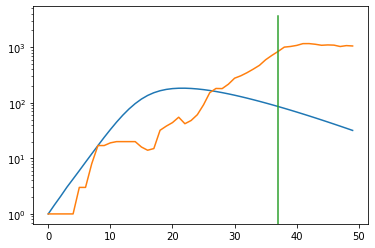

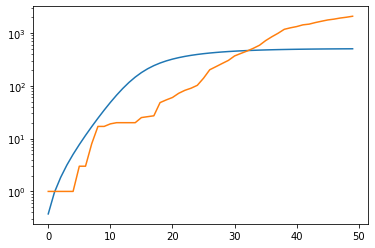

total error: 0.17131489515304565


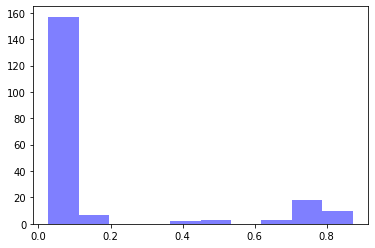

alpha: 0.85665566 , beta: 0.2891377 , initial_unconfirmed 3.8520563 , t0s 3.7213414 , lambds 0.1824665


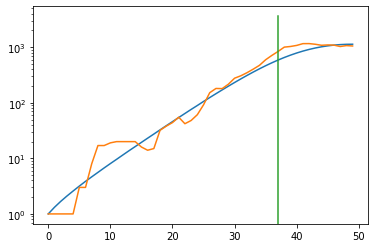

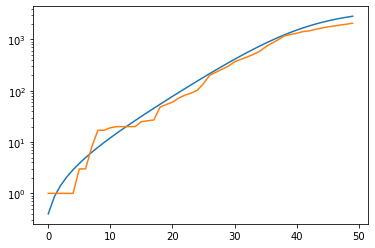

total error: 0.02934321016073227


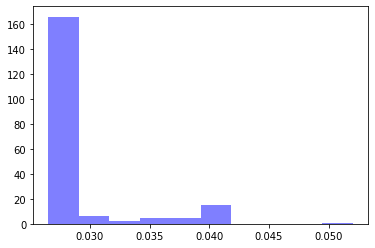

alpha: 0.9855322 , beta: 0.27908954 , initial_unconfirmed 3.7068472 , t0s 29.326546 , lambds 0.7084097


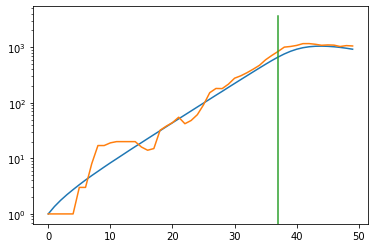

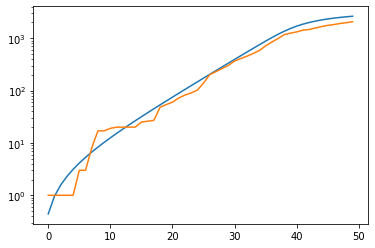

total error: 0.027564331889152527


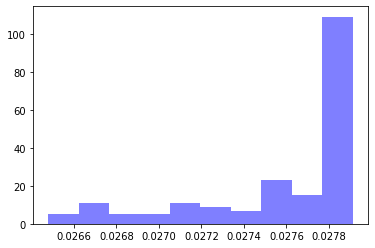

alpha: 0.9849454 , beta: 0.28044784 , initial_unconfirmed 3.5907838 , t0s 29.933844 , lambds 0.7721662


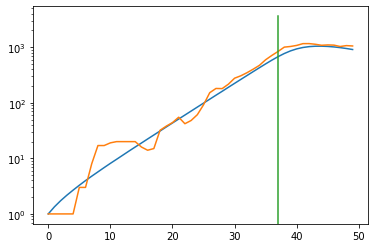

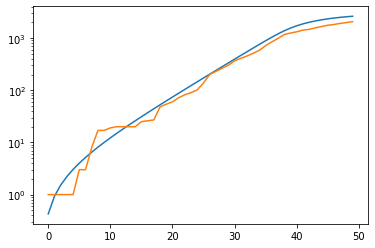

total error: 0.027476396411657333


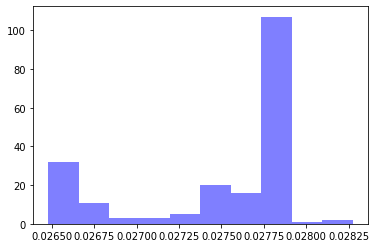

alpha: 0.9849464 , beta: 0.28038532 , initial_unconfirmed 3.5923028 , t0s 30.377207 , lambds 0.8149649


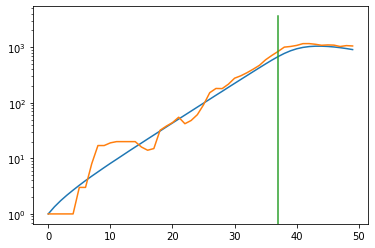

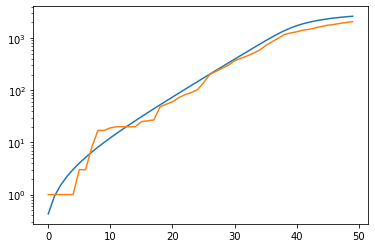

Libya
total error: 3.7537877559661865


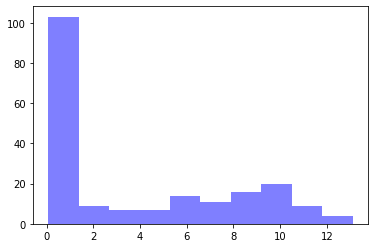

alpha: 0.9999039 , beta: 0.19589783 , initial_unconfirmed 12.888965 , t0s 0.47058576 , lambds 0.7282581


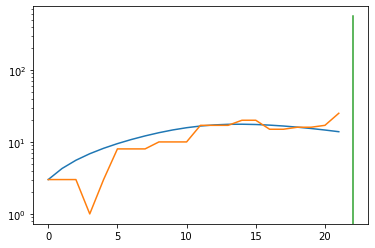

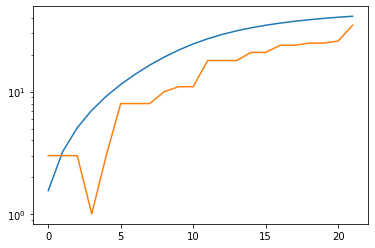

total error: 0.05031725391745567


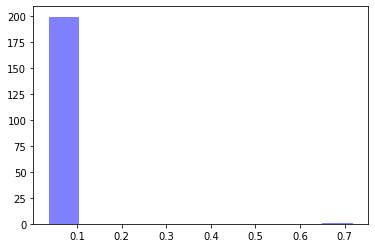

alpha: 0.50957125 , beta: 0.21338113 , initial_unconfirmed 12.614543 , t0s 5.002036 , lambds 0.7257745


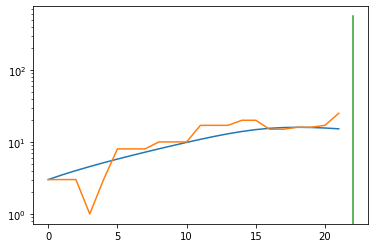

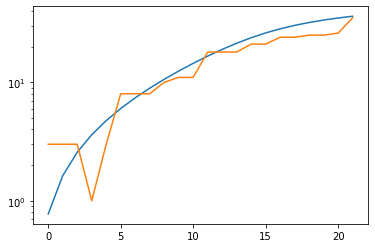

total error: 0.04600749537348747


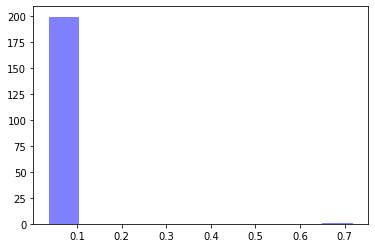

alpha: 0.6172057 , beta: 0.21344697 , initial_unconfirmed 10.393697 , t0s 6.5137835 , lambds 0.88540363


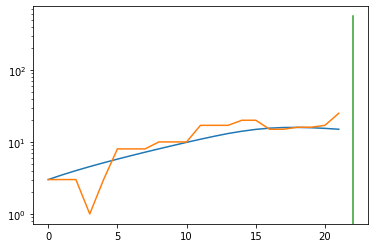

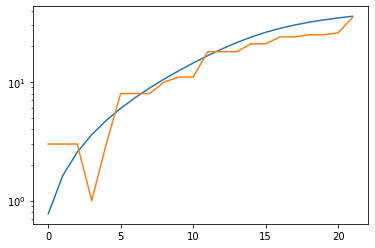

total error: 0.04336095228791237


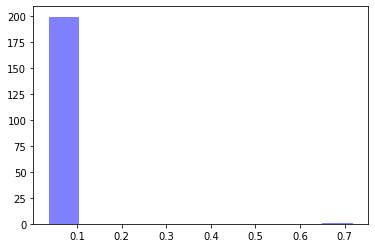

alpha: 0.6172057 , beta: 0.21344697 , initial_unconfirmed 10.393697 , t0s 6.5137835 , lambds 0.88540363


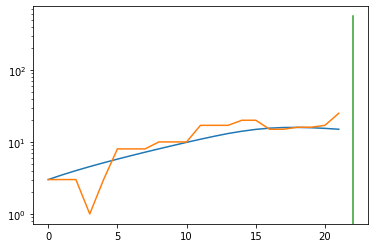

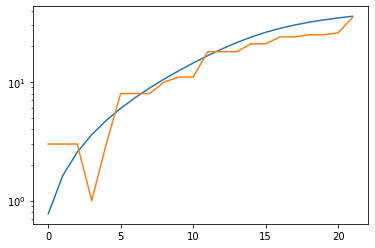

total error: 0.042269498109817505


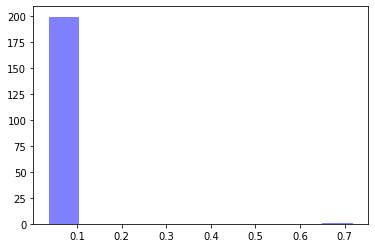

alpha: 0.6172057 , beta: 0.21344697 , initial_unconfirmed 10.393697 , t0s 6.5137835 , lambds 0.88540363


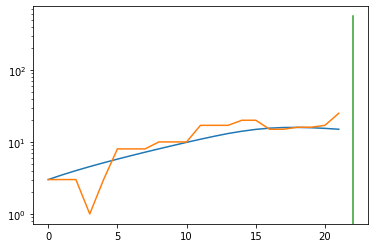

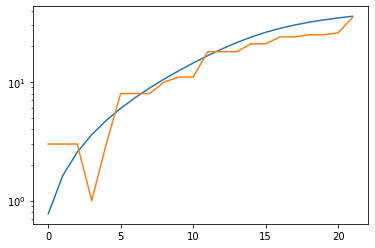

Benin
total error: 5.190255165100098


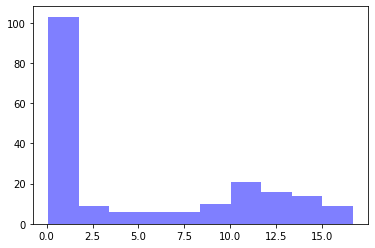

alpha: 0.99974185 , beta: 0.2707497 , initial_unconfirmed 2.261418 , t0s 0.81433725 , lambds 0.59413856


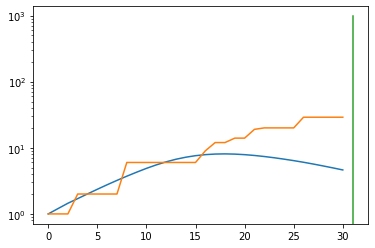

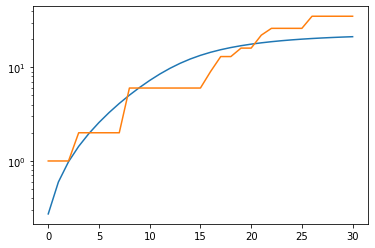

total error: 0.11160118877887726


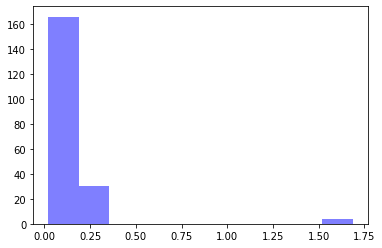

alpha: 0.99983233 , beta: 0.21624538 , initial_unconfirmed 2.6897657 , t0s 2.358578 , lambds 0.2032425


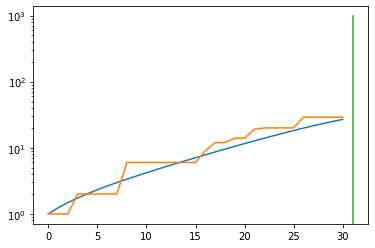

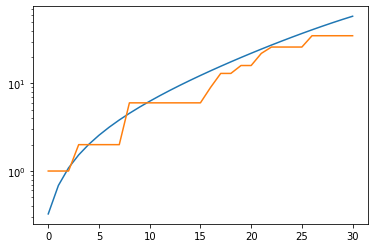

total error: 0.08632992953062057


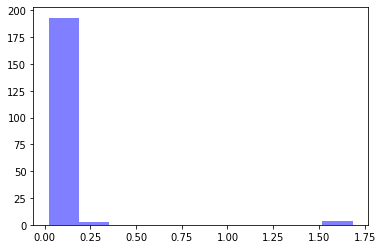

alpha: 0.9993906 , beta: 0.21629412 , initial_unconfirmed 2.6886885 , t0s 3.2603595 , lambds 0.21424548


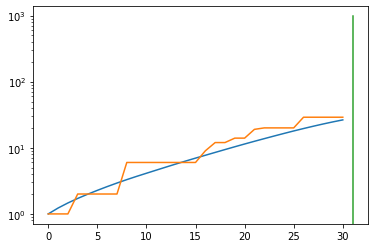

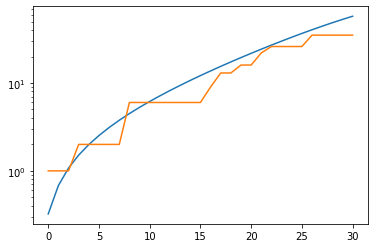

total error: 0.0681159719824791


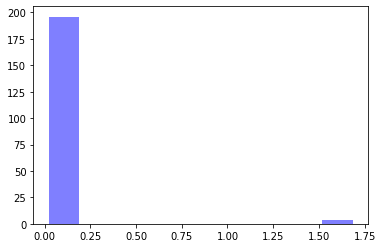

alpha: 0.99939024 , beta: 0.21633117 , initial_unconfirmed 2.6873083 , t0s 3.7131138 , lambds 0.2203001


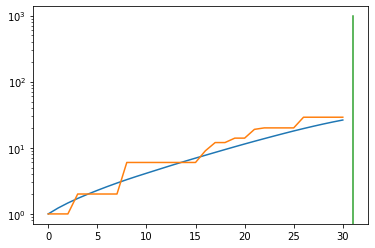

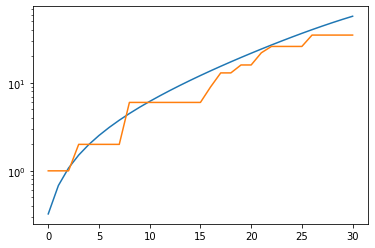

total error: 0.05585683882236481


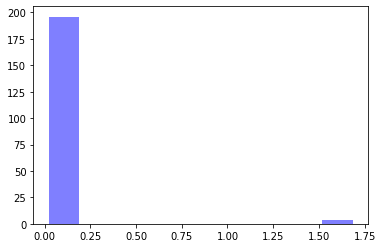

alpha: 0.99598753 , beta: 0.21643871 , initial_unconfirmed 2.6912022 , t0s 5.8903675 , lambds 0.25253746


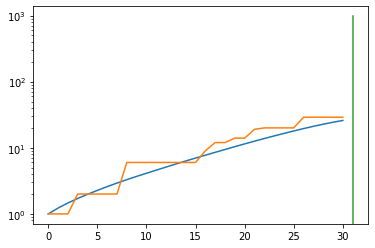

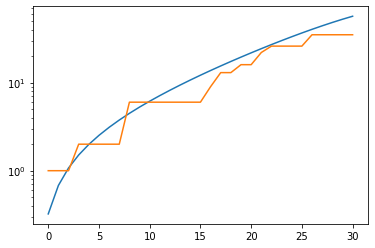

India
total error: 6.656900405883789


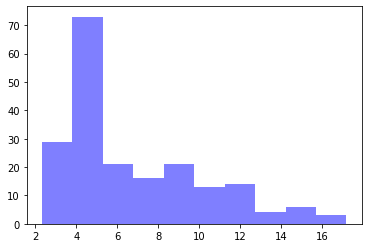

alpha: 0.98852575 , beta: 0.45627308 , initial_unconfirmed 5.75248 , t0s 0.9211001 , lambds 0.62781245


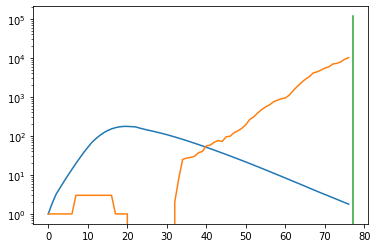

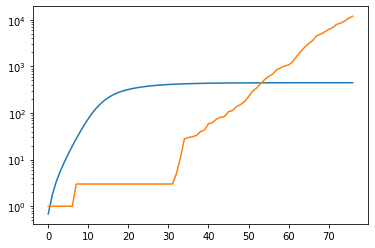

total error: 0.8444079756736755


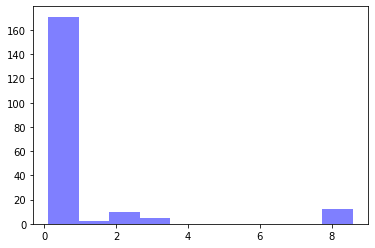

alpha: 0.50067127 , beta: 0.25478482 , initial_unconfirmed 0.83760303 , t0s 5.5879574 , lambds 0.00042517995


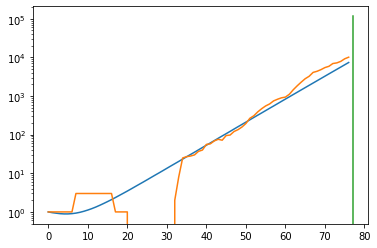

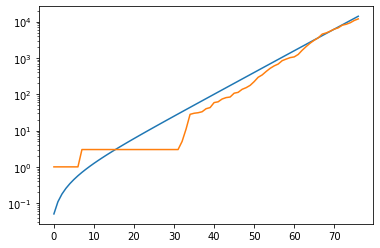

total error: 0.29321908950805664


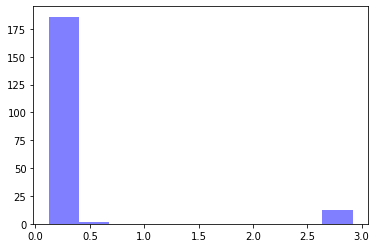

alpha: 0.5061834 , beta: 0.25712842 , initial_unconfirmed 0.8629497 , t0s 0.0 , lambds 0.017119626


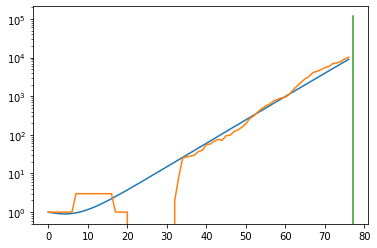

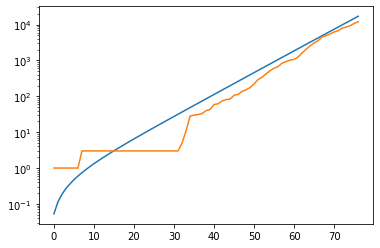

total error: 0.2899356782436371


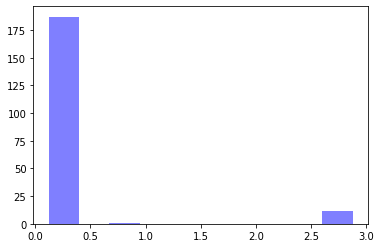

alpha: 0.5061834 , beta: 0.25712842 , initial_unconfirmed 0.8629497 , t0s 0.0 , lambds 0.017119626


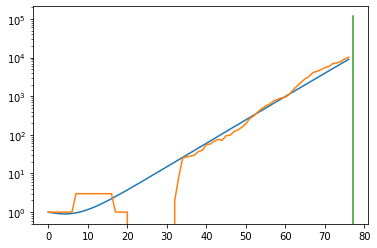

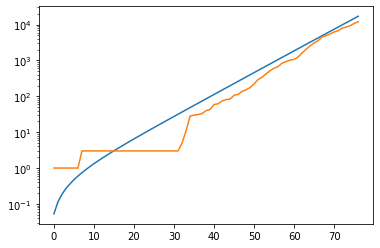

total error: 0.2877357006072998


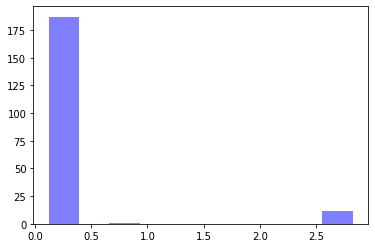

alpha: 0.5061834 , beta: 0.25712842 , initial_unconfirmed 0.8629497 , t0s 0.0 , lambds 0.017119626


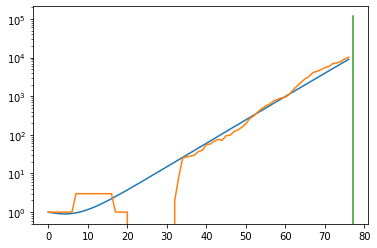

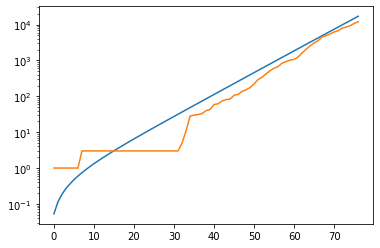

Russia
total error: 6.416485786437988


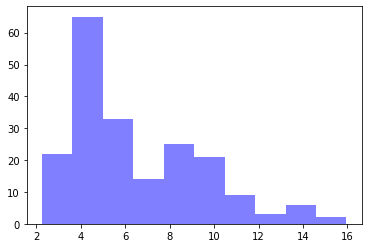

alpha: 0.99947715 , beta: 0.7181388 , initial_unconfirmed 0.762251 , t0s 0.72118527 , lambds 0.68649435


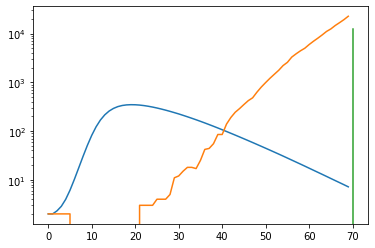

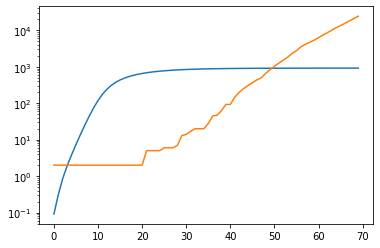

total error: 0.7286733388900757


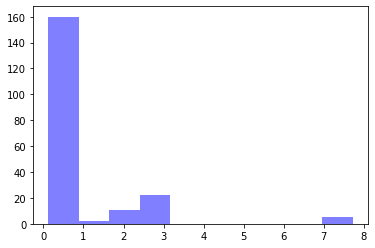

alpha: 0.71883243 , beta: 0.2850689 , initial_unconfirmed 0.44296798 , t0s 5.373436 , lambds 0.00050231564


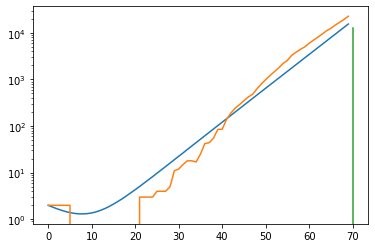

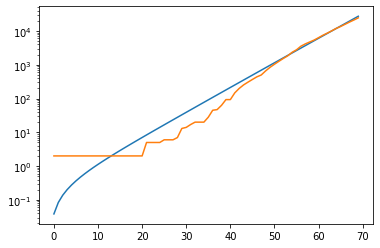

total error: 0.28931963443756104


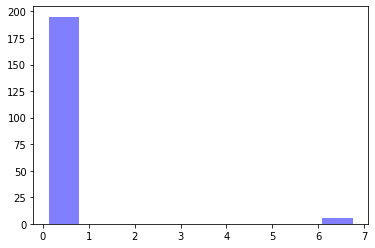

alpha: 0.99998635 , beta: 0.2869674 , initial_unconfirmed 0.3089058 , t0s 5.164708 , lambds 0.0006718391


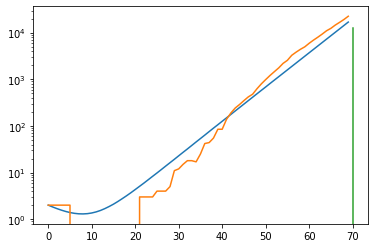

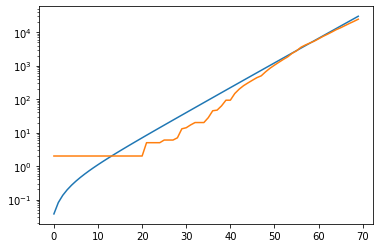

total error: 0.282609760761261


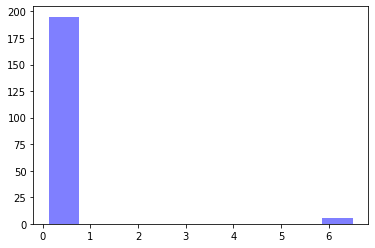

alpha: 0.98116404 , beta: 0.28727344 , initial_unconfirmed 0.31895688 , t0s 5.4946666 , lambds 0.000326405


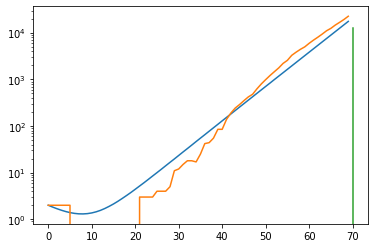

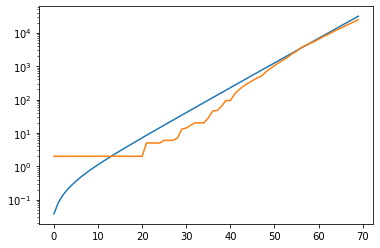

total error: 0.2731940746307373


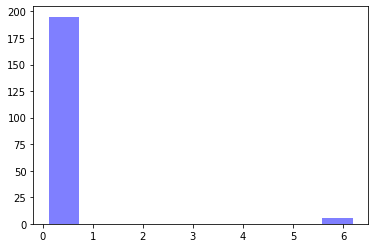

alpha: 0.9969795 , beta: 0.2882578 , initial_unconfirmed 0.3069049 , t0s 5.483901 , lambds 0.00056056434


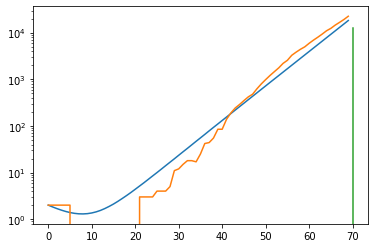

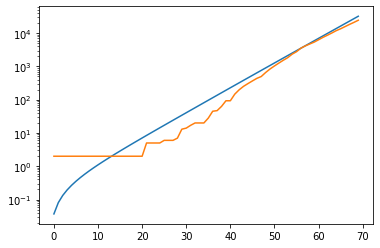

Solomon Islands
Argentina
total error: 3.8179428577423096


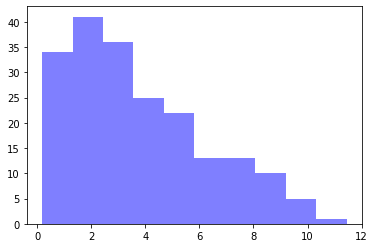

alpha: 0.99875116 , beta: 0.49074146 , initial_unconfirmed 7.730782 , t0s 0.30211043 , lambds 0.5026893


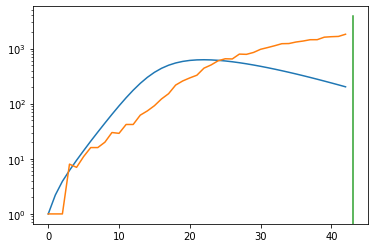

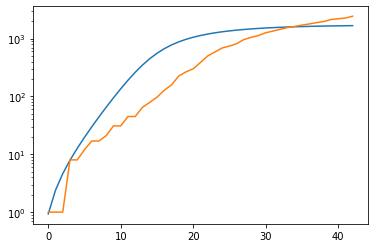

total error: 0.08592934906482697


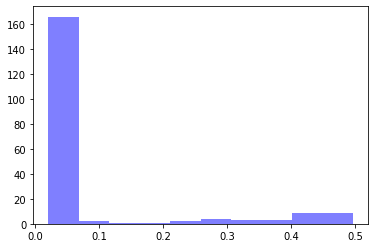

alpha: 0.7891133 , beta: 0.33886817 , initial_unconfirmed 9.497931 , t0s 0.0 , lambds 0.24523312


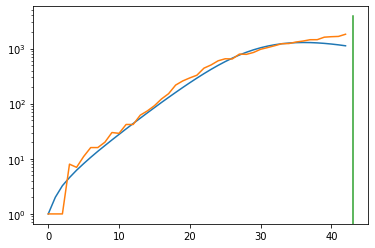

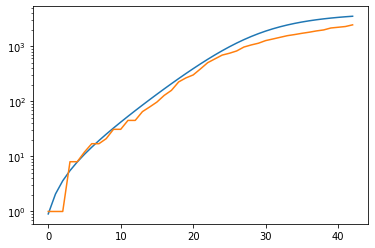

total error: 0.021463340148329735


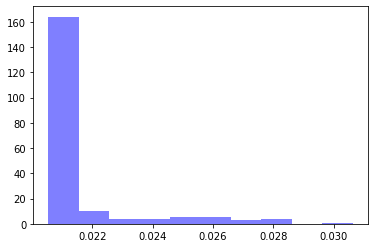

alpha: 0.7895767 , beta: 0.33880123 , initial_unconfirmed 9.500393 , t0s 0.0 , lambds 0.24518745


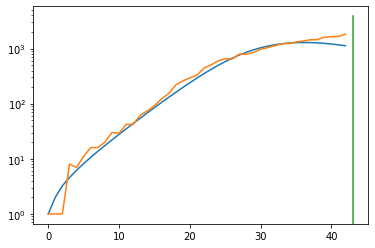

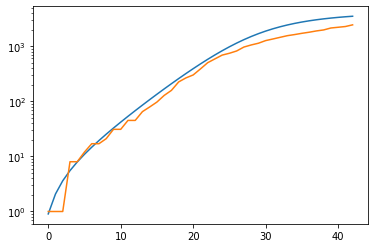

total error: 0.020563660189509392


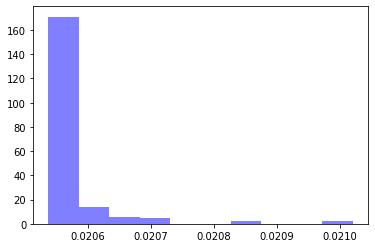

alpha: 0.7895767 , beta: 0.33880123 , initial_unconfirmed 9.500393 , t0s 0.0 , lambds 0.24518745


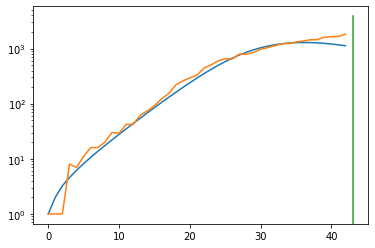

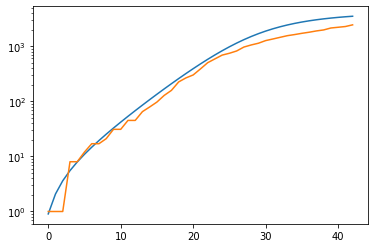

total error: 0.020544301718473434


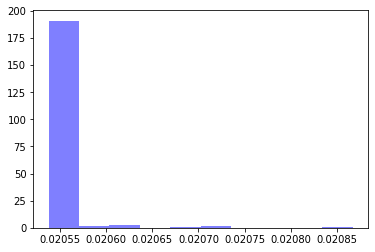

alpha: 0.7895767 , beta: 0.33880123 , initial_unconfirmed 9.500393 , t0s 0.0 , lambds 0.24518745


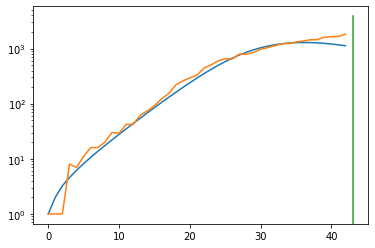

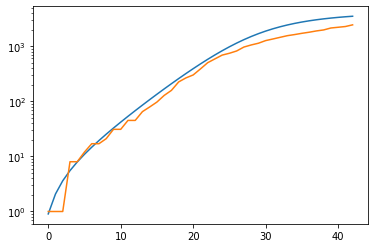

Jordan
total error: 5.252264499664307


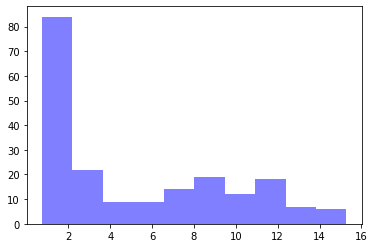

alpha: 0.9217911 , beta: 0.45343655 , initial_unconfirmed 10.557279 , t0s 0.5390542 , lambds 0.6220986


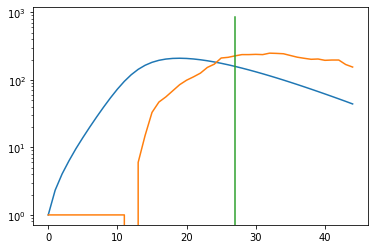

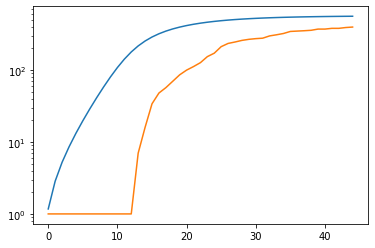

total error: 0.26146626472473145


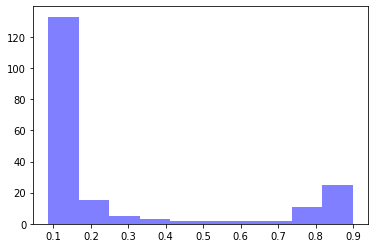

alpha: 0.99961513 , beta: 0.40048933 , initial_unconfirmed 0.58109784 , t0s 12.602288 , lambds 0.61651623


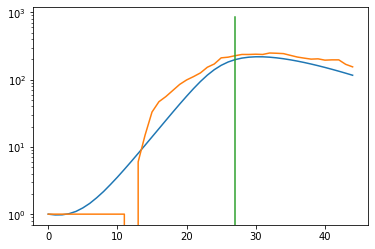

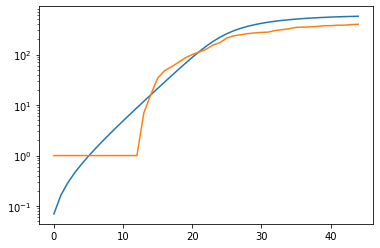

total error: 0.08797042071819305


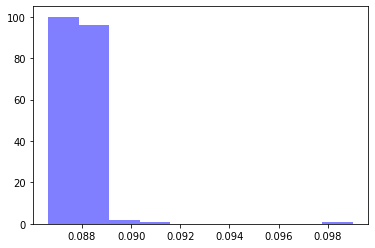

alpha: 0.9868633 , beta: 0.40106183 , initial_unconfirmed 0.5863123 , t0s 12.285288 , lambds 0.5999476


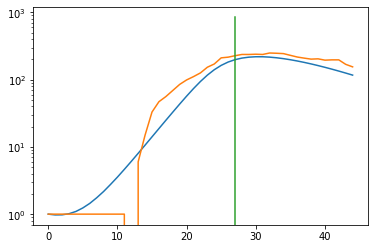

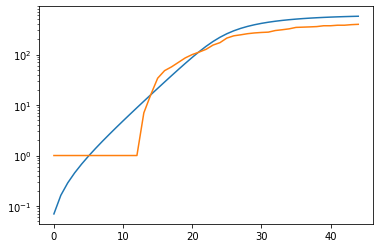

total error: 0.08783579617738724


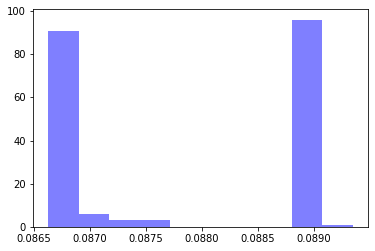

alpha: 0.9868633 , beta: 0.40106183 , initial_unconfirmed 0.5863123 , t0s 12.285288 , lambds 0.5999476


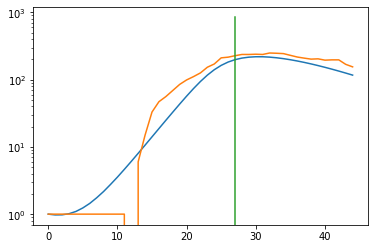

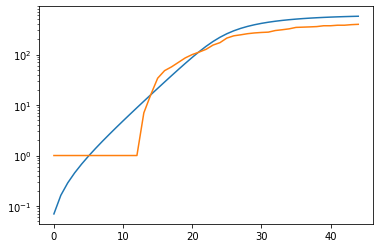

total error: 0.08780921250581741


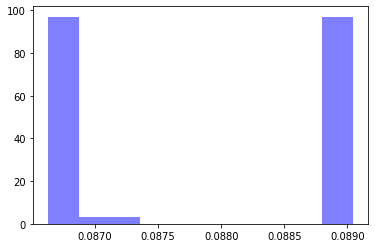

alpha: 0.9868633 , beta: 0.40106183 , initial_unconfirmed 0.5863123 , t0s 12.285288 , lambds 0.5999476


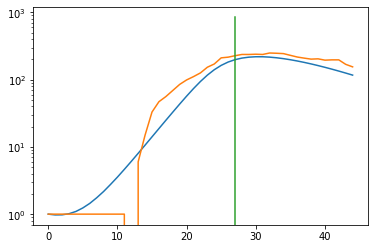

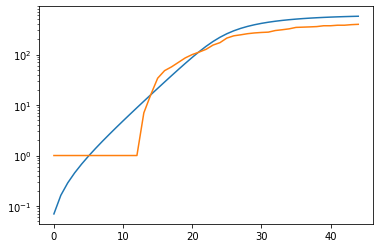

Eritrea
total error: 4.073564529418945


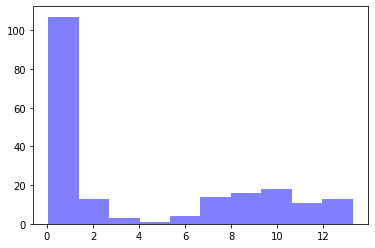

alpha: 0.9942123 , beta: 0.3165905 , initial_unconfirmed 6.590423 , t0s 0.2797873 , lambds 0.636533


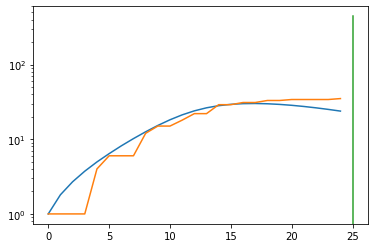

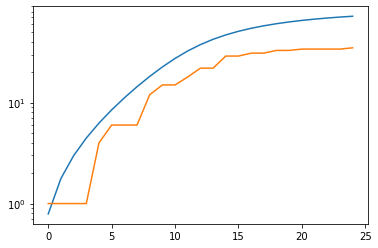

total error: 0.06150311976671219


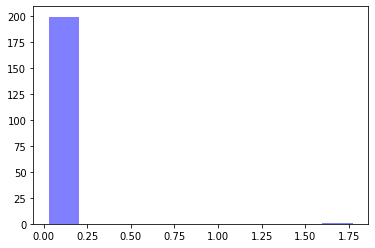

alpha: 0.6797338 , beta: 0.3517153 , initial_unconfirmed 4.761431 , t0s 0.0 , lambds 0.5697039


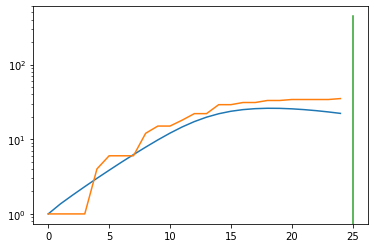

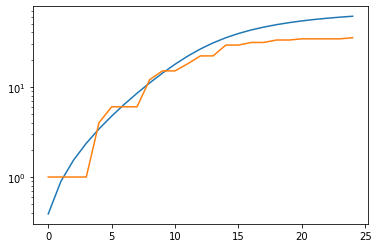

total error: 0.04470384493470192


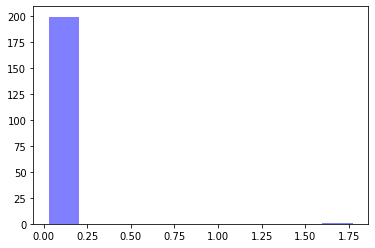

alpha: 0.6797338 , beta: 0.3517153 , initial_unconfirmed 4.761431 , t0s 0.0 , lambds 0.5697039


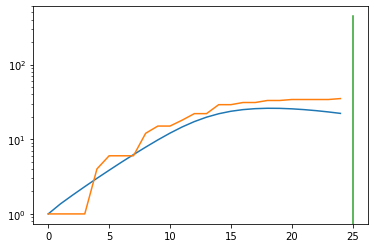

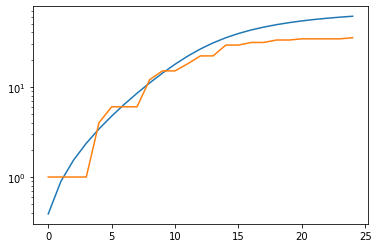

total error: 0.03883514553308487


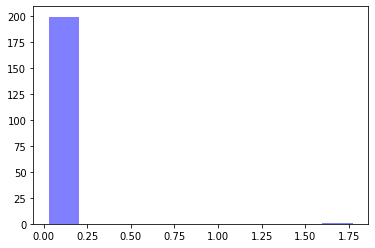

alpha: 0.5003561 , beta: 0.35137838 , initial_unconfirmed 6.4748607 , t0s 0.0 , lambds 0.56902885


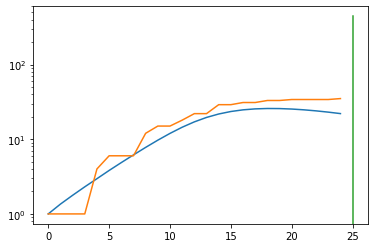

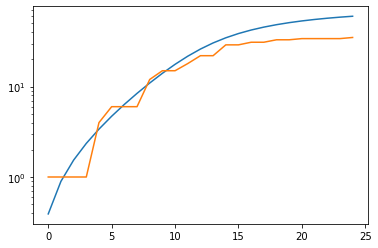

total error: 0.036841727793216705


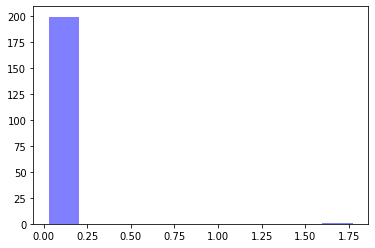

alpha: 0.5036365 , beta: 0.35146856 , initial_unconfirmed 6.4311523 , t0s 0.0 , lambds 0.56925833


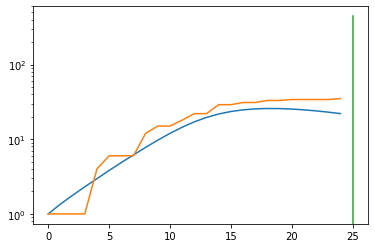

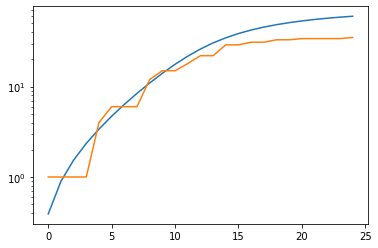

Syria
total error: 4.378610134124756


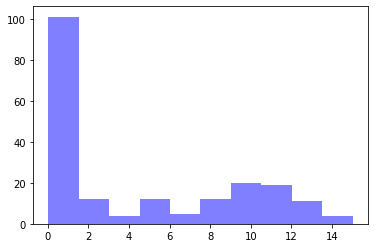

alpha: 0.9999213 , beta: 0.19185282 , initial_unconfirmed 5.4509134 , t0s 0.32093447 , lambds 0.51218855


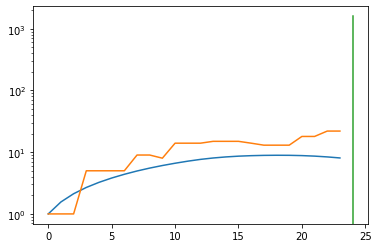

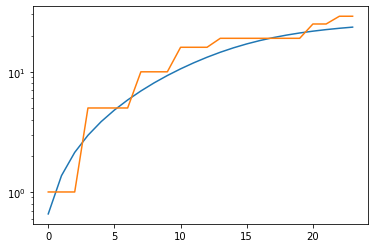

total error: 0.031477175652980804


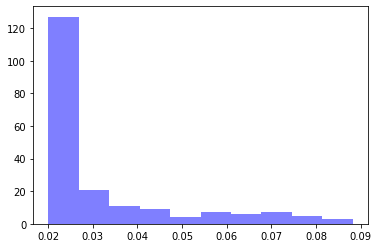

alpha: 0.8993704 , beta: 0.24625374 , initial_unconfirmed 5.8053985 , t0s 0.0 , lambds 0.5450291


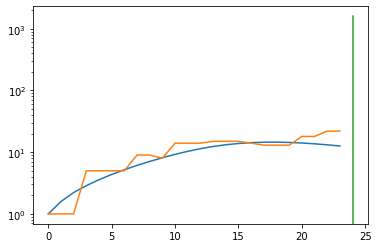

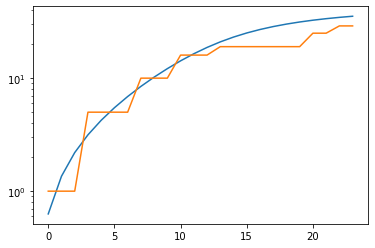

total error: 0.02490122802555561


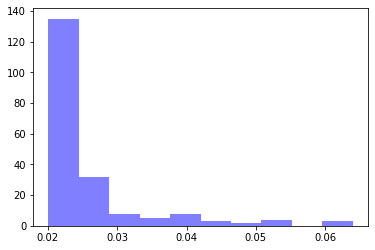

alpha: 0.8993704 , beta: 0.24625374 , initial_unconfirmed 5.8053985 , t0s 0.0 , lambds 0.5450291


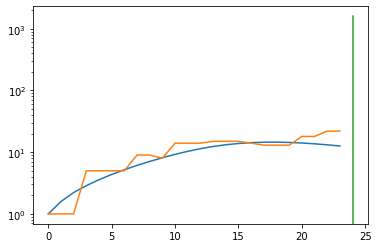

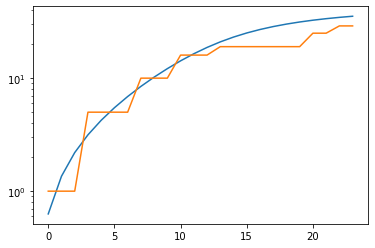

total error: 0.021691422909498215


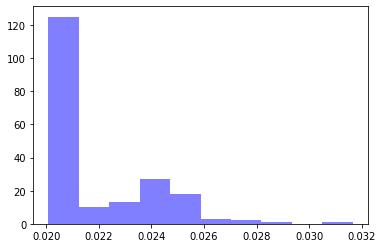

alpha: 0.8993704 , beta: 0.24625374 , initial_unconfirmed 5.8053985 , t0s 0.0 , lambds 0.5450291


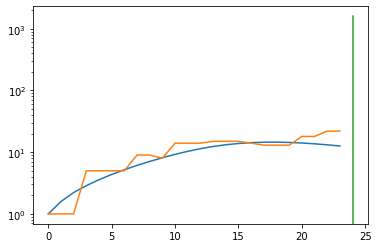

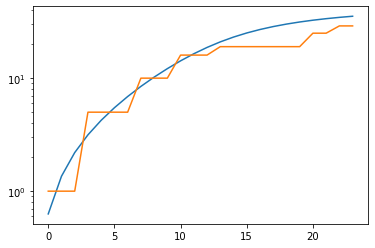

total error: 0.021270396187901497


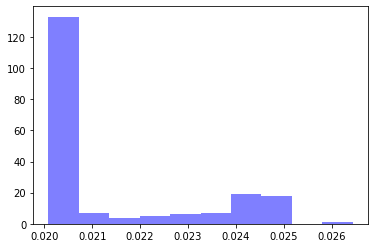

alpha: 0.8993704 , beta: 0.24625374 , initial_unconfirmed 5.8053985 , t0s 0.0 , lambds 0.5450291


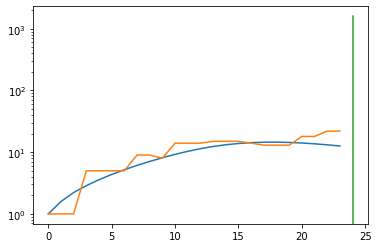

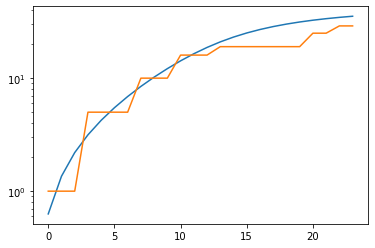

Australia
total error: 6.3904500007629395


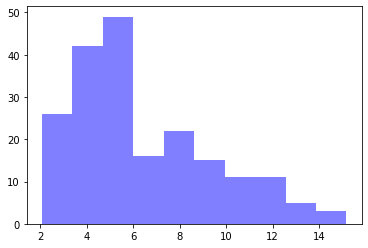

alpha: 0.8521855 , beta: 0.50342244 , initial_unconfirmed 10.973731 , t0s 0.57342255 , lambds 0.6194812


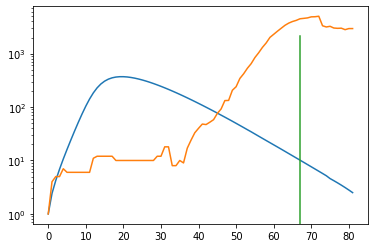

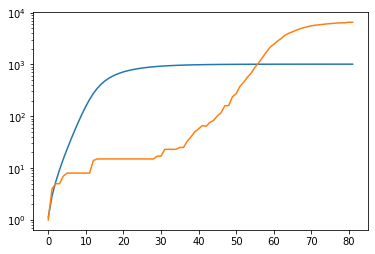

total error: 0.5619357824325562


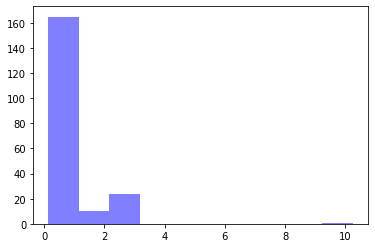

alpha: 0.7065933 , beta: 0.2234106 , initial_unconfirmed 3.1286063 , t0s 4.843998 , lambds 0.005427867


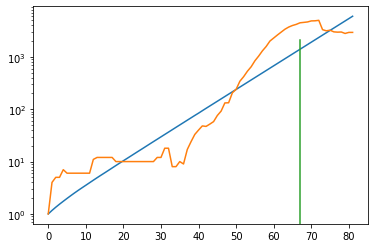

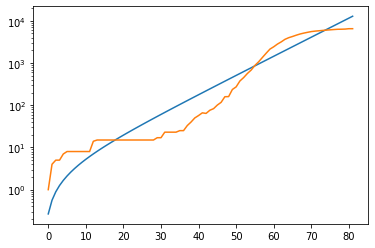

total error: 0.18756531178951263


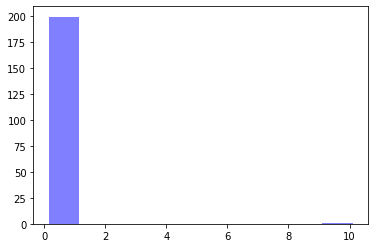

alpha: 0.7573091 , beta: 0.22332399 , initial_unconfirmed 2.923474 , t0s 6.098726 , lambds 0.0004893414


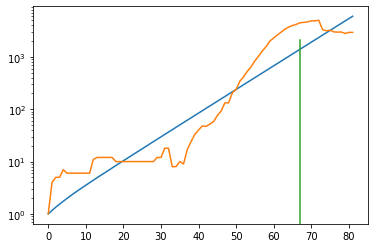

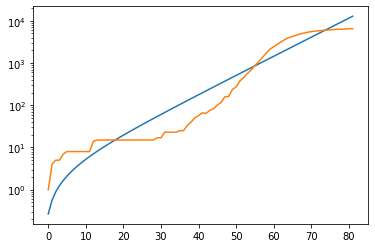

total error: 0.18748575448989868


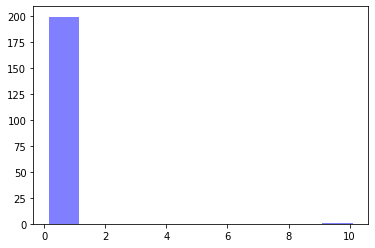

alpha: 0.789991 , beta: 0.22333373 , initial_unconfirmed 2.8013928 , t0s 6.1021795 , lambds 0.000305383


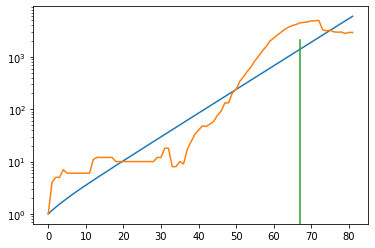

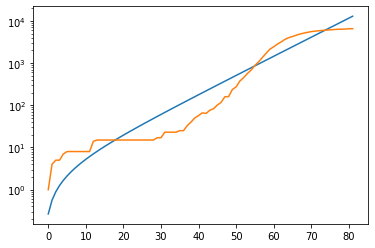

total error: 0.18745124340057373


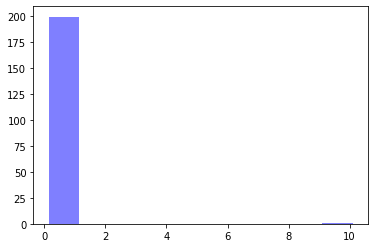

alpha: 0.8339081 , beta: 0.22334714 , initial_unconfirmed 2.6522431 , t0s 6.104139 , lambds 0.00019668855


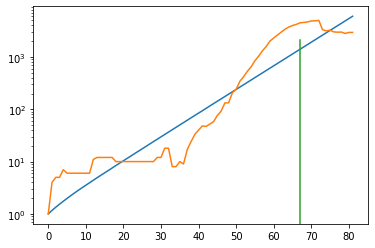

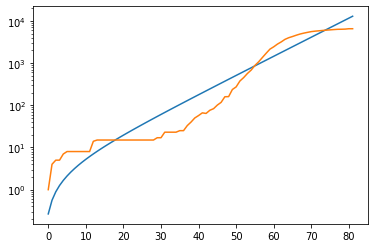

China
total error: 10.055739402770996


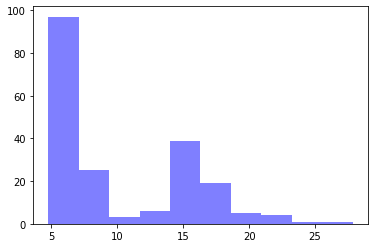

alpha: 0.99696076 , beta: 0.5702843 , initial_unconfirmed 47.712082 , t0s 0.6761629 , lambds 0.5126036


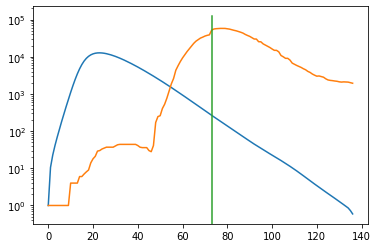

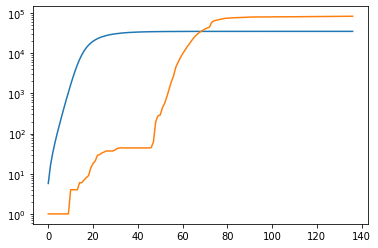

total error: 14.250205993652344


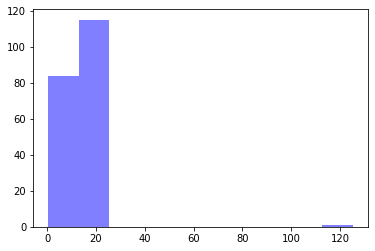

alpha: 0.69025457 , beta: 0.21925902 , initial_unconfirmed 20.565825 , t0s 1.7927312 , lambds 0.07961485


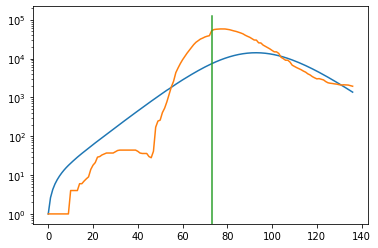

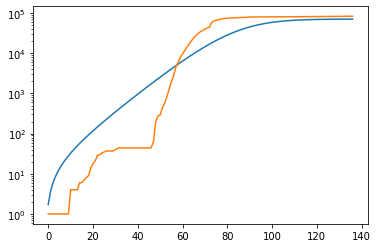

total error: 13.820679664611816


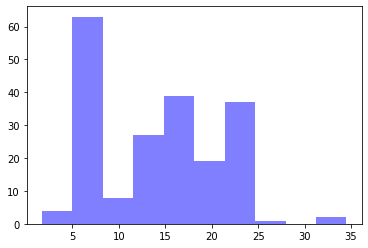

alpha: 0.99738187 , beta: 0.2382634 , initial_unconfirmed 7.680632 , t0s 0.0 , lambds 0.08126427


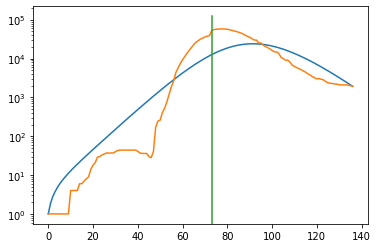

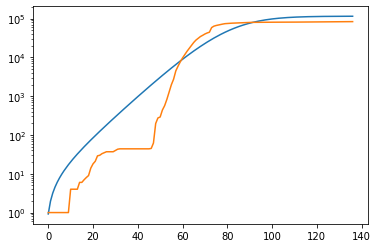

total error: 14.863819122314453


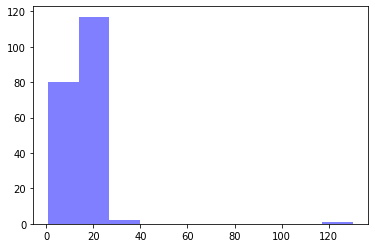

alpha: 0.99738187 , beta: 0.2382634 , initial_unconfirmed 7.680632 , t0s 0.0 , lambds 0.08126427


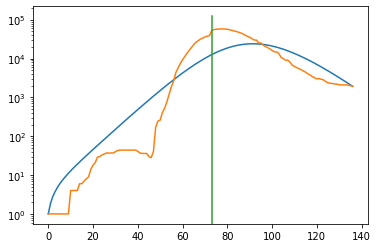

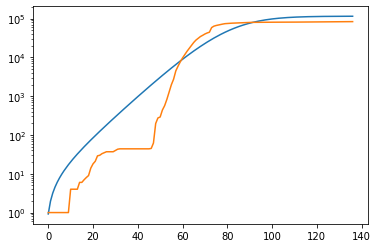

total error: 15.024614334106445


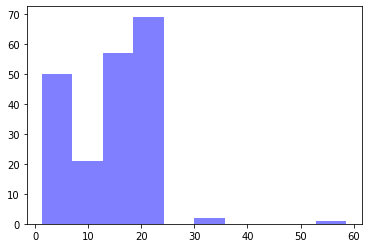

alpha: 0.99738187 , beta: 0.2382634 , initial_unconfirmed 7.680632 , t0s 0.0 , lambds 0.08126427


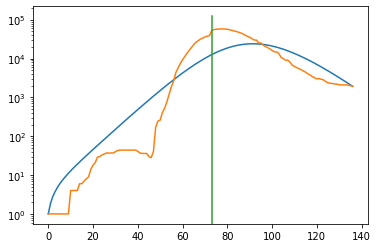

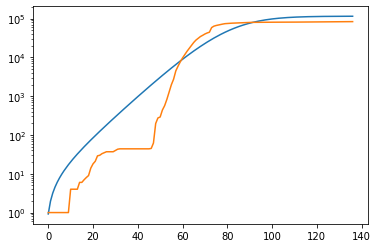

Lebanon
total error: 4.539872646331787


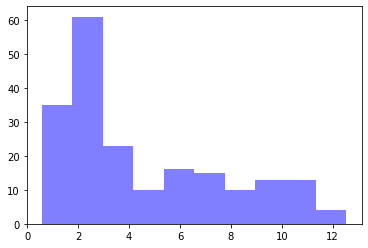

alpha: 0.75912297 , beta: 0.79091555 , initial_unconfirmed 0.862357 , t0s 0.0033860803 , lambds 0.59300876


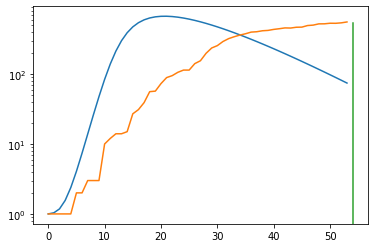

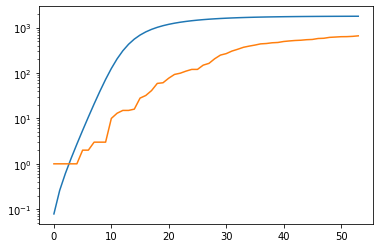

total error: 0.21507276594638824


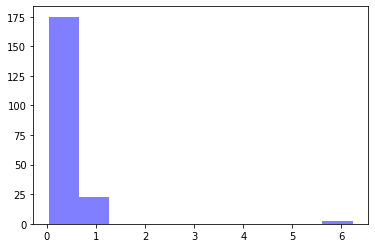

alpha: 0.5030483 , beta: 0.31035367 , initial_unconfirmed 4.2987356 , t0s 0.0 , lambds 0.20729661


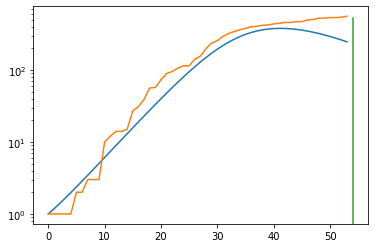

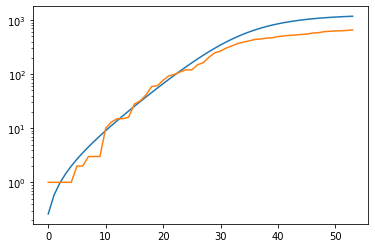

total error: 0.09810584038496017


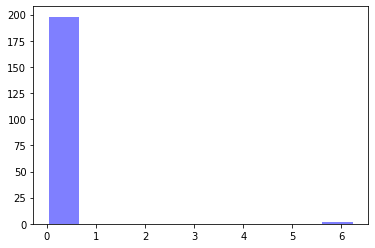

alpha: 0.50033486 , beta: 0.31036332 , initial_unconfirmed 4.3217773 , t0s 0.0 , lambds 0.20730491


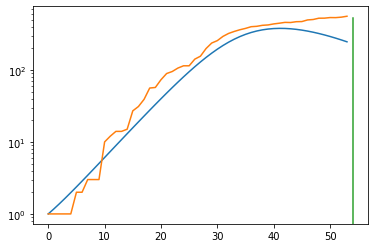

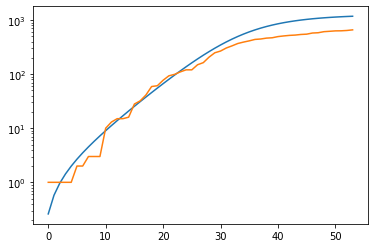

total error: 0.09787225723266602


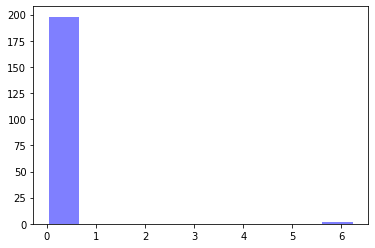

alpha: 0.50033486 , beta: 0.31036332 , initial_unconfirmed 4.3217773 , t0s 0.0 , lambds 0.20730491


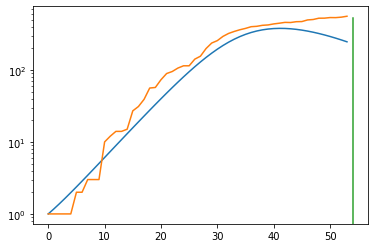

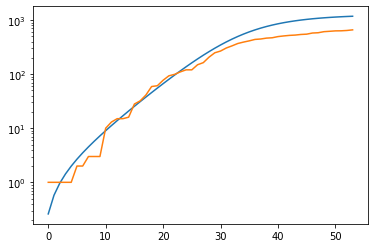

total error: 0.09788161516189575


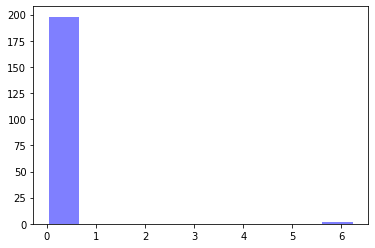

alpha: 0.50033486 , beta: 0.31036332 , initial_unconfirmed 4.3217773 , t0s 0.0 , lambds 0.20730491


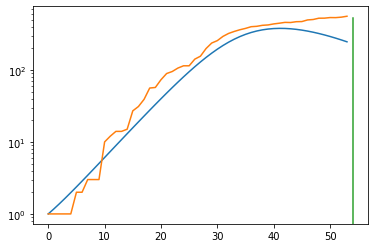

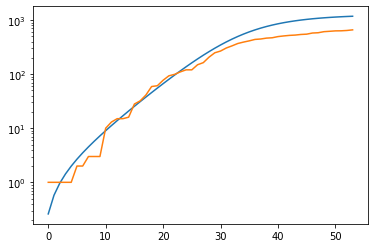

Vanuatu
Senegal
total error: 4.566494941711426


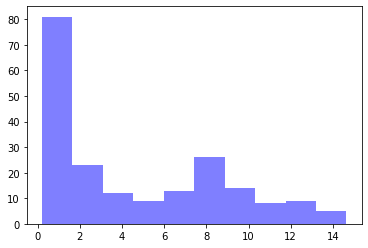

alpha: 0.99949133 , beta: 0.5220573 , initial_unconfirmed 1.2338996 , t0s 0.65649474 , lambds 0.6479675


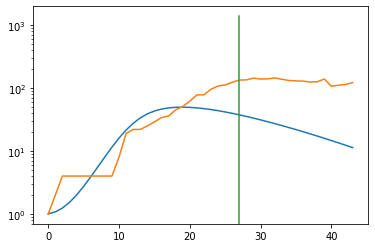

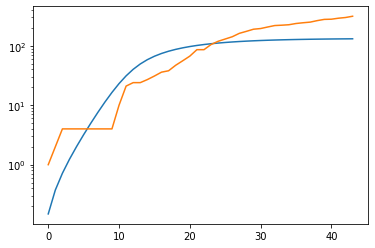

total error: 0.11307882517576218


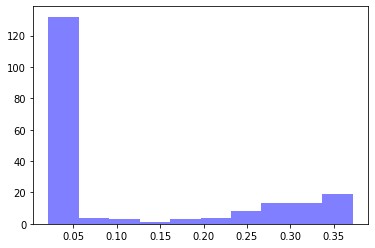

alpha: 0.66447234 , beta: 0.27106783 , initial_unconfirmed 6.8589263 , t0s 7.1063313 , lambds 0.34603047


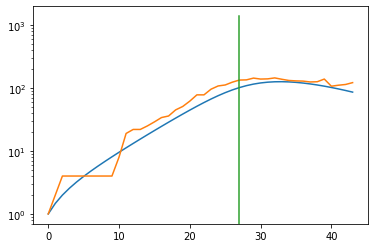

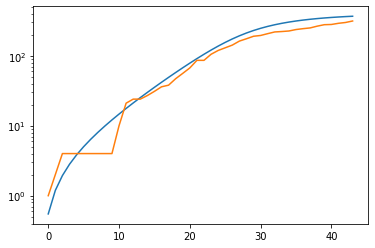

total error: 0.03525038808584213


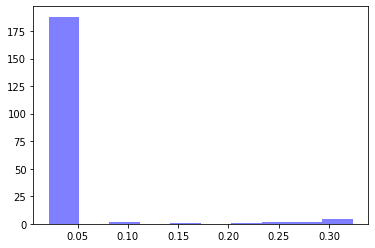

alpha: 0.73132986 , beta: 0.27191108 , initial_unconfirmed 6.204464 , t0s 5.9967985 , lambds 0.327405


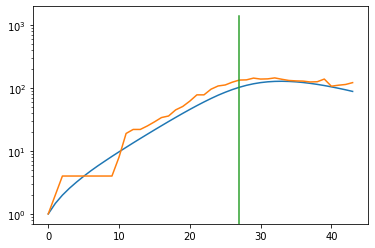

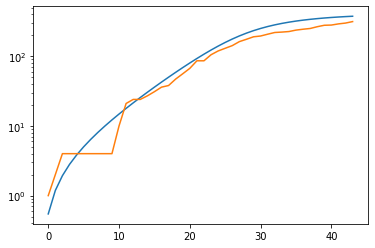

total error: 0.021315032616257668


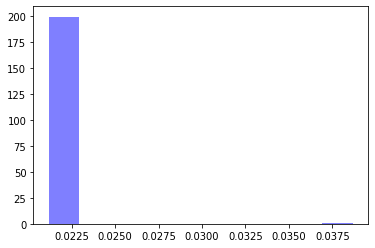

alpha: 0.73143494 , beta: 0.27193442 , initial_unconfirmed 6.203648 , t0s 5.956359 , lambds 0.32675463


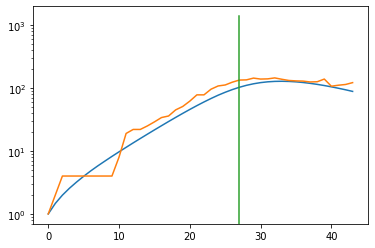

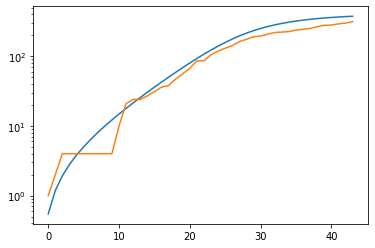

total error: 0.02126288414001465


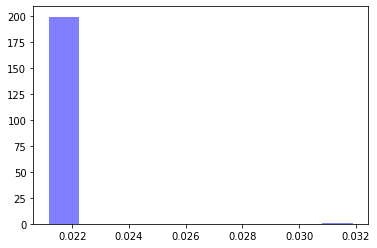

alpha: 0.73143494 , beta: 0.27193442 , initial_unconfirmed 6.203648 , t0s 5.956359 , lambds 0.32675463


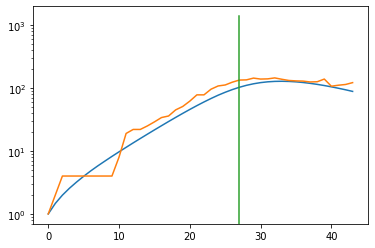

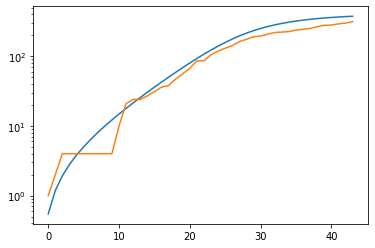

Denmark
total error: 3.8612537384033203


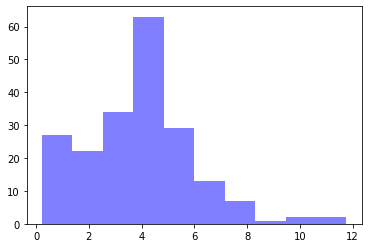

alpha: 0.9998635 , beta: 0.7704818 , initial_unconfirmed 1.0403842 , t0s 0.09565526 , lambds 0.5667304


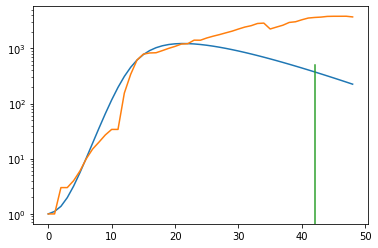

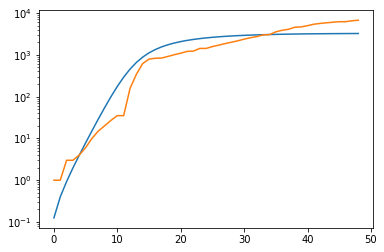

total error: 0.07865665853023529


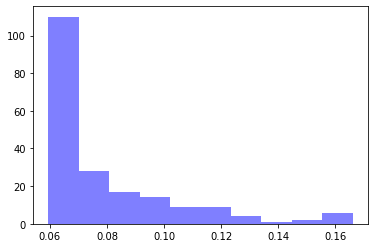

alpha: 0.50284076 , beta: 0.45910975 , initial_unconfirmed 9.4877 , t0s 0.0 , lambds 0.31373572


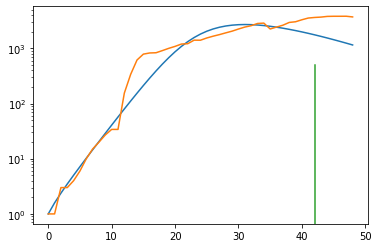

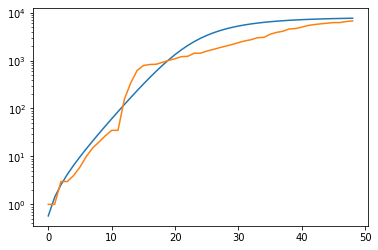

total error: 0.06292081624269485


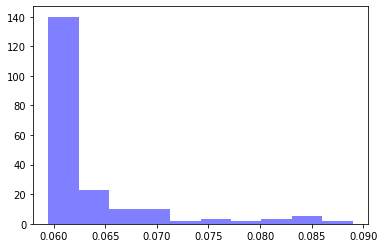

alpha: 0.50284076 , beta: 0.45910975 , initial_unconfirmed 9.4877 , t0s 0.0 , lambds 0.31373572


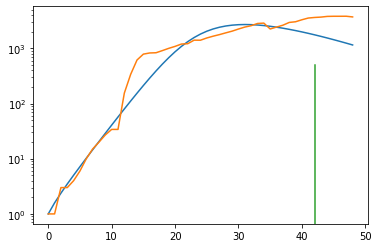

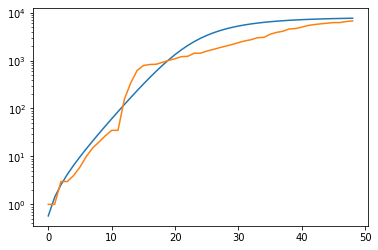

total error: 0.059766627848148346


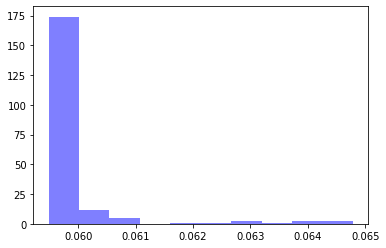

alpha: 0.50284076 , beta: 0.45910975 , initial_unconfirmed 9.4877 , t0s 0.0 , lambds 0.31373572


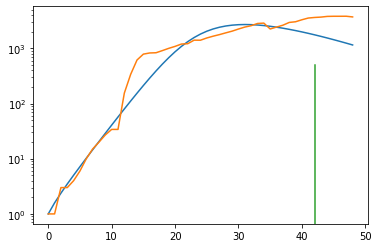

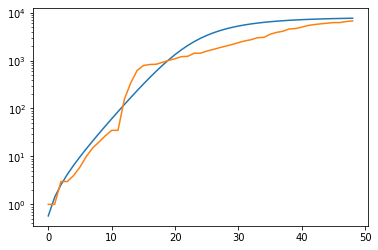

total error: 0.0594998300075531


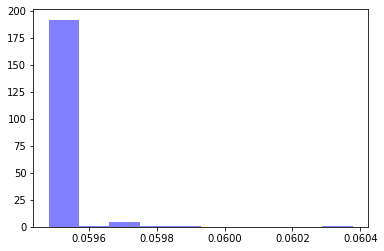

alpha: 0.50284076 , beta: 0.45910975 , initial_unconfirmed 9.4877 , t0s 0.0 , lambds 0.31373572


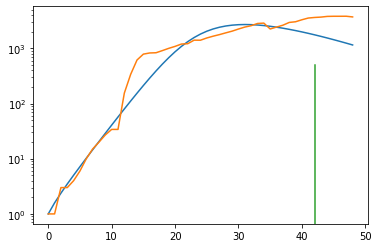

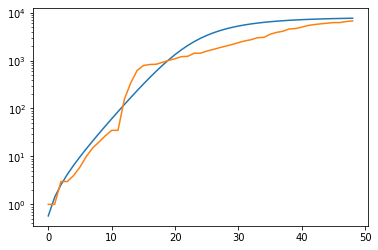

Tajikistan
Mayotte
total error: 2.989593267440796


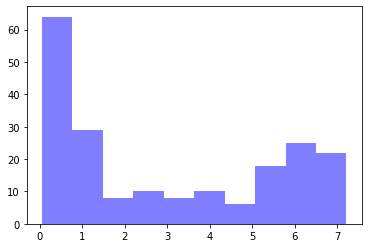

alpha: 0.9998653 , beta: 0.4136103 , initial_unconfirmed 4.8826637 , t0s 0.5961574 , lambds 0.6145994


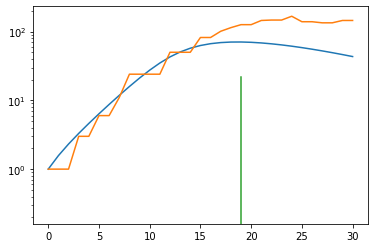

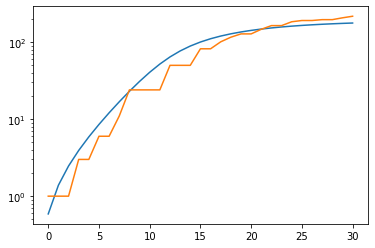

total error: 0.07471398264169693


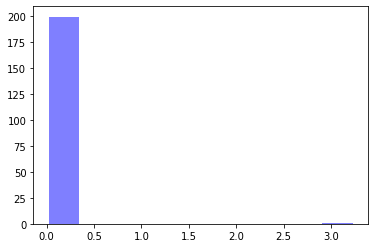

alpha: 0.5022556 , beta: 0.3840458 , initial_unconfirmed 7.772077 , t0s 0.0 , lambds 0.42363036


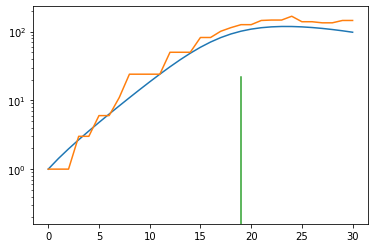

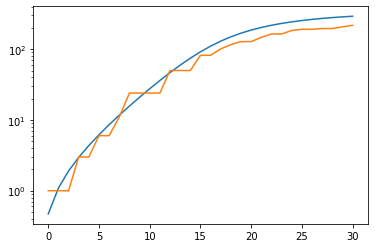

total error: 0.0375620499253273


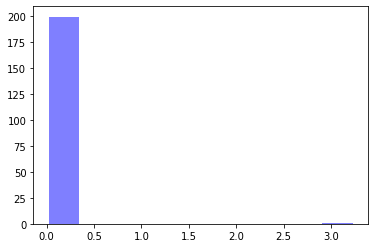

alpha: 0.5010546 , beta: 0.38407183 , initial_unconfirmed 7.789174 , t0s 0.0 , lambds 0.42365274


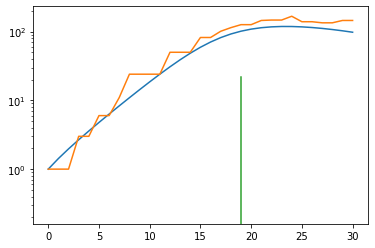

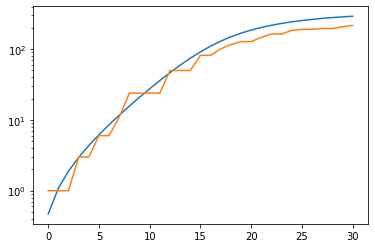

total error: 0.03524364158511162


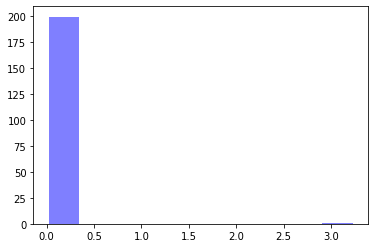

alpha: 0.5010546 , beta: 0.38407183 , initial_unconfirmed 7.789174 , t0s 0.0 , lambds 0.42365274


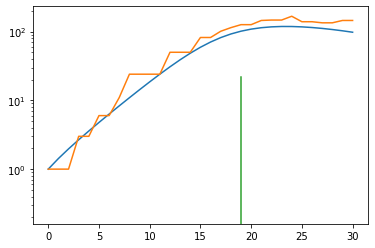

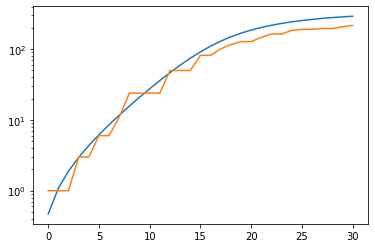

total error: 0.03521541506052017


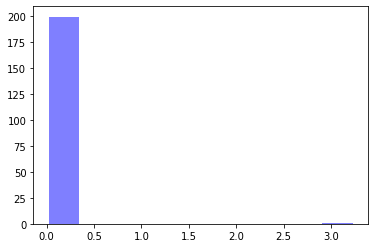

alpha: 0.5010546 , beta: 0.38407183 , initial_unconfirmed 7.789174 , t0s 0.0 , lambds 0.42365274


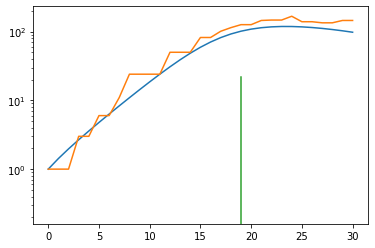

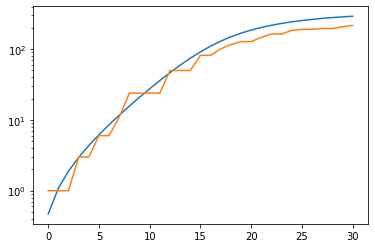

Marshall Islands
Iran
total error: 5.328705310821533


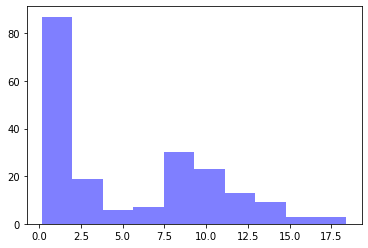

alpha: 0.94053924 , beta: 0.6413753 , initial_unconfirmed 40.523907 , t0s 0.9325222 , lambds 0.5234817


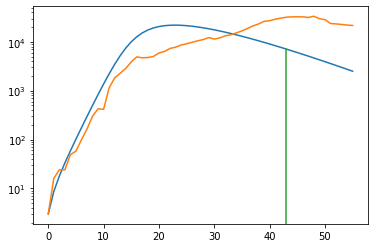

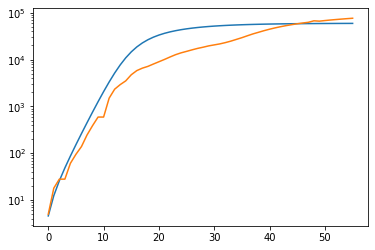

total error: 0.07799401879310608


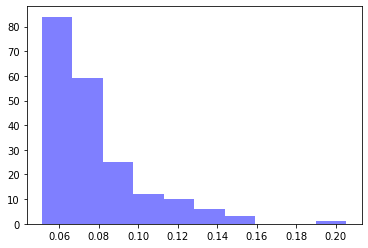

alpha: 0.99663055 , beta: 0.3917651 , initial_unconfirmed 72.05239 , t0s 0.0 , lambds 0.26596737


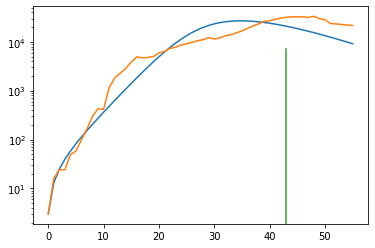

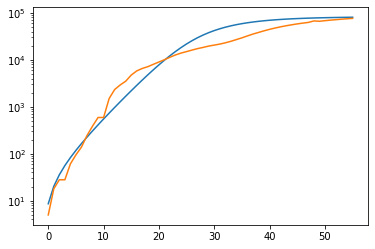

total error: 0.06899037212133408


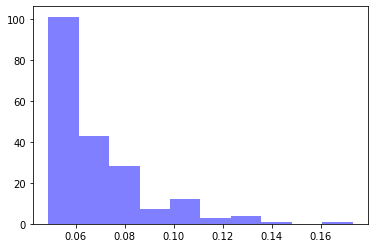

alpha: 0.99838346 , beta: 0.3731633 , initial_unconfirmed 89.21772 , t0s 0.0 , lambds 0.25578734


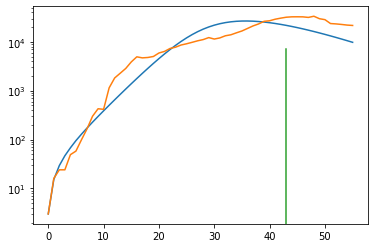

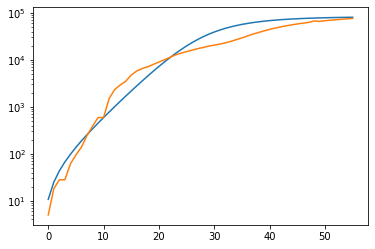

total error: 0.06370294094085693


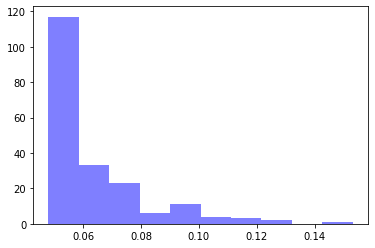

alpha: 0.9988475 , beta: 0.36392513 , initial_unconfirmed 99.97922 , t0s 0.0 , lambds 0.25028658


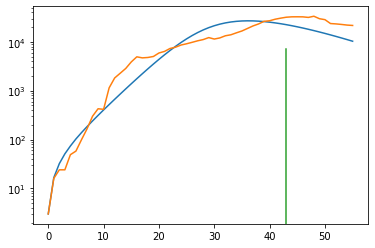

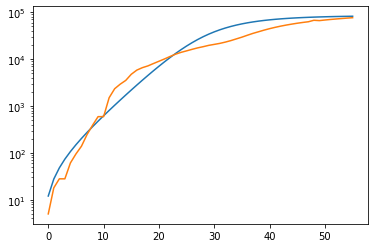

total error: 0.060060761868953705


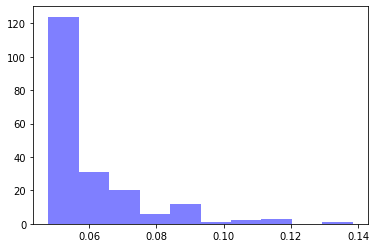

alpha: 0.9990228 , beta: 0.35915932 , initial_unconfirmed 105.97124 , t0s 0.0 , lambds 0.247596


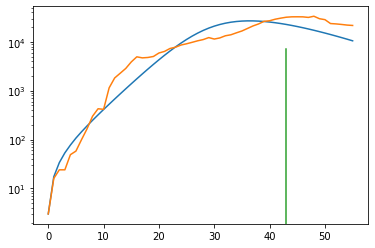

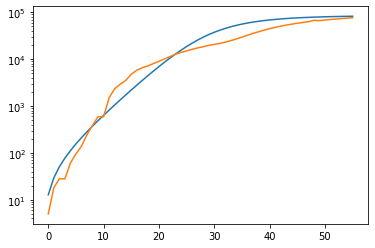

Nicaragua
total error: 5.805627822875977


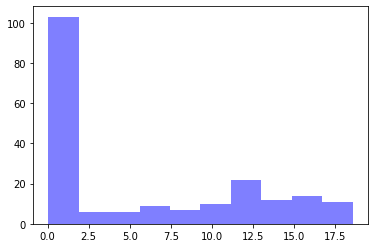

alpha: 0.9976136 , beta: 0.15306014 , initial_unconfirmed 3.0187905 , t0s 0.9054433 , lambds 0.5736178


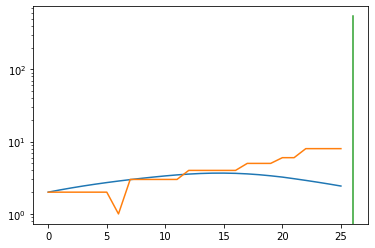

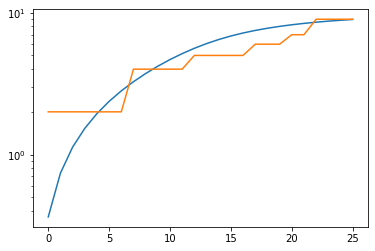

total error: 0.07120820879936218


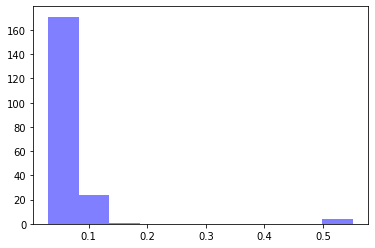

alpha: 0.5066684 , beta: 0.13885473 , initial_unconfirmed 6.357568 , t0s 1.7485214 , lambds 0.0013324756


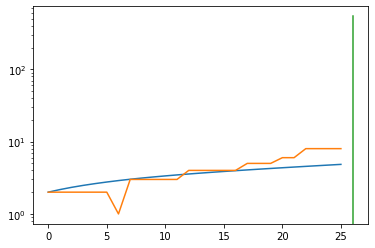

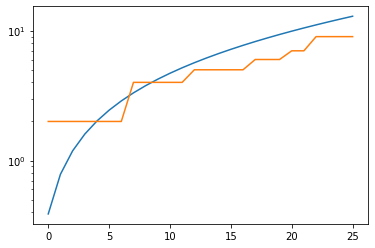

total error: 0.057473450899124146


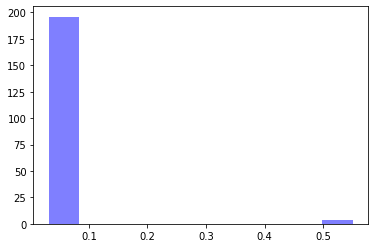

alpha: 0.5066684 , beta: 0.13885473 , initial_unconfirmed 6.357568 , t0s 1.7485214 , lambds 0.0013324756


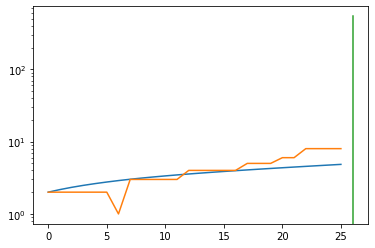

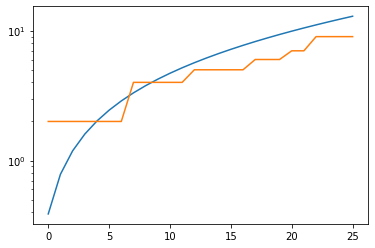

total error: 0.05348345637321472


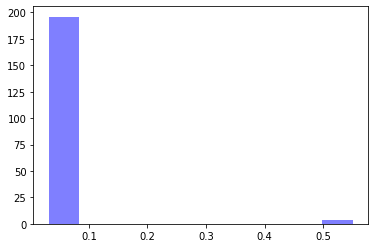

alpha: 0.5066684 , beta: 0.13885473 , initial_unconfirmed 6.357568 , t0s 1.7485214 , lambds 0.0013324756


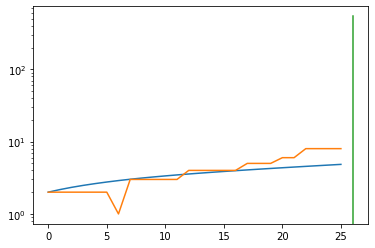

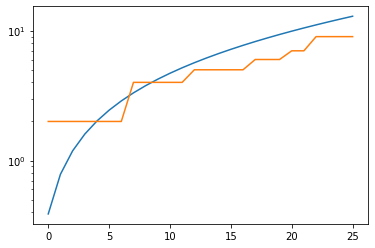

total error: 0.050273116677999496


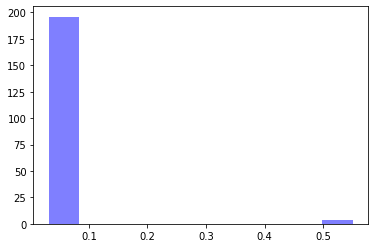

alpha: 0.5066684 , beta: 0.13885473 , initial_unconfirmed 6.357568 , t0s 1.7485214 , lambds 0.0013324756


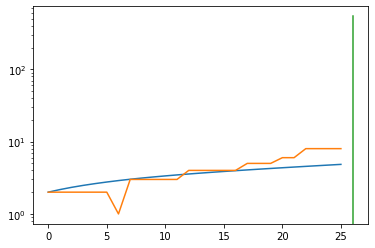

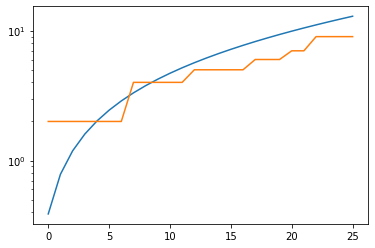

Ethiopia
total error: 5.137935161590576


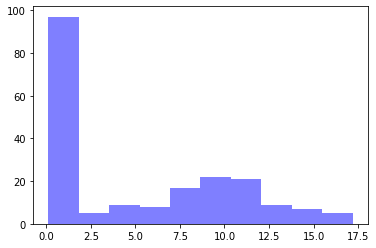

alpha: 0.98762417 , beta: 0.22974378 , initial_unconfirmed 8.618691 , t0s 0.61656845 , lambds 0.58116716


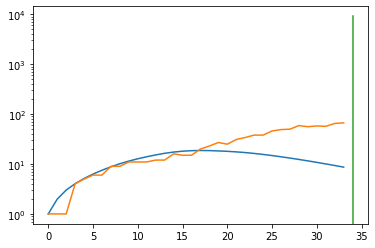

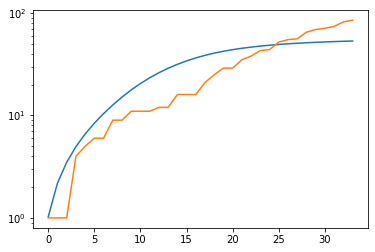

total error: 0.10130072385072708


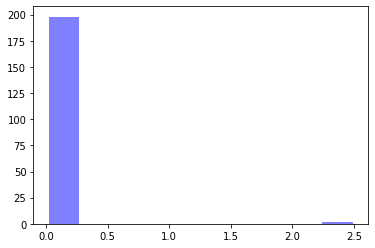

alpha: 0.9970679 , beta: 0.20971079 , initial_unconfirmed 5.6548986 , t0s 2.5227208 , lambds 0.20743051


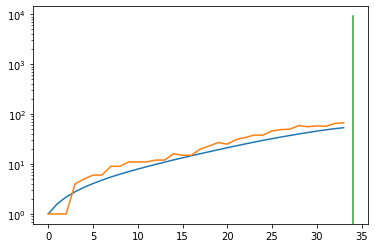

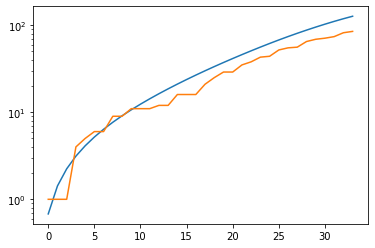

total error: 0.08262132853269577


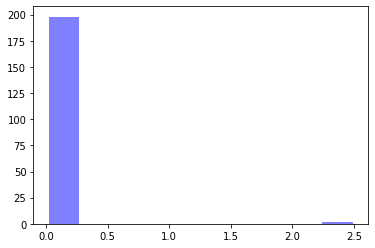

alpha: 0.99997705 , beta: 0.20713672 , initial_unconfirmed 5.7473416 , t0s 11.30077 , lambds 0.31326693


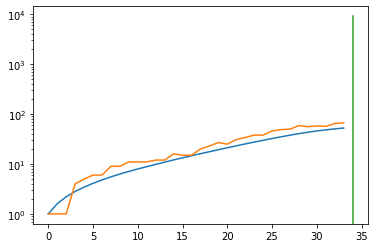

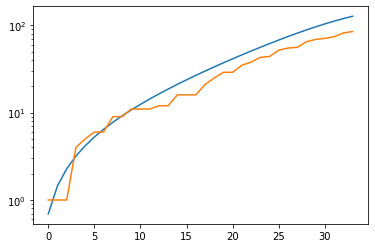

total error: 0.06271949410438538


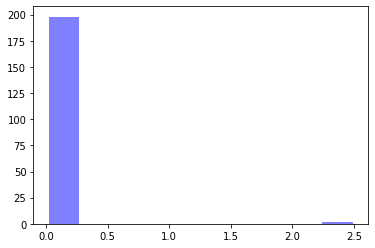

alpha: 0.9999768 , beta: 0.20721874 , initial_unconfirmed 5.7070293 , t0s 13.593491 , lambds 0.36093366


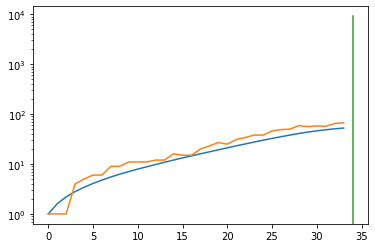

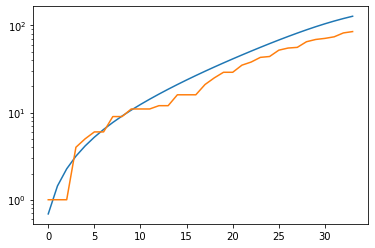

total error: 0.04354803264141083


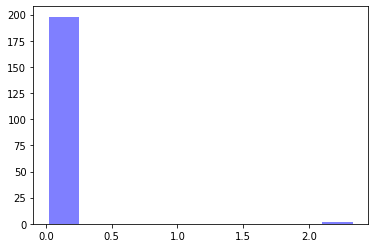

alpha: 0.9999885 , beta: 0.20722292 , initial_unconfirmed 5.6796885 , t0s 20.605898 , lambds 0.74453557


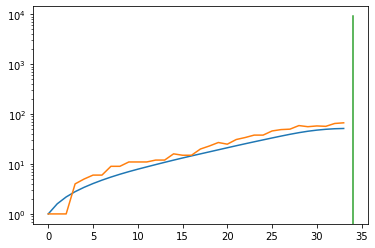

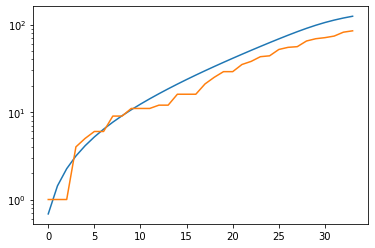

Aruba
total error: 3.4529974460601807


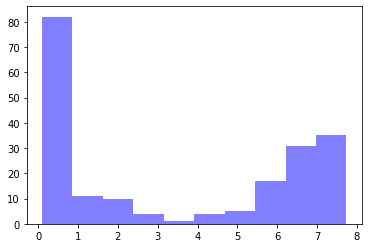

alpha: 0.8424616 , beta: 0.3557382 , initial_unconfirmed 6.1324625 , t0s 0.83184856 , lambds 0.58260363


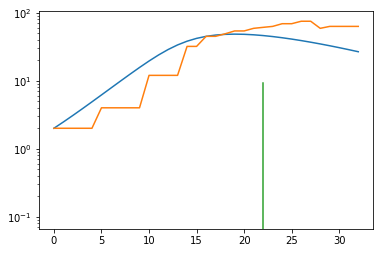

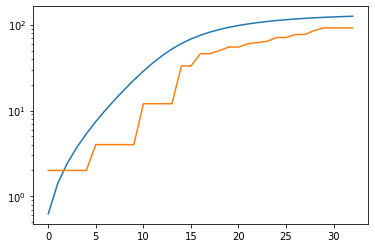

total error: 0.10778442025184631


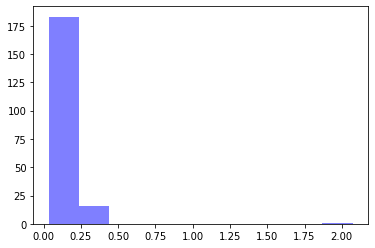

alpha: 0.99511576 , beta: 0.28536275 , initial_unconfirmed 3.4290268 , t0s 9.813038 , lambds 0.6428514


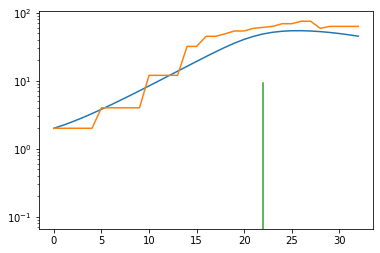

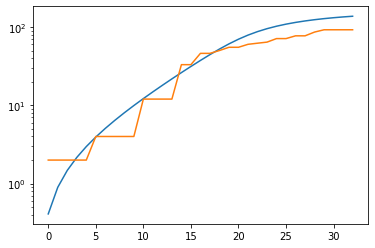

total error: 0.05596114695072174


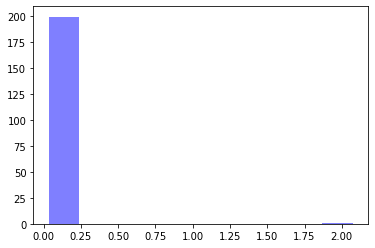

alpha: 0.9947861 , beta: 0.2896799 , initial_unconfirmed 3.2703264 , t0s 10.373292 , lambds 0.69705683


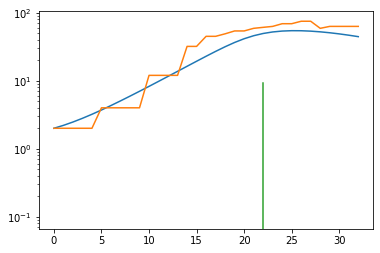

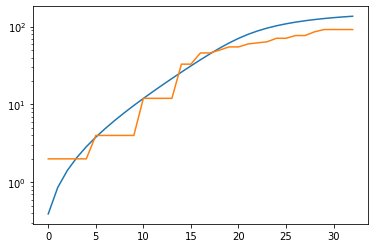

total error: 0.04278021678328514


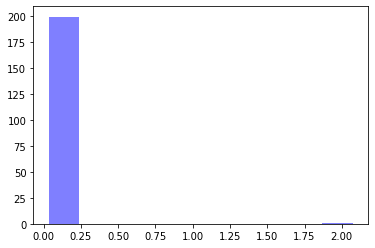

alpha: 0.999859 , beta: 0.28964186 , initial_unconfirmed 3.254206 , t0s 10.439021 , lambds 0.7018958


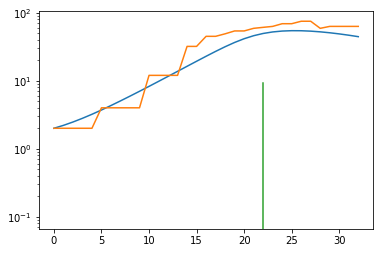

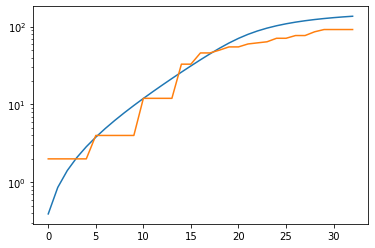

total error: 0.04277629777789116


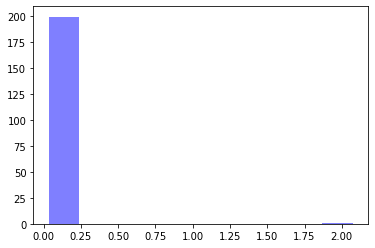

alpha: 0.999859 , beta: 0.28964186 , initial_unconfirmed 3.254206 , t0s 10.439021 , lambds 0.7018958


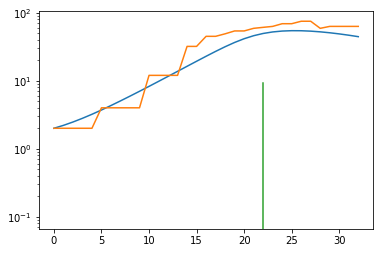

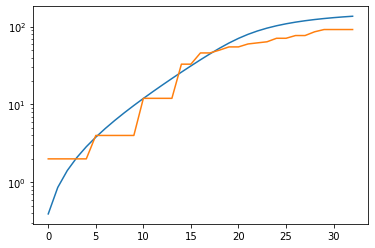

Nigeria
total error: 5.863224029541016


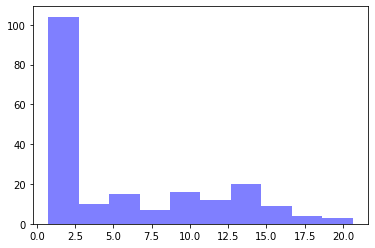

alpha: 0.9999316 , beta: 0.42897677 , initial_unconfirmed 2.982539 , t0s 0.69455904 , lambds 0.62520313


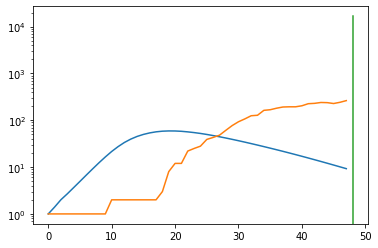

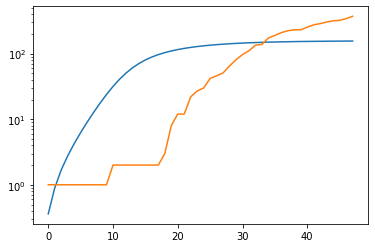

total error: 0.3617309331893921


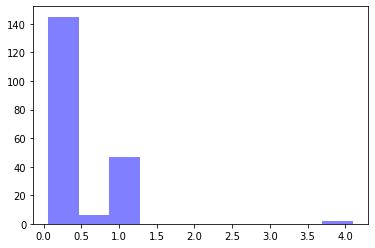

alpha: 0.9999484 , beta: 0.2999459 , initial_unconfirmed 0.5780608 , t0s 4.187187 , lambds 0.19284835


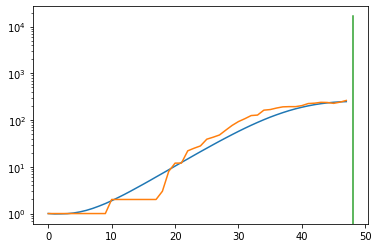

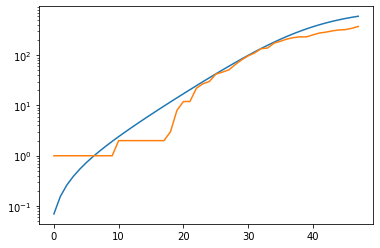

total error: 0.13433630764484406


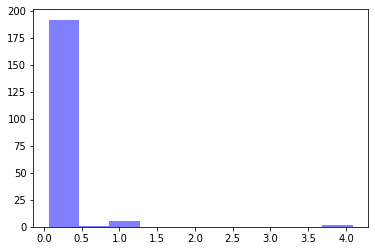

alpha: 0.5565839 , beta: 0.29474142 , initial_unconfirmed 1.070083 , t0s 22.07609 , lambds 0.45104098


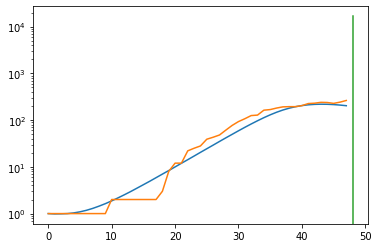

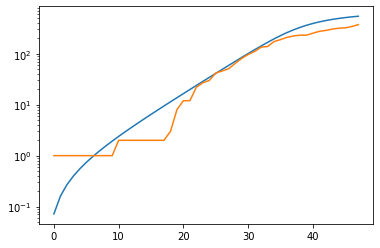

total error: 0.10099227726459503


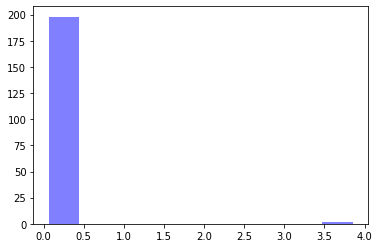

alpha: 0.53908074 , beta: 0.29526466 , initial_unconfirmed 1.1189857 , t0s 25.898731 , lambds 0.6345203


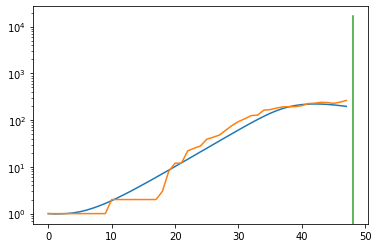

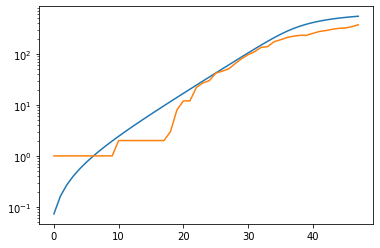

total error: 0.1006757915019989


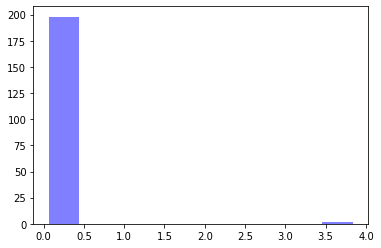

alpha: 0.53908074 , beta: 0.29526466 , initial_unconfirmed 1.1189857 , t0s 25.898731 , lambds 0.6345203


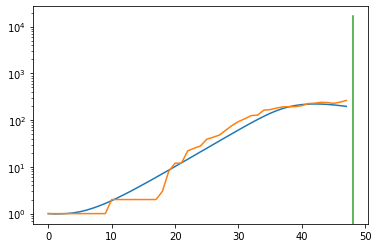

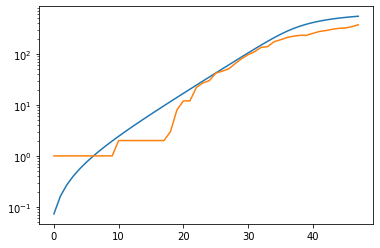

Belgium
total error: 6.345182418823242


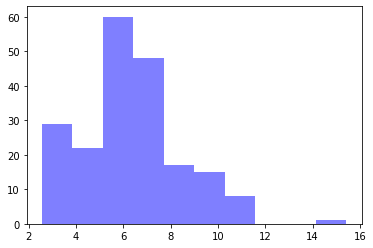

alpha: 0.9968209 , beta: 0.7599139 , initial_unconfirmed 2.0319045 , t0s 0.12165022 , lambds 0.5397934


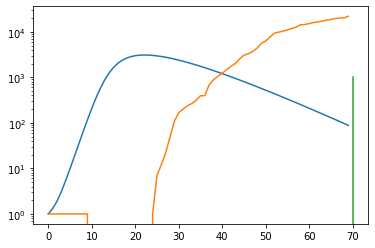

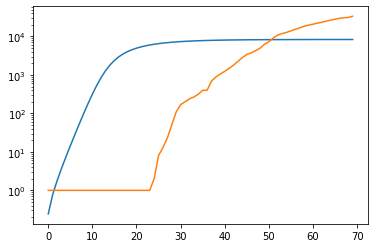

total error: 0.5630151629447937


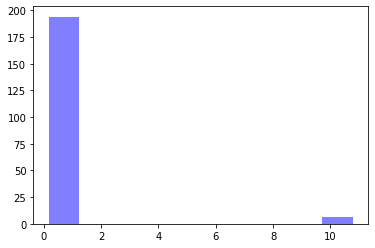

alpha: 0.9672947 , beta: 0.35099396 , initial_unconfirmed 0.19217876 , t0s 3.5687466 , lambds 0.12555596


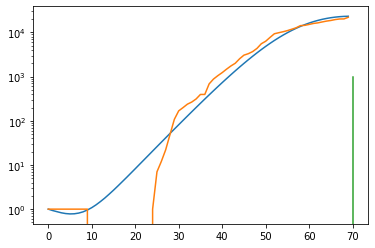

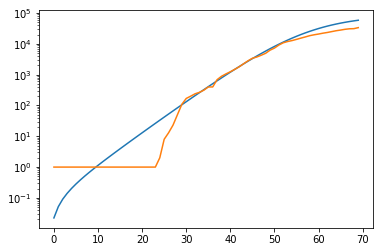

total error: 0.49974730610847473


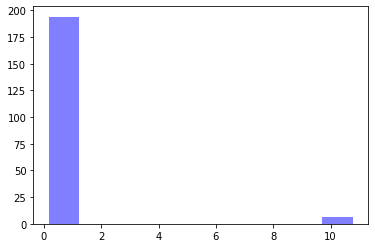

alpha: 0.9987508 , beta: 0.34654495 , initial_unconfirmed 0.19258279 , t0s 17.439339 , lambds 0.17595634


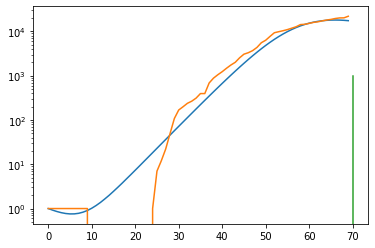

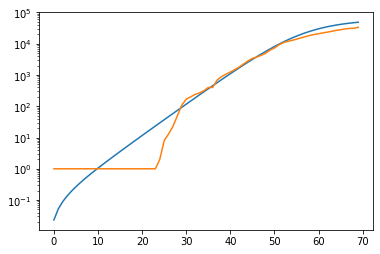

total error: 0.48685070872306824


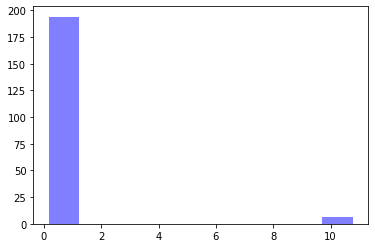

alpha: 0.9987676 , beta: 0.34344488 , initial_unconfirmed 0.20161971 , t0s 27.54829 , lambds 0.24670525


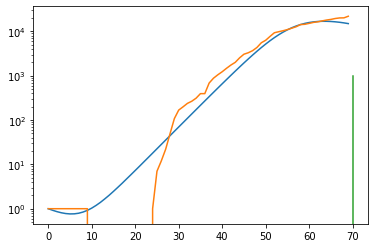

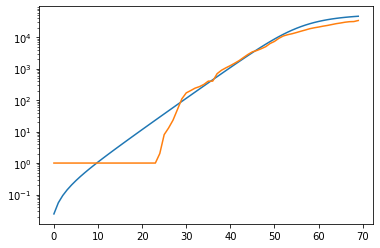

total error: 0.48350486159324646


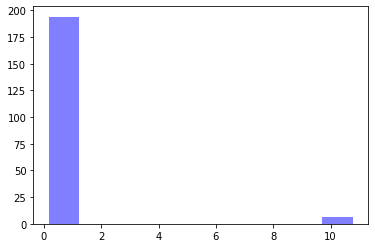

alpha: 0.9987892 , beta: 0.34249073 , initial_unconfirmed 0.2041358 , t0s 30.348288 , lambds 0.27737784


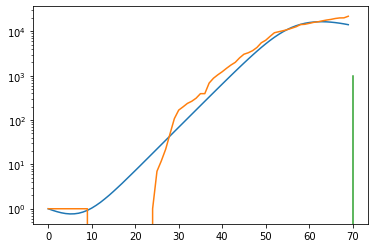

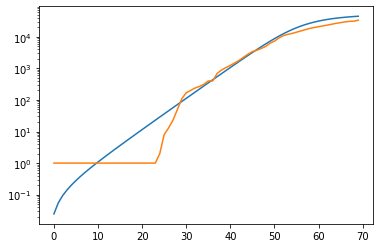

Saudi Arabia
total error: 3.9529852867126465


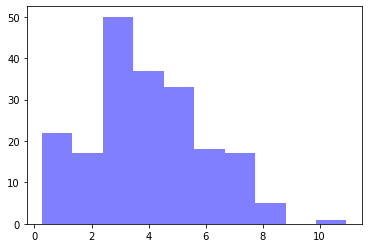

alpha: 0.9999263 , beta: 0.4904215 , initial_unconfirmed 11.095134 , t0s 0.005905628 , lambds 0.5236295


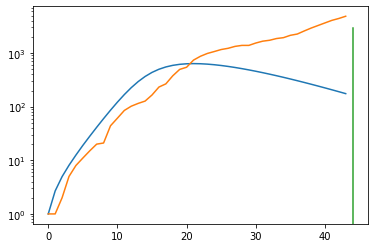

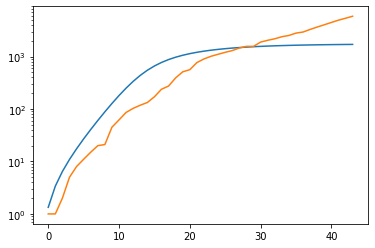

total error: 0.039322853088378906


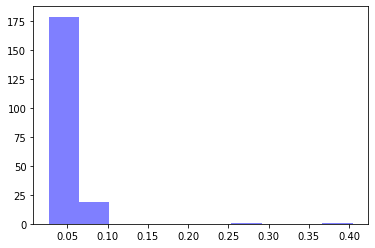

alpha: 0.50055766 , beta: 0.3638566 , initial_unconfirmed 17.354021 , t0s 0.0 , lambds 0.25224316


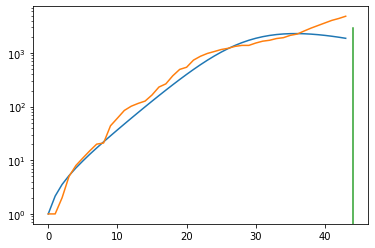

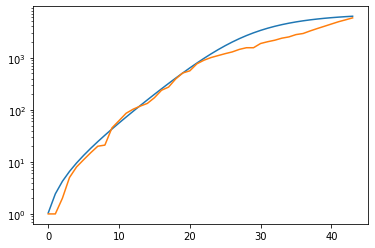

total error: 0.027446577325463295


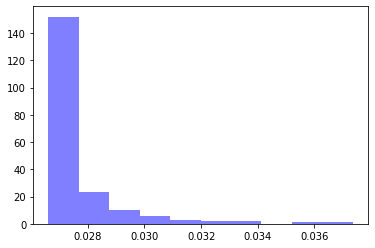

alpha: 0.50055766 , beta: 0.3638566 , initial_unconfirmed 17.354021 , t0s 0.0 , lambds 0.25224316


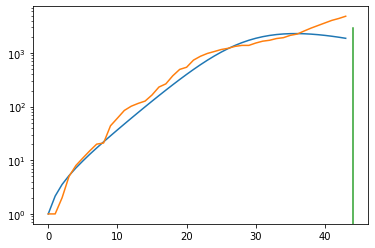

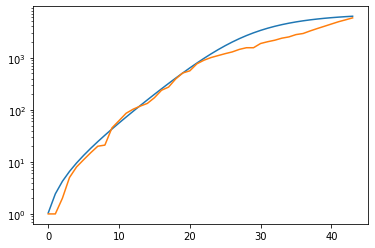

total error: 0.02668222039937973


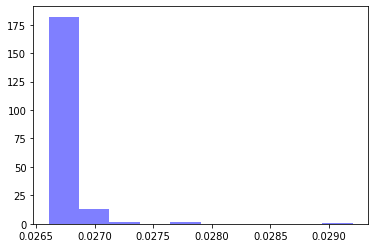

alpha: 0.50055766 , beta: 0.3638566 , initial_unconfirmed 17.354021 , t0s 0.0 , lambds 0.25224316


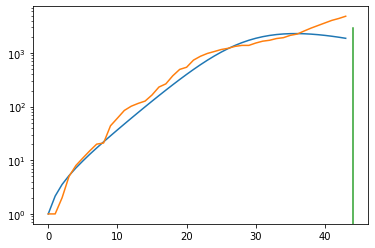

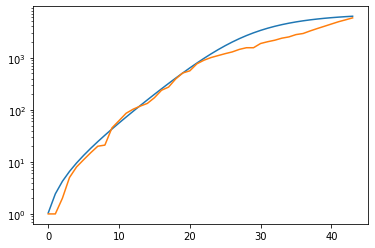

total error: 0.026631999760866165


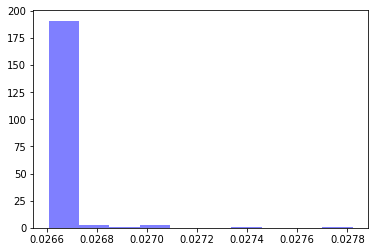

alpha: 0.50055766 , beta: 0.3638566 , initial_unconfirmed 17.354021 , t0s 0.0 , lambds 0.25224316


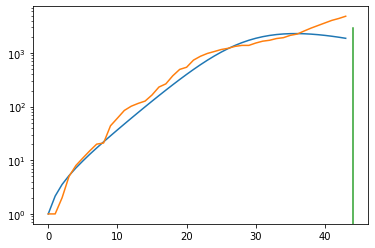

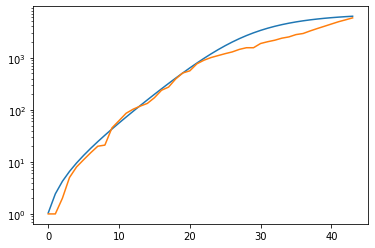

Cayman Islands
total error: 3.5217888355255127


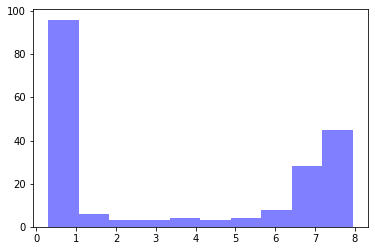

alpha: 0.9796525 , beta: 0.33220893 , initial_unconfirmed 1.2468427 , t0s 0.4486459 , lambds 0.70436734


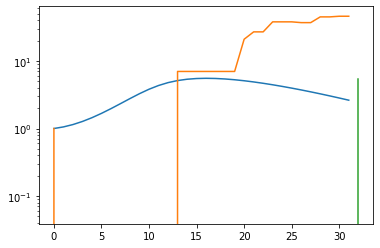

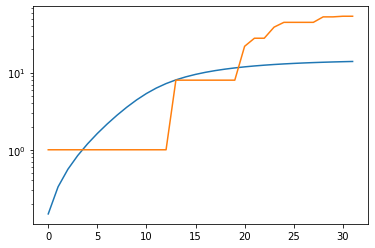

total error: 0.1768220067024231


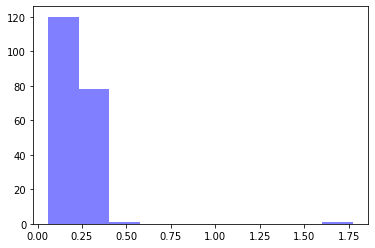

alpha: 0.90811026 , beta: 0.2785167 , initial_unconfirmed 1.1265336 , t0s 3.1307364 , lambds 0.23865895


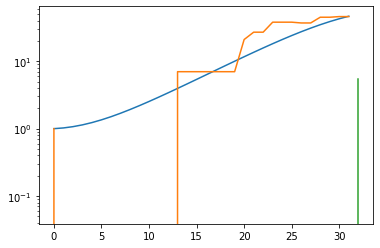

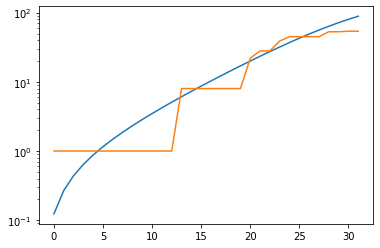

total error: 0.10477849841117859


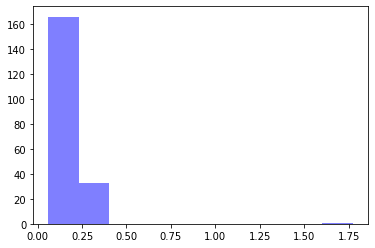

alpha: 0.50985545 , beta: 0.27892333 , initial_unconfirmed 1.9885589 , t0s 7.159013 , lambds 0.30205646


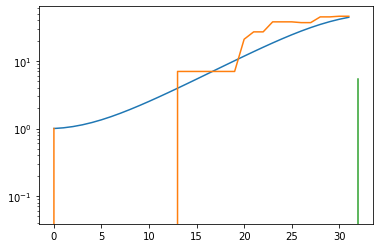

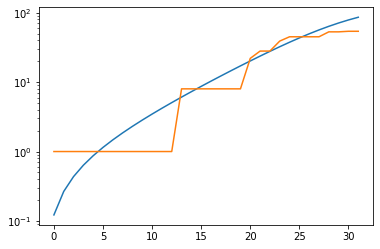

total error: 0.070128433406353


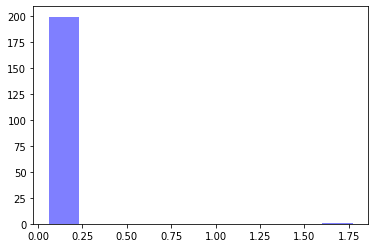

alpha: 0.5100426 , beta: 0.2785339 , initial_unconfirmed 1.9733932 , t0s 16.74574 , lambds 0.66737926


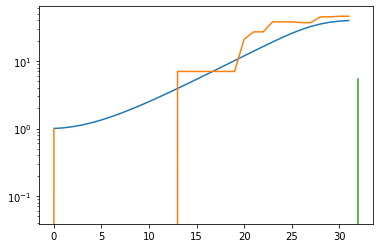

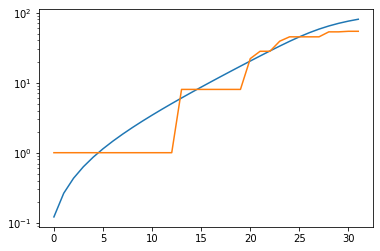

total error: 0.07008016109466553


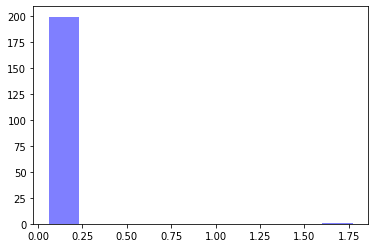

alpha: 0.5103332 , beta: 0.2782516 , initial_unconfirmed 1.9742873 , t0s 19.029526 , lambds 0.89600474


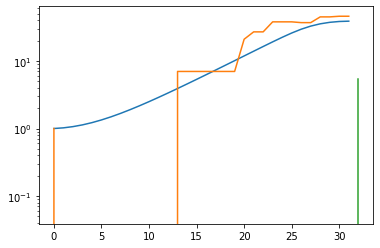

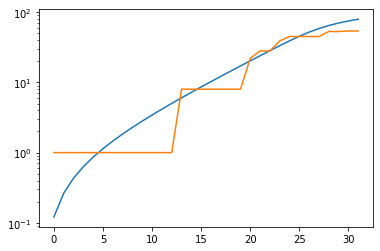

El Salvador
total error: 4.038309097290039


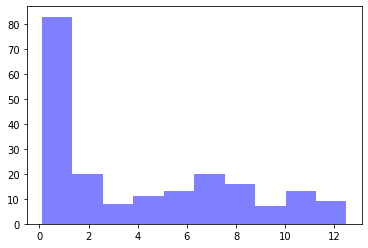

alpha: 0.9999503 , beta: 0.49909073 , initial_unconfirmed 3.3384085 , t0s 0.88721 , lambds 0.6377669


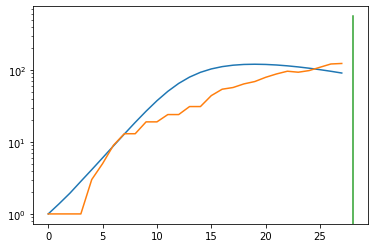

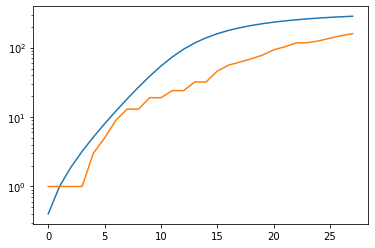

total error: 0.06671801209449768


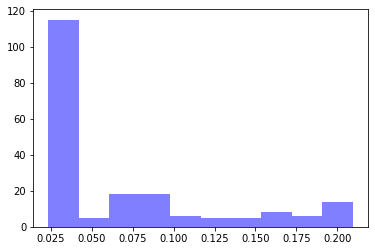

alpha: 0.5027911 , beta: 0.34025627 , initial_unconfirmed 7.531914 , t0s 0.0 , lambds 0.38306245


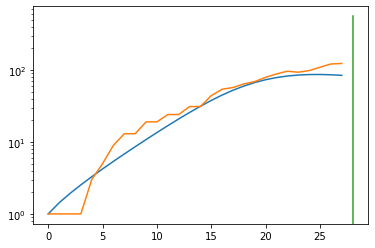

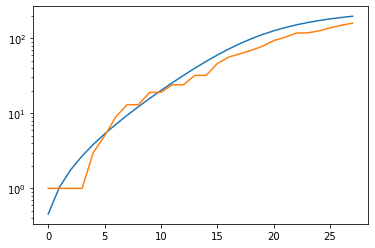

total error: 0.036033522337675095


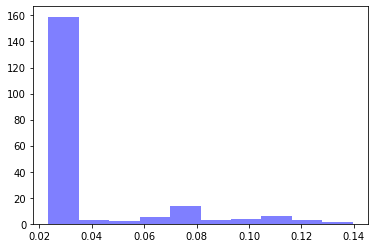

alpha: 0.504284 , beta: 0.34025133 , initial_unconfirmed 7.5101004 , t0s 0.0 , lambds 0.3830624


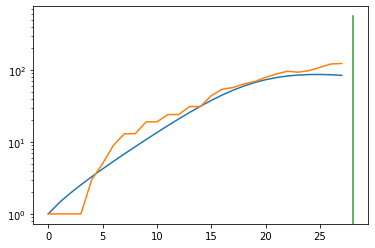

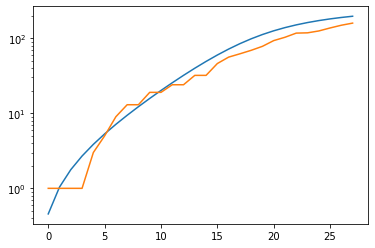

total error: 0.023765409365296364


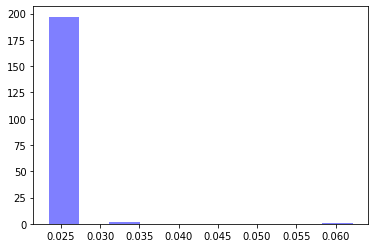

alpha: 0.5009949 , beta: 0.3402609 , initial_unconfirmed 7.5589724 , t0s 0.0 , lambds 0.3830785


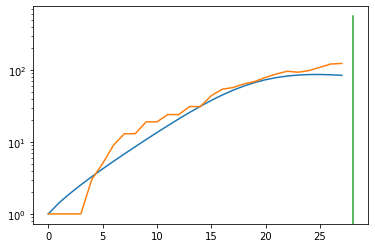

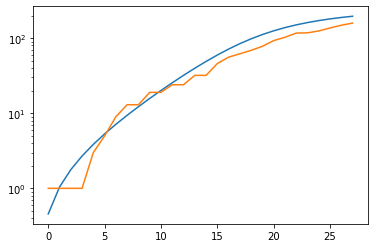

total error: 0.023580042645335197


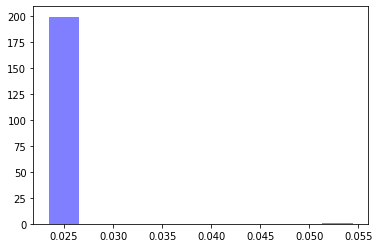

alpha: 0.5009949 , beta: 0.3402609 , initial_unconfirmed 7.5589724 , t0s 0.0 , lambds 0.3830785


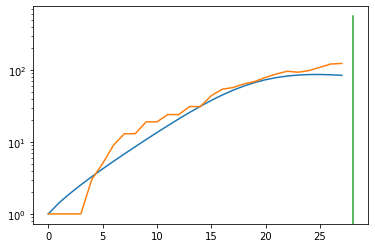

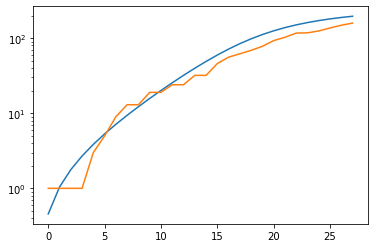

Chad
total error: 6.5395894050598145


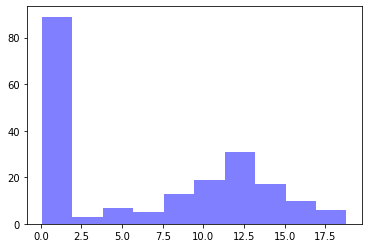

alpha: 0.94272715 , beta: 0.19746925 , initial_unconfirmed 5.884817 , t0s 0.13300854 , lambds 0.6626656


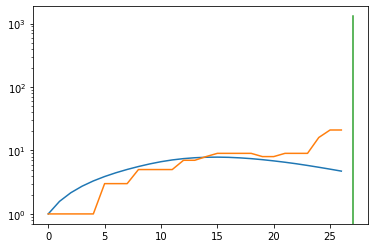

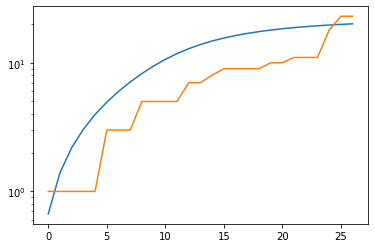

total error: 0.09476640075445175


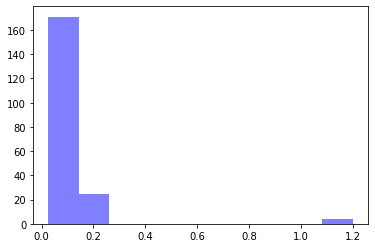

alpha: 0.5019646 , beta: 0.18989219 , initial_unconfirmed 5.745725 , t0s 1.2229297 , lambds 0.0006460438


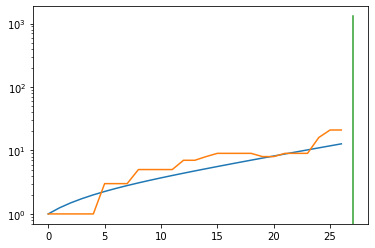

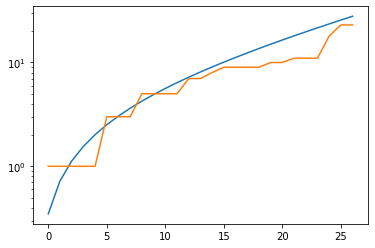

total error: 0.07397641986608505


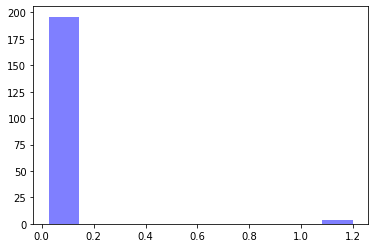

alpha: 0.5018661 , beta: 0.18989353 , initial_unconfirmed 5.746814 , t0s 1.018468 , lambds 0.0005138198


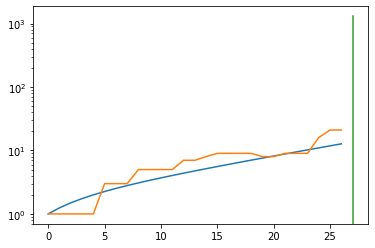

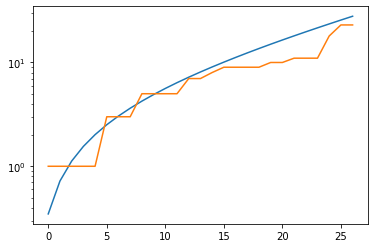

total error: 0.06285024434328079


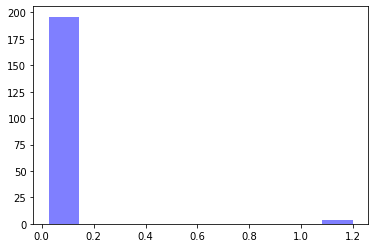

alpha: 0.5017755 , beta: 0.189893 , initial_unconfirmed 5.7478924 , t0s 1.4209261 , lambds 0.00044994356


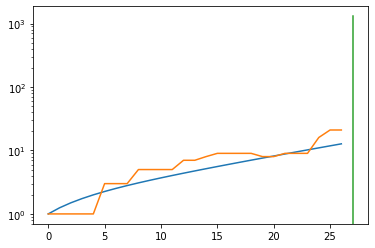

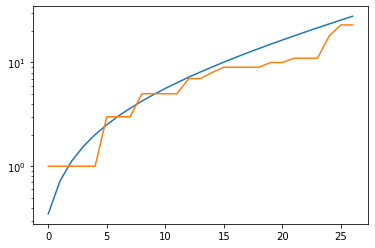

total error: 0.059183064848184586


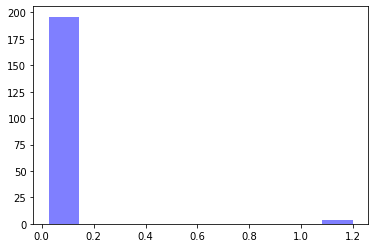

alpha: 0.50177544 , beta: 0.18989281 , initial_unconfirmed 5.747894 , t0s 1.4209543 , lambds 0.00041881544


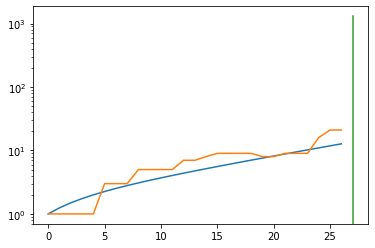

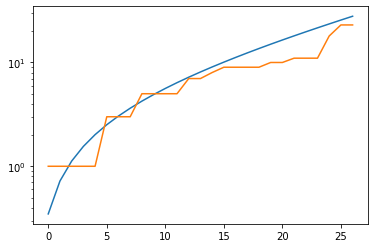

Papua New Guinea
total error: 8.260761260986328


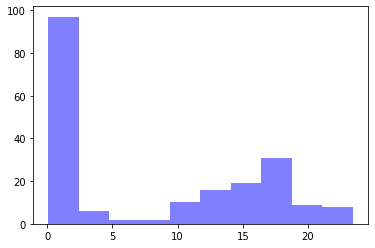

alpha: 0.99978065 , beta: 5.1470673e-05 , initial_unconfirmed 3.6600828 , t0s 0.60285044 , lambds 0.71430063


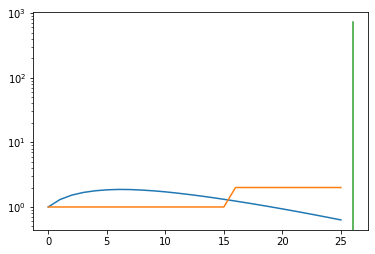

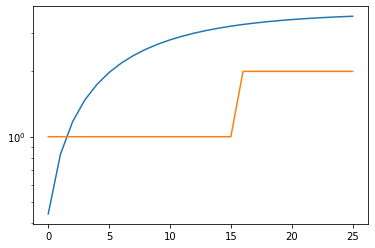

total error: 0.09477543830871582


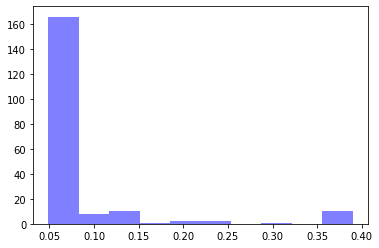

alpha: 0.9989331 , beta: 0.10686287 , initial_unconfirmed 1.2841104 , t0s 1.9510185 , lambds 0.002179464


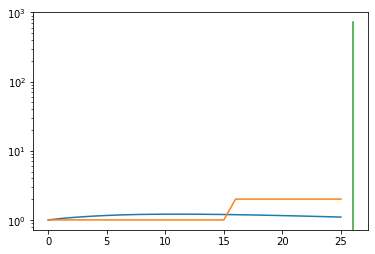

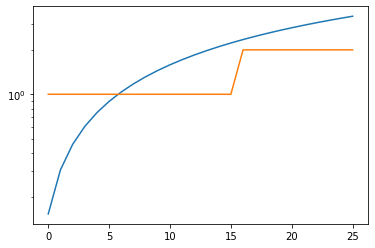

total error: 0.08374729752540588


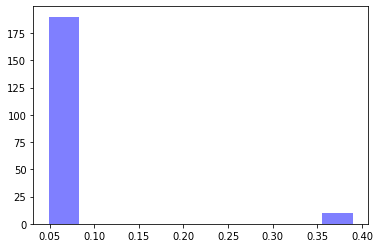

alpha: 0.9989331 , beta: 0.10686287 , initial_unconfirmed 1.2841104 , t0s 1.9510185 , lambds 0.002179464


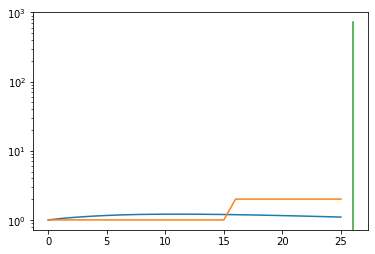

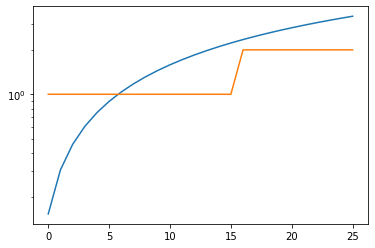

total error: 0.08160313963890076


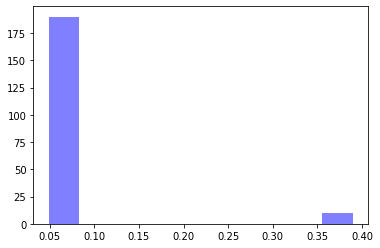

alpha: 0.9989331 , beta: 0.10686287 , initial_unconfirmed 1.2841104 , t0s 1.9510185 , lambds 0.002179464


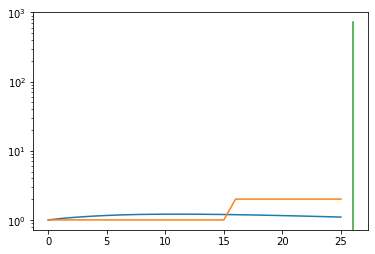

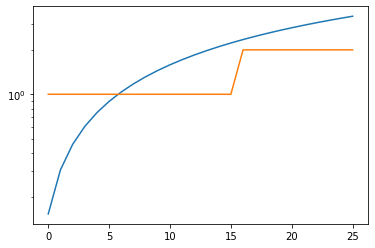

total error: 0.07870474457740784


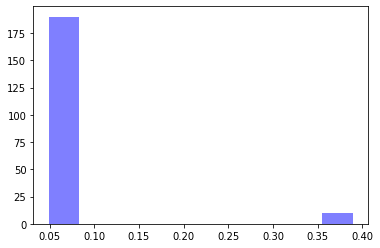

alpha: 0.9989331 , beta: 0.10686287 , initial_unconfirmed 1.2841104 , t0s 1.9510185 , lambds 0.002179464


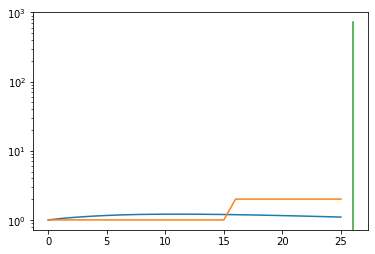

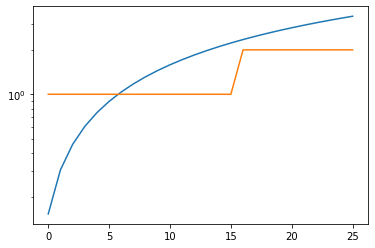

St. Kitts and Nevis
total error: 3.2980856895446777


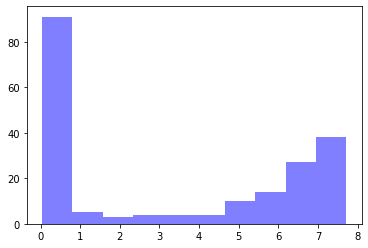

alpha: 0.99912137 , beta: 0.21886982 , initial_unconfirmed 4.1741014 , t0s 0.68338203 , lambds 0.6211728


total error: 0.051585033535957336


alpha: 0.52722657 , beta: 0.16518086 , initial_unconfirmed 12.073058 , t0s 0.0 , lambds 0.43360204


total error: 0.046850014477968216


alpha: 0.52722657 , beta: 0.16518086 , initial_unconfirmed 12.073058 , t0s 0.0 , lambds 0.43360204


total error: 0.045115865767002106


alpha: 0.5030201 , beta: 0.16520609 , initial_unconfirmed 12.652614 , t0s 0.0 , lambds 0.43369624


total error: 0.04490281641483307


alpha: 0.99998564 , beta: 0.16519131 , initial_unconfirmed 6.364169 , t0s 0.0 , lambds 0.4338826


Cambodia
total error: 6.489096641540527


alpha: 0.90412843 , beta: 0.34656006 , initial_unconfirmed 7.8551054 , t0s 0.8060377 , lambds 0.6168053


total error: 0.6379832029342651


alpha: 0.99735796 , beta: 0.22673717 , initial_unconfirmed 0.28760266 , t0s 4.09907 , lambds 0.115198635


total error: 0.31262150406837463


alpha: 0.50525194 , beta: 0.22676107 , initial_unconfirmed 0.56138706 , t0s 9.461094 , lambds 0.13108334


total error: 0.24508686363697052


alpha: 0.99994075 , beta: 0.22322007 , initial_unconfirmed 0.303918 , t0s 33.217438 , lambds 0.28976172


total error: 0.24361397325992584


alpha: 0.99995863 , beta: 0.22403115 , initial_unconfirmed 0.29550102 , t0s 46.246437 , lambds 0.7829901


Guernsey
total error: 4.659654140472412


alpha: 0.99962676 , beta: 0.28140634 , initial_unconfirmed 7.613471 , t0s 0.31712335 , lambds 0.575186


total error: 0.4205668270587921


alpha: 0.5230897 , beta: 0.35540843 , initial_unconfirmed 0.8185751 , t0s 3.985564 , lambds 0.24934319


total error: 0.301028847694397


alpha: 0.71731204 , beta: 0.35331172 , initial_unconfirmed 0.5912213 , t0s 19.19942 , lambds 0.74861866


total error: 0.2995434105396271


alpha: 0.94758546 , beta: 0.3530413 , initial_unconfirmed 0.4478696 , t0s 20.92655 , lambds 0.9460129


total error: 0.29915156960487366


alpha: 0.97958165 , beta: 0.35306367 , initial_unconfirmed 0.43364364 , t0s 21.108704 , lambds 0.97318655


United States
total error: 9.188126564025879


alpha: 0.86506677 , beta: 0.6486866 , initial_unconfirmed 10.950902 , t0s 0.58132815 , lambds 0.5136959


total error: 0.6798144578933716


alpha: 0.99925697 , beta: 0.2970109 , initial_unconfirmed 0.57450825 , t0s 4.806267 , lambds 0.0012160017


total error: 0.5830991268157959


alpha: 0.9990675 , beta: 0.30229238 , initial_unconfirmed 0.47630647 , t0s 0.0 , lambds 0.009662516


total error: 0.5669485330581665


alpha: 0.50243276 , beta: 0.29764 , initial_unconfirmed 1.2044771 , t0s 4.687183 , lambds 0.0003649611


total error: 0.5596808791160583


alpha: 0.50243276 , beta: 0.29764 , initial_unconfirmed 1.2044771 , t0s 4.687183 , lambds 0.0003649611


Portugal
total error: 3.9827585220336914


alpha: 0.9426588 , beta: 0.81744295 , initial_unconfirmed 2.5828362 , t0s 0.6870266 , lambds 0.61436415


total error: 0.032567888498306274


alpha: 0.6351099 , beta: 0.42149785 , initial_unconfirmed 14.396271 , t0s 0.0 , lambds 0.25270662


total error: 0.023375418037176132


alpha: 0.50230384 , beta: 0.42145 , initial_unconfirmed 18.214476 , t0s 0.0 , lambds 0.2526317


total error: 0.021963536739349365


alpha: 0.50230384 , beta: 0.42145 , initial_unconfirmed 18.214476 , t0s 0.0 , lambds 0.2526317


total error: 0.021750126034021378


alpha: 0.50230384 , beta: 0.42145 , initial_unconfirmed 18.214476 , t0s 0.0 , lambds 0.2526317


United States Virgin Islands
total error: 3.542022705078125


alpha: 0.88774025 , beta: 0.25968453 , initial_unconfirmed 13.634628 , t0s 0.7792879 , lambds 0.5585682


total error: 0.09711776673793793


alpha: 0.50475657 , beta: 0.25918093 , initial_unconfirmed 11.616942 , t0s 0.0 , lambds 0.3845044


total error: 0.08369989693164825


alpha: 0.501651 , beta: 0.2592412 , initial_unconfirmed 11.684088 , t0s 0.0 , lambds 0.38459754


total error: 0.07648371905088425


alpha: 0.50034875 , beta: 0.25923783 , initial_unconfirmed 11.71477 , t0s 0.0 , lambds 0.3845907


total error: 0.0713251382112503


alpha: 0.50016826 , beta: 0.25932515 , initial_unconfirmed 11.712027 , t0s 0.0 , lambds 0.3847399


Brunei Darussalam
total error: 3.1038644313812256


alpha: 0.95262843 , beta: 0.2508915 , initial_unconfirmed 39.76298 , t0s 0.06585771 , lambds 0.69476414


total error: 0.047066718339920044


alpha: 0.69944984 , beta: 0.23854333 , initial_unconfirmed 48.280197 , t0s 0.0 , lambds 0.6031183


total error: 0.045232512056827545


alpha: 0.6993318 , beta: 0.2385903 , initial_unconfirmed 48.279755 , t0s 0.0 , lambds 0.6032253


total error: 0.04443906247615814


alpha: 0.6991769 , beta: 0.2386307 , initial_unconfirmed 48.282974 , t0s 0.0 , lambds 0.60331666


total error: 0.04400557652115822


alpha: 0.6990888 , beta: 0.23862839 , initial_unconfirmed 48.289425 , t0s 0.0 , lambds 0.6033101


Hong Kong
Azerbaijan
total error: 4.687101364135742


alpha: 0.9981281 , beta: 0.5546976 , initial_unconfirmed 3.187257 , t0s 0.023227215 , lambds 0.60152215


total error: 0.19965390861034393


alpha: 0.9096103 , beta: 0.26651812 , initial_unconfirmed 3.5398262 , t0s 2.8288019 , lambds 0.14145248


total error: 0.02677384577691555


alpha: 0.999671 , beta: 0.266621 , initial_unconfirmed 3.2146924 , t0s 3.5682127 , lambds 0.14541179


total error: 0.025028171017766


alpha: 0.5028894 , beta: 0.2665488 , initial_unconfirmed 6.386587 , t0s 4.851546 , lambds 0.15163346


total error: 0.024841897189617157


alpha: 0.9999178 , beta: 0.2637051 , initial_unconfirmed 3.2716308 , t0s 33.037834 , lambds 0.8206574


South Sudan
Kazakhstan
total error: 3.2727057933807373


alpha: 0.9928239 , beta: 0.33694553 , initial_unconfirmed 36.683743 , t0s 0.03475833 , lambds 0.5355525


total error: 0.06531261652708054


alpha: 0.5713006 , beta: 0.28293586 , initial_unconfirmed 44.02039 , t0s 0.0 , lambds 0.26533058


total error: 0.02168547548353672


alpha: 0.537585 , beta: 0.2829337 , initial_unconfirmed 46.78245 , t0s 0.0 , lambds 0.2653269


total error: 0.019546329975128174


alpha: 0.537585 , beta: 0.2829337 , initial_unconfirmed 46.78245 , t0s 0.0 , lambds 0.2653269


total error: 0.019021885469555855


alpha: 0.537585 , beta: 0.2829337 , initial_unconfirmed 46.78245 , t0s 0.0 , lambds 0.2653269


St. Lucia
total error: 5.061655044555664


alpha: 0.95535797 , beta: 0.11097332 , initial_unconfirmed 13.363663 , t0s 0.91113704 , lambds 0.53638965


total error: 0.12196993827819824


alpha: 0.5169363 , beta: 0.1943883 , initial_unconfirmed 5.810498 , t0s 5.7425222 , lambds 0.39115852


total error: 0.1028457060456276


alpha: 0.5171719 , beta: 0.1929351 , initial_unconfirmed 5.844667 , t0s 13.93337 , lambds 0.8529131


total error: 0.08760397136211395


alpha: 0.99081826 , beta: 0.19287807 , initial_unconfirmed 3.0512702 , t0s 14.339456 , lambds 0.9033362


total error: 0.08098261803388596


alpha: 0.99081933 , beta: 0.19286832 , initial_unconfirmed 3.0510943 , t0s 14.643182 , lambds 0.94497484


Belarus
total error: 4.873898983001709


alpha: 0.9999479 , beta: 0.4810244 , initial_unconfirmed 5.694306 , t0s 0.86401975 , lambds 0.54539245


total error: 0.24667897820472717


alpha: 0.9991924 , beta: 0.27163726 , initial_unconfirmed 2.85328 , t0s 4.130973 , lambds 0.0069498383


total error: 0.0404319129884243


alpha: 0.9753345 , beta: 0.2715418 , initial_unconfirmed 2.929101 , t0s 4.6952615 , lambds 0.0008669086


total error: 0.04017378017306328


alpha: 0.9753345 , beta: 0.2715418 , initial_unconfirmed 2.929101 , t0s 4.6952615 , lambds 0.0008669086


total error: 0.040115319192409515


alpha: 0.9753345 , beta: 0.2715418 , initial_unconfirmed 2.929101 , t0s 4.6952615 , lambds 0.0008669086


Tokelau
Cote d'Ivoire
total error: 3.6778924465179443


alpha: 0.99983245 , beta: 0.4908178 , initial_unconfirmed 6.9671035 , t0s 0.8039973 , lambds 0.50396085


total error: 0.09404300898313522


alpha: 0.50951356 , beta: 0.3563268 , initial_unconfirmed 7.6178045 , t0s 0.0 , lambds 0.30245858


total error: 0.026901332661509514


alpha: 0.5008985 , beta: 0.35638902 , initial_unconfirmed 7.7459617 , t0s 0.0 , lambds 0.3025149


total error: 0.026483211666345596


alpha: 0.5008985 , beta: 0.35638902 , initial_unconfirmed 7.7459617 , t0s 0.0 , lambds 0.3025149


total error: 0.026469195261597633


alpha: 0.5008985 , beta: 0.35638902 , initial_unconfirmed 7.7459617 , t0s 0.0 , lambds 0.3025149


British Virgin Islands
France
total error: 7.9358906745910645


alpha: 0.8792825 , beta: 0.53238547 , initial_unconfirmed 22.38886 , t0s 0.6284207 , lambds 0.5002274


total error: 0.6168345808982849


alpha: 0.5004912 , beta: 0.2810173 , initial_unconfirmed 1.7494245 , t0s 4.902019 , lambds 0.002702547


total error: 0.5586562156677246


alpha: 0.5002474 , beta: 0.2810402 , initial_unconfirmed 1.7505084 , t0s 5.380147 , lambds 0.00043790467


total error: 0.5584623217582703


alpha: 0.5002474 , beta: 0.2810402 , initial_unconfirmed 1.7505084 , t0s 5.380147 , lambds 0.00043790467


total error: 0.5583296418190002


alpha: 0.5002474 , beta: 0.2810402 , initial_unconfirmed 1.7505084 , t0s 5.380147 , lambds 0.00043790467


Tanzania
total error: 4.602757453918457


alpha: 0.9909296 , beta: 0.25313884 , initial_unconfirmed 6.5219283 , t0s 0.37113327 , lambds 0.59326464


total error: 0.08071208000183105


alpha: 0.50406927 , beta: 0.17048234 , initial_unconfirmed 14.846298 , t0s 3.356934 , lambds 0.011737529


total error: 0.0735788494348526


alpha: 0.5022161 , beta: 0.17047854 , initial_unconfirmed 14.901371 , t0s 3.2681446 , lambds 0.009907681


total error: 0.06876038759946823


alpha: 0.5022161 , beta: 0.17047854 , initial_unconfirmed 14.901371 , t0s 3.2681446 , lambds 0.009907681


total error: 0.06661039590835571


alpha: 0.5022161 , beta: 0.17047854 , initial_unconfirmed 14.901371 , t0s 3.2681446 , lambds 0.009907681


Colombia
total error: 3.5863070487976074


alpha: 0.99930274 , beta: 0.4342478 , initial_unconfirmed 23.72986 , t0s 0.7200375 , lambds 0.58118415


total error: 0.04624388739466667


alpha: 0.5020816 , beta: 0.38992357 , initial_unconfirmed 12.193562 , t0s 0.0 , lambds 0.28515854


total error: 0.028257004916667938


alpha: 0.5020816 , beta: 0.38992357 , initial_unconfirmed 12.193562 , t0s 0.0 , lambds 0.28515854


total error: 0.02720094844698906


alpha: 0.5020816 , beta: 0.38992357 , initial_unconfirmed 12.193562 , t0s 0.0 , lambds 0.28515854


total error: 0.02719527669250965


alpha: 0.5020816 , beta: 0.38992357 , initial_unconfirmed 12.193562 , t0s 0.0 , lambds 0.28515854


Serbia
total error: 3.5070183277130127


alpha: 0.99997705 , beta: 0.46650442 , initial_unconfirmed 14.630148 , t0s 0.15199214 , lambds 0.5327721


total error: 0.062158841639757156


alpha: 0.6148134 , beta: 0.3599603 , initial_unconfirmed 11.660019 , t0s 0.0 , lambds 0.2386187


total error: 0.043893683701753616


alpha: 0.50460935 , beta: 0.35992512 , initial_unconfirmed 14.213876 , t0s 0.0 , lambds 0.23858623


total error: 0.04320318624377251


alpha: 0.50460935 , beta: 0.35992512 , initial_unconfirmed 14.213876 , t0s 0.0 , lambds 0.23858623


total error: 0.04318762943148613


alpha: 0.50460935 , beta: 0.35992512 , initial_unconfirmed 14.213876 , t0s 0.0 , lambds 0.23858623


Jersey
total error: 3.6970043182373047


alpha: 0.8549993 , beta: 0.42399514 , initial_unconfirmed 4.1552544 , t0s 0.19390845 , lambds 0.5015457


total error: 0.2538259029388428


alpha: 0.50484467 , beta: 0.3503662 , initial_unconfirmed 2.5625744 , t0s 7.7674594 , lambds 0.41472346


total error: 0.13963647186756134


alpha: 0.9311775 , beta: 0.34572124 , initial_unconfirmed 1.423772 , t0s 15.669645 , lambds 0.85366255


total error: 0.1380760222673416


alpha: 0.9487605 , beta: 0.34549543 , initial_unconfirmed 1.3990544 , t0s 16.270124 , lambds 0.92691493


total error: 0.13802911341190338


alpha: 0.96371627 , beta: 0.34542343 , initial_unconfirmed 1.3778112 , t0s 16.471998 , lambds 0.9544722


United States Minor Outlying Islands
Samoa
Falkland Islands
total error: 1.2284644842147827


alpha: 0.9946983 , beta: 0.00010768811 , initial_unconfirmed 10.8487215 , t0s 0.95745134 , lambds 0.5435935


total error: 0.01556526031345129


alpha: 0.9973113 , beta: 0.09583994 , initial_unconfirmed 7.7627068 , t0s 1.9375801 , lambds 0.014311574


total error: 0.014659397304058075


alpha: 0.99731195 , beta: 0.09583953 , initial_unconfirmed 7.76271 , t0s 1.9428029 , lambds 0.009675072


total error: 0.014040844514966011


alpha: 0.99992126 , beta: 0.09583827 , initial_unconfirmed 7.742451 , t0s 2.0769374 , lambds 0.004662825


total error: 0.013753224164247513


alpha: 0.99992126 , beta: 0.09583827 , initial_unconfirmed 7.742451 , t0s 2.0769374 , lambds 0.004662825


Costa Rica
total error: 3.4156742095947266


alpha: 0.9999359 , beta: 0.42198637 , initial_unconfirmed 19.748167 , t0s 0.063654184 , lambds 0.65368974


total error: 0.07643721997737885


alpha: 0.50588447 , beta: 0.27989188 , initial_unconfirmed 29.607452 , t0s 0.0 , lambds 0.26910532


total error: 0.03258141130208969


alpha: 0.50439984 , beta: 0.2797568 , initial_unconfirmed 29.7398 , t0s 0.0 , lambds 0.26898026


total error: 0.0313539057970047


alpha: 0.50439316 , beta: 0.27976456 , initial_unconfirmed 29.738173 , t0s 0.0 , lambds 0.26898926


total error: 0.031137941405177116


alpha: 0.50439316 , beta: 0.27976456 , initial_unconfirmed 29.738173 , t0s 0.0 , lambds 0.26898926


Latvia
total error: 4.068260669708252


alpha: 0.8036969 , beta: 0.67427075 , initial_unconfirmed 1.4566272 , t0s 0.17981285 , lambds 0.5646741


total error: 0.13046303391456604


alpha: 0.5038526 , beta: 0.3728298 , initial_unconfirmed 4.6898136 , t0s 0.0 , lambds 0.27898866


total error: 0.04049176350235939


alpha: 0.50059175 , beta: 0.3728338 , initial_unconfirmed 4.7199855 , t0s 0.0 , lambds 0.27899122


total error: 0.04010649770498276


alpha: 0.50059175 , beta: 0.3728338 , initial_unconfirmed 4.7199855 , t0s 0.0 , lambds 0.27899122


total error: 0.04010656848549843


alpha: 0.50059175 , beta: 0.3728338 , initial_unconfirmed 4.7199855 , t0s 0.0 , lambds 0.27899122


British Indian Ocean Territory
Macao
United Arab Emirates
total error: 5.802377700805664


alpha: 0.9983412 , beta: 0.2936722 , initial_unconfirmed 20.260534 , t0s 0.3706 , lambds 0.5150426


total error: 0.46095913648605347


alpha: 0.9988096 , beta: 0.2176011 , initial_unconfirmed 1.5388088 , t0s 4.9305525 , lambds 0.0013318863


total error: 0.07657352834939957


alpha: 0.9992541 , beta: 0.21757586 , initial_unconfirmed 1.5396054 , t0s 5.097941 , lambds 0.0004227041


total error: 0.07611239701509476


alpha: 0.9992541 , beta: 0.21757586 , initial_unconfirmed 1.5396054 , t0s 5.097941 , lambds 0.0004227041


total error: 0.07604667544364929


alpha: 0.9992541 , beta: 0.21757586 , initial_unconfirmed 1.5396054 , t0s 5.097941 , lambds 0.0004227041


Brazil
total error: 4.7641072273254395


alpha: 0.9923885 , beta: 0.9512632 , initial_unconfirmed 0.18718839 , t0s 0.956289 , lambds 0.7194227


total error: 0.12224169820547104


alpha: 0.52523357 , beta: 0.41337234 , initial_unconfirmed 3.0807285 , t0s 0.0 , lambds 0.19572543


total error: 0.07571393251419067


alpha: 0.52523357 , beta: 0.41337234 , initial_unconfirmed 3.0807285 , t0s 0.0 , lambds 0.19572543


total error: 0.0744723379611969


alpha: 0.52523357 , beta: 0.41337234 , initial_unconfirmed 3.0807285 , t0s 0.0 , lambds 0.19572543


total error: 0.07447290420532227


alpha: 0.52523357 , beta: 0.41337234 , initial_unconfirmed 3.0807285 , t0s 0.0 , lambds 0.19572543


Western Sahara
Tunisia
total error: 4.725388526916504


alpha: 0.77438104 , beta: 0.3356952 , initial_unconfirmed 17.14991 , t0s 0.04323852 , lambds 0.57683253


total error: 0.14367716014385223


alpha: 0.50248396 , beta: 0.3488271 , initial_unconfirmed 3.723612 , t0s 0.0 , lambds 0.23761217


total error: 0.028891367837786674


alpha: 0.5017018 , beta: 0.34883493 , initial_unconfirmed 3.730113 , t0s 0.0 , lambds 0.23762582


total error: 0.028497464954853058


alpha: 0.5017018 , beta: 0.34883493 , initial_unconfirmed 3.730113 , t0s 0.0 , lambds 0.23762582


total error: 0.028496362268924713


alpha: 0.5017018 , beta: 0.34883493 , initial_unconfirmed 3.730113 , t0s 0.0 , lambds 0.23762582


Andorra
total error: 3.3621716499328613


alpha: 0.9289793 , beta: 0.3723054 , initial_unconfirmed 5.814868 , t0s 0.35554254 , lambds 0.59650195


total error: 0.4893454611301422


alpha: 0.99977326 , beta: 0.3950069 , initial_unconfirmed 0.53667355 , t0s 13.062185 , lambds 0.49159336


total error: 0.38499316573143005


alpha: 0.999774 , beta: 0.39508992 , initial_unconfirmed 0.5382849 , t0s 12.391874 , lambds 0.46778014


total error: 0.3841768205165863


alpha: 0.999774 , beta: 0.39508992 , initial_unconfirmed 0.5382849 , t0s 12.391874 , lambds 0.46778014


total error: 0.38414788246154785


alpha: 0.999774 , beta: 0.39508992 , initial_unconfirmed 0.5382849 , t0s 12.391874 , lambds 0.46778014


Bangladesh
total error: 5.181647777557373


alpha: 0.9439354 , beta: 0.30099252 , initial_unconfirmed 8.3990755 , t0s 0.12600201 , lambds 0.51995564


total error: 0.19403032958507538


alpha: 0.65260255 , beta: 0.2588994 , initial_unconfirmed 5.7757516 , t0s 3.9471405 , lambds 0.003213196


total error: 0.07731344550848007


alpha: 0.50056636 , beta: 0.2589096 , initial_unconfirmed 7.5290256 , t0s 4.6102786 , lambds 0.00022108202


total error: 0.04689960926771164


alpha: 0.7873335 , beta: 0.2589726 , initial_unconfirmed 4.787617 , t0s 5.177606 , lambds 0.00020271522


total error: 0.046808481216430664


alpha: 0.7873335 , beta: 0.2589726 , initial_unconfirmed 4.787617 , t0s 5.177606 , lambds 0.00020271522


Egypt
total error: 6.500932693481445


alpha: 0.90876865 , beta: 0.45863938 , initial_unconfirmed 1.6165495 , t0s 0.74993974 , lambds 0.5391566


total error: 0.7351240515708923


alpha: 0.5008259 , beta: 0.31333563 , initial_unconfirmed 0.91122925 , t0s 0.0 , lambds 0.14508481


total error: 0.4572727084159851


alpha: 0.9881269 , beta: 0.3143512 , initial_unconfirmed 0.46221578 , t0s 0.0 , lambds 0.14515074


total error: 0.4543225169181824


alpha: 0.9881269 , beta: 0.3143512 , initial_unconfirmed 0.46221578 , t0s 0.0 , lambds 0.14515074


total error: 0.45274361968040466


alpha: 0.9881269 , beta: 0.3143512 , initial_unconfirmed 0.46221578 , t0s 0.0 , lambds 0.14515074


Taiwan
American Samoa
Guam
total error: 2.616913080215454


alpha: 0.99993813 , beta: 0.30773944 , initial_unconfirmed 13.268241 , t0s 0.94868004 , lambds 0.58987844


total error: 0.040223635733127594


alpha: 0.5148153 , beta: 0.2505793 , initial_unconfirmed 34.127583 , t0s 0.0 , lambds 0.38664508


total error: 0.03540145233273506


alpha: 0.5033596 , beta: 0.25065014 , initial_unconfirmed 34.89201 , t0s 0.0 , lambds 0.38680884


total error: 0.029531098902225494


alpha: 0.5008637 , beta: 0.2506616 , initial_unconfirmed 35.063347 , t0s 0.0 , lambds 0.38682663


total error: 0.02645634114742279


alpha: 0.50084823 , beta: 0.2507217 , initial_unconfirmed 35.049603 , t0s 0.0 , lambds 0.38692507


Morocco
total error: 4.465600967407227


alpha: 0.9750484 , beta: 0.6479835 , initial_unconfirmed 1.5417606 , t0s 0.66365916 , lambds 0.7015878


total error: 0.11882389336824417


alpha: 0.5024734 , beta: 0.3572078 , initial_unconfirmed 4.1578603 , t0s 0.0 , lambds 0.22078604


total error: 0.026812227442860603


alpha: 0.51221997 , beta: 0.35728642 , initial_unconfirmed 4.0801926 , t0s 0.0 , lambds 0.22083716


total error: 0.026634205132722855


alpha: 0.51221997 , beta: 0.35728642 , initial_unconfirmed 4.0801926 , t0s 0.0 , lambds 0.22083716


total error: 0.026629624888300896


alpha: 0.51221997 , beta: 0.35728642 , initial_unconfirmed 4.0801926 , t0s 0.0 , lambds 0.22083716


Palestine
total error: 3.93300199508667


alpha: 0.96109843 , beta: 0.35619375 , initial_unconfirmed 6.6208987 , t0s 0.9224764 , lambds 0.51252186


total error: 0.11077123880386353


alpha: 0.9994551 , beta: 0.17596042 , initial_unconfirmed 26.64497 , t0s 4.43096 , lambds 0.0016697906


total error: 0.08072881400585175


alpha: 0.9322558 , beta: 0.1762338 , initial_unconfirmed 28.396753 , t0s 4.836848 , lambds 0.0005600255


total error: 0.04231485724449158


alpha: 0.9994446 , beta: 0.17620182 , initial_unconfirmed 26.5065 , t0s 4.438833 , lambds 0.00036258576


total error: 0.03154778853058815


alpha: 0.9994439 , beta: 0.17621697 , initial_unconfirmed 26.497824 , t0s 4.439231 , lambds 0.00027826912


Togo
total error: 5.919706344604492


alpha: 0.9998647 , beta: 0.18471599 , initial_unconfirmed 6.3389482 , t0s 0.40723532 , lambds 0.59161437


total error: 0.27381083369255066


alpha: 0.99102217 , beta: 0.2918289 , initial_unconfirmed 0.9752465 , t0s 0.0 , lambds 0.25881693


total error: 0.1753513514995575


alpha: 0.50091964 , beta: 0.29181883 , initial_unconfirmed 1.929313 , t0s 0.0 , lambds 0.25879928


total error: 0.12407994270324707


alpha: 0.50079083 , beta: 0.29181543 , initial_unconfirmed 1.9308714 , t0s 0.0 , lambds 0.25882435


total error: 0.12406513839960098


alpha: 0.50079083 , beta: 0.29181543 , initial_unconfirmed 1.9308714 , t0s 0.0 , lambds 0.25882435


Qatar
total error: 3.7652575969696045


alpha: 0.9999328 , beta: 0.78056574 , initial_unconfirmed 2.5186598 , t0s 0.3572154 , lambds 0.68627244


total error: 0.12494096904993057


alpha: 0.5096495 , beta: 0.32267204 , initial_unconfirmed 18.806204 , t0s 0.0 , lambds 0.23186827


total error: 0.10529115796089172


alpha: 0.5011297 , beta: 0.32278058 , initial_unconfirmed 19.102102 , t0s 0.0 , lambds 0.23196341


total error: 0.10454604774713516


alpha: 0.5006019 , beta: 0.32285047 , initial_unconfirmed 19.107563 , t0s 0.0 , lambds 0.23201902


total error: 0.10443738847970963


alpha: 0.5006019 , beta: 0.32285047 , initial_unconfirmed 19.107563 , t0s 0.0 , lambds 0.23201902


Belize
total error: 4.762067794799805


alpha: 0.99824154 , beta: 0.04865669 , initial_unconfirmed 6.7709355 , t0s 0.23060834 , lambds 0.6384278


total error: 0.09248682856559753


alpha: 0.75075483 , beta: 0.20067868 , initial_unconfirmed 3.215716 , t0s 3.409132 , lambds 0.00081653614


total error: 0.07053790241479874


alpha: 0.8637903 , beta: 0.2006778 , initial_unconfirmed 2.794904 , t0s 3.1530526 , lambds 0.0005206783


total error: 0.061465974897146225


alpha: 0.9823064 , beta: 0.20067742 , initial_unconfirmed 2.4576924 , t0s 3.2424557 , lambds 0.00061994593


total error: 0.056112222373485565


alpha: 0.9993492 , beta: 0.20067734 , initial_unconfirmed 2.4157808 , t0s 3.7985504 , lambds 0.00046961484


In [19]:
# 参数寻优过程。在这个版本中，我们将流量矩阵都设为了0，即国家间没有相互影响，每个国家独立地做参数优化，得到每个国家的
# alpha,beta,lambda,t0s,和它们各自初始时刻的未确诊病例数
t_c = 8.3
t_r = 9.2
r0 = 2.3
batch_size = 200
f_zeros=[]
for fij in fijt:
    f_zeros.append(np.zeros([1,1]))
population_t = torch.Tensor(population)
population_t.requires_grad = False
population_t = population_t.unsqueeze(0).repeat(batch_size, 1)
final_parameters = {}
for c,i in nodes.items():
    #针对每个国家的循环
    print(c)
    nonzeros=np.nonzero(all_cumconfirm_cases[:,i])[0]
    passed = False
    if len(nonzeros)>0:
        #获得每个国家的第一个汇报病例的时间，所有的时间起点都设置为这个时间
        first_t = np.nonzero(all_cumconfirm_cases[:,i])[0][0]
        constants = {'beta': r0 / t_c, 'tc': t_c, 'tr': t_r, 'interval': 1,'epsilon': 0.001, 'tstar':0, 'lambds2':0}
        targets_t = torch.cat((targets[first_t:, i:i+1], targets[first_t:, len(nodes)+i:len(nodes)+i+1]),1)
        mask_t = torch.cat((mask[first_t:, i:i+1], mask[first_t:, len(nodes)+i:len(nodes)+i+1]),1)
        
        nnn = nn_parameter_searcher(batch_size, constants, f_zeros, population_t[:, i:i+1])
        optimizer = optim.Adam(nnn.parameters(), lr = 0.1)
        sz = population_t[:, i:i+1].size()[1]

        timespan = np.linspace(0, targets_t.size()[0], targets_t.size()[0])
        best_parameters=[]
        # 开始进行2000步优化
        for epoch in range(2000):
            optimizer.zero_grad()
            pps = nnn.form_parameter()

            s0 = all_cumconfirm_cases[first_t, i] / population[i]
            initial_state = nnn.initialize_state(0, s0)
            prediction = dodeint(nnn, initial_state, torch.Tensor(timespan), method='dopri5', rtol=1e-5)

            part1 = prediction[:, :, :sz]
            part2 = prediction[:, :, sz:2*sz]
            
            alphas =(pps['alphas'].unsqueeze(0)).repeat(len(timespan), 1,1)
            part3 = alphas * part1 / (constants['tc'] * constants['interval'])
            part3 = torch.cumsum(part3, dim=0)
            whole = torch.cat((part2, part3), 2)

            maskk = mask_t.unsqueeze(1).repeat(1, batch_size, 1)
            maskk = maskk & (whole > 1e-25)
            pred = whole + (~maskk)*1.0
            targ = targets_t.unsqueeze(1).repeat(1, batch_size, 1)
            targ = targ + (~maskk)*1.0
            err = torch.log10(pred) - torch.log10(targ)
            all_loss = torch.mean(torch.mean(err ** 2, 0), 1)
            loss = torch.mean(all_loss)
            #print(epoch, loss)
            curr_min_loss, mindx = torch.min(all_loss, 0)

            #每个周期都记录最好的10个个体
            if len(best_parameters)<10:
                pps = nnn.form_parameter()
                output = {'alphas': pps['alphas'][mindx,:].data.numpy(), 'betas': pps['betas'][mindx,:].data.numpy(),
                         'initial_unconfirmed': pps['initial_unconfirmed'][mindx,:].data.numpy(),
                         't0s':pps['t0s'][mindx,:].data.numpy(), 'lambds':pps['lambds'][mindx,:].data.numpy()}
                best_parameters.append([output, curr_min_loss.item()])
            else:
                all_fitness = sorted([[vvv[1],i] for i,vvv in enumerate(best_parameters)])
                if curr_min_loss < all_fitness[-1][0]:
                    #print(curr_min_loss)
                    del best_parameters[all_fitness[-1][1]]
                    pps = nnn.form_parameter()
                    output = {'alphas': pps['alphas'][mindx,:].data.numpy(), 'betas': pps['betas'][mindx,:].data.numpy(),
                         'initial_unconfirmed': pps['initial_unconfirmed'][mindx,:].data.numpy(),
                         't0s':pps['t0s'][mindx,:].data.numpy(), 'lambds':pps['lambds'][mindx,:].data.numpy()}
                    best_parameters.append([output, curr_min_loss.item()])

            loss.backward()
            
            #下面这些代码为了防止梯度中出现NaN（事实上非常容易出现，一出现就崩溃），会把NaN用一个随机的梯度值替换掉
            #事实证明这种处理梯度中的NaN特别好用
            passed=False
            for param in nnn.parameters():
                torch.nn.utils.clip_grad_value_(param, 100)
                param.grad.data = torch.where(torch.isnan(param.grad), torch.randn(param.grad.size()), param.grad)
                if torch.sum(torch.isnan(param.grad))>0:
                    print('NAN')
                    print(torch.sum(torch.isnan(param.grad)))
                    passed=True
            if passed:
                break
            
            #在这里进行梯度更新
            optimizer.step()
            if epoch % 499 == 0:
                # 每隔500左右周期，就绘制一次最新的模拟图
                fit_param = sorted([(vvv[1],i) for i,vvv in enumerate(best_parameters)])
                print('total error:', loss.item())
                itm = best_parameters[fit_param[0][1]][0]
                n, bins, patches = plt.hist(all_loss.data.numpy(), facecolor='blue', alpha=0.5)
                plt.show()

                print('alpha:', itm['alphas'][0],',','beta:',itm['betas'][0],
                     ',','initial_unconfirmed', itm['initial_unconfirmed'][0],',','t0s',itm['t0s'][0],
                     ',','lambds', itm['lambds'][0])

                us00 = itm['initial_unconfirmed']/population[i]
                cs00 = np.zeros(1)
                ss00 = np.ones(1)
                cs00[0] = all_cumconfirm_cases[first_t, i]/float(population[i])
                ss00[0]=1-us00[0]-cs00[0]
                initial_states = np.r_[us00,cs00,ss00]
                #initial_states = nnn.initialize_state(nodes['China'], s0)[0,:]
                constants = {'beta': r0 / t_c, 'tc': t_c, 'tr': t_r, 'interval': 1, 'epsilon': 0.001,
                             'tstar':0, 'lambds2':0}
                params = constants
                params['beta'] = itm['betas']
                params['alphas'] = itm['alphas']
                params['t0s'] = itm['t0s']
                params['lambds'] = itm['lambds']
                result = odeint(np_ode, initial_states, timespan, 
                                args = (params, f_zeros, population[i:i+1]))
                plt.figure()
                plt.semilogy(result[:, 1] * population[i])
                plt.semilogy(targets_t[:, 0].data.numpy() * population[i])
                plt.semilogy(np.ones([100])*(t0s[i]-first_t), 
                             np.linspace(min(targets[:,0]* population[i]), max(targets[:,0]* population[i])
                                         , 100),'-')
                plt.figure()
                partt = itm['alphas'][0] * result[:, 0] / (constants['tc'] * constants['interval'])
                partt = np.cumsum(partt)
                plt.semilogy(partt * population[i])
                plt.semilogy(targets_t[:, 1].data.numpy() * population[i])
                plt.show()
        
        #将最终寻到的每个国家的那组最优参数存储到final_parameters里面
        fit_param = sorted([(vvv[1],i) for i,vvv in enumerate(best_parameters)])
        itm = best_parameters[fit_param[0][1]][0]
        final_parameters[c] = itm
        if passed:
            break

In [20]:
final_parameters

{'Uruguay': {'alphas': array([0.78987896], dtype=float32),
  'betas': array([0.35041288], dtype=float32),
  'initial_unconfirmed': array([47.004208], dtype=float32),
  't0s': array([0.], dtype=float32),
  'lambds': array([0.58414096], dtype=float32)},
 'Cameroon': {'alphas': array([0.99996305], dtype=float32),
  'betas': array([0.32498485], dtype=float32),
  'initial_unconfirmed': array([1.9517311], dtype=float32),
  't0s': array([23.028774], dtype=float32),
  'lambds': array([0.8770951], dtype=float32)},
 'Kuwait': {'alphas': array([0.99999714], dtype=float32),
  'betas': array([0.18190639], dtype=float32),
  'initial_unconfirmed': array([35.124413], dtype=float32),
  't0s': array([4.891478], dtype=float32),
  'lambds': array([0.0004921], dtype=float32)},
 'Bahrain': {'alphas': array([0.999998], dtype=float32),
  'betas': array([0.17100467], dtype=float32),
  'initial_unconfirmed': array([51.48337], dtype=float32),
  't0s': array([4.719178], dtype=float32),
  'lambds': array([0.002270

In [21]:
# 将寻优得到的这些参数导入到文件中
f=open('logs/inidividual_parameters_4_15_log_lambda.pkl','wb')
pickle.dump(final_parameters,f,pickle.HIGHEST_PROTOCOL)
f.close()


In [109]:
f=open('logs/inidividual_parameters.pkl', 'rb')
aaa = pickle.load(f)
f.close()
aaa

{'Tunisia': {'alphas': array([0.50178206], dtype=float32),
  'betas': array([0.33125842], dtype=float32),
  'initial_unconfirmed': array([4.0969143], dtype=float32)},
 'Iceland': {'alphas': array([0.5009942], dtype=float32),
  'betas': array([0.27382472], dtype=float32),
  'initial_unconfirmed': array([41.044044], dtype=float32)},
 'San Marino': {'alphas': array([0.5036036], dtype=float32),
  'betas': array([0.24474825], dtype=float32),
  'initial_unconfirmed': array([23.640062], dtype=float32)},
 'Moldova': {'alphas': array([0.501261], dtype=float32),
  'betas': array([0.34087616], dtype=float32),
  'initial_unconfirmed': array([9.726264], dtype=float32)},
 'Zambia': {'alphas': array([0.8680235], dtype=float32),
  'betas': array([0.3353288], dtype=float32),
  'initial_unconfirmed': array([4.097348], dtype=float32)},
 'Monaco': {'alphas': array([0.9915668], dtype=float32),
  'betas': array([0.26577497], dtype=float32),
  'initial_unconfirmed': array([0.7933438], dtype=float32)},
 'Alge